In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
import importlib

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

pd.set_option('display.max_columns', 200)
plt.style.use('ggplot')

sys.path.append('./')
sys.path.append('./operator_position')

In [3]:
data_1 = pd.read_excel('./20191117_19.xlsx', sheet_name='all')
data_2 = pd.read_excel('./20191123.xlsx', sheet_name='Sheet2')
data_3 = pd.read_excel('./20191125.xlsx', sheet_name='Sheet2')

In [4]:
data_4 = pd.read_csv('./dwh_pre.csv')

## Проверить гипотезы
- как будет меняться распределение скеллама, если добавить ничью на вход
- сравнить вероятности побед - найти матчи, где даны оба HOME/AWAY -0.5
- маржа, две формулы (заные формулы, но чистые вероятности выходят одинаковыми)
- аппроксимировать изменение кэфов

In [12]:
data_1.shape, data_2.shape, data_3.shape

((190873, 529), (176564, 529), (36248, 529))

In [5]:
data_4.shape

(3967436, 11)

In [6]:
data_4.head()

,Unnamed: 0,QueueTime,InternalID,StartTime,BookmakerName,LineKindName,IntervalKindName,MarketKindName,SelectionKindName,MarketValue,Price
0,0,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,Handicap,Home,-0.25,3.150
1,1,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,Handicap,Away,-0.25,1.395
2,2,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,Handicap,Home,-0.50,3.640
3,3,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,Handicap,Away,-0.50,1.315
4,4,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,Handicap,Home,0.25,2.090


In [7]:
data_4.InternalID.nunique()

618

In [8]:
def create_odds(m_k_name, s_k_name, m_val, p):
    return dict(
        zip(
            m_k_name + ' ' + s_k_name + ' ' + m_val.astype(str).tolist(),
            p.tolist()
        )
    )
#     if m_k_name == 'Handicap':
#         return 'HDP'

In [9]:
from tqdm import tqdm, tqdm_notebook, tqdm_pandas

tqdm_notebook().pandas()

In [10]:
z = (
    data_4
    .groupby(['QueueTime', 'InternalID', 'StartTime', 'BookmakerName', 'LineKindName', 'IntervalKindName'])
    [['MarketKindName', 'SelectionKindName', 'MarketValue', 'Price']]
    .progress_apply(lambda x:
        create_odds(x['MarketKindName'], x['SelectionKindName'], x['MarketValue'], x['Price'])
    )
)

In [11]:
data_4.groupby('InternalID')['MarketKindName'].count().head()

InternalID
00e3c7b3-ad36-447a-82b6-3dd1860ba1a3     4009
010cdc53-3c55-47dc-b99b-eabf9ddc4854      957
011c00aa-e567-4425-aed8-6dab1d08d137    31898
01a826ea-805f-4851-bc39-b1c9711148f2     4095
01c77461-34c9-4f70-9f9a-9a779b5a296c    30856
Name: MarketKindName, dtype: int64

In [705]:
data_4['MarketKindName'].unique()

array(['Handicap', 'Total', 'ThreeWay', 'HomeTeamTotal', 'AwayTeamTotal',
       'BothTeamToScore', 'HomeToWinToNil', 'AwayToWinToNil'],
      dtype=object)

In [707]:
data_4[data_4['MarketKindName'] == 'HomeTeamTotal']

,Unnamed: 0,QueueTime,InternalID,StartTime,BookmakerName,LineKindName,IntervalKindName,MarketKindName,SelectionKindName,MarketValue,Price
130,204,2019-12-01 12:00:20,e89ce591-7ec4-44f1-b30f-b6f7cdacb1e7,2019-12-01 19:00:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Over,1.5,1.704
131,205,2019-12-01 12:00:20,e89ce591-7ec4-44f1-b30f-b6f7cdacb1e7,2019-12-01 19:00:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Under,1.5,2.180
163,237,2019-12-01 12:00:20,e8cc72bd-48b8-40ed-a06c-e6d7eb1cfe8d,2019-12-01 14:00:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Over,1.5,1.813
164,238,2019-12-01 12:00:20,e8cc72bd-48b8-40ed-a06c-e6d7eb1cfe8d,2019-12-01 14:00:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Under,1.5,2.070
363,546,2019-12-01 12:00:40,e89ce591-7ec4-44f1-b30f-b6f7cdacb1e7,2019-12-01 19:00:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Over,1.5,1.675
364,547,2019-12-01 12:00:40,e89ce591-7ec4-44f1-b30f-b6f7cdacb1e7,2019-12-01 19:00:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Under,1.5,2.220
554,830,2019-12-01 12:00:50,f9a31a1f-b4d0-4813-97da-f8e373d7faa4,2019-12-01 16:30:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Over,1.0,2.550
555,831,2019-12-01 12:00:50,f9a31a1f-b4d0-4813-97da-f8e373d7faa4,2019-12-01 16:30:00,bookmaker4,PreMatch,FullTime,HomeTeamTotal,Under,1.0,1.497
656,1032,2019-12-01 12:01:05,e89ce591-7ec4-44f1-b30f-b6f7cdacb1e7,2019-12-01 19:00:00,bookmaker6,PreMatch,FullTime,HomeTeamTotal,Over,1.5,1.720
657,1033,2019-12-01 12:01:05,e89ce591-7ec4-44f1-b30f-b6f7cdacb1e7,2019-12-01 19:00:00,bookmaker6,PreMatch,FullTime,HomeTeamTotal,Under,1.5,2.180


In [697]:
zz = z.reset_index()

In [698]:
zz.head()

,QueueTime,InternalID,StartTime,BookmakerName,LineKindName,IntervalKindName,0
0,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,"{'Handicap Home -0.25': 3.15, 'Handicap Away -..."
1,2019-12-01 12:00:02,8a143bfb-1700-4d3c-b2d8-480d7f2f8f9d,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,"{'Handicap Home -0.5': 3.91, 'Handicap Away -0..."
2,2019-12-01 12:00:05,91fd064b-5ecc-4e9c-af3f-0a258e5a9394,2019-12-01 16:30:00,bookmaker1,PreMatch,FullTime,"{'Handicap Home -2.0': 2.36, 'Handicap Away -2..."
3,2019-12-01 12:00:08,0aa80a7e-1613-41e3-af78-f1d26382e386,2019-12-01 18:00:00,bookmaker2,PreMatch,FullTime,"{'Total Over 2.25': 1.88, 'Total Under 2.25': ..."
4,2019-12-01 12:00:08,26aab835-071d-40a8-bc53-86baf36037bc,2019-12-01 16:30:00,bookmaker2,PreMatch,FullTime,"{'ThreeWay Home 0.0': 4.8, 'ThreeWay Away 0.0'..."


In [706]:
columns_data = [c for c in data_3.columns.tolist() if not ('computed' in c or 'disc' in c)]

ml_columns = ['HOME', 'DRAW', 'AWAY']
total_columns = [col for col in columns_data if 'TO' in col or 'TU' in col]
total_home_columns = [col for col in columns_data if 'T1O' in col or 'T1U' in col]
total_away_columns = [col for col in columns_data if 'T2O' in col or 'T2U' in col]
hdp_columns = [col for col in columns_data if 'HDP' in col]

In [734]:
map_col = {}
map_col_inv = {}
for c in hdp_columns:
    cur = 'Handicap'
    if c[:4] == 'HOME':
        cur += ' Home'
    else:
        cur += ' Away'
    hdp_val = c.split(' ')[1].replace(',', '.')
    cur += f' {hdp_val}'
    map_col[c] = cur
    map_col_inv[cur] = c
    
for c in total_columns:
    cur = 'Total'
    if c[1] == 'O':
        cur += ' Over'
    else:
        cur += ' Under'
    hdp_val = c[3:].replace('_', '.')
    cur += f' {hdp_val}'
    map_col[c] = cur
    map_col_inv[cur] = c
    
for c in total_home_columns:
    cur = 'HomeTeamTotal'
    if c[2] == 'O':
        cur += ' Over'
    else:
        cur += ' Under'
    hdp_val = c[4:].replace('_', '.')
    cur += f' {hdp_val}'
    map_col[c] = cur
    map_col_inv[cur] = c

for c in ml_columns:
    cur = 'ThreeWay'
    if c == 'HOME':
        cur += ' Home'
    elif c == 'DRAW':
        cur += ' Draw'
    else:
        cur += ' Away'
    cur += f' 0.0'
    map_col[c] = cur
    map_col_inv[cur] = c

In [736]:
def map_col_names(x):
    ans = {}
    for k,v in x.items():
        key = map_col_inv.get(k)
        if key:
            ans[map_col_inv.get(k)] = v
    return ans

In [738]:
zz['norm_odds'] = zz[0].progress_apply(map_col_names)

In [741]:
zzz = zz['norm_odds'].progress_apply(pd.Series)

In [744]:
zz.head()

,QueueTime,InternalID,StartTime,BookmakerName,LineKindName,IntervalKindName,0,norm_odds
0,2019-12-01 12:00:02,15e320bd-4f98-4d27-a761-4a9cf1b0e93a,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,"{'Handicap Home -0.25': 3.15, 'Handicap Away -...","{'HOME_HDP -0,25': 3.15, 'AWAY_HDP -0,25': 1.3..."
1,2019-12-01 12:00:02,8a143bfb-1700-4d3c-b2d8-480d7f2f8f9d,2019-12-01 15:30:00,bookmaker0,PreMatch,FullTime,"{'Handicap Home -0.5': 3.91, 'Handicap Away -0...","{'HOME_HDP -0,5': 3.91, 'AWAY_HDP -0,5': 1.283..."
2,2019-12-01 12:00:05,91fd064b-5ecc-4e9c-af3f-0a258e5a9394,2019-12-01 16:30:00,bookmaker1,PreMatch,FullTime,"{'Handicap Home -2.0': 2.36, 'Handicap Away -2...","{'HOME_HDP -2,0': 2.36, 'AWAY_HDP -2,0': 1.61}"
3,2019-12-01 12:00:08,0aa80a7e-1613-41e3-af78-f1d26382e386,2019-12-01 18:00:00,bookmaker2,PreMatch,FullTime,"{'Total Over 2.25': 1.88, 'Total Under 2.25': ...","{'TO_2_25': 1.88, 'TU_2_25': 2.02, 'HOME': 2.6..."
4,2019-12-01 12:00:08,26aab835-071d-40a8-bc53-86baf36037bc,2019-12-01 16:30:00,bookmaker2,PreMatch,FullTime,"{'ThreeWay Home 0.0': 4.8, 'ThreeWay Away 0.0'...","{'HOME': 4.8, 'AWAY': 1.71, 'DRAW': 3.95}"


In [768]:
zzz[['QueueTime', 'InternalID', 'StartTime', 'BookmakerName', 'LineKindName']] = (
    zz[['QueueTime', 'InternalID', 'StartTime', 'BookmakerName', 'LineKindName']]
)

In [801]:
zzzz = zzz.sort_values(by=['InternalID', 'BookmakerName', 'QueueTime'])

In [747]:
zzz_for_check = zzz.groupby(['InternalID', 'StartTime', 'BookmakerName']).agg(max)

In [785]:
zzz.groupby(['InternalID', 'BookmakerName'], sort='QueueTime').ffill().bfill().shape

(453704, 124)

In [ ]:
zzz.groupby(['InternalID', 'BookmakerName', 'QueueTime'], sort='QueueTime').transform(lambda v: v.ffill())

In [ ]:
zzzz['not_null'] = zzzz.isnull().sum(axis=1)
zzzz['max_not_null'] = zzzz.groupby(['InternalID', 'BookmakerName'])['not_null'].transform(max)
zzzz['max_queue_time'] = zzzz.groupby(['InternalID', 'BookmakerName'])['QueueTime'].transform(max)

zzzz[
    (zzzz['QueueTime'] < zzzz['StartTime'])
    & 
    (zzzz['not_null'] == zzzz['max_not_null'])
    &
    (zzzz['QueueTime'] == zzzz['max_queue_time'])
]

In [628]:
from collections import defaultdict

In [ ]:
d = defaultdict(dict)

for i in data_4.InternalID.unique().tolist():
    print(data_4[data_4['InternalID'] == i].shape)

In [3]:
data_1.shape, data_2.shape, data_3.shape

((190873, 529), (176564, 529), (36248, 529))

In [4]:
data_1_nodups = data_1.drop(['Id', 'DateAdded'], axis=1).drop_duplicates()
data_2_nodups = data_2.drop(['Id', 'DateAdded'], axis=1).drop_duplicates()
data_3_nodups = data_3.drop(['Id', 'DateAdded'], axis=1).drop_duplicates()
data_1_nodups.shape, data_2_nodups.shape, data_3_nodups.shape

((3459, 527), (4142, 527), (892, 527))

In [28]:
not_empty_columns = data_3_nodups[data_3_nodups['DRAW'].isnull()].notnull().all()
data_3_nodups[data_3_nodups['DRAW'].isnull()].loc[:, not_empty_columns].head(5)

,EventId,IsLive,StartTime,HomeTeam,AwayTeam,TO_4_25,TU_4_25,TO_4_25_computed_,TU_4_25_computed_,TO_4_25_disc,TU_4_25_disc,TO_4_5,TU_4_5,TO_4_5_computed_,TU_4_5_computed_,TO_4_5_disc,TU_4_5_disc,TO_4_75,TU_4_75,TO_4_75_computed_,TU_4_75_computed_,TO_4_75_disc,TU_4_75_disc,"HOME_HDP 3,5","AWAY_HDP -3,5","HOME_HDP 3,5_computed_","AWAY_HDP -3,5_computed_","HOME_HDP 3,5_disc","AWAY_HDP -3,5_disc"
12200,1066951288,False,2019-11-25 16:00:00,Queen of the South (Reserves),Hamilton Academical FC (Reserves),1.534,2.37,1.65065,2.53691,0.001248,0.001250,1.694,2.09,1.81082,2.23332,0.000090,0.000089,1.869,1.900,1.96393,2.03742,0.005071,0.005071,1.719,2.070,1.82988,2.20500,0.000166,0.000167
12536,1066951288,False,2019-11-25 16:00:00,Queen of the South (Reserves),Hamilton Academical FC (Reserves),1.543,2.36,1.66153,2.51165,0.002808,0.002808,1.704,2.07,1.82349,2.21435,0.000091,0.000089,1.884,1.884,1.98024,2.02016,0.004989,0.004990,1.704,2.090,1.81483,2.22726,0.000146,0.000148
12802,1066951288,False,2019-11-25 16:00:00,Queen of the South (Reserves),Hamilton Academical FC (Reserves),1.510,2.43,1.62634,2.59658,0.001874,0.001873,1.666,2.13,1.78245,2.27804,0.000091,0.000091,1.833,1.934,1.92749,2.07818,0.005404,0.005404,1.787,1.990,1.89736,2.11438,0.000175,0.000175
12900,1066951288,False,2019-11-25 16:00:00,Queen of the South (Reserves),Hamilton Academical FC (Reserves),1.510,2.43,1.62634,2.59658,0.001874,0.001873,1.666,2.13,1.78245,2.27804,0.000091,0.000091,1.833,1.934,1.92749,2.07818,0.005404,0.005404,1.833,1.934,1.94712,2.05584,0.000173,0.000175
12914,1066951288,False,2019-11-25 16:00:00,Queen of the South (Reserves),Hamilton Academical FC (Reserves),1.490,2.48,1.60873,2.64275,0.003077,0.003079,1.645,2.16,1.76186,2.31258,0.000092,0.000092,1.800,1.961,1.90112,2.10973,0.004602,0.004602,1.840,1.943,1.94642,2.05662,0.000150,0.000152


In [596]:
def fair_odd(odd, margin):
    return odd / (1 - margin)

def fair_odd(odd, margin):
    return (odd*(margin+1))

def margin_2(odd_1, odd_2):
    return 1/odd_1 + 1/odd_2 - 1

# def margin_2(odd_1, odd_2):
#     return 1 - ((odd_1 * odd_2)/(odd_1 + odd_2))

def margin_3(odd_1, odd_2, odd_3):
    return 1/odd_1 + 1/odd_2 + 1/odd_3 - 1

# def margin_3(odd_1, odd_2, odd_3):
#     return (1/odd_1 + 1/odd_2 + 1/odd_3 - 1)/(1/odd_1 + 1/odd_2 + 1/odd_3)

In [595]:
m = margin_2(1.684, 2.14)
1 / fair_odd(1.684, m), 1 / fair_odd(2.14, m), m, 1/1.684, 1/2.14, 

(0.5596234309623431,
 0.44037656903765693,
 0.06111394765467182,
 0.5938242280285035,
 0.4672897196261682)

In [588]:
1 / (1.813 * (1 / 1.813 + 1 / 2))

0.5245213742460005

In [574]:
import numpy as np

In [ ]:
x = [0.25, 0.5, 0.75]

y = data_3_nodups[data_3_nodups['DRAW'].isnull()].loc[:, ['TO_4_25', 'TO_4_5', 'TO_4_75',
                                                          'TU_4_25', 'TU_4_5', 'TU_4_75',]]
y['_25'] = fair_odd(y['TO_4_25'], margin_2(y['TO_4_25'], y['TU_4_25']))
y['_5'] = fair_odd(y['TO_4_5'], margin_2(y['TO_4_5'], y['TU_4_5']))
y['_75'] = fair_odd(y['TO_4_75'], margin_2(y['TO_4_75'], y['TU_4_75']))

np.polyfit(x, y.iloc[5, -3:], 5)

In [102]:
filled_data = data_2_nodups.iloc[[0], :].dropna(axis=1)
not_empty_columns = [c for c in filled_data.columns if not ('computed' in c or 'disc' in c)]
filled_data = filled_data[not_empty_columns]

ml_columns = ['HOME', 'DRAW', 'AWAY']
total_columns = [col for col in not_empty_columns if 'TO' in col or 'TU' in col]
hdp_columns = [col for col in not_empty_columns if 'HDP' in col]

In [104]:
filled_data

,EventId,IsLive,StartTime,HomeTeam,AwayTeam,HOME,DRAW,AWAY,TO_2_25,TU_2_25,TO_2_5,TU_2_5,TO_2_75,TU_2_75,TO_3_0,TU_3_0,TO_3_25,TU_3_25,T1O_1_5,T1U_1_5,T2O_1_5,T2U_1_5,"HOME_HDP -0,25","AWAY_HDP 0,25","HOME_HDP -0,5","AWAY_HDP 0,5","HOME_HDP -0,75","AWAY_HDP 0,75","HOME_HDP -1,0","AWAY_HDP 1,0","HOME_HDP -1,25","AWAY_HDP 1,25"
0,1066503273,False,2019-11-23 12:00:00,AEK Athens U19,Aris Thessaloniki FC U19,1.584,4.02,5.26,1.483,2.56,1.684,2.14,1.9,1.917,2.2,1.649,2.52,1.5,1.628,2.26,1.628,2.26,1.39,2.87,1.578,2.33,1.763,2.05,2.06,1.74,2.41,1.543


In [106]:
# ml margin
# filled_data['ML_margin'] = filled_data.loc[:, ml_columns].apply(lambda x: margin_3(*x), axis=1)

In [157]:
half_total_over = [c for c in total_columns 
                   if ('TO' in c) 
                   and ('_5' in c) 
                   and (filled_data[c][0] > 1.5) 
                   and (filled_data[c][0] < 3)
                  ][0]
half_total_value = float(half_total_over[3:].replace('_', '.'))
half_total_init = [half_total_over, half_total_over.replace('O', 'U')]

half_hdp_home = [c for c in hdp_columns 
                 if ('HOME_HDP' in c)
                 and (',5' in c) 
                 and (filled_data[c][0] > 1.5) 
                 and (filled_data[c][0] < 3)
                ][0]
half_hdp_value = float(half_hdp_home[8:].replace(',', '.'))
half_hdp_init = [half_hdp_home, f'AWAY_HDP {(-1)*half_hdp_value}'.replace('.', ',')]

In [160]:
half_total_value, half_hdp_value

(2.5, -0.5)

In [159]:
filled_data[half_hdp_init]

,"HOME_HDP -0,5","AWAY_HDP 0,5"
0,1.578,2.33


In [381]:
half_totals_margin = margin_2(
    *filled_data[half_totals_init].values[0].tolist()
)

half_hdp_margin = margin_2(
    *filled_data[half_hdp_init].values[0].tolist()
)
half_totals_margin, half_hdp_margin

(0.05759414225941406, 0.05917604912998986)

In [417]:
to, tu = filled_data[half_totals_init].values[0].tolist()
fair_to, fair_tu = fair_odd(filled_data[half_totals_init], half_totals_margin).values[0].tolist()

In [418]:
hdp1, hdp2 = filled_data[half_hdp_init].values[0].tolist()
fair_hdp1, fair_hdp2 = fair_odd(filled_data[half_hdp_init], half_hdp_margin).values[0].tolist()

In [597]:
import odds

In [606]:
importlib.reload(odds)

<module 'odds' from './operator_position/odds.py'>

In [598]:
result_odds, mu, mu1, mu2 = odds.compute_odds(half_total_value, to, tu,
                                              half_hdp_value, hdp1, hdp2)

./operator_position/skellam.py:59: RuntimeWarning: invalid value encountered in power
  return np.exp(-self.mu)*((self.mu-mu2)/mu2)**(k/2)*iv(k, 2*np.sqrt((self.mu-mu2)*mu2))
./operator_position/skellam.py:59: RuntimeWarning: invalid value encountered in sqrt
  return np.exp(-self.mu)*((self.mu-mu2)/mu2)**(k/2)*iv(k, 2*np.sqrt((self.mu-mu2)*mu2))


In [412]:
result_odds['T O 2.5'], fair_to

(1.78692, 1.786915887850467)

In [472]:
del half_totals_margin

In [494]:
filled_data

,EventId,IsLive,StartTime,HomeTeam,AwayTeam,HOME,DRAW,AWAY,TO_2_25,TU_2_25,TO_2_5,TU_2_5,TO_2_75,TU_2_75,TO_3_0,TU_3_0,TO_3_25,TU_3_25,T1O_1_5,T1U_1_5,T2O_1_5,T2U_1_5,"HOME_HDP -0,25","AWAY_HDP 0,25","HOME_HDP -0,5","AWAY_HDP 0,5","HOME_HDP -0,75","AWAY_HDP 0,75","HOME_HDP -1,0","AWAY_HDP 1,0","HOME_HDP -1,25","AWAY_HDP 1,25"
0,1066503273,False,2019-11-23 12:00:00,AEK Athens U19,Aris Thessaloniki FC U19,1.584,4.02,5.26,1.483,2.56,1.684,2.14,1.9,1.917,2.2,1.649,2.52,1.5,1.628,2.26,1.628,2.26,1.39,2.87,1.578,2.33,1.763,2.05,2.06,1.74,2.41,1.543


In [805]:
zzzz[['InternalID', 'BookmakerName']].drop_duplicates()

,InternalID,BookmakerName
182784,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker0
182785,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker1
182786,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker2
182787,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker3
182788,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker4
182789,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker5
182790,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,bookmaker6
421914,010cdc53-3c55-47dc-b99b-eabf9ddc4854,bookmaker0
421915,010cdc53-3c55-47dc-b99b-eabf9ddc4854,bookmaker1
421916,010cdc53-3c55-47dc-b99b-eabf9ddc4854,bookmaker3


In [822]:
data_4[(data_4.QueueTime == '2019-12-08 18:58:59') & (data_4.MarketValue == -0.5)]

,Unnamed: 0,QueueTime,InternalID,StartTime,BookmakerName,LineKindName,IntervalKindName,MarketKindName,SelectionKindName,MarketValue,Price
1900712,2868656,2019-12-08 18:58:59,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,2019-12-08 19:00:00,bookmaker0,PreMatch,FullTime,Handicap,Home,-0.5,1.680
1900713,2868657,2019-12-08 18:58:59,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,2019-12-08 19:00:00,bookmaker0,PreMatch,FullTime,Handicap,Away,-0.5,2.290
1900753,2868697,2019-12-08 18:58:59,95406e99-4c85-4710-8016-2e7c4ab20724,2019-12-08 19:00:00,bookmaker0,PreMatch,FullTime,Handicap,Home,-0.5,1.452
1900754,2868698,2019-12-08 18:58:59,95406e99-4c85-4710-8016-2e7c4ab20724,2019-12-08 19:00:00,bookmaker0,PreMatch,FullTime,Handicap,Away,-0.5,2.900
1900774,2868718,2019-12-08 18:58:59,fad0d189-7842-4a6b-a0e8-134587963bcc,2019-12-08 19:30:00,bookmaker0,PreMatch,FullTime,Handicap,Home,-0.5,2.760
1900775,2868719,2019-12-08 18:58:59,fad0d189-7842-4a6b-a0e8-134587963bcc,2019-12-08 19:30:00,bookmaker0,PreMatch,FullTime,Handicap,Away,-0.5,1.510


In [819]:
filled_data

,"HOME_HDP -0,25","AWAY_HDP -0,25","HOME_HDP -0,5","AWAY_HDP -0,5","HOME_HDP 0,5","AWAY_HDP 0,5","HOME_HDP 0,0","AWAY_HDP 0,0",TO_2_75,TU_2_75,TO_3_0,TU_3_0,TO_3_5,TU_3_5,TO_4_5,TU_4_5,TO_2_5,TU_2_5,TO_1_5,TU_1_5,HOME,AWAY,DRAW,"HOME_HDP -0,75","AWAY_HDP -0,75","HOME_HDP -1,25","HOME_HDP -1,0","AWAY_HDP -1,0","HOME_HDP -1,5","AWAY_HDP -1,5","HOME_HDP -2,5","AWAY_HDP -2,5",TO_3_25,TU_3_25,InternalID,StartTime,BookmakerName,QueueTime,LineKindName,not_null,max_not_null,max_queue_time
0,1.495,2.74,1.68,2.29,1.22,4.63,1.386,3.03,1.671,2.28,1.869,2.01,2.38,1.617,4.42,1.226,1.543,2.56,1.159,5.6,1.68,4.63,4.41,1.869,2.03,2.51,2.17,1.751,2.84,1.469,6.07,1.149,2.13,1.769,00e3c7b3-ad36-447a-82b6-3dd1860ba1a3,2019-12-08 19:00:00,bookmaker0,2019-12-08 18:58:59,PreMatch,39,39,2019-12-08 19:02:39


(55, 124)
(1, 42)
3.5 2.38 1.617 -0.5 1.68 2.29
TO fair:  2.4718614718614718 TU fair:  1.6794117647058824
TO pred:  2.47185 TU fair:  1.67942
Error TO:  0.0029840364356873428

Error TO:  0.0019136277142366431

Error TO:  1.8775333193721266e-06

Error TO:  0.007930293776569813

Error TO:  0.0027622889956548935

Error TO:  0.004378070393274647

Error TO:  0.0013979127803414593



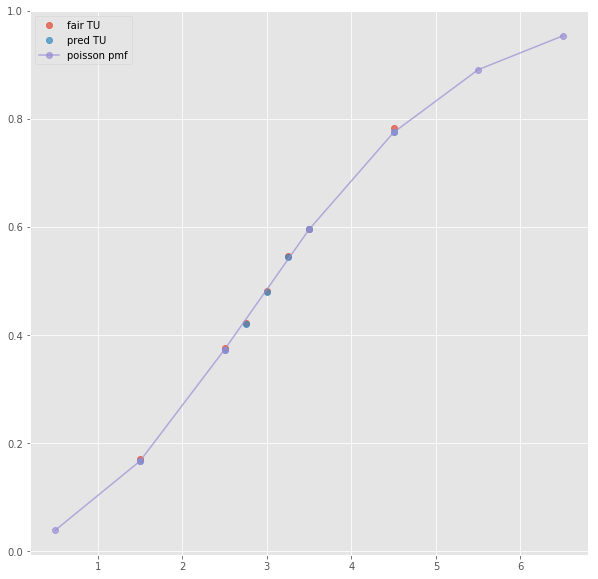

ML : 1.68 4.41 4.63
Error home:  0.003381831422268222
Error draw:  0.007814579642510866
Error away:  0.004432538438298633

(44, 124)
(1, 21)
next list index out of range
(86, 124)
(1, 21)
next list index out of range
(152, 124)
(1, 19)
next list index out of range
(40, 124)
(1, 44)
3.5 2.38 1.617 -0.5 1.68 2.29
TO fair:  2.4718614718614718 TU fair:  1.6794117647058824
TO pred:  2.47185 TU fair:  1.67942
Error TO:  0.0029840364356873428

Error TO:  0.0019136277142366431

Error TO:  1.8775333193721266e-06

Error TO:  0.007930293776569813

Error TO:  0.0027622889956548935

Error TO:  0.004378070393274647

Error TO:  0.0013979127803414593



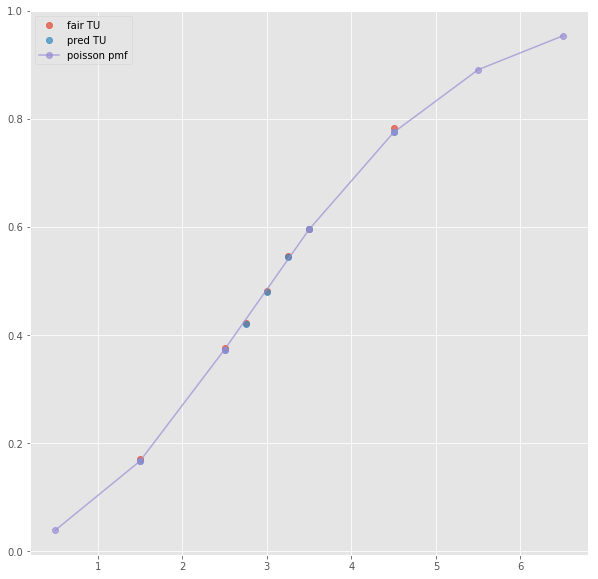

Error T1O:  0.0031819313085941214
ML : 1.68 4.41 4.63
Error home:  0.003381831422268222
Error draw:  0.007814579642510866
Error away:  0.004432538438298633

(51, 124)
(1, 72)
3.5 2.35 1.575 -0.5 1.7 2.1
TO fair:  2.492063492063492 TU fair:  1.6702127659574466
TO pred:  2.49211 TU fair:  1.67019
Error TO:  0.014463465482746796

Error TO:  0.021976086443525666

Error TO:  0.00951834113851513

Error TO:  7.488602181360271e-06

Error TO:  0.007622567085830173

Error TO:  0.018540255293456376

Error TO:  0.020633743616199962

Error TO:  0.025189783686706657

Error TO:  0.0040947711533078635

Error TO:  0.025743498194506387

Error TO:  0.002818034669159808

Error TO:  0.009765205781596287

Error TO:  0.001151906675113723

Error TO:  0.02406759851161855

Error TO:  0.006010540472356329

Error TO:  0.014485059116925464



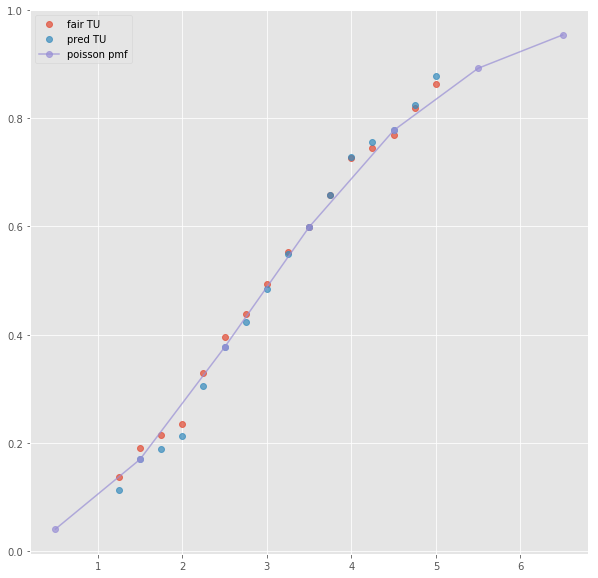

ML : 1.73 4.0 4.33
Error home:  0.006777297939970617
Error draw:  0.0198297355596877
Error away:  0.013052432307580686

(4, 124)
(1, 32)
3.5 2.42 1.6 -0.5 1.76 2.12
TO fair:  2.5124999999999997 TU fair:  1.6611570247933884
TO pred:  2.51252 TU fair:  1.66115
Error TO:  0.011540577522605622

Error TO:  0.009355204237658343

Error TO:  3.1682131903520983e-06

Error TO:  0.012649486139986177

Error TO:  0.004260352026251857



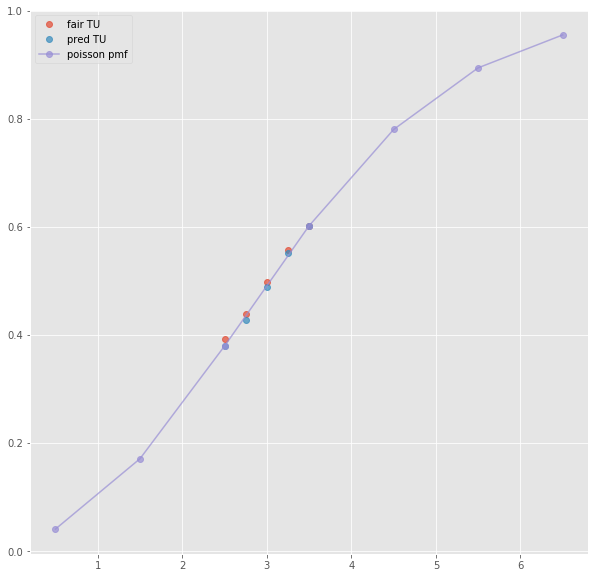

Error T1O:  0.0031734906735638724
ML : 1.77 4.1 4.34
Error home:  0.0027776130401393484
Error draw:  0.01670978370571452
Error away:  0.01393198268758658

(11, 124)
(1, 44)
2.5 1.833 1.961 0.5 2.31 1.598
TO fair:  1.9347271800101988 TU fair:  2.0698308783415165
TO pred:  1.93474 TU fair:  2.06982
Error TO:  0.0011819726337712333

Error TO:  0.0017565931699085047

Error TO:  0.002459067923561764

Error TO:  0.00423883379073392

Error TO:  0.008624915106820646

Error TO:  3.424879816860127e-06

Error TO:  0.004780283881847147

Error TO:  0.0007500470688165395

Error TO:  0.015304827339864713



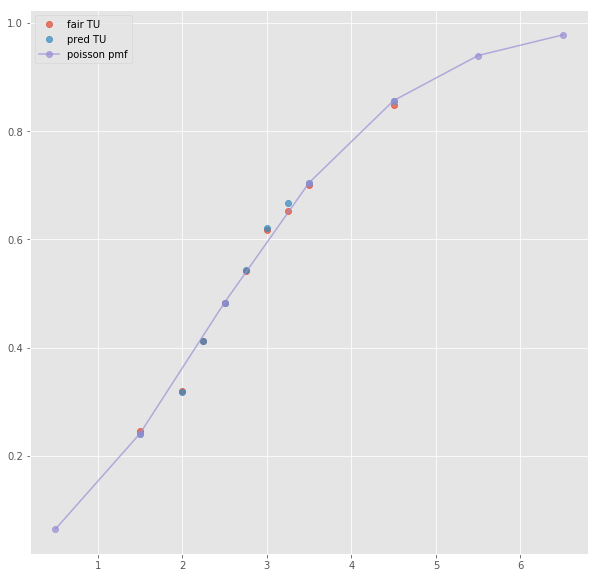

ML : 5.2 3.87 1.598
Error home:  0.004503203816775464
Error draw:  0.014278321033703217
Error away:  0.009774975306578337

(12, 124)
(1, 15)
next list index out of range
(29, 124)
(1, 15)
next list index out of range
(3, 124)
(1, 44)
2.5 1.787 2.01 1.5 1.584 2.35
TO fair:  1.889054726368159 TU fair:  2.124790151091214
TO pred:  1.88908 TU fair:  2.12476
Error TO:  0.00016160385727187476

Error TO:  0.006244866241007063

Error TO:  0.0018912421727889095

Error TO:  0.003942763893850676

Error TO:  0.008295759181416645

Error TO:  7.082274656511345e-06

Error TO:  0.0007554919964820606

Error TO:  0.000781238550087382

Error TO:  0.0033095567649409907



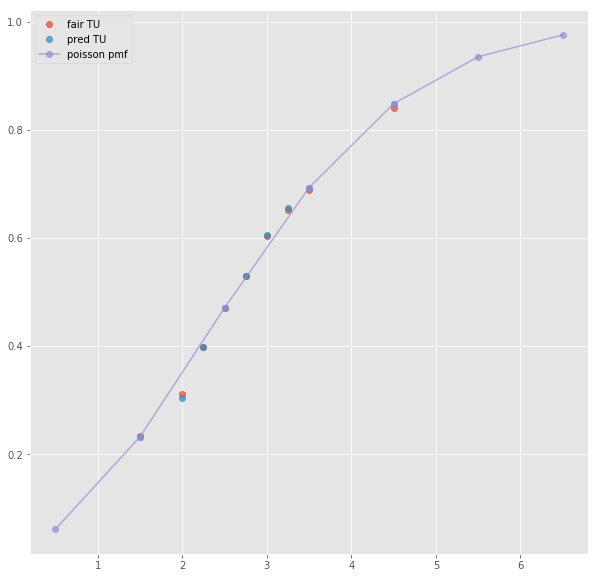

Error T1O:  0.00892714870618061
ML : 6.09 4.4 1.454
Error home:  0.009444624894200115
Error draw:  0.004739300598524926
Error away:  0.014184104281229515

(10, 124)
(1, 15)
next list index out of range
(14, 124)
(1, 32)
2.5 1.91 1.93 0.5 2.38 1.61
TO fair:  1.9896373056994816 TU fair:  2.0104712041884816
TO pred:  1.98961 TU fair:  2.0105
Error TO:  0.0024781423546310632

Error TO:  0.00452869799000577

Error TO:  0.005782901355962988

Error TO:  6.897813306649958e-06

Error TO:  0.0031077685683594813



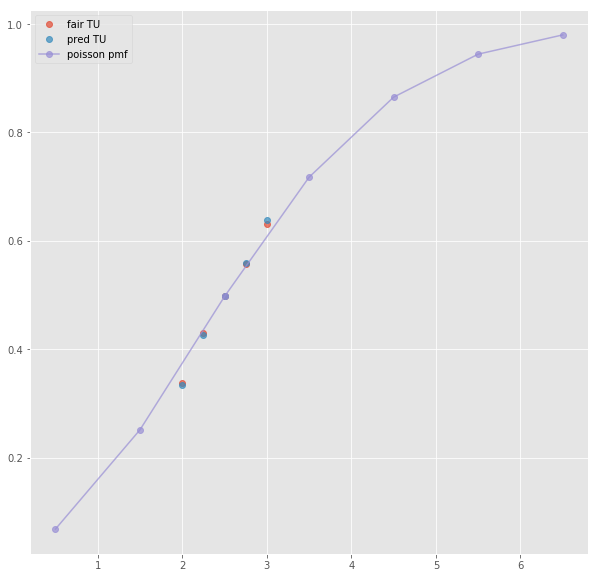

Error T1O:  0.008913449506512405
ML : 5.59 4.1 1.62
Error home:  0.0046498677474547945
Error draw:  0.007632576557534992
Error away:  0.0029825968943125725

(84, 124)
next positional indexers are out-of-bounds
(2302, 124)
next positional indexers are out-of-bounds
(171, 124)
next positional indexers are out-of-bounds
(379, 124)
next positional indexers are out-of-bounds
(72, 124)
(1, 44)
2.5 2.15 1.751 0.5 1.943 1.961
TO fair:  2.2278697886921757 TU fair:  1.8144186046511628
TO pred:  2.22791 TU fair:  1.81439
Error TO:  0.00011558510713127745

Error TO:  0.0018558346870335418

Error TO:  6.523459475285542e-05

Error TO:  8.101412601657643e-06

Error TO:  0.0011849486993962266

Error TO:  0.0017931429944623156

Error TO:  0.001582440959431164



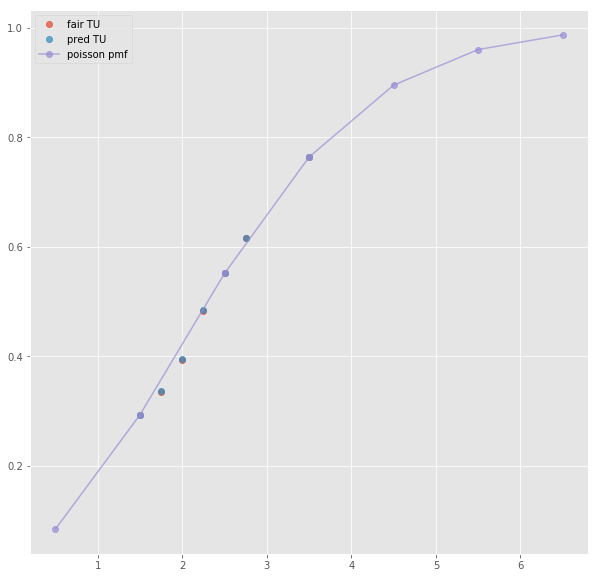

Error T1O:  0.007079809725328956
ML : 4.44 3.35 1.961
Error home:  0.02458492720678601
Error draw:  0.02893063502466997
Error away:  0.004345629309946919

(35, 124)
(1, 64)
2.5 2.05 1.75 0.5 2.075 1.725
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17137 TU fair:  1.8537
Error TO:  0.00553519951934639

Error TO:  0.013601482666040221

Error TO:  0.016165847866408345

Error TO:  0.018186318005699253

Error TO:  1.2422426491298655e-05

Error TO:  0.0026598290823284243

Error TO:  0.0020564730675987075

Error TO:  0.010867722361024845

Error TO:  0.01589457400388683

Error TO:  0.01993212859652785

Error TO:  0.020641586989545158

Error TO:  0.022780135728210887

Error TO:  0.018742052420808952

Error TO:  0.03452538387395965



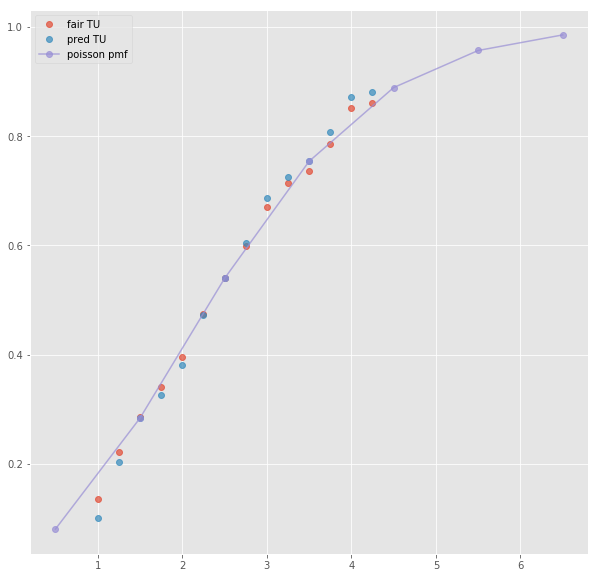

ML : 5.0 3.4 1.75
Error home:  0.01862453590635363
Error draw:  0.0283950574078623
Error away:  0.009770646299606778

(43, 124)
(1, 34)
2.5 2.12 1.76 0.5 1.92 1.93
TO fair:  2.2045454545454546 TU fair:  1.830188679245283
TO pred:  2.20457 TU fair:  1.83017
Error TO:  0.004670229187280384

Error TO:  0.00161581029617619

Error TO:  5.0504273479967665e-06

Error TO:  0.0010139502657394717

Error TO:  0.0036106620918655574



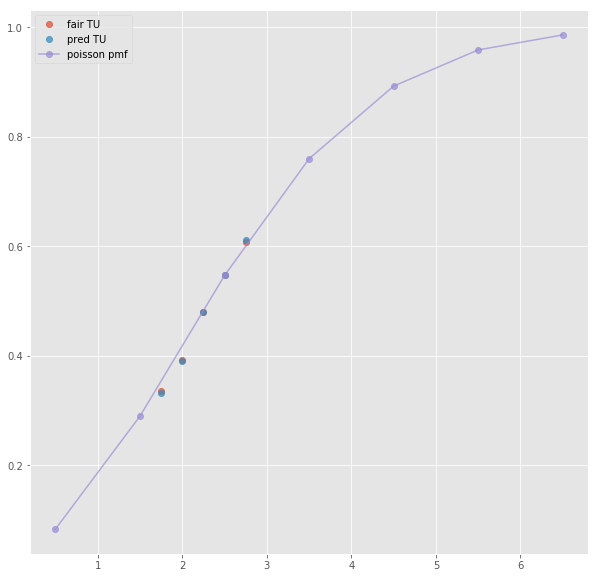

Error T1O:  0.009850549234118655
ML : 4.23 3.46 1.94
Error home:  0.015551756769909914
Error draw:  0.019047116981652956
Error away:  0.003495230083462142

(37, 124)
(1, 42)
3.5 2.33 1.632 -1.5 1.952 1.934
TO fair:  2.4276960784313726 TU fair:  1.7004291845493562
TO pred:  2.42768 TU fair:  1.70044
Error TO:  0.0023332061627401313

Error TO:  0.0015079156916447678

Error TO:  2.7280851340738543e-06

Error TO:  0.006879274536144037

Error TO:  0.0025410949704082197

Error TO:  0.00583351640267038

Error TO:  0.0009095619236956787

Error TO:  0.005034685955661533



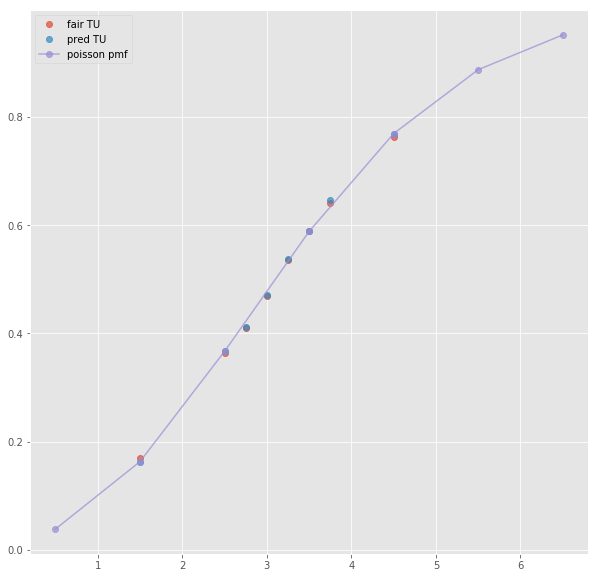

ML : 1.296 5.56 10.01
Error home:  0.011132091083284501
Error draw:  0.005001506869708128
Error away:  0.016133698246918418

(80, 124)
(1, 25)
3.5 2.14 1.69 -1.5 1.98 1.86
TO fair:  2.2662721893491127 TU fair:  1.7897196261682242
TO pred:  2.26627 TU fair:  1.78972
Error TO:  0.030540364029025713

Error TO:  0.035946214324270476

Error TO:  4.26276410780968e-07

Error TO:  0.04633122727046374



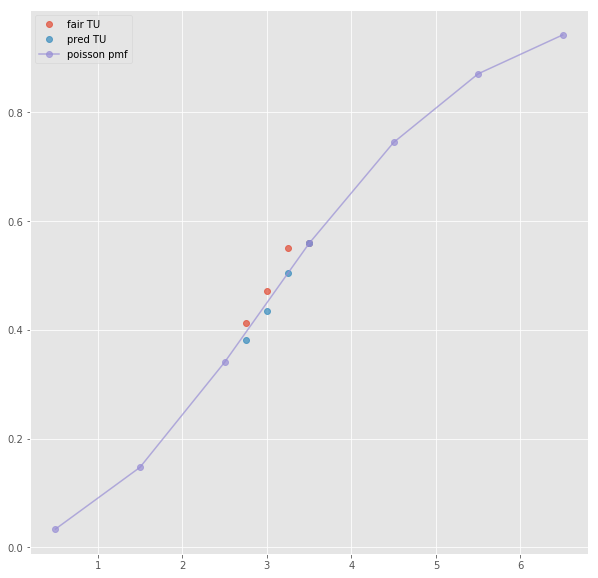

ML : 1.31 4.86 9.21
Error home:  0.002258541494584043
Error draw:  0.022141825277154664
Error away:  0.024400250319359496

(106, 124)
(1, 20)
next list index out of range
(293, 124)
(1, 22)
3.5 2.25 1.7 -1.5 2.03 1.89
TO fair:  2.3235294117647056 TU fair:  1.7555555555555553
TO pred:  2.32353 TU fair:  1.75556
Error TO:  0.015778002408699976

Error TO:  1.0895687041490021e-07

Error TO:  0.028294983724125033



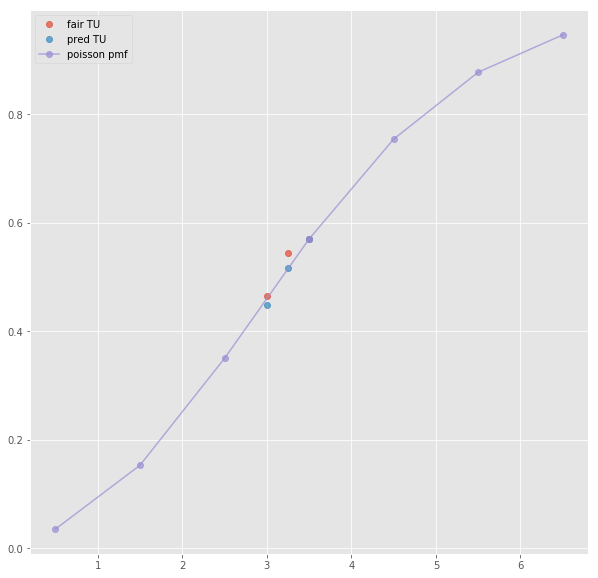

ML : 1.33 5.5 8.5
Error home:  0.009438576825944178
Error draw:  0.0027925013286275446
Error away:  0.01223098534473932

(27, 124)
(1, 44)
3.5 2.32 1.636 -1.5 1.925 1.961
TO fair:  2.4180929095354524 TU fair:  1.7051724137931035
TO pred:  2.41806 TU fair:  1.70519
Error TO:  0.00223736225115867

Error TO:  0.0016702088761352263

Error TO:  5.628357763853842e-06

Error TO:  0.005684920017165279

Error TO:  0.001914704336898665

Error TO:  0.004678901645297384

Error TO:  0.0012763434382128125

Error TO:  0.003338856236614618



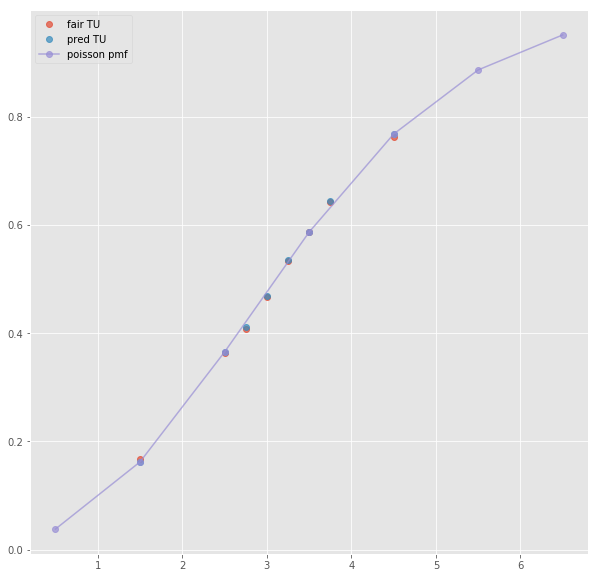

Error T1O:  0.0035500998876549783
ML : 1.291 5.62 10.12
Error home:  0.008050968629680022
Error draw:  0.005613334101203571
Error away:  0.01366429571495928

(3, 124)
(1, 67)
3.5 2.2 1.65 -1.5 1.8 2.0
TO fair:  2.3333333333333335 TU fair:  1.7499999999999998
TO pred:  2.33331 TU fair:  1.75001
Error TO:  0.006461554046381046

Error TO:  0.02999955375807206

Error TO:  0.01001913391834075

Error TO:  4.285757143285274e-06

Error TO:  0.01943987587761109

Error TO:  0.010589399871930194

Error TO:  0.02722003132376305

Error TO:  0.023121464881868392

Error TO:  0.0075350542031334955

Error TO:  0.03179508540834697

Error TO:  0.003446967166968795

Error TO:  0.004105373543334345

Error TO:  0.0042410192905897315

Error TO:  0.018866726204318368

Error TO:  0.012849968934239175

Error TO:  0.013950825090475877



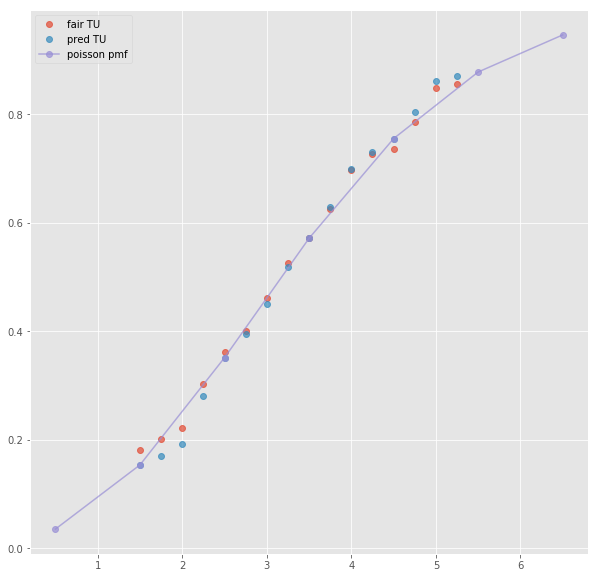

ML : 1.25 6.0 10.0
Error home:  0.004621347644603424
Error draw:  0.0007449663020591968
Error away:  0.005366279254169826

(29, 124)
(1, 34)
3.5 2.27 1.67 -1.5 1.89 1.95
TO fair:  2.3592814371257487 TU fair:  1.73568281938326
TO pred:  2.35924 TU fair:  1.7357
Error TO:  0.009863504786432165

Error TO:  0.007510273914515642

Error TO:  7.444537976963872e-06

Error TO:  0.019079736107401102

Error TO:  0.0036651030891446945

Error TO:  0.0013023460928538455



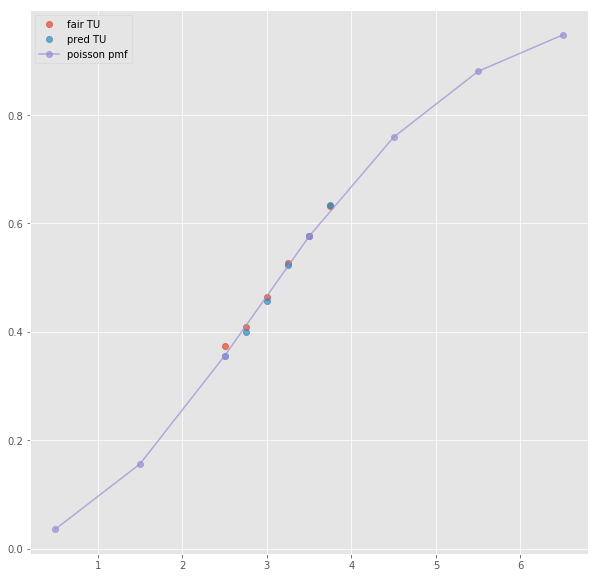

Error T1O:  0.0006412213186843818
ML : 1.34 5.61 8.74
Error home:  0.011590377592399337
Error draw:  0.009542217175413897
Error away:  0.002048207781175926

(86, 124)
(1, 39)
2.5 2.37 1.625 -0.5 1.925 1.97
TO fair:  2.4584615384615387 TU fair:  1.6856540084388185
TO pred:  2.45848 TU fair:  1.68565
Error TO:  0.000468090018291234

Error TO:  0.006261181145072792

Error TO:  0.0010532780209911996

Error TO:  3.0544835562529293e-06

Error TO:  0.0070509422979000425

Error TO:  0.0022721855581693817

Error TO:  0.007042125925354026



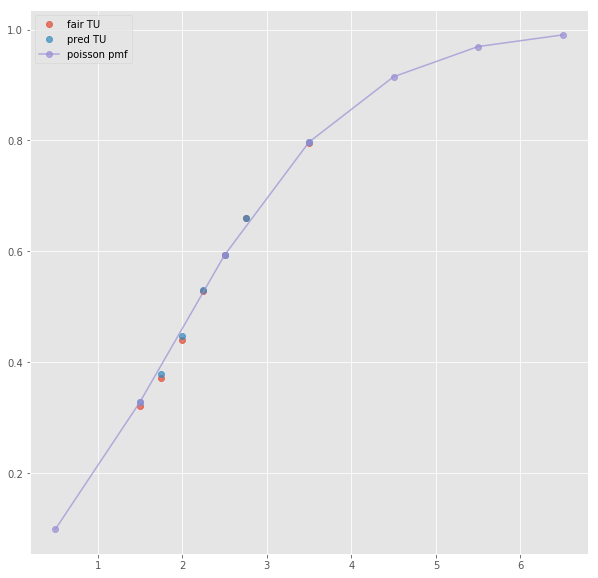

ML : 1.925 3.21 4.92
Error home:  0.0035181820794926155
Error draw:  0.03310657831675062
Error away:  0.02958829253721207

(2247, 124)
(1, 21)
next list index out of range
(114, 124)
(1, 19)
next list index out of range
(248, 124)
(1, 21)
next list index out of range
(84, 124)
(1, 41)
2.5 2.37 1.625 -0.5 1.925 1.97
TO fair:  2.4584615384615387 TU fair:  1.6856540084388185
TO pred:  2.45848 TU fair:  1.68565
Error TO:  0.000468090018291234

Error TO:  0.006261181145072792

Error TO:  0.0010532780209911996

Error TO:  3.0544835562529293e-06

Error TO:  0.0070509422979000425

Error TO:  0.0022721855581693817

Error TO:  0.007042125925354026



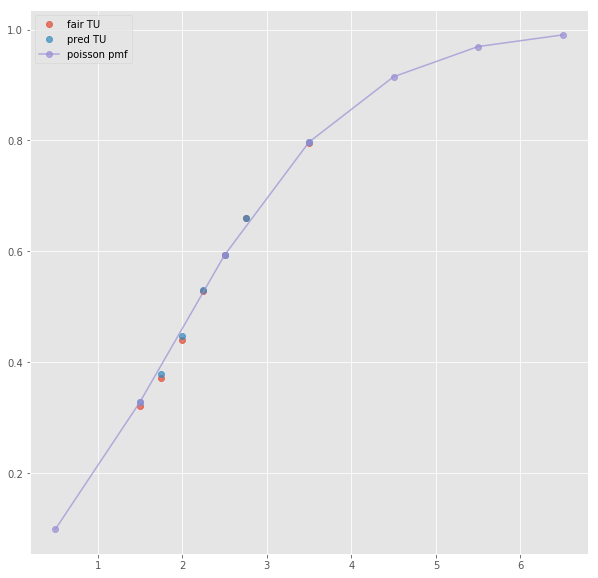

Error T1O:  0.013951892688906287
ML : 1.925 3.21 4.92
Error home:  0.0035181820794926155
Error draw:  0.03310657831675062
Error away:  0.02958829253721207

(22, 124)
(1, 60)
2.5 2.25 1.625 -0.5 1.9 1.95
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.0009003040170663112

Error TO:  0.006924440558772171

Error TO:  0.005660988994402261

Error TO:  0.014579997301658959

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.008832548426947251

Error TO:  0.016912035740595688

Error TO:  0.020352240119340337

Error TO:  0.011428927950369011

Error TO:  0.022057817955149273

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



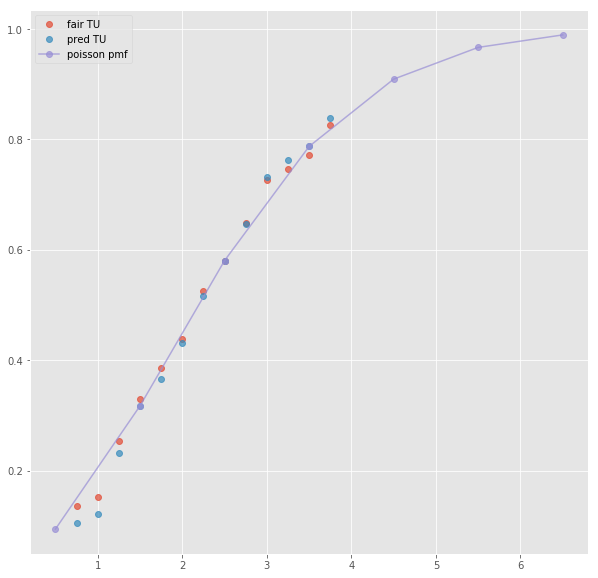

ML : 1.83 3.25 4.75
Error home:  0.006782131797572033
Error draw:  0.02402623564640699
Error away:  0.030808224643949444

(30, 124)
next positional indexers are out-of-bounds
(23, 124)
(1, 41)
2.5 2.21 1.729 -0.5 2.82 1.487
TO fair:  2.2781954887218046 TU fair:  1.7823529411764707
TO pred:  2.27821 TU fair:  1.78235
Error TO:  0.0022758267683412603

Error TO:  0.0003566776313194131

Error TO:  0.006097695144934523

Error TO:  2.795895445828478e-06

Error TO:  0.002724500409659214

Error TO:  0.0001435999587825476

Error TO:  0.0016214024634444435



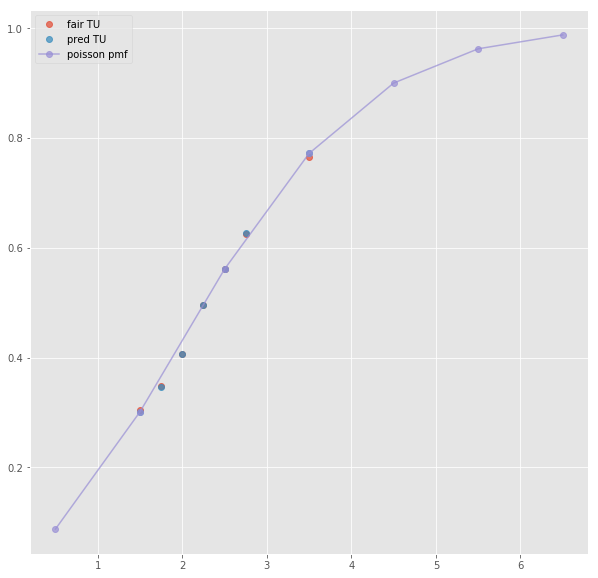

ML : 2.82 3.25 2.73
Error home:  0.00048790442144280854
Error draw:  0.024978855461673943
Error away:  0.024491285576918986

(28, 124)
(1, 21)
next list index out of range
(69, 124)
(1, 21)
next list index out of range
(126, 124)
(1, 23)
next list index out of range
(23, 124)
(1, 43)
2.5 2.21 1.729 -0.5 2.82 1.487
TO fair:  2.2781954887218046 TU fair:  1.7823529411764707
TO pred:  2.27821 TU fair:  1.78235
Error TO:  0.0022758267683412603

Error TO:  0.0003566776313194131

Error TO:  0.006097695144934523

Error TO:  2.795895445828478e-06

Error TO:  0.002724500409659214

Error TO:  0.0001435999587825476

Error TO:  0.0016214024634444435



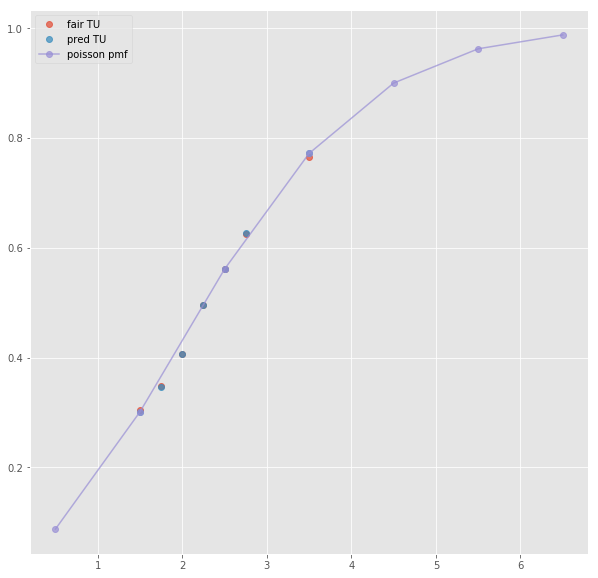

Error T1O:  0.013179543255111392
ML : 2.82 3.25 2.73
Error home:  0.00048790442144280854
Error draw:  0.024978855461673943
Error away:  0.024491285576918986

(48, 124)
(1, 64)
2.5 2.15 1.675 -0.5 2.6 1.475
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.0019828906081326148

Error TO:  0.015336591097173724

Error TO:  0.02012281955881773

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.003324458045389722

Error TO:  0.01953264469851873

Error TO:  0.004239623461053776

Error TO:  0.021645654202264566

Error TO:  0.029437934475323377

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.027687276980177478



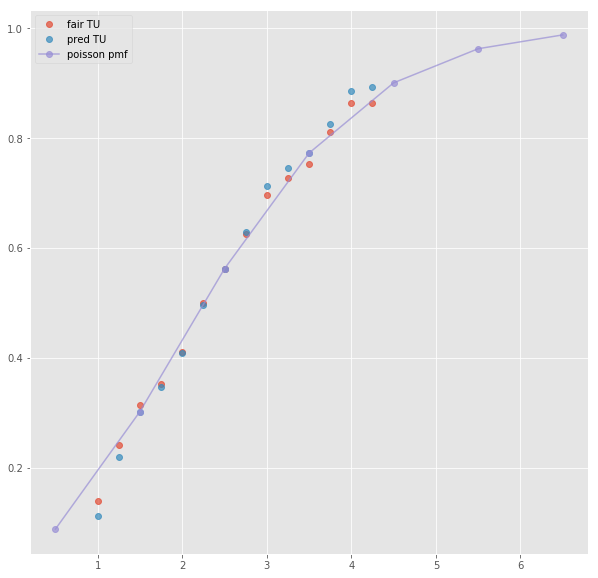

ML : 2.75 3.2 2.625
Error home:  0.017955000961982437
Error draw:  0.020970401526113125
Error away:  0.0030157338181995286

(11, 124)
(1, 33)
2.5 2.21 1.7 -0.5 2.76 1.48
TO fair:  2.3000000000000003 TU fair:  1.7692307692307694
TO pred:  2.30004 TU fair:  1.76921
Error TO:  0.006195292571073319

Error TO:  0.0020792808676584063

Error TO:  7.561305171932542e-06

Error TO:  0.00011247469319397574

Error TO:  0.0035651828660743234



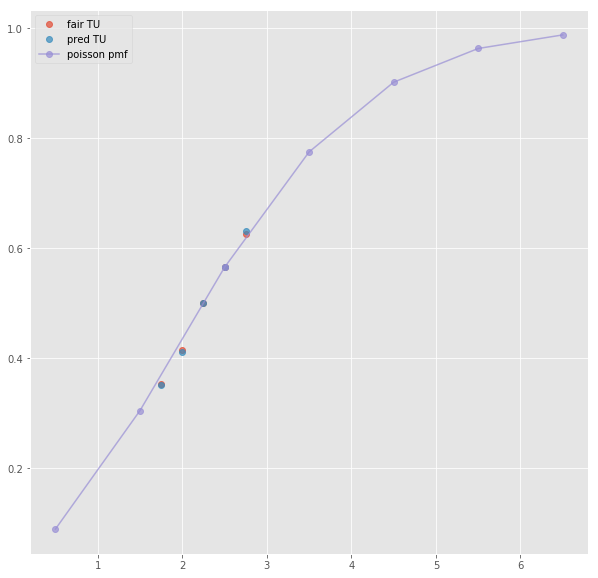

Error T1O:  0.007465995252936064
ML : 2.81 3.26 2.65
Error home:  0.006846235855770266
Error draw:  0.019627568371236803
Error away:  0.012781327756442029

(164, 124)
(1, 45)
2.5 1.862 2.03 -0.5 2.49 1.602
TO fair:  1.9172413793103449 TU fair:  2.090225563909774
TO pred:  1.91724 TU fair:  2.09023
Error TO:  0.00036170335989732516

Error TO:  0.001176035082037119

Error TO:  0.0002029034290183529

Error TO:  0.00039913731385271545

Error TO:  0.000650134090391552

Error TO:  3.75239646799308e-07

Error TO:  0.0004125220567242627

Error TO:  0.0012209505039149082

Error TO:  0.02106490649645365



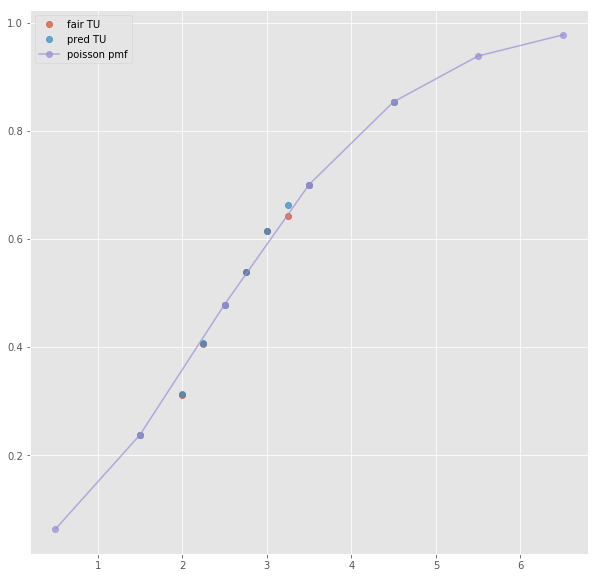

ML : 2.49 3.58 2.87
Error home:  0.0013527809726724405
Error draw:  0.0168315739005232
Error away:  0.015478555835232555

(239, 124)
(1, 29)
2.5 1.84 2.0 -0.5 2.4 1.58
TO fair:  1.92 TU fair:  2.0869565217391304
TO pred:  1.92001 TU fair:  2.08694
Error TO:  0.0024699515721008924

Error TO:  0.01775426797247226

Error TO:  2.712659482706492e-06

Error TO:  0.002163657503509442



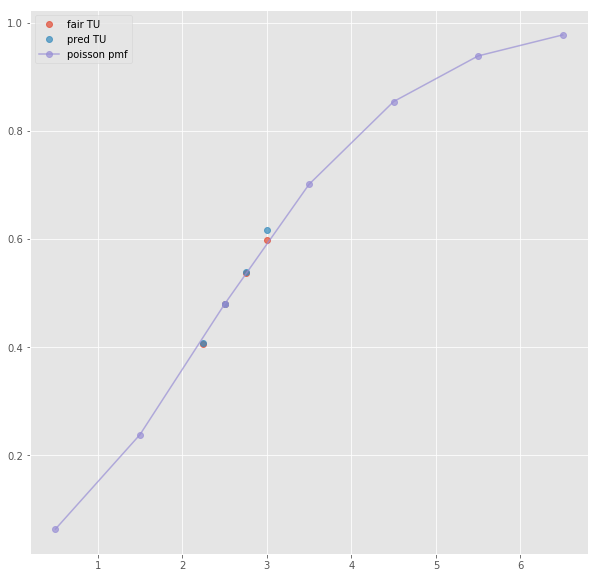

ML : 2.45 3.51 2.77
Error home:  0.009771189237575084
Error draw:  0.01575350833242456
Error away:  0.005982488519752083

(280, 124)
(1, 25)
2.5 1.87 2.05 -0.5 2.44 1.64
TO fair:  1.9121951219512194 TU fair:  2.096256684491978
TO pred:  1.91216 TU fair:  2.0963
Error TO:  0.0003220636525695375

Error TO:  0.010632780890635518

Error TO:  9.605549189828366e-06



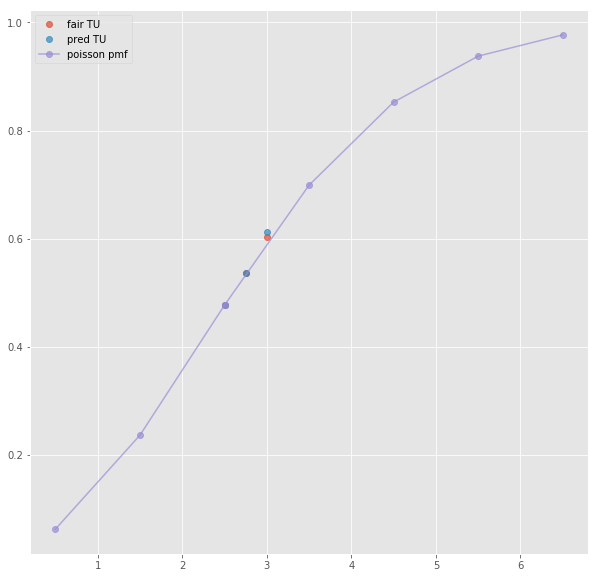

ML : 2.48 3.4 2.88
Error home:  0.01595042800834756
Error draw:  0.027684888238772798
Error away:  0.0117346355306715

(480, 124)
(1, 27)
2.5 1.9 2.02 -0.5 2.49 1.62
TO fair:  1.9405940594059403 TU fair:  2.063157894736842
TO pred:  1.9406 TU fair:  2.06315
Error TO:  0.011840420164025312

Error TO:  0.0121536291210938

Error TO:  1.5774628928655332e-06

Error TO:  0.012568427849118491



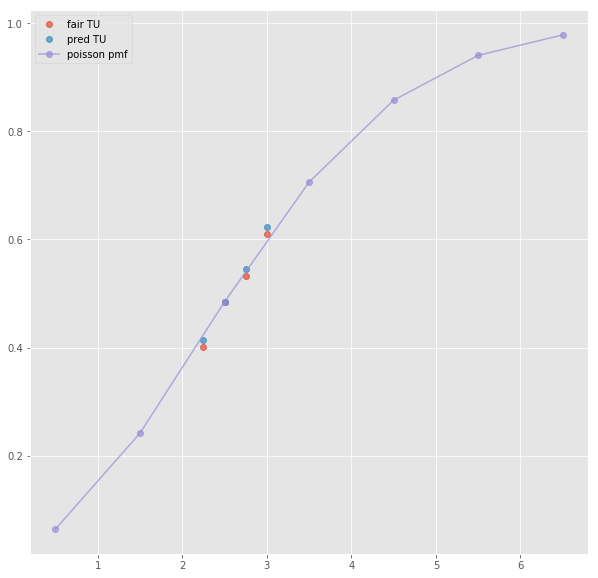

ML : 2.47 3.5 2.85
Error home:  0.00543075114846453
Error draw:  0.018515079698425363
Error away:  0.013084420311113287

(127, 124)
(1, 47)
2.5 1.862 2.03 -0.5 2.46 1.609
TO fair:  1.9172413793103449 TU fair:  2.090225563909774
TO pred:  1.91724 TU fair:  2.09023
Error TO:  0.00036170335989732516

Error TO:  0.0018666042290603757

Error TO:  0.0002029034290183529

Error TO:  0.00039913731385271545

Error TO:  0.000650134090391552

Error TO:  3.75239646799308e-07

Error TO:  0.0008561392729298234

Error TO:  0.0012209505039149082

Error TO:  0.02106490649645365



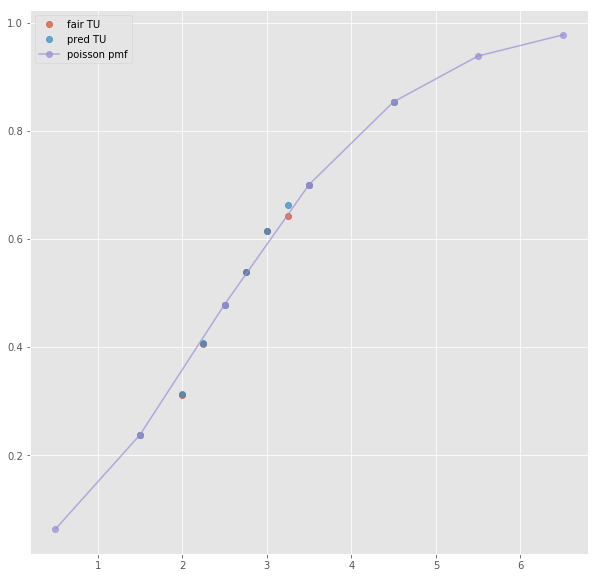

Error T1O:  0.006510388033894199
ML : 2.46 3.58 2.91
Error home:  0.0005748743244204935
Error draw:  0.016916377671540417
Error away:  0.01634163062201477

(66, 124)
(1, 67)
3.5 2.85 1.4 -0.5 2.375 1.55
TO fair:  3.0357142857142856 TU fair:  1.4912280701754383
TO pred:  3.03568 TU fair:  1.49124
Error TO:  0.01728874476442749

Error TO:  0.023178453908127117

Error TO:  0.01404413030247842

Error TO:  3.7204572441718042e-06

Error TO:  0.005405694091826729

Error TO:  0.01356860140263172

Error TO:  0.02596506964252021

Error TO:  0.02040485891898225

Error TO:  0.008922298921189675

Error TO:  0.02076419431786314

Error TO:  0.009250777385402309

Error TO:  0.007345720255009541

Error TO:  0.0033291803006234577

Error TO:  0.025898092781382887

Error TO:  0.013202507524611384



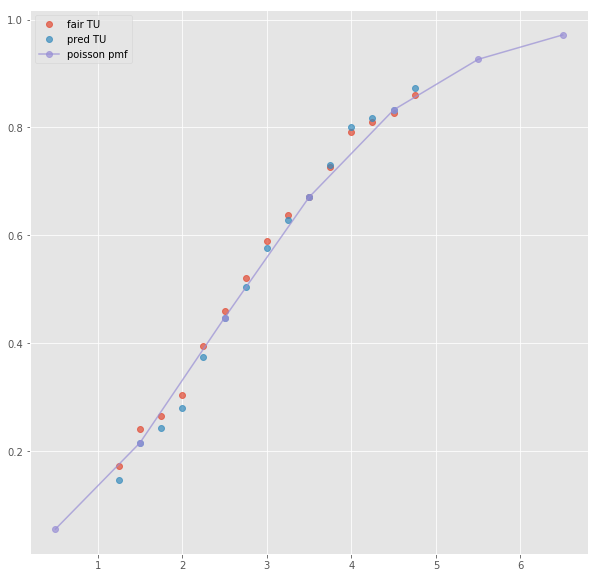

ML : 2.45 3.5 2.8
Error home:  0.006546844887355463
Error draw:  0.024121238440094755
Error away:  0.017574434501254288

(51, 124)
next positional indexers are out-of-bounds
(103, 124)
(1, 45)
2.5 2.07 1.826 -0.5 2.39 1.645
TO fair:  2.133625410733844 TU fair:  1.8821256038647343
TO pred:  2.13368 TU fair:  1.88208
Error TO:  0.0007473950273328422

Error TO:  0.00253327263931602

Error TO:  0.0020604953700432693

Error TO:  0.0033320870283308768

Error TO:  1.1991121258048132e-05

Error TO:  0.002161818524906267

Error TO:  0.0008023618762893481

Error TO:  0.0049000894935647965



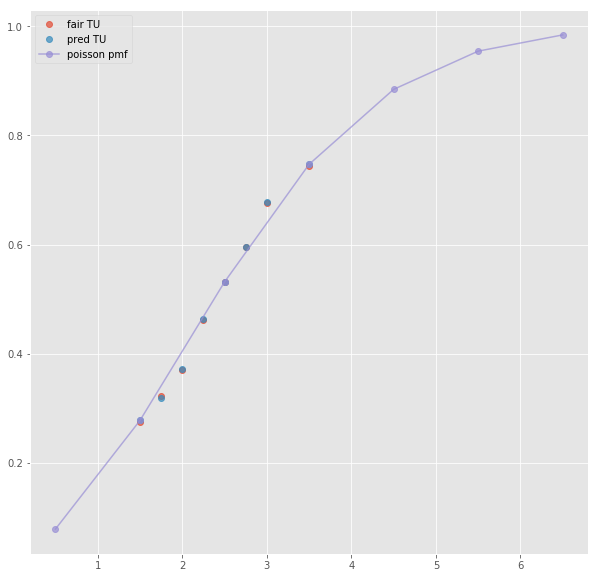

ML : 2.39 3.25 3.3
Error home:  0.0011033661257099925
Error draw:  0.0331795332660782
Error away:  0.03207634842410423

(135, 124)
(1, 27)
2.5 2.07 1.77 -0.5 2.29 1.64
TO fair:  2.169491525423729 TU fair:  1.855072463768116
TO pred:  2.16949 TU fair:  1.85507
Error TO:  0.00022446586645780142

Error TO:  0.00012059037983624954

Error TO:  3.2409690753354425e-07

Error TO:  0.0027869818420106496



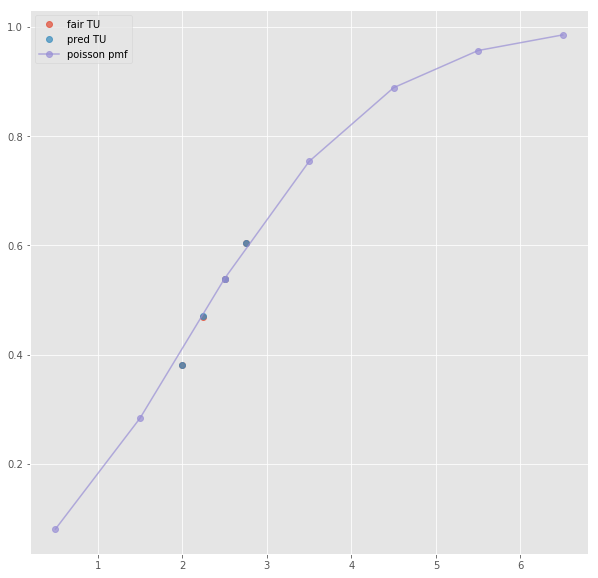

ML : 2.32 3.21 3.16
Error home:  0.010301360792606351
Error draw:  0.0271666276549547
Error away:  0.016865144234939067

(115, 124)
(1, 27)
2.5 2.11 1.82 -0.5 2.44 1.64
TO fair:  2.1593406593406588 TU fair:  1.862559241706161
TO pred:  2.15933 TU fair:  1.86257
Error TO:  0.0025122842622370967

Error TO:  0.004631792960722914

Error TO:  2.2860733505658537e-06

Error TO:  0.0023495278465970326



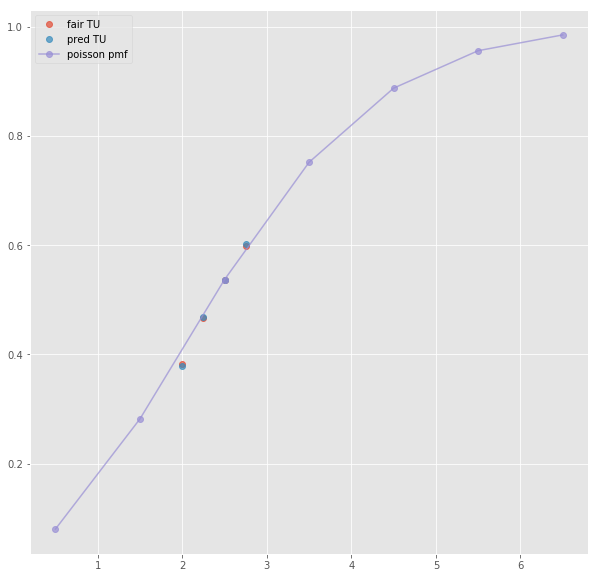

ML : 2.38 3.2 3.15
Error home:  0.001839120690612206
Error draw:  0.030159365537478944
Error away:  0.028320407373425616

(319, 124)
(1, 27)
2.5 2.12 1.81 -0.5 2.42 1.65
TO fair:  2.1712707182320443 TU fair:  1.8537735849056605
TO pred:  2.17125 TU fair:  1.85379
Error TO:  0.008701190070218856

Error TO:  0.00165447773199201

Error TO:  4.394696480281013e-06

Error TO:  0.002545389611271376



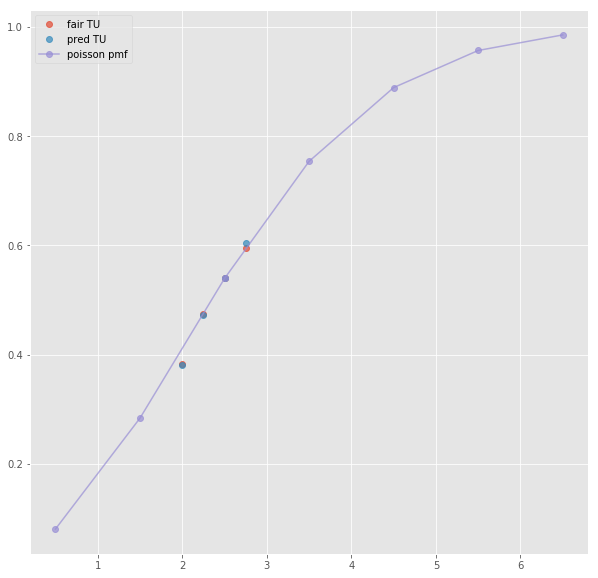

ML : 2.4 3.2 3.2
Error home:  0.005398283543667448
Error draw:  0.03215409710485356
Error away:  0.02675574028146749

(79, 124)
(1, 47)
2.5 2.07 1.826 -0.5 2.39 1.645
TO fair:  2.133625410733844 TU fair:  1.8821256038647343
TO pred:  2.13368 TU fair:  1.88208
Error TO:  0.0007473950273328422

Error TO:  0.00253327263931602

Error TO:  0.0020604953700432693

Error TO:  0.0033320870283308768

Error TO:  1.1991121258048132e-05

Error TO:  0.002161818524906267

Error TO:  0.0008023618762893481

Error TO:  0.0049000894935647965



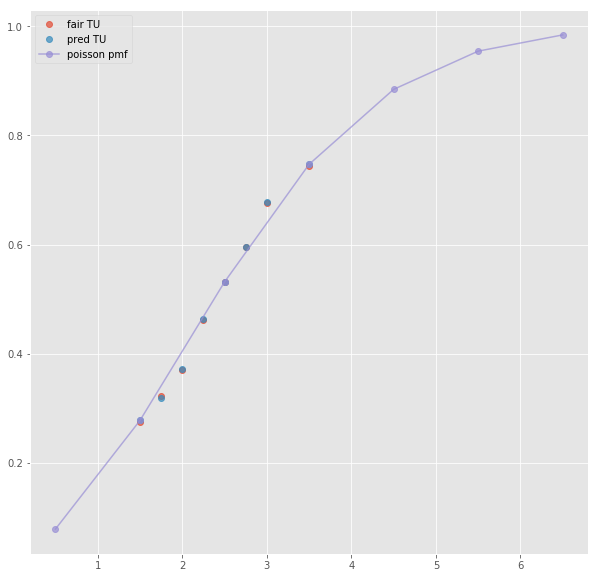

Error T1O:  0.010724296372718656
ML : 2.39 3.25 3.3
Error home:  0.0011033661257099925
Error draw:  0.0331795332660782
Error away:  0.03207634842410423

(39, 124)
(1, 59)
2.5 2.15 1.675 -0.5 2.1 1.83
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.0019828906081326148

Error TO:  0.015336591097173724

Error TO:  0.02012281955881773

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.0007603554812872781

Error TO:  0.01953264469851873

Error TO:  0.014687662129951318

Error TO:  0.021645654202264566

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.027687276980177478



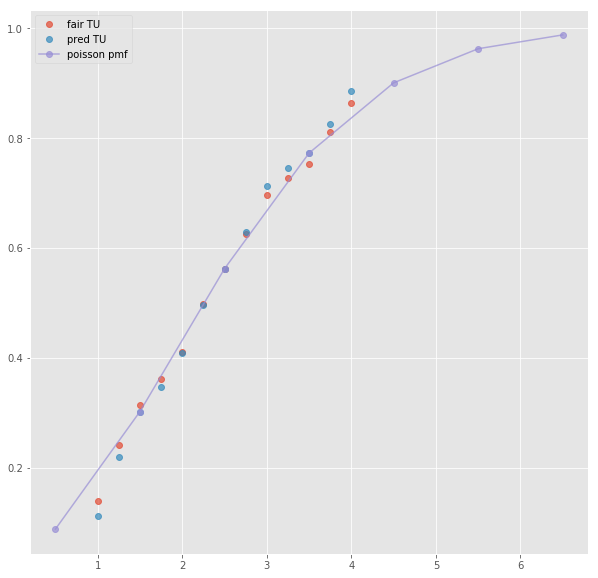

ML : 2.05 3.4 3.8
Error home:  0.0011052642203934204
Error draw:  0.01407597651482495
Error away:  0.01518140556927522

(9, 124)
(1, 35)
2.5 2.17 1.73 -0.5 2.14 1.75
TO fair:  2.254335260115607 TU fair:  1.7972350230414749
TO pred:  2.25427 TU fair:  1.79727
Error TO:  0.0030520622355968974

Error TO:  0.004613120882922206

Error TO:  1.2841726123646868e-05

Error TO:  0.0030814061143958904

Error TO:  0.0041798639182875075



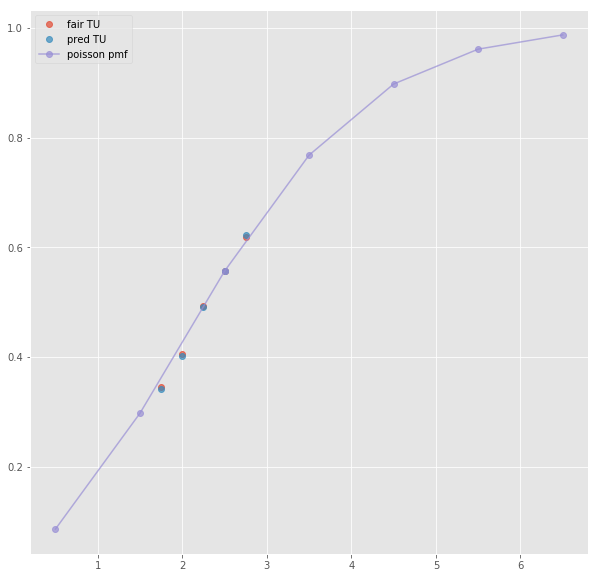

Error T1O:  0.008148240443051846
ML : 2.16 3.33 3.61
Error home:  0.004824333165303618
Error draw:  0.020653122729396567
Error away:  0.015829098749117032

(220, 124)
(1, 45)
3.5 2.78 1.497 -0.5 1.6569999999999998 2.39
TO fair:  2.8570474281897122 TU fair:  1.5384892086330935
TO pred:  2.85705 TU fair:  1.53849
Error TO:  0.0037156095438303227

Error TO:  0.0019992830516130655

Error TO:  3.150675229046662e-07

Error TO:  0.005638498286156479

Error TO:  0.004321329125178797

Error TO:  0.0010662955771606475

Error TO:  0.0034953367066636876

Error TO:  0.0002946418001623097



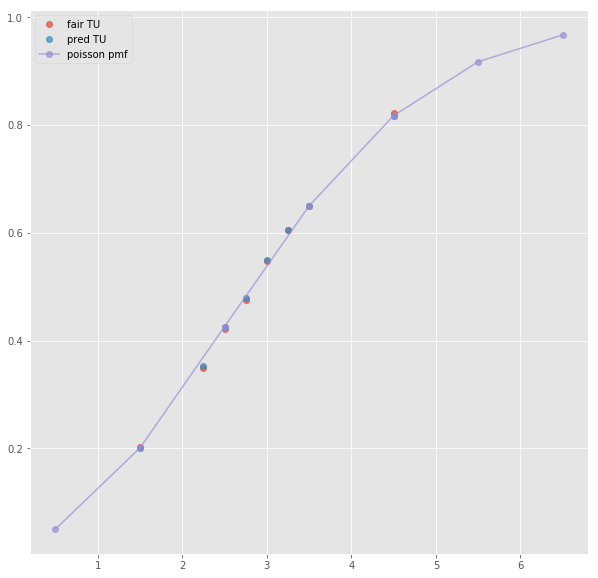

ML : 1.6569999999999998 4.11 5.59
Error home:  0.002187435287217099
Error draw:  0.02115381056977056
Error away:  0.018966427987127304

(244, 124)
(1, 31)
2.5 1.67 2.2 -0.5 1.6 2.36
TO fair:  1.7590909090909093 TU fair:  2.3173652694610785
TO pred:  1.75912 TU fair:  2.31732
Error TO:  0.006792302578258469

Error TO:  0.005442840124469439

Error TO:  9.400988960517331e-06

Error TO:  0.015238442070300673

Error TO:  0.008017415438195563



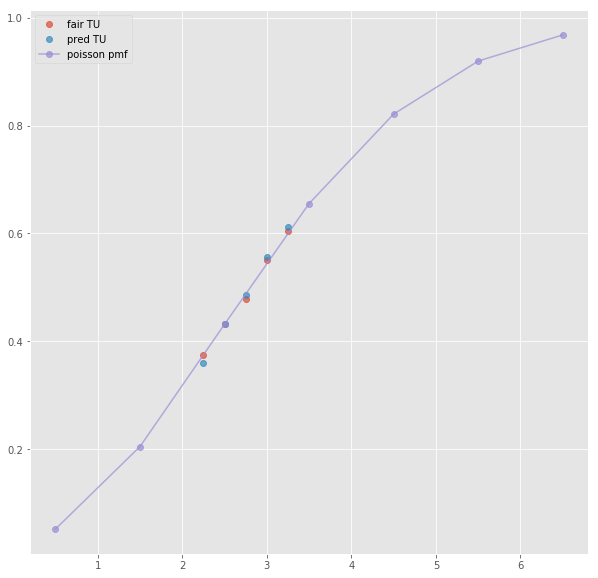

ML : 1.6 4.06 5.36
Error home:  0.005149819072785
Error draw:  0.01720909416807684
Error away:  0.012059364666700573

(200, 124)
(1, 28)
2.5 1.71 2.26 -0.5 1.64 2.44
TO fair:  1.7566371681415929 TU fair:  2.3216374269005846
TO pred:  1.75666 TU fair:  2.32161
Error TO:  0.008023473396897463

Error TO:  0.004422593490689852

Error TO:  7.3989736821822305e-06

Error TO:  0.02515504043018485



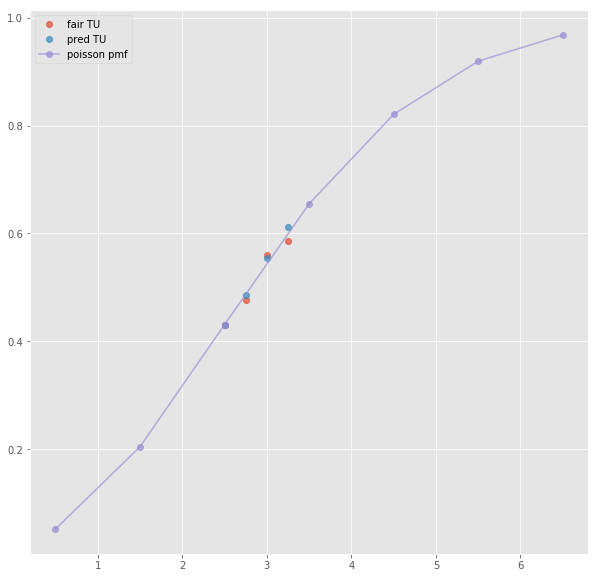

ML : 1.63 4.1 5.4
Error home:  0.009590358550311096
Error draw:  0.01898351310782309
Error away:  0.009393201240150695

(471, 124)
(1, 29)
2.5 1.73 2.23 -0.5 1.64 2.44
TO fair:  1.775784753363229 TU fair:  2.289017341040463
TO pred:  1.77578 TU fair:  2.28902
Error TO:  0.02000342783484854

Error TO:  0.005942561125718671

Error TO:  1.5073757317907166e-06

Error TO:  0.0009339725347135563



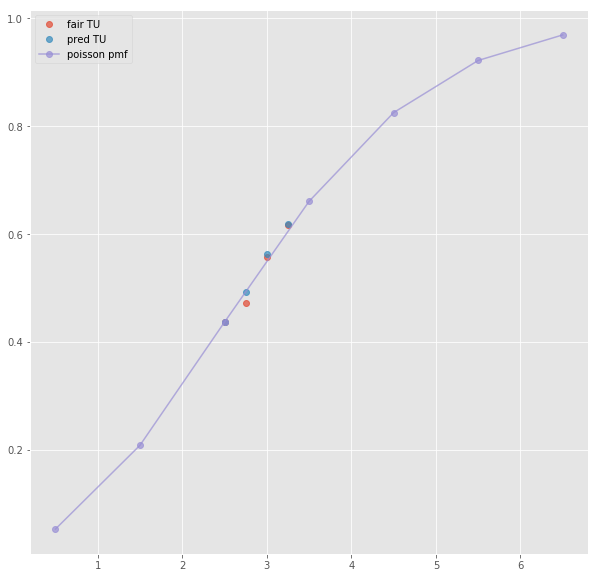

ML : 1.63 4.0 5.7
Error home:  0.007548636085513927
Error draw:  0.024661247708302136
Error away:  0.017112477855574654

(168, 124)
(1, 47)
3.5 2.93 1.456 -0.5 1.625 2.46
TO fair:  3.0123626373626373 TU fair:  1.4969283276450511
TO pred:  3.01231 TU fair:  1.49694
Error TO:  0.000274848833141772

Error TO:  7.166820393506024e-05

Error TO:  5.8007908249058104e-06

Error TO:  0.0025946580214323833

Error TO:  0.0011358425208520817

Error TO:  3.0047859169712865e-05

Error TO:  0.0015933251509007151

Error TO:  0.0004664217035136864



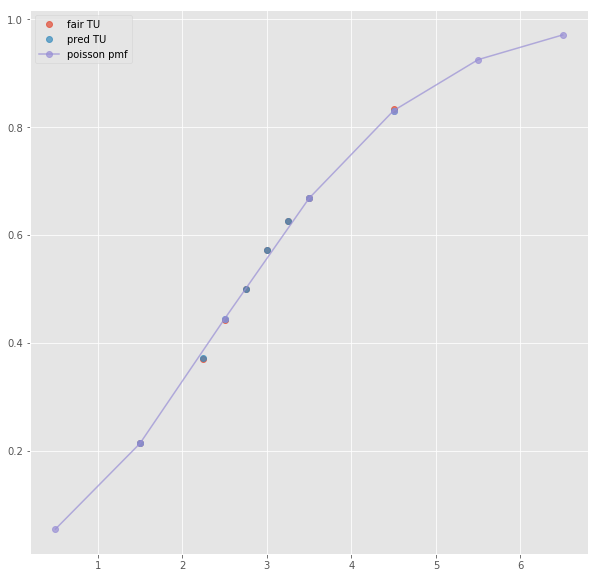

Error T1O:  0.0039334058286580875
Error T1O:  0.0010814919379039112
ML : 1.625 4.07 6.06
Error home:  0.002461155188754338
Error draw:  0.023325174209540778
Error away:  0.02086416670402691

(30, 124)
(1, 71)
3.5 2.425 1.525 -1.5 2.375 1.55
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.59019 TU fair:  1.62886
Error TO:  0.014174596584795807

Error TO:  0.027954184820545014

Error TO:  0.014978962239082905

Error TO:  3.885155582861177e-06

Error TO:  0.011278027205546215

Error TO:  0.01957038365376229

Error TO:  0.024404758866645948

Error TO:  0.023138646275283836

Error TO:  0.006009005748257468

Error TO:  0.02801453483607741

Error TO:  0.00906789630144772

Error TO:  0.010649207127302024

Error TO:  0.0024818977009522514

Error TO:  0.025523228236961293

Error TO:  0.008855884329115299



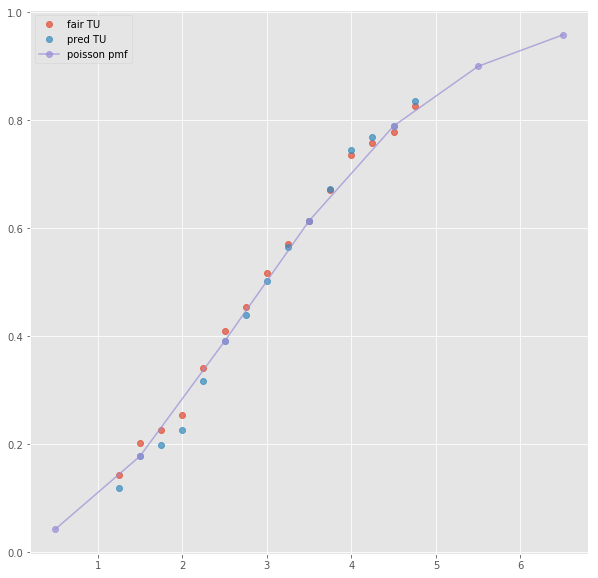

ML : 1.444 4.33 7.5
Error home:  0.026743869505367224
Error draw:  0.018179310246155683
Error away:  0.04492327705247054

(68, 124)
next positional indexers are out-of-bounds
(301, 124)
(1, 50)
3.5 1.917 2.0 1.5 1.505 2.8
TO fair:  1.9585000000000004 TU fair:  2.0432968179447055
TO pred:  1.95848 TU fair:  2.04332
Error TO:  0.00016418372774862355

Error TO:  5.214195120673004e-06

Error TO:  0.0005342925712286117

Error TO:  0.0008478274116869855

Error TO:  0.00230917058957536

Error TO:  0.0006880359428166338

Error TO:  0.0007650327480079322

Error TO:  0.00477248262710897

Error TO:  0.01328755095181361

Error TO:  0.00019167740887954254



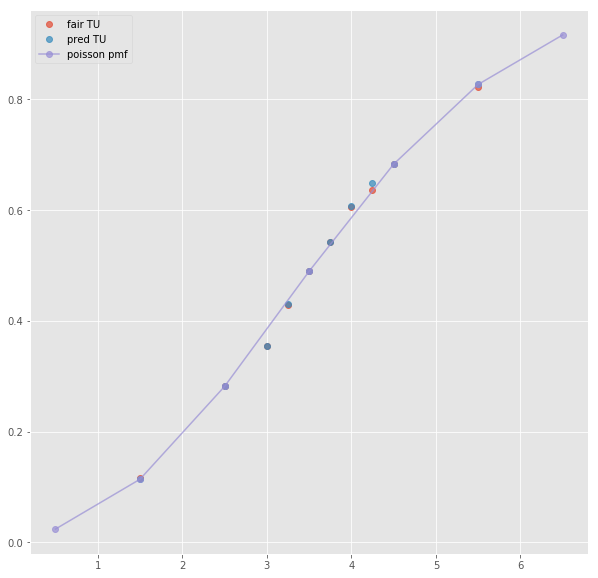

ML : 4.21 4.63 1.746
Error home:  0.008546383163438281
Error draw:  0.011361277069832976
Error away:  0.00281500357845732

(285, 124)
(1, 28)
3.5 1.86 1.98 0.5 2.19 1.71
TO fair:  1.9393939393939397 TU fair:  2.0645161290322585
TO pred:  1.93939 TU fair:  2.06452
Error TO:  1.0473654088460904e-06

Error TO:  0.004039916887890405

Error TO:  0.009975283258335743

Error TO:  0.005338016413965863



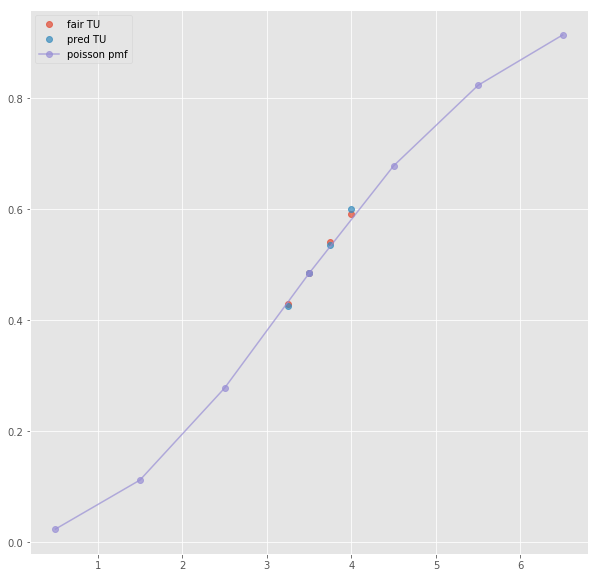

ML : 4.16 4.36 1.71
Error home:  0.012177457424018268
Error draw:  0.019174648260035815
Error away:  0.006997179095416417

(275, 124)
(1, 27)
3.5 1.9 2.02 0.5 2.23 1.76
TO fair:  1.9405940594059403 TU fair:  2.063157894736842
TO pred:  1.94058 TU fair:  2.06317
Error TO:  3.7333673227335495e-06

Error TO:  0.0018978705349607106

Error TO:  0.0008445396562366536

Error TO:  0.007854734331001534



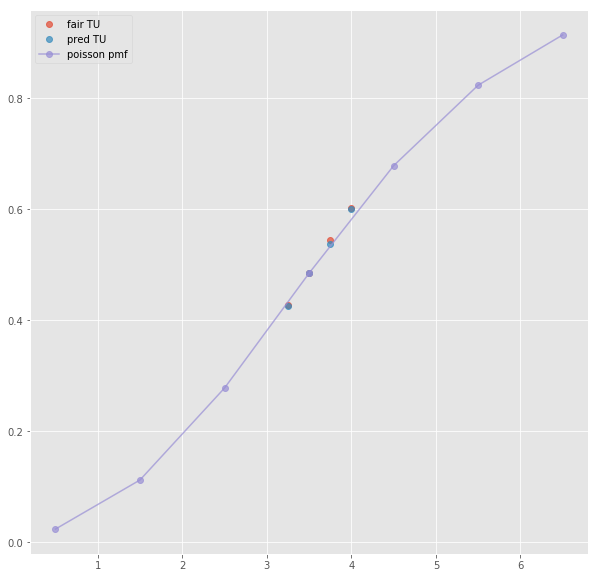

ML : 4.1 4.4 1.73
Error home:  0.009785090569481542
Error draw:  0.017760998435339348
Error away:  0.007975833230840501

(911, 124)
(1, 30)
3.5 1.9 2.02 0.5 2.28 1.73
TO fair:  1.9405940594059403 TU fair:  2.063157894736842
TO pred:  1.94058 TU fair:  2.06317
Error TO:  0.014460439948716153

Error TO:  3.7333673227335495e-06

Error TO:  0.008011562420078833

Error TO:  0.0013236257074620839

Error TO:  0.005310205068914997



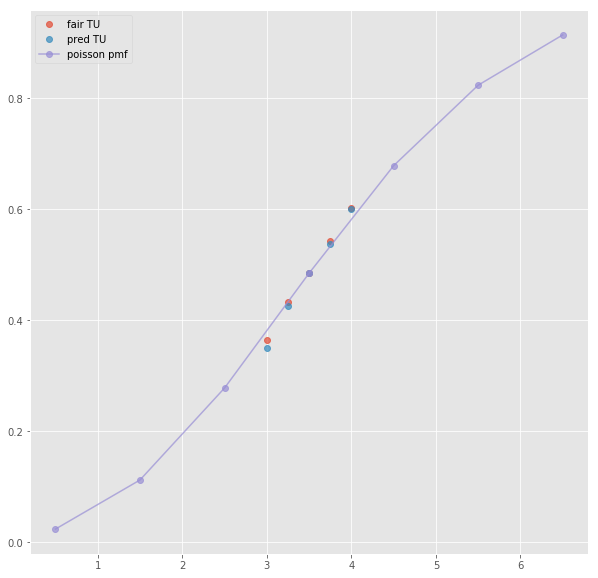

ML : 4.25 4.45 1.72
Error home:  0.008456808498748275
Error draw:  0.018758102898923268
Error away:  0.010301315258479327

(282, 124)
(1, 54)
3.5 1.917 2.0 1.5 1.505 2.8
TO fair:  1.9585000000000004 TU fair:  2.0432968179447055
TO pred:  1.95848 TU fair:  2.04332
Error TO:  0.00016418372774862355

Error TO:  5.214195120673004e-06

Error TO:  0.0005342925712286117

Error TO:  0.0008478274116869855

Error TO:  0.00230917058957536

Error TO:  0.0006880359428166338

Error TO:  0.0007650327480079322

Error TO:  0.00477248262710897

Error TO:  0.01328755095181361

Error TO:  0.00019167740887954254



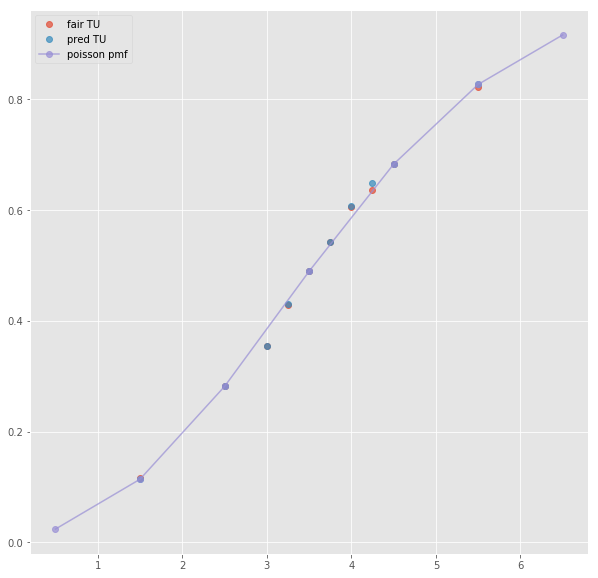

Error T1O:  0.0013949624005286654
Error T1O:  0.005684499426979683
ML : 4.21 4.63 1.746
Error home:  0.008546383163438281
Error draw:  0.011361277069832976
Error away:  0.00281500357845732

(46, 124)
(1, 77)
3.5 2.0 1.8 0.5 2.07 1.83
TO fair:  2.111111111111111 TU fair:  1.9000000000000001
TO pred:  2.11109 TU fair:  1.90001
Error TO:  0.012462773864315602

Error TO:  0.013070785644421656

Error TO:  0.004122950029994521

Error TO:  4.736889474221684e-06

Error TO:  0.0028387769417410613

Error TO:  0.0173494650677376

Error TO:  0.01746658774366927

Error TO:  0.02070696707858377

Error TO:  0.002315737180507371

Error TO:  0.016801460473046315

Error TO:  0.0013162385325773962

Error TO:  0.024137420803349713

Error TO:  0.0008561998820609817

Error TO:  0.0009272894398335008

Error TO:  0.015670264351993646

Error TO:  0.008979855683964866

Error TO:  0.013379334501573137



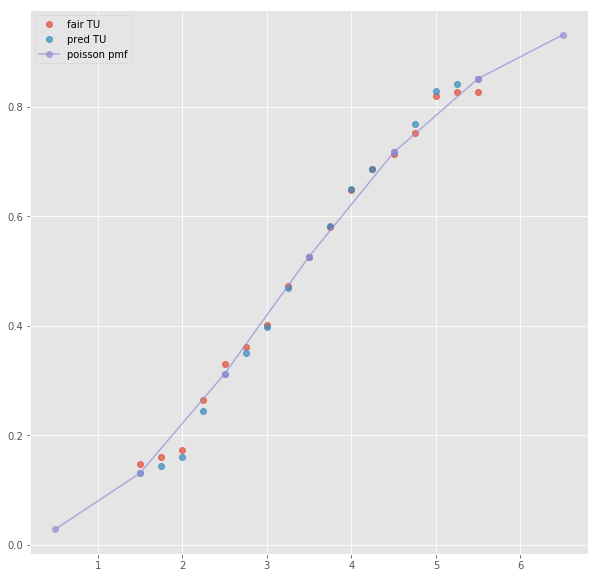

ML : 4.2 4.33 1.7
Error home:  0.03466721808276113
Error draw:  0.009056544328333332
Error away:  0.0256105842392802

(26, 124)
next positional indexers are out-of-bounds
(77, 124)
(1, 43)
1.5 1.714 2.23 -0.5 2.75 1.505
TO fair:  1.768609865470852 TU fair:  2.3010501750291716
TO pred:  1.7686 TU fair:  2.30106
Error TO:  0.005407144522637575

Error TO:  0.009933900258474376

Error TO:  0.007395551434872194

Error TO:  3.1539598022156667e-06

Error TO:  0.006590997429527068

Error TO:  0.0023860588478248346

Error TO:  0.0009248826248966502

Error TO:  0.006209121537496531



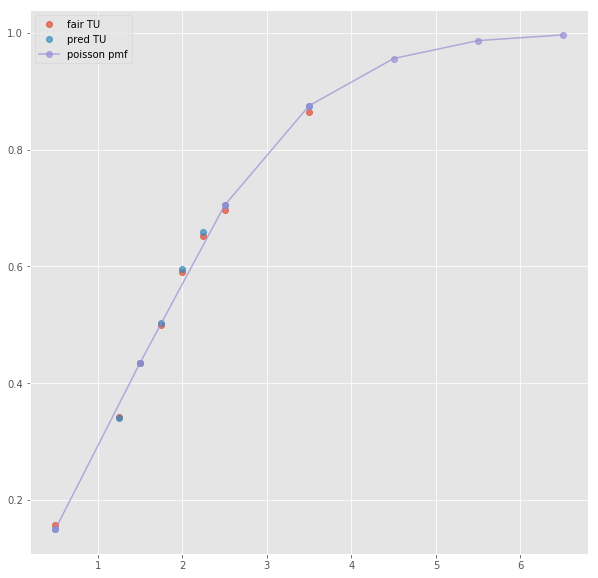

ML : 2.75 2.96 3.05
Error home:  0.0004127455440873229
Error draw:  0.00979876811516256
Error away:  0.009386199968404507

(141, 124)
(1, 27)
1.5 1.66 2.21 -0.5 2.66 1.47
TO fair:  1.751131221719457 TU fair:  2.3313253012048194
TO pred:  1.75113 TU fair:  2.33133
Error TO:  0.016683336452959496

Error TO:  3.9841383481231674e-07

Error TO:  0.018473037936522774

Error TO:  0.004060204950879331



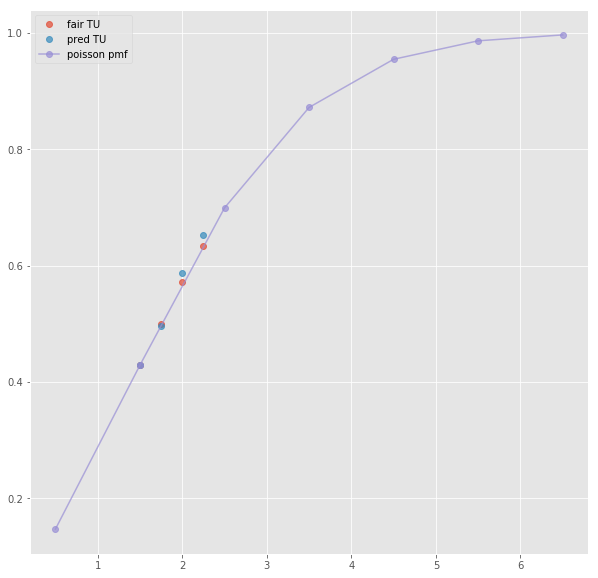

ML : 2.74 2.81 3.01
Error home:  0.009342373545168037
Error draw:  0.021569735137948964
Error away:  0.012227229881506874

(155, 124)
(1, 27)
1.5 1.67 2.33 -0.5 2.69 1.54
TO fair:  1.7167381974248928 TU fair:  2.3952095808383236
TO pred:  1.71671 TU fair:  2.39526
Error TO:  0.0005272718836689672

Error TO:  9.567719649772322e-06

Error TO:  0.02554729614299639

Error TO:  0.019747813788044355



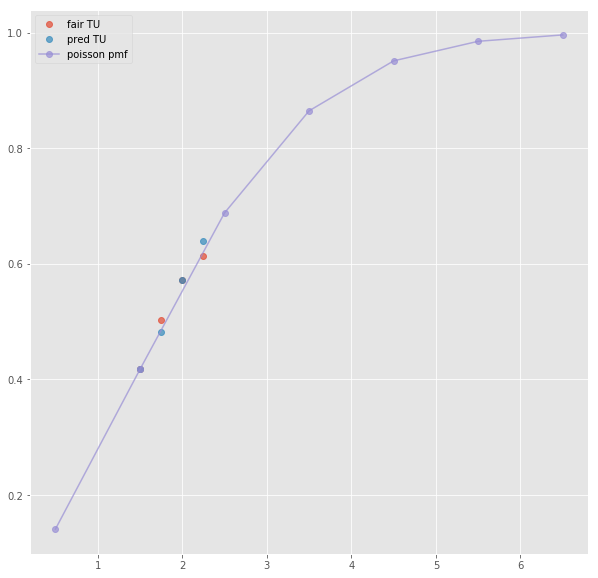

ML : 2.78 2.76 3.1
Error home:  0.01971114459904949
Error draw:  0.03467227534638384
Error away:  0.014960645337903922

(291, 124)
(1, 27)
1.5 1.67 2.33 -0.5 2.78 1.51
TO fair:  1.7167381974248928 TU fair:  2.3952095808383236
TO pred:  1.71671 TU fair:  2.39526
Error TO:  0.0030398346977392743

Error TO:  9.567719649772322e-06

Error TO:  0.0070276892218001374

Error TO:  0.009543732155391171



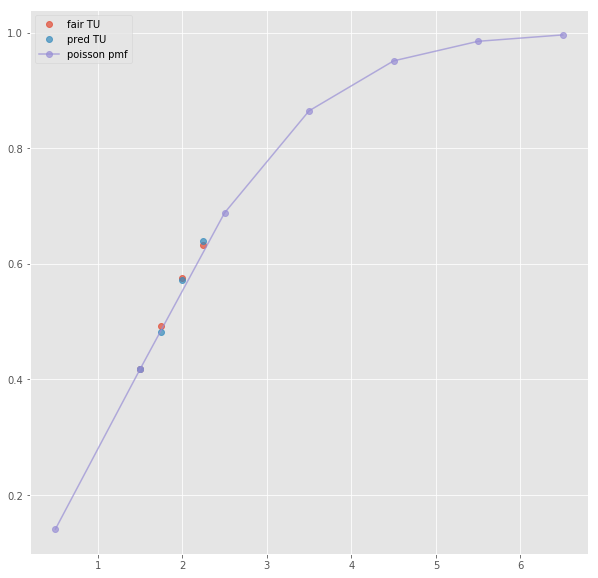

ML : 2.75 2.89 3.05
Error home:  0.0014786150568958378
Error draw:  0.02106519525402961
Error away:  0.019586112878777484

(61, 124)
(1, 45)
1.5 1.714 2.23 -0.5 2.75 1.505
TO fair:  1.768609865470852 TU fair:  2.3010501750291716
TO pred:  1.7686 TU fair:  2.30106
Error TO:  0.005407144522637575

Error TO:  0.009933900258474376

Error TO:  0.007395551434872194

Error TO:  3.1539598022156667e-06

Error TO:  0.006590997429527068

Error TO:  0.0023860588478248346

Error TO:  0.0009248826248966502

Error TO:  0.006209121537496531



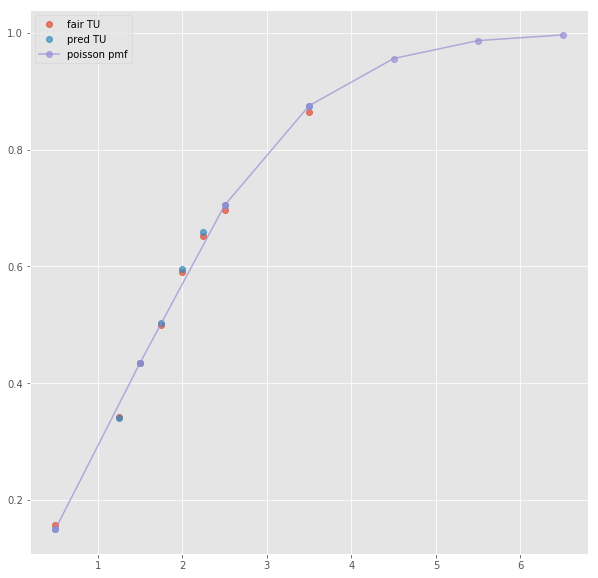

Error T1O:  0.012425381349012665
ML : 2.75 2.96 3.05
Error home:  0.0004127455440873229
Error draw:  0.00979876811516256
Error away:  0.009386199968404507

(59, 124)
(1, 60)
2.5 2.675 1.45 -0.5 2.375 1.55
TO fair:  2.844827586206897 TU fair:  1.5420560747663552
TO pred:  2.84493 TU fair:  1.54203
Error TO:  0.0028017623415122483

Error TO:  0.03167338168620437

Error TO:  0.014256510021891766

Error TO:  0.010780774253200287

Error TO:  1.2654089907304655e-05

Error TO:  0.016369874048356214

Error TO:  0.005078210613792433

Error TO:  0.010518473689185182

Error TO:  0.016342270873656806

Error TO:  0.017566316067278695

Error TO:  0.027216859395719495

Error TO:  0.03261934787747367

Error TO:  0.0255686547716788



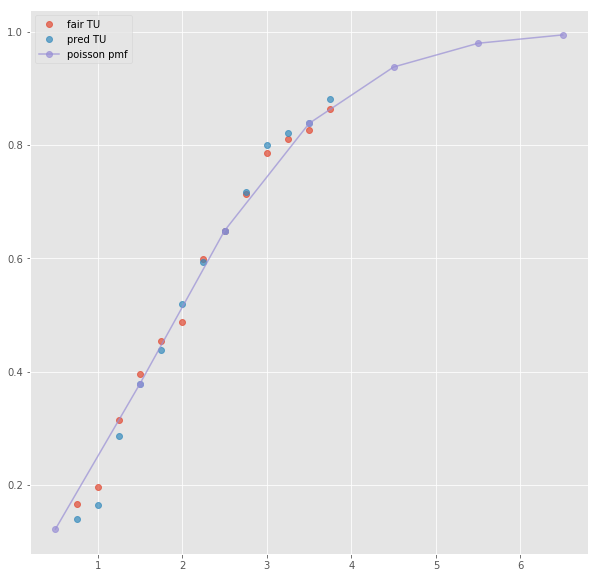

ML : 2.45 3.1 3.2
Error home:  0.0036645047885686677
Error draw:  0.011488282791758397
Error away:  0.007823365290222317

(7, 124)
(1, 33)
2.5 2.68 1.5 -0.5 2.4 1.61
TO fair:  2.786666666666666 TU fair:  1.5597014925373132
TO pred:  2.78666 TU fair:  1.5597
Error TO:  0.00296568197880398

Error TO:  8.584988830939722e-07

Error TO:  0.0049332878771561894

Error TO:  0.0016519384561303196

Error TO:  0.004195725460964472



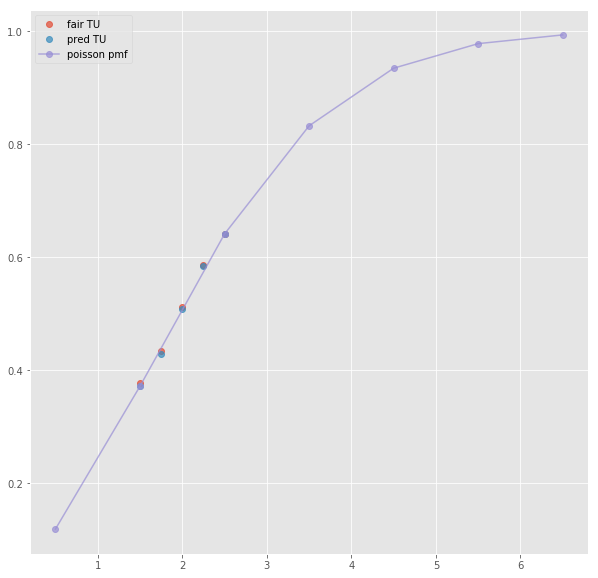

Error T1O:  0.007440256973985648
ML : 2.43 3.05 3.33
Error home:  0.005687861333228128
Error draw:  0.020303183098495825
Error away:  0.014615568967529802

(150, 124)
(1, 45)
3.5 2.74 1.497 -1.5 2.07 1.847
TO fair:  2.8303273213092854 TU fair:  1.5463503649635038
TO pred:  2.83038 TU fair:  1.54634
Error TO:  0.015609831046149769

Error TO:  0.05080673356591858

Error TO:  0.011210381764740651

Error TO:  6.575875193870484e-06

Error TO:  0.010776396731380922

Error TO:  0.018922753546088744

Error TO:  0.002447503303858567

Error TO:  0.0005740045025374174

Error TO:  0.004253370786665489



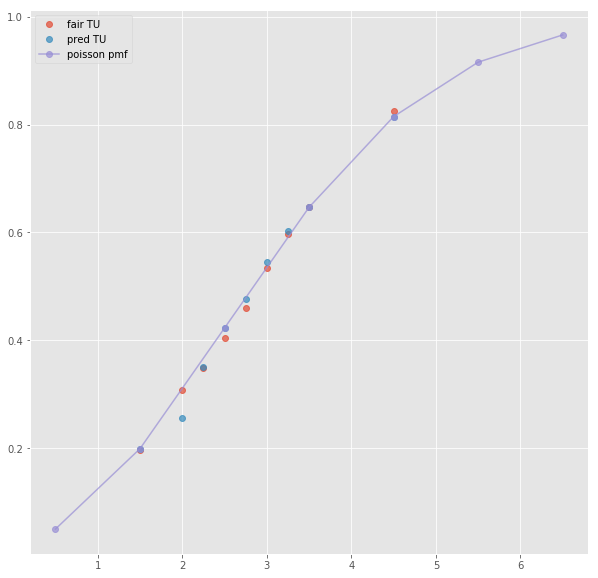

ML : 1.338 5.5 9.42
Error home:  0.012795632603118556
Error draw:  0.002922506103892303
Error away:  0.009872988912253633

(158, 124)
(1, 27)
2.5 1.62 2.25 -1.5 2.07 1.77
TO fair:  1.7199999999999998 TU fair:  2.3888888888888884
TO pred:  1.72002 TU fair:  2.38885
Error TO:  0.00021267860609575084

Error TO:  0.005037114137495247

Error TO:  6.760332424526894e-06

Error TO:  0.028539561728677998

Error TO:  0.016655216135775863



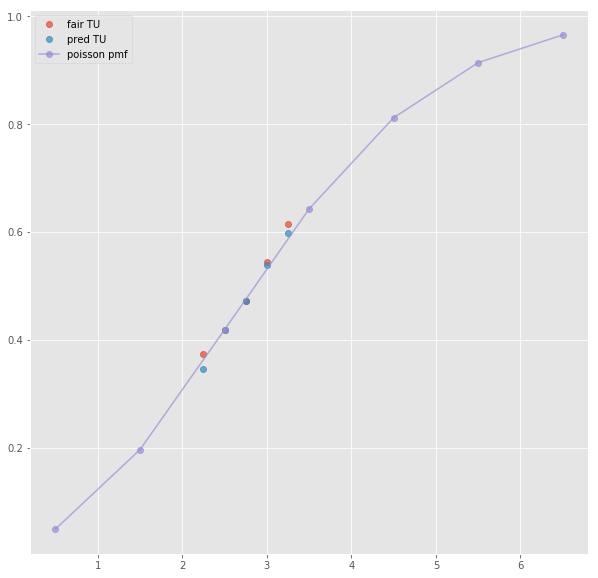

ML : 1.31 5.16 8.46
Error home:  0.011412276557161039
Error draw:  0.0016879799970942744
Error away:  0.009724285517941758

(239, 124)
(1, 23)
2.5 1.71 2.23 -1.5 2.08 1.84
TO fair:  1.7668161434977576 TU fair:  2.3040935672514617
TO pred:  1.76684 TU fair:  2.30405
Error TO:  0.02464476460222831

Error TO:  0.028500214262854318

Error TO:  7.642196277690694e-06



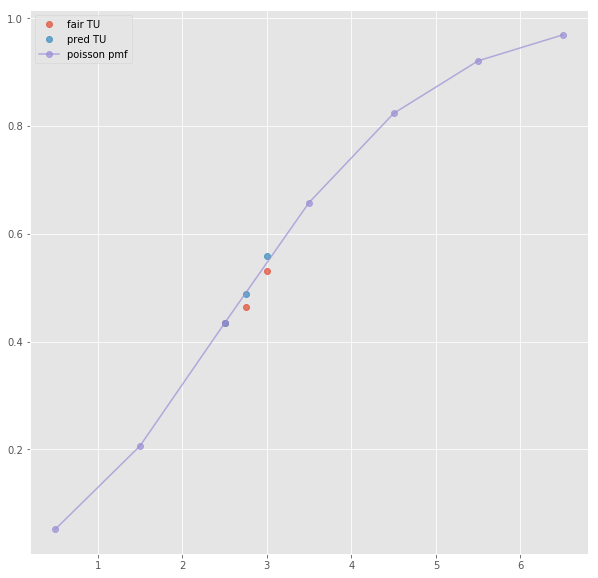

ML : 1.32 5.8 8.8
Error home:  0.016732792537558994
Error draw:  0.014835801807667609
Error away:  0.0018968397679290788

(742, 124)
(1, 27)
2.5 1.64 2.35 -1.5 2.11 1.82
TO fair:  1.6978723404255318 TU fair:  2.432926829268293
TO pred:  1.69788 TU fair:  2.43292
Error TO:  0.006380010776040113

Error TO:  0.0037046444463259

Error TO:  2.65700649959566e-06

Error TO:  0.014115490953458765

Error TO:  0.013055943614029952



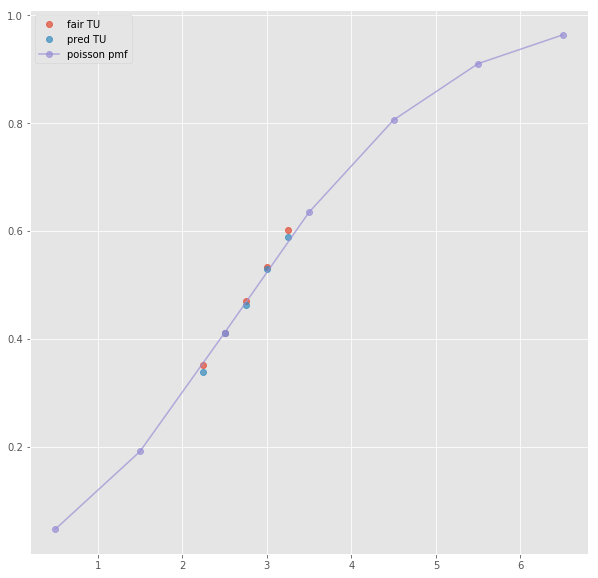

ML : 1.34 5.3 8.5
Error home:  0.00989917845078514
Error draw:  0.0013830143069206713
Error away:  0.008516240487249388

(153, 124)
(1, 47)
3.5 2.74 1.497 -1.5 2.07 1.847
TO fair:  2.8303273213092854 TU fair:  1.5463503649635038
TO pred:  2.83038 TU fair:  1.54634
Error TO:  0.015609831046149769

Error TO:  0.052621623535480944

Error TO:  0.011210381764740651

Error TO:  6.575875193870484e-06

Error TO:  0.010776396731380922

Error TO:  0.018922753546088744

Error TO:  0.002447503303858567

Error TO:  0.0005740045025374174

Error TO:  0.004253370786665489



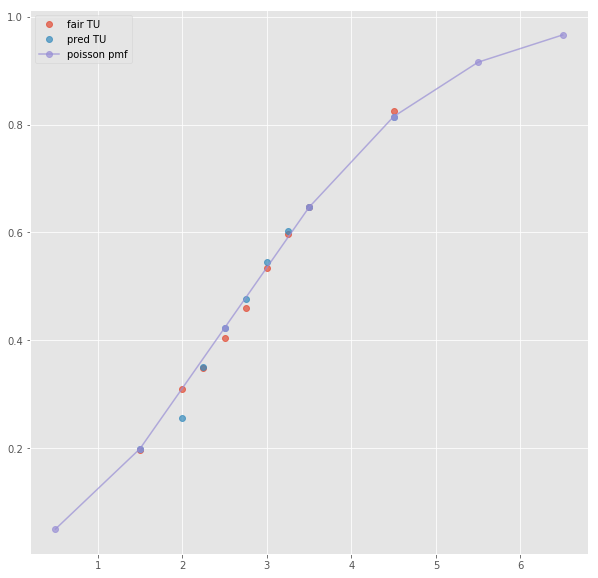

Error T1O:  0.01705401532489592
ML : 1.338 5.5 9.42
Error home:  0.012795632603118556
Error draw:  0.002922506103892303
Error away:  0.009872988912253633

(102, 124)
next positional indexers are out-of-bounds
(124, 124)
(1, 43)
3.5 2.25 1.689 -1.5 2.34 1.653
TO fair:  2.3321492007104796 TU fair:  1.7506666666666666
TO pred:  2.33217 TU fair:  1.75066
Error TO:  0.0013321732968266664

Error TO:  0.001394166312657319

Error TO:  3.824123985585182e-06

Error TO:  0.0038018753813570116

Error TO:  0.0013026161640270484

Error TO:  0.002844929280522157

Error TO:  3.44929365251323e-05

Error TO:  0.0020221619910109068



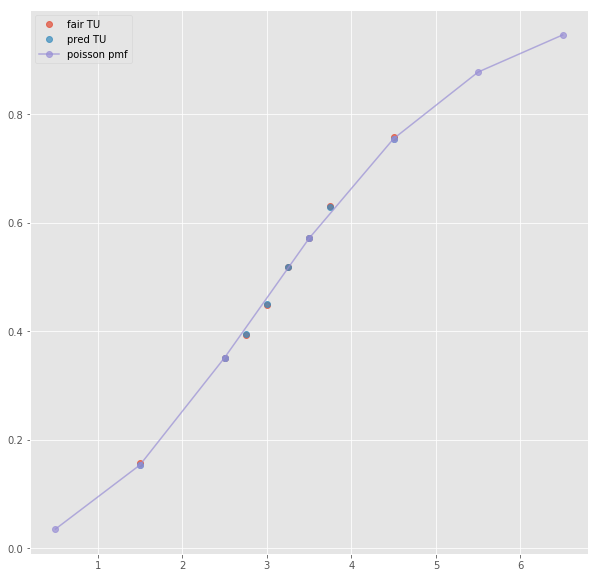

ML : 1.492 4.83 6.11
Error home:  0.003200079778947207
Error draw:  0.007853916449770765
Error away:  0.011054035084389013

(196, 124)
(1, 30)
3.5 2.16 1.68 -1.5 2.31 1.6
TO fair:  2.2857142857142856 TU fair:  1.7777777777777777
TO pred:  2.2857 TU fair:  1.77778
Error TO:  0.013325711009666619

Error TO:  0.009335360723541242

Error TO:  2.7343920899758345e-06

Error TO:  0.012268054101693182

Error TO:  0.0021775261990596984



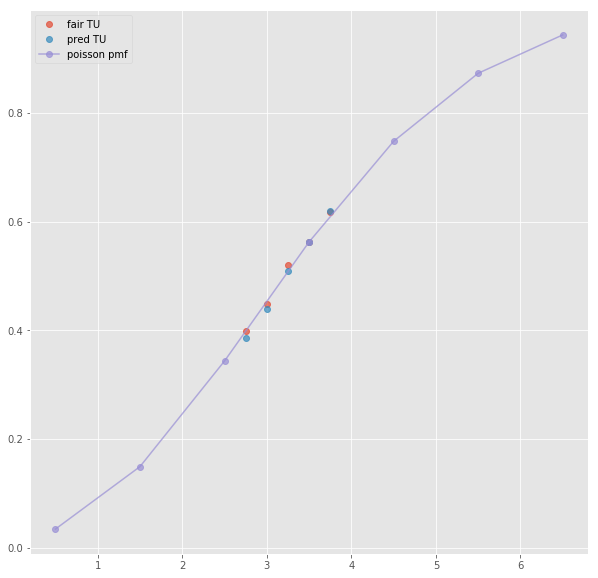

ML : 1.48 4.66 5.56
Error home:  0.0030781238288083435
Error draw:  0.008887804640986846
Error away:  0.005809742251871891

(185, 124)
(1, 22)
next list index out of range
(526, 124)
(1, 28)
3.5 2.29 1.67 -0.5 1.55 2.58
TO fair:  2.37125748502994 TU fair:  1.7292576419213972
TO pred:  2.37127 TU fair:  1.72925
Error TO:  0.003082547353185694

Error TO:  0.003593423253872241

Error TO:  2.225717770532043e-06

Error TO:  0.00223538081584973



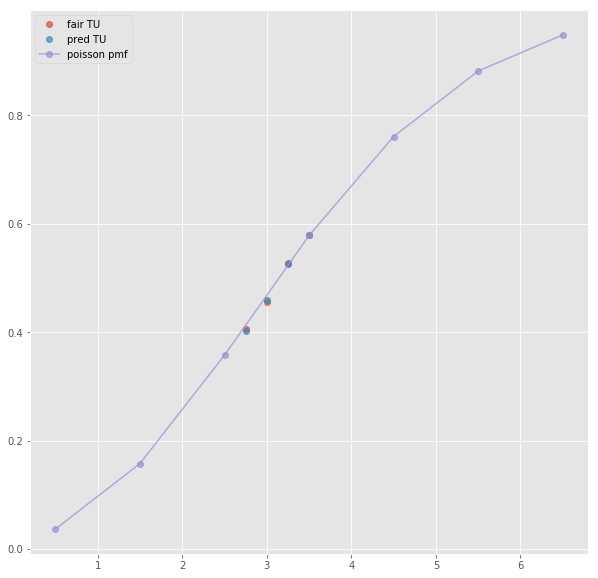

ML : 1.52 4.6 5.7
Error home:  0.001442742727447932
Error draw:  0.010484605163900318
Error away:  0.011927490095571175

(117, 124)
(1, 45)
3.5 2.25 1.689 -1.5 2.34 1.653
TO fair:  2.3321492007104796 TU fair:  1.7506666666666666
TO pred:  2.33217 TU fair:  1.75066
Error TO:  0.0013321732968266664

Error TO:  0.001394166312657319

Error TO:  3.824123985585182e-06

Error TO:  0.0038018753813570116

Error TO:  0.0013026161640270484

Error TO:  0.002844929280522157

Error TO:  3.44929365251323e-05

Error TO:  0.0020221619910109068



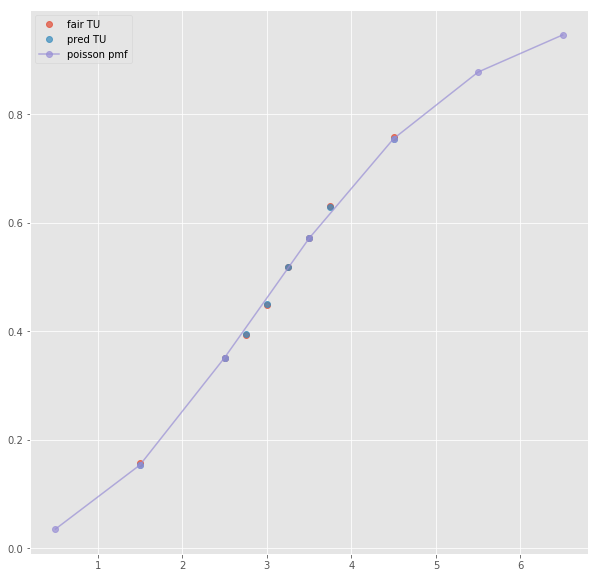

Error T1O:  0.009318847296010513
ML : 1.492 4.83 6.11
Error home:  0.003200079778947207
Error draw:  0.007853916449770765
Error away:  0.011054035084389013

(72, 124)
(1, 74)
3.5 2.075 1.725 -1.5 2.3 1.6
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20293 TU fair:  1.8313
Error TO:  0.017042527067467894

Error TO:  0.023454320353170854

Error TO:  0.008375686653899872

Error TO:  6.480603464253942e-06

Error TO:  0.007326518782072466

Error TO:  0.012341213457025768

Error TO:  0.020178473527909913

Error TO:  0.014496288726438822

Error TO:  0.07130314180918434

Error TO:  0.01774811874451243

Error TO:  0.01345926225644506

Error TO:  0.009445055670524172

Error TO:  0.0038491973286985948

Error TO:  0.05735341058314036

Error TO:  0.01455432143703761

Error TO:  0.008409430814698943

Error TO:  0.01457910627179268



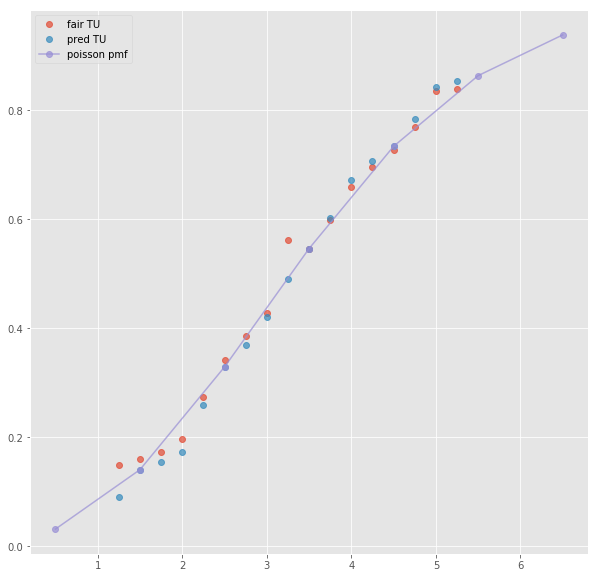

ML : 1.5 4.75 5.5
Error home:  0.0034293740843709397
Error draw:  0.008850112836524343
Error away:  0.005420698786175959

(26, 124)
next positional indexers are out-of-bounds
(57, 124)
(1, 48)
3.5 2.78 1.473 0.5 1.6569999999999998 2.34
TO fair:  2.887304820095044 TU fair:  1.5298561151079137
TO pred:  2.88737 TU fair:  1.52984
Error TO:  0.010479981064132393

Error TO:  0.007682696041617476

Error TO:  7.818413707283423e-06

Error TO:  0.008779606162485631

Error TO:  0.012659154480466506

Error TO:  0.0012622058651639012

Error TO:  0.00814963979898653

Error TO:  0.003169634616231376



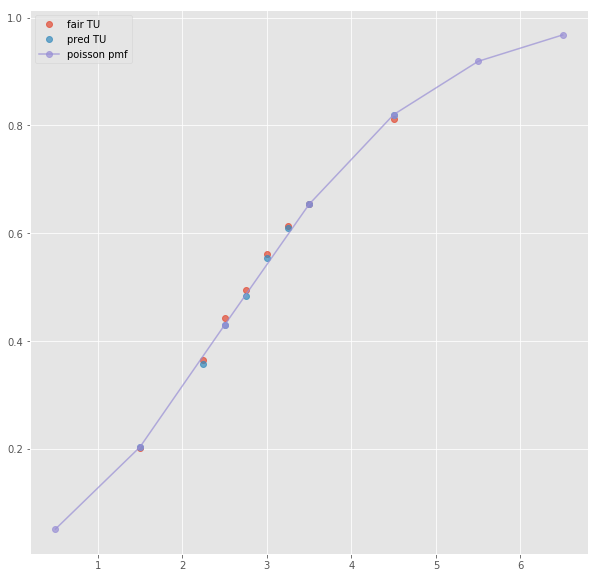

ML : 3.2 3.34 2.34
Error home:  0.041291928559431035
Error draw:  0.04465376564475396
Error away:  0.003361578482665162

(134, 124)
(1, 29)
2.5 1.64 2.21 0.5 1.65 2.23
TO fair:  1.742081447963801 TU fair:  2.347560975609756
TO pred:  1.74208 TU fair:  2.34756
Error TO:  0.03337766138203202

Error TO:  0.01987081521608619

Error TO:  4.771128944147662e-07

Error TO:  0.021880744277544106



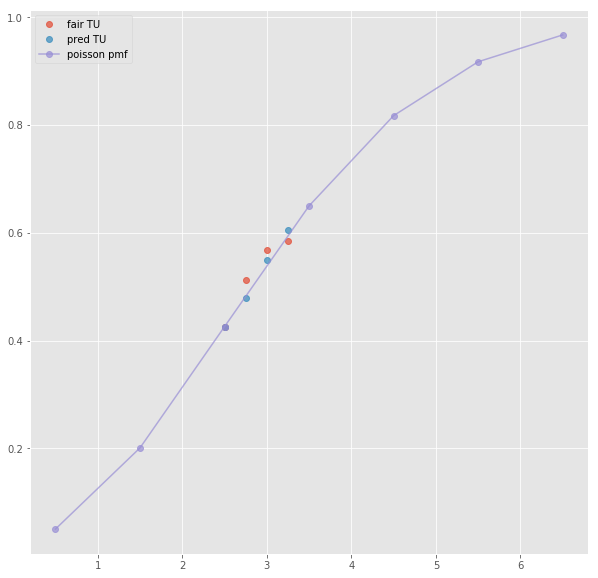

ML : 3.21 3.26 2.23
Error home:  0.04059266055273486
Error draw:  0.045450139610126145
Error away:  0.004857698201806204

(147, 124)
(1, 23)
next list index out of range
(277, 124)
(1, 25)
next list index out of range
(48, 124)
(1, 50)
3.5 2.78 1.473 0.5 1.6569999999999998 2.34
TO fair:  2.887304820095044 TU fair:  1.5298561151079137
TO pred:  2.88737 TU fair:  1.52984
Error TO:  0.010479981064132393

Error TO:  0.007682696041617476

Error TO:  7.818413707283423e-06

Error TO:  0.008779606162485631

Error TO:  0.012659154480466506

Error TO:  0.0012622058651639012

Error TO:  0.00814963979898653

Error TO:  0.003169634616231376



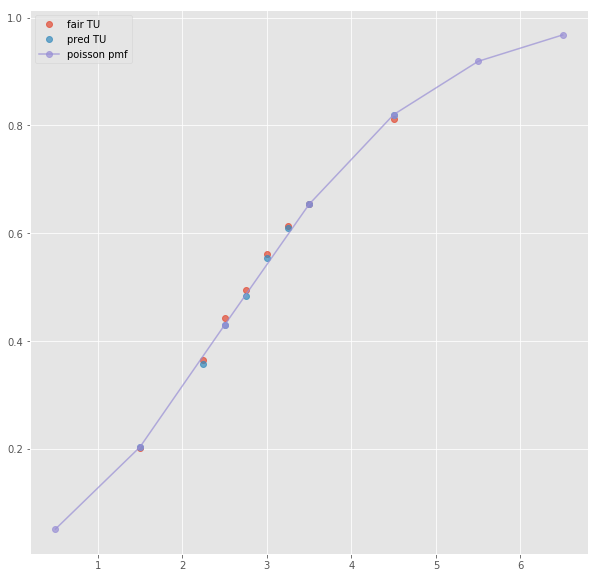

Error T1O:  0.027761783395309547
ML : 3.2 3.34 2.34
Error home:  0.041291928559431035
Error draw:  0.04465376564475396
Error away:  0.003361578482665162

(31, 124)
(1, 38)
3.5 2.57 1.54 0.5 1.67 2.27
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66883 TU fair:  1.59922
Error TO:  0.03352741569938522

Error TO:  0.03163182604555692

Error TO:  1.6410045011738816e-07

Error TO:  0.03316935801947518

Error TO:  0.03405415110507726

Error TO:  0.022879691415380266



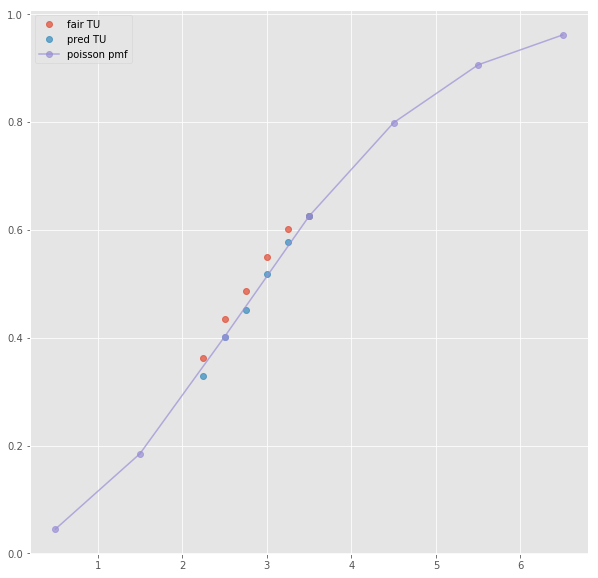

Error T1O:  0.025526482640647163
ML : 3.07 3.58 2.3
Error home:  0.025498582990690632
Error draw:  0.03123631683077524
Error away:  0.005737452675026011

(52, 124)
(1, 50)
2.5 1.934 1.952 -0.5 2.3 1.675
TO fair:  1.9907786885245904 TU fair:  2.0093071354705274
TO pred:  1.99075 TU fair:  2.00934
Error TO:  0.003505569067235148

Error TO:  0.0033631442878775397

Error TO:  0.0070431677424516725

Error TO:  0.009743379734290736

Error TO:  0.009752905512729115

Error TO:  7.238832146261309e-06

Error TO:  0.0021579747191003973

Error TO:  0.0019064920436192567

Error TO:  0.028293810807512976



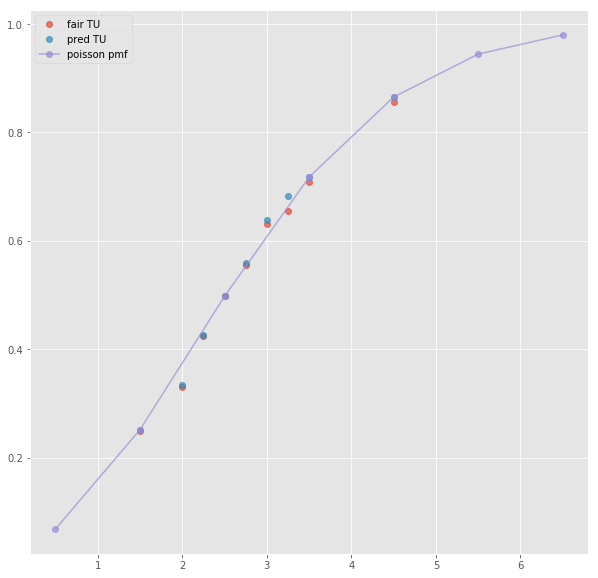

ML : 2.3 3.43 3.25
Error home:  0.000924267777953458
Error draw:  0.02463233860661901
Error away:  0.023707903343709424

(82, 124)
(1, 25)
2.5 1.91 1.91 -0.5 2.31 1.6
TO fair:  2.0 TU fair:  2.0
TO pred:  2.00004 TU fair:  1.99996
Error TO:  0.0029989184157381277

Error TO:  9.999800003934745e-06

Error TO:  0.016782705631743333



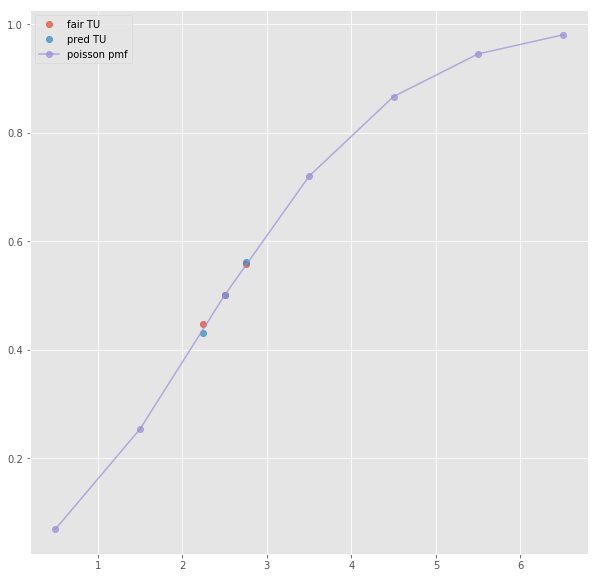

ML : 2.33 3.21 3.06
Error home:  0.007158890579051058
Error draw:  0.03324477287053129
Error away:  0.026086114739659216

(77, 124)
(1, 21)
2.5 1.89 2.01 -0.5 2.29 1.69
TO fair:  1.9402985074626868 TU fair:  2.0634920634920637
TO pred:  1.94034 TU fair:  2.06345
Error TO:  0.008646424930828622

Error TO:  1.102106609385256e-05

Error TO:  0.02417273697157185



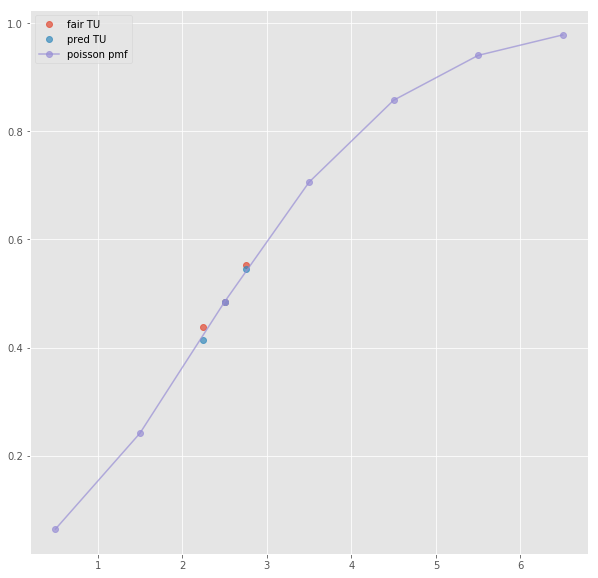

ML : 2.28 3.4 3.2
Error home:  0.005003074049302003
Error draw:  0.027126098288941025
Error away:  0.0221228040813376

(102, 124)
(1, 21)
2.5 1.91 1.99 -0.5 2.29 1.69
TO fair:  1.959798994974874 TU fair:  2.0418848167539263
TO pred:  1.95976 TU fair:  2.04193
Error TO:  0.0030480130887580725

Error TO:  1.015299623285948e-05



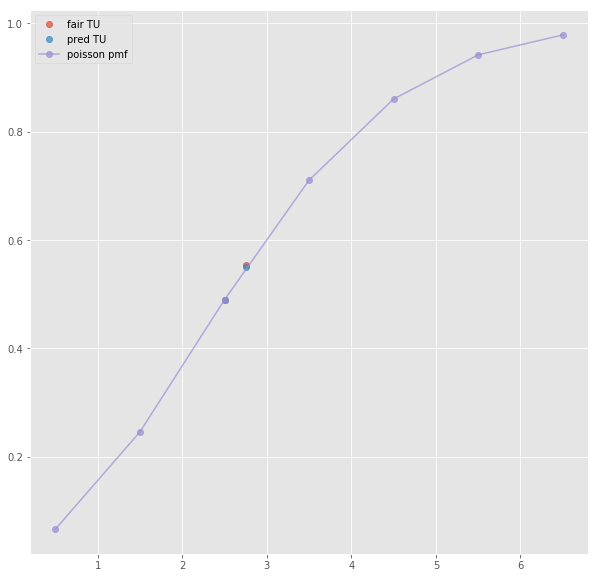

ML : 2.26 3.4 3.2
Error home:  0.0028612391422376815
Error draw:  0.024985711360029195
Error away:  0.02212436036594828

(37, 124)
(1, 52)
2.5 1.934 1.952 -0.5 2.3 1.675
TO fair:  1.9907786885245904 TU fair:  2.0093071354705274
TO pred:  1.99075 TU fair:  2.00934
Error TO:  0.003505569067235148

Error TO:  0.0033631442878775397

Error TO:  0.0070431677424516725

Error TO:  0.009743379734290736

Error TO:  0.009752905512729115

Error TO:  7.238832146261309e-06

Error TO:  0.0021579747191003973

Error TO:  0.0019064920436192567

Error TO:  0.028293810807512976



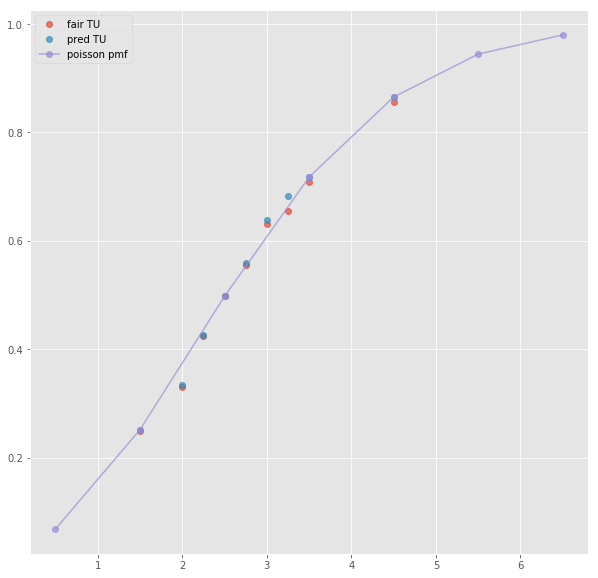

Error T1O:  0.014762776327931049
ML : 2.3 3.43 3.25
Error home:  0.000924267777953458
Error draw:  0.02463233860661901
Error away:  0.023707903343709424

(60, 124)
(1, 69)
2.5 1.775 2.025 -0.5 2.025 1.775
TO fair:  1.8765432098765433 TU fair:  2.1408450704225355
TO pred:  1.87655 TU fair:  2.14084
Error TO:  0.03647480497575367

Error TO:  0.05057631237611526

Error TO:  0.03715077680922585

Error TO:  0.02377093409537029

Error TO:  0.0054932703411057215

Error TO:  1.9282305574463976e-06

Error TO:  0.011839264259514648

Error TO:  0.04267892587712263

Error TO:  0.019710019446083415

Error TO:  0.043026698586559164

Error TO:  0.016932374237442538

Error TO:  0.0061759621212120475

Error TO:  0.01656484692381313

Error TO:  0.044208901339233386

Error TO:  0.020831528041164143



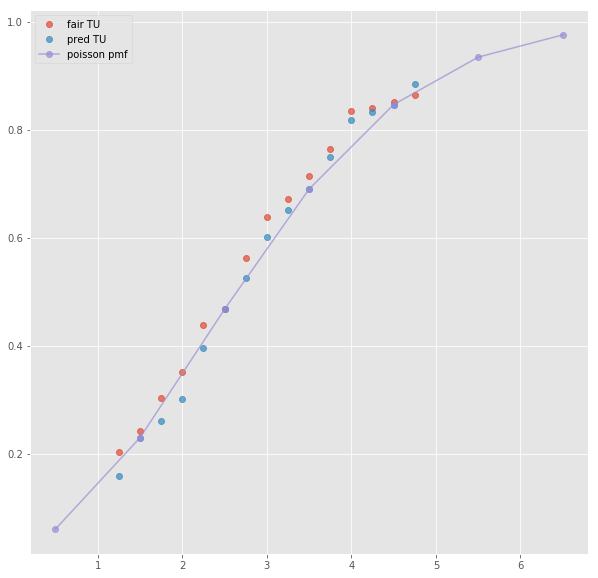

ML : 2.0 3.6 3.5
Error home:  0.0030341565714031016
Error draw:  0.01461956559541347
Error away:  0.017653913436844137

(2, 124)
(1, 33)
2.5 1.96 1.89 -0.5 2.07 1.79
TO fair:  2.037037037037037 TU fair:  1.9642857142857144
TO pred:  2.037 TU fair:  1.96432
Error TO:  0.005275847851349824

Error TO:  0.0026001167006755033

Error TO:  0.010485165203899638

Error TO:  8.925782121749215e-06

Error TO:  0.001702041034611912



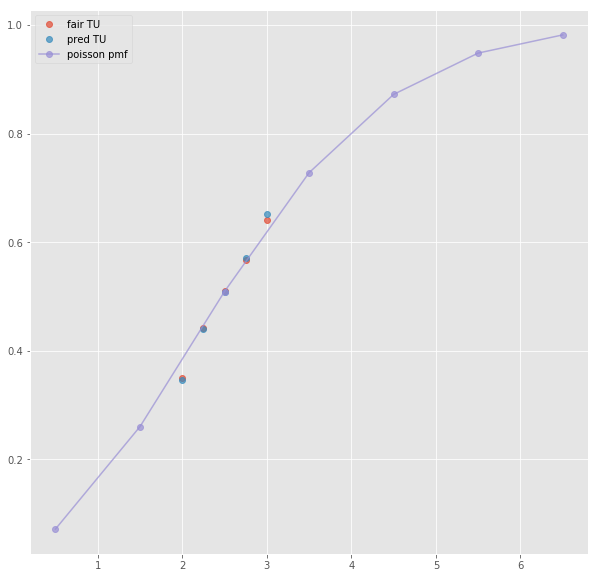

Error T1O:  0.00961651266223923
ML : 2.09 3.46 3.66
Error home:  0.003983601514632229
Error draw:  0.02200292531031184
Error away:  0.018019151505123676

(70, 124)
(1, 45)
3.5 2.86 1.462 -0.5 2.11 1.813
TO fair:  2.9562243502051984 TU fair:  1.5111888111888112
TO pred:  2.95626 TU fair:  1.51118
Error TO:  0.0011251423477762756

Error TO:  0.000561385395056957

Error TO:  4.079218958064068e-06

Error TO:  0.0011449892356879543

Error TO:  0.0007320185775305799

Error TO:  0.003619742112797697

Error TO:  0.002760273251046108

Error TO:  0.00018712211795912648



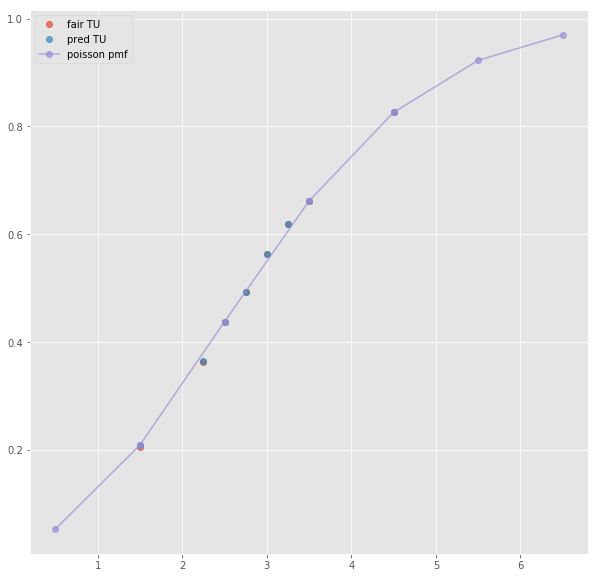

ML : 2.11 3.72 3.47
Error home:  0.002420520696543804
Error draw:  0.019414765895422514
Error away:  0.016994002132389163

(140, 124)
(1, 27)
2.5 1.7 2.21 -0.5 2.17 1.76
TO fair:  1.7692307692307694 TU fair:  2.3000000000000003
TO pred:  1.7692 TU fair:  2.30004
Error TO:  0.005249958549358613

Error TO:  0.00498079859122752

Error TO:  9.83003863208598e-06

Error TO:  0.004068409455997846



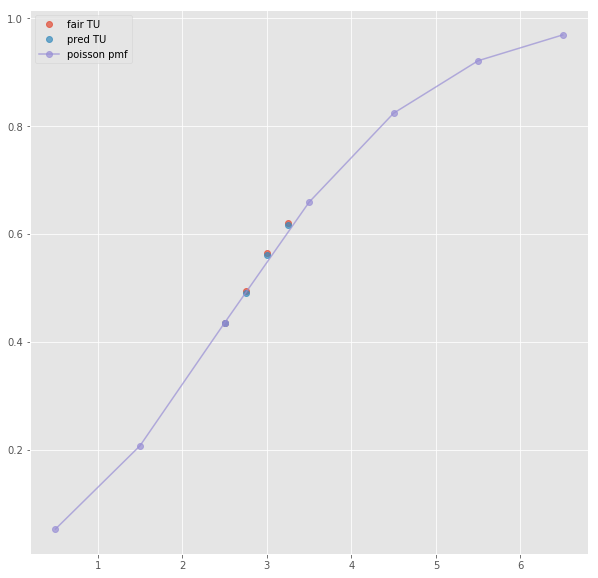

ML : 2.16 3.48 3.33
Error home:  0.007182983166234391
Error draw:  0.03136060810590624
Error away:  0.024177647100559974

(168, 124)
(1, 23)
2.5 1.74 2.21 -0.5 2.16 1.81
TO fair:  1.7873303167420813 TU fair:  2.2701149425287355
TO pred:  1.78736 TU fair:  2.27007
Error TO:  0.003679227545934416

Error TO:  0.001726264924809262

Error TO:  9.291689943236037e-06



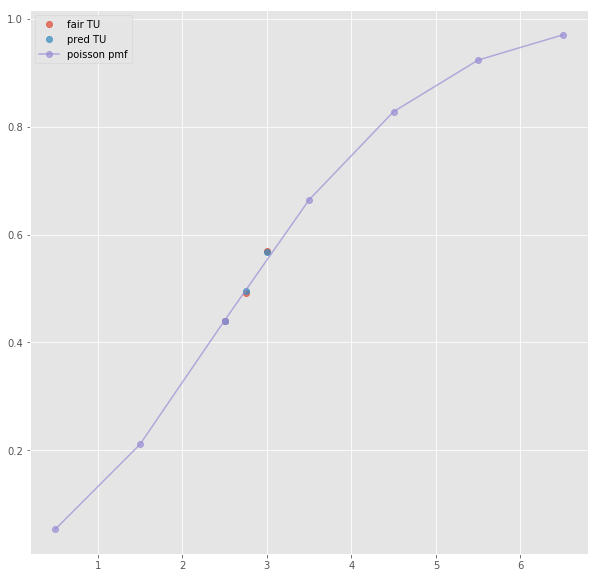

ML : 2.06 3.65 3.5
Error home:  0.008548070842890554
Error draw:  0.019634200007083435
Error away:  0.028182461425574346

(330, 124)
(1, 27)
2.5 1.74 2.21 -0.5 2.16 1.81
TO fair:  1.7873303167420813 TU fair:  2.2701149425287355
TO pred:  1.78736 TU fair:  2.27007
Error TO:  0.003679227545934416

Error TO:  0.001726264924809262

Error TO:  9.291689943236037e-06

Error TO:  0.0006789735188585388



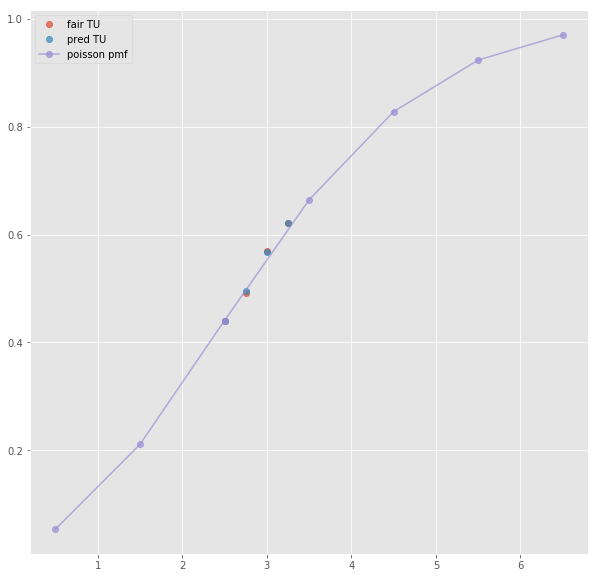

ML : 2.14 3.65 3.35
Error home:  0.006513302101778806
Error draw:  0.0209840338230744
Error away:  0.014470922296896116

(64, 124)
(1, 45)
3.5 2.86 1.462 -0.5 2.12 1.8
TO fair:  2.9562243502051984 TU fair:  1.5111888111888112
TO pred:  2.95626 TU fair:  1.51118
Error TO:  0.0011251423477762756

Error TO:  0.000561385395056957

Error TO:  4.079218958064068e-06

Error TO:  0.0008888656451790378

Error TO:  0.001446515054483677

Error TO:  0.003619742112797697

Error TO:  0.002760273251046108

Error TO:  0.00018712211795912648



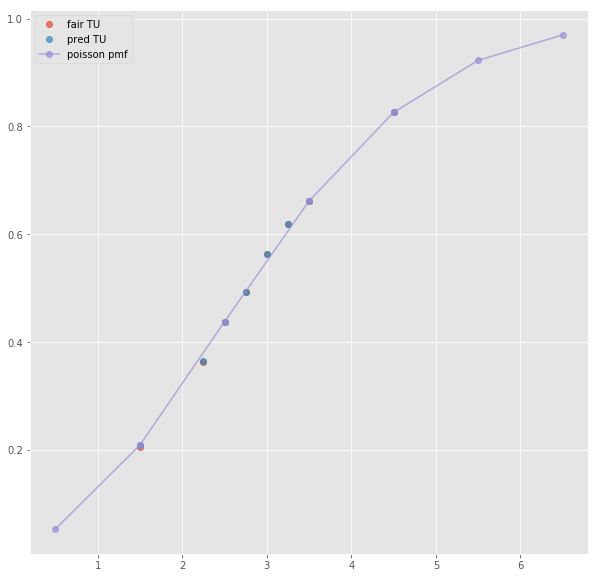

Error T1O:  0.007030934602159311
ML : 2.12 3.72 3.45
Error home:  0.0013821701686864696
Error draw:  0.019244551584543884
Error away:  0.017862150742559757

(42, 124)
(1, 10)
next list index out of range
(31, 124)
next positional indexers are out-of-bounds
(73, 124)
(1, 43)
2.5 1.97 1.925 0.5 1.714 2.26
TO fair:  2.023376623376623 TU fair:  1.9771573604060912
TO pred:  2.0234 TU fair:  1.97714
Error TO:  0.0026075397956068502

Error TO:  0.005890664972130755

Error TO:  0.006403351180497618

Error TO:  0.008245474856779456

Error TO:  0.00641191496479071

Error TO:  5.709831683187172e-06

Error TO:  0.00550204623081052

Error TO:  0.0030445844492682506



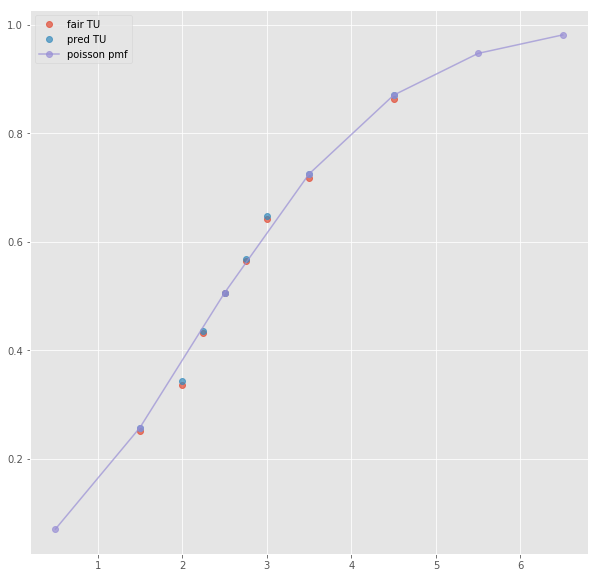

ML : 3.32 3.5 2.26
Error home:  0.01775246708779199
Error draw:  0.01920380381168163
Error away:  0.0014510625590504755

(150, 124)
(1, 27)
2.5 1.96 1.88 0.5 1.66 2.26
TO fair:  2.0425531914893615 TU fair:  1.9591836734693875
TO pred:  2.04256 TU fair:  1.95918
Error TO:  0.007924063193058661

Error TO:  0.02727249369302781

Error TO:  1.6319390046537485e-06

Error TO:  0.00340868236399805



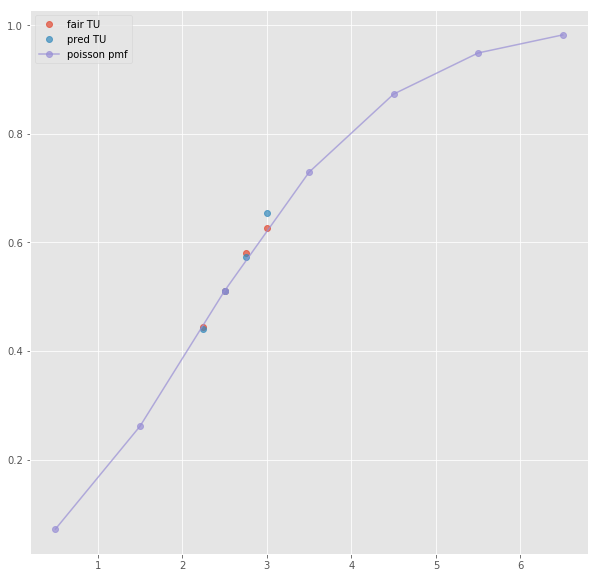

ML : 3.26 3.21 2.29
Error home:  0.02575789415882601
Error draw:  0.035307910944661736
Error away:  0.009549929832052995

(199, 124)
(1, 25)
2.5 1.97 1.95 0.5 1.71 2.31
TO fair:  2.0102564102564107 TU fair:  1.9898477157360408
TO pred:  2.01022 TU fair:  1.98989
Error TO:  0.00476786216190106

Error TO:  9.010080935512033e-06

Error TO:  0.010665066389377253



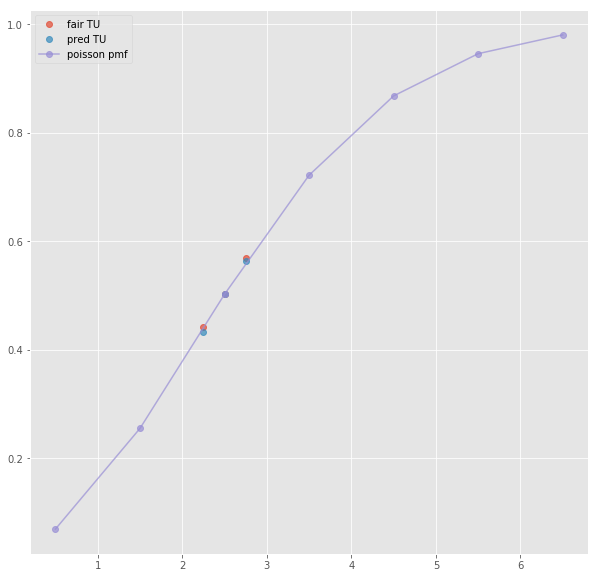

ML : 3.25 3.35 2.26
Error home:  0.0231200115274926
Error draw:  0.026544827746288746
Error away:  0.003424695259707067

(321, 124)
(1, 29)
2.5 1.99 1.93 0.5 1.72 2.29
TO fair:  2.0310880829015545 TU fair:  1.9698492462311556
TO pred:  2.03107 TU fair:  1.96987
Error TO:  0.0032990295414331294

Error TO:  0.013577203638323931

Error TO:  4.383433965582384e-06

Error TO:  0.0045485968003710076



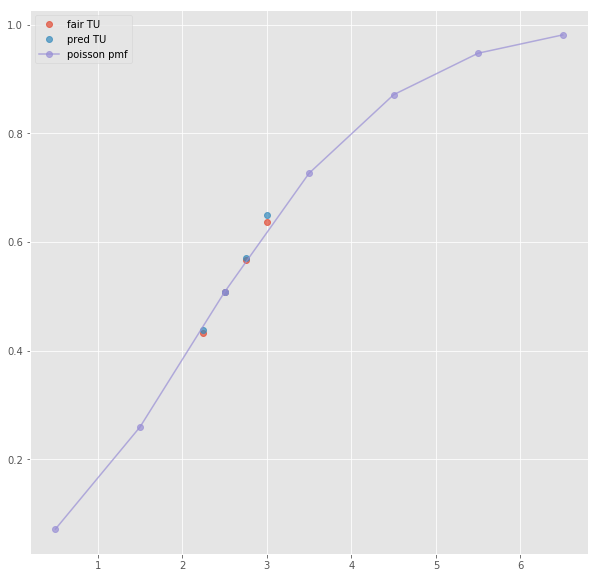

ML : 3.25 3.4 2.28
Error home:  0.016358687729569055
Error draw:  0.023739626440156536
Error away:  0.007380740698531785

(74, 124)
(1, 45)
2.5 1.97 1.925 0.5 1.714 2.26
TO fair:  2.023376623376623 TU fair:  1.9771573604060912
TO pred:  2.0234 TU fair:  1.97714
Error TO:  0.0026075397956068502

Error TO:  0.005890664972130755

Error TO:  0.006403351180497618

Error TO:  0.008245474856779456

Error TO:  0.00641191496479071

Error TO:  5.709831683187172e-06

Error TO:  0.00550204623081052

Error TO:  0.0030445844492682506



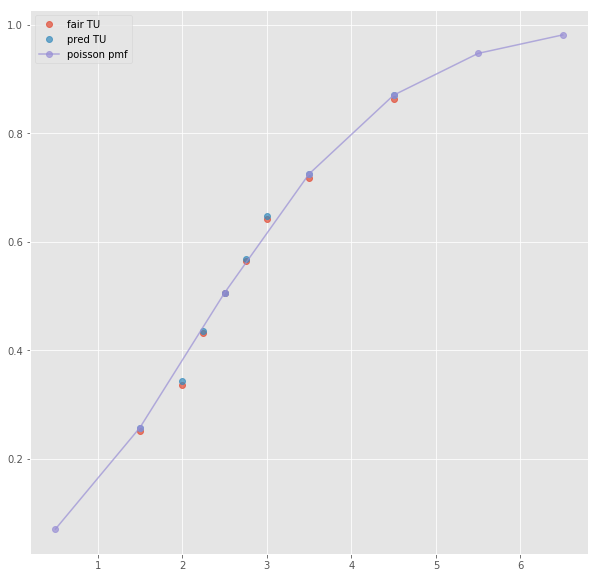

Error T1O:  0.0009251208960472934
ML : 3.32 3.5 2.26
Error home:  0.01775246708779199
Error draw:  0.01920380381168163
Error away:  0.0014510625590504755

(44, 124)
(1, 65)
2.5 1.96 1.94 0.5 1.675 2.15
TO fair:  2.0103092783505154 TU fair:  1.989795918367347
TO pred:  2.01031 TU fair:  1.98979
Error TO:  0.002436706594591276

Error TO:  0.012327024982894064

Error TO:  0.005880949429724447

Error TO:  0.008571295086294173

Error TO:  0.016636365844113904

Error TO:  1.7856666834070722e-07

Error TO:  0.018357931735368038

Error TO:  0.005509813567081134

Error TO:  0.01723174922175358

Error TO:  0.012027739858880282

Error TO:  0.01864443887796413

Error TO:  0.01861832678351308

Error TO:  0.020269218142318884

Error TO:  0.023264427629157813



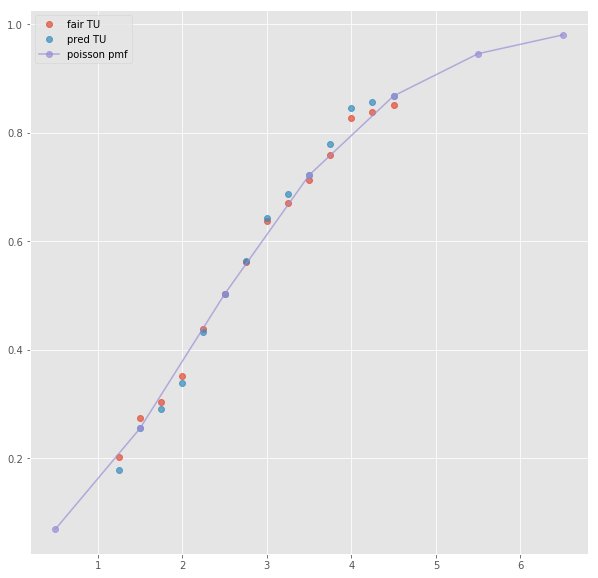

ML : 3.25 3.5 2.15
Error home:  0.014347872684312646
Error draw:  0.012843879299914984
Error away:  0.0015038635490244867

(33, 124)
next positional indexers are out-of-bounds
(78, 124)
(1, 46)
2.5 1.819 2.1 -0.5 1.671 2.35
TO fair:  1.8661904761904764 TU fair:  2.154480483782298
TO pred:  1.86616 TU fair:  2.15452
Error TO:  0.0016953235912966491

Error TO:  0.008964152557967342

Error TO:  0.0036277650201322897

Error TO:  0.00345532239629176

Error TO:  0.0029198638253620235

Error TO:  8.750962729009437e-06

Error TO:  0.005166178202478444

Error TO:  0.001853658238623157

Error TO:  0.0033985796314214833



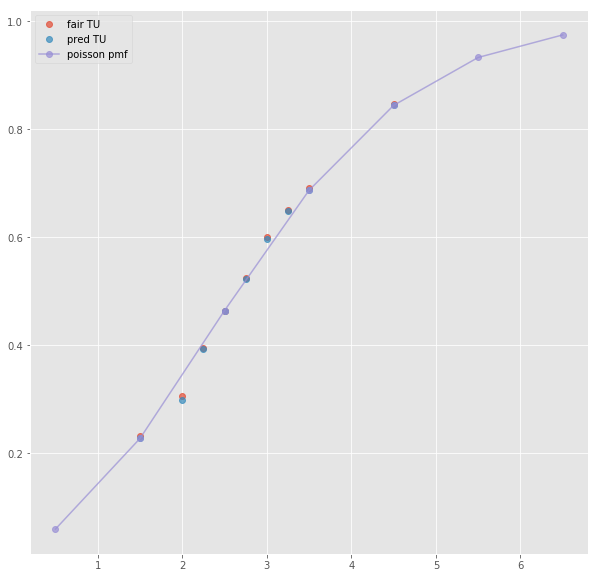

ML : 1.671 4.13 5.31
Error home:  0.0028043456453372695
Error draw:  0.011214766935283699
Error away:  0.00841062807610099

(105, 124)
(1, 27)
2.5 1.82 2.02 -0.5 1.64 2.29
TO fair:  1.9009900990099007 TU fair:  2.1098901098901095
TO pred:  1.90099 TU fair:  2.10989
Error TO:  0.0019379991970833177

Error TO:  0.0017773141872167164

Error TO:  2.7398004864842562e-08

Error TO:  0.0032694287373089548



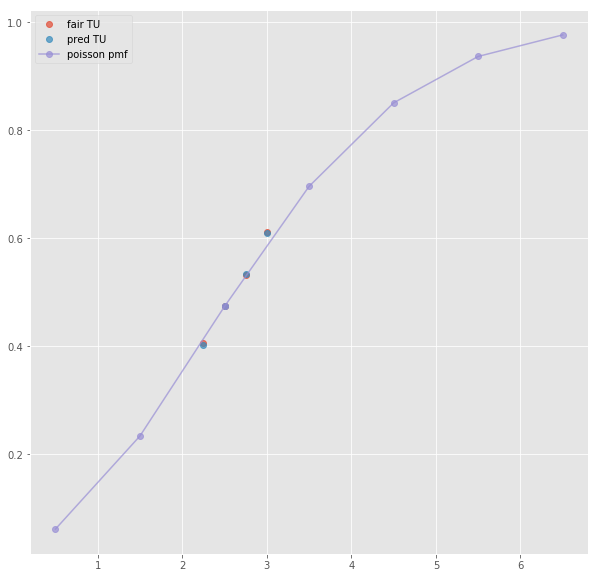

ML : 1.64 3.91 5.16
Error home:  0.0070692401719048
Error draw:  0.015143233111038823
Error away:  0.008073984051041289

(89, 124)
(1, 25)
2.5 1.85 2.07 -0.5 1.67 2.38
TO fair:  1.893719806763285 TU fair:  2.1189189189189186
TO pred:  1.89375 TU fair:  2.11888
Error TO:  0.010559684580663697

Error TO:  8.41920926797357e-06

Error TO:  0.007707105810303205



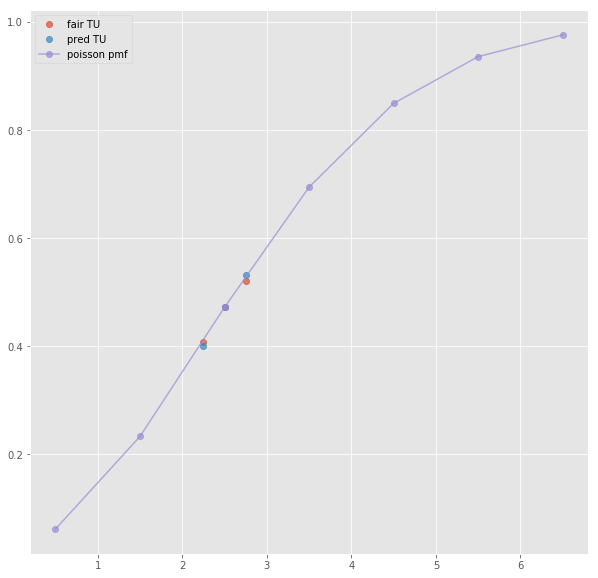

ML : 1.65 4.0 5.3
Error home:  0.00756510280328726
Error draw:  0.0146284357935976
Error away:  0.007063418900958768

(255, 124)
(1, 27)
2.5 1.86 2.06 -0.5 1.67 2.38
TO fair:  1.9029126213592233 TU fair:  2.10752688172043
TO pred:  1.90294 TU fair:  2.10749
Error TO:  0.00827194163941991

Error TO:  0.007527432167328985

Error TO:  7.560803336970068e-06

Error TO:  0.008568236496001802



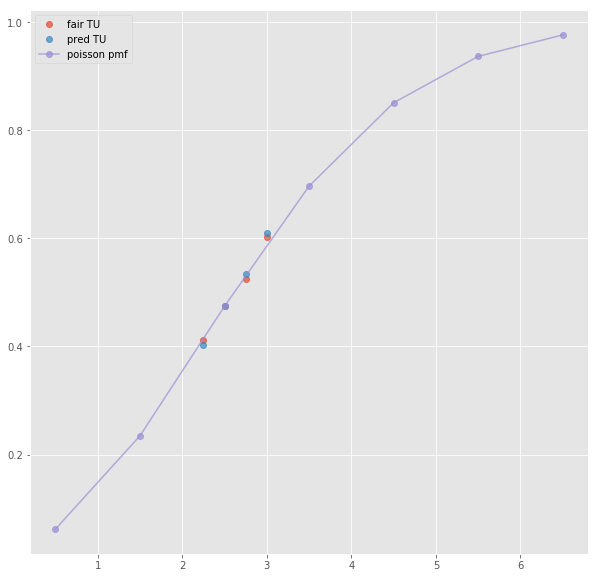

ML : 1.66 3.95 5.4
Error home:  0.00885096718795031
Error draw:  0.01813312094535613
Error away:  0.009281975318230218

(78, 124)
(1, 48)
2.5 1.819 2.1 -0.5 1.671 2.35
TO fair:  1.8661904761904764 TU fair:  2.154480483782298
TO pred:  1.86616 TU fair:  2.15452
Error TO:  0.0016953235912966491

Error TO:  0.008964152557967342

Error TO:  0.0036277650201322897

Error TO:  0.00345532239629176

Error TO:  0.0029198638253620235

Error TO:  8.750962729009437e-06

Error TO:  0.005166178202478444

Error TO:  0.001853658238623157

Error TO:  0.0033985796314214833



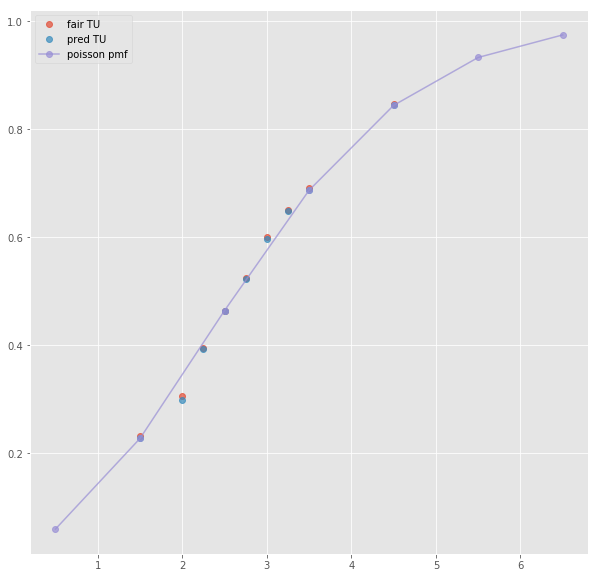

Error T1O:  0.00040132763636913094
ML : 1.671 4.13 5.31
Error home:  0.0028043456453372695
Error draw:  0.011214766935283699
Error away:  0.00841062807610099

(20, 124)
(1, 64)
2.5 1.85 2.05 -0.5 1.75 2.05
TO fair:  1.902439024390244 TU fair:  2.108108108108108
TO pred:  1.90243 TU fair:  2.10812
Error TO:  0.0007308577852615517

Error TO:  0.005705198486779084

Error TO:  0.01109545675492185

Error TO:  0.010782682290424617

Error TO:  0.01631297380507285

Error TO:  2.4934372059304266e-06

Error TO:  0.012934361427478391

Error TO:  0.007499535988033212

Error TO:  0.010090043112679581

Error TO:  0.007139297404070821

Error TO:  0.020282766050569778

Error TO:  0.011314602008687169

Error TO:  0.018996180401606444

Error TO:  0.018635505302603383



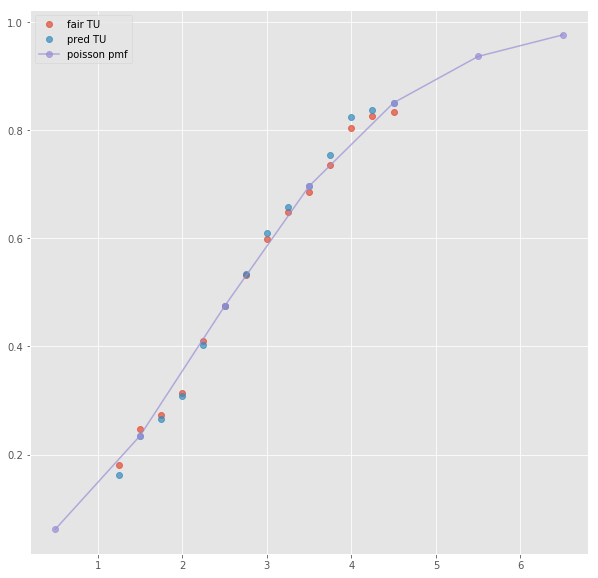

ML : 1.73 3.75 4.75
Error home:  0.008294153285157146
Error draw:  0.0164788182329047
Error away:  0.02477316567693988

(34, 124)
next positional indexers are out-of-bounds
(66, 124)
(1, 46)
2.5 2.2 1.719 -0.5 1.99 1.909
TO fair:  2.2798138452588717 TU fair:  1.7813636363636365
TO pred:  2.27979 TU fair:  1.78138
Error TO:  0.0021412192944836317

Error TO:  0.0006243767089523233

Error TO:  0.037182860342040325

Error TO:  0.007826082340646523

Error TO:  0.025313472975544732

Error TO:  4.587835213787361e-06

Error TO:  0.0003248307892461666

Error TO:  0.0005006558857920673

Error TO:  0.0005184829367581578



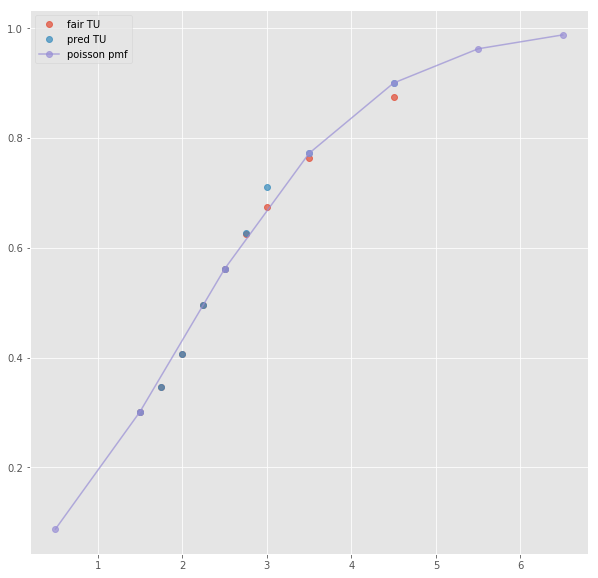

ML : 1.99 3.39 4.22
Error home:  0.003835018580354177
Error draw:  0.021620848824780547
Error away:  0.017786170354274405

(112, 124)
(1, 27)
2.5 2.14 1.69 -0.5 1.95 1.89
TO fair:  2.2662721893491127 TU fair:  1.7897196261682242
TO pred:  2.2663 TU fair:  1.7897
Error TO:  0.040718553629470244

Error TO:  0.011787155203804023

Error TO:  5.414790835212013e-06

Error TO:  0.004378751376323153



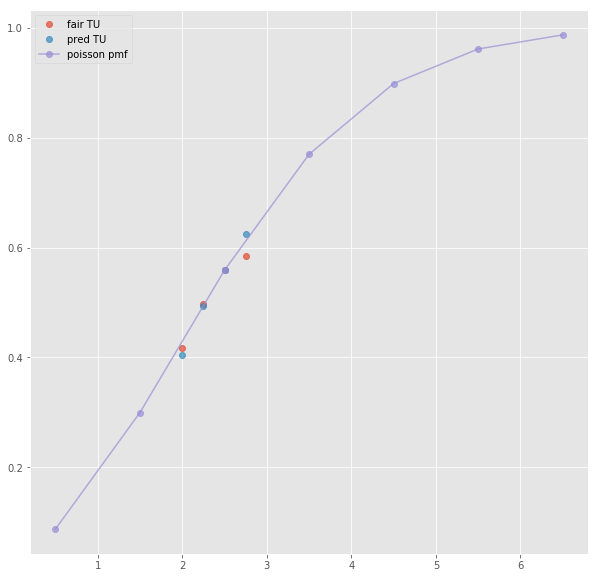

ML : 1.94 3.26 4.06
Error home:  0.009761775524841254
Error draw:  0.024569948156648924
Error away:  0.014808016041921501

(139, 124)
(1, 23)
2.5 2.17 1.75 -0.5 2.0 1.92
TO fair:  2.2399999999999998 TU fair:  1.8064516129032258
TO pred:  2.23999 TU fair:  1.80646
Error TO:  0.033803252782765636

Error TO:  1.992993591104497e-06

Error TO:  0.012670655244364504



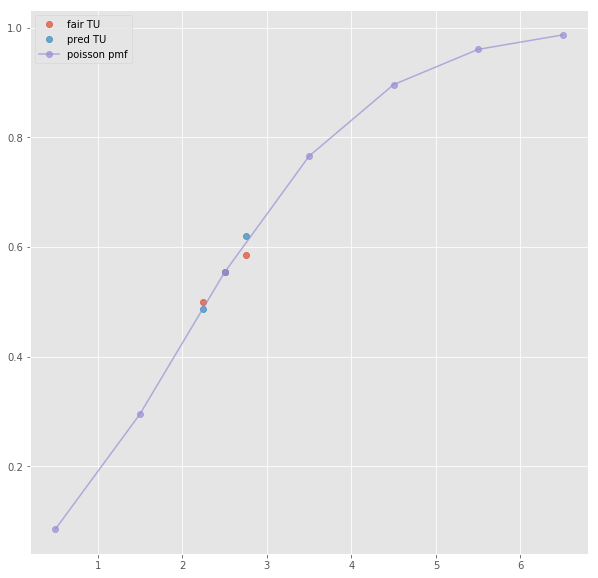

ML : 1.99 3.3 4.1
Error home:  0.010949169578630125
Error draw:  0.02702068793255652
Error away:  0.016071578377950202

(475, 124)
(1, 27)
2.5 2.2 1.73 -0.5 2.01 1.91
TO fair:  2.2716763005780347 TU fair:  1.7863636363636364
TO pred:  2.27165 TU fair:  1.78638
Error TO:  0.005692478316027927

Error TO:  0.009089047052102006

Error TO:  5.096563353679251e-06

Error TO:  0.013550141406720617



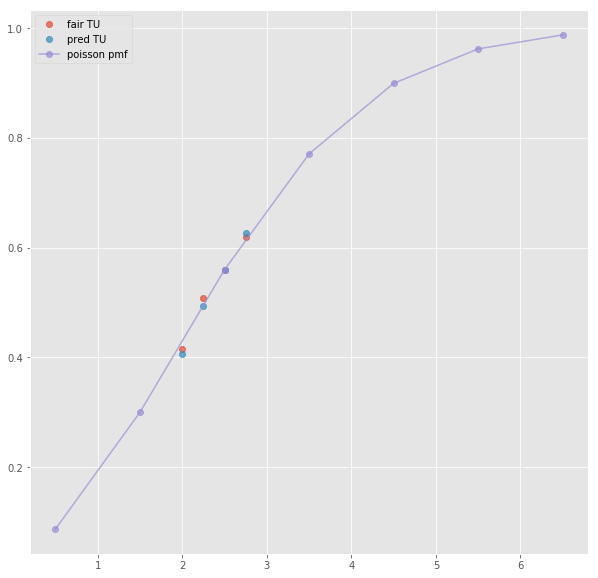

ML : 2.0 3.25 4.1
Error home:  0.011766125374249092
Error draw:  0.02902947382894866
Error away:  0.0172636751447571

(59, 124)
(1, 48)
2.5 2.2 1.719 -0.5 1.99 1.909
TO fair:  2.2798138452588717 TU fair:  1.7813636363636365
TO pred:  2.27979 TU fair:  1.78138
Error TO:  0.0021412192944836317

Error TO:  0.0006243767089523233

Error TO:  0.037182860342040325

Error TO:  0.007826082340646523

Error TO:  0.025313472975544732

Error TO:  4.587835213787361e-06

Error TO:  0.0003248307892461666

Error TO:  0.0005006558857920673

Error TO:  0.0005184829367581578



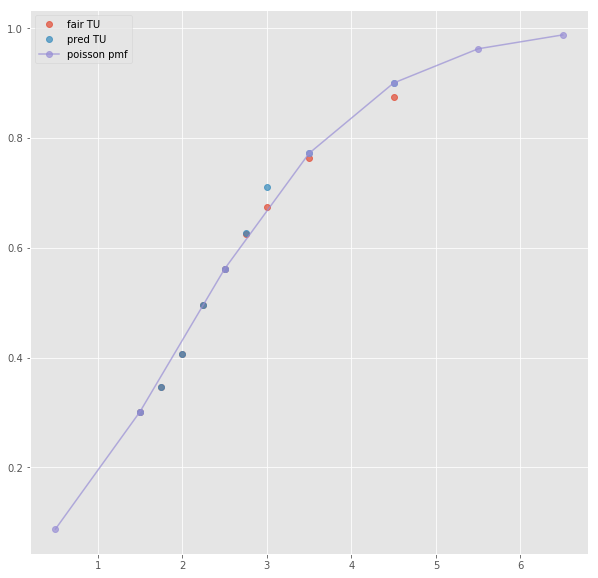

Error T1O:  0.0023682093157398887
ML : 1.99 3.39 4.22
Error home:  0.003835018580354177
Error draw:  0.021620848824780547
Error away:  0.017786170354274405

(43, 124)
(1, 64)
2.5 2.1 1.7 -0.5 2.01 1.89
TO fair:  2.235294117647059 TU fair:  1.8095238095238095
TO pred:  2.23531 TU fair:  1.80951
Error TO:  0.004320791854910522

Error TO:  0.013359981232654028

Error TO:  0.004900743955025877

Error TO:  0.012402136030771727

Error TO:  0.03151271883675161

Error TO:  3.178647774992882e-06

Error TO:  0.019882508053883363

Error TO:  0.019204902763921616

Error TO:  0.010648143020739409

Error TO:  0.013464327057453374

Error TO:  0.01581336414653549

Error TO:  0.024212886692861008

Error TO:  0.008042465665742599

Error TO:  0.02331550101367863



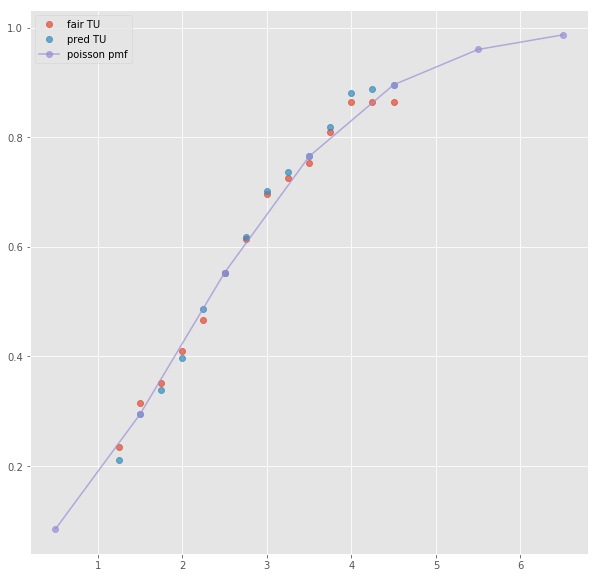

ML : 1.91 3.6 3.8
Error home:  0.007222773179043129
Error draw:  0.0014106678902013892
Error away:  0.005811919628584877

(33, 124)
next positional indexers are out-of-bounds
(46, 124)
(1, 41)
2.5 2.1 1.775 -0.5 2.39 1.6130000000000002
TO fair:  2.183098591549296 TU fair:  1.8452380952380951
TO pred:  2.1831 TU fair:  1.84524
Error TO:  0.0019503125437699276

Error TO:  0.005068955950643161

Error TO:  0.004112744359295345

Error TO:  2.9552530356191653e-07

Error TO:  0.007352399720790159

Error TO:  0.00202922101120917

Error TO:  0.00571187211401214



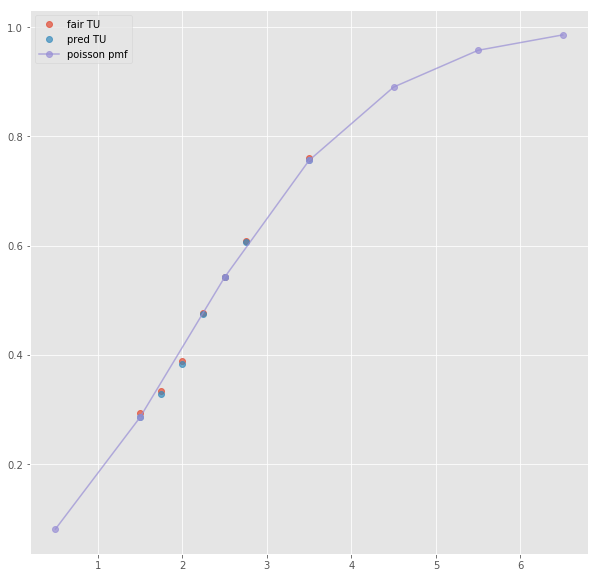

ML : 2.39 3.49 2.98
Error home:  0.0008129151845935878
Error draw:  0.006800432406974033
Error away:  0.0059877615271193285

(39, 124)
(1, 21)
next list index out of range
(68, 124)
(1, 21)
next list index out of range
(165, 124)
(1, 19)
next list index out of range
(43, 124)
(1, 43)
2.5 2.1 1.775 -0.5 2.39 1.6130000000000002
TO fair:  2.183098591549296 TU fair:  1.8452380952380951
TO pred:  2.1831 TU fair:  1.84524
Error TO:  0.0019503125437699276

Error TO:  0.005068955950643161

Error TO:  0.004112744359295345

Error TO:  2.9552530356191653e-07

Error TO:  0.007352399720790159

Error TO:  0.00202922101120917

Error TO:  0.00571187211401214



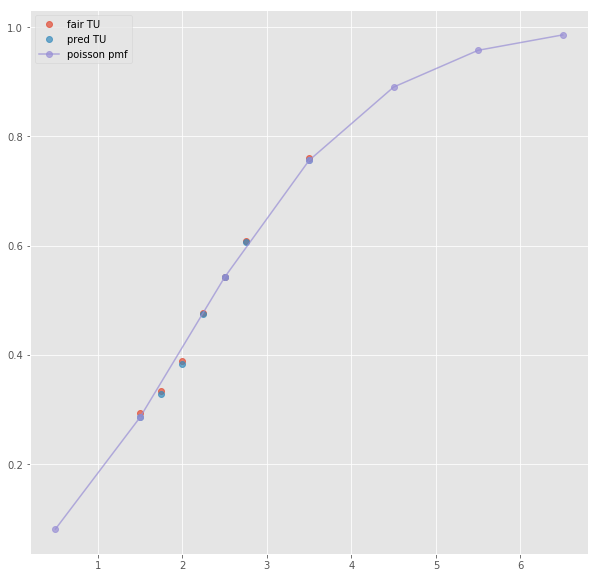

Error T1O:  0.0013957702160070085
ML : 2.39 3.49 2.98
Error home:  0.0008129151845935878
Error draw:  0.006800432406974033
Error away:  0.0059877615271193285

(13, 124)
next positional indexers are out-of-bounds
(120, 124)
next positional indexers are out-of-bounds
(170, 124)
next positional indexers are out-of-bounds
(120, 124)
next positional indexers are out-of-bounds
(348, 124)
next positional indexers are out-of-bounds
(114, 124)
(1, 50)
3.5 2.03 1.892 -1.5 1.917 2.01
TO fair:  2.072938689217759 TU fair:  1.9320197044334975
TO pred:  2.07297 TU fair:  1.932
Error TO:  0.010253612076483676

Error TO:  0.0011810879276685782

Error TO:  7.286424068275732e-06

Error TO:  0.00957183547520496

Error TO:  0.000992371627199673

Error TO:  0.0030921045117537904

Error TO:  0.0009586330186220904

Error TO:  0.007798270525916529

Error TO:  0.006068771873412149

Error TO:  0.0025554441671416517



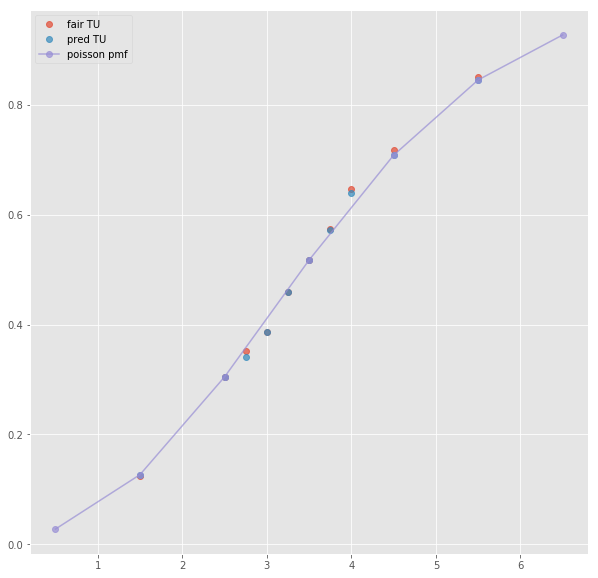

Error T1O:  0.0002841452811765399
ML : 1.358 5.66 8.46
Error home:  0.010544435712723232
Error draw:  0.013536399843134261
Error away:  0.002991913244328459

(29, 124)
(1, 67)
3.5 2.0 1.8 -1.5 1.98 1.95
TO fair:  2.111111111111111 TU fair:  1.9000000000000001
TO pred:  2.11109 TU fair:  1.90001
Error TO:  0.0020147351954180603

Error TO:  0.02110569350690139

Error TO:  0.004122950029994521

Error TO:  4.736889474221684e-06

Error TO:  0.01972307697210851

Error TO:  0.002223414647569588

Error TO:  0.02699139777273407

Error TO:  0.01049052047988741

Error TO:  0.0002483653835951838

Error TO:  0.021518957742678646

Error TO:  0.011764277201474993

Error TO:  0.01598225030222905

Error TO:  0.0009272894398335008

Error TO:  0.02217776994126225

Error TO:  0.017639845519538844

Error TO:  0.013379334501573137



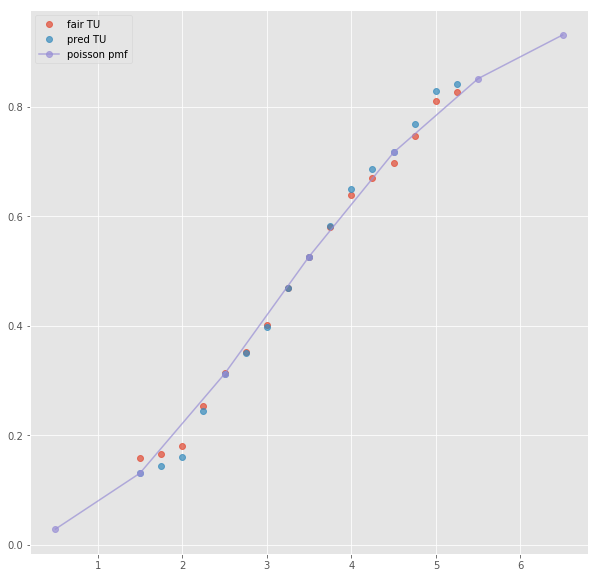

ML : 1.3 5.75 9.5
Error home:  0.02183839473631699
Error draw:  0.0026812525183262936
Error away:  0.024519593016869484

(43, 124)
next positional indexers are out-of-bounds
(44, 124)
(1, 18)
next list index out of range
(88, 124)
(1, 33)
3.5 1.6 2.41 3.5 1.7 2.21


./operator_position/skellam.py:59: RuntimeWarning: invalid value encountered in power
  return np.exp(-self.mu)*((self.mu-mu2)/mu2)**(k/2)*iv(k, 2*np.sqrt((self.mu-mu2)*mu2))
./operator_position/skellam.py:59: RuntimeWarning: invalid value encountered in sqrt
  return np.exp(-self.mu)*((self.mu-mu2)/mu2)**(k/2)*iv(k, 2*np.sqrt((self.mu-mu2)*mu2))


TO fair:  1.6639004149377592 TU fair:  2.5062499999999996
TO pred:  1.66391 TU fair:  2.50622
Error TO:  3.4620853915923178e-06

Error TO:  0.007743078748995935

Error TO:  0.0058274275367804496

Error TO:  0.007163326332184083

Error TO:  0.0035525674218649383



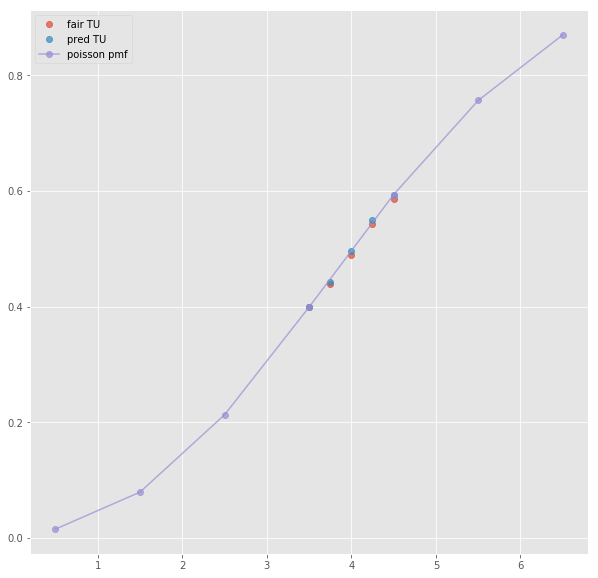

Error T1O:  0.04021121076588424
ML : 41.62 14.41 1.06
Error home:  0.006497147282305327
Error draw:  0.014291140507152328
Error away:  0.020788280955061134

(19, 124)
(1, 39)
2.5 2.2 1.729 -0.5 2.68 1.526
TO fair:  2.2724117987275885 TU fair:  1.7859090909090911
TO pred:  2.27243 TU fair:  1.7859
Error TO:  0.0029211828774191595

Error TO:  0.00010072028718421944

Error TO:  0.008836741290630334

Error TO:  3.5247165686147497e-06

Error TO:  0.0008959084281803253

Error TO:  8.763544951317925e-05

Error TO:  0.0003245096406764292



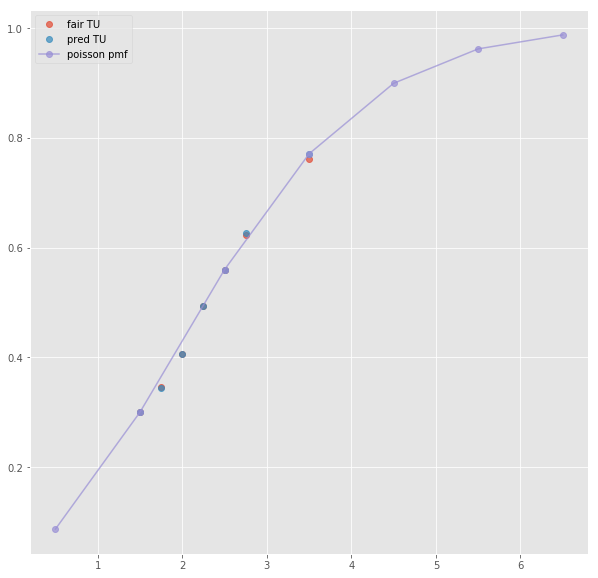

ML : 2.68 3.39 2.73
Error home:  0.0020802085839999873
Error draw:  0.011068707206302986
Error away:  0.00898843999600224

(18, 124)
(1, 19)
next list index out of range
(72, 124)
(1, 21)
next list index out of range
(70, 124)
(1, 23)
next list index out of range
(16, 124)
(1, 41)
2.5 2.2 1.729 -0.5 2.68 1.526
TO fair:  2.2724117987275885 TU fair:  1.7859090909090911
TO pred:  2.27243 TU fair:  1.7859
Error TO:  0.0029211828774191595

Error TO:  0.00010072028718421944

Error TO:  0.008836741290630334

Error TO:  3.5247165686147497e-06

Error TO:  0.0008959084281803253

Error TO:  8.763544951317925e-05

Error TO:  0.0003245096406764292



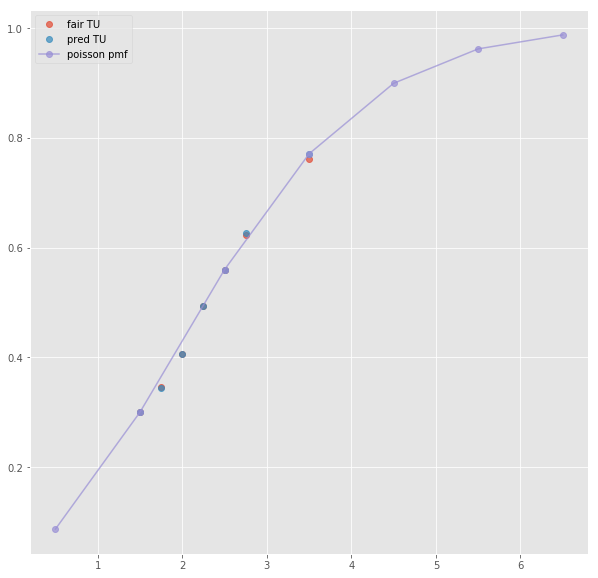

Error T1O:  0.009893589352482912
ML : 2.68 3.39 2.73
Error home:  0.0020802085839999873
Error draw:  0.011068707206302986
Error away:  0.00898843999600224

(155, 124)
(1, 62)
2.5 2.1 1.7 -0.5 2.6 1.475
TO fair:  2.235294117647059 TU fair:  1.8095238095238095
TO pred:  2.23531 TU fair:  1.80951
Error TO:  0.004320791854910522

Error TO:  0.013359981232654028

Error TO:  0.004900743955025877

Error TO:  0.012402136030771727

Error TO:  3.178647774992882e-06

Error TO:  0.019882508053883363

Error TO:  0.007196327584677031

Error TO:  0.010648143020739409

Error TO:  0.013464327057453374

Error TO:  0.01581336414653549

Error TO:  0.015067956805893012

Error TO:  0.02331550101367863

Error TO:  0.028348814604790995



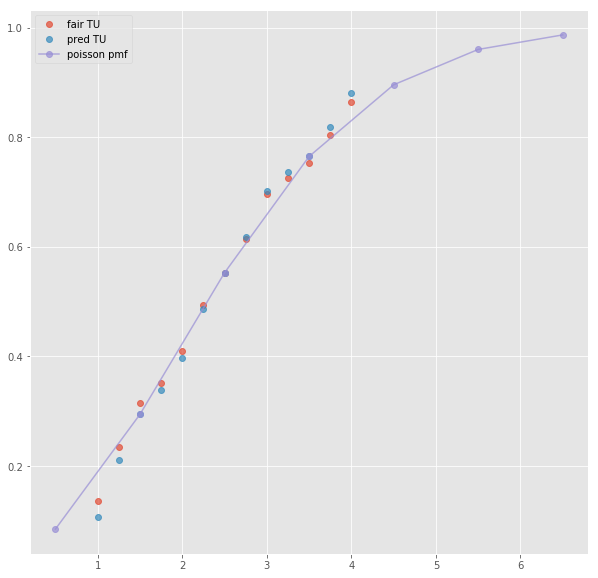

ML : 2.55 3.3 2.7
Error home:  0.006076786421828795
Error draw:  0.012141465786516703
Error away:  0.018218267826506207

(7, 124)
(1, 33)
2.5 2.19 1.72 -0.5 2.66 1.51
TO fair:  2.2732558139534884 TU fair:  1.7853881278538815
TO pred:  2.27322 TU fair:  1.78541
Error TO:  0.005084023069559573

Error TO:  0.0011839982764311197

Error TO:  6.930466784349498e-06

Error TO:  0.0016267330980573869

Error TO:  0.003742518206135803



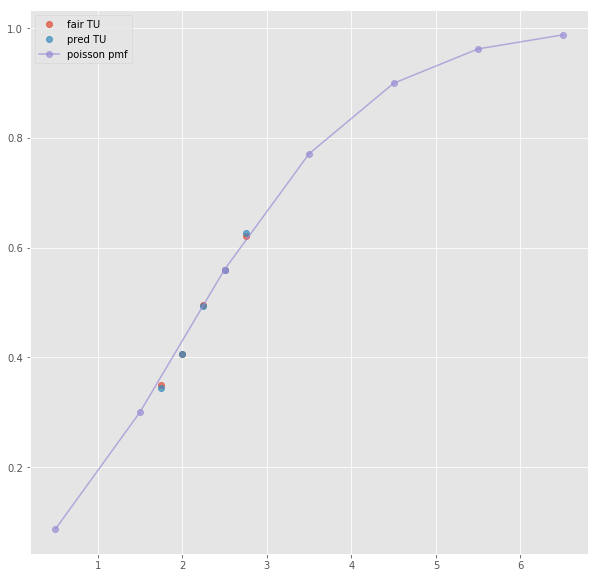

Error T1O:  0.008123197632488366
ML : 2.71 3.24 2.77
Error home:  0.00684135534542063
Error draw:  0.023015664632746458
Error away:  0.016173988753217794

(157, 124)
(1, 48)
4.5 2.1 1.787 -2.5 1.74 2.19
TO fair:  2.1751538891997764 TU fair:  1.850952380952381
TO pred:  2.17514 TU fair:  1.85096
Error TO:  0.009870118874442335

Error TO:  2.9356212419284766e-06

Error TO:  0.0035234540638797718

Error TO:  0.0073559716657728424

Error TO:  0.015619957389048672

Error TO:  0.014582639839650025

Error TO:  0.0021172224087339098

Error TO:  0.008978846790287487

Error TO:  0.006015311265613277



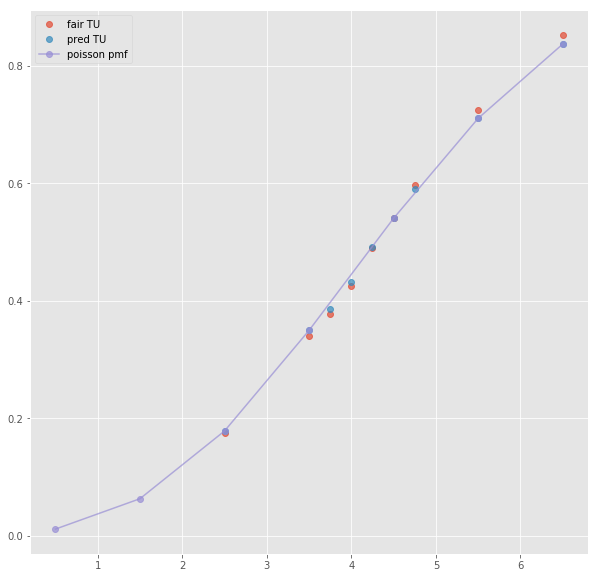

Error T1O:  0.008704690663166148
ML : 1.108 11.24 21.16
Error home:  0.014404151725156189
Error draw:  0.008605236218679133
Error away:  0.005798894806457698

(158, 124)
(1, 67)
4.5 2.075 1.725 -2.5 1.775 2.025
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20293 TU fair:  1.8313
Error TO:  0.02241252241252234

Error TO:  0.02123983222283754

Error TO:  0.020194590688551672

Error TO:  6.480603464253942e-06

Error TO:  0.027154824102626818

Error TO:  0.020860205492786443

Error TO:  0.02050539097834625

Error TO:  0.008658490147439135

Error TO:  0.0018748675017530858

Error TO:  0.02825578756631225

Error TO:  0.008954974314829833

Error TO:  0.002158517533416282

Error TO:  0.001310314935567325

Error TO:  0.003349142237046465

Error TO:  0.010577579847384888

Error TO:  0.014174963703723703

Error TO:  0.010646337078822815



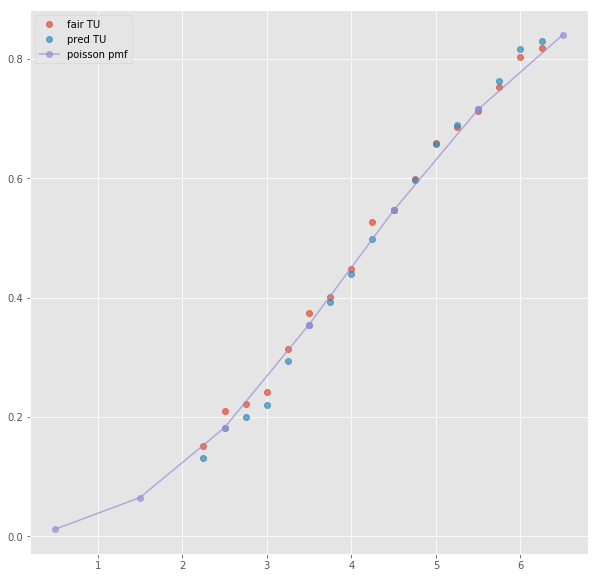

ML : 1.125 10.0 17.0
Error home:  0.021231605645059437
Error draw:  0.011320311095093308
Error away:  0.00991131833726127

(130, 124)
next positional indexers are out-of-bounds
(13, 124)
(1, 45)
2.5 1.854 2.03 0.5 1.6840000000000002 2.28
TO fair:  1.9133004926108375 TU fair:  2.0949298813376482
TO pred:  1.91327 TU fair:  2.09496
Error TO:  0.0008259262548112045

Error TO:  0.0004478729041828

Error TO:  0.00329791477975111

Error TO:  0.005173890420108185

Error TO:  0.0034571531999307015

Error TO:  8.32981135268085e-06

Error TO:  0.0014449848518914843

Error TO:  0.0008966802611789504

Error TO:  0.008605258520642811



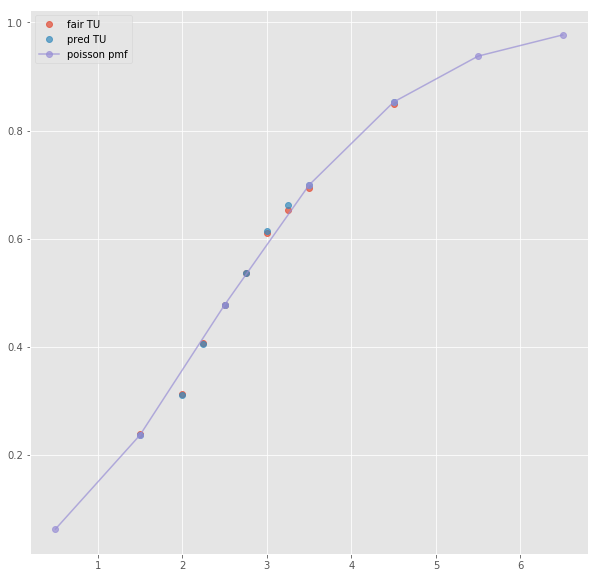

ML : 3.13 3.61 2.28
Error home:  0.013821771176039443
Error draw:  0.014916572029563757
Error away:  0.0010950704877568107

(20, 124)
(1, 19)
next list index out of range
(55, 124)
(1, 19)
next list index out of range
(34, 124)
(1, 19)
next list index out of range
(12, 124)
(1, 47)
2.5 1.854 2.03 0.5 1.6840000000000002 2.28
TO fair:  1.9133004926108375 TU fair:  2.0949298813376482
TO pred:  1.91327 TU fair:  2.09496
Error TO:  0.0008259262548112045

Error TO:  0.0004478729041828

Error TO:  0.00329791477975111

Error TO:  0.005173890420108185

Error TO:  0.0034571531999307015

Error TO:  8.32981135268085e-06

Error TO:  0.0014449848518914843

Error TO:  0.0008966802611789504

Error TO:  0.008605258520642811



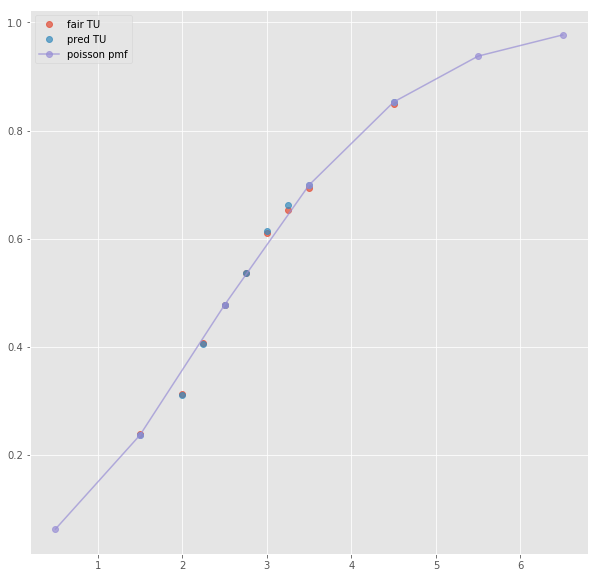

Error T1O:  0.0023237665013723374
ML : 3.13 3.61 2.28
Error home:  0.013821771176039443
Error draw:  0.014916572029563757
Error away:  0.0010950704877568107

(52, 124)
(1, 66)
2.5 1.8 2.0 0.5 1.625 2.25
TO fair:  1.9000000000000001 TU fair:  2.111111111111111
TO pred:  1.89998 TU fair:  2.11114
Error TO:  0.013174274726039326

Error TO:  0.02155387532403441

Error TO:  0.004935479896988837

Error TO:  0.0007617666151030766

Error TO:  0.0111579922649582

Error TO:  5.540224523148396e-06

Error TO:  0.0199284331790176

Error TO:  0.017301489909457457

Error TO:  0.0008249933231021522

Error TO:  0.020523026825464474

Error TO:  0.004039030848443259

Error TO:  0.0033484742241151333

Error TO:  0.008176767005051044

Error TO:  0.027681601492839714

Error TO:  0.032599383271307916



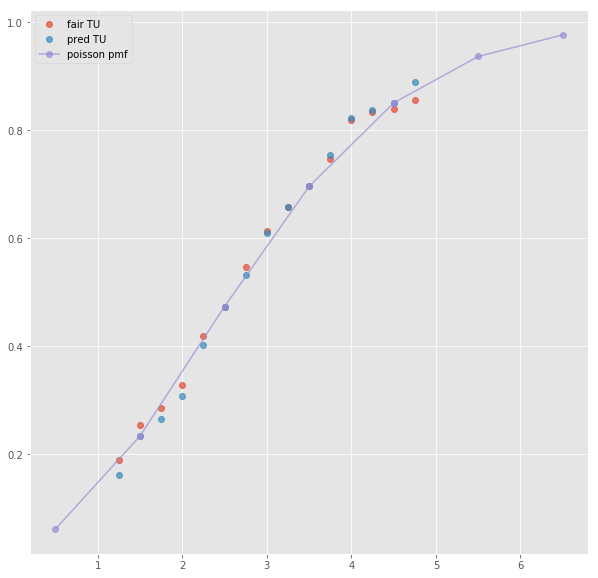

ML : 3.0 3.4 2.3
Error home:  0.014571777704113165
Error draw:  0.024602236221727858
Error away:  0.010030167572420812

(10, 124)
(1, 33)
2.5 1.83 2.02 0.5 1.67 2.27
TO fair:  1.9059405940594059 TU fair:  2.1038251366120218
TO pred:  1.90591 TU fair:  2.10386
Error TO:  0.0035965263265804737

Error TO:  0.0029027119018522063

Error TO:  0.010003388463528273

Error TO:  8.422196248414338e-06

Error TO:  0.002257517485707239



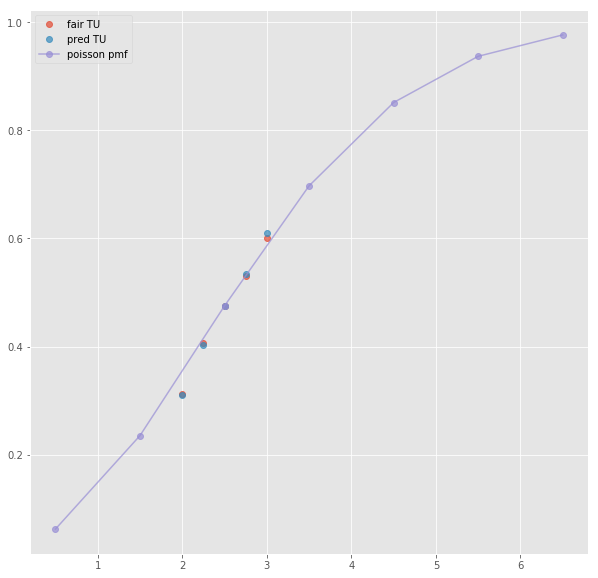

Error T1O:  0.0019023215779945257
ML : 3.13 3.51 2.3
Error home:  0.01636862732780675
Error draw:  0.021820474226395603
Error away:  0.005452128411040036

(32, 124)
(1, 41)
2.5 2.42 1.602 -0.5 2.11 1.793
TO fair:  2.510611735330836 TU fair:  1.6619834710743802
TO pred:  2.51062 TU fair:  1.66198
Error TO:  0.0013683205691420453

Error TO:  0.00030182780265775033

Error TO:  0.0016314499611559397

Error TO:  1.311187905750355e-06

Error TO:  0.0017265267742269108

Error TO:  0.00035398774114236975

Error TO:  0.001580325339680111

Error TO:  0.025055736553128205



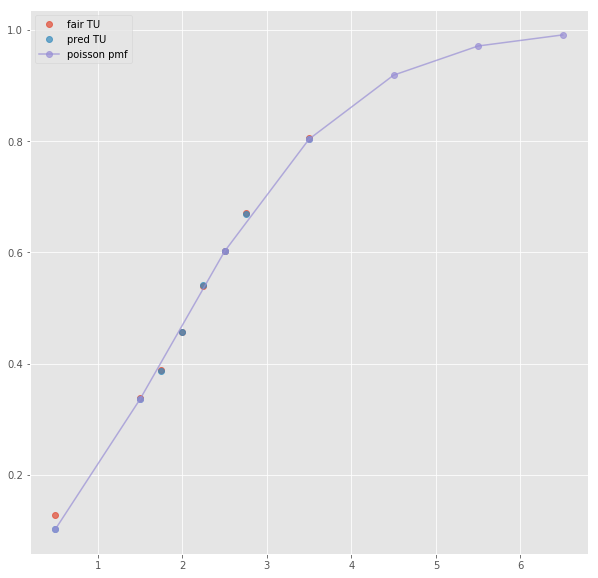

ML : 2.11 3.01 4.35
Error home:  0.0019257271011665633
Error draw:  0.04271684779929108
Error away:  0.04079094449489912

(60, 124)
(1, 23)
next list index out of range
(95, 124)
(1, 19)
next list index out of range
(115, 124)
(1, 21)
next list index out of range
(25, 124)
(1, 43)
2.5 2.42 1.602 -0.5 2.11 1.793
TO fair:  2.510611735330836 TU fair:  1.6619834710743802
TO pred:  2.51062 TU fair:  1.66198
Error TO:  0.0013683205691420453

Error TO:  0.00030182780265775033

Error TO:  0.0016314499611559397

Error TO:  1.311187905750355e-06

Error TO:  0.0017265267742269108

Error TO:  0.00035398774114236975

Error TO:  0.001580325339680111

Error TO:  0.025055736553128205



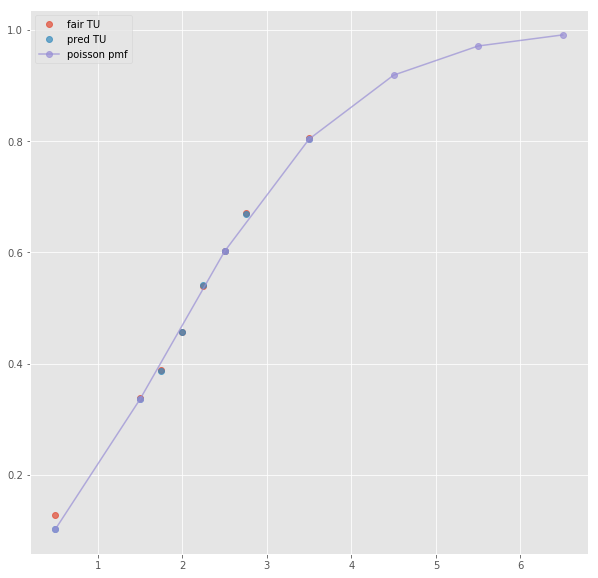

Error T1O:  0.007585483667875037
ML : 2.11 3.01 4.35
Error home:  0.0019257271011665633
Error draw:  0.04271684779929108
Error away:  0.04079094449489912

(42, 124)
(1, 10)
next list index out of range
(20, 124)
(1, 33)
2.5 2.39 1.61 -0.5 2.1 1.77
TO fair:  2.484472049689441 TU fair:  1.6736401673640164
TO pred:  2.48441 TU fair:  1.67367
Error TO:  0.005300007256561101

Error TO:  0.0015204280583681618

Error TO:  1.0052688565853618e-05

Error TO:  0.001556508292703429

Error TO:  0.0013109032343668892



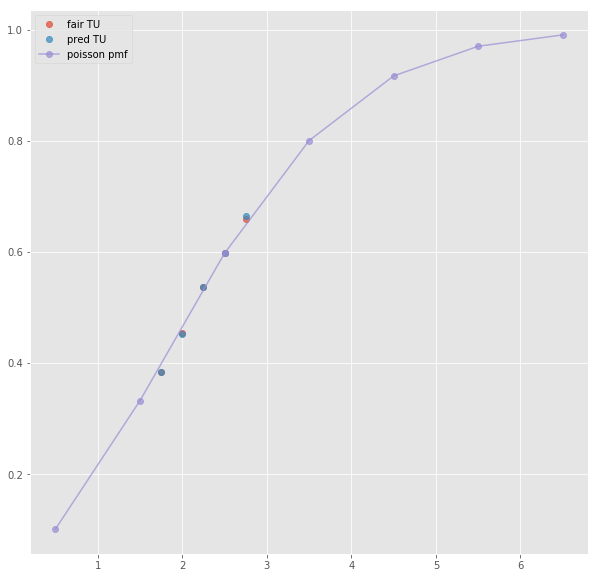

Error T1O:  0.01079017268293958
ML : 2.12 3.13 4.0
Error home:  0.004340292163660886
Error draw:  0.02970254817742568
Error away:  0.025362517607892626

(28, 124)
(1, 41)
2.5 2.32 1.649 -0.5 2.22 1.719
TO fair:  2.406913280776228 TU fair:  1.7107758620689655
TO pred:  2.40687 TU fair:  1.7108
Error TO:  0.0027825832819263763

Error TO:  0.0015584261422900703

Error TO:  0.011144019879120365

Error TO:  7.4710555245660615e-06

Error TO:  0.001467155010457799

Error TO:  2.8366927076250992e-05

Error TO:  0.002045863427054595



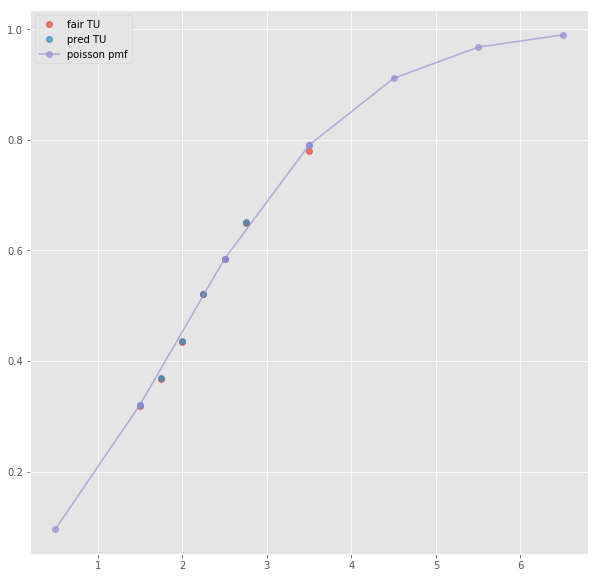

ML : 2.22 3.01 3.95
Error home:  0.0015441994513844537
Error draw:  0.044340181091273356
Error away:  0.04279630556897915

(44, 124)
(1, 21)
2.5 2.16 1.68 -0.5 2.23 1.65
TO fair:  2.2857142857142856 TU fair:  1.7777777777777777
TO pred:  2.28574 TU fair:  1.77776
Error TO:  0.05196967407721487

Error TO:  4.921819629521984e-06

Error TO:  0.044761270066876746



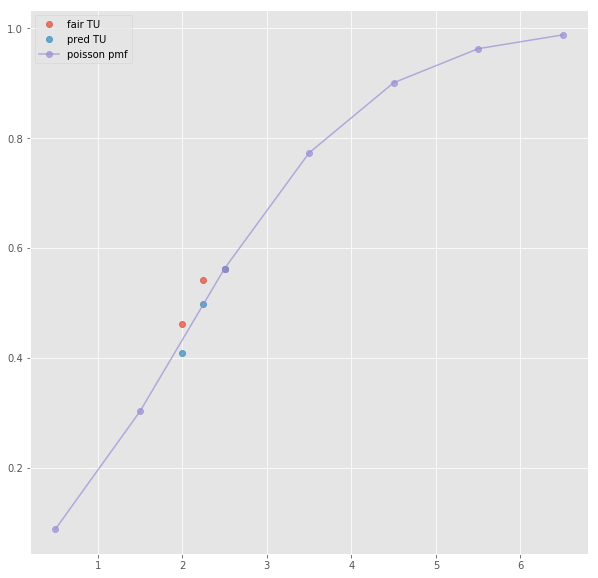

ML : 2.24 2.91 3.26
Error home:  0.01823590900322658
Error draw:  0.04131557438817529
Error away:  0.023079654029486307

(54, 124)
(1, 21)
2.5 2.28 1.68 -0.5 2.21 1.74
TO fair:  2.357142857142857 TU fair:  1.736842105263158
TO pred:  2.3572 TU fair:  1.73681
Error TO:  0.024019413344374185

Error TO:  1.0284415510986022e-05

Error TO:  0.016460153569976765



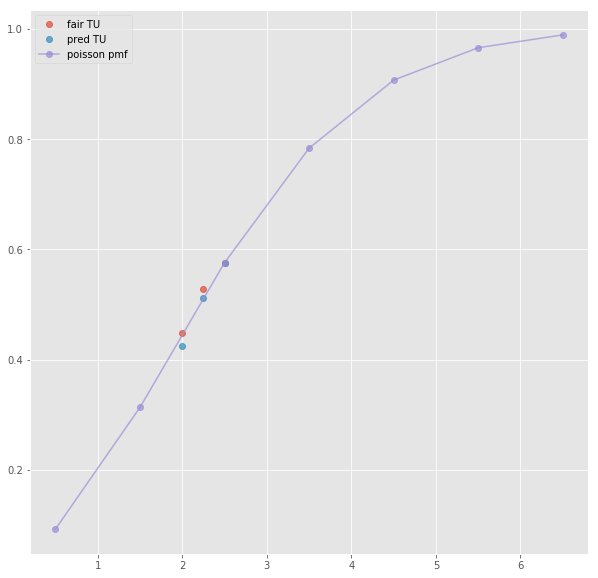

ML : 2.2 3.0 3.85
Error home:  0.006626871640032839
Error draw:  0.044422972349112244
Error away:  0.03779591246287489

(83, 124)
(1, 19)
next list index out of range
(23, 124)
(1, 43)
2.5 2.32 1.649 -0.5 2.22 1.719
TO fair:  2.406913280776228 TU fair:  1.7107758620689655
TO pred:  2.40687 TU fair:  1.7108
Error TO:  0.0027825832819263763

Error TO:  0.0015584261422900703

Error TO:  0.011144019879120365

Error TO:  7.4710555245660615e-06

Error TO:  0.001467155010457799

Error TO:  2.8366927076250992e-05

Error TO:  0.002045863427054595



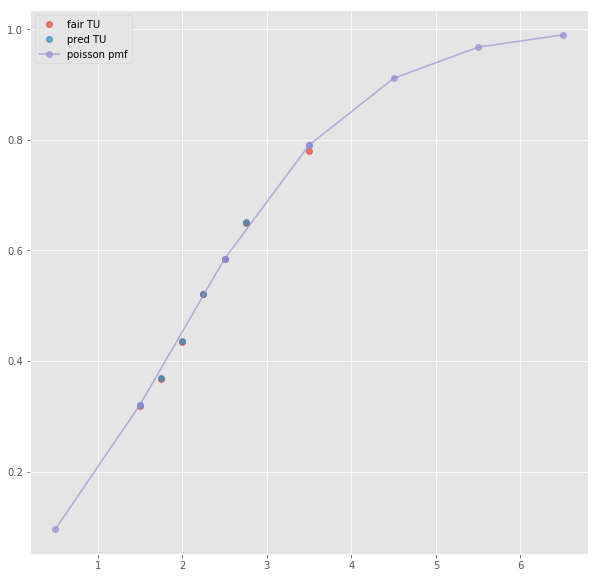

Error T1O:  0.014774279708533788
ML : 2.22 3.01 3.95
Error home:  0.0015441994513844537
Error draw:  0.044340181091273356
Error away:  0.04279630556897915

(12, 124)
(1, 59)
2.5 2.25 1.625 -0.5 2.0 1.85
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.0009003040170663112

Error TO:  0.016384364879377666

Error TO:  0.005660988994402261

Error TO:  0.014579997301658959

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.008832548426947251

Error TO:  0.010404530151327085

Error TO:  0.020352240119340337

Error TO:  0.03249454955068706

Error TO:  0.011428927950369011

Error TO:  0.022057817955149273

Error TO:  0.026633774838264346



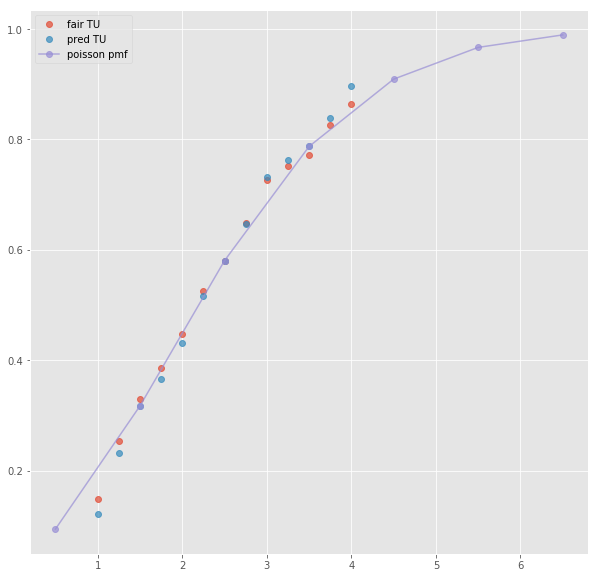

ML : 2.0 3.4 3.75
Error home:  0.009161141299289077
Error draw:  0.007715280874837638
Error away:  0.001445682528403186

(13, 124)
(1, 35)
2.5 2.31 1.65 -0.5 2.12 1.76
TO fair:  2.4 TU fair:  1.714285714285714
TO pred:  2.40003 TU fair:  1.71427
Error TO:  0.00430311840639358

Error TO:  0.003005404070674733

Error TO:  5.208268230028068e-06

Error TO:  0.0019404894386299554

Error TO:  0.0029075904326677504



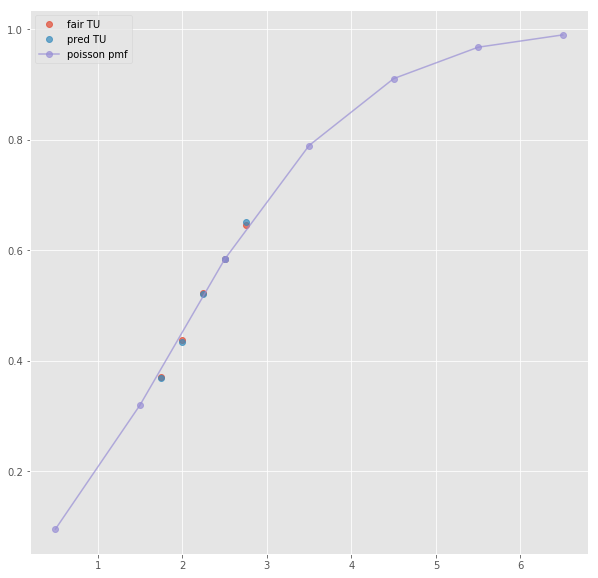

Error T1O:  0.011624843711765642
ML : 2.15 3.15 3.9
Error home:  0.005948131396569523
Error draw:  0.031464977077812095
Error away:  0.025517201078102875

(135, 124)
(1, 41)
2.5 2.4 1.609 -0.5 1.99 1.909
TO fair:  2.4916096954630205 TU fair:  1.6704166666666669
TO pred:  2.49163 TU fair:  1.67041
Error TO:  0.00012041954175756597

Error TO:  0.00013923604566301595

Error TO:  0.002151777370201585

Error TO:  3.270615773653951e-06

Error TO:  0.00026162049907674234

Error TO:  5.8056066837564035e-05

Error TO:  0.00023617264492148404



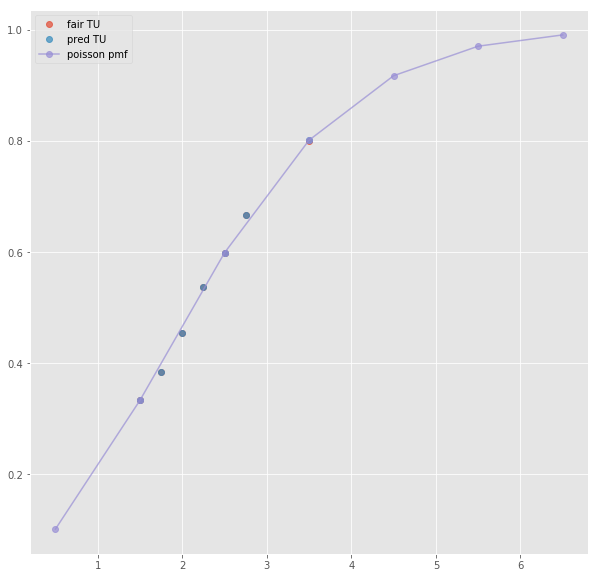

ML : 1.99 3.26 4.47
Error home:  0.003151123563223557
Error draw:  0.024544406762911475
Error away:  0.021393243300031395

(67, 124)
(1, 23)
2.5 2.29 1.57 -0.5 1.98 1.84
TO fair:  2.4585987261146496 TU fair:  1.6855895196506552
TO pred:  2.45863 TU fair:  1.68557
Error TO:  0.01113283945670851

Error TO:  5.173697243510134e-06

Error TO:  0.007512316577557132



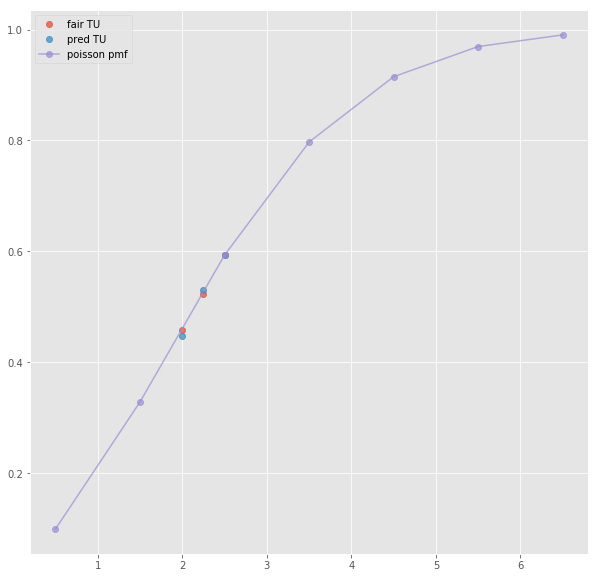

ML : 1.98 3.26 3.91
Error home:  0.008571545581686268
Error draw:  0.0149012982703573
Error away:  0.006329576106029133

(127, 124)
(1, 23)
2.5 2.35 1.62 -0.5 2.02 1.88
TO fair:  2.4506172839506175 TU fair:  1.6893617021276597
TO pred:  2.45069 TU fair:  1.68933
Error TO:  0.02139069141052119

Error TO:  1.2107832520813488e-05

Error TO:  0.003950610915440078



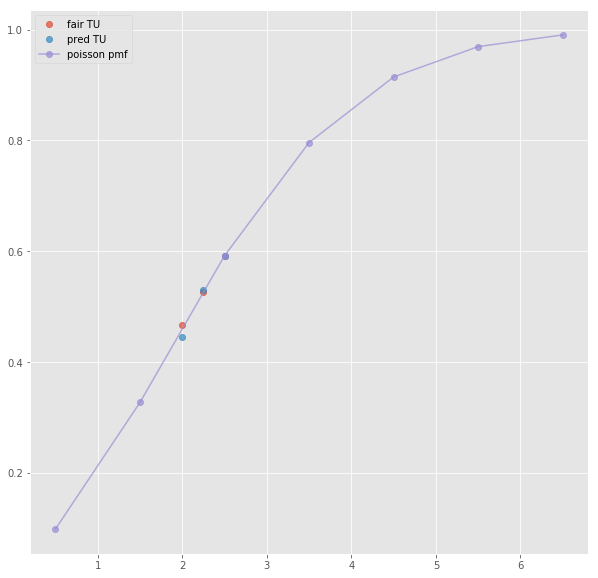

ML : 2.0 3.25 4.1
Error home:  0.006575534145239703
Error draw:  0.02054701477789178
Error away:  0.013971713053640394

(120, 124)
(1, 23)
2.5 2.35 1.62 -0.5 1.99 1.91
TO fair:  2.4506172839506175 TU fair:  1.6893617021276597
TO pred:  2.45069 TU fair:  1.68933
Error TO:  0.018813371822892222

Error TO:  1.2107832520813488e-05

Error TO:  0.003950610915440078



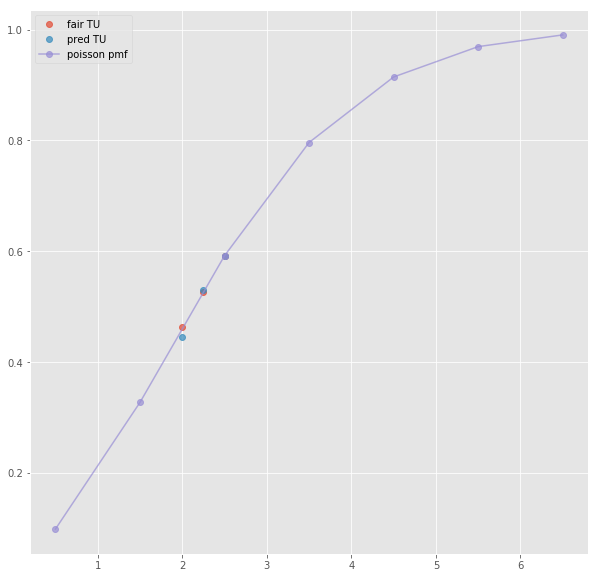

ML : 1.98 3.15 3.85
Error home:  0.02305649283126915
Error draw:  0.022585962290306183
Error away:  0.0004704360635711391

(131, 124)
next positional indexers are out-of-bounds
(42, 124)
(1, 58)
2.5 2.25 1.625 -0.5 2.05 1.75
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.009547734651831286

Error TO:  0.006924440558772171

Error TO:  0.018463264954572955

Error TO:  0.017438863721781245

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.0023390419334406443

Error TO:  0.016912035740595688

Error TO:  0.00927629075225167

Error TO:  0.019463835812848967

Error TO:  0.022057817955149273

Error TO:  0.026633774838264346



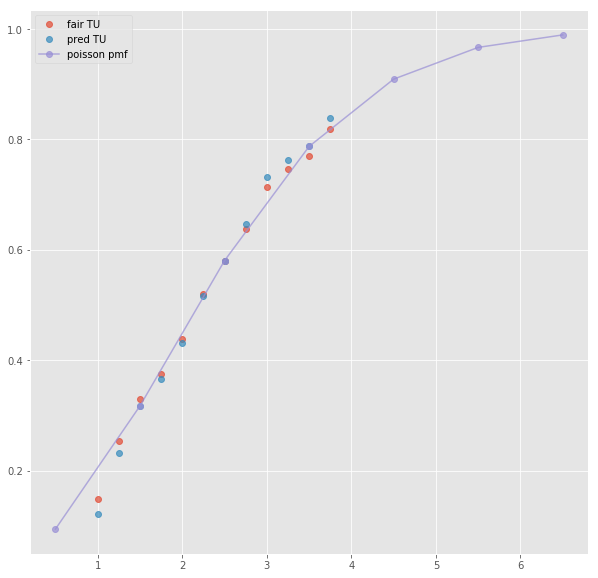

ML : 1.91 3.3 4.5
Error home:  0.038650242900195364
Error draw:  0.016422919564978877
Error away:  0.055073049873266805

(66, 124)
next positional indexers are out-of-bounds
(21, 124)
(1, 39)
2.5 2.1 1.787 -0.5 2.89 1.454
TO fair:  2.1751538891997764 TU fair:  1.850952380952381
TO pred:  2.17515 TU fair:  1.85096
Error TO:  0.0016230110087827598

Error TO:  0.0015784275270198656

Error TO:  0.005414949607607938

Error TO:  8.22017479196191e-07

Error TO:  0.0002604848919444125

Error TO:  0.0007802893970170199

Error TO:  0.001210383259143244



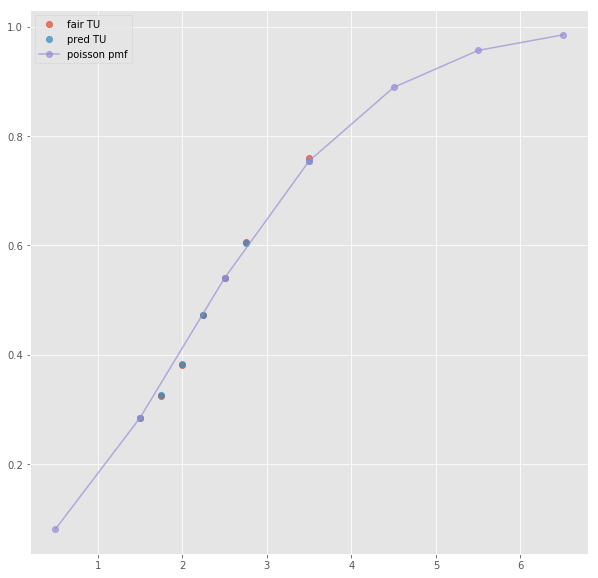

ML : 2.89 3.0 2.81
Error home:  0.0004769547502486149
Error draw:  0.05352081889484428
Error away:  0.05304398685515471

(26, 124)
(1, 21)
next list index out of range
(75, 124)
(1, 21)
next list index out of range
(125, 124)
(1, 21)
next list index out of range
(19, 124)
(1, 41)
2.5 2.1 1.787 -0.5 2.89 1.454
TO fair:  2.1751538891997764 TU fair:  1.850952380952381
TO pred:  2.17515 TU fair:  1.85096
Error TO:  0.0016230110087827598

Error TO:  0.0015784275270198656

Error TO:  0.005414949607607938

Error TO:  8.22017479196191e-07

Error TO:  0.0002604848919444125

Error TO:  0.0007802893970170199

Error TO:  0.001210383259143244



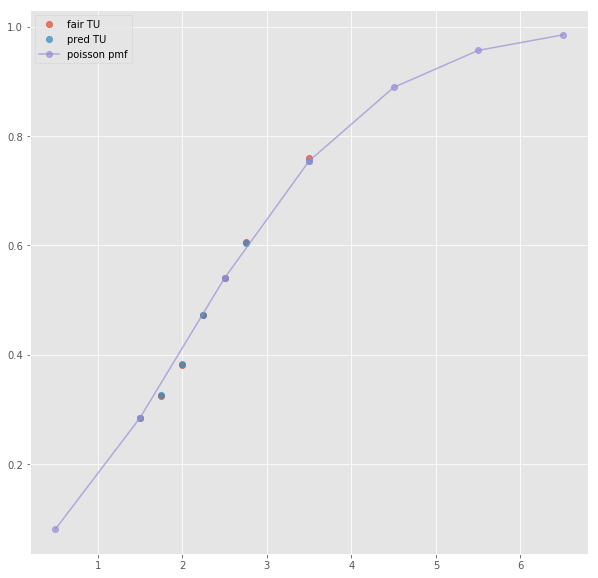

Error T1O:  0.015932225350786533
ML : 2.89 3.0 2.81
Error home:  0.0004769547502486149
Error draw:  0.05352081889484428
Error away:  0.05304398685515471

(30, 124)
(1, 10)
next list index out of range
(9, 124)
next positional indexers are out-of-bounds
(120, 124)
(1, 46)
3.5 2.1 1.806 -1.5 1.925 1.99
TO fair:  2.1627906976744184 TU fair:  1.8599999999999999
TO pred:  2.16281 TU fair:  1.85998
Error TO:  0.0048909481623703455

Error TO:  0.004539544828012554

Error TO:  4.12645178393678e-06

Error TO:  0.0076013395623342195

Error TO:  0.005663719969723591

Error TO:  0.0041546853445972864

Error TO:  0.002326298421663542

Error TO:  0.01499156822047848

Error TO:  0.00869183257916939

Error TO:  0.0026270391165455487



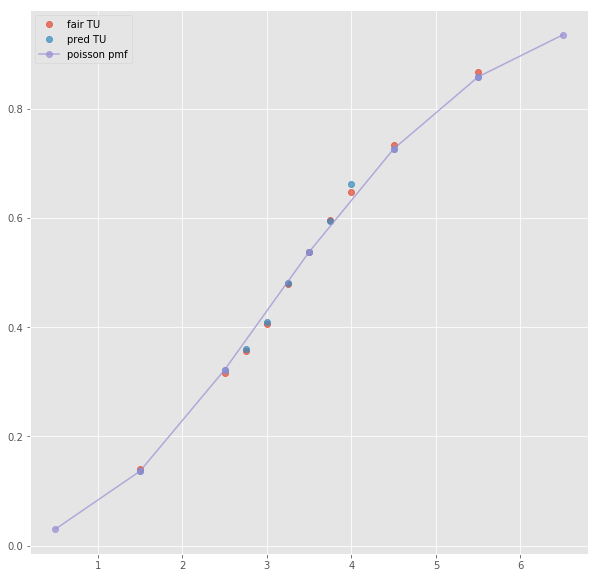

ML : 1.319 5.7 9.9
Error home:  0.008373780919729734
Error draw:  0.009649917686656018
Error away:  0.01802359426622792

(155, 124)
(1, 29)
3.5 2.09 1.75 -1.5 1.9 1.97
TO fair:  2.1942857142857144 TU fair:  1.8373205741626795
TO pred:  2.19425 TU fair:  1.83734
Error TO:  0.006828051583046557

Error TO:  0.0026922450236618323

Error TO:  7.417587634450662e-06

Error TO:  0.020094020752932762

Error TO:  0.003386851522548695



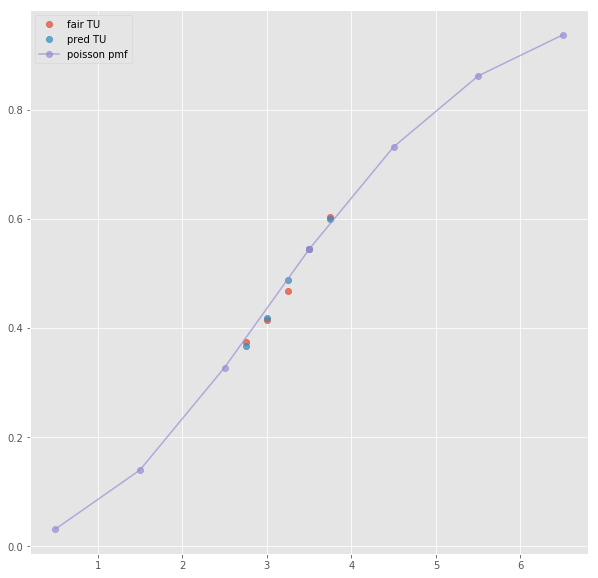

ML : 1.3 5.36 9.21
Error home:  0.0033784374724509236
Error draw:  0.015273223734570657
Error away:  0.011894825037892076

(173, 124)
(1, 21)
3.5 2.16 1.78 -1.5 1.95 2.0
TO fair:  2.2134831460674156 TU fair:  1.824074074074074
TO pred:  2.21348 TU fair:  1.82407
Error TO:  0.011278122700579596

Error TO:  6.42120008720326e-07

Error TO:  0.013545239274470267



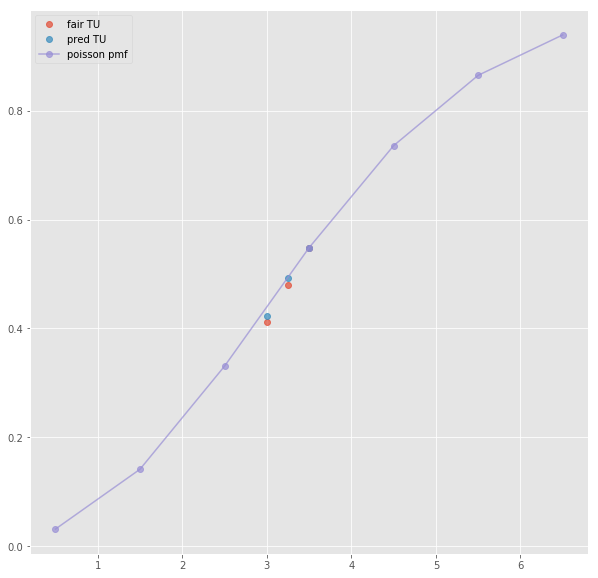

ML : 1.31 5.8 8.8
Error home:  0.0031685221147738085
Error draw:  0.0031910460540491292
Error away:  0.006359571595513799

(453, 124)
(1, 29)
3.5 2.11 1.82 -1.5 1.94 2.01
TO fair:  2.1593406593406588 TU fair:  1.862559241706161
TO pred:  2.15934 TU fair:  1.86256
Error TO:  0.023016953957849084

Error TO:  0.008450582259329154

Error TO:  1.4140594406519824e-07

Error TO:  0.006385655719989725

Error TO:  0.00615447395651364



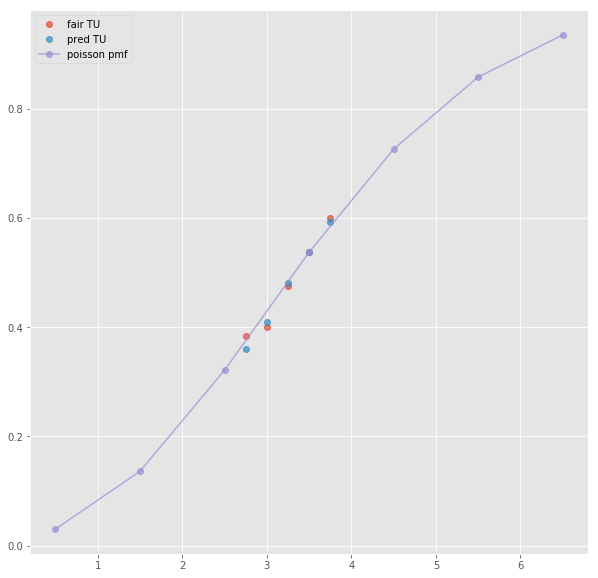

ML : 1.32 5.6 9.6
Error home:  0.0034232201964711217
Error draw:  0.011942804101651494
Error away:  0.01536607454407532

(115, 124)
(1, 48)
3.5 2.1 1.806 -1.5 1.925 1.99
TO fair:  2.1627906976744184 TU fair:  1.8599999999999999
TO pred:  2.16281 TU fair:  1.85998
Error TO:  0.0048909481623703455

Error TO:  0.004539544828012554

Error TO:  4.12645178393678e-06

Error TO:  0.0076013395623342195

Error TO:  0.005663719969723591

Error TO:  0.0041546853445972864

Error TO:  0.002326298421663542

Error TO:  0.01499156822047848

Error TO:  0.00869183257916939

Error TO:  0.0026270391165455487



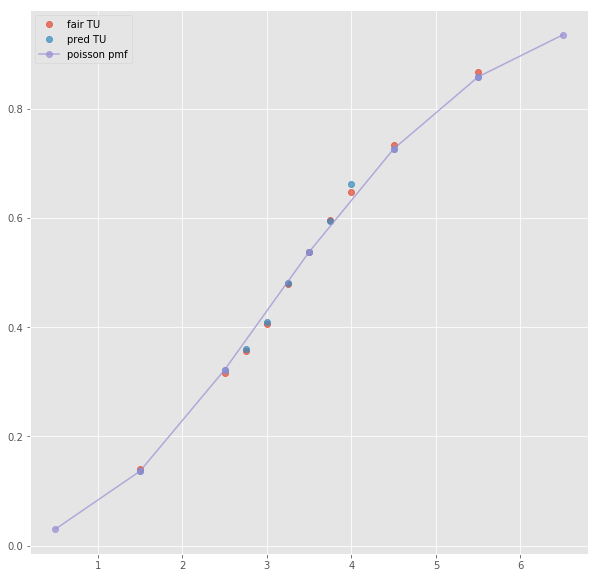

Error T1O:  0.005813870934363252
ML : 1.318 5.7 9.9
Error home:  0.008522261274107601
Error draw:  0.009555689769454645
Error away:  0.018077846703404468

(49, 124)
(1, 75)
3.5 2.1 1.7 -1.5 2.05 1.88
TO fair:  2.235294117647059 TU fair:  1.8095238095238095
TO pred:  2.23533 TU fair:  1.8095
Error TO:  0.019260591336839883

Error TO:  0.024573715979393285

Error TO:  0.009928700485622777

Error TO:  7.181325164029584e-06

Error TO:  0.012987158749274363

Error TO:  0.016802455837523156

Error TO:  0.021562930506877187

Error TO:  0.021942837152074457

Error TO:  0.024247267161759067

Error TO:  0.021889899032475624

Error TO:  0.008883534181978958

Error TO:  0.027951493519340176

Error TO:  0.0010466517076903603

Error TO:  0.0044319869079803564

Error TO:  0.011426569511236329

Error TO:  0.013190620387617341

Error TO:  0.016033862638654056



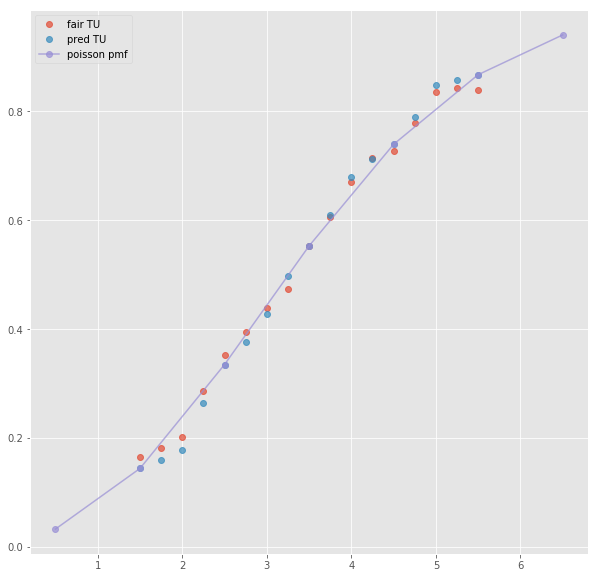

ML : 1.36 5.25 7.5
Error home:  0.005338352126611823
Error draw:  0.009516996609909706
Error away:  0.00417869710398075

(67, 124)
next positional indexers are out-of-bounds
(15, 124)
(1, 44)
2.5 2.07 1.813 -0.5 1.763 2.15
TO fair:  2.1417539988968555 TU fair:  1.8758454106280191
TO pred:  2.14173 TU fair:  1.87586
Error TO:  0.0011971092575719378

Error TO:  0.0008346536711332231

Error TO:  0.003947567865366208

Error TO:  0.003958296606923983

Error TO:  5.2318703429588e-06

Error TO:  0.002860893206398263

Error TO:  0.0003266282739504689

Error TO:  0.005572328145243222



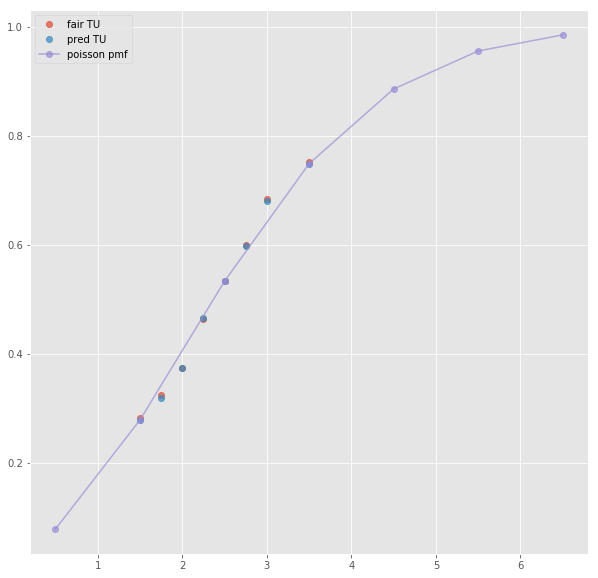

ML : 1.763 3.52 5.37
Error home:  0.0027689370883378084
Error draw:  0.028274824745913835
Error away:  0.025505810798297945

(36, 124)
(1, 21)
2.5 2.08 1.74 -0.5 1.7 2.16
TO fair:  2.195402298850575 TU fair:  1.8365384615384617
TO pred:  2.19546 TU fair:  1.8365
Error TO:  1.1971396660814815e-05

Error TO:  0.0036355277673603137



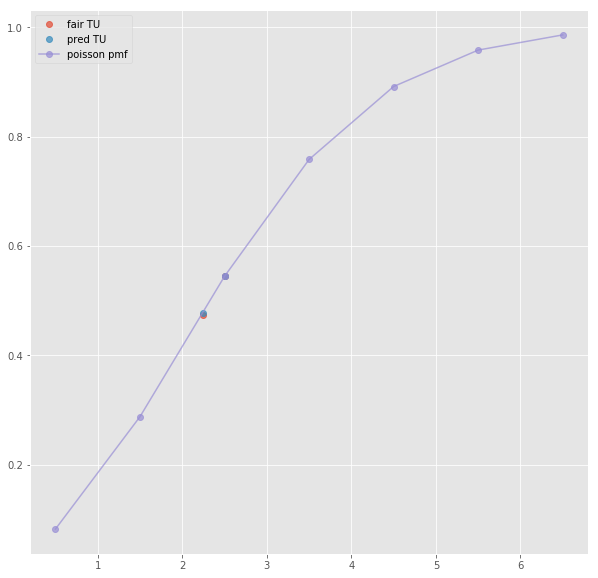

ML : 1.69 3.56 4.46
Error home:  0.020090663789100405
Error draw:  0.01061510595731116
Error away:  0.009475294154703884

(75, 124)
(1, 19)
2.5 2.08 1.82 -0.5 1.76 2.19
TO fair:  2.142857142857143 TU fair:  1.8749999999999998
TO pred:  2.14287 TU fair:  1.87499
Error TO:  2.799983200074685e-06

Error TO:  0.014146467855666756



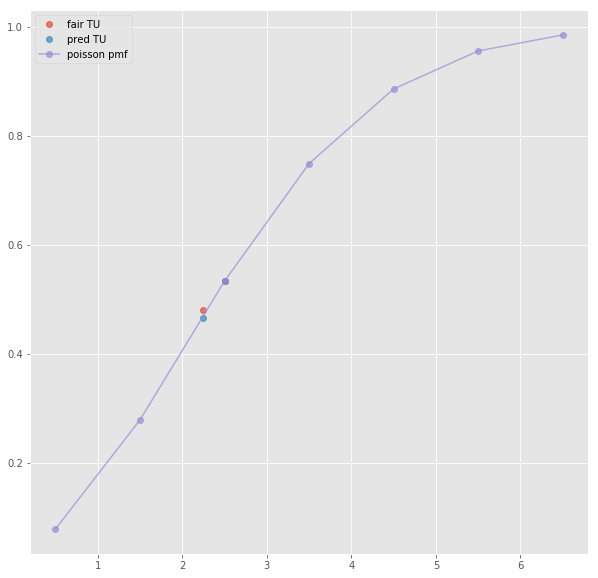

ML : 1.72 3.6 5.5
Error home:  0.00407034391276706
Error draw:  0.02240125557690703
Error away:  0.02647165913685051

(108, 124)
(1, 21)
2.5 2.08 1.82 -0.5 1.74 2.21
TO fair:  2.142857142857143 TU fair:  1.8749999999999998
TO pred:  2.14287 TU fair:  1.87499
Error TO:  2.799983200074685e-06

Error TO:  0.0013259550351537586



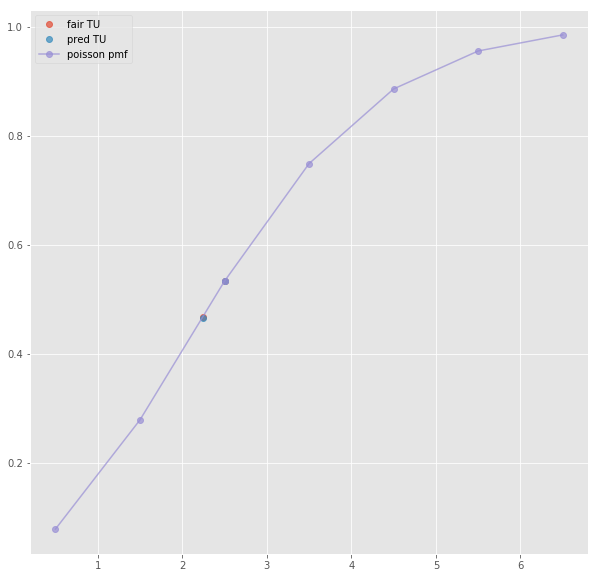

ML : 1.73 3.45 5.5
Error home:  0.008850161672056212
Error draw:  0.03290014727240767
Error away:  0.02405014927257665

(16, 124)
(1, 46)
2.5 2.07 1.813 -0.5 1.763 2.15
TO fair:  2.1417539988968555 TU fair:  1.8758454106280191
TO pred:  2.14173 TU fair:  1.87586
Error TO:  0.0011971092575719378

Error TO:  0.0008346536711332231

Error TO:  0.003947567865366208

Error TO:  0.003958296606923983

Error TO:  5.2318703429588e-06

Error TO:  0.002860893206398263

Error TO:  0.0003266282739504689

Error TO:  0.005572328145243222



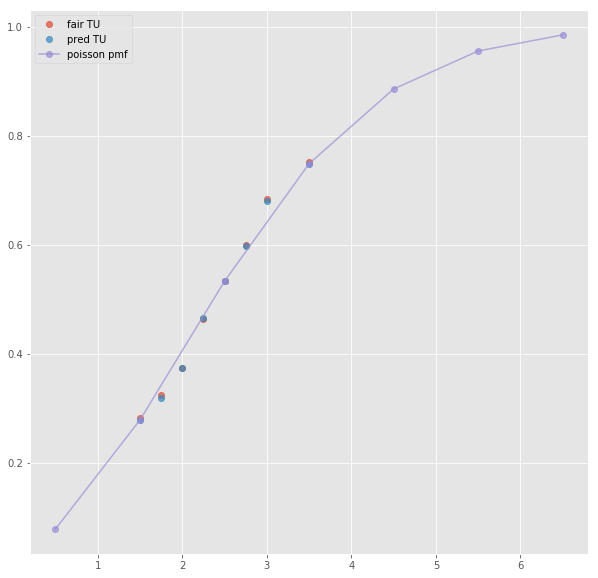

Error T1O:  0.001858066893087429
ML : 1.763 3.52 5.37
Error home:  0.0027689370883378084
Error draw:  0.028274824745913835
Error away:  0.025505810798297945

(19, 124)
(1, 64)
2.5 2.05 1.75 -0.5 1.725 2.075
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17137 TU fair:  1.8537
Error TO:  0.00553519951934639

Error TO:  0.013601482666040221

Error TO:  0.016165847866408345

Error TO:  0.018186318005699253

Error TO:  1.2422426491298655e-05

Error TO:  0.0026598290823284243

Error TO:  0.0020564730675987075

Error TO:  0.010867722361024845

Error TO:  0.01589457400388683

Error TO:  0.01993212859652785

Error TO:  0.016659109888788493

Error TO:  0.022780135728210887

Error TO:  0.018742052420808952

Error TO:  0.03452538387395965



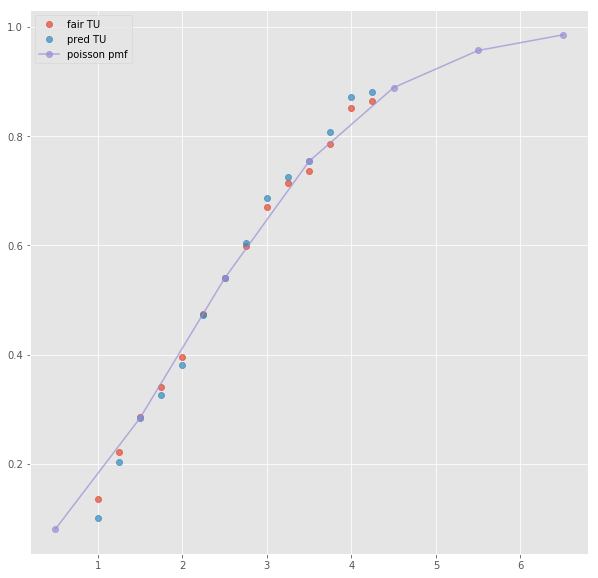

ML : 1.75 3.4 5.0
Error home:  0.009791518905731267
Error draw:  0.028400576148375545
Error away:  0.018609212333200648

(10, 124)
(1, 32)
2.5 2.09 1.78 -0.5 1.76 2.12
TO fair:  2.1741573033707864 TU fair:  1.8516746411483256
TO pred:  2.1742 TU fair:  1.85164
Error TO:  0.004900810348438034

Error TO:  0.00128588200077695

Error TO:  9.032399454544926e-06

Error TO:  0.0001061469843277596

Error TO:  0.0019905213328753613



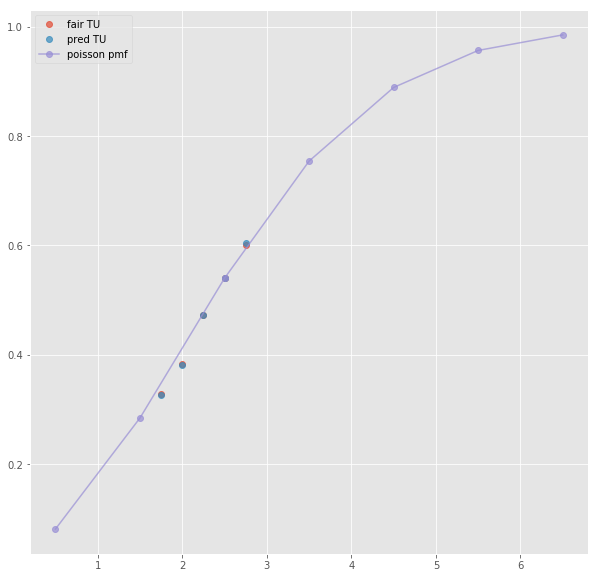

Error T1O:  0.009468828441784094
ML : 1.77 3.57 5.13
Error home:  0.003151451699422547
Error draw:  0.021657067223081194
Error away:  0.018505576696087295

(111, 124)
(1, 38)
3.5 2.59 1.534 -1.5 1.598 2.46
TO fair:  2.6883963494132983 TU fair:  1.5922779922779924
TO pred:  2.68835 TU fair:  1.5923
Error TO:  0.007028466286223112

Error TO:  0.0049277234842400874

Error TO:  6.413057511811537e-06

Error TO:  0.011680132652544861

Error TO:  0.007977971061856604

Error TO:  0.011116909552784104

Error TO:  0.002294815250758586



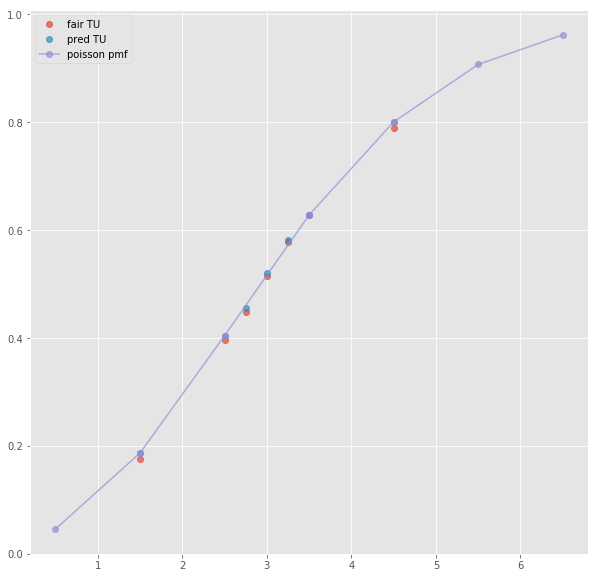

ML : 1.168 7.71 17.99
Error home:  0.0023340615002122034
Error draw:  0.0033941286879403954
Error away:  0.0010600568489728193

(116, 124)
(1, 23)
next list index out of range
(222, 124)
(1, 18)
next list index out of range
(616, 124)
(1, 23)
next list index out of range
(97, 124)
(1, 40)
3.5 2.57 1.54 -1.5 1.602 2.45
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66883 TU fair:  1.59922
Error TO:  0.00717408229111538

Error TO:  0.004714886510942207

Error TO:  1.6410045011738816e-07

Error TO:  0.010955493553788553

Error TO:  0.007898823554177481

Error TO:  0.01005841889007042

Error TO:  0.0016323533778200283



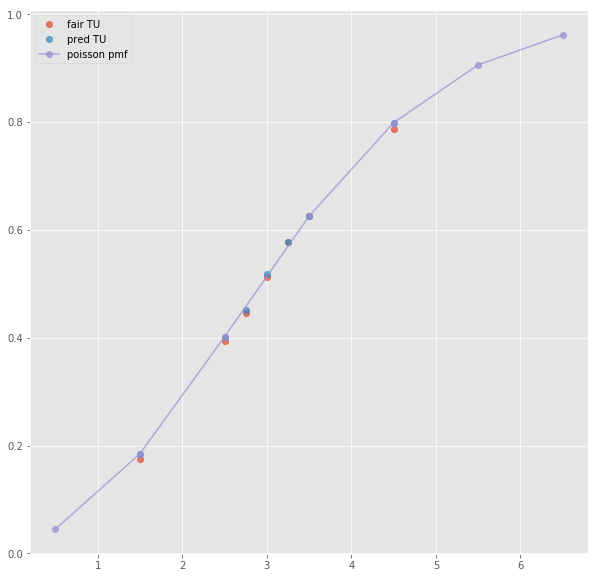

Error T1O:  0.00041529881738711083
ML : 1.168 7.7 17.94
Error home:  0.003721972772909088
Error draw:  0.0038298386199751566
Error away:  0.00010785907186708354

(226, 124)
(1, 69)
3.5 2.375 1.55 -1.5 1.6 2.3
TO fair:  2.5322580645161286 TU fair:  1.6526315789473682
TO pred:  2.53223 TU fair:  1.65264
Error TO:  0.007666862209227188

Error TO:  0.029006754944730706

Error TO:  0.024795637193709807

Error TO:  4.37669664582474e-06

Error TO:  0.01271328467630542

Error TO:  0.012584944836804834

Error TO:  0.02968861461612793

Error TO:  0.019404795776268524

Error TO:  0.0065003950010796285

Error TO:  0.028675140655190057

Error TO:  0.009425469507809758

Error TO:  0.015521898367042652

Error TO:  0.005368107045423232

Error TO:  0.025281399823262607

Error TO:  0.010606585186080764

Error TO:  0.018416283846404438

Error TO:  0.029441214477757285



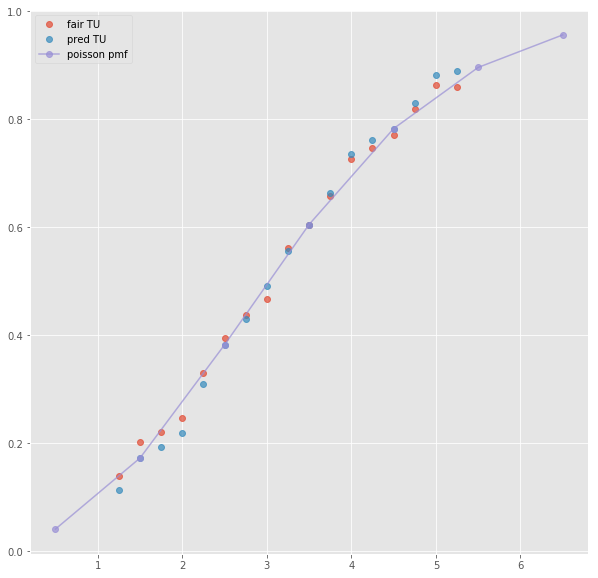

ML : 1.166 7.0 15.0
Error home:  0.0004423325234090836
Error draw:  8.225423105207019e-05
Error away:  0.0005246377035088776

(55, 124)
next positional indexers are out-of-bounds
(12, 124)
(1, 40)
2.5 2.28 1.671 -0.5 1.769 2.15
TO fair:  2.364452423698384 TU fair:  1.7328947368421053
TO pred:  2.36448 TU fair:  1.73288
Error TO:  0.0010525366530478864

Error TO:  0.012059679582127059

Error TO:  0.0007324649803261418

Error TO:  4.932530687284942e-06

Error TO:  0.0168760321309237

Error TO:  0.004984673451486232

Error TO:  0.01530227603708223



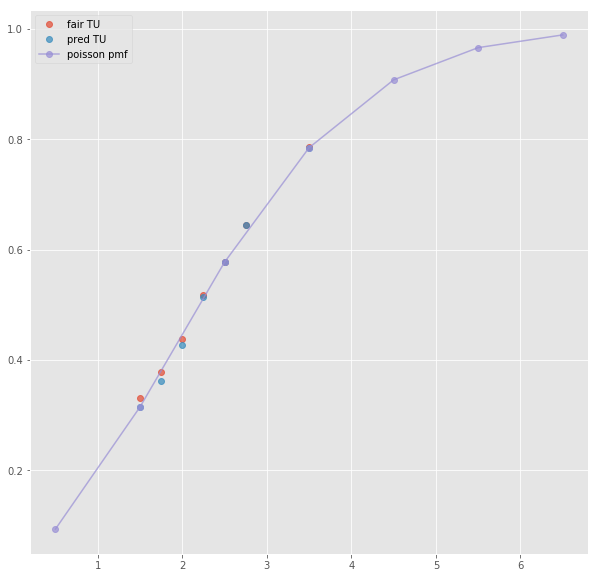

ML : 1.769 3.62 5.12
Error home:  0.00340131741970362
Error draw:  0.011352103210707176
Error away:  0.007950478005545936

(20, 124)
(1, 19)
next list index out of range
(61, 124)
(1, 19)
next list index out of range
(44, 124)
(1, 19)
next list index out of range
(12, 124)
(1, 42)
2.5 2.28 1.671 -0.5 1.769 2.15
TO fair:  2.364452423698384 TU fair:  1.7328947368421053
TO pred:  2.36448 TU fair:  1.73288
Error TO:  0.0010525366530478864

Error TO:  0.012059679582127059

Error TO:  0.0007324649803261418

Error TO:  4.932530687284942e-06

Error TO:  0.0168760321309237

Error TO:  0.004984673451486232

Error TO:  0.01530227603708223



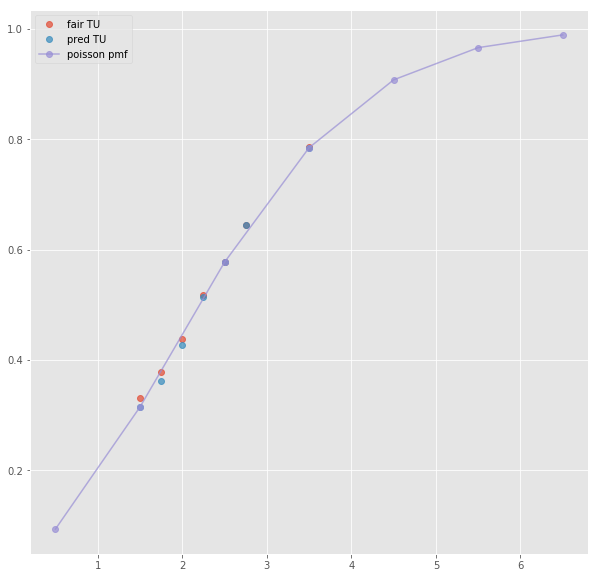

Error T1O:  0.009623139128179303
ML : 1.769 3.62 5.12
Error home:  0.00340131741970362
Error draw:  0.011352103210707176
Error away:  0.007950478005545936

(5, 124)
next positional indexers are out-of-bounds
(52, 124)
(1, 41)
2.5 2.1 1.8 -0.5 2.14 1.787
TO fair:  2.1666666666666665 TU fair:  1.857142857142857
TO pred:  2.16668 TU fair:  1.85714
Error TO:  0.0030117333151378767

Error TO:  0.0009583465870626195

Error TO:  0.006082296367739853

Error TO:  2.840219208155581e-06

Error TO:  0.0028292890436415474

Error TO:  0.0009065990271941438

Error TO:  0.0021856523924986826



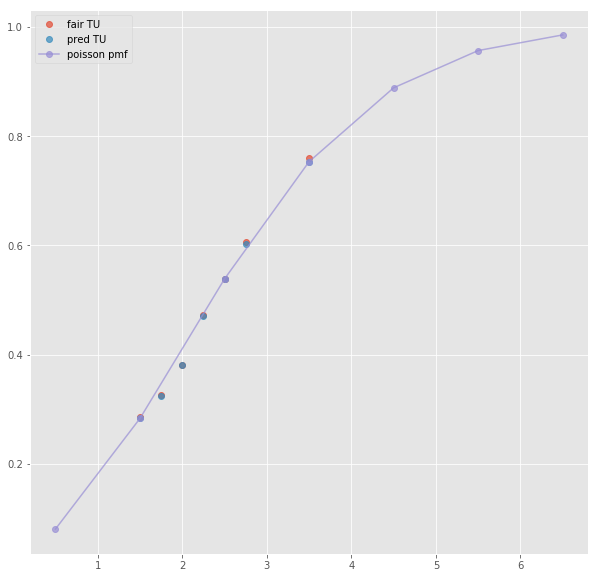

ML : 2.14 3.46 3.65
Error home:  0.0014898143192120794
Error draw:  0.017267616762245308
Error away:  0.015777460007542377

(38, 124)
(1, 23)
2.5 2.08 1.74 -0.5 2.12 1.73
TO fair:  2.195402298850575 TU fair:  1.8365384615384617
TO pred:  2.19546 TU fair:  1.8365
Error TO:  0.0020655843615805525

Error TO:  1.1971396660814815e-05

Error TO:  0.0010177267202400309



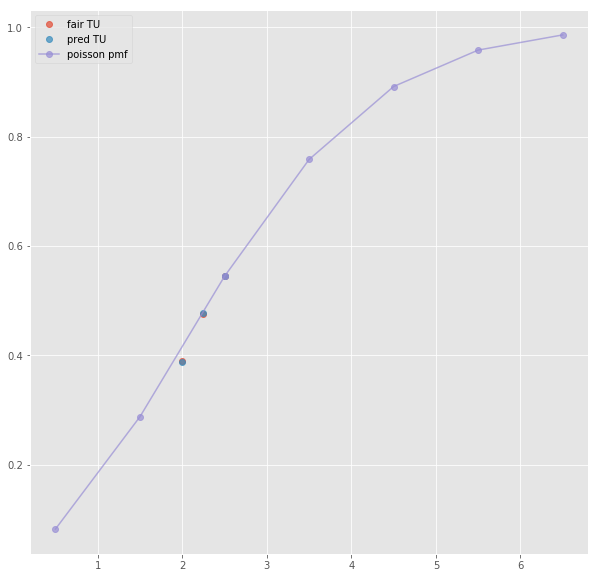

ML : 2.12 3.26 3.51
Error home:  0.005747707458811646
Error draw:  0.02316974171084274
Error away:  0.0174219601849806

(101, 124)
(1, 19)
2.5 2.07 1.83 -0.5 2.11 1.82
TO fair:  2.1311475409836067 TU fair:  1.884057971014493
TO pred:  2.1312 TU fair:  1.88402
Error TO:  1.1550011550010009e-05

Error TO:  0.0015231602094893937



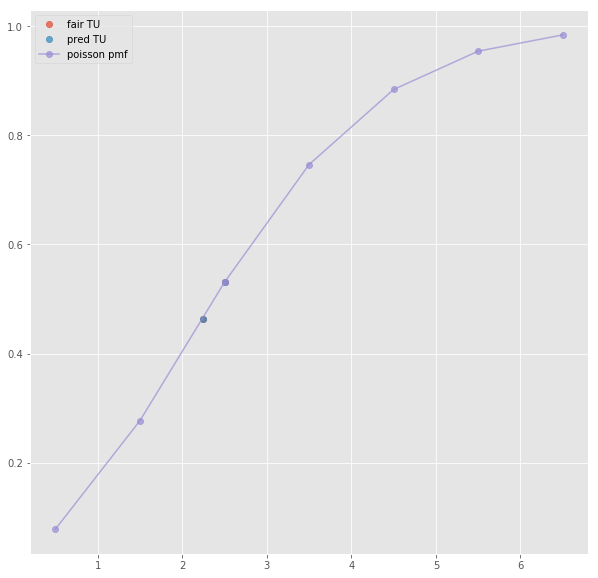

ML : 2.16 3.25 3.6
Error home:  0.02152838014916808
Error draw:  0.032946933280079194
Error away:  0.011418828357591171

(185, 124)
(1, 23)
2.5 2.11 1.8 -0.5 2.13 1.8
TO fair:  2.172222222222222 TU fair:  1.8530805687203793
TO pred:  2.1722 TU fair:  1.8531
Error TO:  0.001786597279011537

Error TO:  4.709593512564059e-06

Error TO:  0.011800971662081161



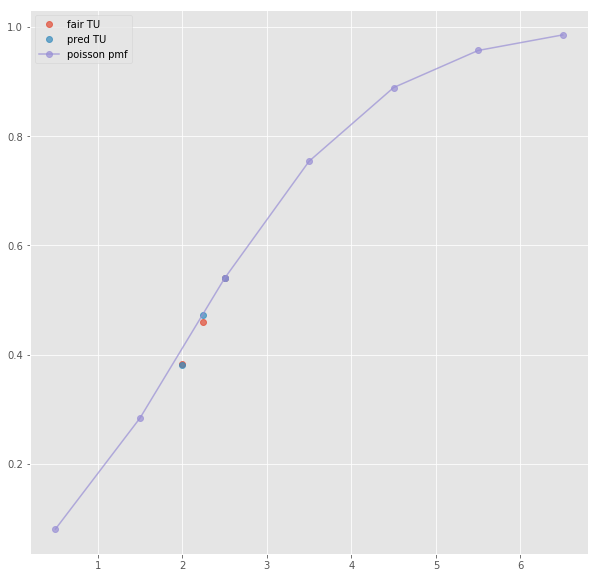

ML : 2.12 3.35 3.55
Error home:  0.009603962623273565
Error draw:  0.020621884451123396
Error away:  0.011018087656339437

(40, 124)
(1, 43)
2.5 2.1 1.8 -0.5 2.14 1.787
TO fair:  2.1666666666666665 TU fair:  1.857142857142857
TO pred:  2.16668 TU fair:  1.85714
Error TO:  0.0030117333151378767

Error TO:  0.0009583465870626195

Error TO:  0.006082296367739853

Error TO:  2.840219208155581e-06

Error TO:  0.0028292890436415474

Error TO:  0.0009065990271941438

Error TO:  0.0021856523924986826



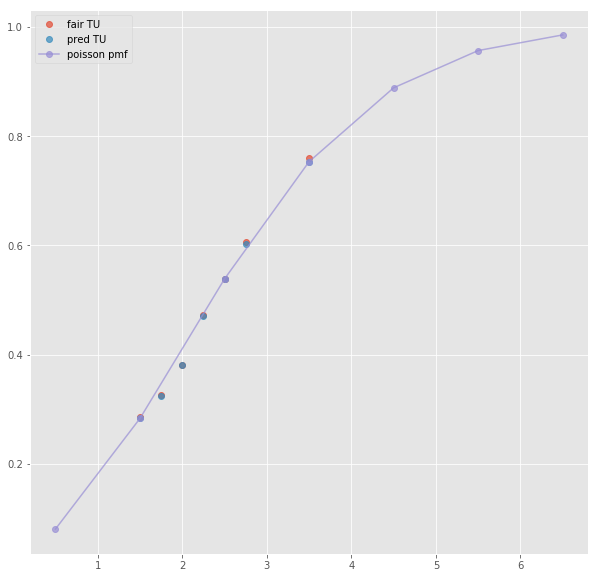

Error T1O:  0.00033697844112839936
ML : 2.14 3.46 3.65
Error home:  0.0014898143192120794
Error draw:  0.017267616762245308
Error away:  0.015777460007542377

(179, 124)
(1, 61)
2.5 2.05 1.75 -0.5 2.075 1.725
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17137 TU fair:  1.8537
Error TO:  0.00553519951934639

Error TO:  0.013601482666040221

Error TO:  0.016165847866408345

Error TO:  0.018186318005699253

Error TO:  1.2422426491298655e-05

Error TO:  0.019544129112695985

Error TO:  0.0020564730675987075

Error TO:  0.010867722361024845

Error TO:  0.01589457400388683

Error TO:  0.015531073378818011

Error TO:  0.016659109888788493

Error TO:  0.0176332615127954

Error TO:  0.018742052420808952

Error TO:  0.03452538387395965



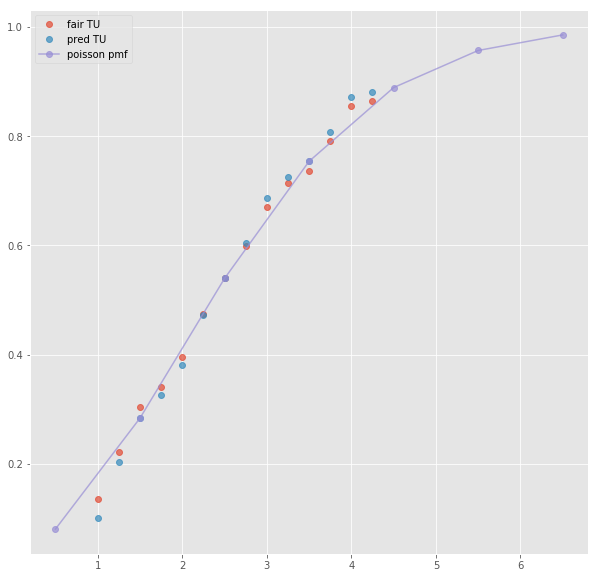

ML : 2.05 3.4 3.8
Error home:  0.01282211796275845
Error draw:  0.017817661862023104
Error away:  0.03063962382440022

(45, 124)
next positional indexers are out-of-bounds
(210, 124)
next positional indexers are out-of-bounds
(295, 124)
next positional indexers are out-of-bounds
(255, 124)
next positional indexers are out-of-bounds
(610, 124)
next positional indexers are out-of-bounds
(183, 124)
(1, 48)
3.5 2.28 1.6840000000000002 1.5 2.18 1.763
TO fair:  2.3539192399049877 TU fair:  1.7385964912280703
TO pred:  2.35395 TU fair:  1.73858
Error TO:  0.0002623832809719451

Error TO:  0.0003176258427430856

Error TO:  5.551353459698483e-06

Error TO:  0.0002598608928140733

Error TO:  0.0010001137659974013

Error TO:  0.0031669662826231404

Error TO:  0.00024745319095303975

Error TO:  0.0032089153628870187

Error TO:  0.0014177474332885964



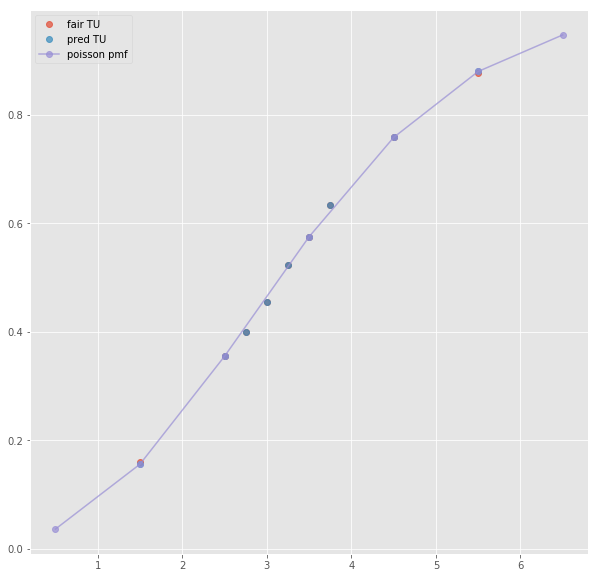

Error T1O:  0.0046765145202044
ML : 11.13 6.53 1.263
Error home:  0.0017787938059640046
Error draw:  0.0016098491950415073
Error away:  0.0033885984919037604

(77, 124)
next positional indexers are out-of-bounds
(119, 124)
(1, 45)
3.5 2.43 1.625 -1.5 2.05 1.877
TO fair:  2.4953846153846153 TU fair:  1.668724279835391
TO pred:  2.49535 TU fair:  1.66874
Error TO:  0.00236718268675451

Error TO:  0.0022274386194086615

Error TO:  5.559045125946849e-06

Error TO:  0.005085031659152944

Error TO:  0.002602082528384453

Error TO:  0.002272751429547082

Error TO:  0.03650153964598912

Error TO:  0.00019496339930269446



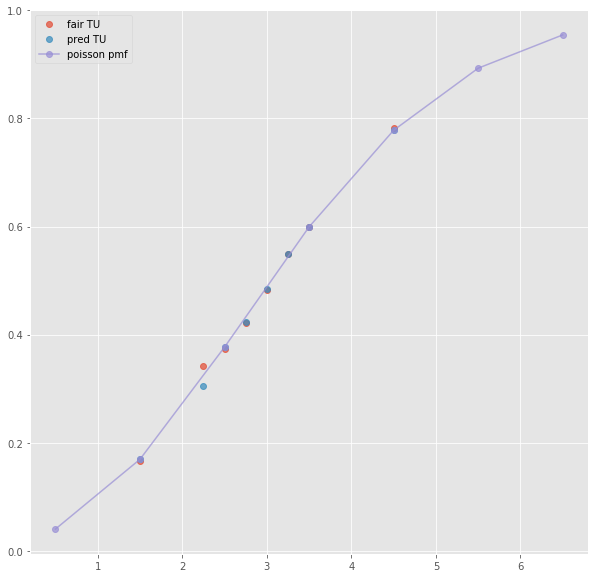

ML : 1.389 5.26 8.29
Error home:  0.008204257296091089
Error draw:  0.011147399613314901
Error away:  0.002943160160466529

(205, 124)
(1, 29)
3.5 2.36 1.57 -1.5 2.02 1.85
TO fair:  2.5031847133757963 TU fair:  1.6652542372881358
TO pred:  2.50319 TU fair:  1.66525
Error TO:  0.012516383424063804

Error TO:  0.014839867018452413

Error TO:  8.437071446487643e-07

Error TO:  0.03800018382950032

Error TO:  0.002453284067150119



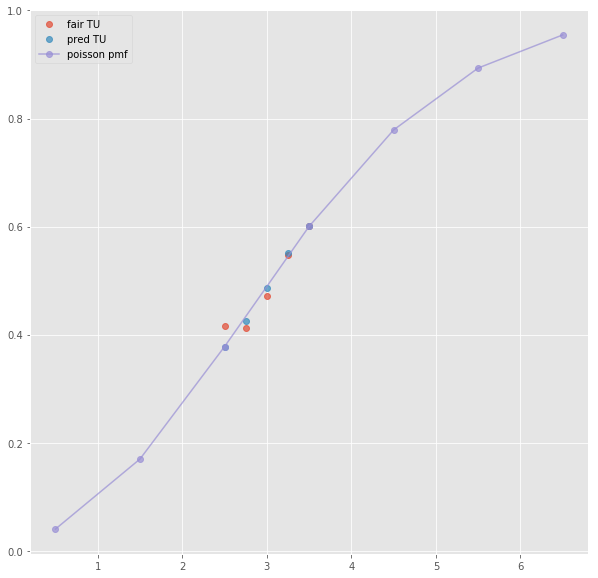

ML : 1.34 5.16 7.76
Error home:  0.00885010763482963
Error draw:  0.007942226888659615
Error away:  0.0009079935034959075

(115, 124)
(1, 23)
2.5 1.65 2.33 -1.5 2.07 1.88
TO fair:  1.7081545064377683 TU fair:  2.4121212121212126
TO pred:  1.70818 TU fair:  2.41207
Error TO:  0.04581591419838493

Error TO:  0.05465282454473608

Error TO:  8.737148962878472e-06

Error TO:  0.042224919301794395



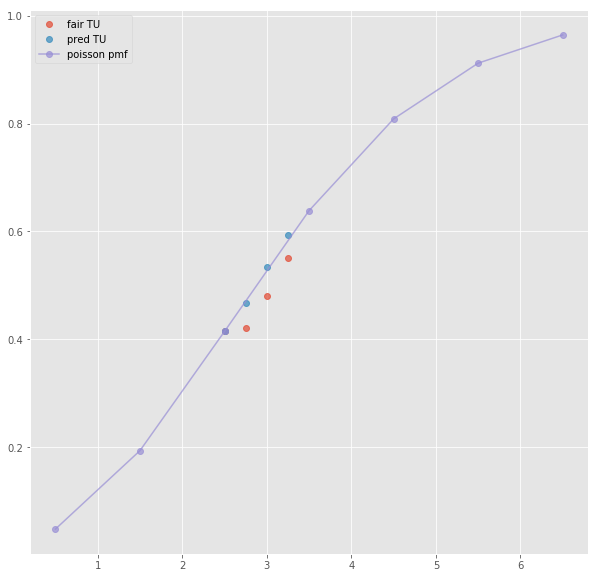

ML : 1.37 5.2 7.8
Error home:  0.016770029640833073
Error draw:  0.0066005208483935485
Error away:  0.010169523293096061

(329, 124)
(1, 29)
3.5 2.38 1.64 -1.5 2.06 1.89
TO fair:  2.451219512195122 TU fair:  1.6890756302521006
TO pred:  2.45126 TU fair:  1.68906
Error TO:  0.0023830027173289414

Error TO:  0.0012225798910017183

Error TO:  6.738335768308179e-06

Error TO:  0.016149978140327925

Error TO:  0.007084182352040003



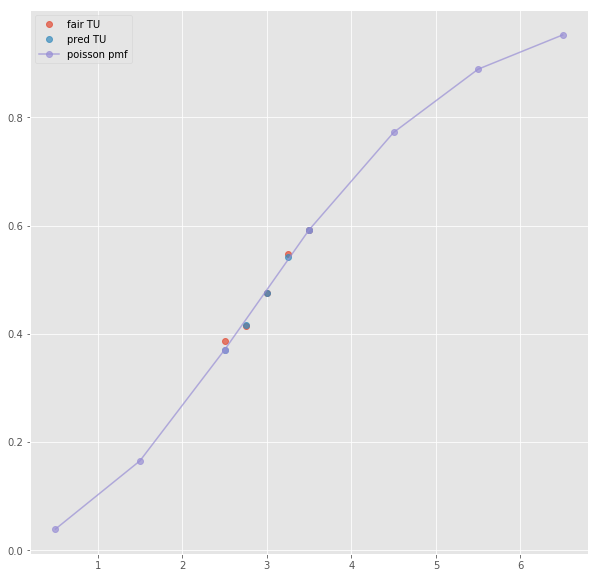

ML : 1.39 5.2 7.8
Error home:  0.014199303321947632
Error draw:  0.01222991163689402
Error away:  0.001969484651085915

(126, 124)
(1, 47)
3.5 2.43 1.625 -1.5 2.05 1.877
TO fair:  2.4953846153846153 TU fair:  1.668724279835391
TO pred:  2.49535 TU fair:  1.66874
Error TO:  0.00236718268675451

Error TO:  0.0022274386194086615

Error TO:  5.559045125946849e-06

Error TO:  0.005085031659152944

Error TO:  0.002602082528384453

Error TO:  0.002272751429547082

Error TO:  0.03650153964598912

Error TO:  0.00019496339930269446



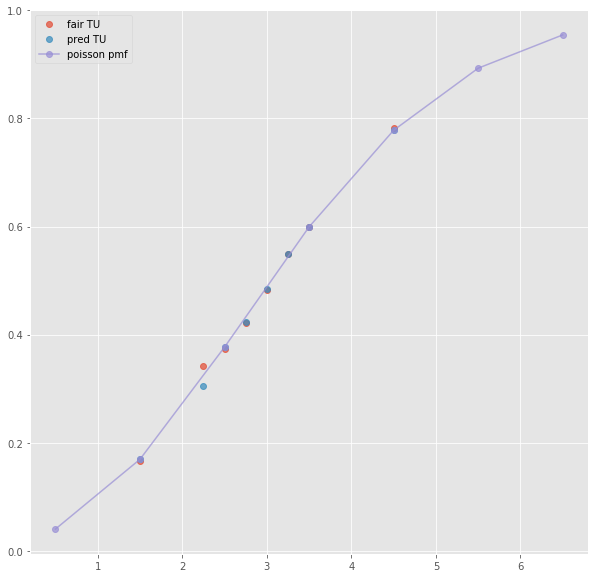

Error T1O:  0.004997793730995181
ML : 1.389 5.26 8.29
Error home:  0.008204257296091089
Error draw:  0.011147399613314901
Error away:  0.002943160160466529

(31, 124)
(1, 71)
3.5 2.3 1.6 -1.5 1.95 1.98
TO fair:  2.4375 TU fair:  1.695652173913044
TO pred:  2.43748 TU fair:  1.69566
Error TO:  0.005442294679857351

Error TO:  0.02130526186775583

Error TO:  0.060026192884613194

Error TO:  3.3662340635509658e-06

Error TO:  0.017821873149655165

Error TO:  0.006971434891142936

Error TO:  0.017122596355001685

Error TO:  0.007194661630345656

Error TO:  0.0008836608170404991

Error TO:  0.0266666360153609

Error TO:  0.006171075586141439

Error TO:  0.011750232278970374

Error TO:  0.010227020450242985

Error TO:  0.02787108705389285

Error TO:  0.02083606135472421

Error TO:  0.01695910073365836



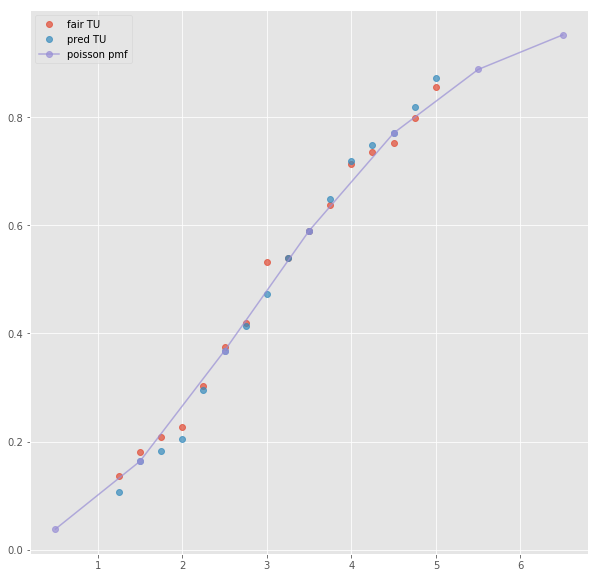

ML : 1.3 5.5 9.5
Error home:  0.00030014137918010775
Error draw:  0.008045220004298553
Error away:  0.007745167409787854

(38, 124)
next positional indexers are out-of-bounds
(32, 124)
(1, 46)
2.5 1.787 2.08 -0.5 1.568 2.5
TO fair:  1.8591346153846153 TU fair:  2.1639619473978735
TO pred:  1.85911 TU fair:  2.164
Error TO:  0.004467944906060561

Error TO:  0.01999310612163807

Error TO:  0.009108541482378163

Error TO:  0.010571300376745862

Error TO:  0.017161742706419902

Error TO:  7.121815229105266e-06

Error TO:  0.01326804548428695

Error TO:  0.004560889585444428

Error TO:  0.010438944079536105

Error TO:  0.0708991335944793



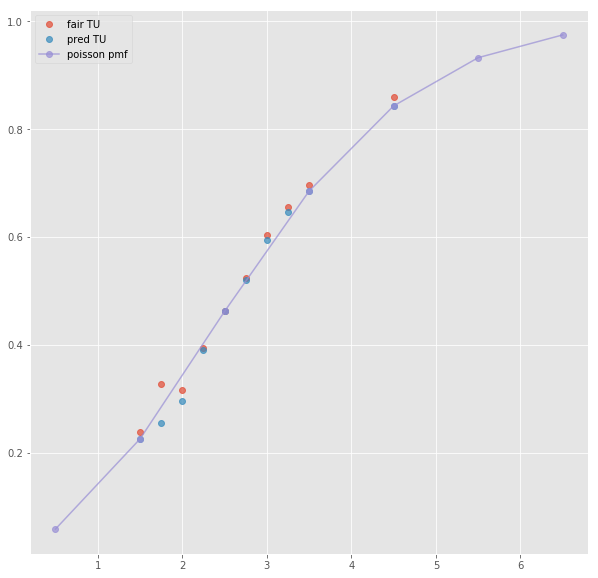

ML : 1.568 4.29 5.72
Error home:  0.004661585773575783
Error draw:  0.00721499717366253
Error away:  0.0025535902946321465

(58, 124)
(1, 21)
next list index out of range
(87, 124)
(1, 23)
2.5 1.8 2.11 -0.5 1.63 2.4
TO fair:  1.8530805687203793 TU fair:  2.172222222222222
TO pred:  1.85307 TU fair:  2.17223
Error TO:  0.007880901335278634

Error TO:  3.077770838855187e-06

Error TO:  0.009757959008987682



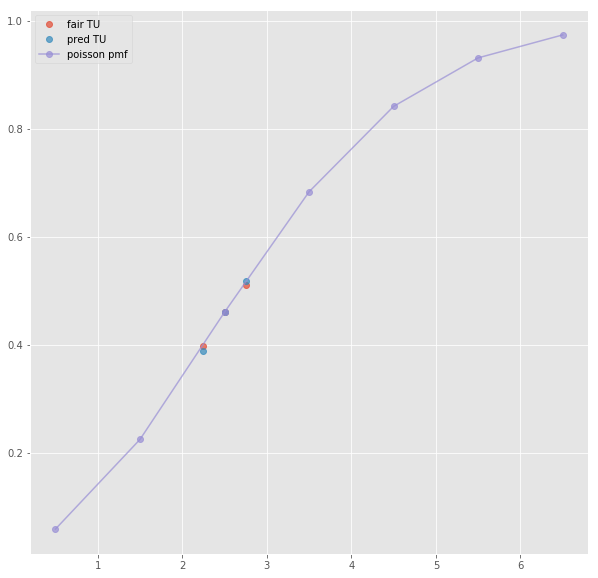

ML : 1.61 4.1 5.7
Error home:  0.00141885896647731
Error draw:  0.013818515965589362
Error away:  0.015237414290495938

(142, 124)
(1, 23)
2.5 1.78 2.13 -0.5 1.65 2.36
TO fair:  1.8356807511737092 TU fair:  2.1966292134831464
TO pred:  1.83567 TU fair:  2.19665
Error TO:  0.005496741429030727

Error TO:  3.190539418218563e-06

Error TO:  0.01502728843595924



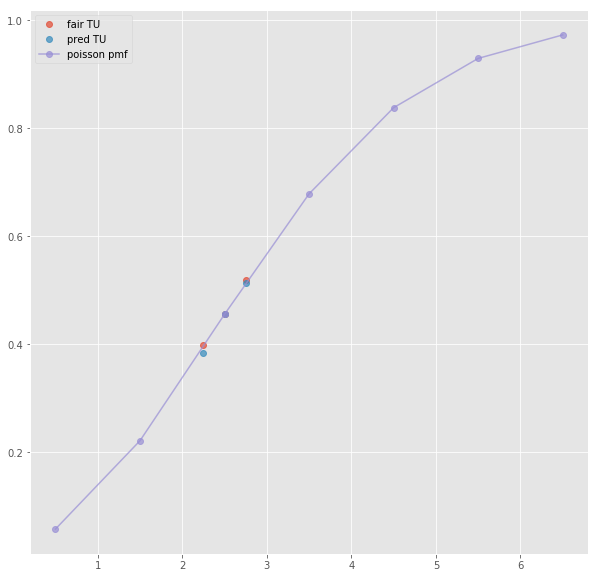

ML : 1.59 4.2 5.6
Error home:  0.012977664151432977
Error draw:  0.00617814752649401
Error away:  0.01915591382771928

(30, 124)
(1, 50)
2.5 1.8 2.07 -0.5 1.568 2.5
TO fair:  1.8695652173913047 TU fair:  2.1500000000000004
TO pred:  1.86955 TU fair:  2.15002
Error TO:  0.004267089641151578

Error TO:  0.01686734069334761

Error TO:  0.008852756556453734

Error TO:  0.010520088393957294

Error TO:  0.016147611942423507

Error TO:  4.353740142737372e-06

Error TO:  0.01234678289987845

Error TO:  0.0030442062067661535

Error TO:  0.01056550350573432

Error TO:  0.06835682536817445



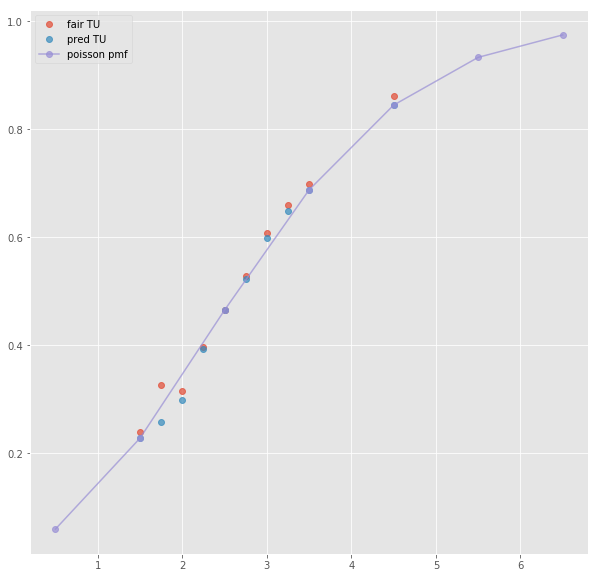

Error T1O:  0.0034839558375269197
ML : 1.568 4.3 5.73
Error home:  0.004170832027805993
Error draw:  0.006374648457754178
Error away:  0.0022035964434716226

(22, 124)
(1, 64)
2.5 2.0 1.85 -0.5 1.6 2.3
TO fair:  2.0810810810810807 TU fair:  1.9249999999999998
TO pred:  2.0811 TU fair:  1.92499
Error TO:  0.0022032333017240058

Error TO:  0.003754043380809313

Error TO:  0.015333236757437807

Error TO:  0.010599010384249818

Error TO:  0.01780159452440079

Error TO:  4.368319201975002e-06

Error TO:  0.005486126383731471

Error TO:  0.0035126622736152413

Error TO:  0.00819571818382564

Error TO:  0.007550645479169837

Error TO:  0.018715818524131123

Error TO:  0.01712737482786575

Error TO:  0.020039380241173133

Error TO:  0.01938029202298075



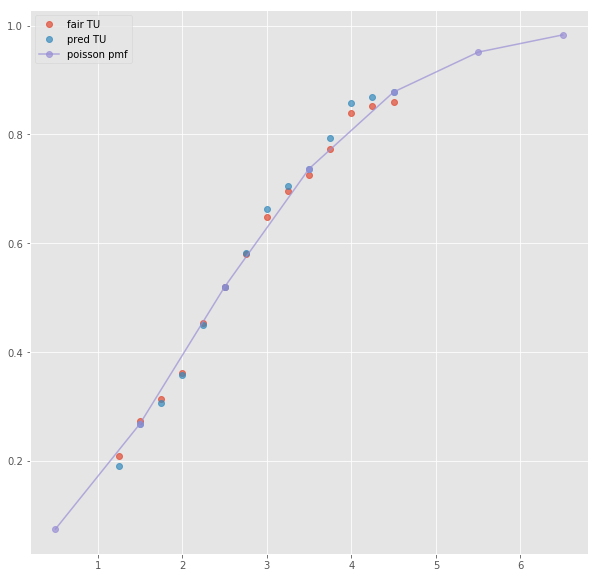

ML : 1.57 4.0 5.75
Error home:  0.010674186286604215
Error draw:  0.002869508820077221
Error away:  0.013543676065441795

(3, 124)
(1, 32)
2.5 2.01 1.84 -0.5 1.66 2.28
TO fair:  2.092391304347826 TU fair:  1.9154228855721396
TO pred:  2.09244 TU fair:  1.91538
Error TO:  0.0033751917531864017

Error TO:  0.002673863097513496

Error TO:  0.008765834310606069

Error TO:  1.1122291330989409e-05

Error TO:  0.000379019244301948



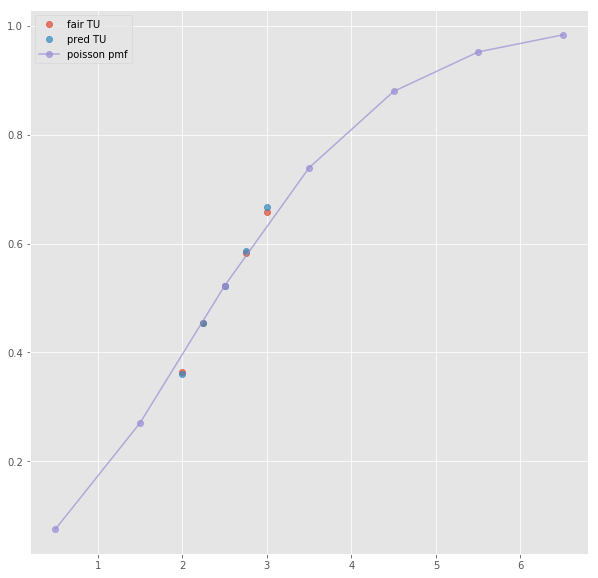

Error T1O:  0.004936945357944977
ML : 1.67 3.84 5.51
Error home:  0.00329667385359933
Error draw:  0.01400981019168765
Error away:  0.010713282477136543

(245, 124)
(1, 43)
2.5 2.32 1.662 -0.5 2.76 1.505
TO fair:  2.3959085439229844 TU fair:  1.7163793103448277
TO pred:  2.39589 TU fair:  1.71639
Error TO:  0.00539346685287162

Error TO:  0.0024846079825071588

Error TO:  0.06879175682636901

Error TO:  0.017746105324376232

Error TO:  3.230461010916841e-06

Error TO:  0.002554870475157567

Error TO:  0.0009896229325983552

Error TO:  0.0027596316360025686



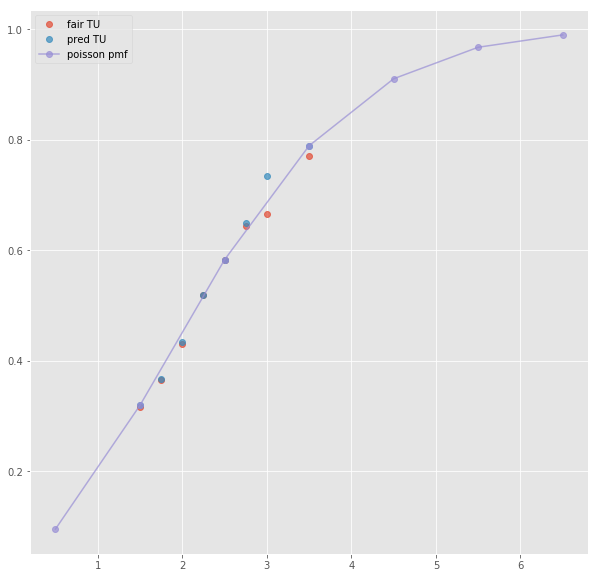

ML : 2.76 3.1 2.91
Error home:  0.0006235620306561662
Error draw:  0.03362991124982129
Error away:  0.03300607499397207

(198, 124)
(1, 27)
2.5 2.25 1.64 -0.5 2.66 1.47
TO fair:  2.371951219512195 TU fair:  1.7288888888888885
TO pred:  2.37196 TU fair:  1.72889
Error TO:  0.015912302651820143

Error TO:  0.005889969393293004

Error TO:  1.560650047249812e-06

Error TO:  0.003562396462244266



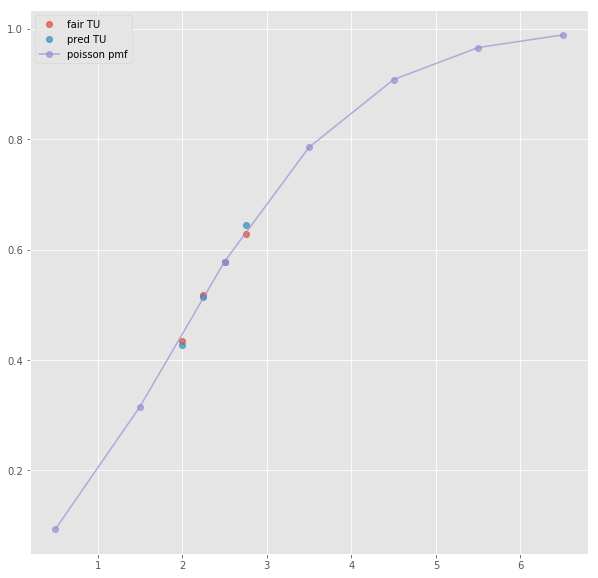

ML : 2.74 2.9 2.89
Error home:  0.010249050550323435
Error draw:  0.047703002992753485
Error away:  0.03745384594269768

(230, 124)
(1, 25)
next list index out of range
(500, 124)
(1, 27)
2.5 2.31 1.68 -0.5 2.75 1.52
TO fair:  2.3750000000000004 TU fair:  1.7272727272727273
TO pred:  2.37499 TU fair:  1.72728
Error TO:  0.0012748634888933297

Error TO:  0.001845752496305919

Error TO:  1.7728606503397693e-06

Error TO:  0.00506024473018124



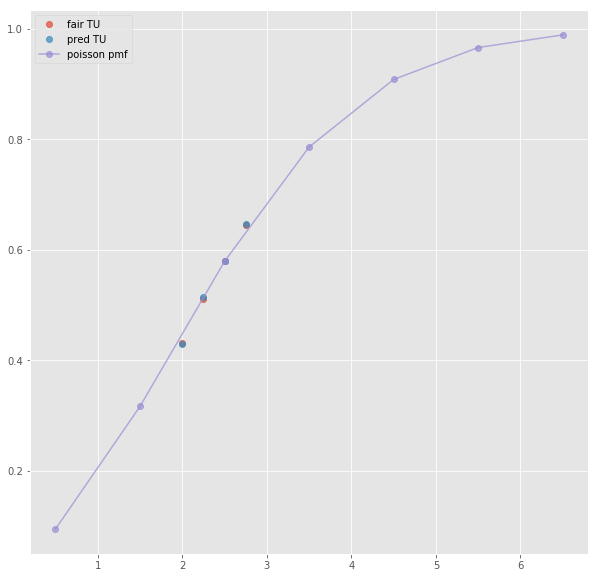

ML : 2.72 2.99 2.96
Error home:  0.002425947977012066
Error draw:  0.04256425648471496
Error away:  0.040138481753374256

(91, 124)
(1, 45)
2.5 2.32 1.662 -0.5 2.77 1.5
TO fair:  2.3959085439229844 TU fair:  1.7163793103448277
TO pred:  2.39589 TU fair:  1.71639
Error TO:  0.00539346685287162

Error TO:  0.0024846079825071588

Error TO:  0.06879175682636901

Error TO:  0.017746105324376232

Error TO:  3.230461010916841e-06

Error TO:  0.002554870475157567

Error TO:  0.0009896229325983552

Error TO:  0.0027596316360025686



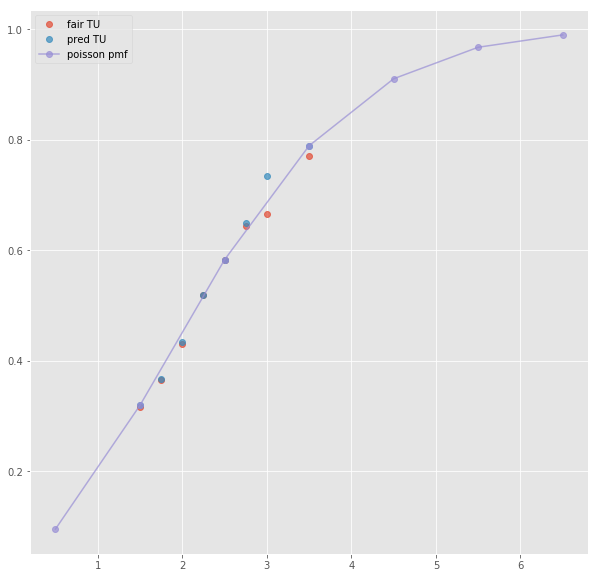

Error T1O:  0.027970047248503827
ML : 2.77 3.1 2.9
Error home:  0.00025782900200027603
Error draw:  0.033686247121548996
Error away:  0.0334287731371295

(188, 124)
(1, 67)
2.5 2.15 1.675 -0.5 2.375 1.55
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.014294185262617887

Error TO:  0.0019828906081326148

Error TO:  0.015336591097173724

Error TO:  0.02012281955881773

Error TO:  0.040219053528765106

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.036149226165136494

Error TO:  0.01953264469851873

Error TO:  0.004239623461053776

Error TO:  0.021645654202264566

Error TO:  0.029437934475323377

Error TO:  0.0220055506085588

Error TO:  0.016675861302259065

Error TO:  0.027687276980177478



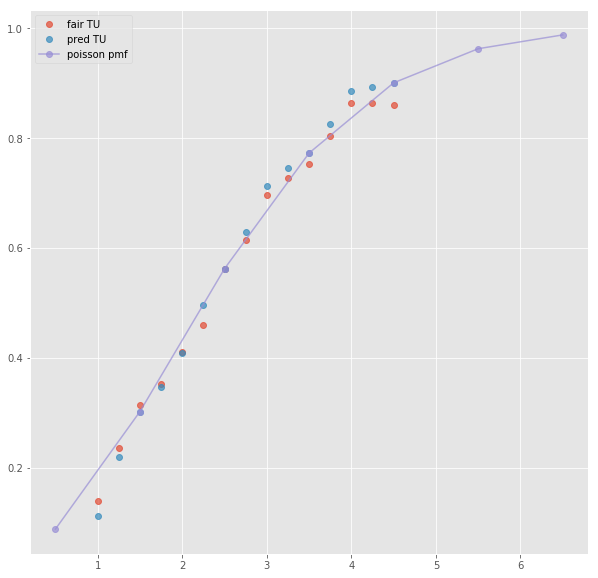

ML : 2.55 3.25 2.8
Error home:  0.02390138469776021
Error draw:  0.01719600973618224
Error away:  0.006705387225078241

(45, 124)
next positional indexers are out-of-bounds
(88, 124)
(1, 39)
3.5 2.47 1.578 -0.5 1.526 2.65
TO fair:  2.565272496831432 TU fair:  1.6388663967611337
TO pred:  2.56532 TU fair:  1.63885
Error TO:  0.006934200782153788

Error TO:  0.003944572807835445

Error TO:  7.2185094105448044e-06

Error TO:  0.010254975989845566

Error TO:  0.006470021526705505

Error TO:  0.0004990283952651664

Error TO:  0.0017235185618302284



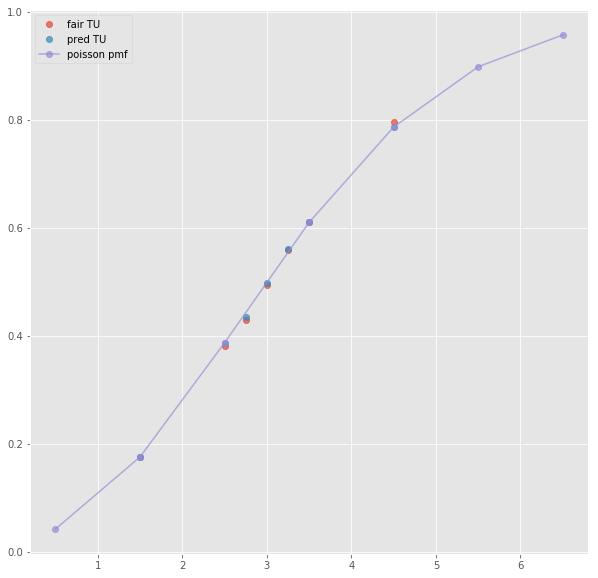

ML : 1.526 4.57 5.94
Error home:  0.005959139390372403
Error draw:  0.01179320475474821
Error away:  0.005834205361559763

(108, 124)
(1, 24)
next list index out of range
(115, 124)
(1, 20)
next list index out of range
(186, 124)
(1, 19)
next list index out of range
(64, 124)
(1, 41)
3.5 2.47 1.578 -0.5 1.526 2.65
TO fair:  2.565272496831432 TU fair:  1.6388663967611337
TO pred:  2.56532 TU fair:  1.63885
Error TO:  0.006934200782153788

Error TO:  0.003944572807835445

Error TO:  7.2185094105448044e-06

Error TO:  0.010254975989845566

Error TO:  0.006470021526705505

Error TO:  0.0004990283952651664

Error TO:  0.0017235185618302284



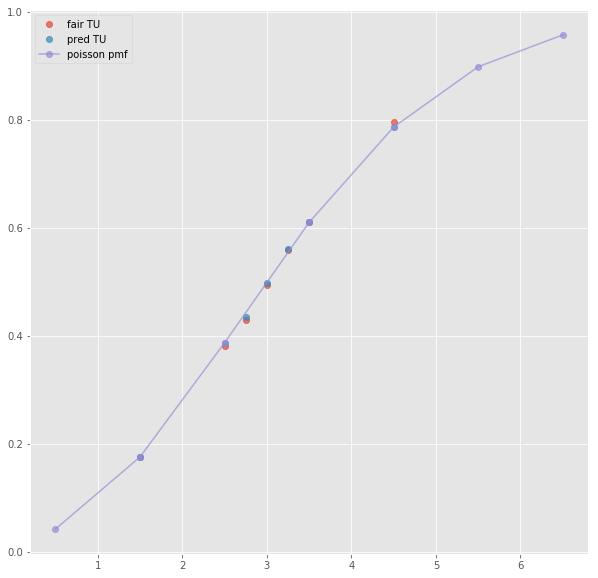

Error T1O:  0.0016851084205813938
ML : 1.526 4.57 5.94
Error home:  0.005959139390372403
Error draw:  0.01179320475474821
Error away:  0.005834205361559763

(175, 124)
(1, 73)
3.5 2.35 1.575 -1.5 2.1 1.7
TO fair:  2.492063492063492 TU fair:  1.6702127659574466
TO pred:  2.49211 TU fair:  1.67019
Error TO:  0.0051263973221491455

Error TO:  0.021976086443525666

Error TO:  0.0030248346450085783

Error TO:  7.488602181360271e-06

Error TO:  0.012757263088487236

Error TO:  0.018540255293456376

Error TO:  0.011973753780625818

Error TO:  0.010063733266538644

Error TO:  0.0024841762151132096

Error TO:  0.0205966239790909

Error TO:  0.002818034669159808

Error TO:  0.009765205781596287

Error TO:  0.009045879570576731

Error TO:  0.02406759851161855

Error TO:  0.014670530307930307

Error TO:  0.01846753621768213



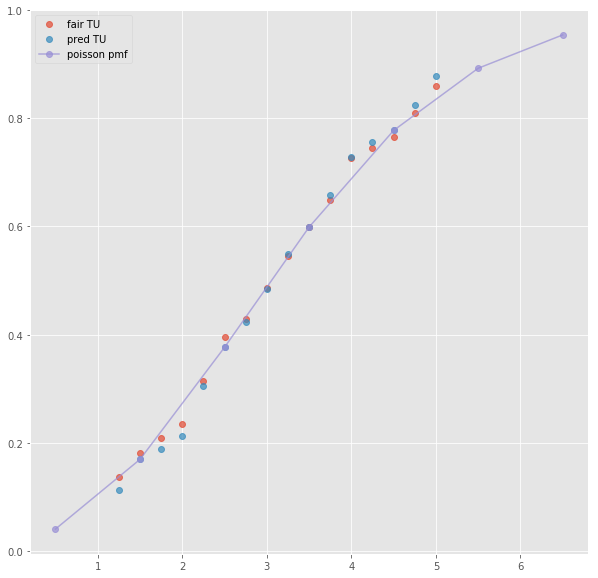

ML : 1.444 4.5 6.5
Error home:  0.02982697201353368
Error draw:  0.024763044772192017
Error away:  0.005063875628511488

(21, 124)
(1, 33)
3.5 2.43 1.59 -0.5 1.52 2.62
TO fair:  2.528301886792453 TU fair:  1.654320987654321
TO pred:  2.52826 TU fair:  1.65434
Error TO:  0.008886162551711041

Error TO:  0.006268019906231714

Error TO:  6.552792900738069e-06

Error TO:  0.01032433142373379

Error TO:  0.0015075101602007868



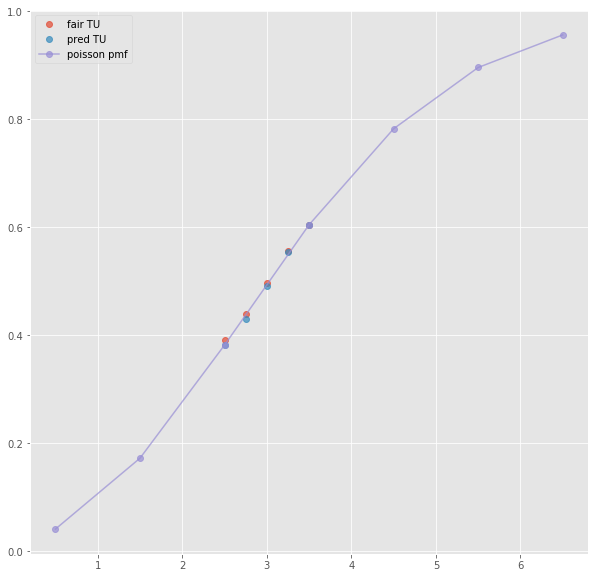

Error T1O:  0.007999188028950166
ML : 1.53 4.6 5.99
Error home:  0.0031340228624850974
Error draw:  0.011656494949672913
Error away:  0.008522427221316548

(45, 124)
(1, 41)
2.5 2.19 1.724 -0.5 2.16 1.757
TO fair:  2.2703016241299303 TU fair:  1.7872146118721461
TO pred:  2.27034 TU fair:  1.78719
Error TO:  0.0006762232364113108

Error TO:  0.008656782773345584

Error TO:  0.004157455890245992

Error TO:  7.44532695878819e-06

Error TO:  0.011156771652847453

Error TO:  0.0026522745330355146

Error TO:  0.010304014787640314



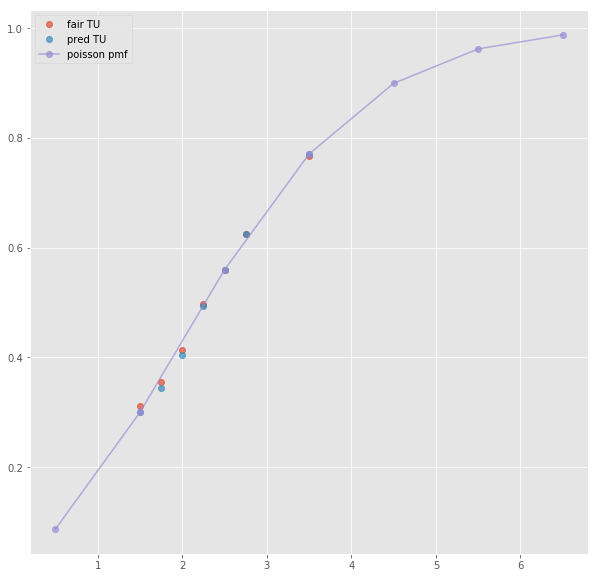

ML : 2.16 3.34 3.67
Error home:  0.001164348093595835
Error draw:  0.020401070764643314
Error away:  0.019236709666205887

(56, 124)
(1, 19)
next list index out of range
(75, 124)
(1, 19)
next list index out of range
(113, 124)
(1, 23)
2.5 2.23 1.71 -0.5 2.19 1.76
TO fair:  2.3040935672514617 TU fair:  1.7668161434977576
TO pred:  2.30408 TU fair:  1.76682
Error TO:  0.017389227038548283

Error TO:  2.555607823140349e-06

Error TO:  0.009303230829116271



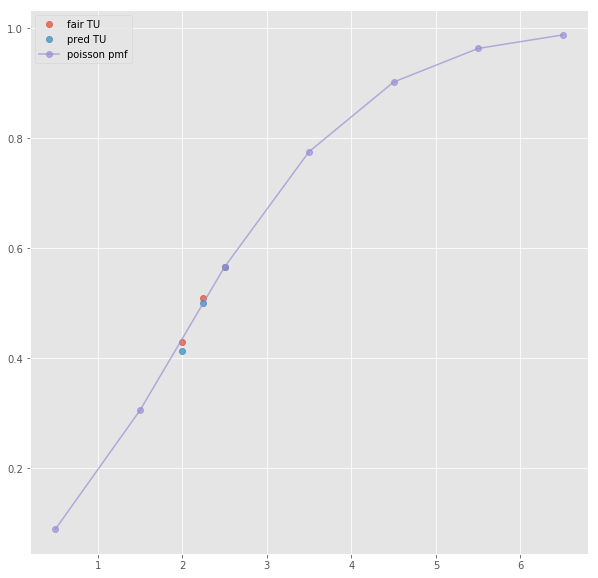

ML : 2.17 3.1 3.35
Error home:  0.01965141470181081
Error draw:  0.027354762089305096
Error away:  0.0077031836413754

(33, 124)
(1, 43)
2.5 2.19 1.724 -0.5 2.16 1.757
TO fair:  2.2703016241299303 TU fair:  1.7872146118721461
TO pred:  2.27034 TU fair:  1.78719
Error TO:  0.0006762232364113108

Error TO:  0.008656782773345584

Error TO:  0.004157455890245992

Error TO:  7.44532695878819e-06

Error TO:  0.011156771652847453

Error TO:  0.0026522745330355146

Error TO:  0.010304014787640314



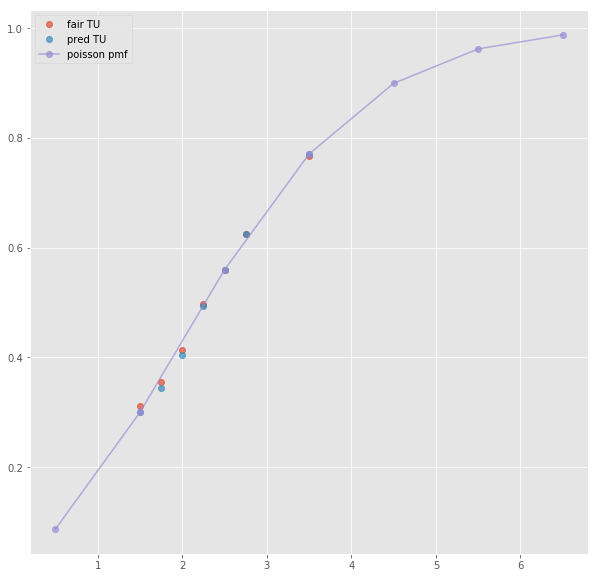

Error T1O:  0.002328593268322132
ML : 2.16 3.34 3.67
Error home:  0.001164348093595835
Error draw:  0.020401070764643314
Error away:  0.019236709666205887

(8, 124)
(1, 57)
2.5 2.25 1.625 -0.5 2.1 1.7
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.009547734651831286

Error TO:  0.006924440558772171

Error TO:  0.005660988994402261

Error TO:  0.017438863721781245

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.0023390419334406443

Error TO:  0.016912035740595688

Error TO:  0.00927629075225167

Error TO:  0.011428927950369011

Error TO:  0.022057817955149273

Error TO:  0.026633774838264346



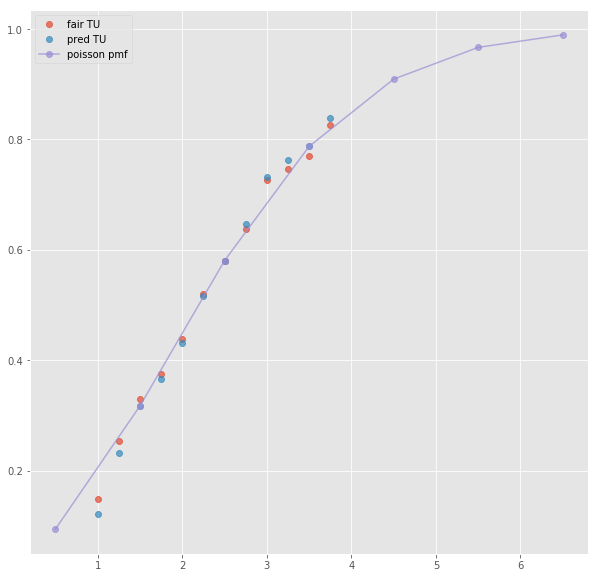

ML : 2.1 3.3 3.5
Error home:  0.00022077786698621038
Error draw:  0.010369158909441734
Error away:  0.010148713512462215

(2, 124)
(1, 33)
2.5 2.24 1.68 -0.5 2.2 1.71
TO fair:  2.333333333333333 TU fair:  1.7499999999999998
TO pred:  2.33328 TU fair:  1.75003
Error TO:  0.004247900627598167

Error TO:  0.0016994813438423462

Error TO:  9.796142279194786e-06

Error TO:  0.0021510870856333852

Error TO:  0.003225296748643136



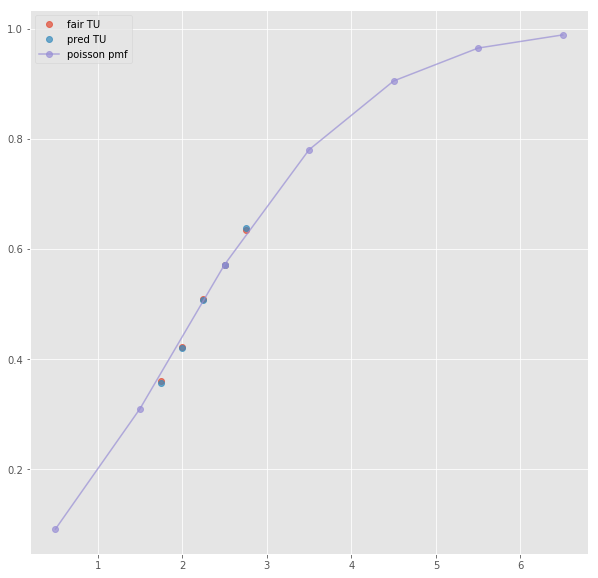

Error T1O:  0.008429366759016677
ML : 2.23 3.27 3.5
Error home:  0.0061230455731001165
Error draw:  0.021035517804619153
Error away:  0.01491226367424825

(34, 124)
(1, 41)
2.5 2.58 1.537 0.5 1.621 2.41
TO fair:  2.6785946649316856 TU fair:  1.5957364341085272
TO pred:  2.6786 TU fair:  1.59574
Error TO:  0.002492253831793856

Error TO:  0.013042283724154363

Error TO:  7.435755839391156e-07

Error TO:  0.0034707550916512897

Error TO:  0.0006135118923693006

Error TO:  0.0023382724488812956

Error TO:  0.01742088558584587



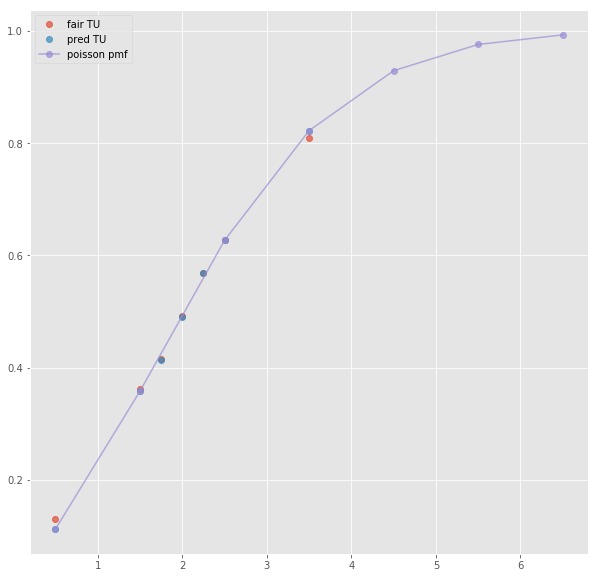

ML : 3.54 2.97 2.41
Error home:  0.033950510888804075
Error draw:  0.034820394081274464
Error away:  0.000869461912531122

(30, 124)
(1, 23)
next list index out of range
(75, 124)
(1, 21)
next list index out of range
(99, 124)
(1, 23)
next list index out of range
(31, 124)
(1, 43)
2.5 2.58 1.537 0.5 1.621 2.41
TO fair:  2.6785946649316856 TU fair:  1.5957364341085272
TO pred:  2.6786 TU fair:  1.59574
Error TO:  0.002492253831793856

Error TO:  0.013042283724154363

Error TO:  7.435755839391156e-07

Error TO:  0.0034707550916512897

Error TO:  0.0006135118923693006

Error TO:  0.0023382724488812956

Error TO:  0.01742088558584587



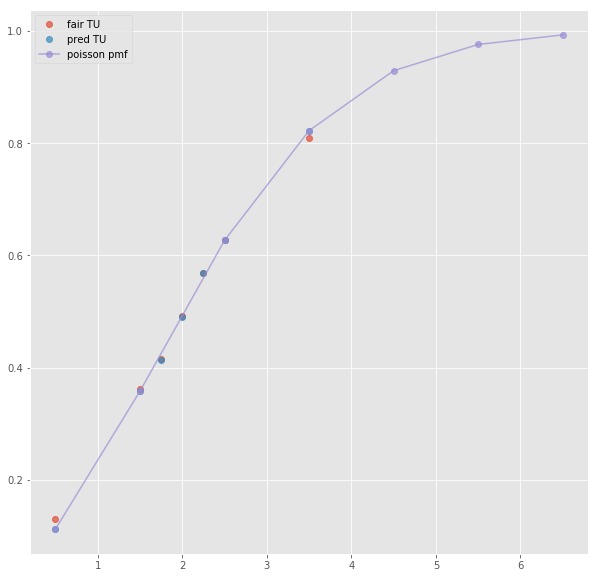

Error T1O:  0.008870752256165404
ML : 3.54 2.97 2.41
Error home:  0.033950510888804075
Error draw:  0.034820394081274464
Error away:  0.000869461912531122

(13, 124)
(1, 37)
2.5 2.57 1.54 0.5 1.62 2.36
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66885 TU fair:  1.59921
Error TO:  0.0030467535127988166

Error TO:  2.6438207732515373e-06

Error TO:  0.002778369568259609

Error TO:  0.0016412231067186034

Error TO:  0.001889223311455357



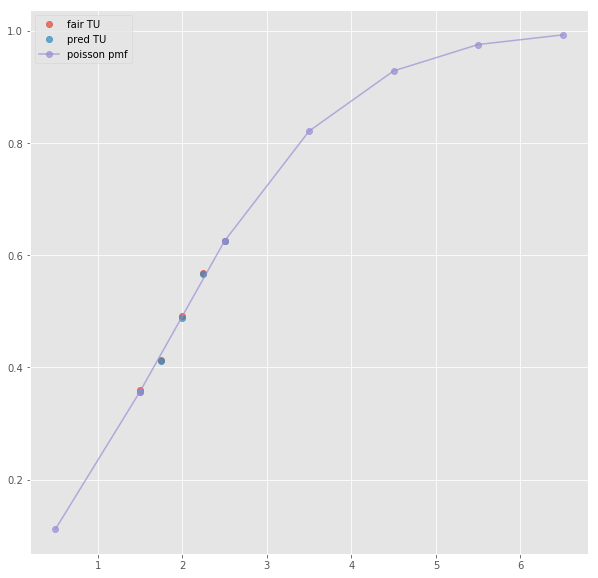

Error T1O:  0.01152564073947604
Error T1O:  0.012361675274895179
ML : 3.44 3.01 2.4
Error home:  0.023305833498037165
Error draw:  0.029556587431065873
Error away:  0.006251173114616815

(25, 124)
(1, 43)
2.5 2.0 1.793 0.5 2.53 1.505
TO fair:  2.115448968209704 TU fair:  1.8964999999999996
TO pred:  2.11547 TU fair:  1.89649
Error TO:  0.003920006500639672

Error TO:  0.005981634960072091

Error TO:  0.01031833804786253

Error TO:  0.014396464898446037

Error TO:  0.03625833956343408

Error TO:  4.6996641022145624e-06

Error TO:  0.009756958008980798

Error TO:  0.0018494272465697792

Error TO:  0.001014111485936997



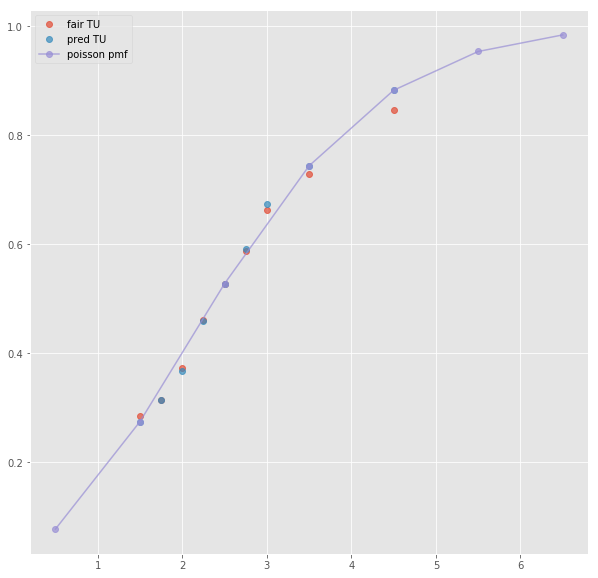

ML : 6.26 3.95 1.505
Error home:  0.0013884590416759768
Error draw:  0.011670388594419906
Error away:  0.010281838563368173

(45, 124)
(1, 15)
next list index out of range
(152, 124)
(1, 15)
next list index out of range
(21, 124)
(1, 45)
2.5 2.0 1.793 0.5 2.53 1.505
TO fair:  2.115448968209704 TU fair:  1.8964999999999996
TO pred:  2.11547 TU fair:  1.89649
Error TO:  0.003920006500639672

Error TO:  0.005981634960072091

Error TO:  0.01031833804786253

Error TO:  0.014396464898446037

Error TO:  0.03625833956343408

Error TO:  4.6996641022145624e-06

Error TO:  0.009756958008980798

Error TO:  0.0018494272465697792

Error TO:  0.001014111485936997



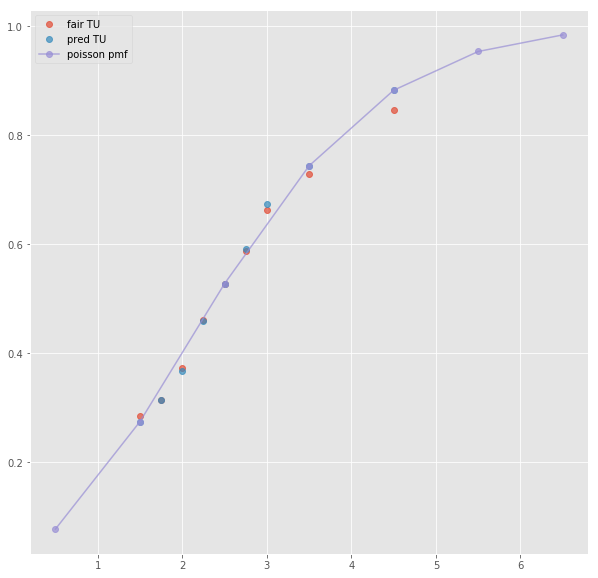

Error T1O:  0.0028931758919497064
ML : 6.26 3.95 1.505
Error home:  0.0013884590416759768
Error draw:  0.011670388594419906
Error away:  0.010281838563368173

(13, 124)
(1, 17)
next list index out of range
(31, 124)
(1, 34)
2.5 2.06 1.81 1.5 1.54 2.57
TO fair:  2.1381215469613264 TU fair:  1.8786407766990294
TO pred:  2.13809 TU fair:  1.87866
Error TO:  0.002621692777387774

Error TO:  0.006034569699231107

Error TO:  0.006578792176311299

Error TO:  6.900795553044237e-06

Error TO:  0.002106329409665375

Error TO:  0.01777434683600576



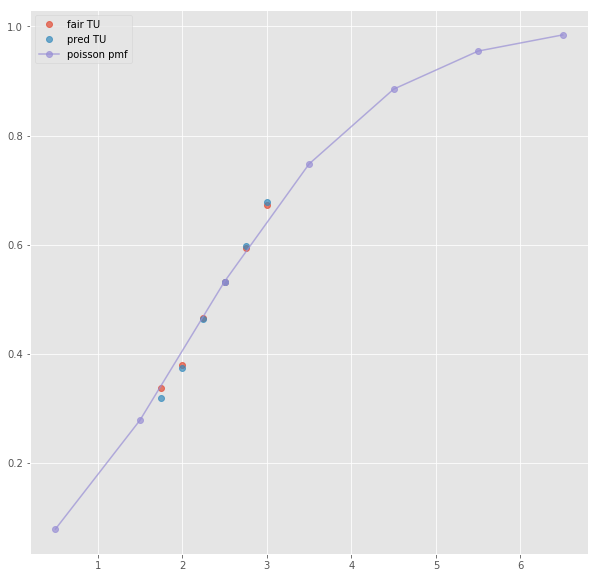

Error T1O:  0.0047295165680124596
ML : 6.49 4.12 1.56
Error home:  0.005064820263388697
Error draw:  0.012162378268969931
Error away:  0.01722719614984136

(7, 124)
(1, 43)
3.5 2.99 1.362 0.5 1.781 2.03
TO fair:  3.195301027900147 TU fair:  1.4555183946488295
TO pred:  3.19524 TU fair:  1.45553
Error TO:  0.0127741402225367

Error TO:  0.015196949961236772

Error TO:  0.00898281332109252

Error TO:  5.977411620339268e-06

Error TO:  0.005474124874795011

Error TO:  0.01585324276086031

Error TO:  0.012579757652641521

Error TO:  0.01560278941370552



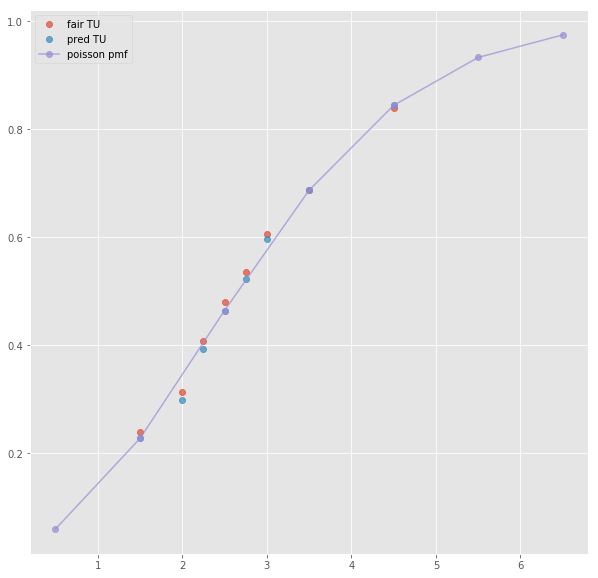

ML : 3.53 3.38 2.03
Error home:  0.022364235125233445
Error draw:  0.030082668272156526
Error away:  0.007718579436475914

(7, 124)
(1, 15)
next list index out of range
(36, 124)
(1, 15)
next list index out of range
(66, 124)
(1, 15)
next list index out of range
(7, 124)
(1, 45)
2.5 1.826 1.97 0.5 1.763 2.05
TO fair:  1.9269035532994925 TU fair:  2.0788608981380063
TO pred:  1.9269 TU fair:  2.07886
Error TO:  0.004558367704597721

Error TO:  0.0025791621736949155

Error TO:  0.011238108561648308

Error TO:  0.014892958300138093

Error TO:  0.016000340107378608

Error TO:  9.570015904181162e-07

Error TO:  0.00010102466109429553

Error TO:  0.001878899523773514



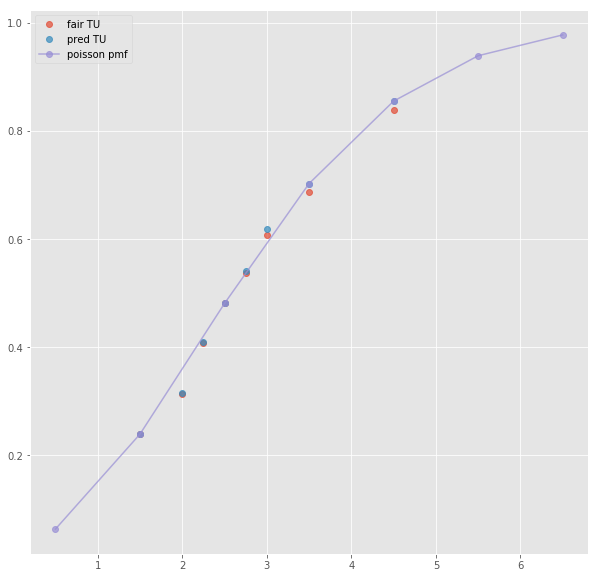

Error T1O:  0.001930461293016994
ML : 3.5 3.37 2.05
Error home:  0.0206873893197837
Error draw:  0.027284054714567407
Error away:  0.00659694705928171

(6, 124)
(1, 17)
next list index out of range
(17, 124)
(1, 35)
2.5 1.83 2.02 0.5 1.8 2.06
TO fair:  1.9059405940594059 TU fair:  2.1038251366120218
TO pred:  1.90591 TU fair:  2.10386
Error TO:  0.0035965263265804737

Error TO:  0.0029027119018522063

Error TO:  0.010003388463528273

Error TO:  8.422196248414338e-06

Error TO:  0.002257517485707239



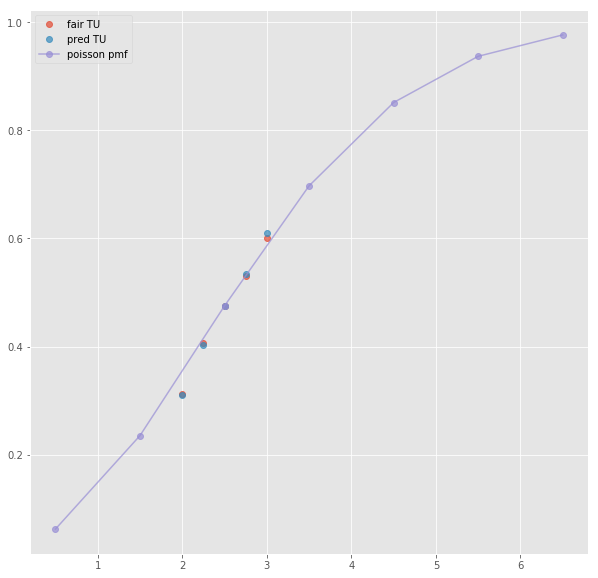

Error T1O:  0.0004194714659529475
ML : 3.6 3.56 2.08
Error home:  0.0180979819318281
Error draw:  0.021906610013631395
Error away:  0.003808542127849812

(10, 124)
(1, 39)
2.5 2.13 1.763 0.5 1.763 2.16
TO fair:  2.2081678956324446 TU fair:  1.8276995305164319
TO pred:  2.20811 TU fair:  1.82774
Error TO:  0.0006661177769448634

Error TO:  0.000514704509157915

Error TO:  0.002723318352067322

Error TO:  1.1873889595115372e-05

Error TO:  0.00041864283904946564

Error TO:  0.0006484358881893026

Error TO:  0.0009400102494020457



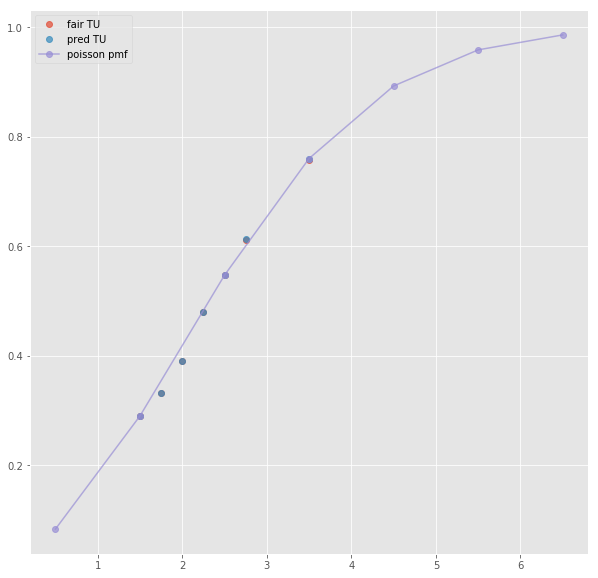

ML : 3.72 3.31 2.16
Error home:  0.02468260848571202
Error draw:  0.026307349300373595
Error away:  0.001624631292889256

(26, 124)
(1, 19)
2.5 2.11 1.76 0.5 1.74 2.16
TO fair:  2.1988636363636367 TU fair:  1.8341232227488156
TO pred:  2.19885 TU fair:  1.83413
Error TO:  2.820360819333345e-06

Error TO:  0.008825690000085484



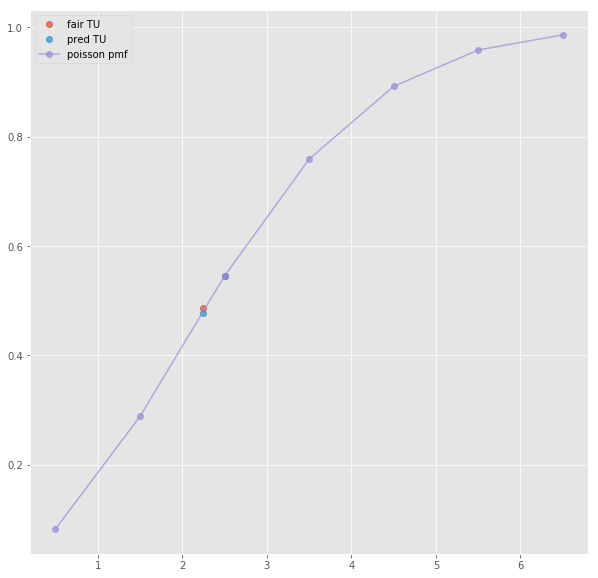

ML : 3.38 3.08 2.16
Error home:  0.014949038417663707
Error draw:  0.03383281434878205
Error away:  0.018883473786669658

(51, 124)
(1, 19)
2.5 2.12 1.79 0.5 1.76 2.19
TO fair:  2.184357541899441 TU fair:  1.8443396226415094
TO pred:  2.18441 TU fair:  1.8443
Error TO:  1.0993973324047168e-05

Error TO:  0.007095910844729381



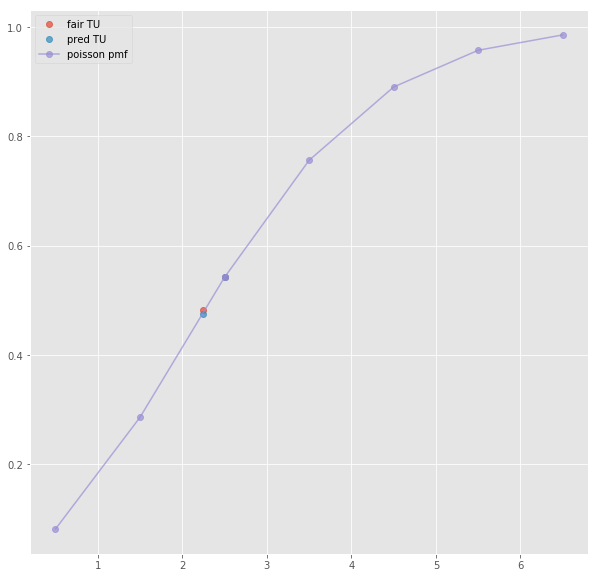

ML : 3.65 3.2 2.16
Error home:  0.028184790953337868
Error draw:  0.032586219396681104
Error away:  0.004401109573270834

(81, 124)
(1, 17)
next list index out of range
(10, 124)
(1, 41)
2.5 2.13 1.763 0.5 1.763 2.16
TO fair:  2.2081678956324446 TU fair:  1.8276995305164319
TO pred:  2.20811 TU fair:  1.82774
Error TO:  0.0006661177769448634

Error TO:  0.000514704509157915

Error TO:  0.002723318352067322

Error TO:  1.1873889595115372e-05

Error TO:  0.00041864283904946564

Error TO:  0.0006484358881893026

Error TO:  0.0009400102494020457



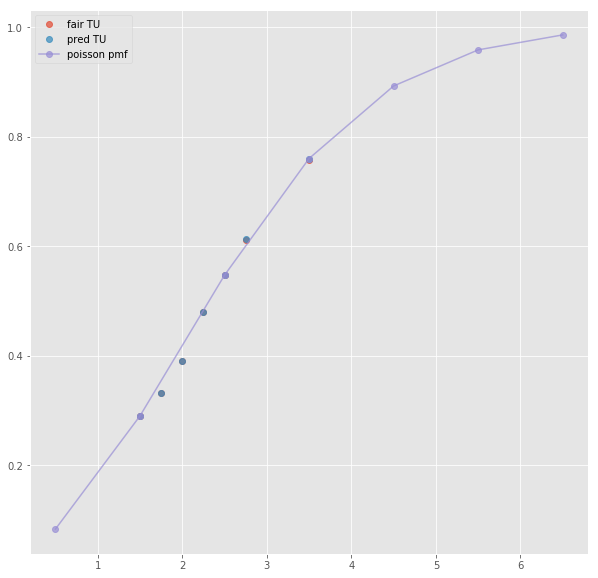

Error T1O:  0.005050887305115437
ML : 3.72 3.31 2.16
Error home:  0.02468260848571202
Error draw:  0.026307349300373595
Error away:  0.001624631292889256

(4, 124)
next positional indexers are out-of-bounds
(1, 124)
(1, 39)
3.5 2.59 1.558 -0.5 2.5 1.602
TO fair:  2.662387676508344 TU fair:  1.6015444015444016
TO pred:  2.66243 TU fair:  1.60153
Error TO:  0.0018676168796072368

Error TO:  0.0024579767902093153

Error TO:  5.970792750831233e-06

Error TO:  0.013130632974352574

Error TO:  0.0030186330460939548

Error TO:  0.007212961623718539

Error TO:  0.0012559637616013641



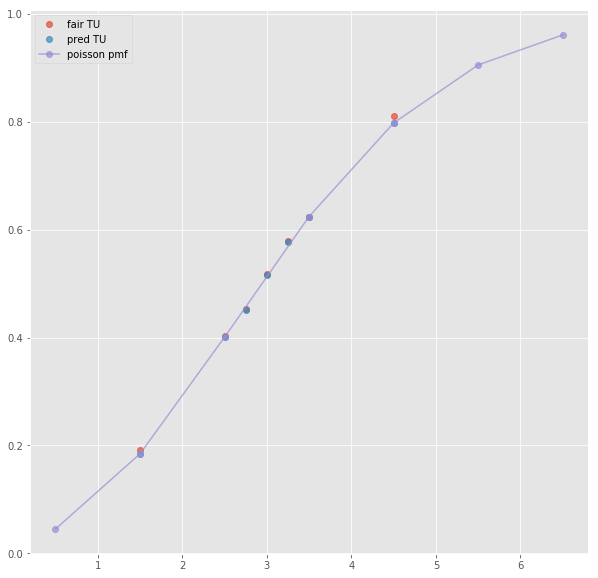

ML : 2.5 3.52 2.89
Error home:  0.0022413058264778574
Error draw:  0.03742169907208459
Error away:  0.035180361291855144

(1, 124)
(1, 23)
next list index out of range
(1, 124)
(1, 15)
next list index out of range
(1, 124)
(1, 23)
next list index out of range
(112, 124)
(1, 44)
3.5 2.87 1.4340000000000002 -1.5 1.8 2.09
TO fair:  3.00139470013947 TU fair:  1.4996515679442508
TO pred:  3.00135 TU fair:  1.49966
Error TO:  0.006776993467179526

Error TO:  0.04082577496496431

Error TO:  0.004692542032032565

Error TO:  4.962141261943831e-06

Error TO:  0.0011149531461604745

Error TO:  0.008426467156720352

Error TO:  0.003803411346435026

Error TO:  0.009081022983431497

Error TO:  0.0018386047281075957



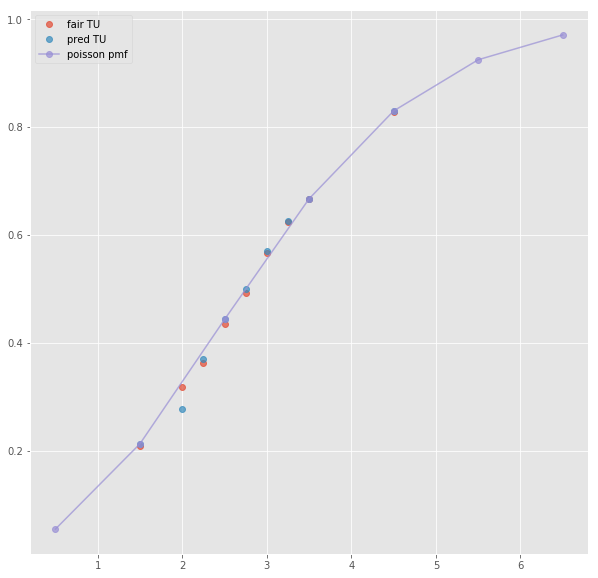

ML : 1.233 6.03 13.67
Error home:  0.0014736770160287405
Error draw:  0.0024098653824842498
Error away:  0.0038835729137397107

(82, 124)
(1, 23)
2.5 1.66 2.16 -1.5 1.73 2.09
TO fair:  1.7685185185185184 TU fair:  2.3012048192771086
TO pred:  1.76851 TU fair:  2.30122
Error TO:  0.007766239965296906

Error TO:  0.008112640864034848

Error TO:  2.723622669176251e-06



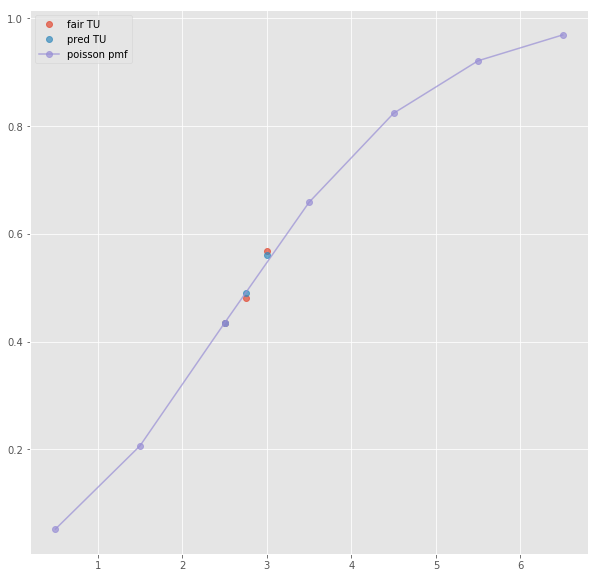

ML : 1.2 5.96 13.46
Error home:  0.002751048296881109
Error draw:  0.0045721509862888254
Error away:  0.0018211297460952042

(149, 124)
(1, 22)
2.5 1.72 2.19 -1.5 1.81 2.09
TO fair:  1.7853881278538815 TU fair:  2.2732558139534884
TO pred:  1.78536 TU fair:  2.27331
Error TO:  0.01594273521496259

Error TO:  0.006642784015854386

Error TO:  8.82425712644963e-06



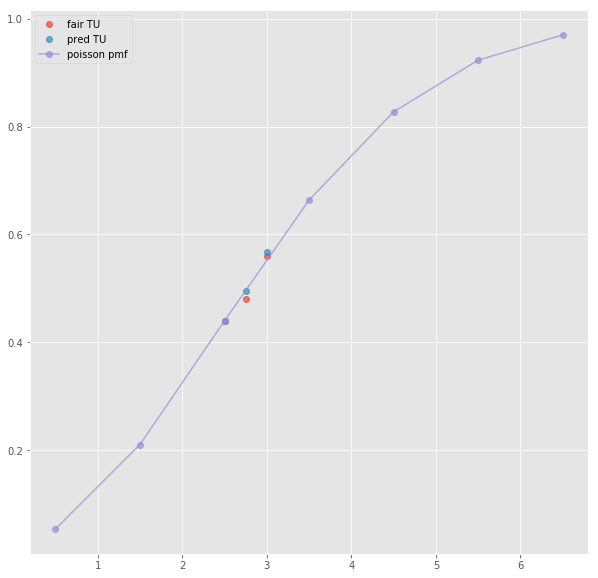

ML : 1.23 6.2 13.5
Error home:  0.006317936950368086
Error draw:  0.0020852117523645075
Error away:  0.0042326684020835

(138, 124)
(1, 22)
2.5 1.7 2.21 -1.5 1.82 2.08
TO fair:  1.7692307692307694 TU fair:  2.3000000000000003
TO pred:  1.7692 TU fair:  2.30004
Error TO:  0.005059319801156925

Error TO:  0.003826336302863942

Error TO:  9.83003863208598e-06



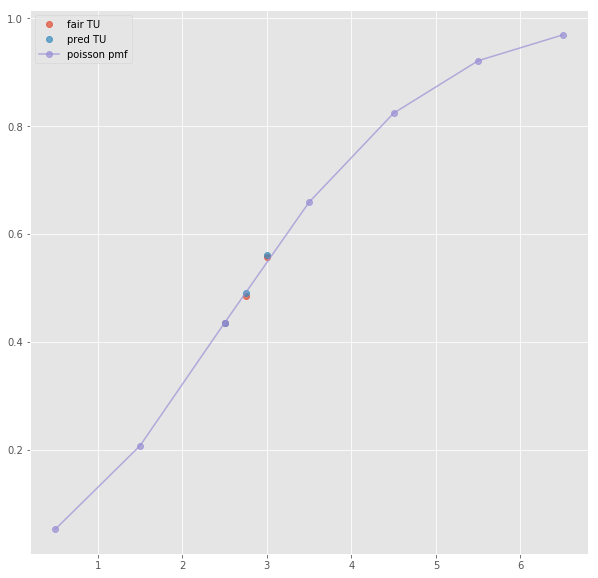

ML : 1.22 5.6 12.0
Error home:  0.008223042712912298
Error draw:  0.008396443544747195
Error away:  0.00017333234489659566

(101, 124)
(1, 46)
3.5 2.87 1.4340000000000002 -1.5 1.8 2.09
TO fair:  3.00139470013947 TU fair:  1.4996515679442508
TO pred:  3.00135 TU fair:  1.49966
Error TO:  0.006776993467179526

Error TO:  0.04082577496496431

Error TO:  0.004692542032032565

Error TO:  4.962141261943831e-06

Error TO:  0.0011149531461604745

Error TO:  0.008426467156720352

Error TO:  0.003803411346435026

Error TO:  0.009081022983431497

Error TO:  0.0018386047281075957



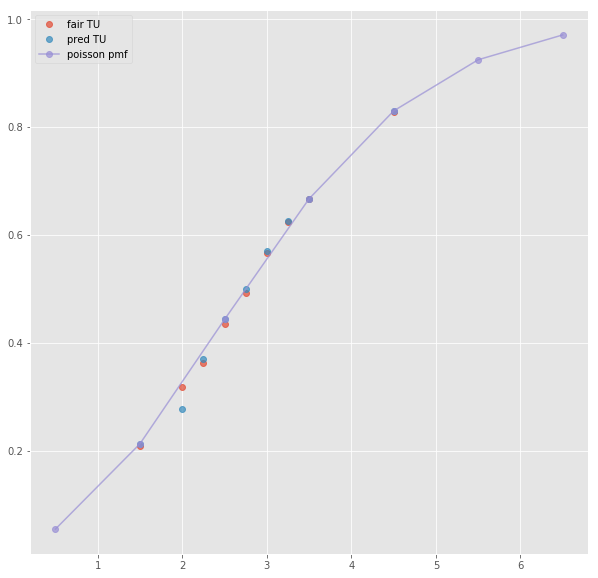

Error T1O:  0.01056577753372867
ML : 1.233 6.03 13.67
Error home:  0.0014736770160287405
Error draw:  0.0024098653824842498
Error away:  0.0038835729137397107

(35, 124)
(1, 65)
3.5 2.75 1.425 -1.5 1.675 2.15
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.04333841448671405

Error TO:  0.018524113220500626

Error TO:  0.011236463341383951

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.019206539751107532

Error TO:  0.02313125321841436

Error TO:  0.024001924436941602

Error TO:  0.001723698215953584

Error TO:  0.030731926345489935

Error TO:  0.003218176895100039

Error TO:  0.010324910414780453

Error TO:  0.004435638359586158

Error TO:  0.024947678360244696

Error TO:  0.009905698346832609



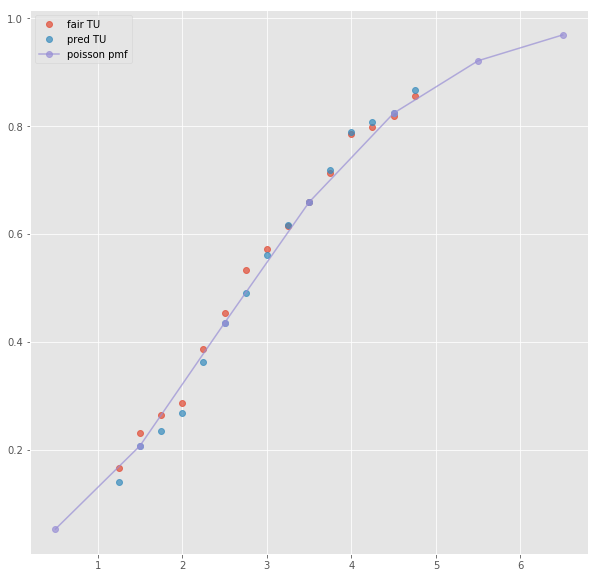

ML : 1.285 5.25 10.0
Error home:  0.061845972010859174
Error draw:  0.03254567563974453
Error away:  0.02930022990555499

(42, 124)
next positional indexers are out-of-bounds
(11, 124)
(1, 43)
2.5 2.54 1.564 -0.5 2.63 1.546
TO fair:  2.624040920716112 TU fair:  1.6157480314960628
TO pred:  2.62412 TU fair:  1.61572
Error TO:  0.02042812832960028

Error TO:  0.00019519253220479094

Error TO:  0.011366078247980138

Error TO:  1.1484403244443886e-05

Error TO:  0.0005414479273935235

Error TO:  6.742015411792535e-05

Error TO:  0.0012423145955290371

Error TO:  0.01196295552351001



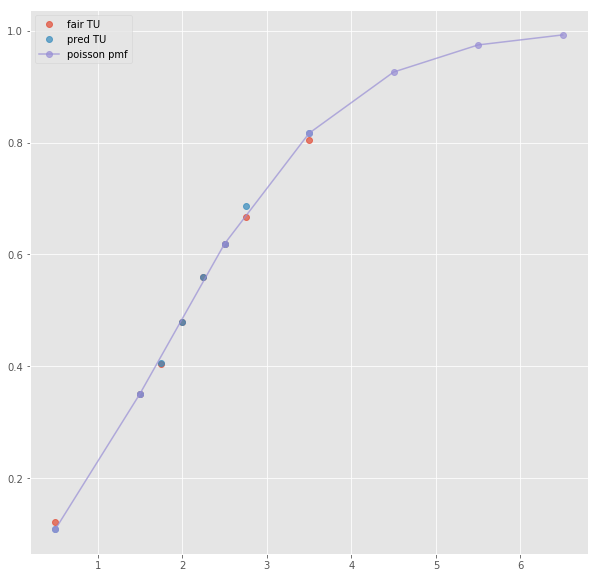

ML : 2.63 3.08 3.08
Error home:  0.0009232077655708659
Error draw:  0.025322837687483113
Error away:  0.02440004943207863

(9, 124)
(1, 19)
next list index out of range
(39, 124)
(1, 19)
next list index out of range
(12, 124)
(1, 23)
next list index out of range
(12, 124)
(1, 45)
2.5 2.54 1.564 -0.5 2.63 1.546
TO fair:  2.624040920716112 TU fair:  1.6157480314960628
TO pred:  2.62412 TU fair:  1.61572
Error TO:  0.02042812832960028

Error TO:  0.00019519253220479094

Error TO:  0.011366078247980138

Error TO:  1.1484403244443886e-05

Error TO:  0.0005414479273935235

Error TO:  6.742015411792535e-05

Error TO:  0.0012423145955290371

Error TO:  0.01196295552351001



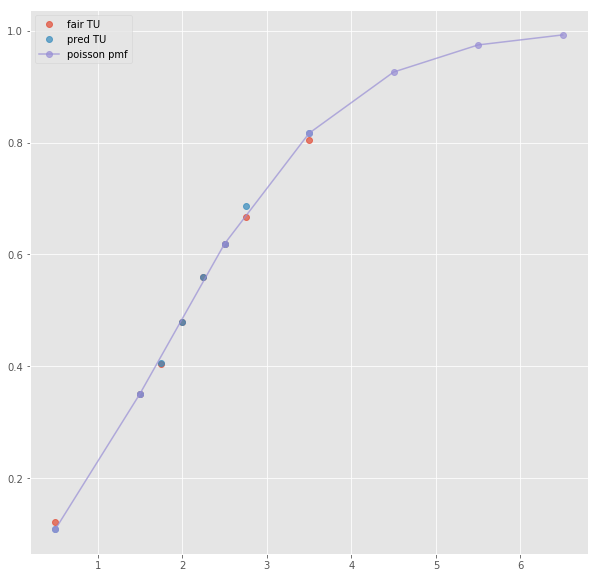

Error T1O:  0.01733256554994561
ML : 2.63 3.08 3.08
Error home:  0.0009232077655708659
Error draw:  0.025322837687483113
Error away:  0.02440004943207863

(48, 124)
(1, 62)
2.5 2.425 1.525 -0.5 2.425 1.525
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.5902 TU fair:  1.62885
Error TO:  0.011151249378455907

Error TO:  0.019148928499722162

Error TO:  0.013915370722476311

Error TO:  0.015263717496636908

Error TO:  5.3756662160009405e-06

Error TO:  0.015318824723041358

Error TO:  0.007716358439895876

Error TO:  0.013803968720076748

Error TO:  0.010140032833630408

Error TO:  0.018542307580882156

Error TO:  0.01588736637413446

Error TO:  0.024475154981054903

Error TO:  0.030161867796824615



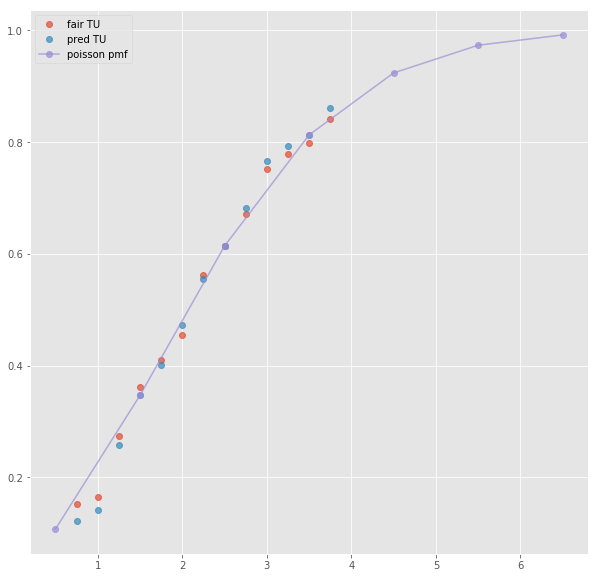

ML : 2.45 3.1 3.0
Error home:  0.0024967633429407443
Error draw:  0.015091224302308415
Error away:  0.012594495880953682

(3, 124)
(1, 33)
2.5 2.5 1.56 -0.5 2.52 1.55
TO fair:  2.602564102564102 TU fair:  1.6239999999999999
TO pred:  2.60252 TU fair:  1.62402
Error TO:  0.0038207478543956785

Error TO:  6.511309349310768e-06

Error TO:  0.006478199624425307

Error TO:  0.0025375911309191146

Error TO:  0.004981827079177048



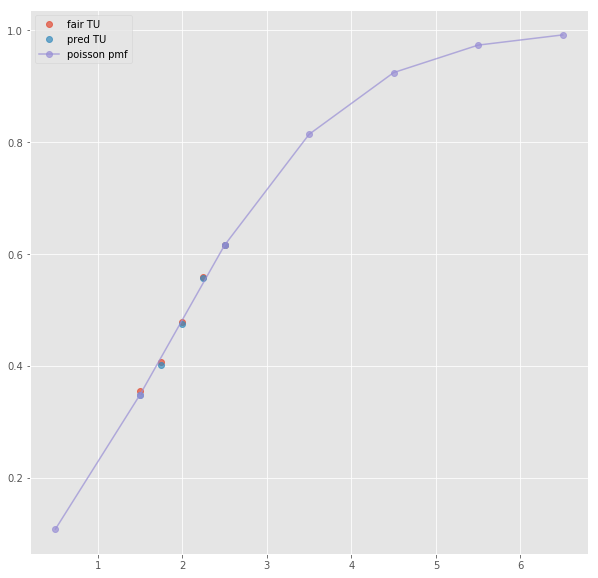

Error T1O:  0.007692250936596201
ML : 2.56 3.13 3.03
Error home:  0.005292723840491176
Error draw:  0.01836043645361546
Error away:  0.013067642843873906

(105, 124)
(1, 47)
3.5 2.49 1.5519999999999998 -1.5 2.03 1.869
TO fair:  2.6043814432989696 TU fair:  1.623293172690763
TO pred:  2.60442 TU fair:  1.62328
Error TO:  0.010361572611269021

Error TO:  0.012443573507297134

Error TO:  5.684395067540038e-06

Error TO:  0.005383581324464037

Error TO:  0.005450206078794095

Error TO:  0.024509722922437582

Error TO:  0.019561934501087674

Error TO:  0.005686475440046246



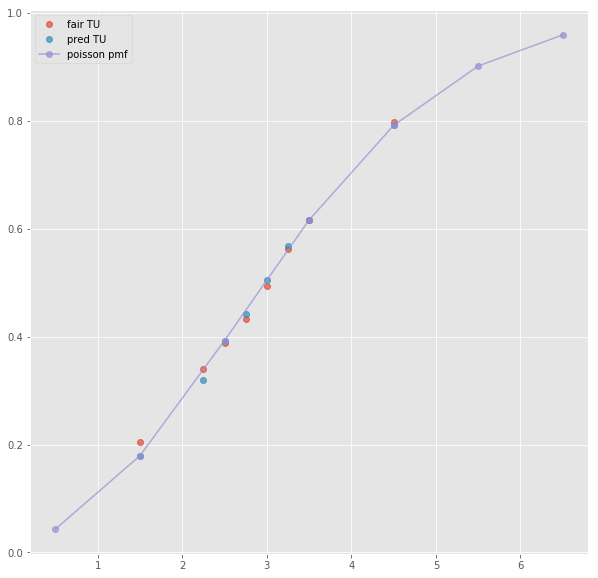

Error T1O:  0.019844849397839925
ML : 1.352 5.48 8.35
Error home:  0.0009191690909532424
Error draw:  0.0012635052146394432
Error away:  0.000344397477374192

(45, 124)
next positional indexers are out-of-bounds
(36, 124)
(1, 41)
next list index out of range
(66, 124)
(1, 27)
next list index out of range
(82, 124)
(1, 19)
next list index out of range
(162, 124)
(1, 27)
next list index out of range
(38, 124)
(1, 43)
next list index out of range
(7, 124)
(1, 62)
2.5 2.5 1.5 0.5 1.55 2.375
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.003721510072886125

Error TO:  0.019040660831705525

Error TO:  0.007426978455027461

Error TO:  0.010647662622160714

Error TO:  6.56261484577314e-06

Error TO:  0.01835574355840064

Error TO:  0.013764966559658143

Error TO:  0.010710787105882885

Error TO:  0.01665797138706926

Error TO:  0.011579562296835239

Error TO:  0.0196081920208222

Error TO:  0.04163370377433351

Error TO:  0.03811845212739862



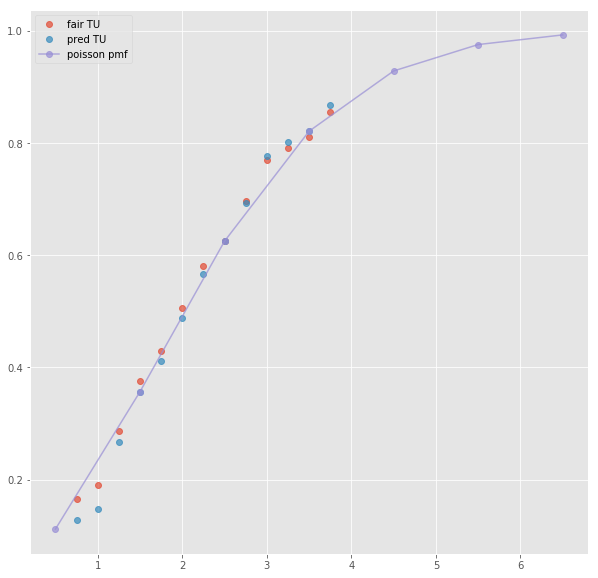

ML : 3.3 2.9 2.45
Error home:  0.027401903325522836
Error draw:  0.03577873877931398
Error away:  0.008376502276313091

(21, 124)
next positional indexers are out-of-bounds
(39, 124)
(1, 41)
3.5 2.57 1.54 -0.5 1.515 2.68
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66883 TU fair:  1.59922
Error TO:  0.0033276031602479383

Error TO:  0.0014744656190045502

Error TO:  1.6410045011738816e-07

Error TO:  0.00015934890555785453

Error TO:  0.0033039518198866302

Error TO:  0.009267894973502555

Error TO:  0.01823341015618396

Error TO:  0.001048718387750447



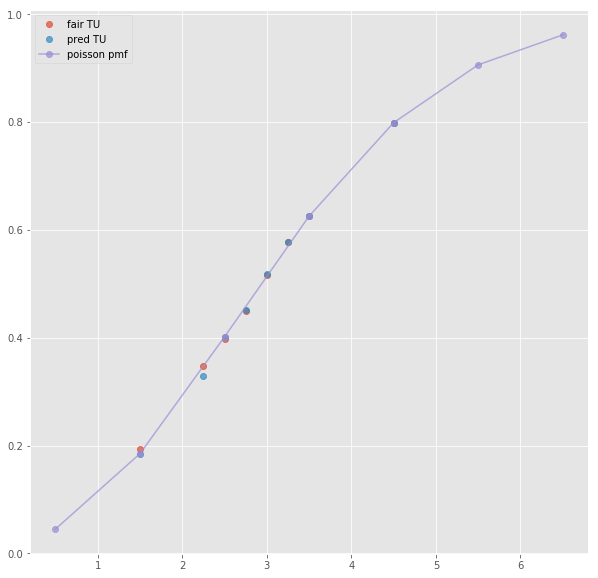

ML : 1.515 4.6 6.12
Error home:  0.004698281226077516
Error draw:  0.009811230080038869
Error away:  0.005112757101247312

(30, 124)
(1, 22)
next list index out of range
(63, 124)
(1, 18)
next list index out of range
(105, 124)
(1, 24)
next list index out of range
(32, 124)
(1, 43)
3.5 2.57 1.54 -0.5 1.515 2.68
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66883 TU fair:  1.59922
Error TO:  0.0033276031602479383

Error TO:  0.0014744656190045502

Error TO:  1.6410045011738816e-07

Error TO:  0.00015934890555785453

Error TO:  0.0033039518198866302

Error TO:  0.009267894973502555

Error TO:  0.01823341015618396

Error TO:  0.001048718387750447



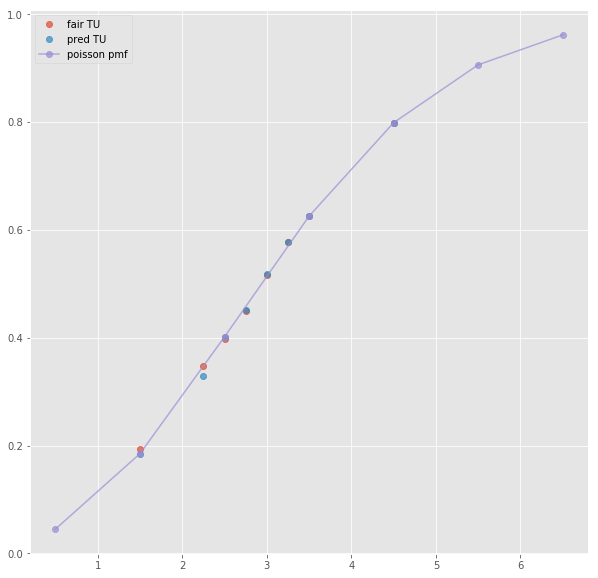

Error T1O:  6.521894056543687e-05
ML : 1.515 4.6 6.12
Error home:  0.004698281226077516
Error draw:  0.009811230080038869
Error away:  0.005112757101247312

(36, 124)
(1, 66)
3.5 2.425 1.525 -1.5 2.35 1.575
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.59019 TU fair:  1.62886
Error TO:  0.014174596584795807

Error TO:  0.027954184820545014

Error TO:  0.02992498113247033

Error TO:  3.885155582861177e-06

Error TO:  0.011278027205546215

Error TO:  0.01957038365376229

Error TO:  0.024404758866645948

Error TO:  0.023138646275283836

Error TO:  0.006009005748257468

Error TO:  0.02801453483607741

Error TO:  0.00906789630144772

Error TO:  0.00458571529999624

Error TO:  0.0024818977009522514

Error TO:  0.025523228236961293

Error TO:  0.008855884329115299



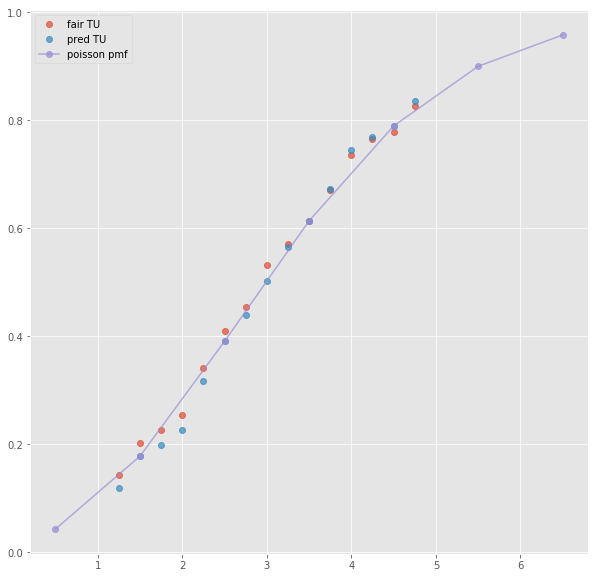

ML : 1.5 4.33 6.5
Error home:  0.001010462865909556
Error draw:  0.021136444263390758
Error away:  0.020126063095133317

(6, 124)
(1, 32)
3.5 2.56 1.54 -0.5 1.53 2.59
TO fair:  2.6623376623376624 TU fair:  1.6015625
TO pred:  2.66231 TU fair:  1.60157
Error TO:  0.008768631155496753

Error TO:  0.007144109688080047

Error TO:  3.902717528148081e-06

Error TO:  0.012374311277820182

Error TO:  0.00265492059981004



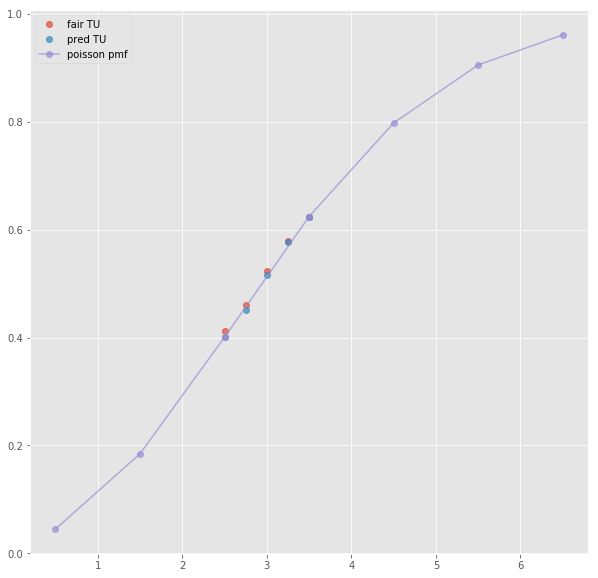

Error T1O:  0.007678885617427023
ML : 1.53 4.53 5.96
Error home:  0.0014665653805067125
Error draw:  0.009958108755018819
Error away:  0.008491410854391118

(52, 124)
next positional indexers are out-of-bounds
(79, 124)
next positional indexers are out-of-bounds
(82, 124)
next positional indexers are out-of-bounds
(299, 124)
next positional indexers are out-of-bounds
(45, 124)
(1, 46)
3.5 2.91 1.4380000000000002 -0.5 1.909 1.99
TO fair:  3.0236439499304595 TU fair:  1.4941580756013748
TO pred:  3.02365 TU fair:  1.49416
Error TO:  0.007416690036400164

Error TO:  0.004881669601138727

Error TO:  6.6175647411848e-07

Error TO:  0.00038134331703809643

Error TO:  0.008103559299509122

Error TO:  0.005299902129579426

Error TO:  0.007545526456167129

Error TO:  0.002062555387126741



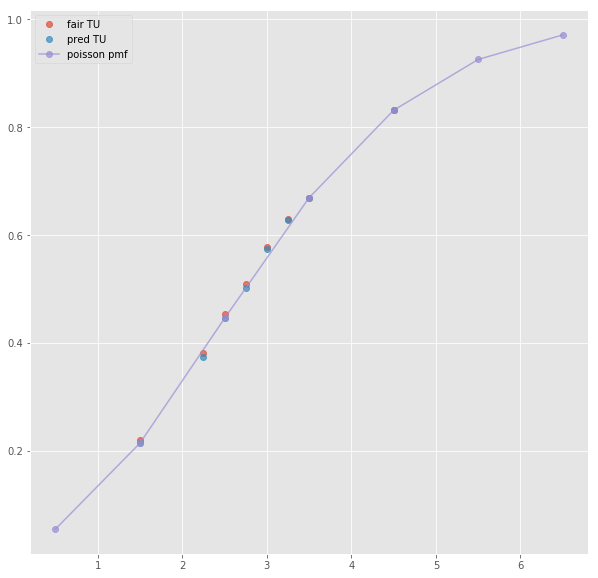

Error T1O:  0.0034790830528188543
ML : 1.909 3.68 4.13
Error home:  0.0055746778606942105
Error draw:  0.025655041416674462
Error away:  0.02008040087794946

(138, 124)
(1, 68)
3.5 2.75 1.425 -0.5 1.825 2.025
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.01693718413811518

Error TO:  0.018524113220500626

Error TO:  0.011236463341383951

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.019206539751107532

Error TO:  0.028265949221071396

Error TO:  0.024001924436941602

Error TO:  0.001723698215953584

Error TO:  0.030731926345489935

Error TO:  0.010544184221107394

Error TO:  0.010324910414780453

Error TO:  0.004435638359586158

Error TO:  0.024947678360244696

Error TO:  0.009905698346832609



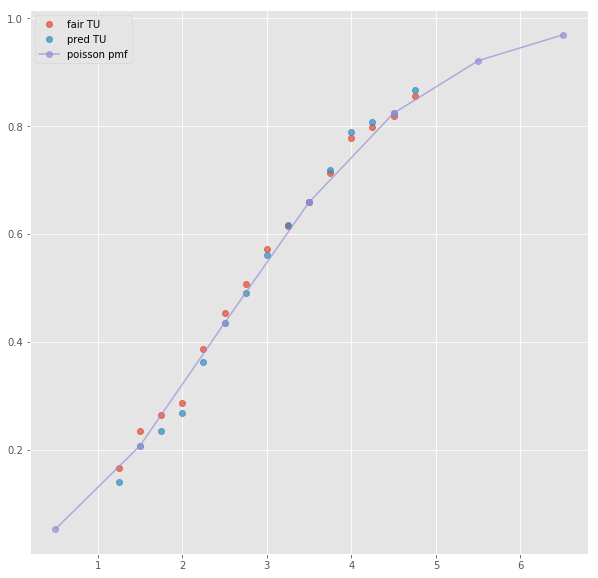

ML : 1.85 3.8 3.8
Error home:  0.019319689247260907
Error draw:  0.015171788490846327
Error away:  0.0041477683815178135

(23, 124)
next positional indexers are out-of-bounds
(86, 124)
(1, 39)
3.5 2.5 1.581 -0.5 2.63 1.546
TO fair:  2.581277672359267 TU fair:  1.6324000000000003
TO pred:  2.58123 TU fair:  1.63242
Error TO:  9.134760666673625e-05

Error TO:  0.0001313530219121395

Error TO:  7.1549271547510784e-06

Error TO:  0.0014966151993539567

Error TO:  0.0006028565328066726

Error TO:  0.0036709742313800753

Error TO:  0.0003314127411394585



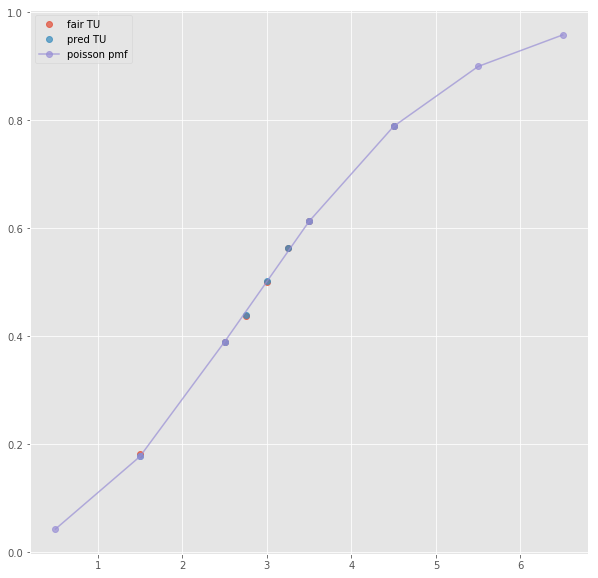

ML : 2.63 3.76 2.59
Error home:  0.0018725252219076172
Error draw:  0.02157367608232269
Error away:  0.019700951074686446

(59, 124)
(1, 23)
next list index out of range
(117, 124)
(1, 21)
next list index out of range
(288, 124)
(1, 23)
next list index out of range
(67, 124)
(1, 41)
3.5 2.5 1.581 -0.5 2.63 1.546
TO fair:  2.581277672359267 TU fair:  1.6324000000000003
TO pred:  2.58123 TU fair:  1.63242
Error TO:  9.134760666673625e-05

Error TO:  0.0001313530219121395

Error TO:  7.1549271547510784e-06

Error TO:  0.0014966151993539567

Error TO:  0.0006028565328066726

Error TO:  0.0036709742313800753

Error TO:  0.0003314127411394585



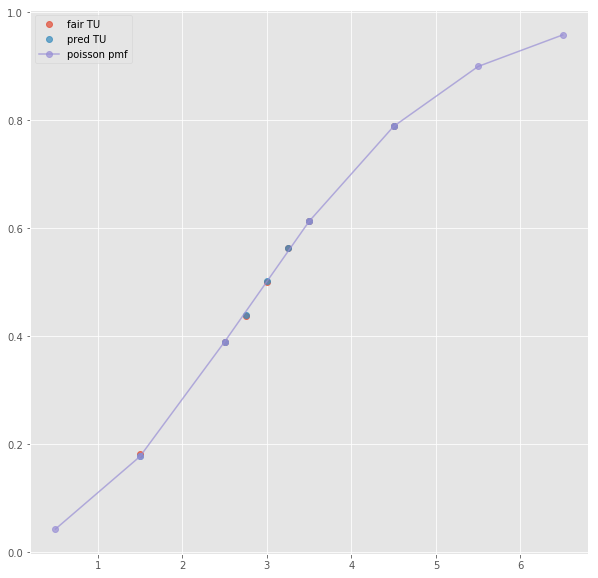

Error T1O:  0.0101460374455416
ML : 2.63 3.76 2.59
Error home:  0.0018725252219076172
Error draw:  0.02157367608232269
Error away:  0.019700951074686446

(158, 124)
(1, 69)
3.5 2.35 1.575 -0.5 2.425 1.525
TO fair:  2.492063492063492 TU fair:  1.6702127659574466
TO pred:  2.49211 TU fair:  1.67019
Error TO:  0.0051263973221491455

Error TO:  0.021976086443525666

Error TO:  0.02916974236886377

Error TO:  7.488602181360271e-06

Error TO:  0.012757263088487236

Error TO:  0.018540255293456376

Error TO:  0.011973753780625818

Error TO:  0.010063733266538644

Error TO:  0.0024841762151132096

Error TO:  0.0205966239790909

Error TO:  0.002818034669159808

Error TO:  0.009765205781596287

Error TO:  0.009045879570576731

Error TO:  0.02406759851161855

Error TO:  0.014670530307930307

Error TO:  0.01846753621768213



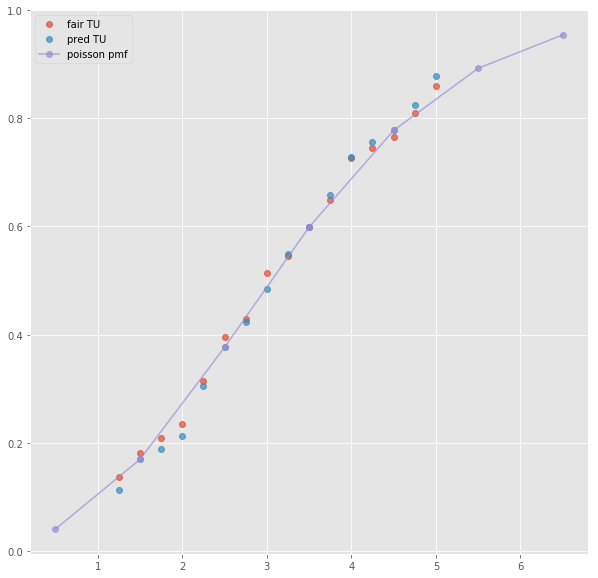

ML : 2.6 3.75 2.5
Error home:  0.020224367832543777
Error draw:  0.020093350877686766
Error away:  0.00013095408063068525

(24, 124)
(1, 33)
3.5 2.4 1.61 -0.5 2.58 1.53
TO fair:  2.4906832298136643 TU fair:  1.6708333333333334
TO pred:  2.49069 TU fair:  1.67083
Error TO:  0.011580343034151674

Error TO:  0.00980073992341135

Error TO:  1.09134596787408e-06

Error TO:  0.014938885884595798

Error TO:  0.004413257674368731



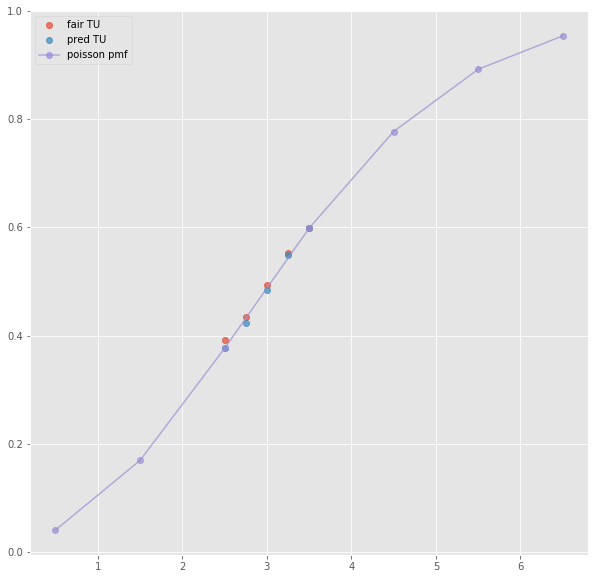

Error T1O:  0.0007127588605279622
ML : 2.62 3.75 2.55
Error home:  0.005451072962018744
Error draw:  0.02283945624723069
Error away:  0.0173881379807736

(99, 124)
next positional indexers are out-of-bounds
(252, 124)
next positional indexers are out-of-bounds
(213, 124)
next positional indexers are out-of-bounds
(557, 124)
next positional indexers are out-of-bounds
(98, 124)
(1, 48)
3.5 1.558 2.49 -2.5 1.925 1.952
TO fair:  1.62570281124498 TU fair:  2.5982028241335047
TO pred:  1.62571 TU fair:  2.59818
Error TO:  2.7200034192764733e-06

Error TO:  0.0077430634457600345

Error TO:  0.0028411315234863066

Error TO:  0.004714322119801273

Error TO:  0.006639213435398861

Error TO:  0.005671012762837102

Error TO:  0.006412759854357464

Error TO:  0.002383780456115203

Error TO:  0.00499127074379313



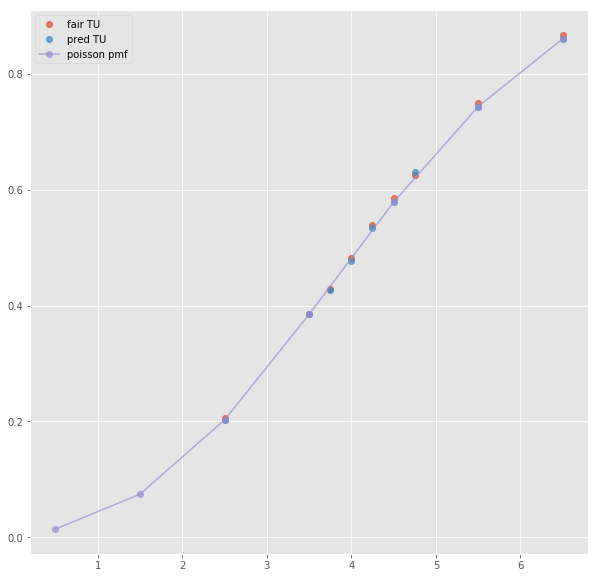

Error T1O:  0.004162283873004935
ML : 1.127 9.35 18.61
Error home:  0.010092931366885494
Error draw:  0.010009272626755772
Error away:  8.362162882775276e-05

(36, 124)
next positional indexers are out-of-bounds
(51, 124)
(1, 43)
2.5 1.84 2.04 -1.5 2.53 1.571
TO fair:  1.9019607843137256 TU fair:  2.108695652173913
TO pred:  1.90192 TU fair:  2.10874
Error TO:  0.001783645815284951

Error TO:  0.0037606581310490883

Error TO:  0.003498481624530869

Error TO:  0.004048466005809437

Error TO:  0.0018565191061292174

Error TO:  1.1274553592732772e-05

Error TO:  0.006087823506759293

Error TO:  0.0009332066386736892

Error TO:  0.0015557279373281108



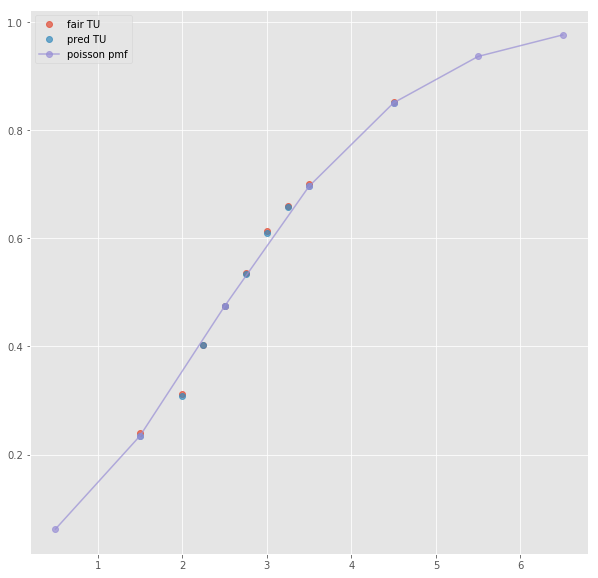

ML : 1.48 4.55 6.89
Error home:  0.017274096226736146
Error draw:  0.001357247336856271
Error away:  0.015916646996178813

(57, 124)
(1, 18)
next list index out of range
(63, 124)
(1, 18)
next list index out of range
(124, 124)
(1, 16)
next list index out of range
(52, 124)
(1, 45)
2.5 1.84 2.04 -1.5 2.53 1.571
TO fair:  1.9019607843137256 TU fair:  2.108695652173913
TO pred:  1.90192 TU fair:  2.10874
Error TO:  0.001783645815284951

Error TO:  0.0037606581310490883

Error TO:  0.003498481624530869

Error TO:  0.004048466005809437

Error TO:  0.0018565191061292174

Error TO:  1.1274553592732772e-05

Error TO:  0.006087823506759293

Error TO:  0.0009332066386736892

Error TO:  0.0015557279373281108



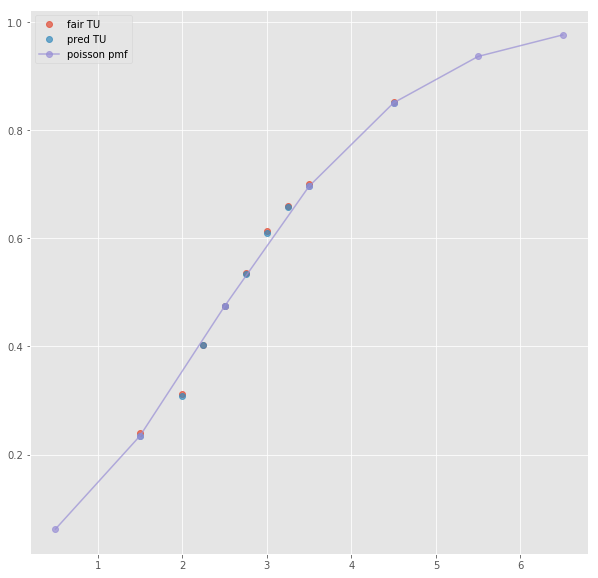

Error T1O:  0.005750367243122834
ML : 1.48 4.55 6.89
Error home:  0.017274096226736146
Error draw:  0.001357247336856271
Error away:  0.015916646996178813

(16, 124)
next positional indexers are out-of-bounds
(27, 124)
(1, 39)
2.5 2.68 1.5019999999999998 0.5 1.51 2.7
TO fair:  2.784287616511318 TU fair:  1.5604477611940295
TO pred:  2.78421 TU fair:  1.56047
Error TO:  0.00043946415407453143

Error TO:  0.003910256206585833

Error TO:  1.0012396356673392e-05

Error TO:  0.0009909395087434048

Error TO:  0.0003581643389592992

Error TO:  0.0021548221350591312

Error TO:  0.025211450656287715



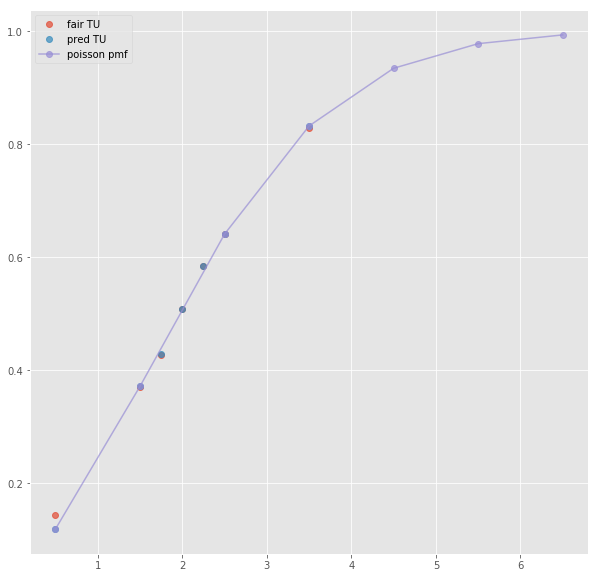

ML : 3.16 2.83 2.7
Error home:  0.040325890437454714
Error draw:  0.04294415653109013
Error away:  0.002618626414684966

(66, 124)
(1, 23)
next list index out of range
(81, 124)
(1, 21)
next list index out of range
(194, 124)
(1, 23)
next list index out of range
(24, 124)
(1, 41)
2.5 2.68 1.5019999999999998 0.5 1.51 2.7
TO fair:  2.784287616511318 TU fair:  1.5604477611940295
TO pred:  2.78421 TU fair:  1.56047
Error TO:  0.00043946415407453143

Error TO:  0.003910256206585833

Error TO:  1.0012396356673392e-05

Error TO:  0.0009909395087434048

Error TO:  0.0003581643389592992

Error TO:  0.0021548221350591312

Error TO:  0.025211450656287715



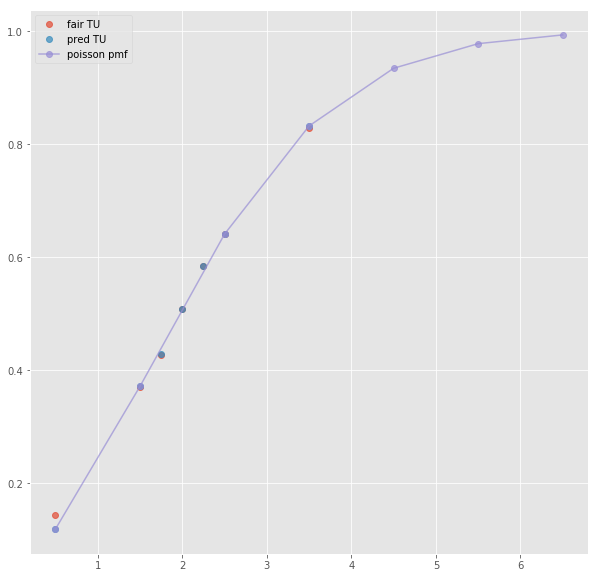

Error T1O:  0.02144174031929519
ML : 3.16 2.83 2.7
Error home:  0.040325890437454714
Error draw:  0.04294415653109013
Error away:  0.002618626414684966

(16, 124)
(1, 33)
2.5 2.61 1.52 0.5 1.53 2.58
TO fair:  2.717105263157895 TU fair:  1.5823754789272033
TO pred:  2.71718 TU fair:  1.58235
Error TO:  0.002104303010428521

Error TO:  1.0123014768492755e-05

Error TO:  0.0032117923857546415

Error TO:  0.0013429330580046472

Error TO:  0.0018679505209122649



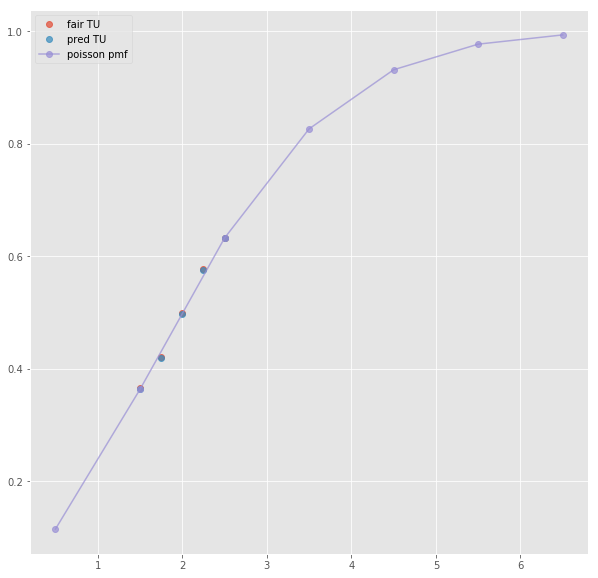

Error T1O:  0.0025118781202887464
ML : 3.12 2.95 2.63
Error home:  0.02564936301167009
Error draw:  0.032226931102778245
Error away:  0.006577616819637089

(23, 124)
next positional indexers are out-of-bounds
(34, 124)
next positional indexers are out-of-bounds
(50, 124)
next positional indexers are out-of-bounds
(69, 124)
next positional indexers are out-of-bounds
(16, 124)
(1, 49)
2.5 1.847 2.03 0.5 1.769 2.15
TO fair:  1.9098522167487686 TU fair:  2.0990795885219273
TO pred:  1.90984 TU fair:  2.09909
Error TO:  0.0006198140657173168

Error TO:  0.0077537952295829715

Error TO:  0.002598971139740114

Error TO:  0.004614305171444677

Error TO:  0.00788458356202168

Error TO:  3.349337367675176e-06

Error TO:  0.007413757874723981

Error TO:  0.0029386622095017856

Error TO:  0.007069735898850904



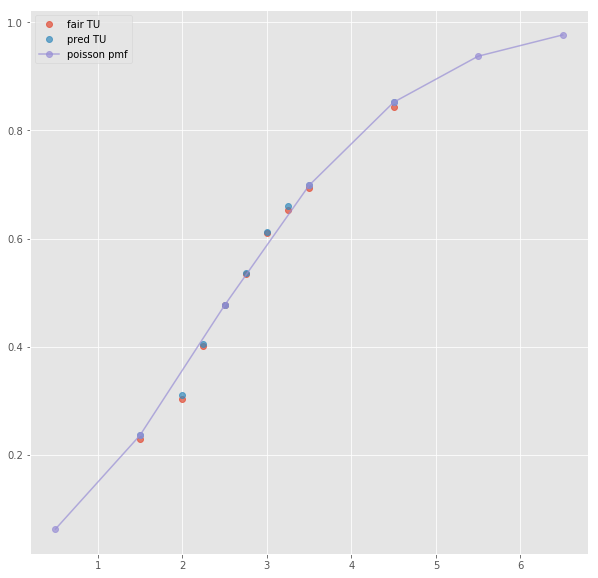

Error T1O:  0.0009142521848287677
ML : 3.53 3.49 2.15
Error home:  0.02468420340585975
Error draw:  0.026641783564471166
Error away:  0.0019577479145245213

(15, 124)
(1, 10)
next list index out of range
(8, 124)
next positional indexers are out-of-bounds
(227, 124)
(1, 49)
3.5 2.0 1.892 1.5 1.689 2.3
TO fair:  2.0570824524312896 TU fair:  1.946
TO pred:  2.0571 TU fair:  1.94599
Error TO:  0.013142647575226318

Error TO:  0.001110986315631446

Error TO:  4.1467690449215056e-06

Error TO:  0.00427900633845435

Error TO:  0.0023731669750957085

Error TO:  0.007849350329852345

Error TO:  5.238429463427785e-05

Error TO:  0.002234125894817196

Error TO:  0.007082560070656052

Error TO:  0.0010149591739487263



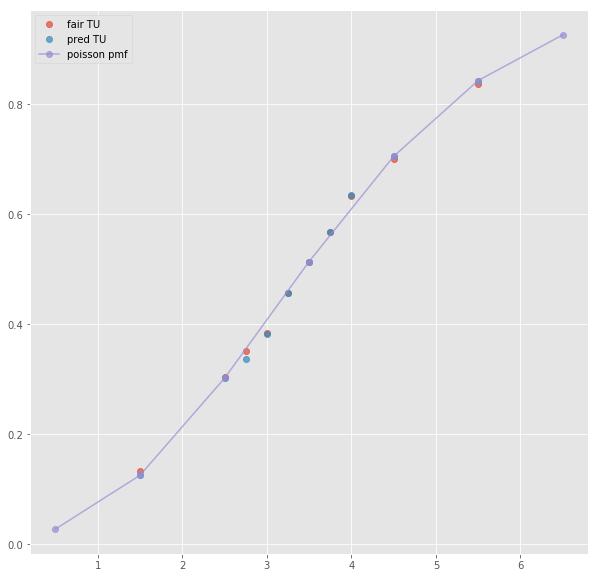

ML : 6.29 4.81 1.5
Error home:  0.02128248005109773
Error draw:  0.017400784770599004
Error away:  0.0038815976052797296

(233, 124)
(1, 28)
3.5 2.01 1.83 1.5 1.66 2.26
TO fair:  2.098360655737705 TU fair:  1.91044776119403
TO pred:  2.09839 TU fair:  1.91043
Error TO:  0.008191744980341031

Error TO:  6.664335514439124e-06

Error TO:  0.014451102828209272

Error TO:  0.0037631966354133572



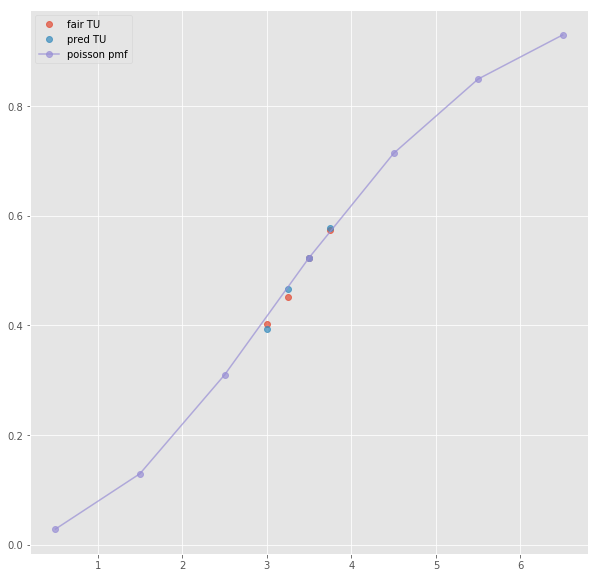

ML : 5.56 4.86 1.48
Error home:  0.0034165097415835843
Error draw:  0.009383238988223408
Error away:  0.005966611286994161

(283, 124)
(1, 28)
3.5 2.01 1.91 1.5 1.71 2.31
TO fair:  2.0523560209424083 TU fair:  1.9502487562189055
TO pred:  2.05238 TU fair:  1.95023
Error TO:  0.019358102175945247

Error TO:  5.692743775209674e-06

Error TO:  0.009402937615124118

Error TO:  0.011904029459282817



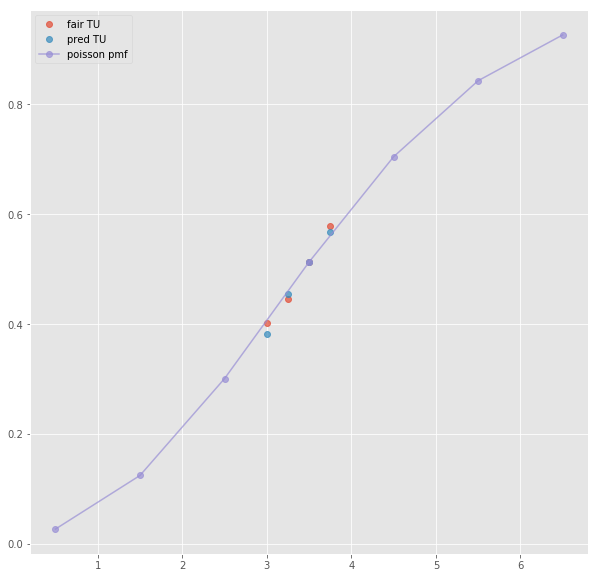

ML : 5.9 5.0 1.48
Error home:  0.011787589605561949
Error draw:  0.008224535935225818
Error away:  0.0035629889352389865

(533, 124)
(1, 28)
3.5 2.03 1.89 1.5 1.7 2.33
TO fair:  2.074074074074074 TU fair:  1.9310344827586206
TO pred:  2.07411 TU fair:  1.93101
Error TO:  0.010084539213304211

Error TO:  8.351258405536743e-06

Error TO:  0.0049541235505973225

Error TO:  0.00033714502329162954



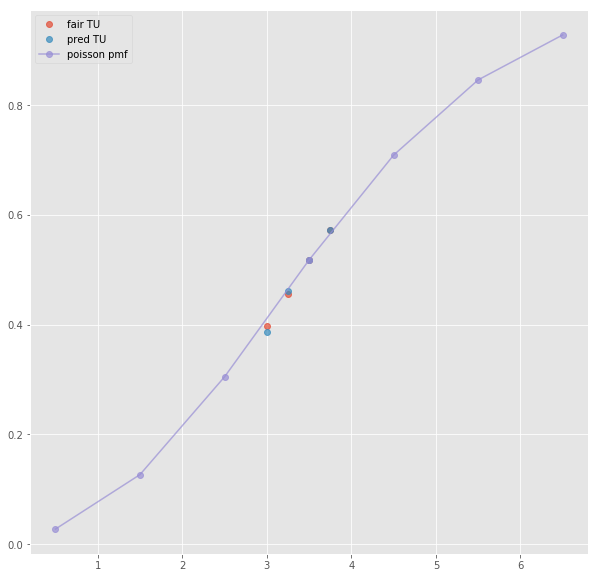

ML : 5.9 4.8 1.51
Error home:  0.01237122803929025
Error draw:  0.015813802342380834
Error away:  0.003442583840379654

(203, 124)
(1, 51)
3.5 2.0 1.892 1.5 1.689 2.3
TO fair:  2.0570824524312896 TU fair:  1.946
TO pred:  2.0571 TU fair:  1.94599
Error TO:  0.013142647575226318

Error TO:  0.001110986315631446

Error TO:  4.1467690449215056e-06

Error TO:  0.00427900633845435

Error TO:  0.0023731669750957085

Error TO:  0.007849350329852345

Error TO:  5.238429463427785e-05

Error TO:  0.002234125894817196

Error TO:  0.007082560070656052

Error TO:  0.0010149591739487263



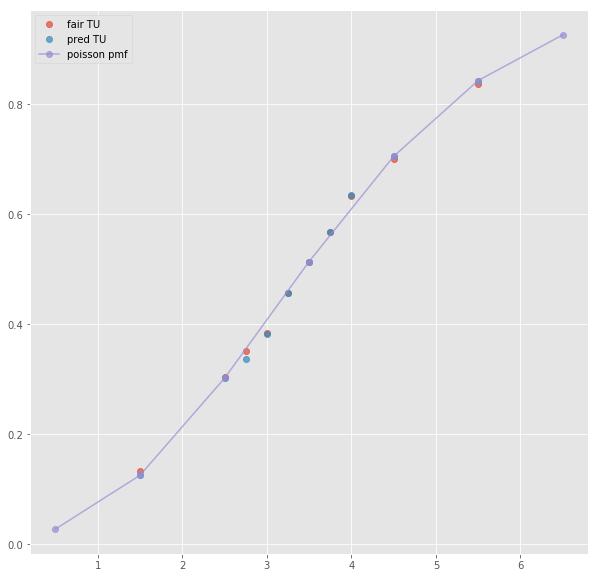

Error T1O:  0.012618404901331648
ML : 6.29 4.81 1.5
Error home:  0.02128248005109773
Error draw:  0.017400784770599004
Error away:  0.0038815976052797296

(156, 124)
(1, 75)
3.5 2.0 1.8 1.5 1.65 2.2
TO fair:  2.111111111111111 TU fair:  1.9000000000000001
TO pred:  2.11109 TU fair:  1.90001
Error TO:  0.012462773864315602

Error TO:  0.013070785644421656

Error TO:  0.004122950029994521

Error TO:  4.736889474221684e-06

Error TO:  0.0028387769417410613

Error TO:  0.0173494650677376

Error TO:  0.013065532525959545

Error TO:  0.02070696707858377

Error TO:  0.0023738714564696117

Error TO:  0.016801460473046315

Error TO:  0.011764277201474993

Error TO:  0.016662274301390945

Error TO:  0.01598225030222905

Error TO:  0.010143879301584613

Error TO:  0.015670264351993646

Error TO:  0.017639845519538844

Error TO:  0.021414242364053093



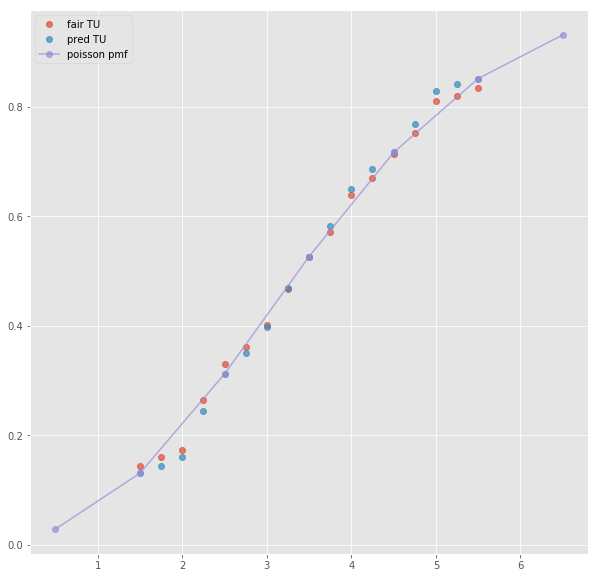

ML : 5.5 4.0 1.57
Error home:  0.0015393601891800224
Error draw:  0.050606096568050596
Error away:  0.05214544118664777

(83, 124)
next positional indexers are out-of-bounds
(27, 124)
(1, 45)
2.5 2.31 1.671 0.5 1.571 2.56
TO fair:  2.3824057450628366 TU fair:  1.7233766233766235
TO pred:  2.3824 TU fair:  1.72338
Error TO:  0.005855255430840811

Error TO:  0.0013589274401577534

Error TO:  0.05686374322484766

Error TO:  0.018708761308994654

Error TO:  0.02854456619331998

Error TO:  1.0121954366892894e-06

Error TO:  0.0014082501535791492

Error TO:  0.0005356948726446542

Error TO:  0.001700896143788988



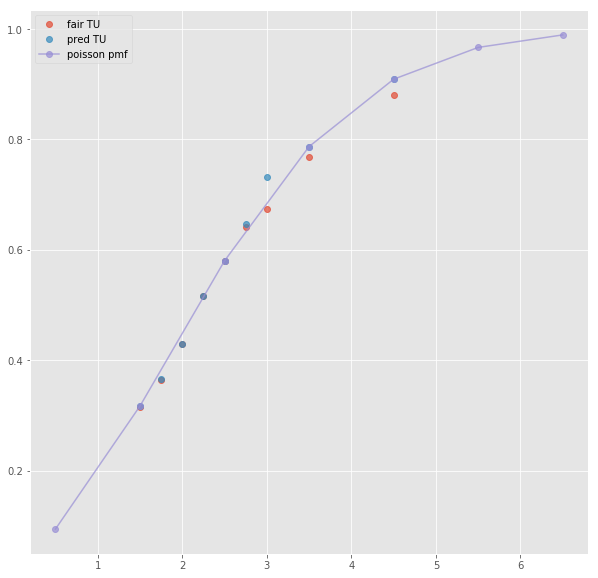

ML : 3.04 3.18 2.56
Error home:  0.02246160003860087
Error draw:  0.025002733175772673
Error away:  0.0025410064057065362

(199, 124)
(1, 27)
2.5 2.21 1.64 0.5 1.51 2.49
TO fair:  2.347560975609756 TU fair:  1.742081447963801
TO pred:  2.34756 TU fair:  1.74208
Error TO:  0.008349419431286753

Error TO:  1.7702824023357877e-07

Error TO:  0.0032706665592885376

Error TO:  0.011837924084444063



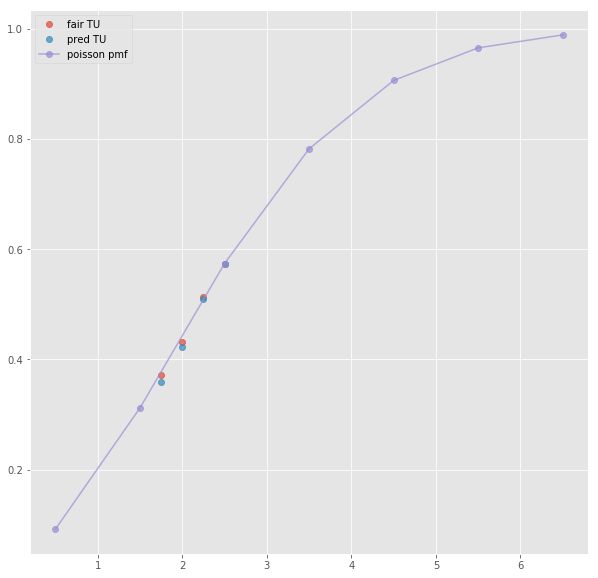

ML : 2.88 3.11 2.53
Error home:  0.01860249564680372
Error draw:  0.024639543963973998
Error away:  0.006036726690788308

(50, 124)
(1, 19)
next list index out of range
(108, 124)
(1, 23)
next list index out of range
(25, 124)
(1, 47)
2.5 2.31 1.671 0.5 1.571 2.56
TO fair:  2.3824057450628366 TU fair:  1.7233766233766235
TO pred:  2.3824 TU fair:  1.72338
Error TO:  0.005855255430840811

Error TO:  0.0013589274401577534

Error TO:  0.07158678204189156

Error TO:  0.018708761308994654

Error TO:  0.02854456619331998

Error TO:  1.0121954366892894e-06

Error TO:  0.0014082501535791492

Error TO:  0.0005356948726446542

Error TO:  0.001700896143788988



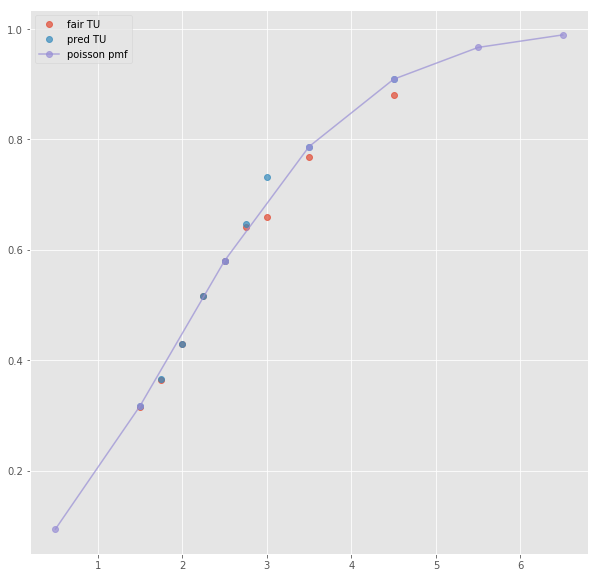

Error T1O:  0.00026956385121829074
ML : 3.04 3.18 2.56
Error home:  0.02246160003860087
Error draw:  0.025002733175772673
Error away:  0.0025410064057065362

(73, 124)
(1, 66)
2.5 2.15 1.675 -0.5 2.75 1.425
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.0019828906081326148

Error TO:  0.015336591097173724

Error TO:  0.02012281955881773

Error TO:  0.040219053528765106

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.036149226165136494

Error TO:  0.01953264469851873

Error TO:  0.014687662129951318

Error TO:  0.021645654202264566

Error TO:  0.029437934475323377

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.027687276980177478



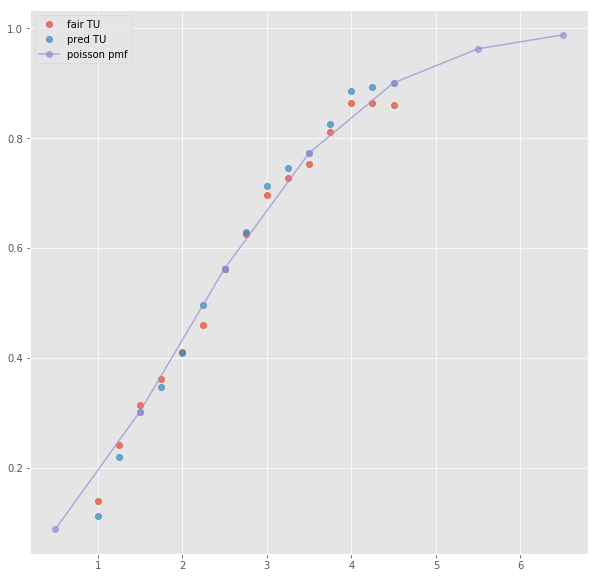

ML : 2.9 3.25 2.5
Error home:  0.013698093903700248
Error draw:  0.018026410611178434
Error away:  0.004328179189371784

(13, 124)
(1, 33)
2.5 2.25 1.68 -0.5 2.96 1.43
TO fair:  2.339285714285714 TU fair:  1.7466666666666664
TO pred:  2.33928 TU fair:  1.74667
Error TO:  0.005394930183368951

Error TO:  0.0018169000850077888

Error TO:  1.0442307425972963e-06

Error TO:  0.000938534696496518

Error TO:  0.002129775923835675



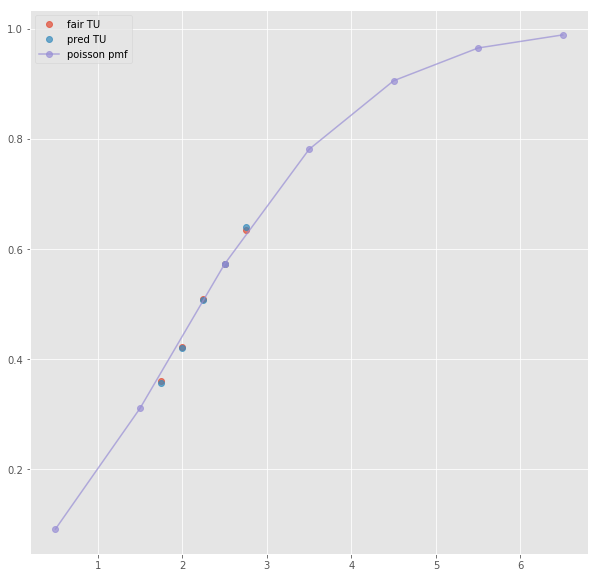

Error T1O:  0.00986900114074718
ML : 3.02 3.18 2.54
Error home:  0.007130033544520908
Error draw:  0.02618305625121059
Error away:  0.019052686388738527

(21, 124)
(1, 17)
2.5 1.975 1.875 -0.5 1.925 1.925
TO fair:  2.0533333333333332 TU fair:  1.9493670886075947
TO pred:  2.05329 TU fair:  1.94941
Error TO:  1.0278088386828088e-05



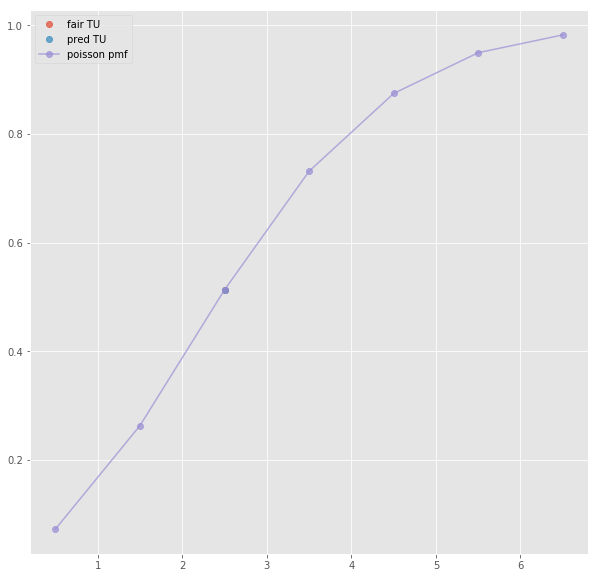

ML : 1.83 3.6 3.6
Error home:  0.004122231604954729
Error draw:  0.0008268781633173905
Error away:  0.0032950447927732607

(42, 124)
(1, 35)
2.5 2.0 1.85 -0.5 1.93 1.92
TO fair:  2.0810810810810807 TU fair:  1.9249999999999998
TO pred:  2.0811 TU fair:  1.92499
Error TO:  0.004168191546361333

Error TO:  0.004771622427529598

Error TO:  0.008888507777497612

Error TO:  4.368319201975002e-06

Error TO:  0.0005962216876139736



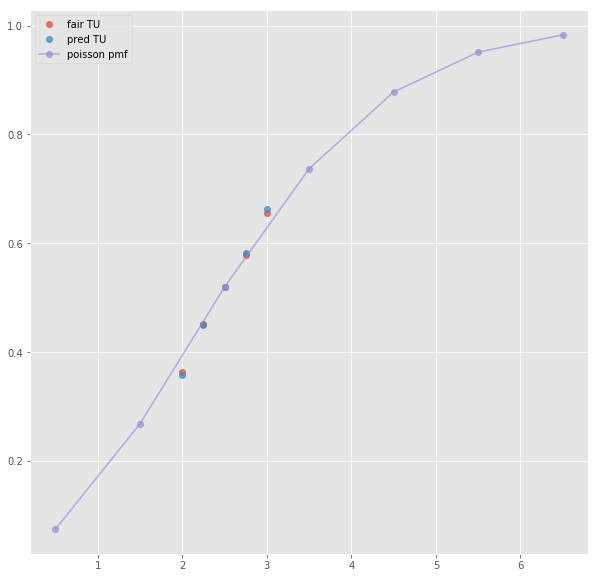

Error T1O:  0.004219264818663415
ML : 1.94 3.66 3.97
Error home:  0.0033448565471704272
Error draw:  0.00975334371645703
Error away:  0.006408191746583469

(237, 124)
(1, 45)
2.5 2.04 1.877 -0.5 2.27 1.714
TO fair:  2.086840703249867 TU fair:  1.9200980392156863
TO pred:  2.08686 TU fair:  1.92009
Error TO:  0.0019229587414927862

Error TO:  0.006019823117267453

Error TO:  0.004220230657271895

Error TO:  0.005615291220818219

Error TO:  0.0032558563165811655

Error TO:  4.43099805769176e-06

Error TO:  0.005893513277970608

Error TO:  0.0027578057956492152

Error TO:  0.012104148302130024



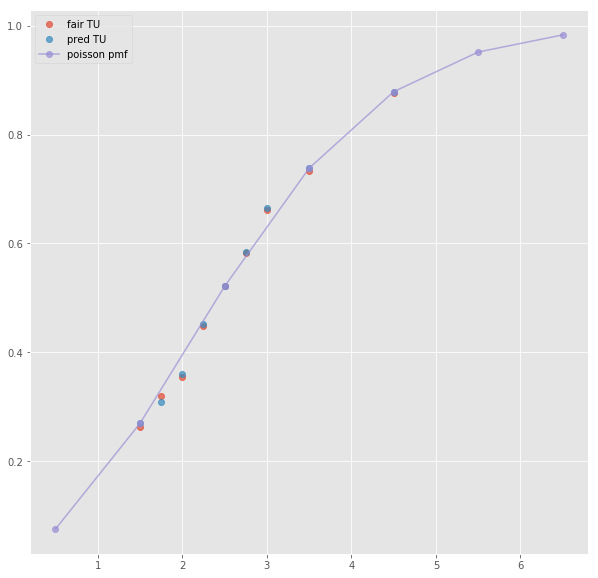

ML : 2.27 3.41 3.41
Error home:  0.001276628420412873
Error draw:  0.023744206755789088
Error away:  0.02246761410082132

(2561, 124)
(1, 27)
2.5 2.0 1.84 -0.5 2.2 1.7
TO fair:  2.0869565217391304 TU fair:  1.92
TO pred:  2.08696 TU fair:  1.91999
Error TO:  0.013243860793377082

Error TO:  0.008530534222999764

Error TO:  7.986097800838365e-07

Error TO:  0.0025329526510716738



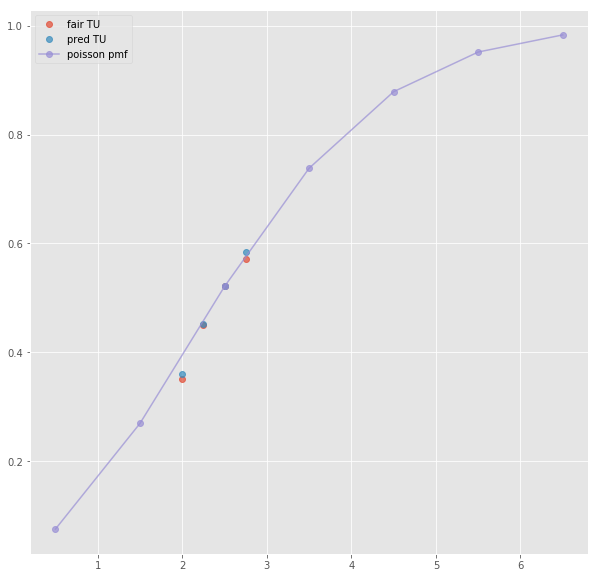

ML : 2.22 3.36 3.21
Error home:  0.010766499749248148
Error draw:  0.019584609121817254
Error away:  0.008817948915533724

(312, 124)
(1, 23)
2.5 2.03 1.89 -0.5 2.26 1.74
TO fair:  2.074074074074074 TU fair:  1.9310344827586206
TO pred:  2.07411 TU fair:  1.931
Error TO:  0.005727575558704068

Error TO:  8.351258405536743e-06

Error TO:  0.003132072232639449



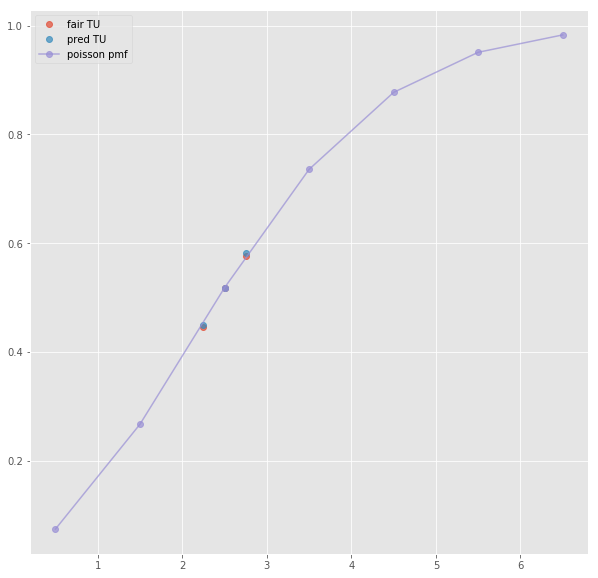

ML : 2.24 3.35 3.3
Error home:  0.009020102588644496
Error draw:  0.02413454928453146
Error away:  0.01511472401647207

(812, 124)
(1, 27)
2.5 2.0 1.92 -0.5 2.26 1.74
TO fair:  2.041666666666667 TU fair:  1.9600000000000002
TO pred:  2.04165 TU fair:  1.96002
Error TO:  4.8621730642128824e-05

Error TO:  0.007740427826934293

Error TO:  3.998366667257169e-06

Error TO:  0.0025254841248960602



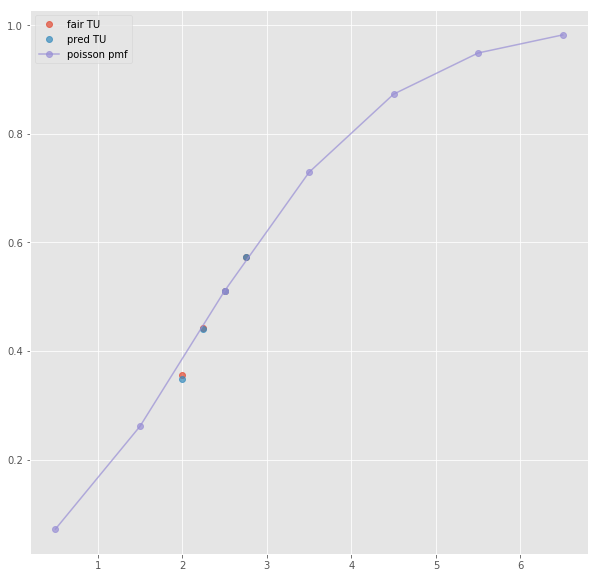

ML : 2.25 3.4 3.35
Error home:  0.0064440102275283295
Error draw:  0.02459758543574808
Error away:  0.018153541249690652

(237, 124)
(1, 47)
2.5 2.04 1.877 -0.5 2.27 1.714
TO fair:  2.086840703249867 TU fair:  1.9200980392156863
TO pred:  2.08686 TU fair:  1.92009
Error TO:  0.0019229587414927862

Error TO:  0.006019823117267453

Error TO:  0.004220230657271895

Error TO:  0.005615291220818219

Error TO:  0.0032558563165811655

Error TO:  4.43099805769176e-06

Error TO:  0.005893513277970608

Error TO:  0.0027578057956492152

Error TO:  0.012104148302130024



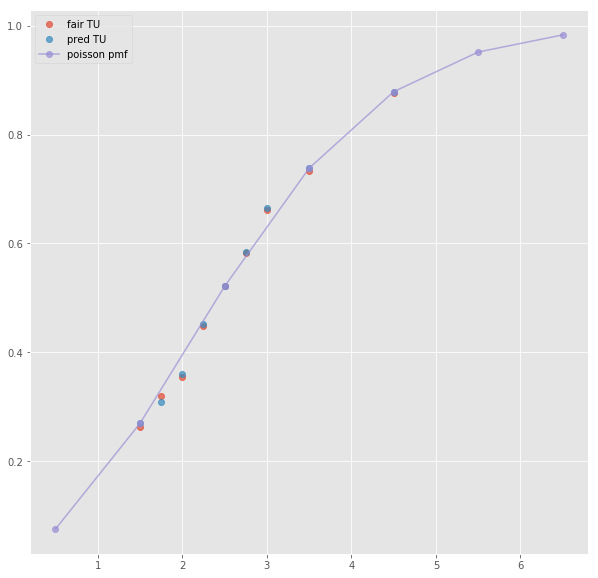

Error T1O:  0.009568705058349836
ML : 2.27 3.41 3.41
Error home:  0.001276628420412873
Error draw:  0.023744206755789088
Error away:  0.02246761410082132

(133, 124)
(1, 64)
2.5 2.025 1.775 -0.5 2.15 1.675
TO fair:  2.1408450704225355 TU fair:  1.8765432098765433
TO pred:  2.14082 TU fair:  1.87656
Error TO:  0.03515203148386775

Error TO:  0.022114663705643967

Error TO:  0.04124169510872766

Error TO:  0.0348812450460968

Error TO:  0.033760555663199146

Error TO:  5.470112534378124e-06

Error TO:  0.004945185325803236

Error TO:  0.02694867364674791

Error TO:  0.047421363659133964

Error TO:  0.015843041611869002

Error TO:  0.04013144052989909

Error TO:  0.03770243875892722

Error TO:  0.044672961764348595

Error TO:  0.003914629241964174



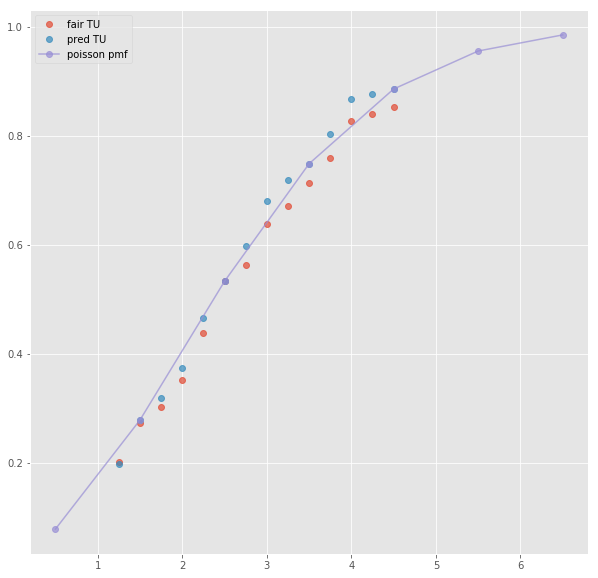

ML : 2.15 3.5 3.25
Error home:  0.001511533579709734
Error draw:  0.006080290278357714
Error away:  0.007591575706496878

(59, 124)
next positional indexers are out-of-bounds
(29, 124)
(1, 43)
3.5 2.39 1.6130000000000002 -0.5 2.59 1.546
TO fair:  2.4817110973341596 TU fair:  1.6748953974895398
TO pred:  2.48174 TU fair:  1.67488
Error TO:  0.0005286479469925887

Error TO:  8.302290300576942e-05

Error TO:  4.692782201609624e-06

Error TO:  0.011368378943967361

Error TO:  0.00010485398181747652

Error TO:  0.006644309692328543

Error TO:  0.00045531645908702956

Error TO:  0.015423887324061358



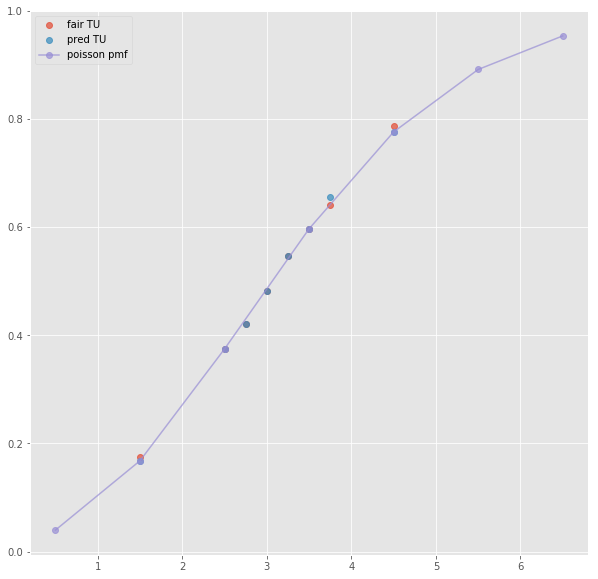

ML : 2.59 3.76 2.58
Error home:  0.002420383982354335
Error draw:  0.022613531350908128
Error away:  0.020192968307691517

(247, 124)
(1, 23)
next list index out of range
(53, 124)
(1, 21)
next list index out of range
(87, 124)
(1, 27)
3.5 2.36 1.63 -0.5 2.58 1.55
TO fair:  2.447852760736196 TU fair:  1.6906779661016949
TO pred:  2.44785 TU fair:  1.69068
Error TO:  0.005969241430128558

Error TO:  0.01216898738948291

Error TO:  4.6073883153141537e-07

Error TO:  0.001688628465225217



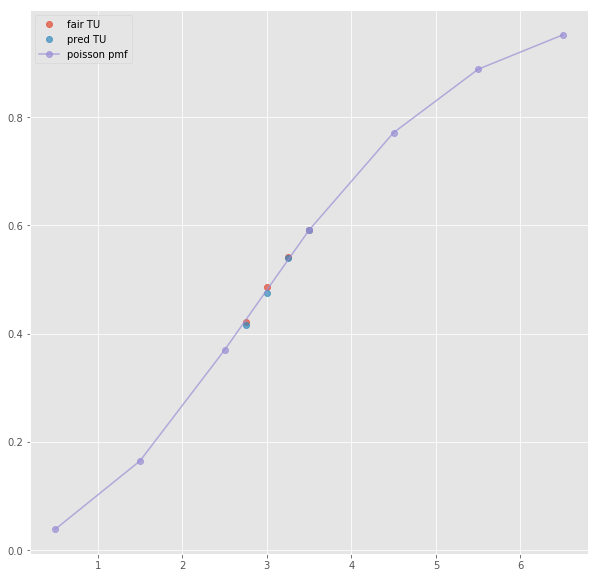

ML : 2.56 3.65 2.58
Error home:  0.004068303185074229
Error draw:  0.028186283190453604
Error away:  0.024117773804245957

(20, 124)
(1, 45)
3.5 2.42 1.602 -0.5 2.54 1.568
TO fair:  2.510611735330836 TU fair:  1.6619834710743802
TO pred:  2.51056 TU fair:  1.66201
Error TO:  0.00038533459115486224

Error TO:  0.0002747830124865125

Error TO:  8.207994770692562e-06

Error TO:  0.00953103115514009

Error TO:  0.00015555353491736312

Error TO:  0.006189132209672765

Error TO:  0.0006659341786696138

Error TO:  0.020175521445308875



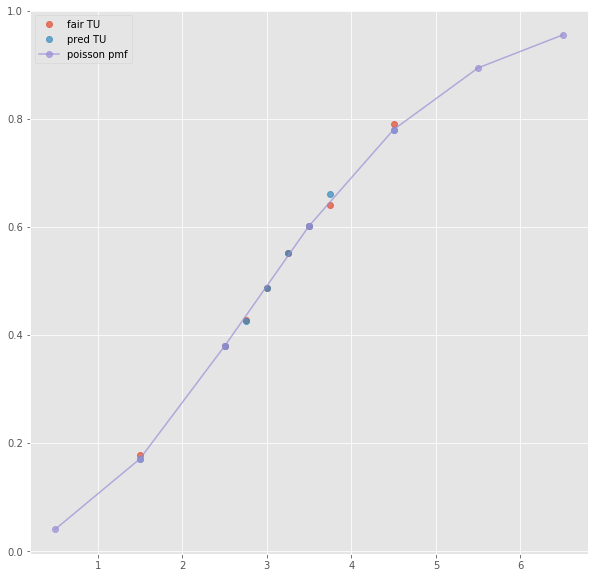

Error T1O:  0.004150740000097131
ML : 2.54 3.73 2.65
Error home:  0.0028119432668455846
Error draw:  0.023881448256428073
Error away:  0.02106953320288918

(10, 124)
(1, 67)
3.5 2.3 1.6 -0.5 2.5 1.5
TO fair:  2.4375 TU fair:  1.695652173913044
TO pred:  2.43748 TU fair:  1.69566
Error TO:  0.014658884541608352

Error TO:  0.02130526186775583

Error TO:  0.007650936561988342

Error TO:  3.3662340635509658e-06

Error TO:  0.011542256861178046

Error TO:  0.018047384258231602

Error TO:  0.017122596355001685

Error TO:  0.018109589399205928

Error TO:  0.0008836608170404991

Error TO:  0.01992916815775503

Error TO:  0.006171075586141439

Error TO:  0.011750232278970374

Error TO:  0.0002210182186546117

Error TO:  0.015087408807303249

Error TO:  0.01695910073365836



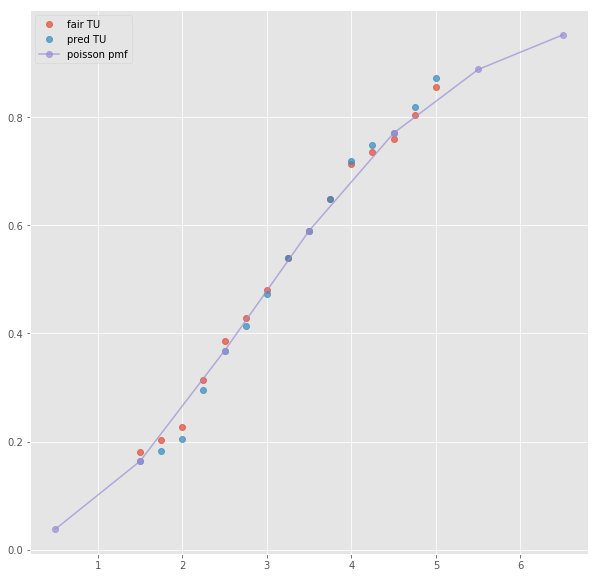

ML : 2.55 3.5 2.6
Error home:  0.0059004161847548975
Error draw:  0.03703444102029391
Error away:  0.031134127527384203

(9, 124)
(1, 35)
3.5 2.32 1.64 -0.5 2.53 1.55
TO fair:  2.4146341463414633 TU fair:  1.7068965517241377
TO pred:  2.41465 TU fair:  1.70689
Error TO:  0.01148527935557997

Error TO:  0.00981999607362627

Error TO:  2.719092442260429e-06

Error TO:  0.014507080780812531

Error TO:  0.0031558009960479527

Error TO:  0.011403206527560772



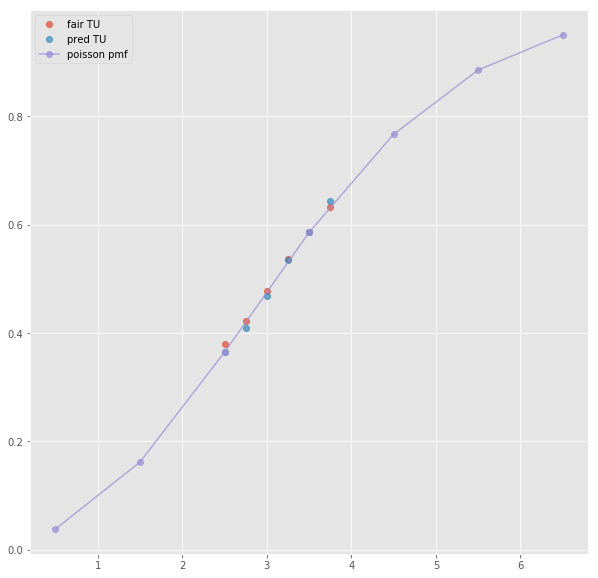

Error T1O:  0.002000914909289886
ML : 2.57 3.74 2.61
Error home:  0.005629230780828276
Error draw:  0.025967922336577465
Error away:  0.020338678915947705

(24, 124)
(1, 35)
2.5 2.1 1.78 -0.5 2.81 1.46
TO fair:  2.179775280898877 TU fair:  1.847619047619048
TO pred:  2.17977 TU fair:  1.84762
Error TO:  0.005152849805664217

Error TO:  9.356777312574671e-05

Error TO:  0.021324998984162014

Error TO:  1.1114385520261116e-06

Error TO:  0.00019861158345502172

Error TO:  0.0008748228562425187



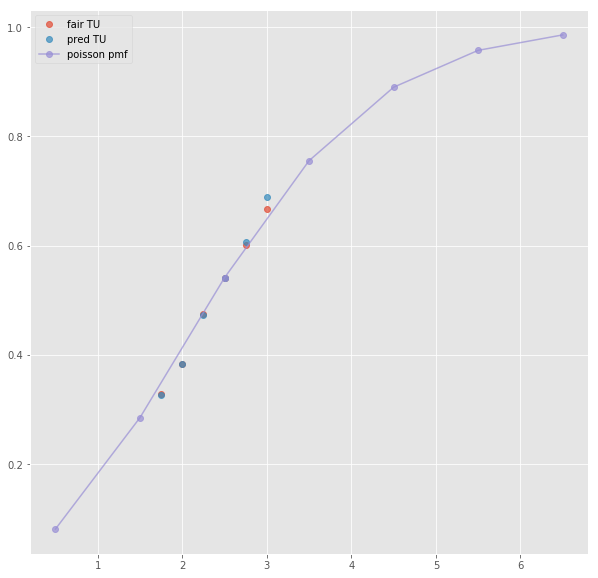

Error T1O:  0.014578443336402236
ML : 2.87 3.17 2.66
Error home:  0.006830763175873056
Error draw:  0.034368282254689075
Error away:  0.02753784839309059

(100, 124)
(1, 44)
2.5 2.07 1.833 -0.5 1.719 2.25
TO fair:  2.1292962356792144 TU fair:  1.8855072463768119
TO pred:  2.12929 TU fair:  1.88552
Error TO:  0.0013156277040241582

Error TO:  0.002756742763855624

Error TO:  0.004091535450736317

Error TO:  0.005137666425129861

Error TO:  0.0061298951379271105

Error TO:  1.3753488372625355e-06

Error TO:  0.001403915116658827

Error TO:  0.0005871106254611291

Error TO:  0.006539099847975294



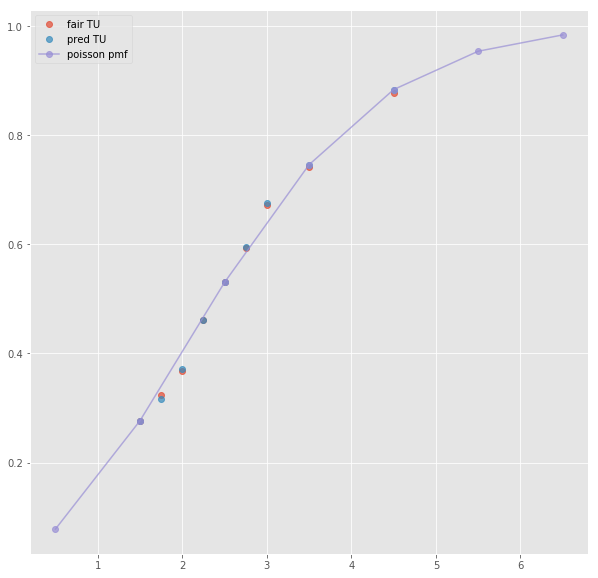

ML : 1.719 3.63 5.72
Error home:  0.0032043437659822205
Error draw:  0.026097328135879422
Error away:  0.022893145583955776

(196, 124)
(1, 26)
2.5 2.12 1.77 -0.5 1.74 2.2
TO fair:  2.1977401129943503 TU fair:  1.8349056603773586
TO pred:  2.19776 TU fair:  1.83489
Error TO:  0.008640292374373693

Error TO:  0.015261054589575829

Error TO:  4.117302702610903e-06

Error TO:  0.003748994834328445



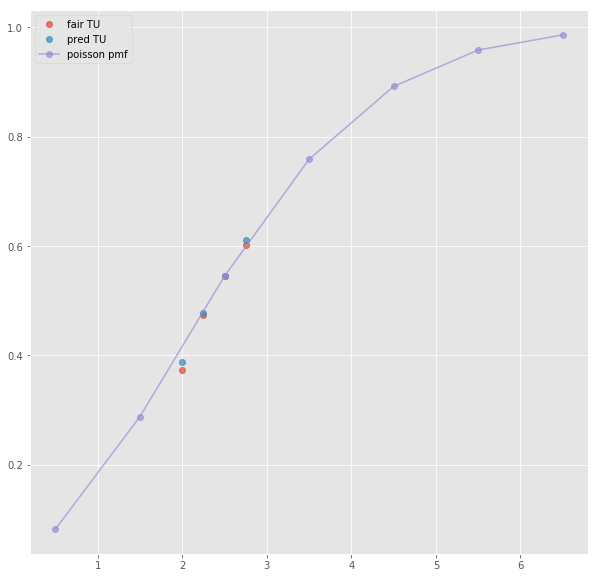

ML : 1.73 3.63 5.18
Error home:  0.0060540708549863265
Error draw:  0.017349085901018607
Error away:  0.011294813340056553

(187, 124)
(1, 23)
2.5 2.13 1.8 -0.5 1.72 2.29
TO fair:  2.183333333333333 TU fair:  1.8450704225352113
TO pred:  2.18334 TU fair:  1.84507
Error TO:  0.01490933822359003

Error TO:  1.3985156295248657e-06

Error TO:  0.011605582847249662



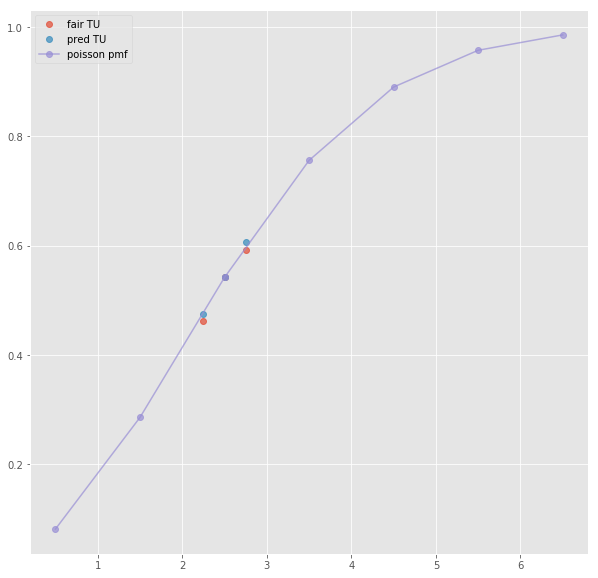

ML : 1.69 3.75 5.5
Error home:  0.002215266462283094
Error draw:  0.014261656945690426
Error away:  0.012046238029232631

(405, 124)
(1, 26)
2.5 2.11 1.82 -0.5 1.73 2.28
TO fair:  2.1593406593406588 TU fair:  1.862559241706161
TO pred:  2.15933 TU fair:  1.86257
Error TO:  0.005988686493030859

Error TO:  0.010506574769108323

Error TO:  2.2860733505658537e-06

Error TO:  0.0060819368407291075



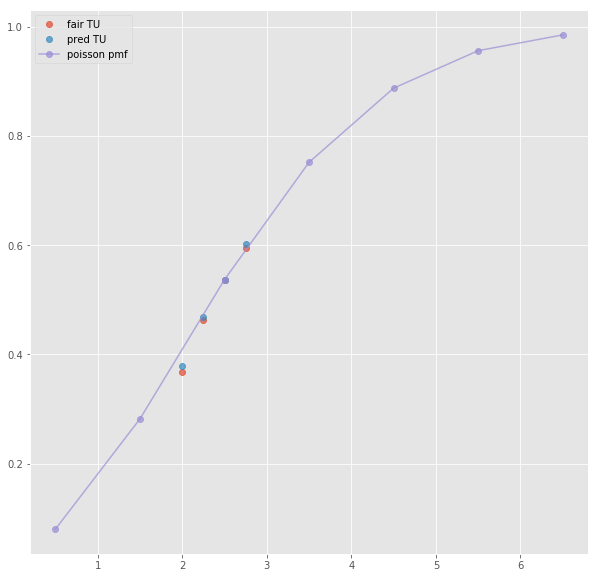

ML : 1.72 3.65 5.4
Error home:  0.009839126455572389
Error draw:  0.02158578952607057
Error away:  0.01174677815310593

(72, 124)
(1, 46)
2.5 2.07 1.833 -0.5 1.719 2.25
TO fair:  2.1292962356792144 TU fair:  1.8855072463768119
TO pred:  2.12929 TU fair:  1.88552
Error TO:  0.0013156277040241582

Error TO:  0.002756742763855624

Error TO:  0.004091535450736317

Error TO:  0.005137666425129861

Error TO:  0.0061298951379271105

Error TO:  1.3753488372625355e-06

Error TO:  0.001403915116658827

Error TO:  0.0005871106254611291

Error TO:  0.006539099847975294



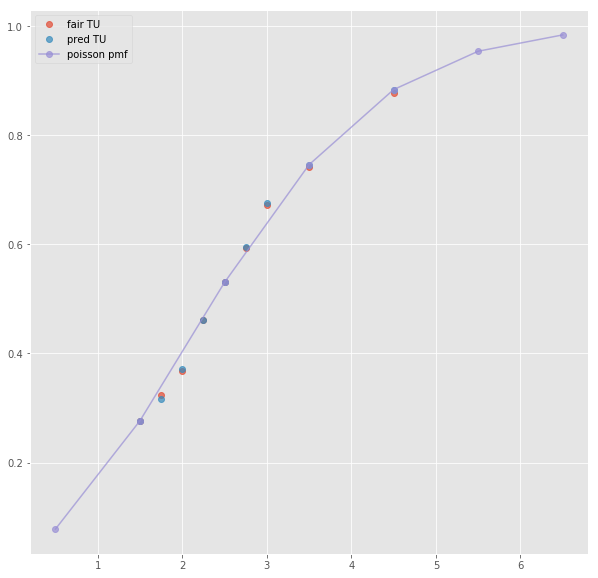

Error T1O:  0.003785931854676017
ML : 1.719 3.63 5.72
Error home:  0.0032043437659822205
Error draw:  0.026097328135879422
Error away:  0.022893145583955776

(45, 124)
(1, 12)
next list index out of range
(64, 124)
next positional indexers are out-of-bounds
(62, 124)
(1, 47)
2.5 1.74 2.17 -0.5 1.925 1.98
TO fair:  1.80184331797235 TU fair:  2.247126436781609
TO pred:  1.80185 TU fair:  2.24712
Error TO:  0.0035767442440812758

Error TO:  0.029822081544487622

Error TO:  0.009647635772708552

Error TO:  0.011827243143646249

Error TO:  0.013381424365689537

Error TO:  2.05812908826708e-06

Error TO:  0.006774069102309377

Error TO:  0.0021783412987730344

Error TO:  0.011363561719207438



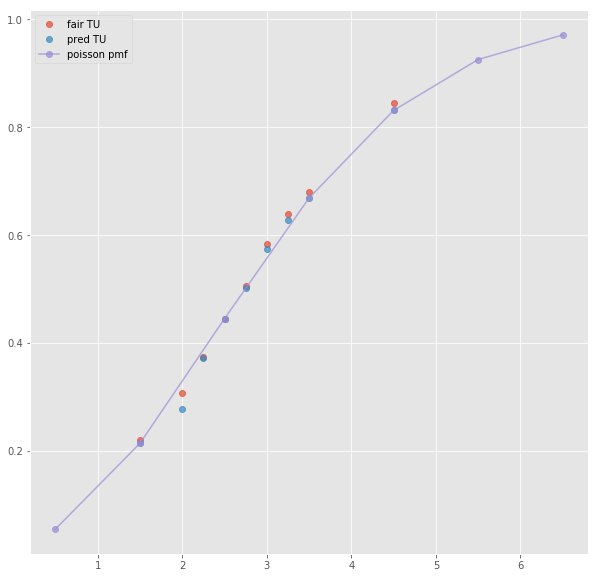

ML : 1.925 3.88 3.85
Error home:  0.006066745493332526
Error draw:  0.011900827269997027
Error away:  0.005834061388567069

(67, 124)
(1, 23)
2.5 1.73 2.09 -0.5 1.88 1.96
TO fair:  1.8277511961722492 TU fair:  2.208092485549133
TO pred:  1.82777 TU fair:  2.20806
Error TO:  0.009832754935984123

Error TO:  0.01066894678459318

Error TO:  5.6286940451899525e-06



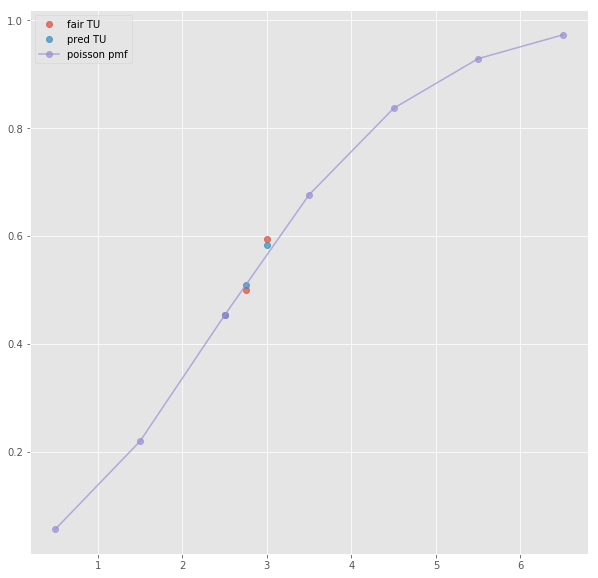

ML : 1.87 3.56 3.96
Error home:  0.009792623699711123
Error draw:  0.025392220660486492
Error away:  0.01559971750131045

(117, 124)
(1, 19)
2.5 1.77 2.14 -0.5 1.9 2.02
TO fair:  1.8271028037383177 TU fair:  2.209039548022599
TO pred:  1.82709 TU fair:  2.20906
Error TO:  0.007040295303657351

Error TO:  3.83542826798422e-06



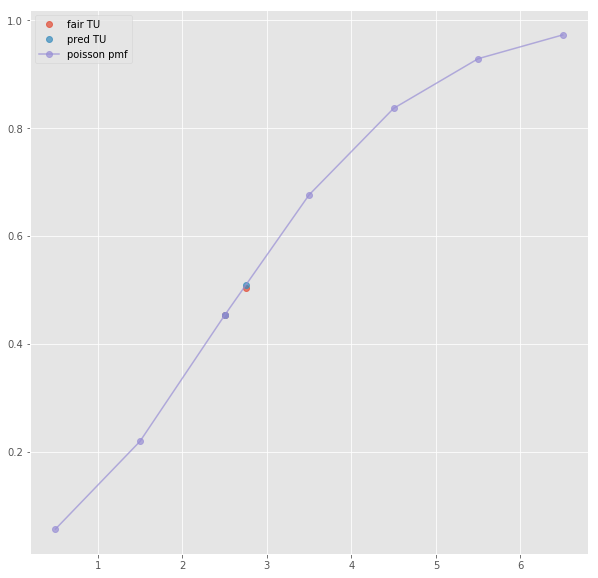

ML : 1.89 3.85 3.95
Error home:  0.0075517181551671975
Error draw:  0.012565285399533582
Error away:  0.005013841227421267

(336, 124)
(1, 25)
2.5 1.77 2.14 -0.5 1.9 2.02
TO fair:  1.8271028037383177 TU fair:  2.209039548022599
TO pred:  1.82709 TU fair:  2.20906
Error TO:  0.012168500431862461

Error TO:  0.0010400922586775163

Error TO:  3.83542826798422e-06

Error TO:  0.009763569812480055



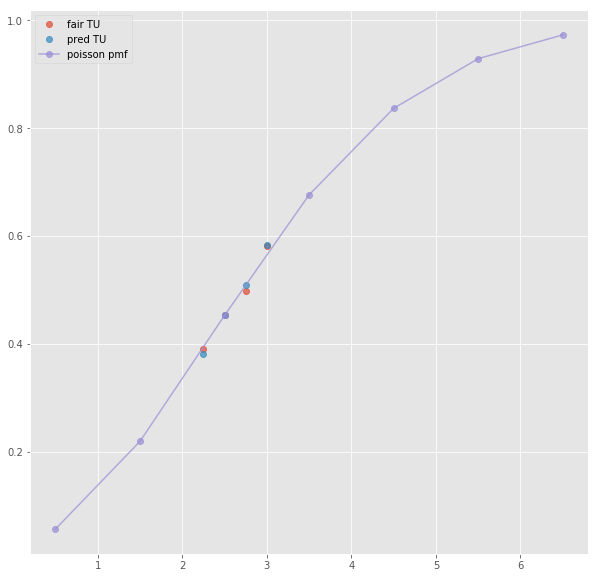

ML : 1.89 3.7 4.0
Error home:  0.011115726972797058
Error draw:  0.020850275645384247
Error away:  0.009734822655642184

(57, 124)
(1, 49)
2.5 1.74 2.17 -0.5 1.925 1.98
TO fair:  1.80184331797235 TU fair:  2.247126436781609
TO pred:  1.80185 TU fair:  2.24712
Error TO:  0.0035767442440812758

Error TO:  0.029822081544487622

Error TO:  0.009647635772708552

Error TO:  0.011827243143646249

Error TO:  0.013381424365689537

Error TO:  2.05812908826708e-06

Error TO:  0.006774069102309377

Error TO:  0.0021783412987730344

Error TO:  0.011363561719207438



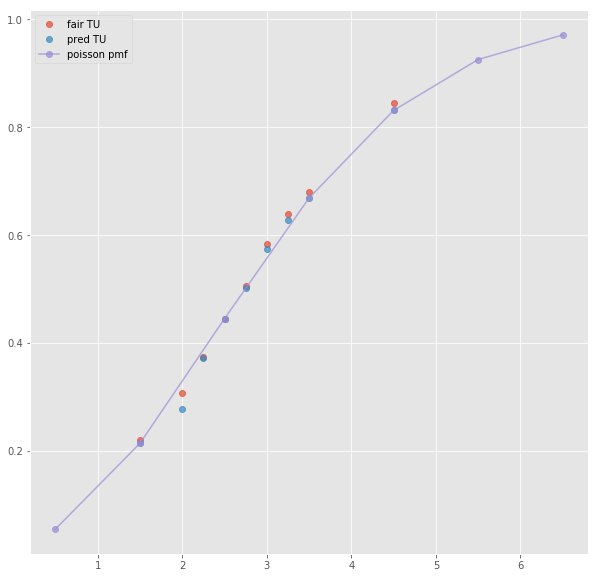

Error T1O:  0.00468305615621023
ML : 1.925 3.88 3.85
Error home:  0.006066745493332526
Error draw:  0.011900827269997027
Error away:  0.005834061388567069

(91, 124)
(1, 71)
3.5 2.75 1.425 -0.5 1.925 1.925
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.010443677644608629

Error TO:  0.018524113220500626

Error TO:  0.011236463341383951

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.012627592382686514

Error TO:  0.02313125321841436

Error TO:  0.024001924436941602

Error TO:  0.001723698215953584

Error TO:  0.020515479746793575

Error TO:  0.010544184221107394

Error TO:  0.010324910414780453

Error TO:  0.004435638359586158

Error TO:  0.024947678360244696

Error TO:  0.014306753564542446



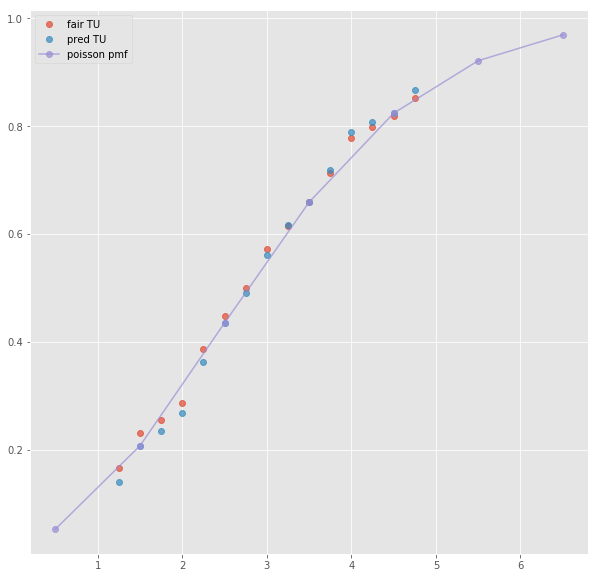

ML : 1.91 3.8 3.8
Error home:  0.001299836270497401
Error draw:  0.014838257137038402
Error away:  0.013538342587456842

(18, 124)
(1, 35)
2.5 1.76 2.12 -0.5 1.93 1.91
TO fair:  1.830188679245283 TU fair:  2.2045454545454546
TO pred:  1.83022 TU fair:  2.20451
Error TO:  0.004152391985091652

Error TO:  0.01047273514666991

Error TO:  9.350461726898018e-06

Error TO:  0.001974096298310246

Error TO:  0.012897042902314415



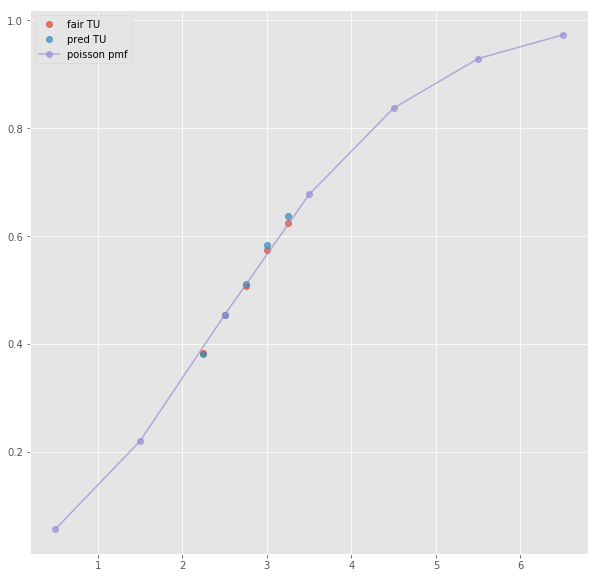

Error T1O:  0.00819235018190434
ML : 1.95 3.72 3.88
Error home:  0.004017765426003517
Error draw:  0.018840482323599722
Error away:  0.014822579846966416

(43, 124)
(1, 43)
1.5 1.6840000000000002 2.25 -0.5 2.78 1.485
TO fair:  1.7484444444444445 TU fair:  2.336104513064133
TO pred:  1.74843 TU fair:  2.33612
Error TO:  0.009497629631963822

Error TO:  0.02378507395197288

Error TO:  0.012341410577243472

Error TO:  4.7249884994604585e-06

Error TO:  0.010769926335940871

Error TO:  0.0027944902476605415

Error TO:  0.005633651691024699

Error TO:  0.017108331405805366



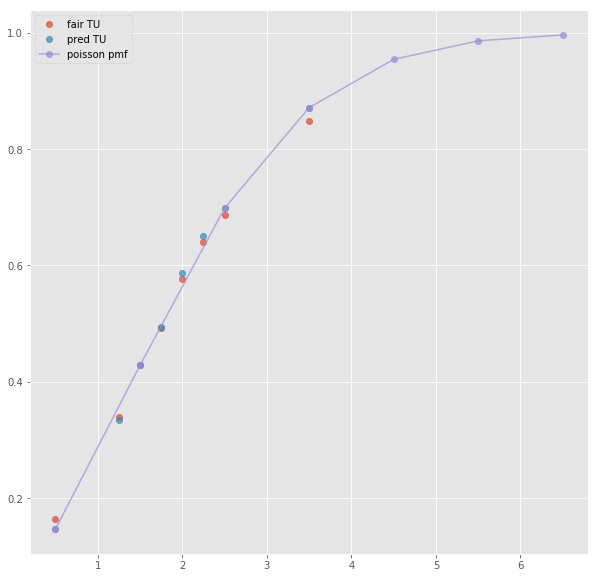

ML : 2.78 2.77 3.14
Error home:  0.0020344419235831523
Error draw:  0.031209358775019902
Error away:  0.02917483934354842

(75, 124)
(1, 27)
1.5 1.69 2.14 -0.5 2.42 1.54
TO fair:  1.7897196261682242 TU fair:  2.2662721893491127
TO pred:  1.78974 TU fair:  2.26623
Error TO:  0.020112775847547837

Error TO:  6.360595399601543e-06

Error TO:  0.051547680678259045

Error TO:  0.0030953263171439316



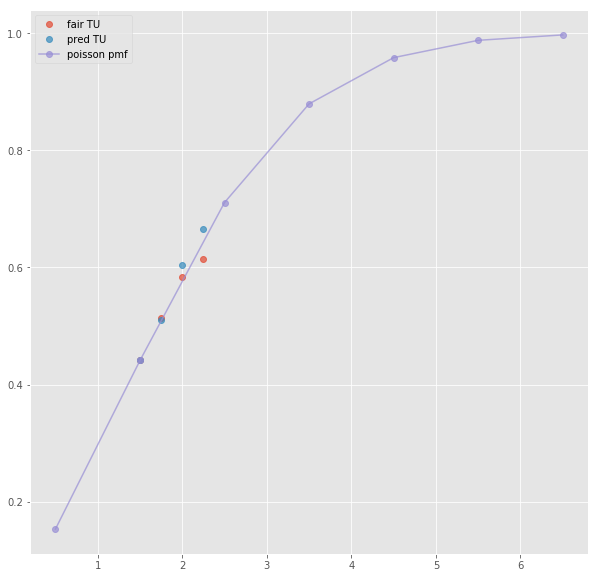

ML : 2.82 2.62 3.06
Error home:  0.05530873339680359
Error draw:  0.03996363194972824
Error away:  0.015344777141218457

(106, 124)
(1, 21)
next list index out of range
(156, 124)
(1, 27)
1.5 1.69 2.26 -0.5 2.63 1.53
TO fair:  1.7477876106194692 TU fair:  2.337278106508876
TO pred:  1.74776 TU fair:  2.33733
Error TO:  0.016648845688167324

Error TO:  9.038694302687666e-06

Error TO:  0.011483170458719938

Error TO:  0.005321030450645359



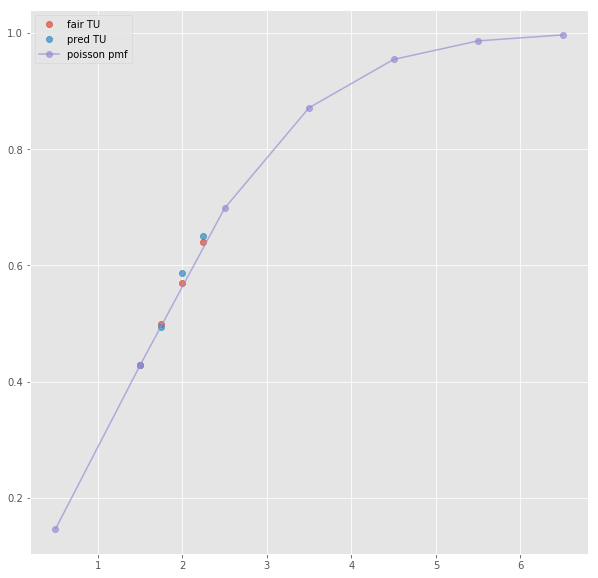

ML : 2.74 2.72 3.15
Error home:  0.020233619838179506
Error draw:  0.034498710315433556
Error away:  0.014265190518647386

(37, 124)
(1, 45)
1.5 1.6840000000000002 2.25 -0.5 2.78 1.485
TO fair:  1.7484444444444445 TU fair:  2.336104513064133
TO pred:  1.74843 TU fair:  2.33612
Error TO:  0.009497629631963822

Error TO:  0.02378507395197288

Error TO:  0.012341410577243472

Error TO:  4.7249884994604585e-06

Error TO:  0.010769926335940871

Error TO:  0.0027944902476605415

Error TO:  0.005633651691024699

Error TO:  0.017108331405805366



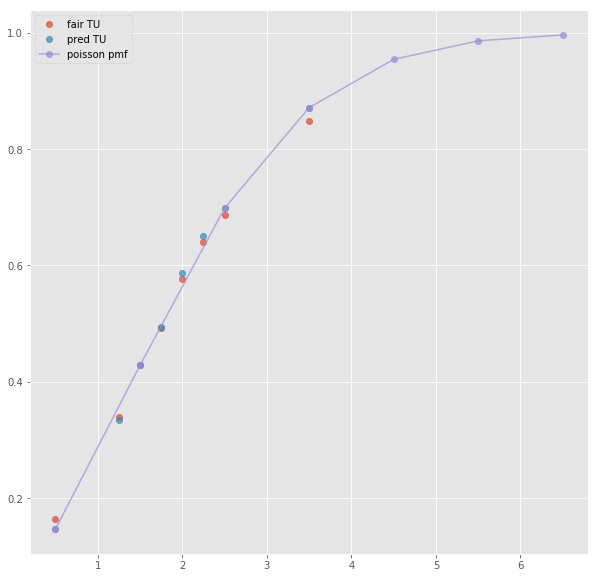

Error T1O:  0.021145347530747427
ML : 2.78 2.77 3.14
Error home:  0.0020344419235831523
Error draw:  0.031209358775019902
Error away:  0.02917483934354842

(30, 124)
next positional indexers are out-of-bounds
(37, 124)
(1, 43)
3.5 1.961 1.9 -1.5 1.5490000000000002 2.55
TO fair:  2.0321052631578946 TU fair:  1.96889342172361
TO pred:  2.03208 TU fair:  1.96892
Error TO:  0.0013357863015937

Error TO:  6.117875493039104e-06

Error TO:  0.00984841692681132

Error TO:  0.0028457636855138135

Error TO:  0.011690930480729889

Error TO:  0.0006798056175835177

Error TO:  0.00885255452578082

Error TO:  0.010372167816029149

Error TO:  0.003558717967605818



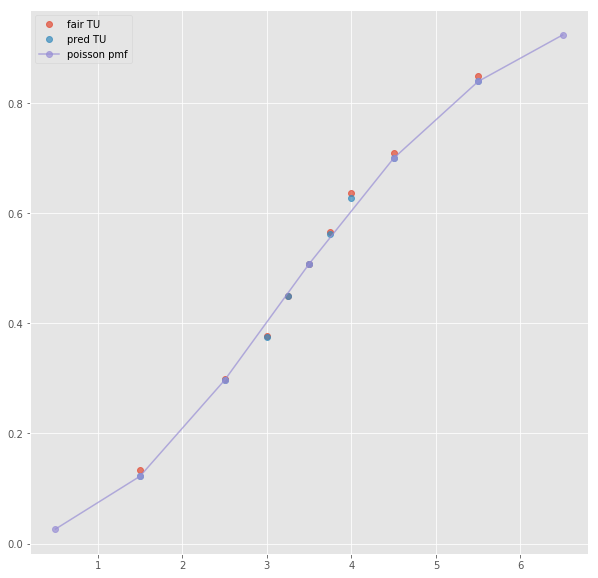

ML : 1.169 7.69 15.61
Error home:  0.0005752314464768649
Error draw:  0.003758343777735984
Error away:  0.0043335264581667865

(71, 124)
(1, 22)
3.5 1.91 1.95 -2.5 2.35 1.62
TO fair:  1.9794871794871796 TU fair:  2.0209424083769636
TO pred:  1.97948 TU fair:  2.02095
Error TO:  1.8322705989115562e-06

Error TO:  0.007387937184215598

Error TO:  0.00530061846587615



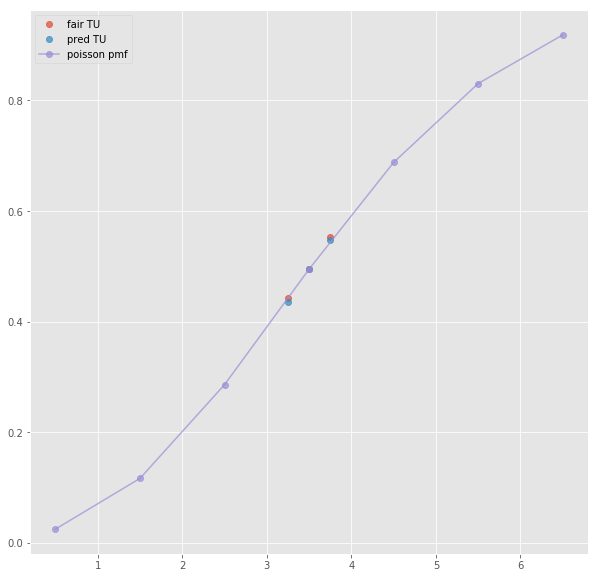

ML : 1.17 7.58 12.98
Error home:  0.007904045965487216
Error draw:  0.0035064725755553083
Error away:  0.004397502653297025

(74, 124)
(1, 22)
3.5 1.97 1.93 -2.5 2.26 1.71
TO fair:  2.0207253886010363 TU fair:  1.9796954314720812
TO pred:  2.02072 TU fair:  1.9797
Error TO:  1.3196616388544413e-06

Error TO:  0.016461717928358377

Error TO:  0.00524885687184673



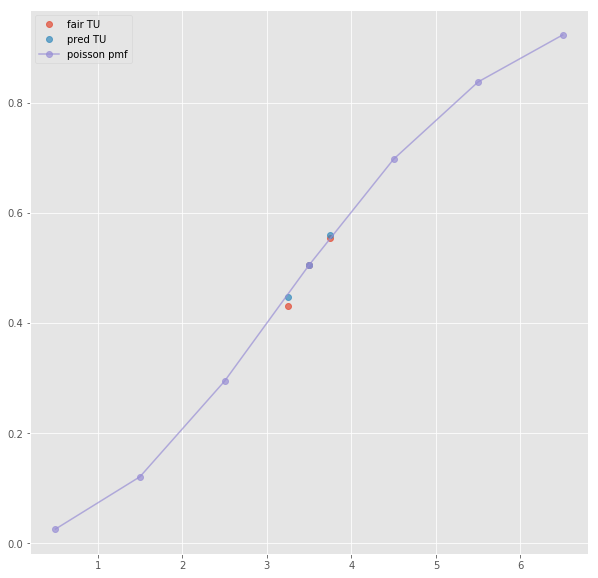

ML : 1.19 7.4 13.5
Error home:  0.03076115593424189
Error draw:  0.016802381778919614
Error away:  0.013958728417082157

(166, 124)
(1, 22)
3.5 1.95 1.95 -2.5 2.36 1.65
TO fair:  2.0 TU fair:  2.0
TO pred:  1.99999 TU fair:  2.00001
Error TO:  2.5000125001284346e-06

Error TO:  0.013548853230373137

Error TO:  0.003971645368365362



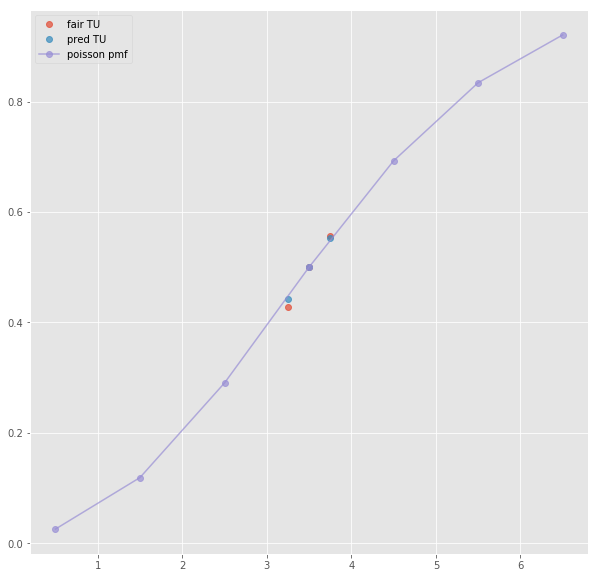

ML : 1.18 8.0 13.0
Error home:  0.007795888859461364
Error draw:  7.458700064383317e-06
Error away:  0.007803284059566901

(35, 124)
(1, 9)
next list index out of range
(36, 124)
(1, 35)
3.5 1.92 1.92 -1.5 1.53 2.59
TO fair:  2.0 TU fair:  2.0
TO pred:  1.99999 TU fair:  2.00001
Error TO:  0.005021983532926599

Error TO:  2.5000125001284346e-06

Error TO:  0.002192789093547698

Error TO:  0.0035103323442706724

Error TO:  0.0017338712760037733



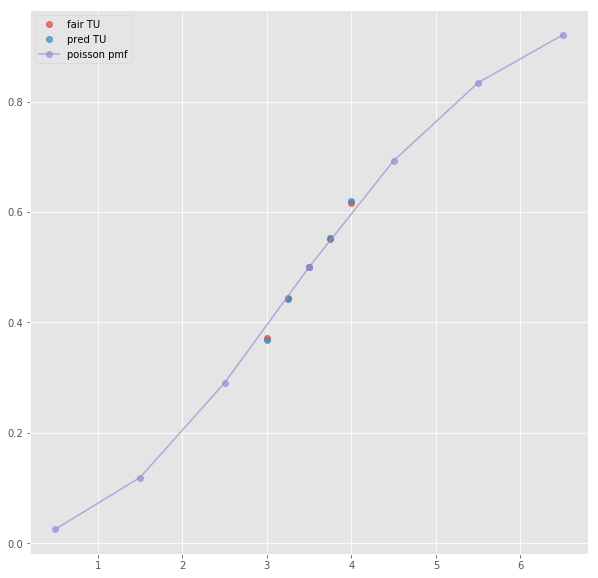

Error T1O:  0.0005300610895405677
Error T1O:  0.022825930367812053
ML : 1.19 7.86 14.13
Error home:  0.009172692692761775
Error draw:  0.00483888451720503
Error away:  0.004333771375119602

(28, 124)
(1, 41)
2.5 2.38 1.617 -0.5 2.9 1.45
TO fair:  2.4718614718614718 TU fair:  1.6794117647058824
TO pred:  2.47184 TU fair:  1.67942
Error TO:  0.002891519330366854

Error TO:  0.006335595883440348

Error TO:  0.009781709081533974

Error TO:  3.5141897882229323e-06

Error TO:  0.007610437965224981

Error TO:  0.002558712167548882

Error TO:  0.0074863606927089155



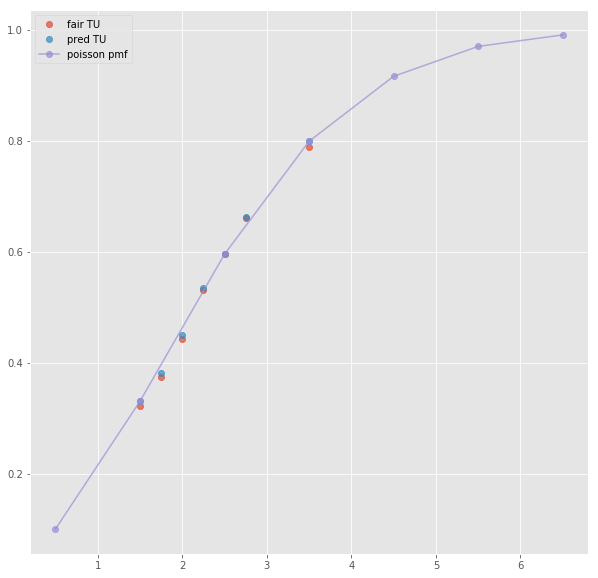

ML : 2.9 3.13 2.7
Error home:  7.794814821093787e-05
Error draw:  0.02572230917480295
Error away:  0.025644750342774025

(47, 124)
(1, 19)
next list index out of range
(55, 124)
(1, 19)
next list index out of range
(259, 124)
(1, 23)
next list index out of range
(30, 124)
(1, 43)
2.5 2.38 1.617 -0.5 2.9 1.45
TO fair:  2.4718614718614718 TU fair:  1.6794117647058824
TO pred:  2.47184 TU fair:  1.67942
Error TO:  0.002891519330366854

Error TO:  0.006335595883440348

Error TO:  0.009781709081533974

Error TO:  3.5141897882229323e-06

Error TO:  0.007610437965224981

Error TO:  0.002558712167548882

Error TO:  0.0074863606927089155



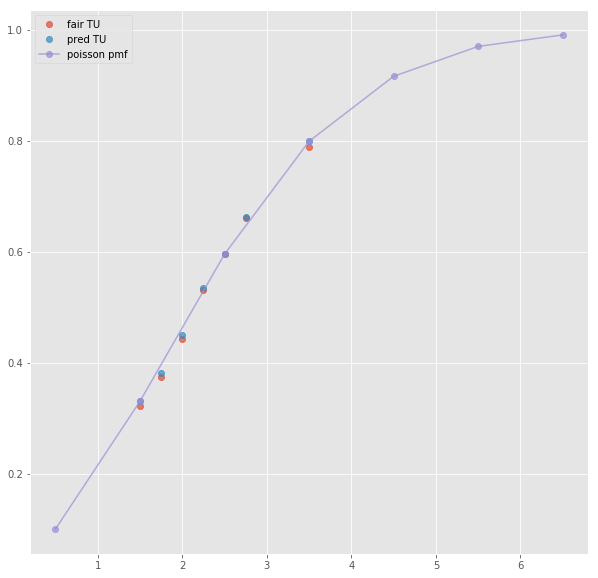

Error T1O:  0.032946172064753754
ML : 2.9 3.13 2.7
Error home:  7.794814821093787e-05
Error draw:  0.02572230917480295
Error away:  0.025644750342774025

(16, 124)
(1, 61)
2.5 2.3 1.6 -0.5 2.75 1.425
TO fair:  2.4375 TU fair:  1.695652173913044
TO pred:  2.43757 TU fair:  1.69562
Error TO:  0.00853257503003696

Error TO:  0.011600318683986033

Error TO:  0.015280268315773449

Error TO:  0.01611678706185829

Error TO:  1.1781384213760404e-05

Error TO:  0.01589912457868936

Error TO:  0.00519136720327984

Error TO:  0.01859331286278268

Error TO:  0.011095481227459292

Error TO:  0.010201789200128264

Error TO:  0.02541694567952424

Error TO:  0.031150408637693583

Error TO:  0.029306383703202155



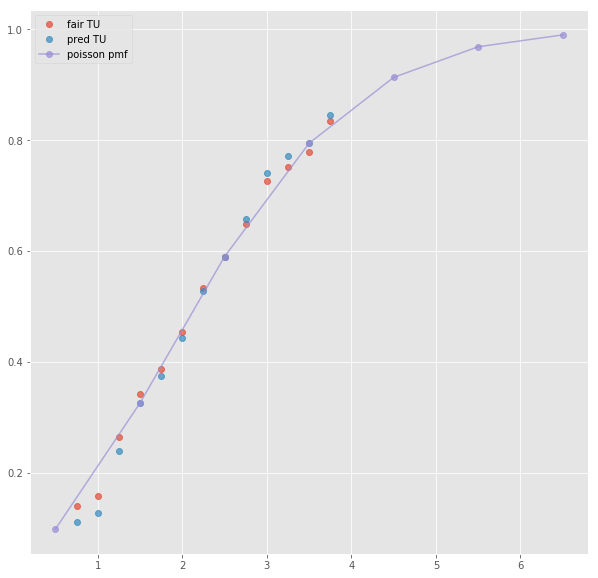

ML : 2.875 3.1 2.55
Error home:  0.013958946445620901
Error draw:  0.021858114804746143
Error away:  0.007899155168795025

(13, 124)
next positional indexers are out-of-bounds
(77, 124)
(1, 52)
2.5 1.862 2.0 -0.5 2.06 1.819
TO fair:  1.9310000000000003 TU fair:  2.0741138560687435
TO pred:  1.93103 TU fair:  2.07408
Error TO:  0.004616639485971241

Error TO:  0.006385327143675235

Error TO:  0.009466194558088115

Error TO:  0.011075201092489662

Error TO:  0.010760263280460619

Error TO:  8.045442957405058e-06

Error TO:  0.00845381804435097

Error TO:  0.0026645414190907823

Error TO:  0.049223579614503854



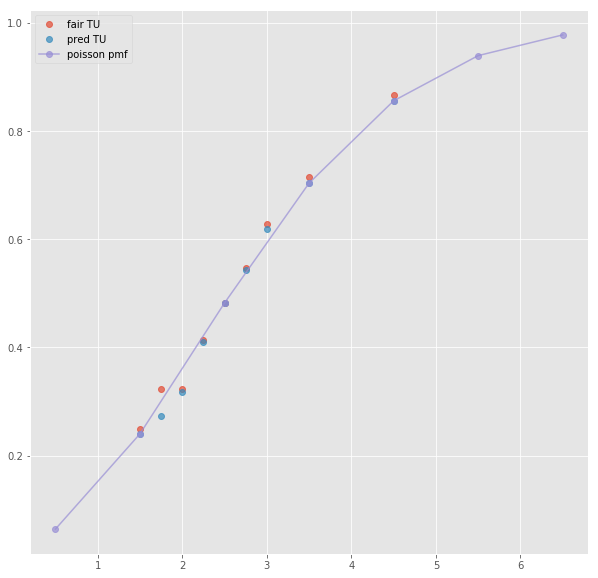

ML : 2.06 3.62 3.59
Error home:  0.0022686204273590915
Error draw:  0.0161484751198607
Error away:  0.013880004491452491

(68, 124)
(1, 21)
2.5 1.89 1.93 -0.5 2.05 1.79
TO fair:  1.979274611398964 TU fair:  2.0211640211640214
TO pred:  1.97931 TU fair:  2.02113
Error TO:  9.033239437794549e-06

Error TO:  0.007009991143263838



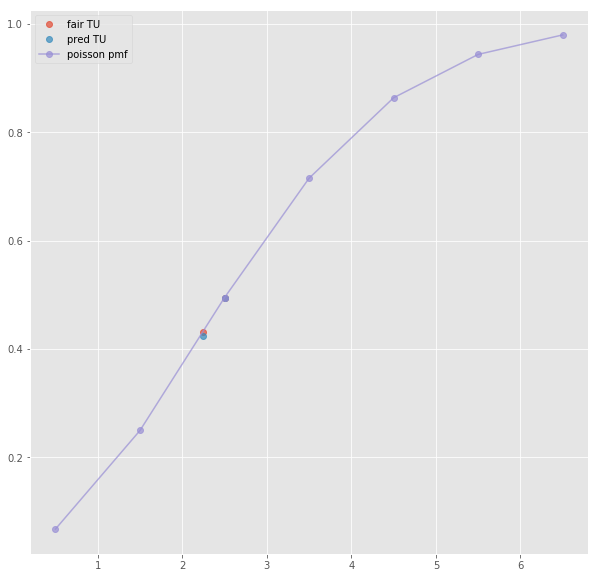

ML : 2.06 3.56 3.01
Error home:  0.024268598895953397
Error draw:  0.0033214699562237326
Error away:  0.020946889944411018

(95, 124)
(1, 21)
2.5 1.89 2.01 -0.5 2.08 1.84
TO fair:  1.9402985074626868 TU fair:  2.0634920634920637
TO pred:  1.94034 TU fair:  2.06345
Error TO:  1.102106609385256e-05

Error TO:  0.00823087560986302



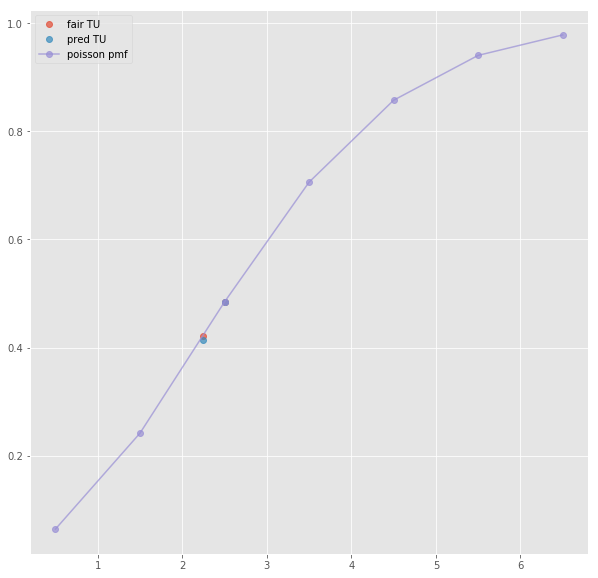

ML : 2.06 3.5 3.6
Error home:  0.006604703497892328
Error draw:  0.022524737922230392
Error away:  0.01591997622771485

(188, 124)
(1, 27)
2.5 1.9 2.0 -0.5 2.08 1.84
TO fair:  1.9499999999999997 TU fair:  2.052631578947368
TO pred:  1.95003 TU fair:  2.0526
Error TO:  7.889424975315862e-06

Error TO:  0.0016014426772942292



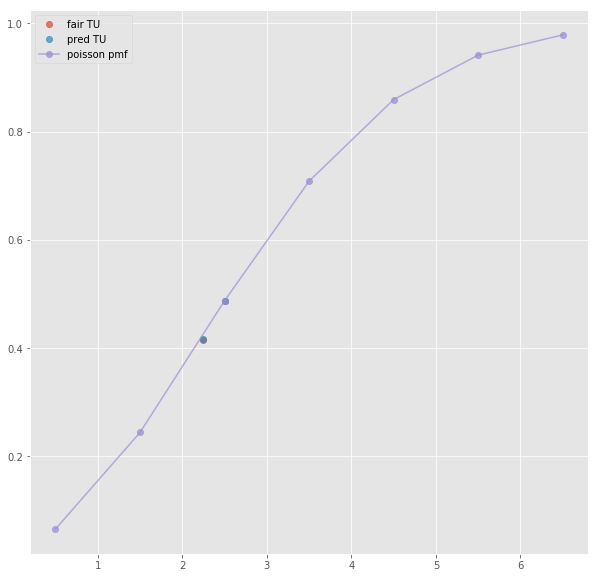

ML : 2.07 3.45 3.6
Error home:  0.009607677855338503
Error draw:  0.02546832480282135
Error away:  0.015860401768671706

(65, 124)
(1, 52)
2.5 1.862 2.0 -0.5 2.06 1.819
TO fair:  1.9310000000000003 TU fair:  2.0741138560687435
TO pred:  1.93103 TU fair:  2.07408
Error TO:  0.004616639485971241

Error TO:  0.006385327143675235

Error TO:  0.009466194558088115

Error TO:  0.011075201092489662

Error TO:  0.010760263280460619

Error TO:  8.045442957405058e-06

Error TO:  0.00845381804435097

Error TO:  0.0026645414190907823

Error TO:  0.04906635190516628



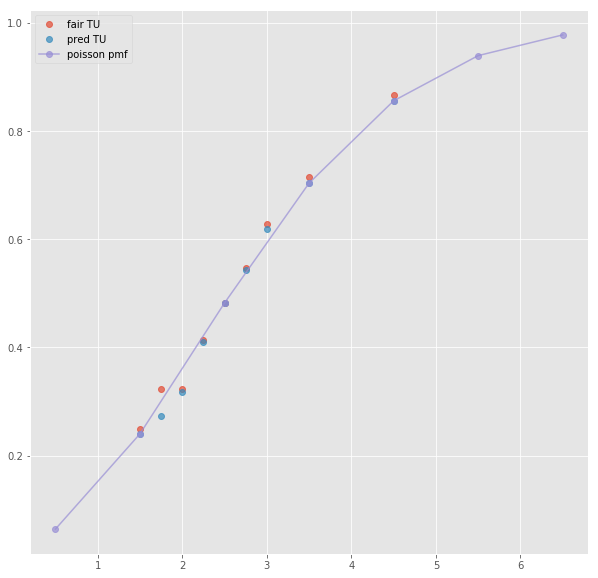

Error T1O:  0.003732856926929151
ML : 2.06 3.62 3.59
Error home:  0.0022686204273590915
Error draw:  0.0161484751198607
Error away:  0.013880004491452491

(9, 124)
(1, 59)
2.5 2.05 1.8 -0.5 2.025 1.825
TO fair:  2.138888888888889 TU fair:  1.878048780487805
TO pred:  2.13889 TU fair:  1.87805
Error TO:  0.007048488027154243

Error TO:  0.0018609935746748407

Error TO:  0.020112719365462717

Error TO:  0.021721420391162982

Error TO:  0.020965537578613677

Error TO:  2.428738828941235e-07

Error TO:  0.008185076287441917

Error TO:  0.003875126041844923

Error TO:  0.02096947165633195

Error TO:  0.01059675411345573

Error TO:  0.018882173145313236

Error TO:  0.02067875144910869

Error TO:  0.024711715310921423

Error TO:  0.016075308660358556



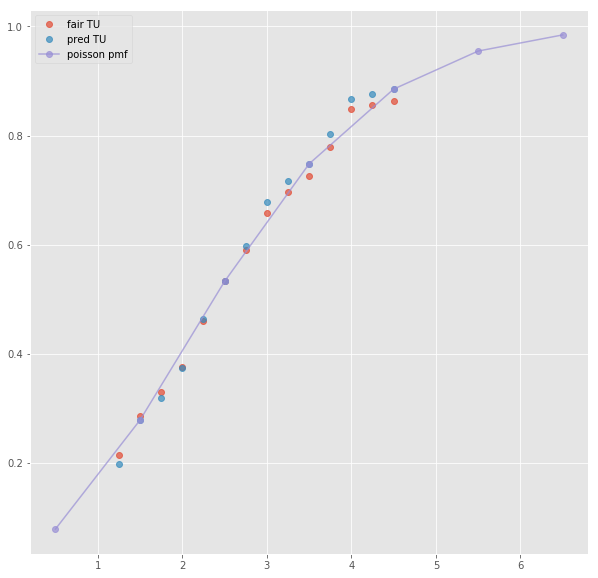

ML : 2.0 3.4 3.75
Error home:  0.002683146618269683
Error draw:  0.017829322871814268
Error away:  0.015146012743526727

(4, 124)
(1, 33)
2.5 1.95 1.9 -0.5 1.99 1.86
TO fair:  2.026315789473684 TU fair:  1.9743589743589742
TO pred:  2.02628 TU fair:  1.9744
Error TO:  0.0035678335525966554

Error TO:  0.0023346222966716956

Error TO:  0.009141132153103804

Error TO:  8.716632282967929e-06

Error TO:  0.00190213210254786



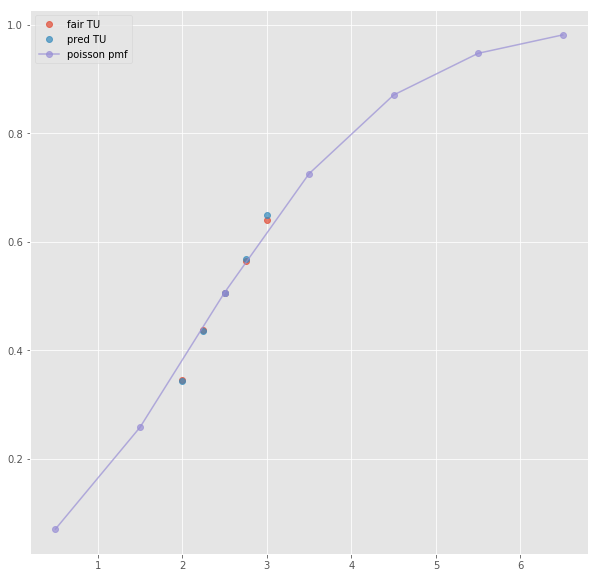

Error T1O:  0.006360111296195736
ML : 2.01 3.56 3.83
Error home:  0.004532335973203072
Error draw:  0.017690663184793454
Error away:  0.013158114763537454

(21, 124)
(1, 41)
3.5 2.35 1.632 -0.5 2.78 1.485
TO fair:  2.439950980392157 TU fair:  1.694468085106383
TO pred:  2.43999 TU fair:  1.69445
Error TO:  0.010229334069415286

Error TO:  0.0062620205001536755

Error TO:  6.554110400958102e-06

Error TO:  0.02019328397588052

Error TO:  0.010856914352262992

Error TO:  0.016447595193245457

Error TO:  0.0032212476970233106



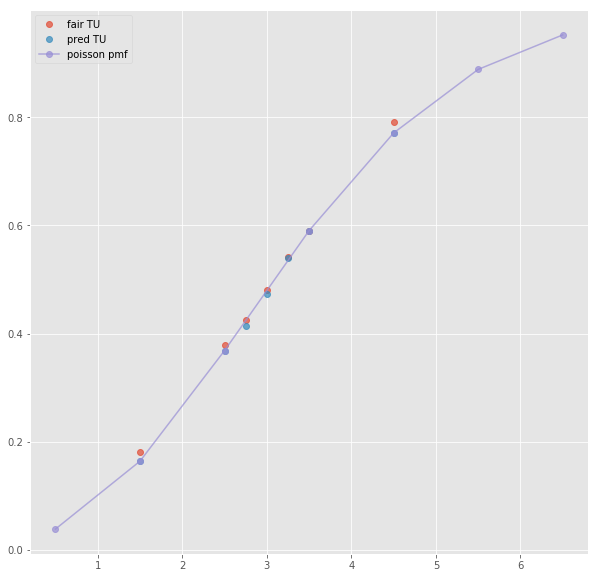

ML : 2.78 3.64 2.5
Error home:  0.00046207980516388414
Error draw:  0.03443445321460234
Error away:  0.0339723044320438

(28, 124)
(1, 21)
next list index out of range
(29, 124)
(1, 19)
next list index out of range
(56, 124)
(1, 19)
next list index out of range
(21, 124)
(1, 43)
3.5 2.35 1.632 -0.5 2.78 1.485
TO fair:  2.439950980392157 TU fair:  1.694468085106383
TO pred:  2.43999 TU fair:  1.69445
Error TO:  0.010229334069415286

Error TO:  0.0062620205001536755

Error TO:  6.554110400958102e-06

Error TO:  0.02019328397588052

Error TO:  0.010856914352262992

Error TO:  0.016447595193245457

Error TO:  0.0032212476970233106



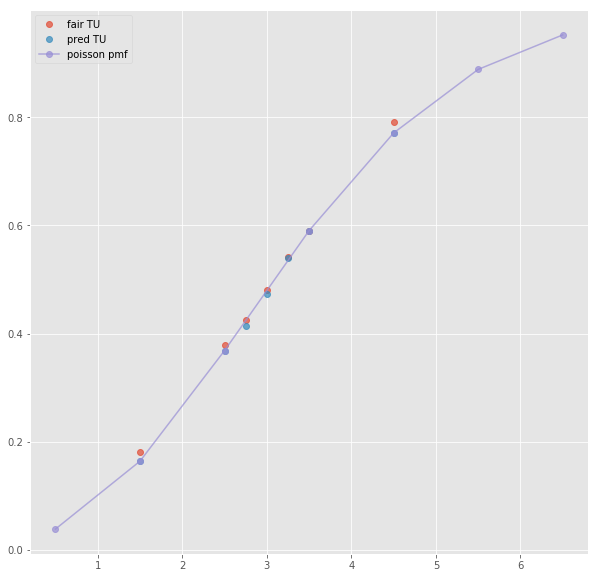

Error T1O:  0.0003941989131425183
ML : 2.78 3.64 2.5
Error home:  0.00046207980516388414
Error draw:  0.03443445321460234
Error away:  0.0339723044320438

(42, 124)
(1, 10)
next list index out of range
(8, 124)
(1, 35)
3.5 2.36 1.62 -0.5 2.69 1.5
TO fair:  2.45679012345679 TU fair:  1.6864406779661019
TO pred:  2.45674 TU fair:  1.68646
Error TO:  0.013811910457991572

Error TO:  0.010142210429255227

Error TO:  8.30450517769199e-06

Error TO:  0.016656346374176012

Error TO:  0.004246246419176647



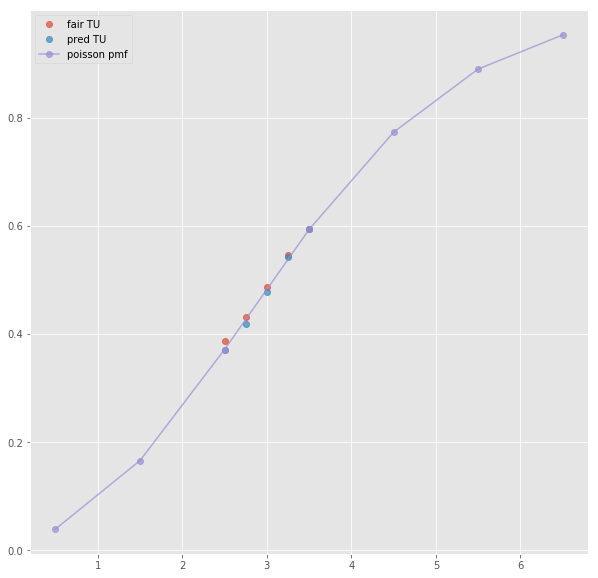

Error T1O:  0.001561425284622553
ML : 2.74 3.68 2.48
Error home:  0.007060440163523807
Error draw:  0.029234814245006707
Error away:  0.02217458410509271

(159, 124)
(1, 42)
3.5 2.62 1.537 -0.5 1.961 1.961
TO fair:  2.7046193884189984 TU fair:  1.5866412213740457
TO pred:  2.70468 TU fair:  1.58662
Error TO:  0.0022742787052041358

Error TO:  0.0008373865157272897

Error TO:  8.28578320155593e-06

Error TO:  0.00521200232182889

Error TO:  0.0012634198193011148

Error TO:  0.003102994300237194

Error TO:  9.46530401657597e-06



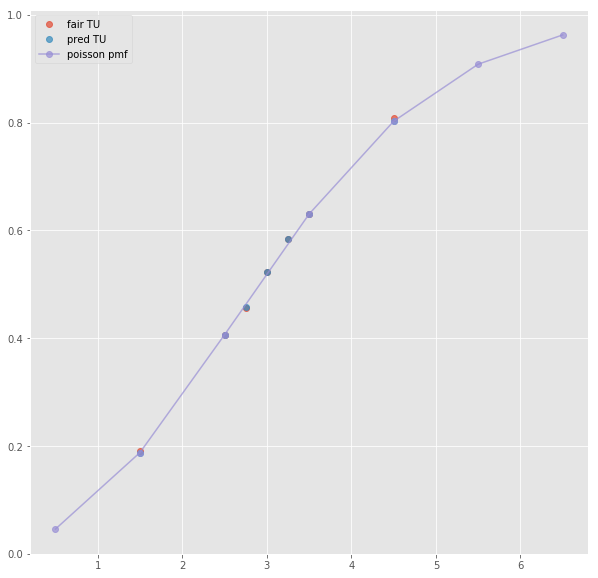

ML : 1.961 3.79 3.93
Error home:  0.004075777152632409
Error draw:  0.02602824020983946
Error away:  0.021952352705057854

(221, 124)
(1, 27)
2.5 1.56 2.38 -0.5 1.92 1.95
TO fair:  1.6554621848739497 TU fair:  2.5256410256410255
TO pred:  1.65547 TU fair:  2.52561
Error TO:  0.0035975663521735646

Error TO:  0.008331549054347354

Error TO:  2.851644658408148e-06

Error TO:  0.01924368913539265



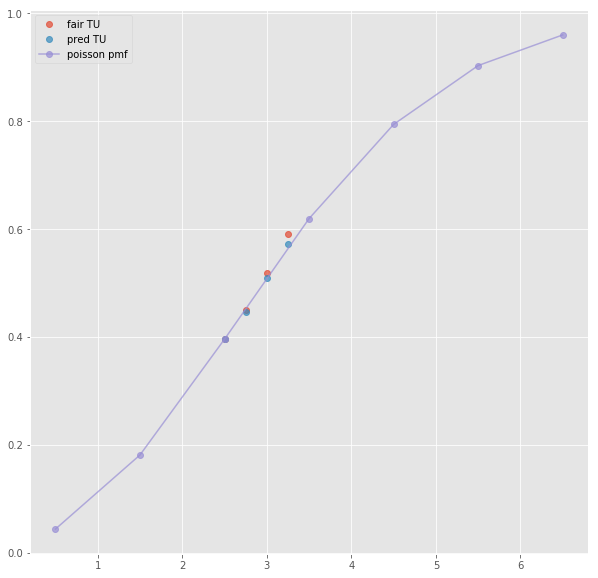

ML : 1.92 3.61 3.86
Error home:  0.011098299370733478
Error draw:  0.03399327871413385
Error away:  0.022895224431085104

(286, 124)
(1, 25)
next list index out of range
(646, 124)
(1, 27)
2.5 1.62 2.42 -0.5 1.98 1.97
TO fair:  1.669421487603306 TU fair:  2.493827160493827
TO pred:  1.66943 TU fair:  2.4938
Error TO:  0.0039839927362886884

Error TO:  0.008982696914152988

Error TO:  3.05434184177944e-06

Error TO:  0.01463512793589955



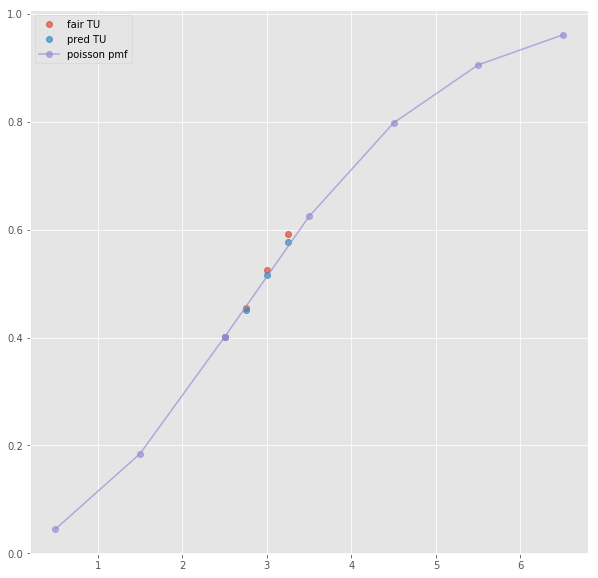

ML : 1.97 3.8 3.7
Error home:  0.011131344903106688
Error draw:  0.0230158073892677
Error away:  0.011884304035918836

(136, 124)
(1, 44)
3.5 2.62 1.537 -0.5 1.961 1.961
TO fair:  2.7046193884189984 TU fair:  1.5866412213740457
TO pred:  2.70468 TU fair:  1.58662
Error TO:  0.0022742787052041358

Error TO:  0.0008373865157272897

Error TO:  8.28578320155593e-06

Error TO:  0.00521200232182889

Error TO:  0.0012634198193011148

Error TO:  0.003102994300237194

Error TO:  9.46530401657597e-06



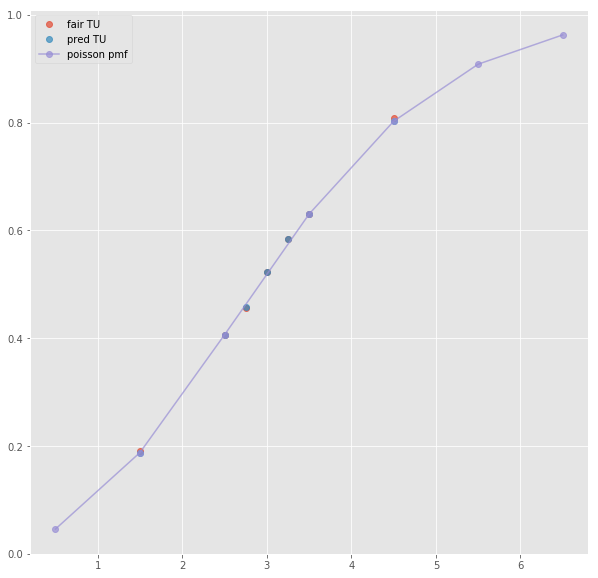

Error T1O:  0.009139316395082475
ML : 1.961 3.79 3.93
Error home:  0.004075777152632409
Error draw:  0.02602824020983946
Error away:  0.021952352705057854

(173, 124)
(1, 71)
3.5 2.425 1.525 -0.5 1.98 1.95
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.59019 TU fair:  1.62886
Error TO:  0.020753543953216824

Error TO:  0.027954184820545014

Error TO:  0.017543064803185515

Error TO:  3.885155582861177e-06

Error TO:  0.0039520198795388595

Error TO:  0.01957038365376229

Error TO:  0.024404758866645948

Error TO:  0.023138646275283836

Error TO:  0.006009005748257468

Error TO:  0.02801453483607741

Error TO:  0.00906789630144772

Error TO:  0.00458571529999624

Error TO:  0.0024818977009522514

Error TO:  0.025523228236961293

Error TO:  0.008855884329115299



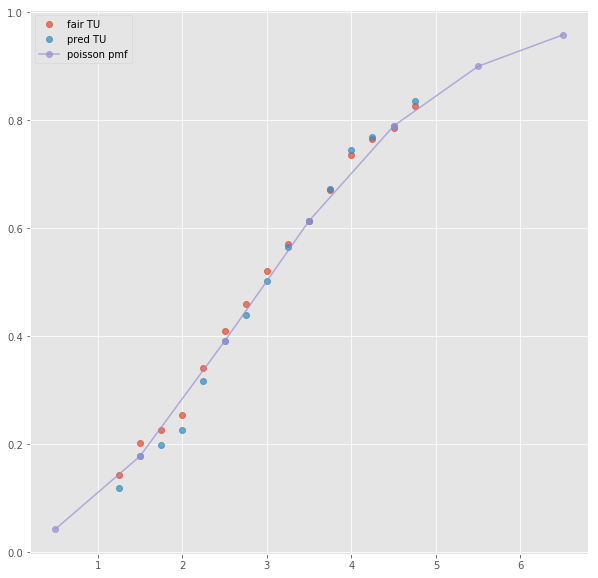

ML : 1.91 3.75 3.8
Error home:  0.0008323698433899129
Error draw:  0.0249000583246565
Error away:  0.025732204268982733

(51, 124)
next positional indexers are out-of-bounds
(32, 124)
(1, 41)
2.5 2.28 1.689 -0.5 2.57 1.568
TO fair:  2.349911190053286 TU fair:  1.7407894736842107
TO pred:  2.34996 TU fair:  1.74076
Error TO:  0.0023019878841689656

Error TO:  0.0021927319218160157

Error TO:  0.006633237764883754

Error TO:  8.838863238769257e-06

Error TO:  0.0036312186371160182

Error TO:  8.645658451367222e-05

Error TO:  0.002943774498917806



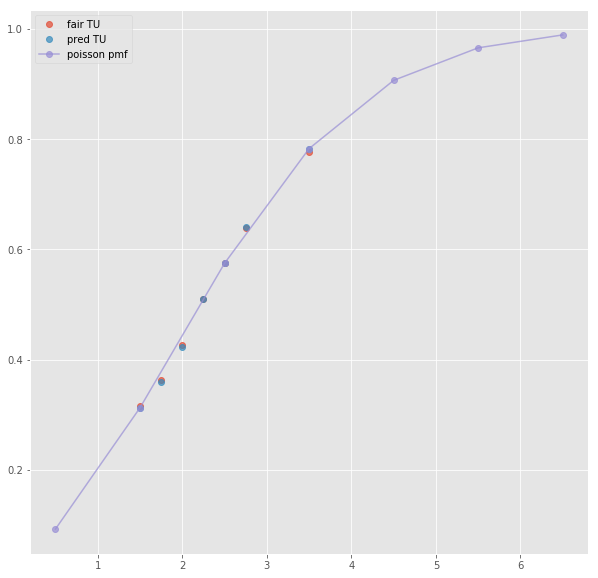

ML : 2.57 3.21 3.0
Error home:  0.0026023836183532434
Error draw:  0.023658765022855244
Error away:  0.02105600116392492

(36, 124)
(1, 23)
next list index out of range
(57, 124)
(1, 19)
next list index out of range
(72, 124)
(1, 23)
2.5 2.25 1.7 -0.5 2.47 1.6
TO fair:  2.3235294117647056 TU fair:  1.7555555555555553
TO pred:  2.32359 TU fair:  1.75552
Error TO:  0.010415358655688545

Error TO:  1.1222267855826029e-05

Error TO:  0.002403547071801182



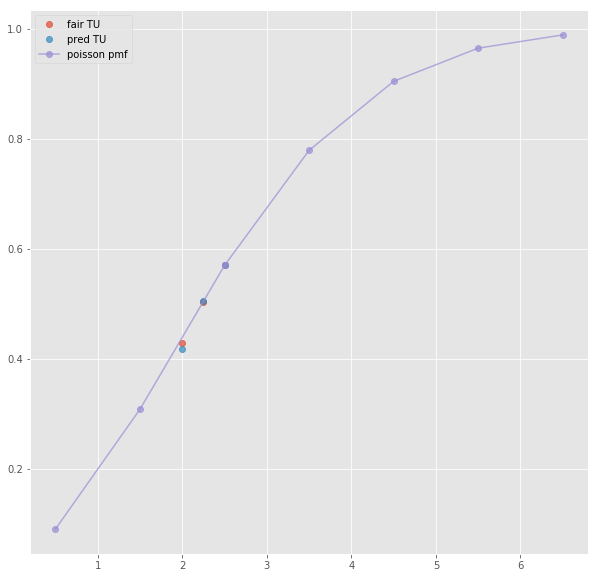

ML : 2.44 3.2 3.05
Error home:  0.0028594916156799433
Error draw:  0.021671507966072756
Error away:  0.018812332336651083

(24, 124)
(1, 43)
2.5 2.28 1.689 -0.5 2.57 1.568
TO fair:  2.349911190053286 TU fair:  1.7407894736842107
TO pred:  2.34996 TU fair:  1.74076
Error TO:  0.0023019878841689656

Error TO:  0.0021927319218160157

Error TO:  0.006633237764883754

Error TO:  8.838863238769257e-06

Error TO:  0.0036312186371160182

Error TO:  8.645658451367222e-05

Error TO:  0.002943774498917806



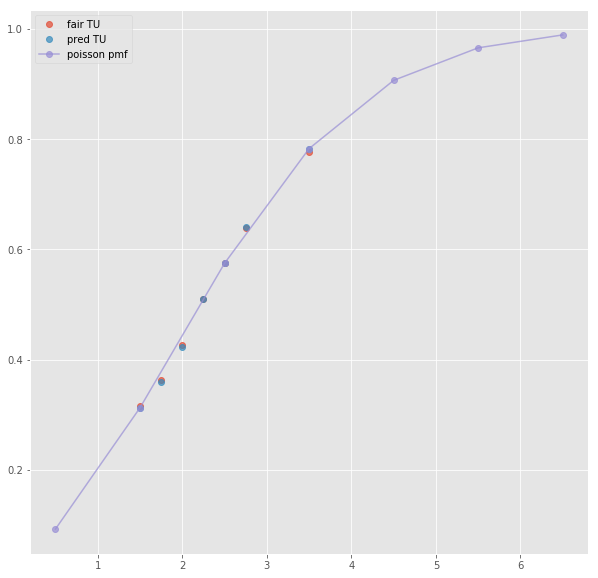

Error T1O:  0.011911960914178232
ML : 2.57 3.21 3.0
Error home:  0.0026023836183532434
Error draw:  0.023658765022855244
Error away:  0.02105600116392492

(145, 124)
(1, 63)
2.5 2.15 1.675 -0.5 2.375 1.55
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.011081319061399753

Error TO:  0.015336591097173724

Error TO:  0.01384320327034061

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.009817964538896273

Error TO:  0.010097138835415354

Error TO:  0.014687662129951318

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.03187120233894902

Error TO:  0.037133735416098546



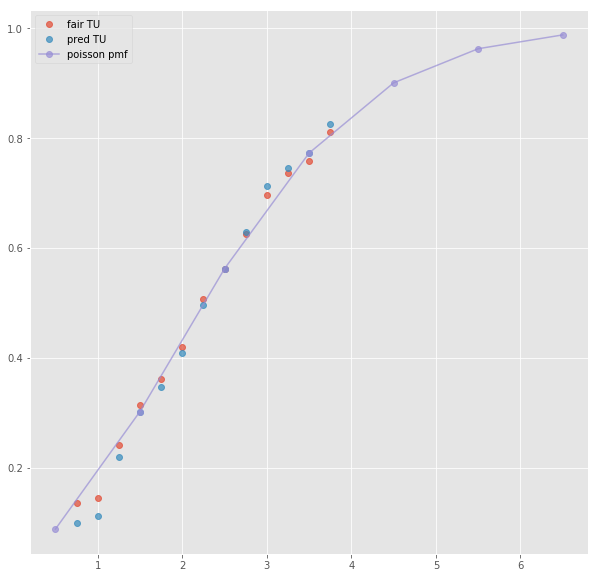

ML : 2.55 3.2 2.9
Error home:  0.021247317040910096
Error draw:  0.02385943590777717
Error away:  0.002612106603367026

(5, 124)
(1, 33)
2.5 2.24 1.68 -0.5 2.48 1.57
TO fair:  2.333333333333333 TU fair:  1.7499999999999998
TO pred:  2.33328 TU fair:  1.75003
Error TO:  0.004247900627598167

Error TO:  0.0016994813438423462

Error TO:  9.796142279194786e-06

Error TO:  0.0021510870856333852

Error TO:  0.003225296748643136



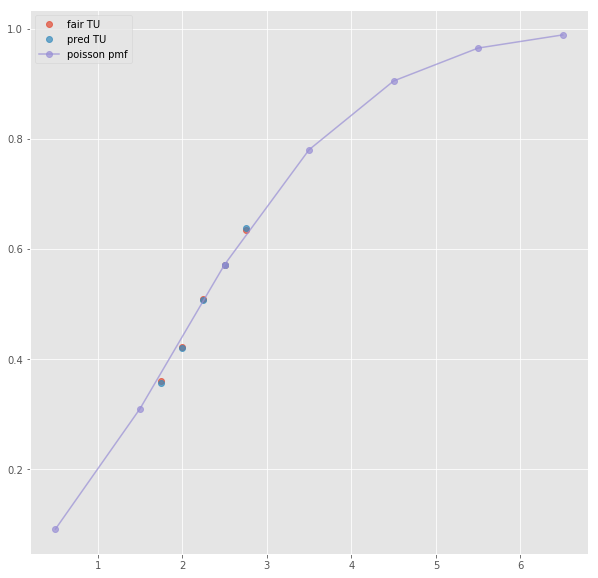

Error T1O:  0.009307645361259775
ML : 2.52 3.19 3.04
Error home:  0.005821135971946723
Error draw:  0.02506793259608725
Error away:  0.01924682231590963

(190, 124)
(1, 46)
2.5 1.925 1.98 0.5 2.25 1.714
TO fair:  1.972222222222222 TU fair:  2.0285714285714285
TO pred:  1.97221 TU fair:  2.02858
Error TO:  0.002604813803493089

Error TO:  0.014723847608186236

Error TO:  0.008943520790879511

Error TO:  0.011886789009137977

Error TO:  0.017850971816199906

Error TO:  3.142253156895869e-06

Error TO:  0.014832190544929569

Error TO:  0.004860967964650631

Error TO:  0.035344383661483736



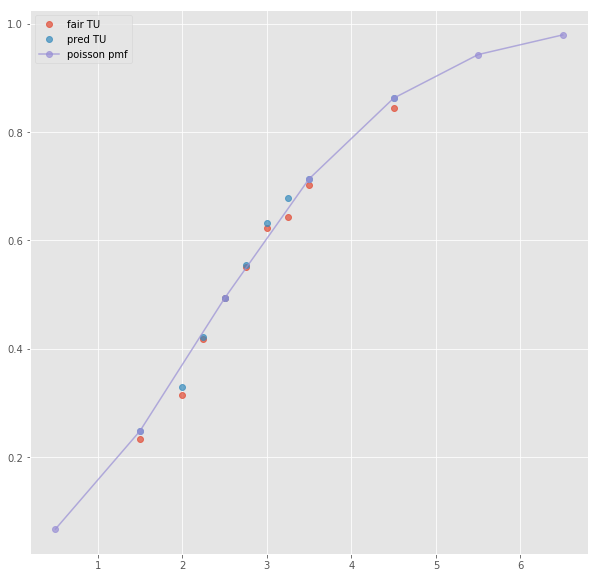

ML : 5.24 3.87 1.714
Error home:  0.014130394971072407
Error draw:  0.016754366666842935
Error away:  0.0026242030482763745

(260, 124)
(1, 28)
2.5 1.96 1.86 0.5 2.25 1.64
TO fair:  2.0537634408602146 TU fair:  1.9489795918367345
TO pred:  2.0538 TU fair:  1.94894
Error TO:  0.0019271772781819796

Error TO:  0.030730428511021146

Error TO:  8.667371273030078e-06

Error TO:  0.006106763516182667



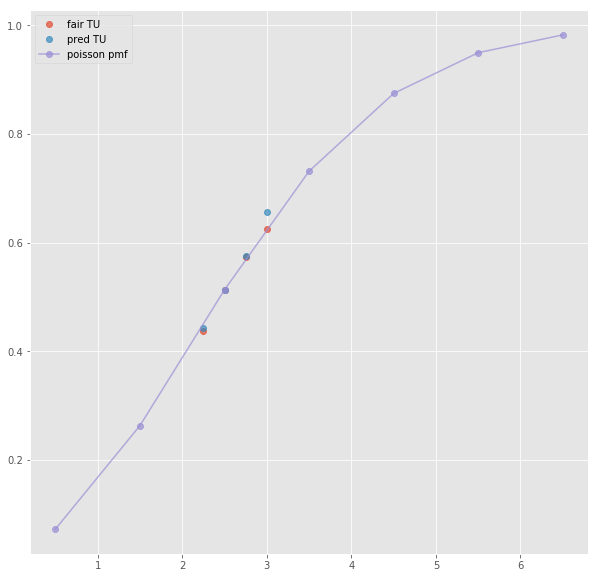

ML : 5.36 3.76 1.63
Error home:  0.012013791218026926
Error draw:  0.014911608023488315
Error away:  0.0028976677412886342

(268, 124)
(1, 23)
2.5 1.95 1.95 0.5 2.26 1.71
TO fair:  2.0 TU fair:  2.0
TO pred:  2.00004 TU fair:  1.99996
Error TO:  0.007874598456390491

Error TO:  9.999800003934745e-06

Error TO:  0.028196230839089953



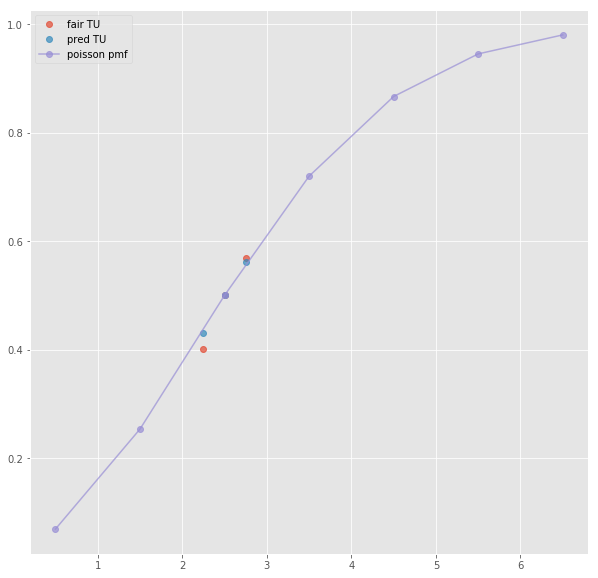

ML : 5.1 3.85 1.71
Error home:  0.007928389830553773
Error draw:  0.015212686247456447
Error away:  0.007284233604348267

(792, 124)
(1, 28)
2.5 1.98 1.92 0.5 2.25 1.72
TO fair:  2.03125 TU fair:  1.9696969696969697
TO pred:  2.03127 TU fair:  1.96968
Error TO:  0.004111565360919223

Error TO:  0.0299003857772262

Error TO:  4.847289551024314e-06

Error TO:  0.00018950083009605656



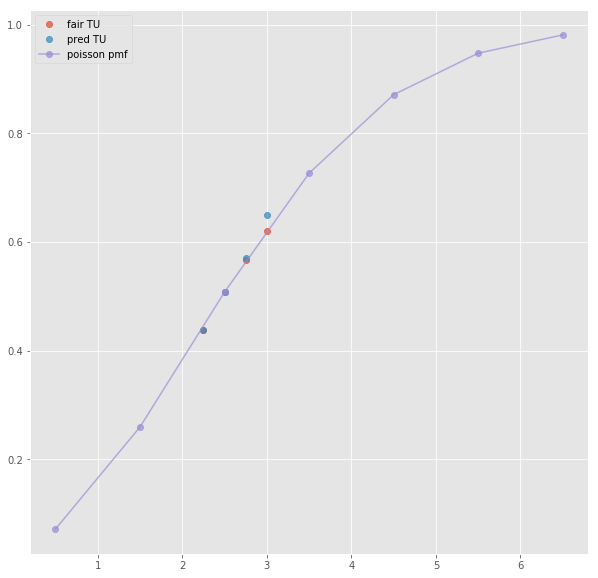

ML : 4.8 3.9 1.71
Error home:  0.0016936375359493383
Error draw:  0.007846684191149533
Error away:  0.009540179008919014

(162, 124)
(1, 48)
2.5 1.925 1.98 0.5 2.25 1.714
TO fair:  1.972222222222222 TU fair:  2.0285714285714285
TO pred:  1.97221 TU fair:  2.02858
Error TO:  0.003448212881389745

Error TO:  0.014723847608186236

Error TO:  0.009396963515064582

Error TO:  0.012838455082383404

Error TO:  0.018177029352246216

Error TO:  3.142253156895869e-06

Error TO:  0.014974192150165266

Error TO:  0.005906504542577906

Error TO:  0.035344383661483736



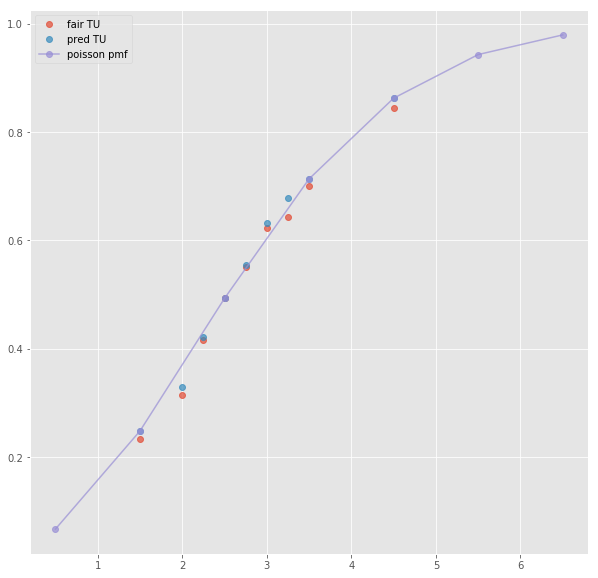

Error T1O:  0.017284915488242736
ML : 5.24 3.88 1.714
Error home:  0.014011137777392046
Error draw:  0.016270519219437563
Error away:  0.0022596127945511135

(96, 124)
next positional indexers are out-of-bounds
(10, 124)
(1, 40)
2.5 1.877 1.917 0.5 1.934 1.877
TO fair:  1.9791340636411061 TU fair:  2.0213106020245073
TO pred:  1.97912 TU fair:  2.02132
Error TO:  0.0015904790884804232

Error TO:  0.0004253340850867149

Error TO:  0.005514737446705498

Error TO:  0.008392371909426932

Error TO:  3.5904628188365706e-06

Error TO:  0.00223976872556253

Error TO:  0.0001680786708783133



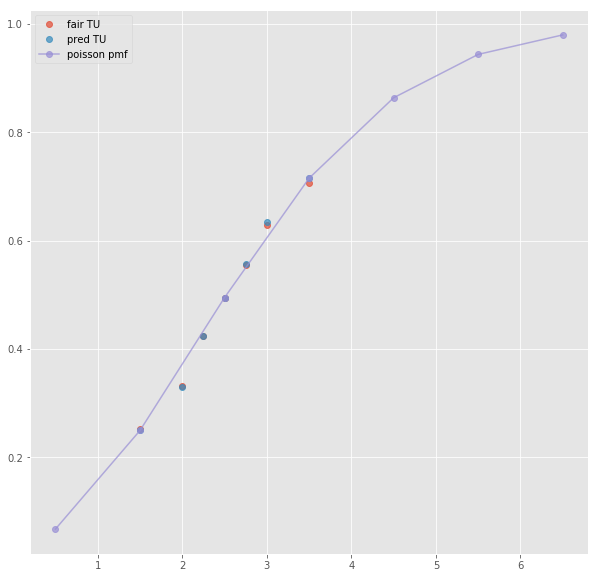

ML : 4.15 3.37 1.877
Error home:  0.021175435466546877
Error draw:  0.030973248912873452
Error away:  0.009798074067558615

(11, 124)
(1, 15)
2.5 1.89 1.85 0.5 1.99 1.77
TO fair:  2.0216216216216214 TU fair:  1.9788359788359788
TO pred:  2.02161 TU fair:  1.97884
Error TO:  2.8436063838066516e-06



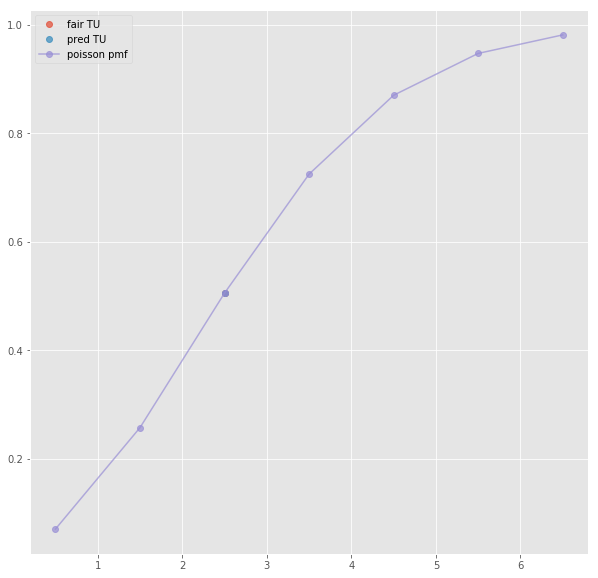

ML : 3.61 3.41 1.76
Error home:  0.016881031218150766
Error draw:  0.013296358088431937
Error away:  0.030177188261051258

(17, 124)
(1, 15)
2.5 1.88 1.94 0.5 1.99 1.85
TO fair:  1.9690721649484533 TU fair:  2.0319148936170213
TO pred:  1.96906 TU fair:  2.03193
Error TO:  3.1375430261659787e-06



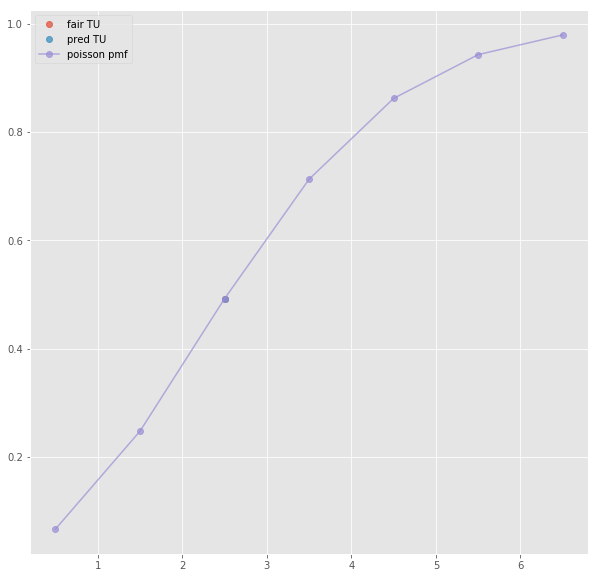

ML : 3.5 3.45 1.84
Error home:  0.01735705629752754
Error draw:  0.015223425198996943
Error away:  0.03258069811288916

(3, 124)
(1, 42)
2.5 1.833 1.952 0.5 2.08 1.746
TO fair:  1.9390368852459017 TU fair:  2.064920894708129
TO pred:  1.939 TU fair:  2.06496
Error TO:  0.0017829548375086213

Error TO:  0.0036769395047050457

Error TO:  0.0016314589313817796

Error TO:  0.0023070022075388774

Error TO:  9.810447172409198e-06

Error TO:  0.004217410069721983

Error TO:  0.0017234930929377335



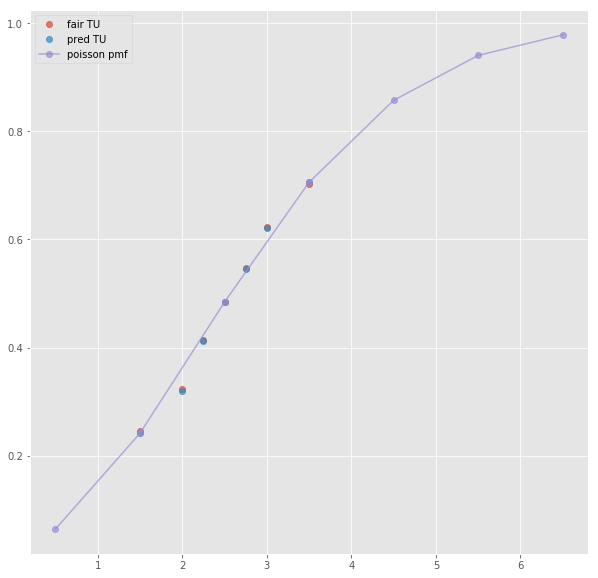

Error T1O:  0.005262535523634815
ML : 4.35 3.7 1.746
Error home:  0.004852005266409137
Error draw:  0.014667334163250001
Error away:  0.009815228110060636

(10, 124)
(1, 17)
2.5 1.925 1.925 0.5 1.975 1.875
TO fair:  1.9999999999999998 TU fair:  1.9999999999999998
TO pred:  2.00004 TU fair:  1.99996
Error TO:  9.999800004045767e-06



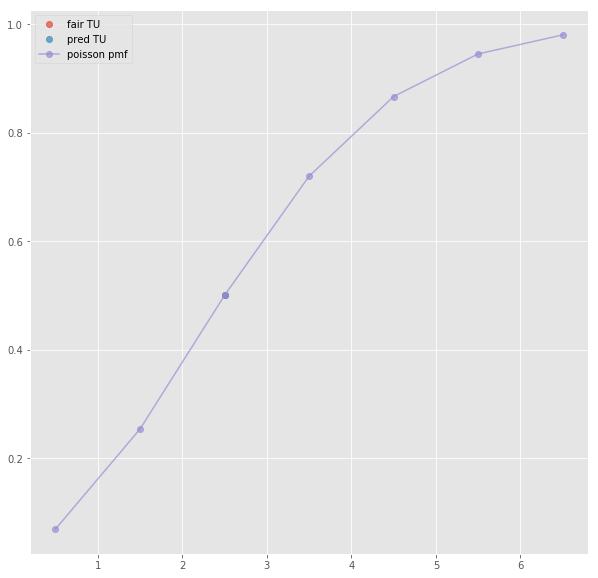

ML : 4.2 3.75 1.7
Error home:  0.022868163202388797
Error draw:  0.0023467792638317275
Error away:  0.025215087842588746

(11, 124)
(1, 34)
2.5 1.9 1.95 0.5 1.96 1.89
TO fair:  1.9743589743589742 TU fair:  2.026315789473684
TO pred:  1.97435 TU fair:  2.02632
Error TO:  0.004520484187418461

Error TO:  0.0025915225388889462

Error TO:  0.009616231248862739

Error TO:  2.302253676034205e-06

Error TO:  0.001038456282760225



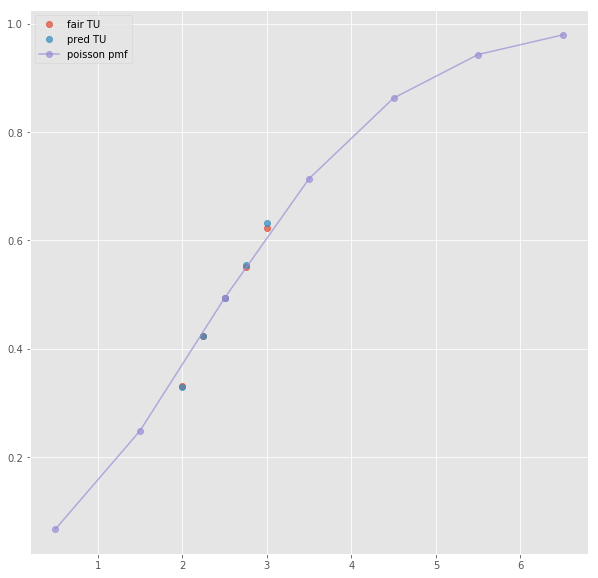

Error T1O:  0.002210736959294246
Error T1O:  0.030024650560304567
ML : 4.16 3.66 1.9
Error home:  0.014033538570463217
Error draw:  0.017029437872635056
Error away:  0.0029957080365285993

(58, 124)
(1, 43)
3.5 2.47 1.543 -1.5 2.05 1.793
TO fair:  2.600777705767985 TU fair:  1.6246963562753036
TO pred:  2.60077 TU fair:  1.6247
Error TO:  0.007369545297340574

Error TO:  0.004945593520727876

Error TO:  1.139228255730984e-06

Error TO:  0.006634671582337021

Error TO:  0.009097670960309334

Error TO:  0.0036604629661030064

Error TO:  0.02096262829637696

Error TO:  0.0018617189800410605



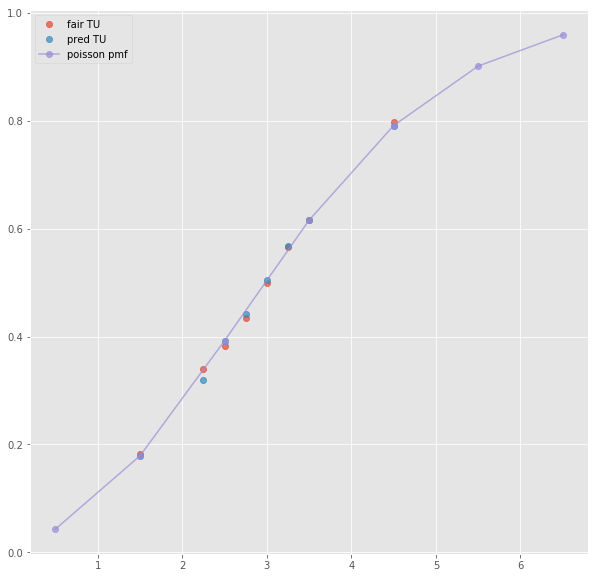

ML : 1.337 5.25 7.96
Error home:  0.00403255964322391
Error draw:  0.0008629776238509579
Error away:  0.00489561501932359

(80, 124)
(1, 25)
2.5 1.62 2.21 -1.5 2.01 1.81
TO fair:  1.7330316742081449 TU fair:  2.3641975308641974
TO pred:  1.73302 TU fair:  2.36423
Error TO:  0.03276056768563751

Error TO:  0.04772633570953483

Error TO:  3.8870252092593205e-06

Error TO:  0.037037075578621126



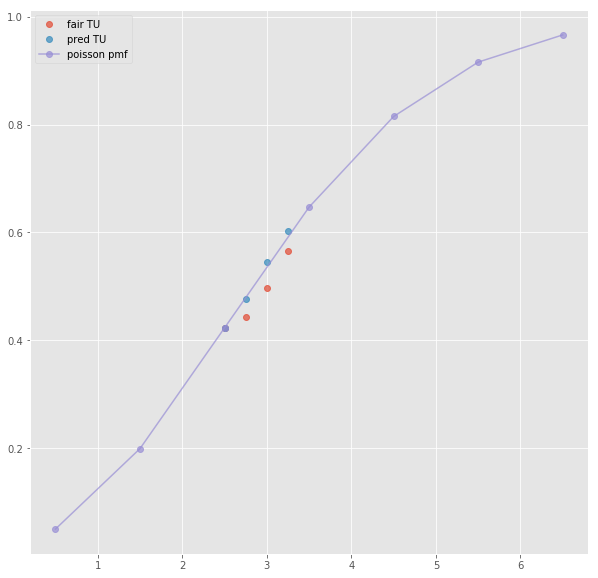

ML : 1.32 5.16 8.21
Error home:  0.005323795730615477
Error draw:  0.0028310698407015
Error away:  0.0024926305734265103

(141, 124)
(1, 24)
2.5 1.64 2.31 -1.5 2.04 1.86
TO fair:  1.7099567099567101 TU fair:  2.408536585365854
TO pred:  1.70995 TU fair:  2.40855
Error TO:  0.02139881288817469

Error TO:  0.04791737890044456

Error TO:  2.2948335525185826e-06

Error TO:  0.03101447529512852



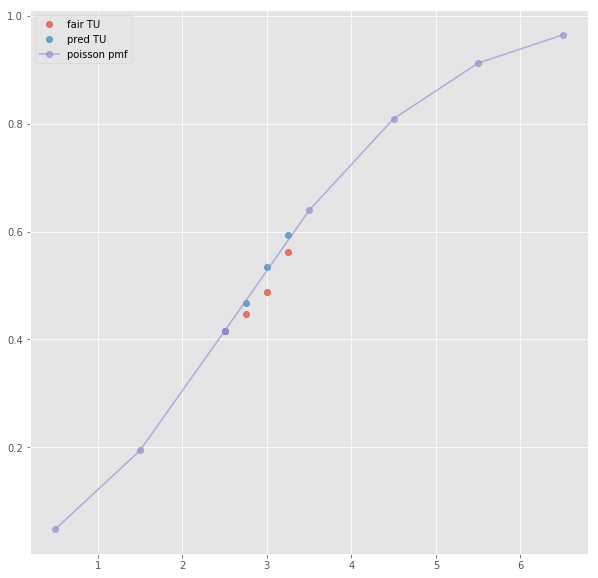

ML : 1.36 5.1 8.4
Error home:  0.012677100259414598
Error draw:  0.01050053495781994
Error away:  0.0021765244230035202

(94, 124)
(1, 25)
2.5 1.6 2.38 -1.5 2.04 1.86
TO fair:  1.6722689075630255 TU fair:  2.4875
TO pred:  1.67227 TU fair:  2.4875
Error TO:  0.012738951050793479

Error TO:  0.028165474139471403

Error TO:  3.906464455250003e-07

Error TO:  0.022166259344660544



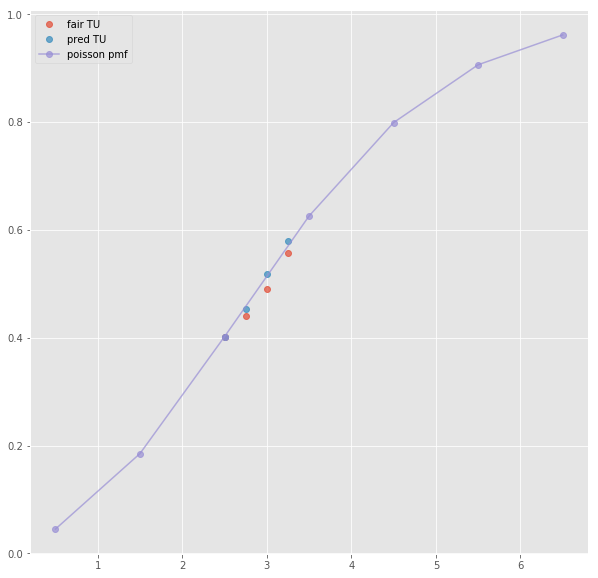

ML : 1.34 5.0 7.5
Error home:  0.019023389211211383
Error draw:  0.009936966127456454
Error away:  0.00908635181772785

(57, 124)
(1, 45)
3.5 2.47 1.543 -1.5 2.05 1.793
TO fair:  2.600777705767985 TU fair:  1.6246963562753036
TO pred:  2.60077 TU fair:  1.6247
Error TO:  0.007369545297340574

Error TO:  0.004945593520727876

Error TO:  1.139228255730984e-06

Error TO:  0.006634671582337021

Error TO:  0.009097670960309334

Error TO:  0.0036604629661030064

Error TO:  0.02096262829637696

Error TO:  0.0018617189800410605



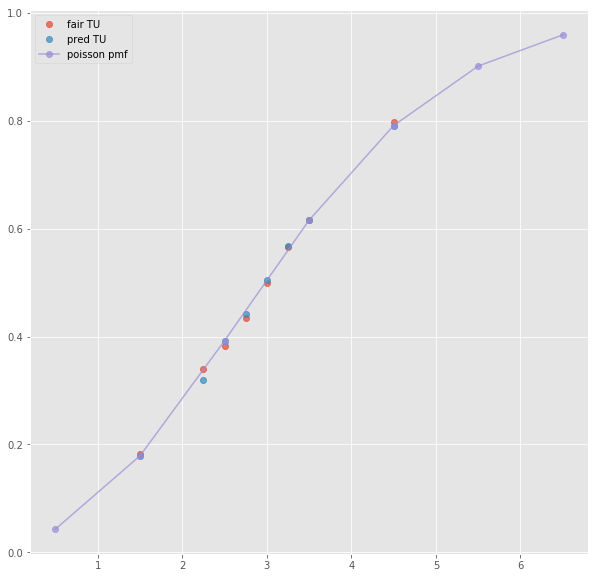

Error T1O:  0.002035697284085647
ML : 1.337 5.25 7.96
Error home:  0.00403255964322391
Error draw:  0.0008629776238509579
Error away:  0.00489561501932359

(35, 124)
(1, 69)
3.5 2.5 1.5 -1.5 2.075 1.725
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.00868177267704695

Error TO:  0.0283832840453333

Error TO:  0.02253280098523719

Error TO:  6.56261484577314e-06

Error TO:  0.012593516748375999

Error TO:  0.008944086869274948

Error TO:  0.024340724817056292

Error TO:  0.012688102904490517

Error TO:  0.002874702157919795

Error TO:  0.01995802010063008

Error TO:  0.01005424536302077

Error TO:  0.009218399642029723

Error TO:  0.0014226721918641494

Error TO:  0.024801797381581947

Error TO:  0.009081106112049597



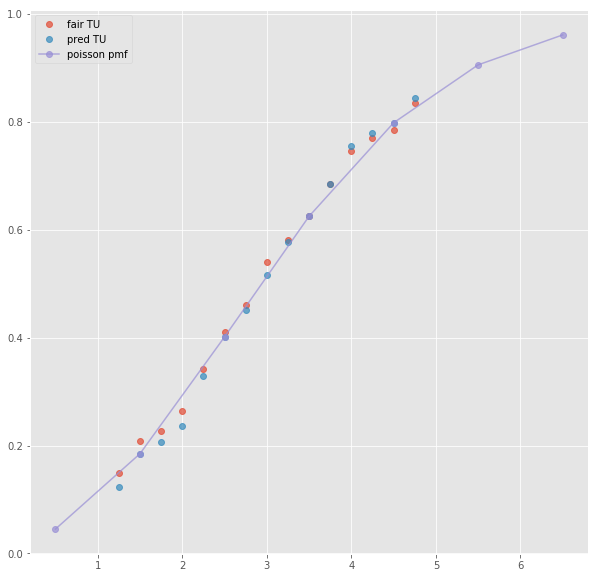

ML : 1.4 4.75 7.5
Error home:  0.013660219806757912
Error draw:  0.015972209747844524
Error away:  0.0023118442644353143

(19, 124)
(1, 35)
3.5 2.46 1.58 -1.5 2.0 1.85
TO fair:  2.5569620253164556 TU fair:  1.6422764227642277
TO pred:  2.55696 TU fair:  1.64228
Error TO:  0.007808635245107554

Error TO:  0.005928624712056463

Error TO:  3.097737969470771e-07

Error TO:  0.00959949158081963

Error TO:  0.036364943529052285

Error TO:  0.0028239397212498907



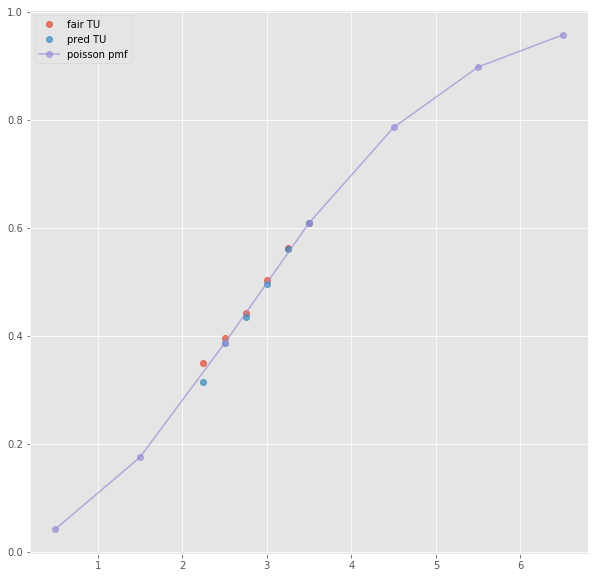

Error T1O:  0.0002083467787738491
ML : 1.37 5.31 8.05
Error home:  0.01049969435202347
Error draw:  0.007606646364730435
Error away:  0.0028930421979546928

(43, 124)
(1, 42)
3.5 2.37 1.625 -0.5 1.8 2.1
TO fair:  2.4584615384615387 TU fair:  1.6856540084388185
TO pred:  2.45851 TU fair:  1.68563
Error TO:  0.0018623725226586396

Error TO:  0.0013771258099338768

Error TO:  8.017921495184765e-06

Error TO:  0.00412884585972681

Error TO:  0.002515557536561075

Error TO:  0.00626736746383294

Error TO:  0.0006464330872743007



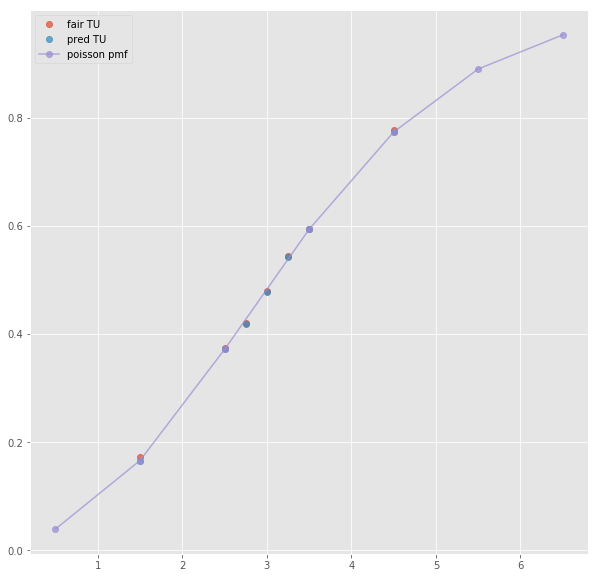

ML : 1.8 4.22 4.04
Error home:  0.004304339814576785
Error draw:  0.00977840588027451
Error away:  0.0054739761612422055

(50, 124)
(1, 23)
next list index out of range
(93, 124)
(1, 19)
next list index out of range
(183, 124)
(1, 25)
next list index out of range
(33, 124)
(1, 44)
3.5 2.37 1.625 -0.5 1.8 2.1
TO fair:  2.4584615384615387 TU fair:  1.6856540084388185
TO pred:  2.45851 TU fair:  1.68563
Error TO:  0.0018623725226586396

Error TO:  0.0013771258099338768

Error TO:  8.017921495184765e-06

Error TO:  0.00412884585972681

Error TO:  0.002515557536561075

Error TO:  0.00626736746383294

Error TO:  0.0006464330872743007



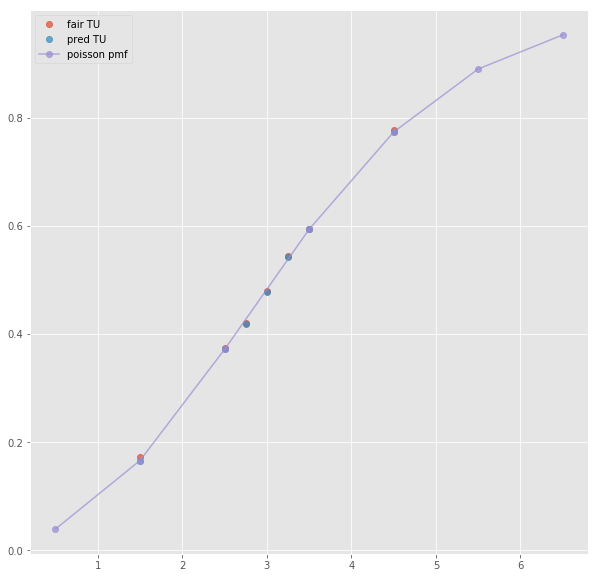

Error T1O:  0.001609640916241717
ML : 1.8 4.22 4.04
Error home:  0.004304339814576785
Error draw:  0.00977840588027451
Error away:  0.0054739761612422055

(10, 124)
(1, 34)
3.5 2.35 1.63 -0.5 1.79 2.08
TO fair:  2.441717791411043 TU fair:  1.6936170212765955
TO pred:  2.44173 TU fair:  1.69361
Error TO:  0.011728671478022479

Error TO:  0.009366198992772579

Error TO:  2.047728454857012e-06

Error TO:  0.013666072489601833

Error TO:  0.003257129402711001



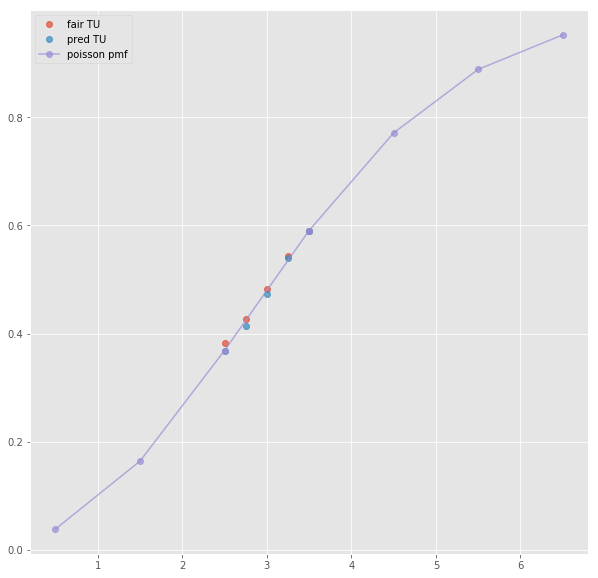

Error T1O:  0.0012885516340941372
ML : 1.8 4.1 4.17
Error home:  0.0028900190672953574
Error draw:  0.016879197078675412
Error away:  0.01398934761715373

(42, 124)
(1, 44)
2.5 1.99 1.869 0.5 1.943 1.943
TO fair:  2.0647405029427506 TU fair:  1.9391959798994978
TO pred:  2.06478 TU fair:  1.93916
Error TO:  0.003102748159712787

Error TO:  0.007155261646272226

Error TO:  0.007576878037168666

Error TO:  0.01034987279783578

Error TO:  9.26457448763296e-06

Error TO:  0.007207548348318826

Error TO:  0.0036374382532480265

Error TO:  0.008257258600551376



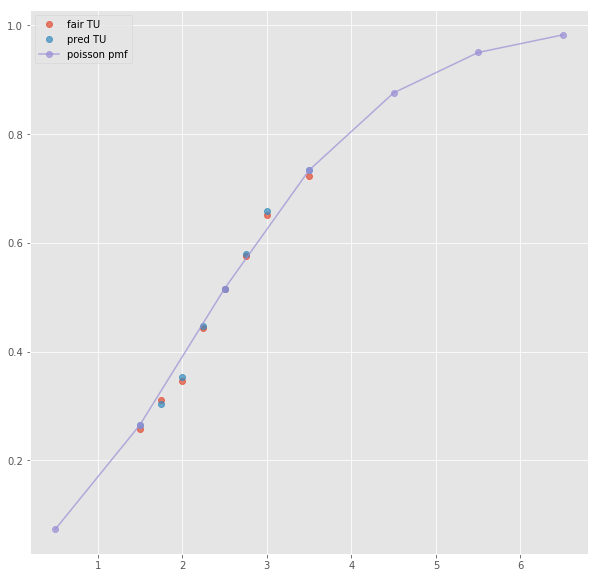

ML : 4.15 3.52 1.943
Error home:  0.016448920161170555
Error draw:  0.021433620048517454
Error away:  0.0049849495084020035

(57, 124)
(1, 21)
2.5 2.02 1.8 0.5 1.93 1.91
TO fair:  2.1222222222222222 TU fair:  1.8910891089108912
TO pred:  2.12224 TU fair:  1.89108
Error TO:  3.947227151912536e-06

Error TO:  0.0002877437057263732



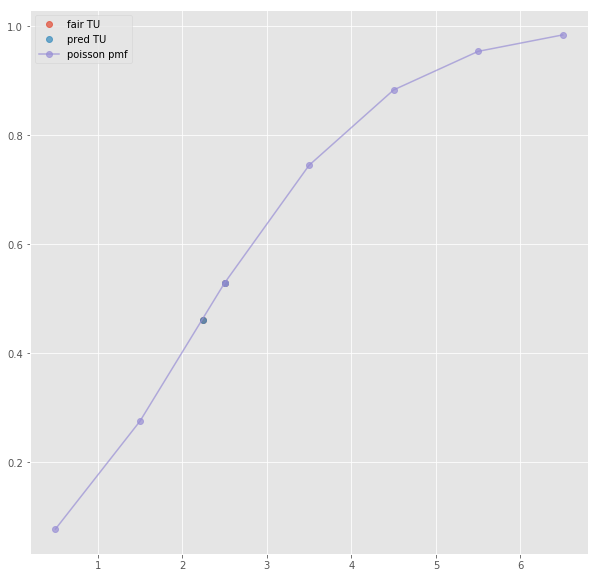

ML : 3.51 3.51 1.9
Error home:  0.016658635449718406
Error draw:  0.005798647234461329
Error away:  0.022457010711682213

(96, 124)
(1, 21)
2.5 2.05 1.85 0.5 1.93 1.99
TO fair:  2.108108108108108 TU fair:  1.902439024390244
TO pred:  2.10809 TU fair:  1.90246
Error TO:  4.074656959507372e-06

Error TO:  0.004352721075564392



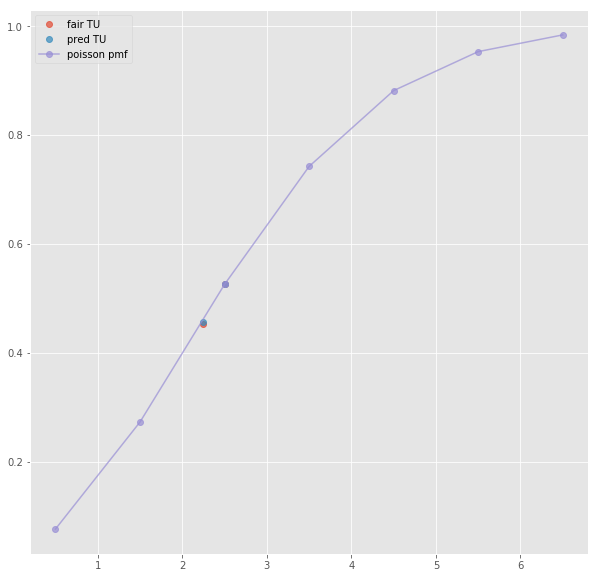

ML : 4.0 3.55 1.94
Error home:  0.01372490583945965
Error draw:  0.01383635471099176
Error away:  0.00011121573108413552

(178, 124)
(1, 21)
2.5 2.03 1.87 0.5 1.93 1.99
TO fair:  2.085561497326203 TU fair:  1.9211822660098523
TO pred:  2.08557 TU fair:  1.92117
Error TO:  1.9548243775369123e-06

Error TO:  0.0011445261417841746



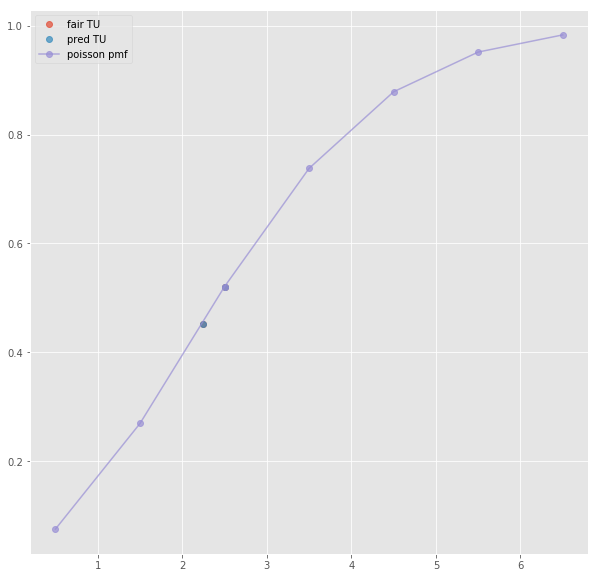

ML : 3.95 3.4 1.99
Error home:  0.012403743844528081
Error draw:  0.02609014625606959
Error away:  0.013686487569861017

(39, 124)
(1, 46)
2.5 1.99 1.869 0.5 1.943 1.943
TO fair:  2.0647405029427506 TU fair:  1.9391959798994978
TO pred:  2.06478 TU fair:  1.93916
Error TO:  0.003102748159712787

Error TO:  0.007155261646272226

Error TO:  0.007576878037168666

Error TO:  0.01034987279783578

Error TO:  9.26457448763296e-06

Error TO:  0.007207548348318826

Error TO:  0.0036374382532480265

Error TO:  0.008257258600551376



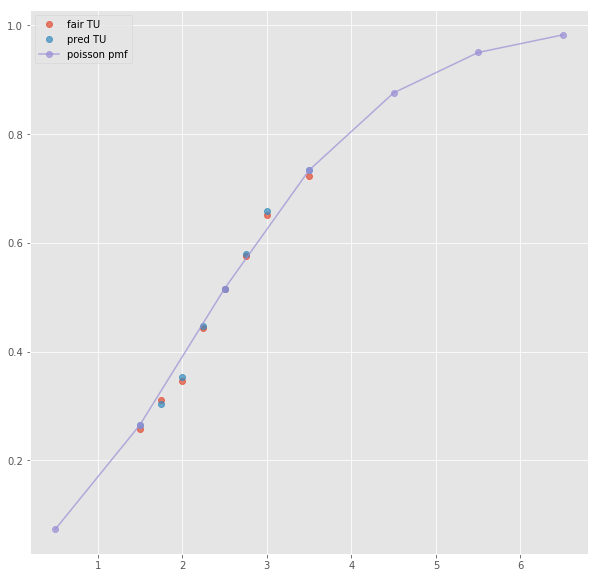

Error T1O:  0.0035508229051188223
ML : 4.15 3.52 1.943
Error home:  0.016448920161170555
Error draw:  0.021433620048517454
Error away:  0.0049849495084020035

(9, 124)
(1, 59)
2.5 2.025 1.775 0.5 1.9 1.95
TO fair:  2.1408450704225355 TU fair:  1.8765432098765433
TO pred:  2.14082 TU fair:  1.87656
Error TO:  0.001482579897839953

Error TO:  0.012446134146293142

Error TO:  0.00869026963056091

Error TO:  0.012643463222822726

Error TO:  5.470112534378124e-06

Error TO:  0.007857090634367458

Error TO:  0.0026752971536935233

Error TO:  0.004496085439738118

Error TO:  0.010197936577159283

Error TO:  0.01916654525235656

Error TO:  0.01674769794000984

Error TO:  0.017713539863292466

Error TO:  0.023124978640992833



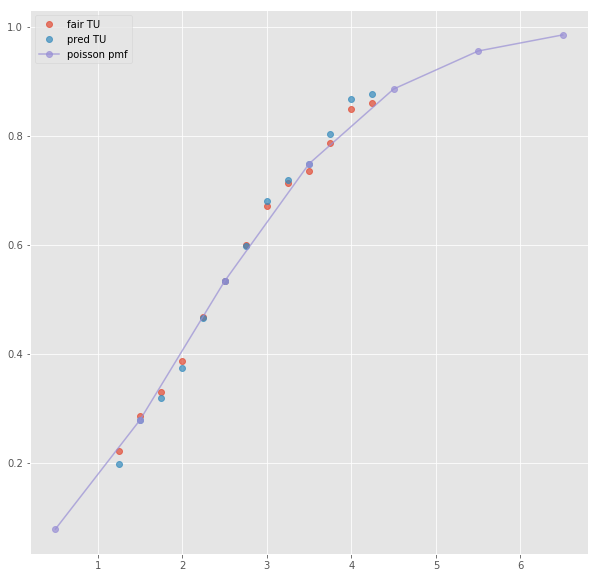

ML : 4.0 3.4 1.91
Error home:  0.015795735336432443
Error draw:  0.018928382057021687
Error away:  0.0031326404643257644

(5, 124)
(1, 34)
2.5 2.09 1.78 0.5 2.04 1.82
TO fair:  2.1741573033707864 TU fair:  1.8516746411483256
TO pred:  2.1742 TU fair:  1.85164
Error TO:  0.004900810348438034

Error TO:  0.002229951910364014

Error TO:  0.019230814658714068

Error TO:  9.032399454544926e-06

Error TO:  0.0001061469843277596

Error TO:  0.0027445021406367065



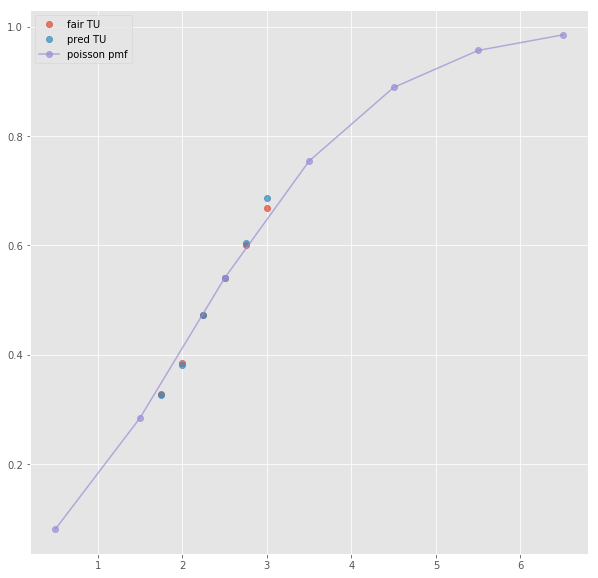

Error T1O:  0.010116889166159937
ML : 4.64 3.6 1.83
Error home:  0.012652679651302318
Error draw:  0.01559147927819271
Error away:  0.002938652599967173

(2, 124)
(1, 42)
2.5 1.961 1.934 0.5 2.24 1.724
TO fair:  2.0139607032057913 TU fair:  1.9862315145334013
TO pred:  2.01393 TU fair:  1.98626
Error TO:  0.004442766859012959

Error TO:  0.008982285659341005

Error TO:  0.011734274748613216

Error TO:  0.015784958924832615

Error TO:  0.01599038785768364

Error TO:  7.569868930912271e-06

Error TO:  0.008317017048296016

Error TO:  0.002391505715644837



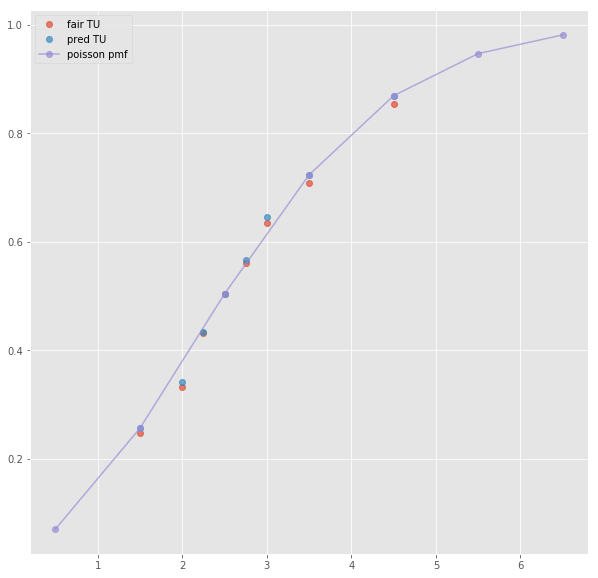

ML : 5.0 3.92 1.724
Error home:  0.005649943320946982
Error draw:  0.010392251770975386
Error away:  0.00474213104018939

(1, 124)
(1, 23)
2.5 1.87 1.95 0.5 2.19 1.69
TO fair:  1.958974358974359 TU fair:  2.0427807486631013
TO pred:  1.95894 TU fair:  2.04282
Error TO:  0.005786321555416307

Error TO:  8.95344779106022e-06

Error TO:  0.007352474274947451



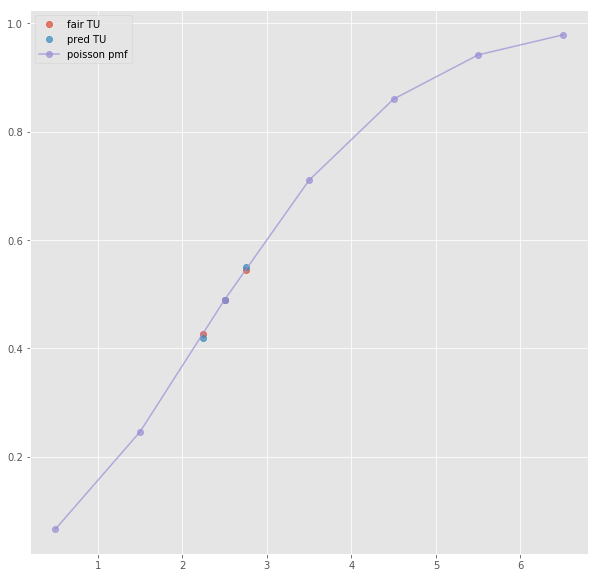

ML : 4.56 3.61 1.69
Error home:  0.00043125223079276687
Error draw:  0.021015309799994913
Error away:  0.020584310846338383

(1, 124)
(1, 15)
next list index out of range
(1, 124)
(1, 23)
2.5 1.94 1.96 0.5 2.23 1.74
TO fair:  1.989795918367347 TU fair:  2.0103092783505154
TO pred:  1.9898 TU fair:  2.01031
Error TO:  0.005369500387186865

Error TO:  1.0308986085894034e-06

Error TO:  0.0052530479251431395



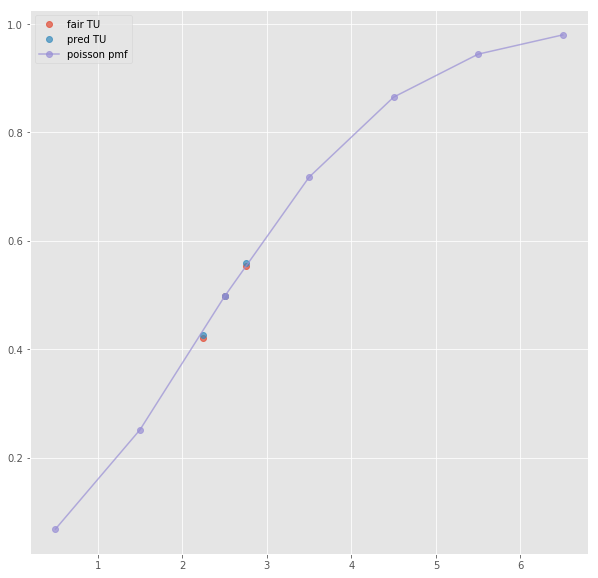

ML : 4.8 3.65 1.73
Error home:  0.006092876421853355
Error draw:  0.02267772649262853
Error away:  0.01658460684455043

(32, 124)
next positional indexers are out-of-bounds
(58, 124)
next positional indexers are out-of-bounds
(58, 124)
next positional indexers are out-of-bounds
(246, 124)
next positional indexers are out-of-bounds
(31, 124)
(1, 45)
3.5 2.71 1.492 -0.5 2.71 1.507
TO fair:  2.8163538873994636 TU fair:  1.5505535055350552
TO pred:  2.81638 TU fair:  1.55054
Error TO:  0.008900180026574667

Error TO:  0.0067204065717385575

Error TO:  3.2920896133603605e-06

Error TO:  0.0042778223969022755

Error TO:  0.009707489141158265

Error TO:  0.006094387654574929

Error TO:  0.009412961899181949

Error TO:  0.0031347112523273934



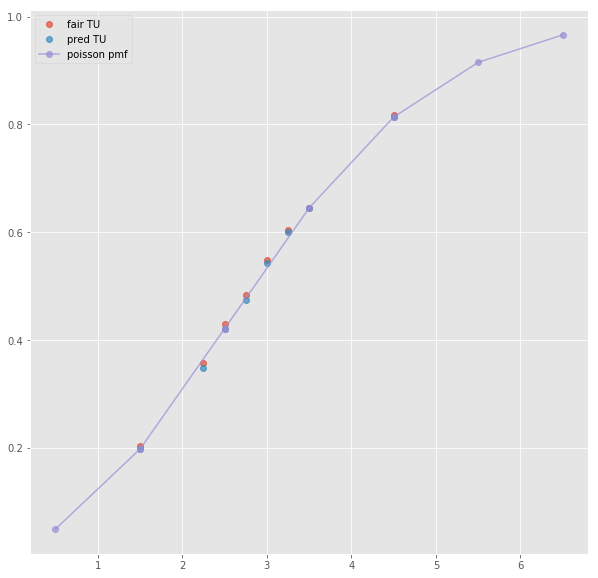

Error T1O:  0.009095759945474735
ML : 2.71 3.56 2.6
Error home:  0.0006849955423121612
Error draw:  0.029312900042776535
Error away:  0.028627795856884075

(31, 124)
(1, 67)
3.5 2.6 1.475 -0.5 2.5 1.5
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.014237090532022822

Error TO:  0.025807077317834826

Error TO:  0.012479244015746571

Error TO:  6.306488034957258e-06

Error TO:  0.010726207947077154

Error TO:  0.02384485232508171

Error TO:  0.02117981750360798

Error TO:  0.02067264661700574

Error TO:  0.006330379820712273

Error TO:  0.02415882778140921

Error TO:  0.010233698810505898

Error TO:  0.012098567328329951

Error TO:  0.0007934326163293037

Error TO:  0.02801228972349956

Error TO:  0.013207676297442295



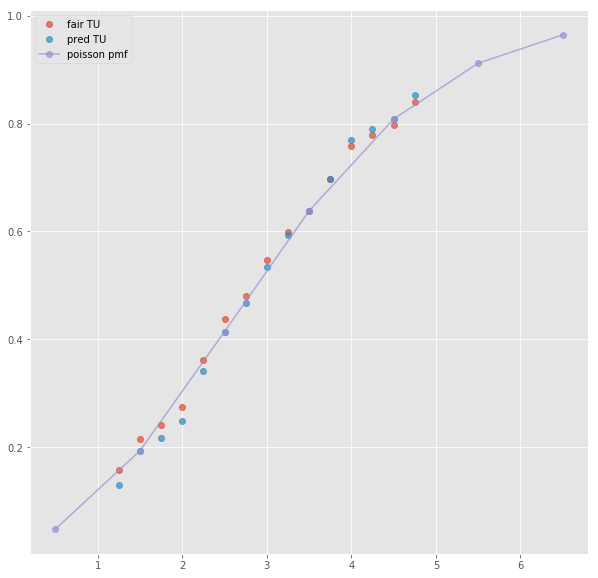

ML : 2.4 3.4 2.8
Error home:  0.015178465113165451
Error draw:  0.03429433933148318
Error away:  0.04947303532471109

(4, 124)
(1, 33)
2.5 1.7 2.22 -0.5 2.68 1.5
TO fair:  1.7657657657657657 TU fair:  2.3058823529411767
TO pred:  1.76573 TU fair:  2.30594
Error TO:  0.005230222206865198

Error TO:  0.009845374014825992

Error TO:  1.147123401701311e-05

Error TO:  0.0019992368644839997

Error TO:  0.013451406318743975



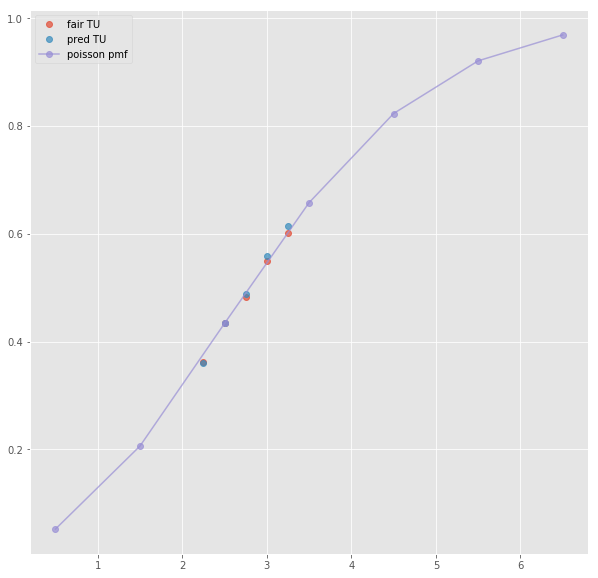

Error T1O:  0.011060279778550008
ML : 2.73 3.56 2.55
Error home:  0.006427593724489644
Error draw:  0.0253294512521538
Error away:  0.018901562955205398

(22, 124)
(1, 40)
2.5 2.18 1.729 -0.5 1.709 2.24
TO fair:  2.2608444187391554 TU fair:  1.793119266055046
TO pred:  2.26085 TU fair:  1.79312
Error TO:  0.002854231173848698

Error TO:  0.005242690855607579

Error TO:  0.011554343924450455

Error TO:  1.0919176690604715e-06

Error TO:  0.005570215823967439

Error TO:  0.0021482116188041855

Error TO:  0.006226448844429577



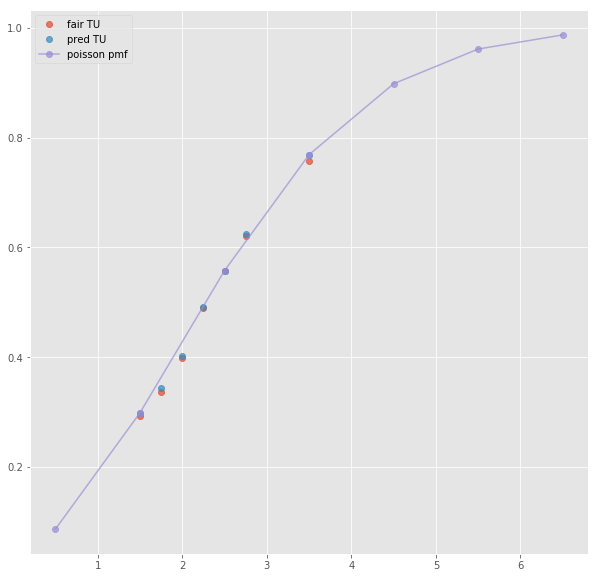

ML : 1.709 3.56 5.7
Error home:  0.00539566616452114
Error draw:  0.02341744771234472
Error away:  0.018021876206203102

(56, 124)
(1, 25)
2.5 2.16 1.68 -0.5 1.74 2.11
TO fair:  2.2857142857142856 TU fair:  1.7777777777777777
TO pred:  2.28574 TU fair:  1.77776
Error TO:  0.027621832886687736

Error TO:  0.002593644406210238

Error TO:  4.921819629521984e-06

Error TO:  0.010212551922652136



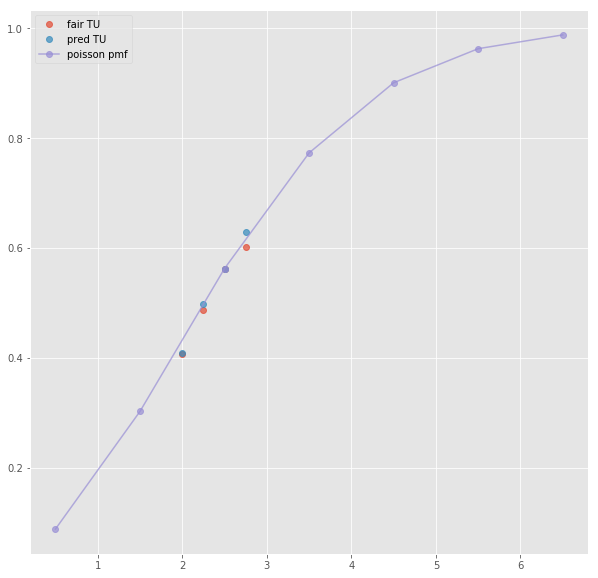

ML : 1.73 3.56 4.76
Error home:  0.007325519517327406
Error draw:  0.010735370757764928
Error away:  0.0034097727598801086

(81, 124)
(1, 21)
2.5 2.2 1.73 -0.5 1.75 2.2
TO fair:  2.2716763005780347 TU fair:  1.7863636363636364
TO pred:  2.27165 TU fair:  1.78638
Error TO:  5.096563353679251e-06

Error TO:  0.0018344739778947128



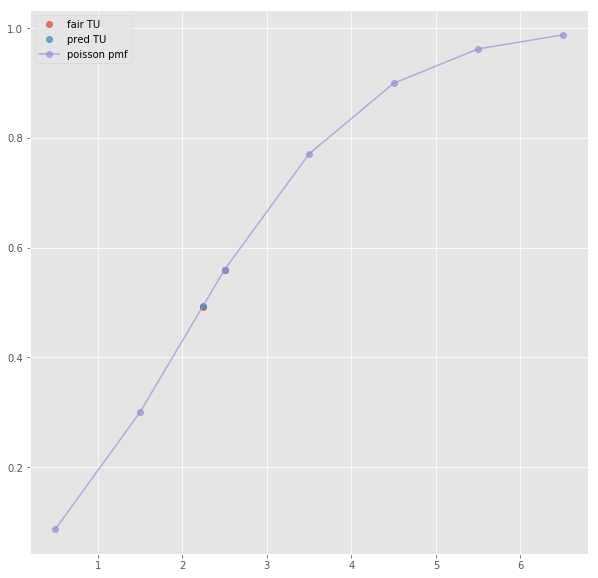

ML : 1.71 3.6 5.6
Error home:  0.004718517715066484
Error draw:  0.017495339064324128
Error away:  0.02221369826593922

(162, 124)
(1, 25)
2.5 2.23 1.71 -0.5 1.75 2.2
TO fair:  2.3040935672514617 TU fair:  1.7668161434977576
TO pred:  2.30408 TU fair:  1.76682
Error TO:  0.03031016976552514

Error TO:  0.011494260445273796

Error TO:  2.555607823140349e-06

Error TO:  0.003517281991396448



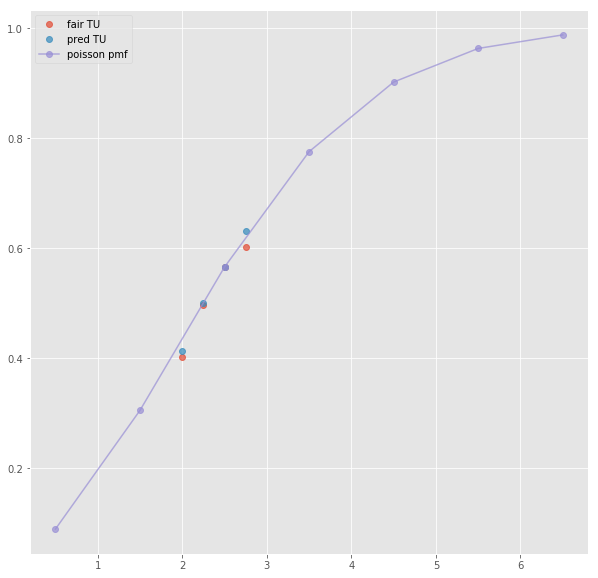

ML : 1.74 3.55 5.2
Error home:  0.00894192746644984
Error draw:  0.017977753701598542
Error away:  0.009035908752136224

(17, 124)
(1, 42)
2.5 2.18 1.729 -0.5 1.709 2.24
TO fair:  2.2608444187391554 TU fair:  1.793119266055046
TO pred:  2.26085 TU fair:  1.79312
Error TO:  0.002854231173848698

Error TO:  0.005242690855607579

Error TO:  0.011554343924450455

Error TO:  1.0919176690604715e-06

Error TO:  0.005570215823967439

Error TO:  0.0021482116188041855

Error TO:  0.006226448844429577



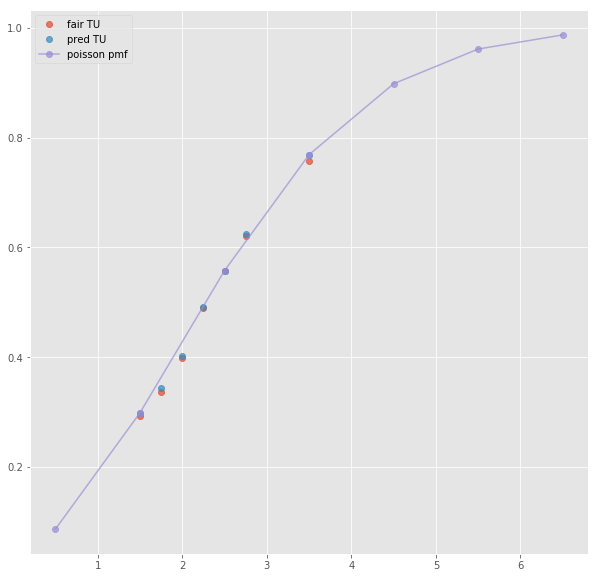

Error T1O:  0.00842141471067226
ML : 1.709 3.56 5.7
Error home:  0.00539566616452114
Error draw:  0.02341744771234472
Error away:  0.018021876206203102

(8, 124)
next positional indexers are out-of-bounds
(15, 124)
next positional indexers are out-of-bounds
(26, 124)
(1, 41)
2.5 2.53 1.558 0.5 1.641 2.37
TO fair:  2.6238767650834403 TU fair:  1.6158102766798421
TO pred:  2.62394 TU fair:  1.61579
Error TO:  0.036394023950621246

Error TO:  0.0031143797695182274

Error TO:  0.015280917976048969

Error TO:  9.184586654165106e-06

Error TO:  0.002666704558491162

Error TO:  0.00044740213551586194

Error TO:  0.003441151904678086

Error TO:  0.01643602028766533



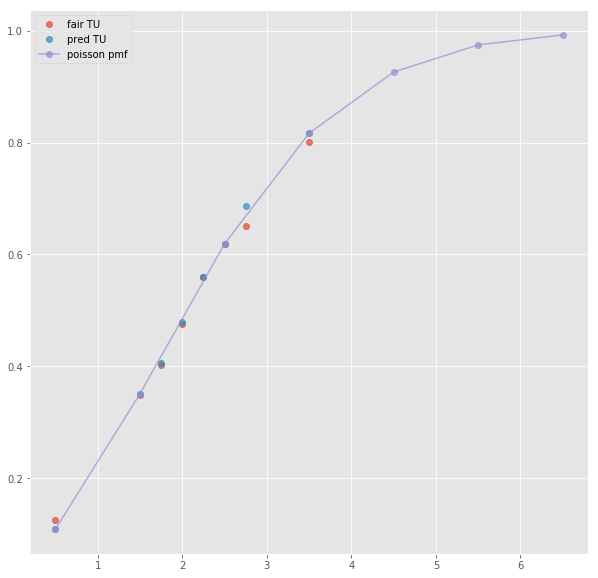

ML : 3.4 3.14 2.37
Error home:  0.018534987643749112
Error draw:  0.019795783338458994
Error away:  0.001260792104501307

(107, 124)
(1, 19)
next list index out of range
(98, 124)
(1, 21)
next list index out of range
(189, 124)
(1, 19)
next list index out of range
(21, 124)
(1, 43)
2.5 2.53 1.558 0.5 1.641 2.37
TO fair:  2.6238767650834403 TU fair:  1.6158102766798421
TO pred:  2.62394 TU fair:  1.61579
Error TO:  0.036394023950621246

Error TO:  0.0031143797695182274

Error TO:  0.015280917976048969

Error TO:  9.184586654165106e-06

Error TO:  0.002666704558491162

Error TO:  0.00044740213551586194

Error TO:  0.003441151904678086



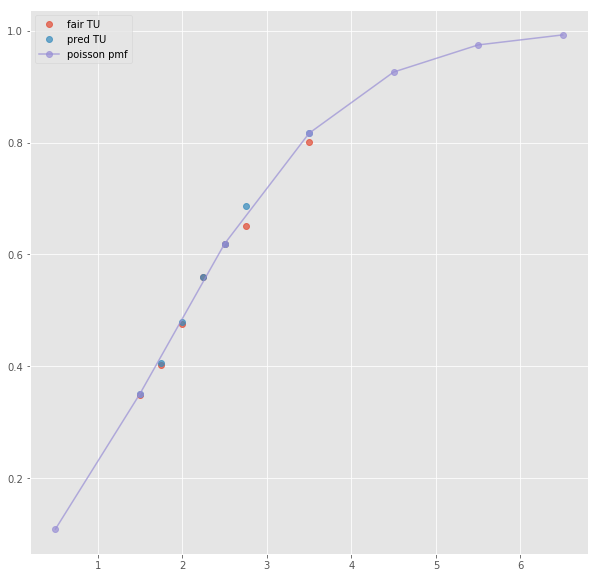

Error T1O:  0.008801687178772721
ML : 3.4 3.14 2.37
Error home:  0.018534987643749112
Error draw:  0.019795783338458994
Error away:  0.001260792104501307

(93, 124)
(1, 59)
2.5 2.375 1.55 0.5 1.65 2.2
TO fair:  2.5322580645161286 TU fair:  1.6526315789473682
TO pred:  2.53226 TU fair:  1.65263
Error TO:  0.0021684298345053254

Error TO:  0.0012315829133628942

Error TO:  0.011485125092901421

Error TO:  0.015378316451859775

Error TO:  3.0183757210311413e-07

Error TO:  0.01272463590399564

Error TO:  0.0016168934737302298

Error TO:  0.014620705993667854

Error TO:  0.010443100374867842

Error TO:  0.01568727962067029

Error TO:  0.022955544154362517

Error TO:  0.0251261023585736

Error TO:  0.026417843983502443



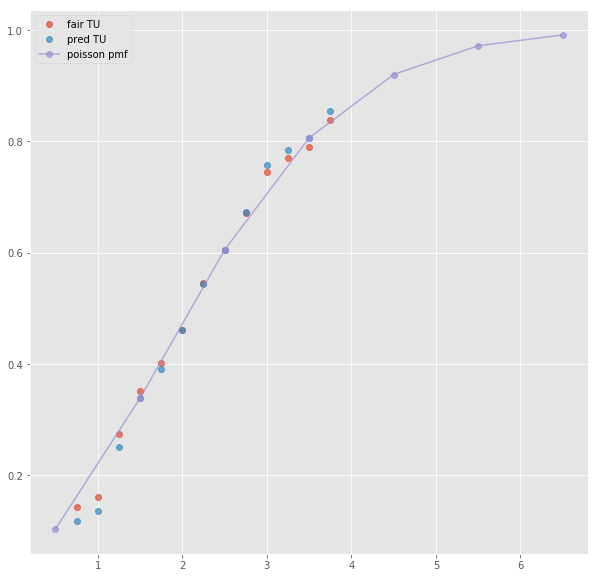

ML : 3.5 3.2 2.15
Error home:  0.020177053533288858
Error draw:  0.011349360131613473
Error away:  0.008827832226747212

(2, 124)
(1, 33)
2.5 2.41 1.6 0.5 1.66 2.29
TO fair:  2.5062499999999996 TU fair:  1.6639004149377592
TO pred:  2.50621 TU fair:  1.66392
Error TO:  0.00498830486953683

Error TO:  0.002232286553373819

Error TO:  6.3682212386728665e-06

Error TO:  0.00021954882526159514

Error TO:  0.00206186860028712



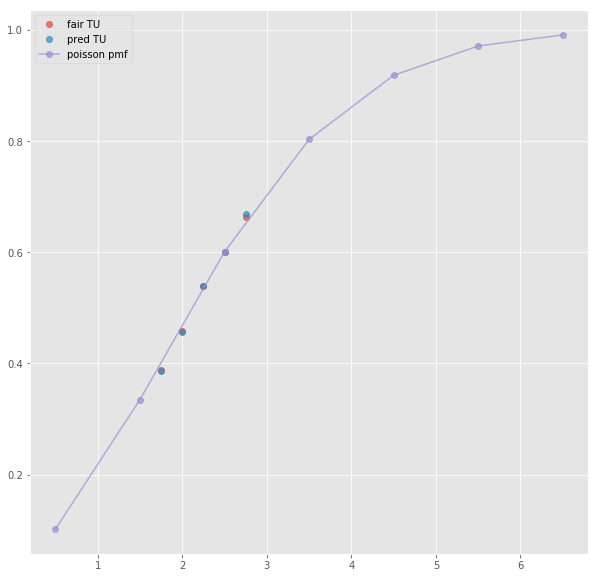

Error T1O:  0.009500954579487852
ML : 3.46 3.12 2.32
Error home:  0.01975168060671828
Error draw:  0.0257858279323544
Error away:  0.006033851380358557

(67, 124)
(1, 41)
2.5 2.26 1.6840000000000002 -0.5 2.2 1.729
TO fair:  2.342042755344418 TU fair:  1.745132743362832
TO pred:  2.34208 TU fair:  1.74511
Error TO:  0.00014335318854902246

Error TO:  0.0021090935292364943

Error TO:  0.00043323767683353664

Error TO:  6.789963159670176e-06

Error TO:  0.00201820993803703

Error TO:  0.0008549513426651112

Error TO:  0.0025646633488944914



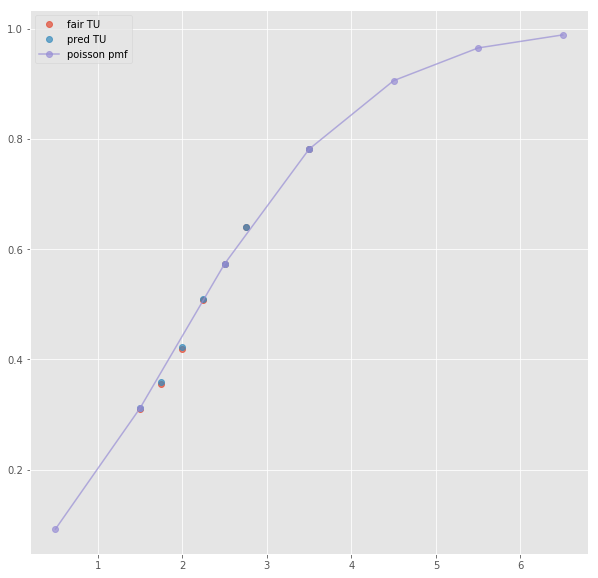

ML : 2.2 3.31 3.58
Error home:  0.0013221953315642465
Error draw:  0.01848869673048259
Error away:  0.017166814185484325

(161, 124)
(1, 25)
2.5 2.29 1.59 -0.5 2.19 1.68
TO fair:  2.440251572327044 TU fair:  1.6943231441048037
TO pred:  2.44018 TU fair:  1.69436
Error TO:  0.005396935933147606

Error TO:  1.2019562863063715e-05

Error TO:  0.009440446339658737



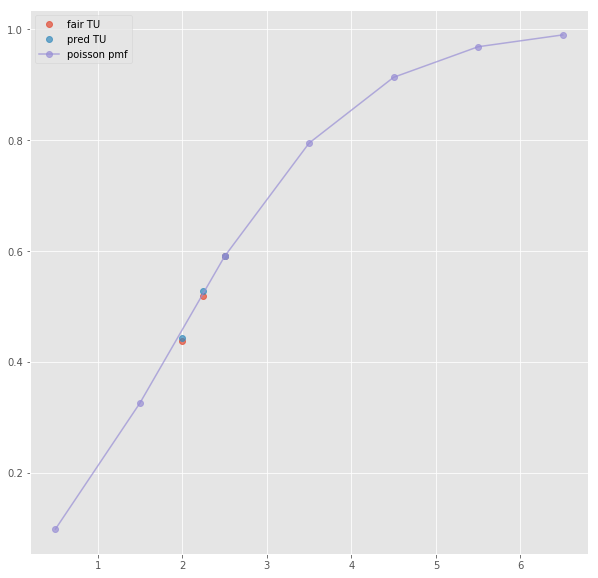

ML : 2.19 3.01 3.26
Error home:  0.017312968057147993
Error draw:  0.025159524553118373
Error away:  0.007846898980130523

(208, 124)
(1, 21)
next list index out of range
(405, 124)
(1, 23)
2.5 2.31 1.66 -0.5 2.21 1.74
TO fair:  2.391566265060241 TU fair:  1.7186147186147185
TO pred:  2.39162 TU fair:  1.71859
Error TO:  0.008268996465233935

Error TO:  9.394683877006482e-06

Error TO:  0.010818542665679554



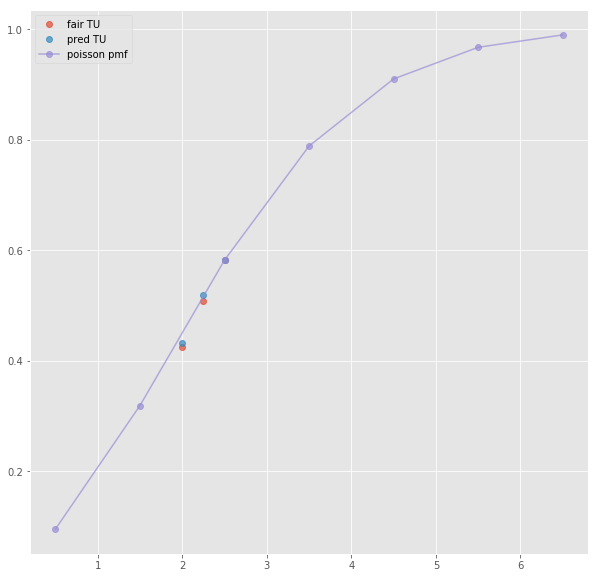

ML : 2.2 3.1 3.65
Error home:  0.00805159984347914
Error draw:  0.03161815550873709
Error away:  0.023566555233703768

(66, 124)
(1, 43)
2.5 2.26 1.6840000000000002 -0.5 2.2 1.729
TO fair:  2.342042755344418 TU fair:  1.745132743362832
TO pred:  2.34208 TU fair:  1.74511
Error TO:  0.00014335318854902246

Error TO:  0.0021090935292364943

Error TO:  0.00043323767683353664

Error TO:  6.789963159670176e-06

Error TO:  0.00201820993803703

Error TO:  0.0008549513426651112

Error TO:  0.0025646633488944914



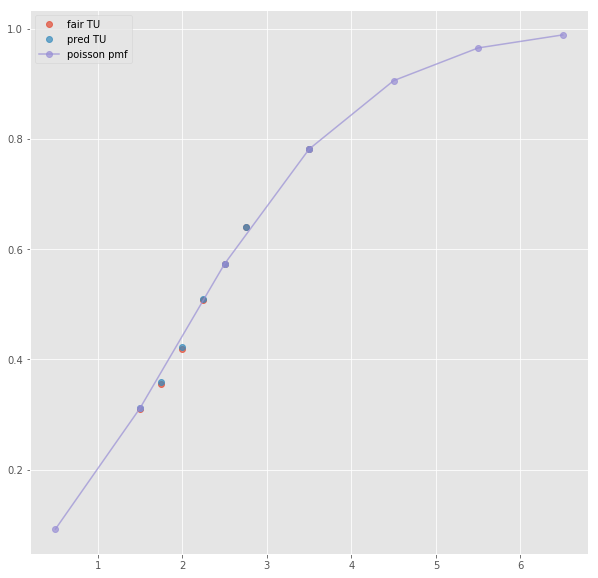

Error T1O:  0.0017533024357600513
ML : 2.2 3.31 3.58
Error home:  0.0013221953315642465
Error draw:  0.01848869673048259
Error away:  0.017166814185484325

(44, 124)
(1, 59)
2.5 2.25 1.625 -0.5 2.1 1.7
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.009547734651831286

Error TO:  0.002412627601825479

Error TO:  0.018463264954572955

Error TO:  0.022573559724438308

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.0023390419334406443

Error TO:  0.027128482339291993

Error TO:  0.00927629075225167

Error TO:  0.019463835812848967

Error TO:  0.01555031236588067

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



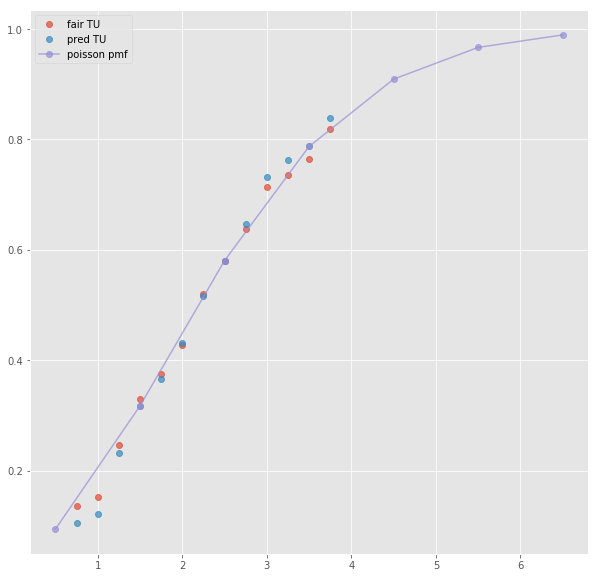

ML : 2.05 3.1 4.0
Error home:  0.012650719796237553
Error draw:  0.03002703495397846
Error away:  0.04267808722022265

(22, 124)
(1, 35)
2.5 2.29 1.66 -0.5 2.17 1.73
TO fair:  2.379518072289157 TU fair:  1.7248908296943233
TO pred:  2.37949 TU fair:  1.72491
Error TO:  0.004647076331203592

Error TO:  0.00235699246688037

Error TO:  4.957981901365649e-06

Error TO:  0.001988513762080646

Error TO:  0.0032174802173351447



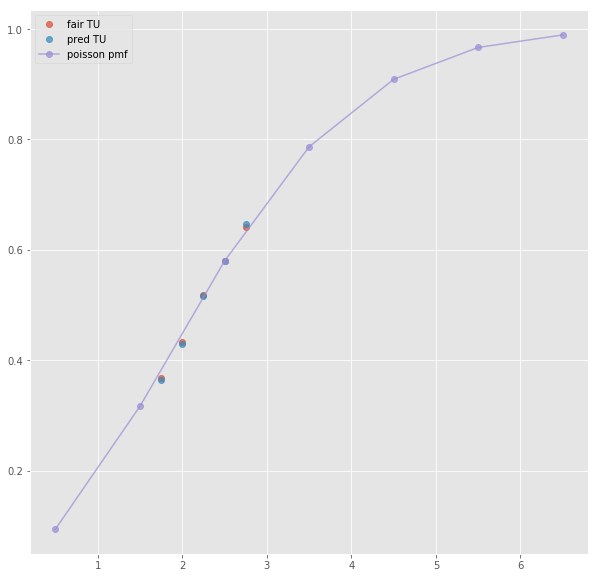

Error T1O:  0.009228601600431097
ML : 2.19 3.2 3.69
Error home:  0.0045981175190907275
Error draw:  0.026045415744441525
Error away:  0.02144743248549358

(54, 124)
(1, 41)
2.5 2.49 1.588 -0.5 2.11 1.813
TO fair:  2.5680100755667503 TU fair:  1.637751004016064
TO pred:  2.56799 TU fair:  1.63776
Error TO:  0.0013112251546251175

Error TO:  0.008266581241862886

Error TO:  3.0442321138912654e-06

Error TO:  0.0016462679800756108

Error TO:  1.3259400291898427e-05

Error TO:  0.001230421774437107

Error TO:  0.013279097960427255



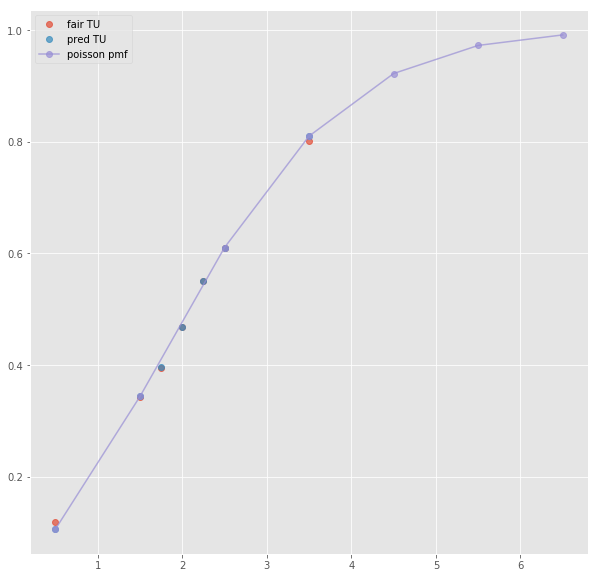

ML : 2.11 3.25 3.99
Error home:  0.003037049426308558
Error draw:  0.018218117520459598
Error away:  0.015180848102380545

(214, 124)
(1, 27)
2.5 2.44 1.53 -0.5 2.05 1.8
TO fair:  2.5947712418300655 TU fair:  1.627049180327869
TO pred:  2.59476 TU fair:  1.62705
Error TO:  1.1041163649916363e-05

Error TO:  1.669708837359618e-06

Error TO:  0.007359646781440465

Error TO:  0.005334430128308476



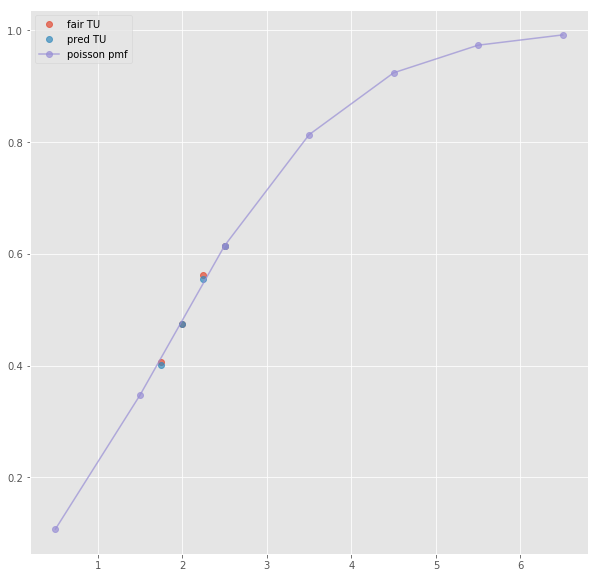

ML : 2.07 3.21 3.81
Error home:  0.010535251149797364
Error draw:  0.014589597621508299
Error away:  0.004054205163323277

(61, 124)
(1, 24)
next list index out of range
(81, 124)
(1, 28)
2.5 2.49 1.59 -0.5 2.11 1.85
TO fair:  2.566037735849057 TU fair:  1.6385542168674698
TO pred:  2.5661 TU fair:  1.63853
Error TO:  0.0009605194398871753

Error TO:  9.455869172003695e-06

Error TO:  0.006960946649197275

Error TO:  0.001721569282576052



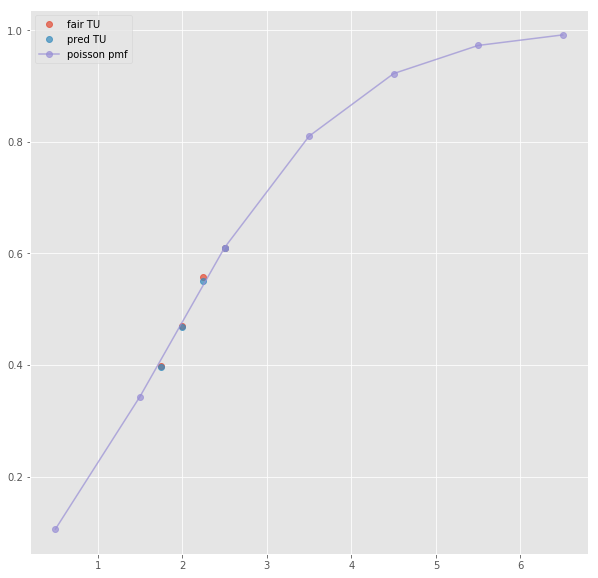

ML : 2.09 3.25 3.95
Error home:  0.00682240743926571
Error draw:  0.017008704029016275
Error away:  0.01018630570583584

(11, 124)
(1, 43)
2.5 2.49 1.588 -0.5 2.11 1.813
TO fair:  2.5680100755667503 TU fair:  1.637751004016064
TO pred:  2.56799 TU fair:  1.63776
Error TO:  0.0013112251546251175

Error TO:  0.008266581241862886

Error TO:  3.0442321138912654e-06

Error TO:  0.0016462679800756108

Error TO:  1.3259400291898427e-05

Error TO:  0.001230421774437107

Error TO:  0.013279097960427255



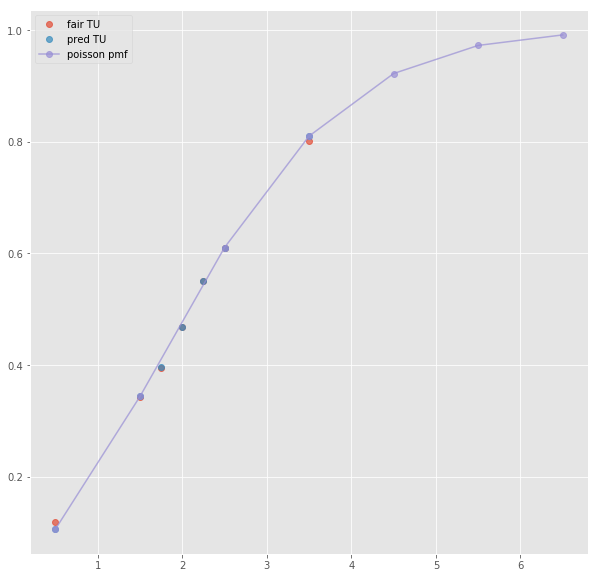

Error T1O:  0.0039469426859530254
ML : 2.11 3.25 3.99
Error home:  0.003037049426308558
Error draw:  0.018218117520459598
Error away:  0.015180848102380545

(69, 124)
(1, 57)
2.5 2.375 1.55 -0.5 2.1 1.83
TO fair:  2.5322580645161286 TU fair:  1.6526315789473682
TO pred:  2.53226 TU fair:  1.65263
Error TO:  0.0021684298345053254

Error TO:  0.011926311823479252

Error TO:  0.011485125092901421

Error TO:  0.00864084859425393

Error TO:  3.0183757210311413e-07

Error TO:  0.01272463590399564

Error TO:  0.008195840842151303

Error TO:  0.0061854792485819265

Error TO:  0.010443100374867842

Error TO:  0.01568727962067029

Error TO:  0.022955544154362517

Error TO:  0.02984359962820593

Error TO:  0.026417843983502443



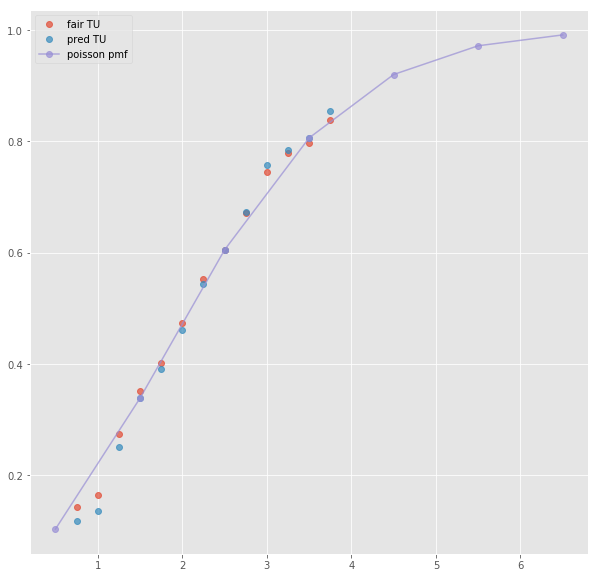

ML : 2.05 3.4 3.75
Error home:  0.00045444212146789065
Error draw:  0.0025660019669591083
Error away:  0.0021114820992359506

(4, 124)
(1, 33)
2.5 2.48 1.57 -0.5 2.06 1.8
TO fair:  2.579617834394904 TU fair:  1.6330645161290323
TO pred:  2.57956 TU fair:  1.63309
Error TO:  0.004282469782255549

Error TO:  8.691309016373161e-06

Error TO:  0.0054911234920774765

Error TO:  0.0026892084400622074

Error TO:  0.005074044769754038



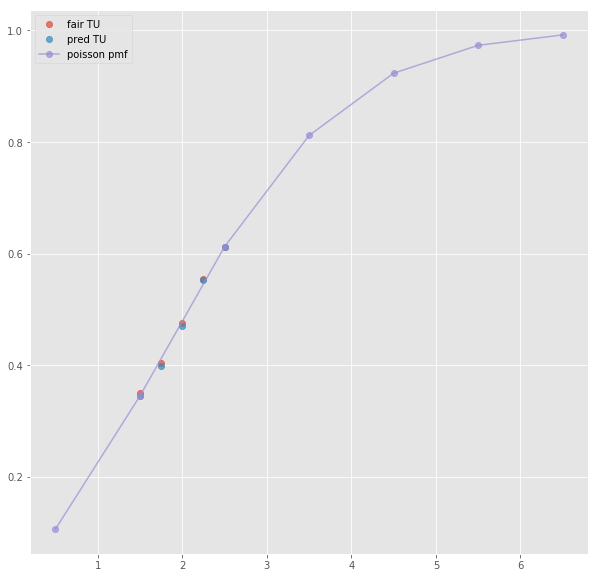

Error T1O:  0.009475327747212936
ML : 2.08 3.21 4.03
Error home:  0.004248105125028323
Error draw:  0.019718047013994988
Error away:  0.01547020151285261

(57, 124)
(1, 47)
3.5 2.96 1.425 0.5 1.806 2.1
TO fair:  3.0771929824561397 TU fair:  1.4814189189189186
TO pred:  3.07713 TU fair:  1.48143
Error TO:  0.0005047324746782489

Error TO:  0.02516126693883558

Error TO:  0.0007945962132216433

Error TO:  6.651491113618402e-06

Error TO:  0.004191196475746756

Error TO:  0.0001328426339456401

Error TO:  0.004650319385587465

Error TO:  0.0014396595196726203

Error TO:  0.0007747396207626323



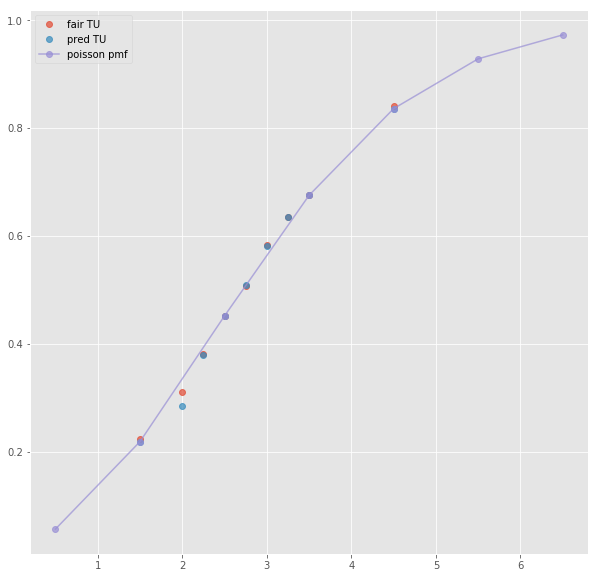

ML : 3.63 3.47 2.1
Error home:  0.028694580068813258
Error draw:  0.033124197114760834
Error away:  0.004429457446669061

(114, 124)
(1, 25)
2.5 1.78 2.04 0.5 1.72 2.13
TO fair:  1.8725490196078434 TU fair:  2.146067415730337
TO pred:  1.87255 TU fair:  2.14606
Error TO:  0.0007974355754882256

Error TO:  0.005648988929824739

Error TO:  2.795974521907496e-07

Error TO:  0.012120099064328316



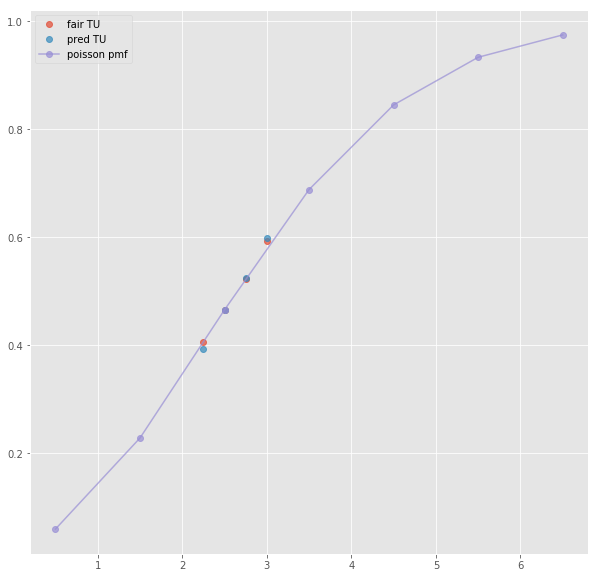

ML : 3.46 3.26 2.14
Error home:  0.03283758603687187
Error draw:  0.04002918246790055
Error away:  0.0071913849607450064

(79, 124)
(1, 21)
2.5 1.78 2.13 0.5 1.76 2.19
TO fair:  1.8356807511737092 TU fair:  2.1966292134831464
TO pred:  1.83567 TU fair:  2.19665
Error TO:  0.013189049121338448

Error TO:  3.190539418218563e-06



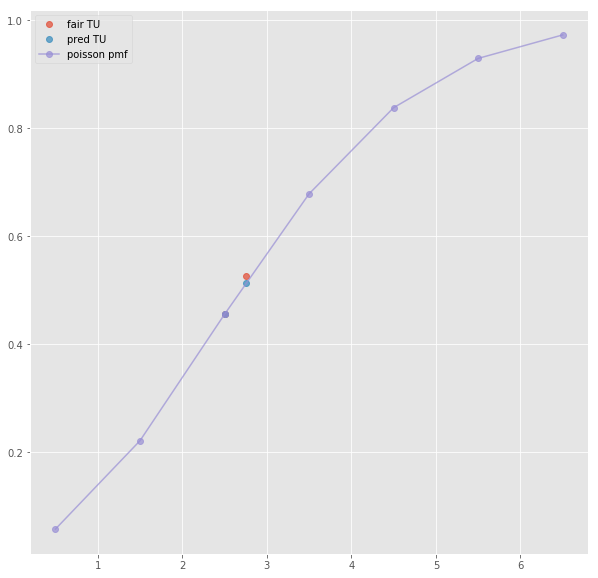

ML : 3.55 3.5 2.08
Error home:  0.03924894851795646
Error draw:  0.02613307791208208
Error away:  0.013115914523532335

(319, 124)
(1, 23)
2.5 1.83 2.07 0.5 1.77 2.17
TO fair:  1.884057971014493 TU fair:  2.1311475409836067
TO pred:  1.88402 TU fair:  2.13119
Error TO:  0.00024836736583522256

Error TO:  1.0697257010972017e-05

Error TO:  0.013607817546916312



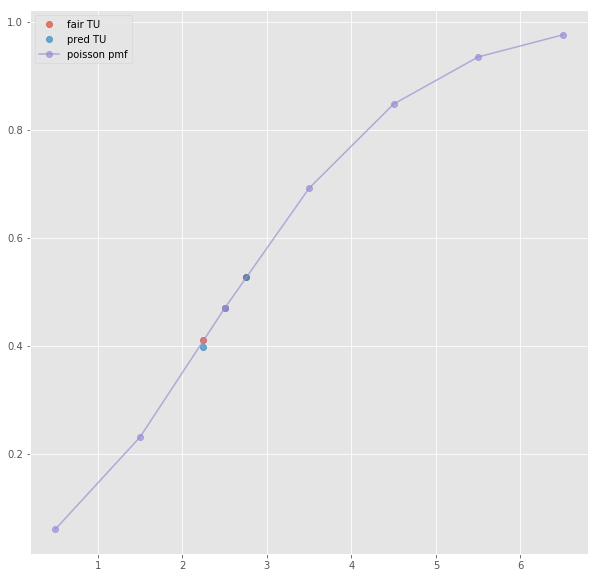

ML : 3.55 3.5 2.07
Error home:  0.033658834950228866
Error draw:  0.023025298447837322
Error away:  0.010633790720181668

(54, 124)
(1, 49)
3.5 2.96 1.425 0.5 1.806 2.1
TO fair:  3.0771929824561397 TU fair:  1.4814189189189186
TO pred:  3.07713 TU fair:  1.48143
Error TO:  0.0005047324746782489

Error TO:  0.02516126693883558

Error TO:  0.0007945962132216433

Error TO:  6.651491113618402e-06

Error TO:  0.004191196475746756

Error TO:  0.0001328426339456401

Error TO:  0.004650319385587465

Error TO:  0.0014396595196726203

Error TO:  0.0007747396207626323



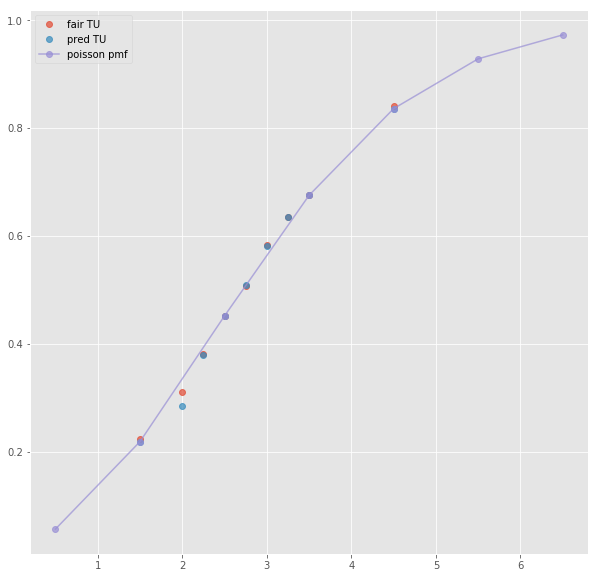

Error T1O:  0.017085350184064874
ML : 3.63 3.47 2.1
Error home:  0.028694580068813258
Error draw:  0.033124197114760834
Error away:  0.004429457446669061

(21, 124)
next positional indexers are out-of-bounds
(94, 124)
next positional indexers are out-of-bounds
(20, 124)
(1, 39)
2.5 1.9 1.961 -0.5 2.01 1.877
TO fair:  1.96889342172361 TU fair:  2.0321052631578946
TO pred:  1.96887 TU fair:  2.03213
Error TO:  0.006727067841212131

Error TO:  0.007220427152708764

Error TO:  0.015385921584224915

Error TO:  0.017484171173053398

Error TO:  6.041984435656289e-06

Error TO:  0.009731014734965182

Error TO:  0.00301735122431368



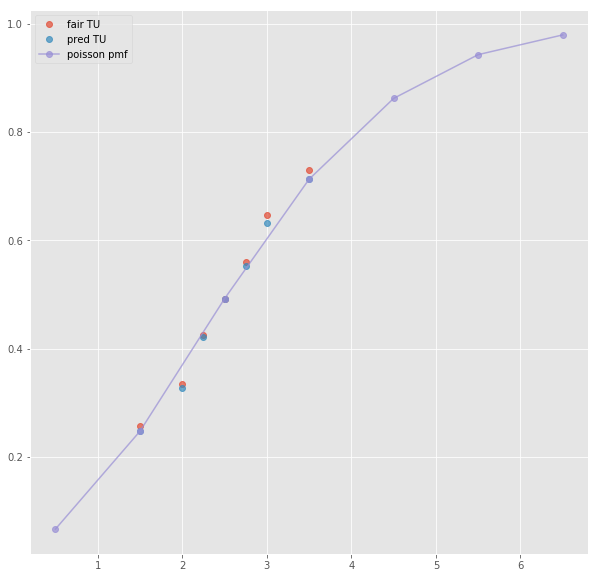

ML : 2.01 3.58 3.82
Error home:  0.0038955242708851867
Error draw:  0.019361144725230206
Error away:  0.015465726166407956

(26, 124)
(1, 19)
2.5 1.92 1.94 -0.5 2.04 1.84
TO fair:  1.9896907216494846 TU fair:  2.010416666666667
TO pred:  1.9897 TU fair:  2.01041
Error TO:  2.343676149818563e-06



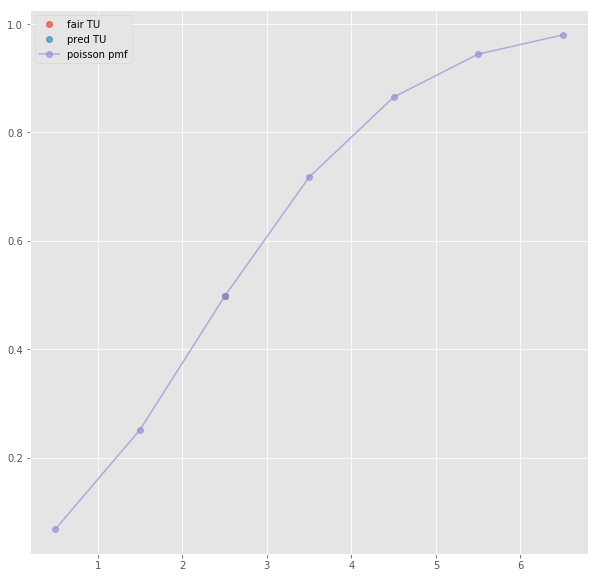

ML : 2.03 3.33 3.43
Error home:  0.019981255841251655
Error draw:  0.025027864312408776
Error away:  0.005046355448549644

(72, 124)
(1, 21)
2.5 1.92 1.98 -0.5 2.04 1.88
TO fair:  1.9696969696969697 TU fair:  2.03125
TO pred:  1.9697 TU fair:  2.03124
Error TO:  7.81063887123068e-07

Error TO:  0.021187346804668383



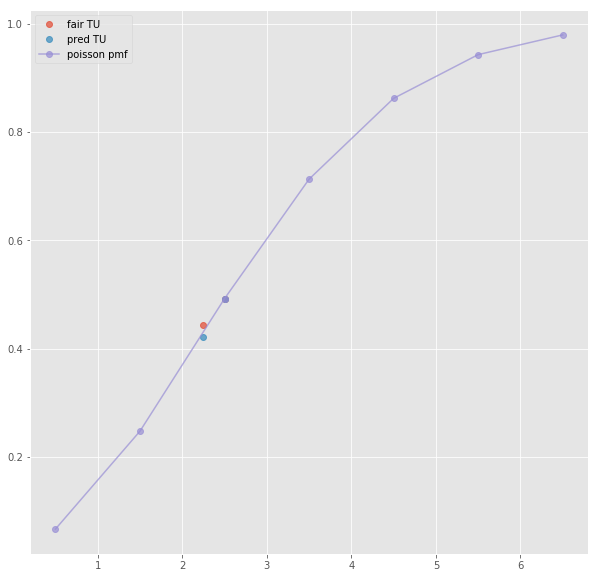

ML : 2.02 3.5 3.75
Error home:  0.006967868214512618
Error draw:  0.022683843148000093
Error away:  0.015716243315644973

(200, 124)
(1, 19)
2.5 1.9 2.0 -0.5 2.03 1.89
TO fair:  1.9499999999999997 TU fair:  2.052631578947368
TO pred:  1.95003 TU fair:  2.0526
Error TO:  7.889424975315862e-06

Error TO:  0.02402925534206457



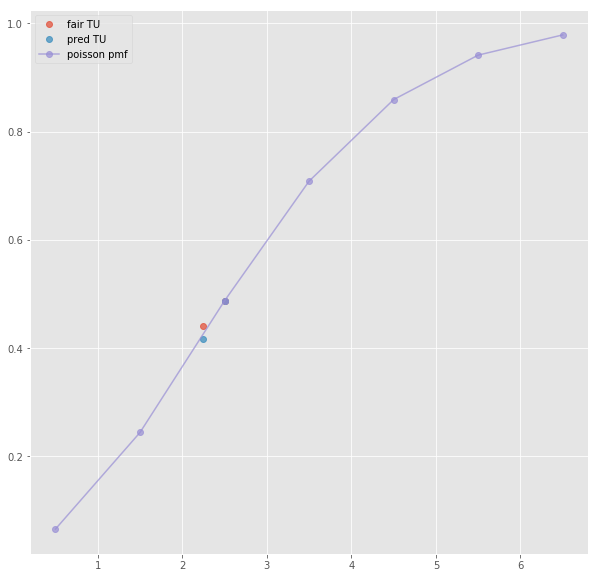

ML : 2.02 3.6 3.6
Error home:  0.010923343893188442
Error draw:  0.015709735855404583
Error away:  0.004786170387629185

(17, 124)
(1, 41)
2.5 1.9 1.961 -0.5 2.01 1.877
TO fair:  1.96889342172361 TU fair:  2.0321052631578946
TO pred:  1.96887 TU fair:  2.03213
Error TO:  0.006727067841212131

Error TO:  0.007220427152708764

Error TO:  0.015385921584224915

Error TO:  0.017484171173053398

Error TO:  6.041984435656289e-06

Error TO:  0.009731014734965182

Error TO:  0.00301735122431368



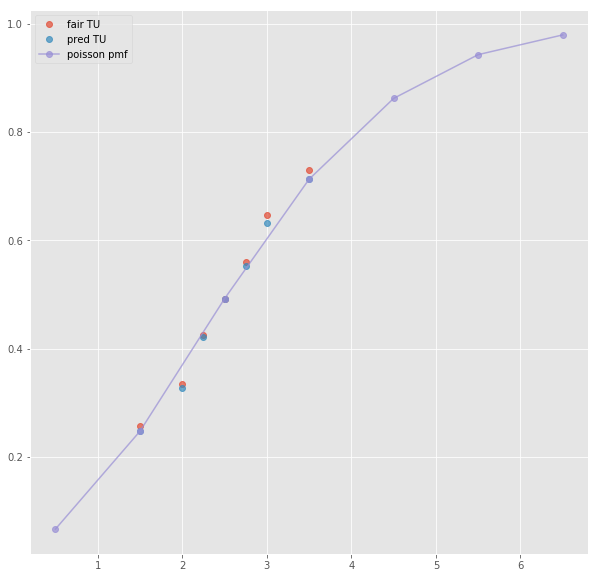

Error T1O:  0.005017636836329276
ML : 2.01 3.58 3.82
Error home:  0.0038955242708851867
Error draw:  0.019361144725230206
Error away:  0.015465726166407956

(17, 124)
next positional indexers are out-of-bounds
(55, 124)
next positional indexers are out-of-bounds
(61, 124)
next positional indexers are out-of-bounds
(74, 124)
next positional indexers are out-of-bounds
(306, 124)
next positional indexers are out-of-bounds
(55, 124)
(1, 48)
2.5 1.892 1.99 -0.5 1.813 2.09
TO fair:  1.950753768844221 TU fair:  2.051797040169133
TO pred:  1.95075 TU fair:  2.0518
Error TO:  0.0011974501516495706

Error TO:  0.0040962580178920405

Error TO:  0.0008486292779612548

Error TO:  0.003121388991285834

Error TO:  0.0014984731312541744

Error TO:  9.903851428960664e-07

Error TO:  0.0034777866172631677

Error TO:  0.0009020428332180419

Error TO:  0.01824797797889094



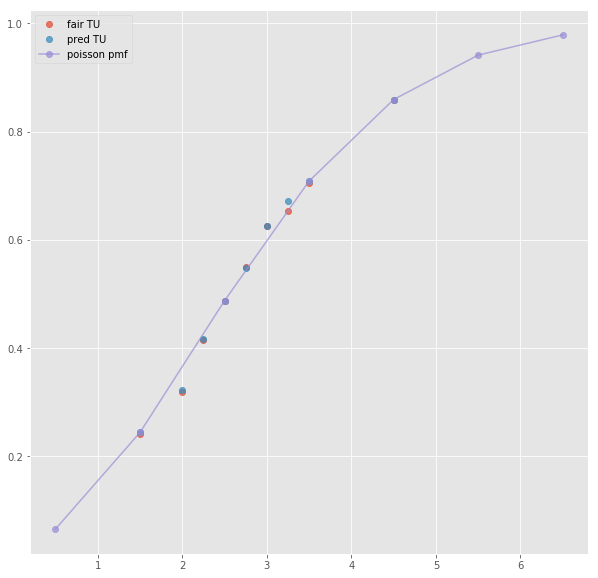

Error T1O:  0.006512667243341985
ML : 1.813 3.71 4.64
Error home:  0.003413996951269427
Error draw:  0.020494987227494932
Error away:  0.0170809097650145

(31, 124)
(1, 64)
2.5 1.825 1.975 -0.5 1.825 2.025
TO fair:  1.9240506329113924 TU fair:  2.0821917808219177
TO pred:  1.92402 TU fair:  2.08223
Error TO:  0.012509527339865045

Error TO:  0.026455352060000714

Error TO:  0.007958353279080899

Error TO:  0.00530730495655124

Error TO:  0.012513569227795673

Error TO:  8.274889362613891e-06

Error TO:  0.02539377130146314

Error TO:  0.01966133925774305

Error TO:  0.00580773702385029

Error TO:  0.031729430313059304

Error TO:  0.0013548301278893116

Error TO:  0.00806015346269906

Error TO:  0.007476550796350373

Error TO:  0.023871278279436692



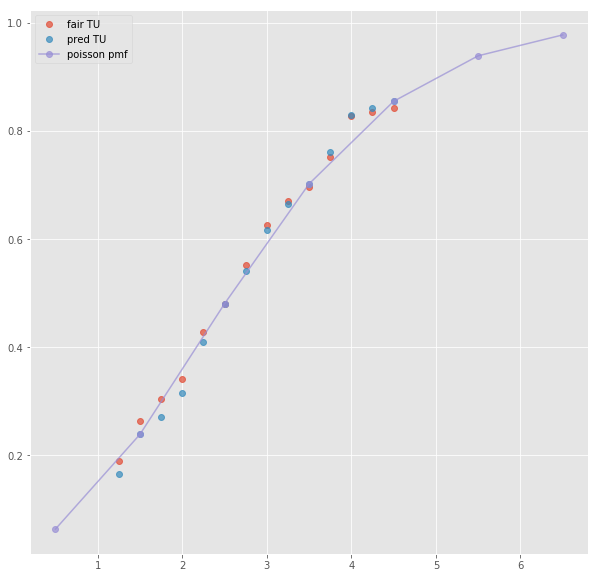

ML : 1.75 3.6 4.33
Error home:  0.003064012921068504
Error draw:  0.017138852370808505
Error away:  0.02020291068400748

(28, 124)
next positional indexers are out-of-bounds
(43, 124)
(1, 45)
2.5 2.02 1.862 -0.5 2.97 1.4340000000000002
TO fair:  2.084854994629431 TU fair:  1.9217821782178222
TO pred:  2.08483 TU fair:  1.92181
Error TO:  0.001471563721759217

Error TO:  2.9665521369293124e-05

Error TO:  0.0048362336826817676

Error TO:  0.0075514817734012585

Error TO:  0.0027922695793257124

Error TO:  5.750428397621743e-06

Error TO:  0.0008820454329437899

Error TO:  0.0003494857443504529

Error TO:  0.03681244308330711



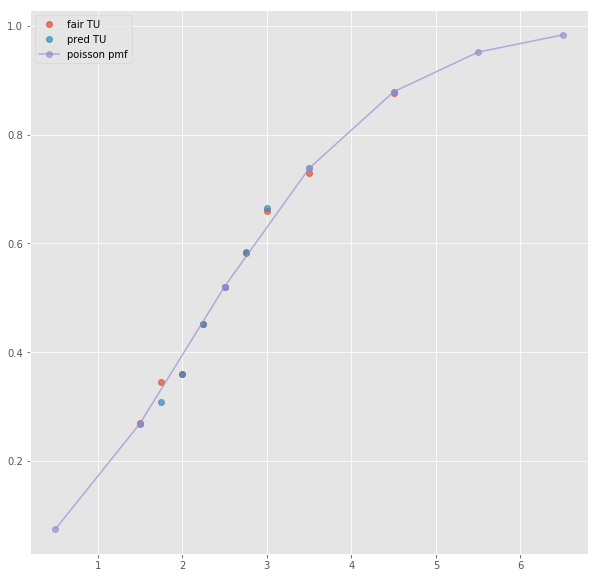

ML : 2.97 3.01 2.7
Error home:  0.0016563385416308862
Error draw:  0.056617745041738665
Error away:  0.05496159629590375

(69, 124)
(1, 23)
next list index out of range
(116, 124)
(1, 23)
next list index out of range
(244, 124)
(1, 23)
next list index out of range
(38, 124)
(1, 47)
2.5 2.02 1.862 -0.5 2.97 1.4340000000000002
TO fair:  2.084854994629431 TU fair:  1.9217821782178222
TO pred:  2.08483 TU fair:  1.92181
Error TO:  0.001471563721759217

Error TO:  2.9665521369293124e-05

Error TO:  0.0048362336826817676

Error TO:  0.0075514817734012585

Error TO:  0.0027922695793257124

Error TO:  5.750428397621743e-06

Error TO:  0.0008820454329437899

Error TO:  0.0003494857443504529

Error TO:  0.03681244308330711



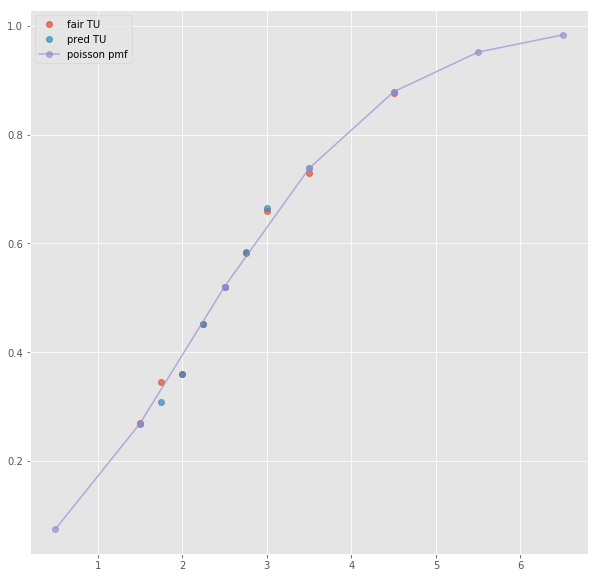

Error T1O:  0.03276156523930274
ML : 2.97 3.01 2.7
Error home:  0.0016563385416308862
Error draw:  0.056617745041738665
Error away:  0.05496159629590375

(96, 124)
(1, 67)
2.5 2.1 1.7 -0.5 2.75 1.425
TO fair:  2.235294117647059 TU fair:  1.8095238095238095
TO pred:  2.23531 TU fair:  1.80951
Error TO:  0.046816271059250514

Error TO:  0.034933238839707226

Error TO:  0.05304510895332343

Error TO:  0.051363870042010706

Error TO:  0.0396791212962799

Error TO:  3.178647774992882e-06

Error TO:  0.020718995705515164

Error TO:  0.03894174486918478

Error TO:  0.05124964678013788

Error TO:  0.023765110171983905

Error TO:  0.04546807933584189

Error TO:  0.04037785310658365

Error TO:  0.04846218549742859

Error TO:  0.002727303275487092

Error TO:  0.032331291705547716



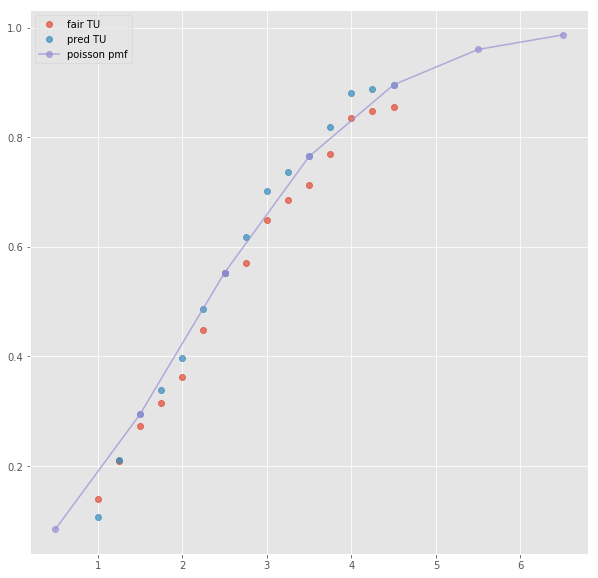

ML : 2.9 3.2 2.45
Error home:  0.017688780696465456
Error draw:  0.021421420585614526
Error away:  0.0037329546779560907

(32, 124)
next positional indexers are out-of-bounds
(106, 124)
(1, 46)
2.5 1.892 1.99 -0.5 1.763 2.16
TO fair:  1.950753768844221 TU fair:  2.051797040169133
TO pred:  1.95075 TU fair:  2.0518
Error TO:  0.003197818914138173

Error TO:  0.001389891419804723

Error TO:  0.006695314414113418

Error TO:  0.007203074379865393

Error TO:  0.009612337179917468

Error TO:  9.903851428960664e-07

Error TO:  0.0027974304210807155

Error TO:  0.00031354033300190487

Error TO:  0.0446036868913644



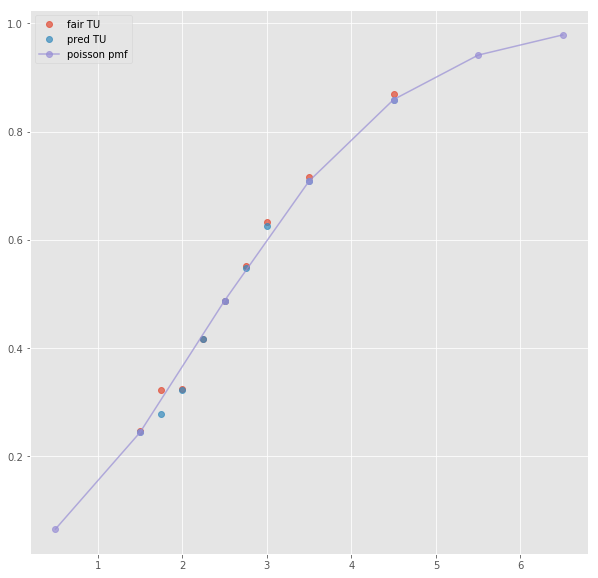

ML : 1.763 3.64 5.13
Error home:  0.00354974818374576
Error draw:  0.028624064638252816
Error away:  0.025074395603896238

(61, 124)
(1, 23)
2.5 1.91 1.89 -0.5 1.73 2.09
TO fair:  2.0105820105820107 TU fair:  1.9895287958115184
TO pred:  2.01061 TU fair:  1.98951
Error TO:  0.007195619967653333

Error TO:  6.923795580149328e-06

Error TO:  0.011093560071239406



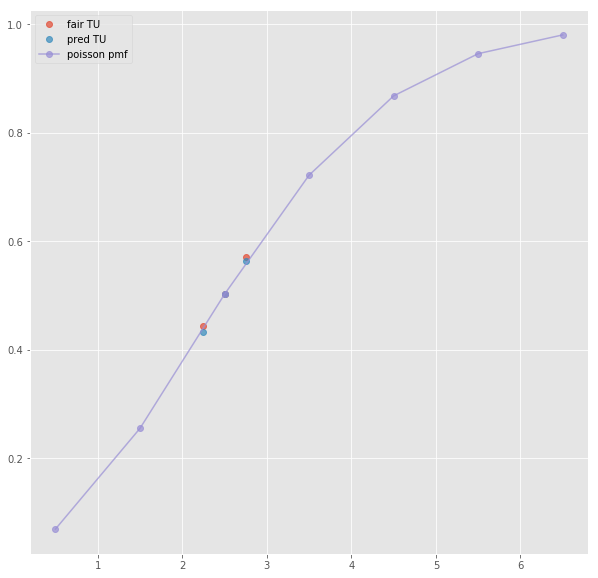

ML : 1.72 3.56 4.86
Error home:  0.002753458864773517
Error draw:  0.022977977631934626
Error away:  0.02022472242431536

(150, 124)
(1, 23)
2.5 1.94 1.94 -0.5 1.76 2.16
TO fair:  2.0 TU fair:  2.0
TO pred:  2.00004 TU fair:  1.99996
Error TO:  0.0016433529178850326

Error TO:  9.999800003934745e-06

Error TO:  0.008372693236396223



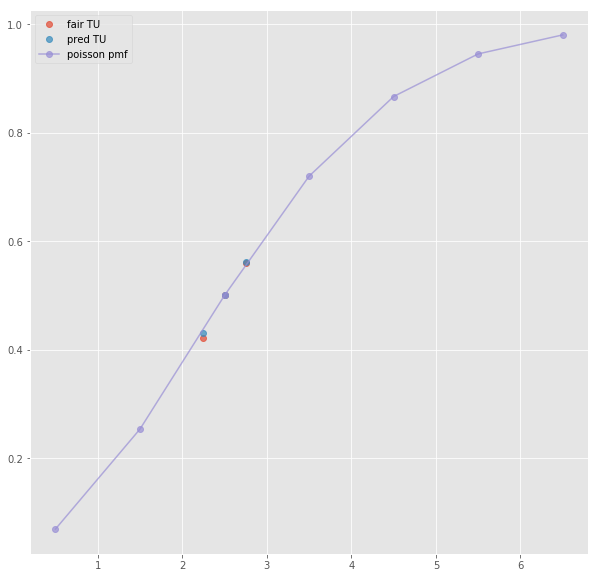

ML : 1.77 3.65 4.8
Error home:  0.011548798408100969
Error draw:  0.022957008144592977
Error away:  0.011408335309718104

(119, 124)
(1, 23)
2.5 1.96 1.92 -0.5 1.77 2.14
TO fair:  2.0208333333333335 TU fair:  1.9795918367346939
TO pred:  2.02082 TU fair:  1.9796
Error TO:  0.005179774149798588

Error TO:  3.2649806239182233e-06

Error TO:  0.01020674796121157



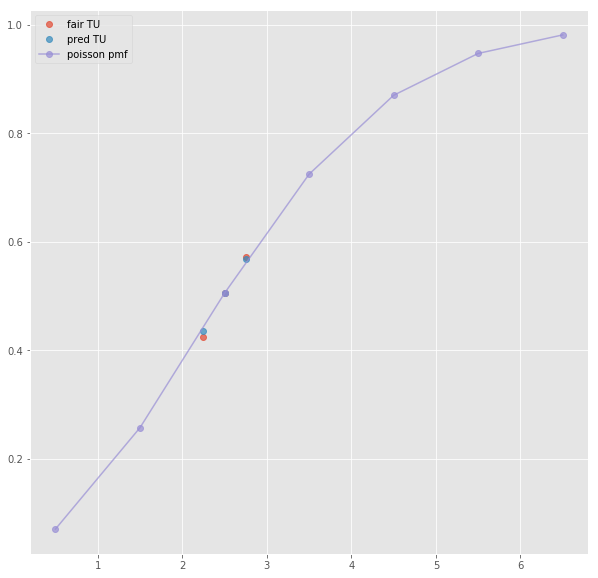

ML : 1.76 3.55 5.0
Error home:  0.0061328685786063986
Error draw:  0.027846971316947106
Error away:  0.021714329481345107

(71, 124)
(1, 46)
2.5 1.884 1.99 -0.5 1.763 2.16
TO fair:  1.946733668341708 TU fair:  2.0562632696390657
TO pred:  1.9467 TU fair:  2.05631
Error TO:  0.002369394608702724

Error TO:  0.0015005800307104078

Error TO:  0.00664121673114737

Error TO:  0.007572025555999895

Error TO:  0.010119163137615572

Error TO:  8.884155622834733e-06

Error TO:  0.0034352840594873424

Error TO:  0.00021733923775912878

Error TO:  0.045538359434503795



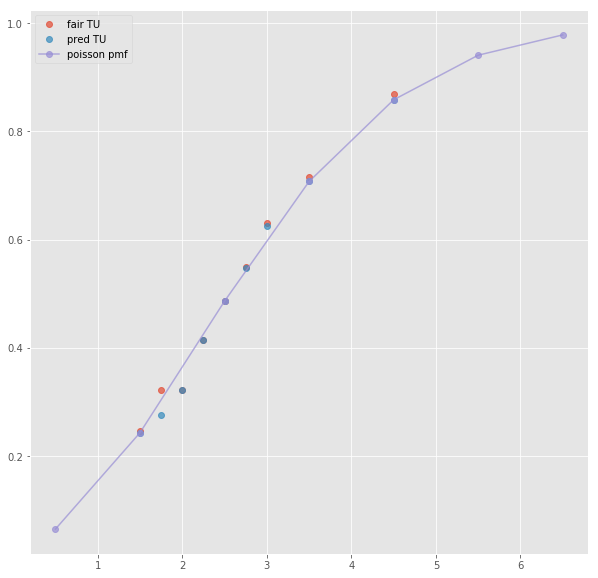

Error T1O:  0.006001605784104025
ML : 1.763 3.64 5.13
Error home:  0.0035376222966805315
Error draw:  0.028823290680466268
Error away:  0.0252857179088829

(26, 124)
next positional indexers are out-of-bounds
(28, 124)
(1, 44)
3.5 2.77 1.487 -0.5 1.781 2.15
TO fair:  2.862811028917283 TU fair:  1.5368231046931409
TO pred:  2.86282 TU fair:  1.53682
Error TO:  0.003293212340643392

Error TO:  0.001234231523675966

Error TO:  1.094606787543917e-06

Error TO:  0.00020247777172602288

Error TO:  0.0034875884250242795

Error TO:  0.002788340187772631

Error TO:  0.004606323132452239

Error TO:  0.00042067838957010606



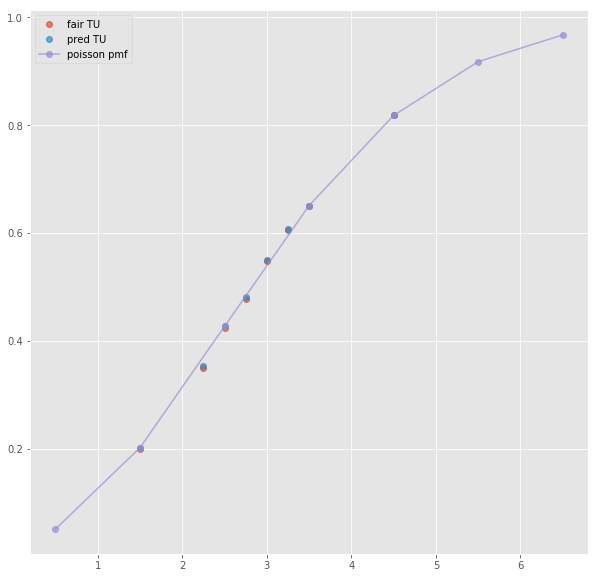

ML : 1.781 3.95 4.62
Error home:  0.002398770976696274
Error draw:  0.019499746028130815
Error away:  0.0171007558134173

(42, 124)
(1, 23)
2.5 1.66 2.19 -0.5 1.73 2.12
TO fair:  1.7579908675799087 TU fair:  2.3192771084337354
TO pred:  1.75802 TU fair:  2.31922
Error TO:  0.006502068023234164

Error TO:  0.004726639477510175

Error TO:  9.426188878003394e-06



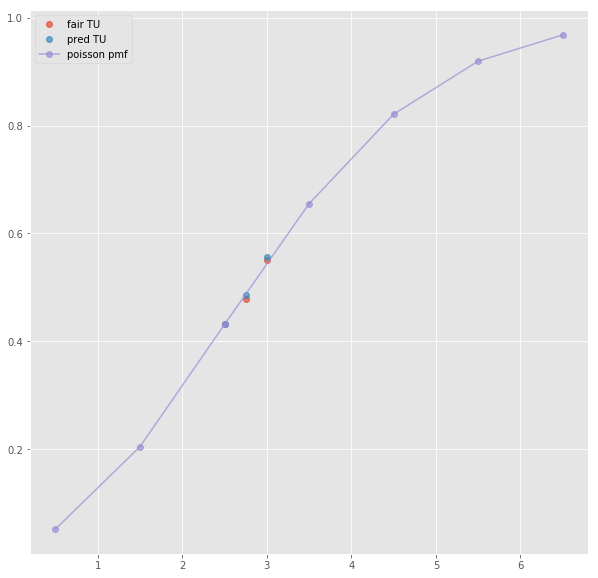

ML : 1.72 3.81 4.46
Error home:  0.0063197397450269754
Error draw:  0.019668988896332645
Error away:  0.01334901442420533

(76, 124)
(1, 19)
next list index out of range
(152, 124)
(1, 23)
2.5 1.68 2.28 -0.5 1.79 2.14
TO fair:  1.736842105263158 TU fair:  2.357142857142857
TO pred:  1.73684 TU fair:  2.35715
Error TO:  0.00429085423262443

Error TO:  0.004532448776651543

Error TO:  6.978888166253583e-07



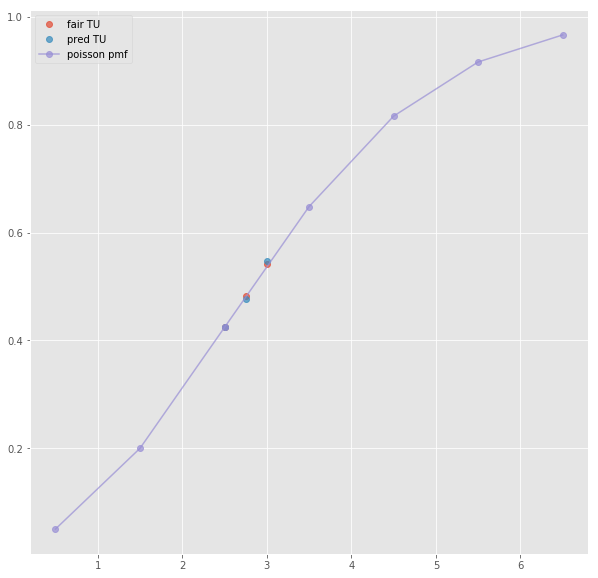

ML : 1.78 3.8 4.45
Error home:  0.009326474305258126
Error draw:  0.02461793725939923
Error away:  0.015291704350862884

(23, 124)
(1, 46)
3.5 2.77 1.487 -0.5 1.781 2.15
TO fair:  2.862811028917283 TU fair:  1.5368231046931409
TO pred:  2.86282 TU fair:  1.53682
Error TO:  0.003293212340643392

Error TO:  0.001234231523675966

Error TO:  1.094606787543917e-06

Error TO:  0.00020247777172602288

Error TO:  0.0034875884250242795

Error TO:  0.002788340187772631

Error TO:  0.004606323132452239

Error TO:  0.00042067838957010606



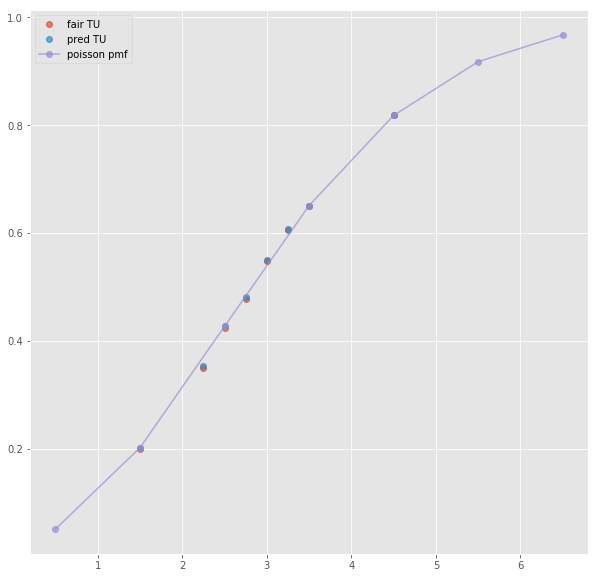

Error T1O:  0.001878715998959224
ML : 1.781 3.95 4.62
Error home:  0.002398770976696274
Error draw:  0.019499746028130815
Error away:  0.0171007558134173

(46, 124)
(1, 66)
3.5 2.6 1.475 -0.5 1.75 2.05
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.0008228731704371661

Error TO:  0.025807077317834826

Error TO:  0.012479244015746571

Error TO:  6.306488034957258e-06

Error TO:  0.010726207947077154

Error TO:  0.02384485232508171

Error TO:  0.02117981750360798

Error TO:  0.02067264661700574

Error TO:  0.006330379820712273

Error TO:  0.02415882778140921

Error TO:  0.004170206983200114

Error TO:  0.004772560002322596

Error TO:  0.0007934326163293037

Error TO:  0.02801228972349956

Error TO:  0.010362726084071044



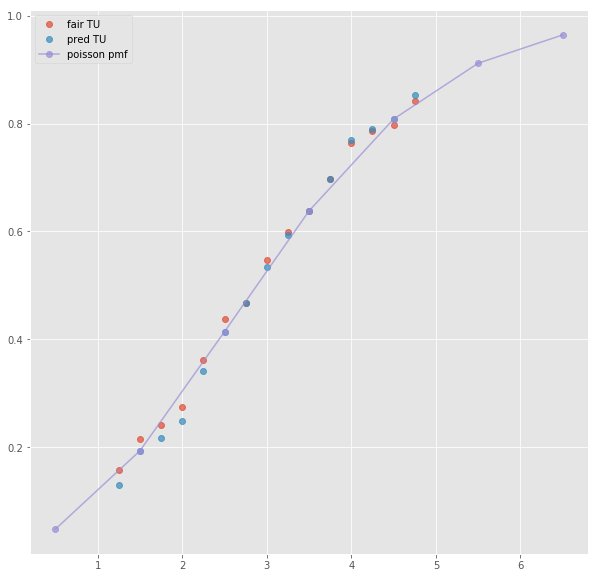

ML : 1.8 3.75 4.33
Error home:  0.011979404249828685
Error draw:  0.027925534344786812
Error away:  0.015946228013494157

(9, 124)
(1, 32)
2.5 1.68 2.26 -0.5 1.79 2.08
TO fair:  1.743362831858407 TU fair:  2.345238095238095
TO pred:  1.74335 TU fair:  2.34526
Error TO:  0.004854558875372561

Error TO:  0.009447137847832465

Error TO:  4.221989899466649e-06

Error TO:  0.001120000073869587

Error TO:  0.013363836333929957



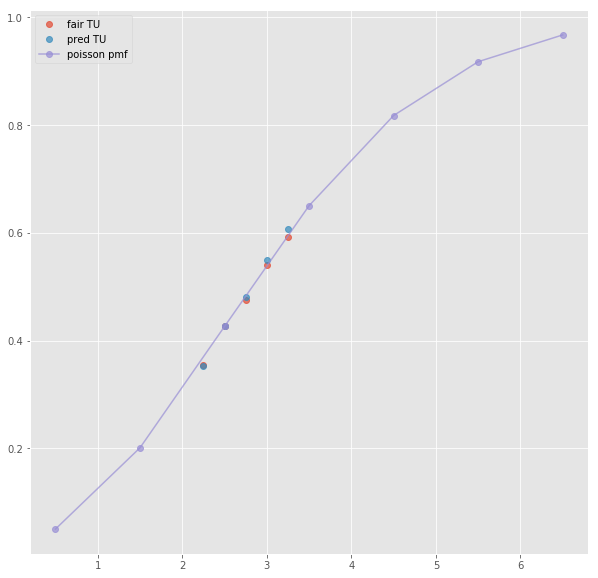

Error T1O:  0.009137110799818493
ML : 1.8 3.9 4.4
Error home:  0.0029047049654091772
Error draw:  0.018883524086819953
Error away:  0.01597858228950802

(96, 124)
next positional indexers are out-of-bounds
(134, 124)
next positional indexers are out-of-bounds
(176, 124)
next positional indexers are out-of-bounds
(333, 124)
next positional indexers are out-of-bounds
(90, 124)
(1, 45)
3.5 2.39 1.628 -1.5 2.03 1.892
TO fair:  2.468058968058968 TU fair:  1.6811715481171547
TO pred:  2.46808 TU fair:  1.68116
Error TO:  0.005318940907732328

Error TO:  0.00303057402331941

Error TO:  3.4527456821975555e-06

Error TO:  0.007045768743227349

Error TO:  0.00567180751948837

Error TO:  0.009180097648459062

Error TO:  0.0015977455297940257

Error TO:  0.0052325457070150905



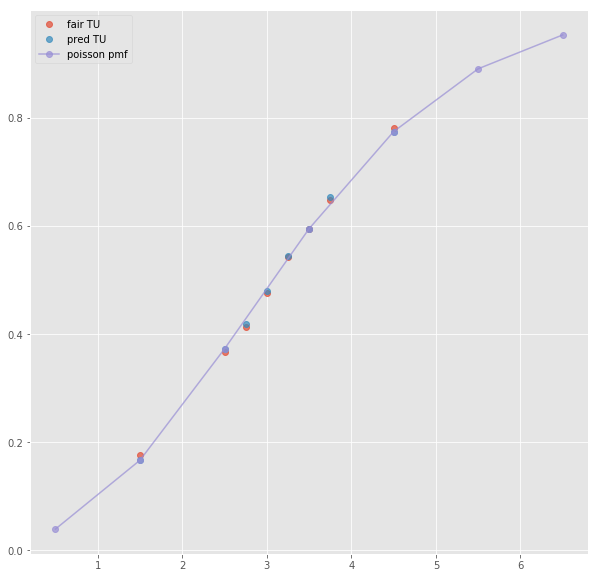

Error T1O:  0.012107413768558839
ML : 1.336 5.42 9.85
Error home:  0.01346566446033759
Error draw:  0.00678390527597536
Error away:  0.02024961799496096

(46, 124)
(1, 71)
3.5 2.5 1.5 -1.5 2.02 1.91
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.03248970440274923

Error TO:  0.008677338681193913

Error TO:  0.009374906248395154

Error TO:  6.56261484577314e-06

Error TO:  0.04583255493790925

Error TO:  0.026312323387135406

Error TO:  0.0038308765636950737

Error TO:  0.02525847584811658

Error TO:  0.0382967749218765

Error TO:  0.0019087782342436244

Error TO:  0.01005424536302077

Error TO:  0.014353095644686786

Error TO:  0.04625480370647067

Error TO:  0.024801797381581947

Error TO:  0.046025293999633676

Error TO:  0.03836266026040487



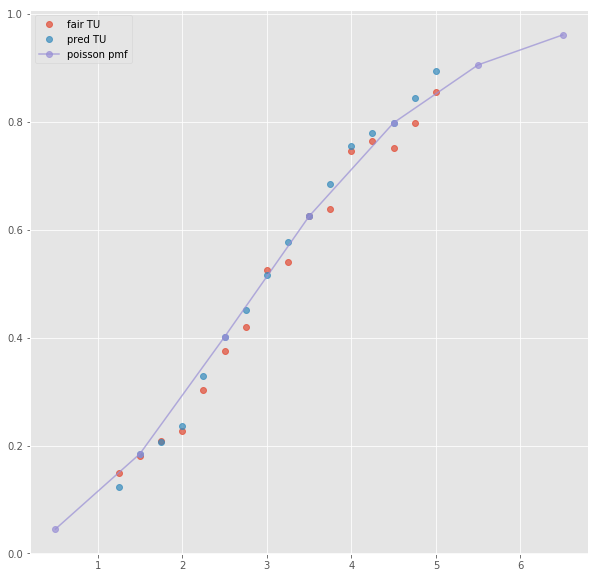

ML : 1.33 5.5 8.5
Error home:  0.0032928809160923667
Error draw:  0.0007937659644602912
Error away:  0.002499116175056909

(41, 124)
(1, 31)
3.5 2.32 1.64 -1.5 1.94 1.91
TO fair:  2.4146341463414633 TU fair:  1.7068965517241377
TO pred:  2.41465 TU fair:  1.70689
Error TO:  0.007887001388607096

Error TO:  0.00722259347622356

Error TO:  2.719092442260429e-06

Error TO:  0.011143731743899044

Error TO:  0.0031558009960479527



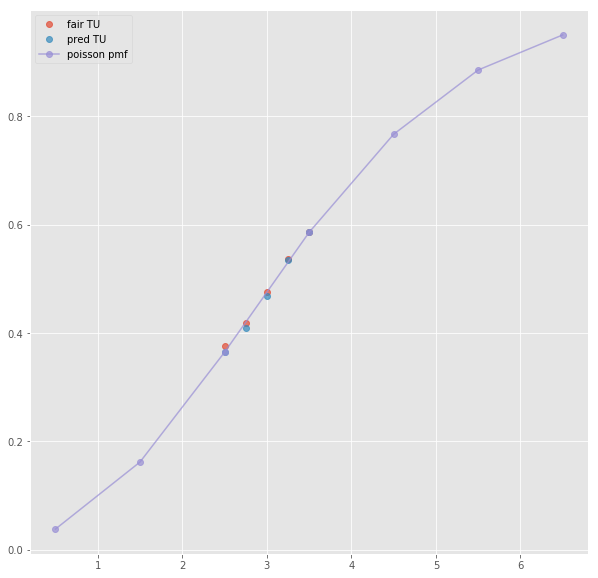

Error T1O:  0.0006265109552073822
ML : 1.36 5.37 8.53
Error home:  0.013129813718747663
Error draw:  0.012796245376554966
Error away:  0.00033358296653682173

(139, 124)
(1, 48)
3.5 2.96 1.436 0.5 2.27 1.709
TO fair:  3.0612813370473537 TU fair:  1.4851351351351352
TO pred:  3.06124 TU fair:  1.48514
Error TO:  0.0006350751491654982

Error TO:  0.027792368125607037

Error TO:  0.0006835186438025609

Error TO:  4.4110179905354485e-06

Error TO:  0.0033239937217689197

Error TO:  0.0012572931327518022

Error TO:  0.00378209712482358

Error TO:  0.00045058169698630746

Error TO:  0.00017435698781181896

Error TO:  0.0725974637056338



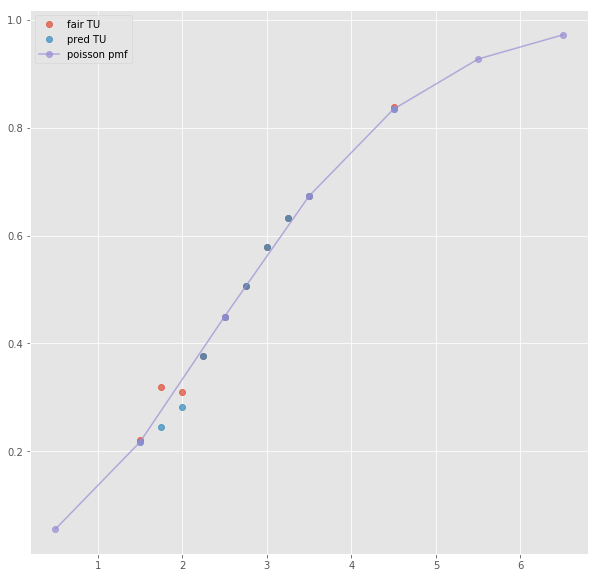

ML : 5.04 4.04 1.709
Error home:  0.012090798711047263
Error draw:  0.015084773608966734
Error away:  0.0029938234732874713

(250, 124)
(1, 26)
2.5 1.66 2.19 0.5 2.23 1.65
TO fair:  1.7579908675799087 TU fair:  2.3192771084337354
TO pred:  1.75802 TU fair:  2.31922
Error TO:  0.003969136165247522

Error TO:  0.0068595224023852985

Error TO:  9.426188878003394e-06

Error TO:  0.051325278343637315



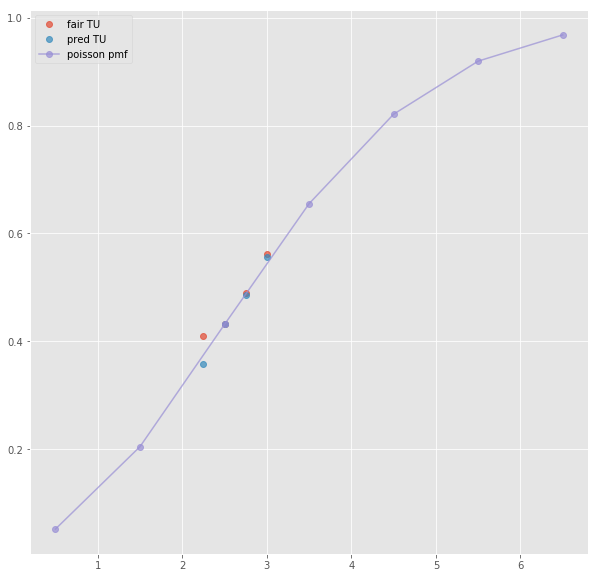

ML : 4.86 3.96 1.64
Error home:  0.01184501040183647
Error draw:  0.015677608788117497
Error away:  0.0038325041539128968

(317, 124)
(1, 22)
next list index out of range
(597, 124)
(1, 26)
2.5 1.73 2.2 0.5 2.25 1.72
TO fair:  1.7863636363636364 TU fair:  2.2716763005780347
TO pred:  1.78636 TU fair:  2.27169
Error TO:  0.0008036218263920425

Error TO:  0.004803572174385595

Error TO:  1.1395370528299864e-06

Error TO:  0.026928014406750522



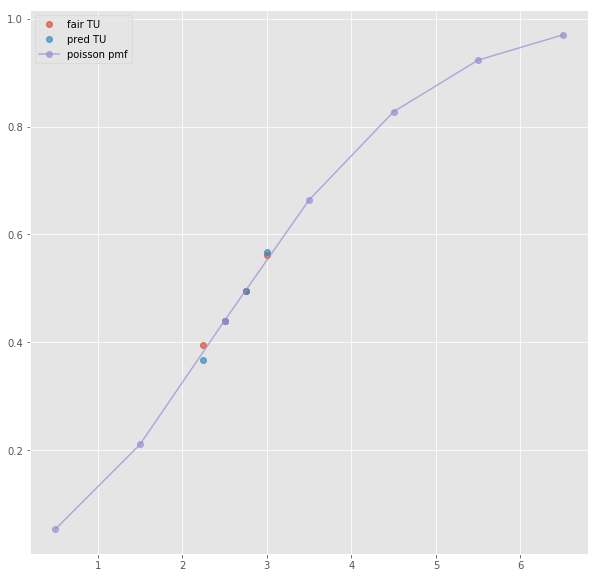

ML : 4.7 3.95 1.71
Error home:  0.006601831991105422
Error draw:  0.01678107694265124
Error away:  0.010179232653037773

(132, 124)
(1, 50)
3.5 2.96 1.436 0.5 2.27 1.709
TO fair:  3.0612813370473537 TU fair:  1.4851351351351352
TO pred:  3.06124 TU fair:  1.48514
Error TO:  0.0006350751491654982

Error TO:  0.027792368125607037

Error TO:  0.0006835186438025609

Error TO:  4.4110179905354485e-06

Error TO:  0.0033239937217689197

Error TO:  0.0012572931327518022

Error TO:  0.00378209712482358

Error TO:  0.00045058169698630746

Error TO:  0.00017435698781181896

Error TO:  0.0725974637056338



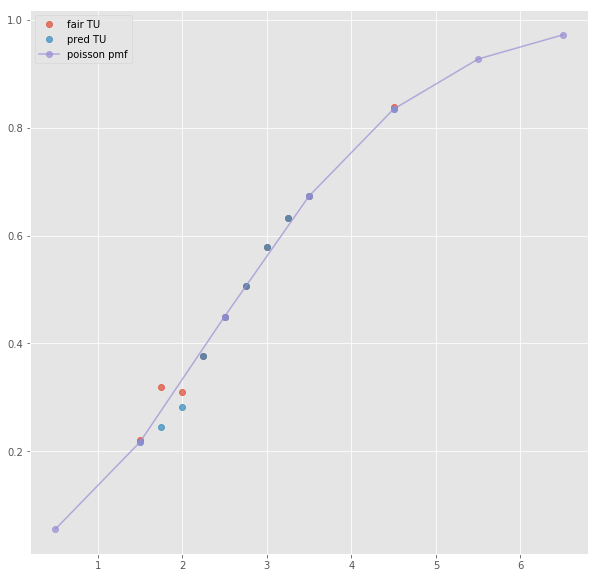

Error T1O:  0.0031558361451130557
ML : 5.04 4.04 1.709
Error home:  0.012090798711047263
Error draw:  0.015084773608966734
Error away:  0.0029938234732874713

(200, 124)
(1, 66)
2.5 1.825 2.025 0.5 2.25 1.625
TO fair:  1.9012345679012344 TU fair:  2.1095890410958904
TO pred:  1.90124 TU fair:  2.10958
Error TO:  0.00036951960118158933

Error TO:  0.006054359180115765

Error TO:  0.01069313082641693

Error TO:  0.010478401036069729

Error TO:  0.01610180215455695

Error TO:  1.5027786377519448e-06

Error TO:  0.01316877394390592

Error TO:  0.007838592746057249

Error TO:  0.009743475501029497

Error TO:  0.007419141445172084

Error TO:  0.020017341012010775

Error TO:  0.019112513017122135

Error TO:  0.018705317146638284

Error TO:  0.018817983957785334



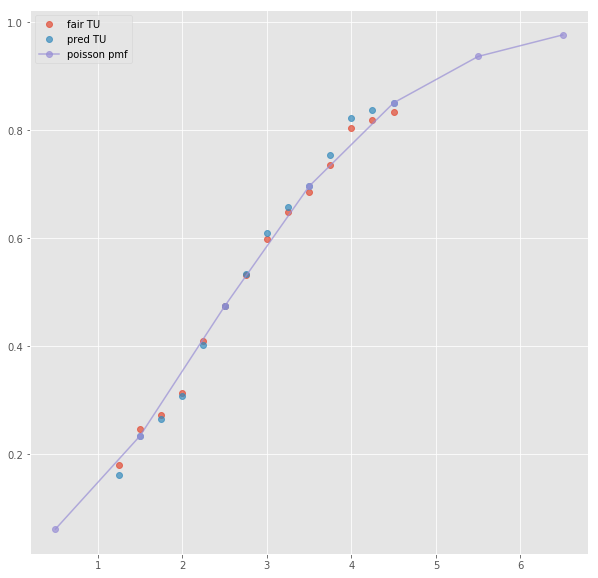

ML : 5.25 3.8 1.666
Error home:  0.011811578736662082
Error draw:  0.022885111883472475
Error away:  0.011073306998863663

(42, 124)
(1, 38)
2.5 1.71 2.2 0.5 2.22 1.7
TO fair:  1.7772727272727273 TU fair:  2.2865497076023393
TO pred:  1.77726 TU fair:  2.28656
Error TO:  0.004156540199416581

Error TO:  0.041262458955371284

Error TO:  0.008233745872486764

Error TO:  4.0293065277641205e-06

Error TO:  0.002445520396078371

Error TO:  0.010586916382125666



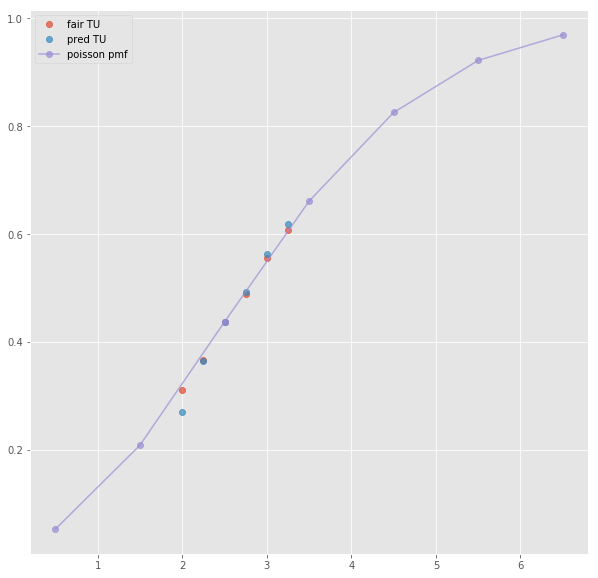

Error T1O:  0.004689666721283403
Error T1O:  0.024587004958521175
ML : 4.78 4.08 1.71
Error home:  0.008580591486652661
Error draw:  0.012120988504464025
Error away:  0.0035404868066398754

(2, 124)
(1, 43)
2.5 1.99 1.925 -0.5 2.5 1.602
TO fair:  2.0337662337662334 TU fair:  1.9673366834170853
TO pred:  2.03378 TU fair:  1.96733
Error TO:  0.0038667596783601432

Error TO:  0.001739808859910652

Error TO:  0.009749816867330674

Error TO:  0.01212303895510175

Error TO:  0.009161942772159537

Error TO:  3.3282055106886865e-06

Error TO:  0.0011252206350468308

Error TO:  0.0009168028302992681



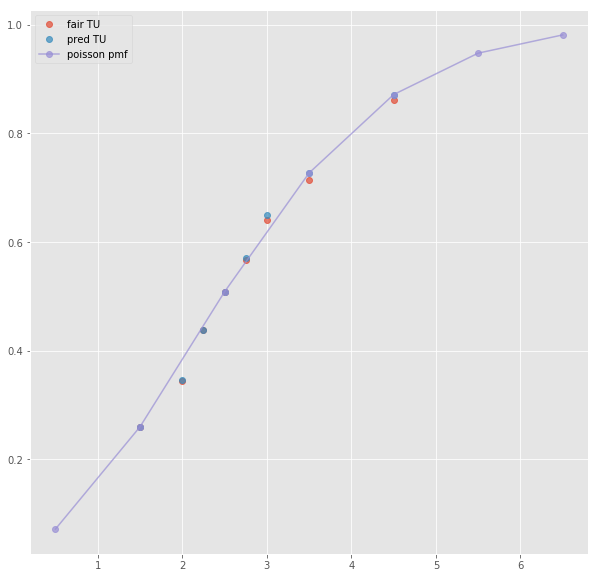

ML : 2.5 3.36 3.01
Error home:  0.0021468432567913753
Error draw:  0.027768518563760836
Error away:  0.025621737508313536

(1, 124)
(1, 23)
2.5 1.88 1.94 -0.5 2.36 1.58
TO fair:  1.9690721649484533 TU fair:  2.0319148936170213
TO pred:  1.96906 TU fair:  2.03193
Error TO:  0.0003643083644317979

Error TO:  3.1375430261659787e-06

Error TO:  0.005362684836245801



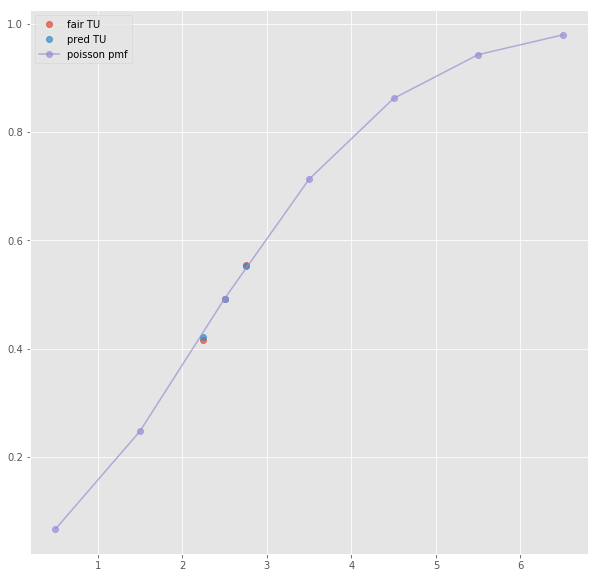

ML : 2.4 3.16 2.86
Error home:  0.016183157588507857
Error draw:  0.03503807101867612
Error away:  0.01885506897085426

(1, 124)
(1, 15)
next list index out of range
(1, 124)
(1, 23)
2.5 1.96 1.94 -0.5 2.4 1.64
TO fair:  2.0103092783505154 TU fair:  1.989795918367347
TO pred:  2.01031 TU fair:  1.98979
Error TO:  0.004731772203531992

Error TO:  1.7856666834070722e-07

Error TO:  0.002018936329502008



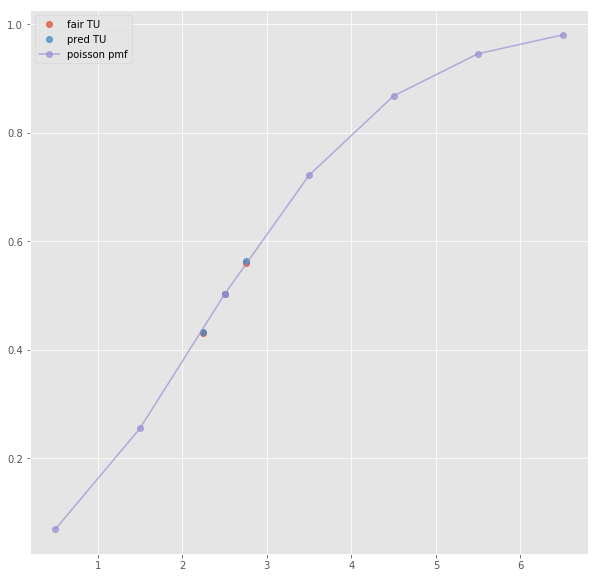

ML : 2.38 3.35 2.92
Error home:  0.009969527691291835
Error draw:  0.021988647682737228
Error away:  0.012019266648641225

(181, 124)
(1, 41)
2.5 2.37 1.653 -0.5 2.0 1.925
TO fair:  2.4337568058076227 TU fair:  1.6974683544303797
TO pred:  2.43374 TU fair:  1.69747
Error TO:  0.00019685661918006359

Error TO:  0.0016384872305362785

Error TO:  0.0012397554969955371

Error TO:  2.8373181015228788e-06

Error TO:  0.0036310383718439754

Error TO:  0.0009651923949884345

Error TO:  0.0030935548779954525



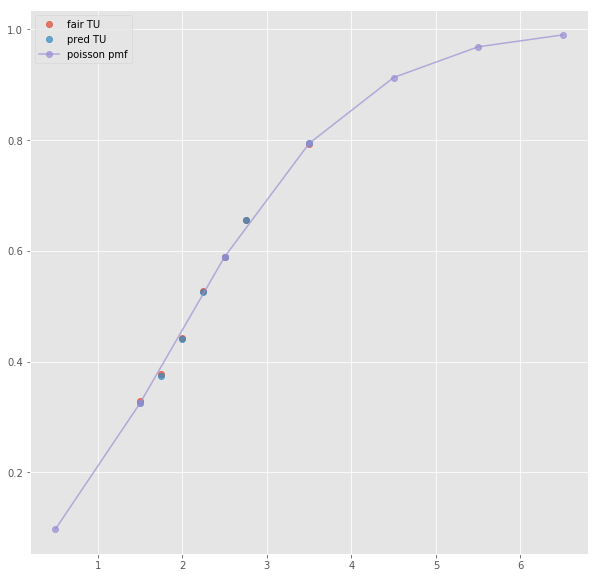

ML : 2.0 3.53 4.12
Error home:  0.0031068170595308087
Error draw:  0.00617360991601229
Error away:  0.003066822612493608

(275, 124)
(1, 29)
2.5 2.28 1.62 -0.5 1.98 1.89
TO fair:  2.4074074074074074 TU fair:  1.710526315789474
TO pred:  2.40747 TU fair:  1.7105
Error TO:  0.010438354013559026

Error TO:  0.013414162902275262

Error TO:  1.0799719207255087e-05

Error TO:  0.0070781064607495225

Error TO:  0.0034205337732470253



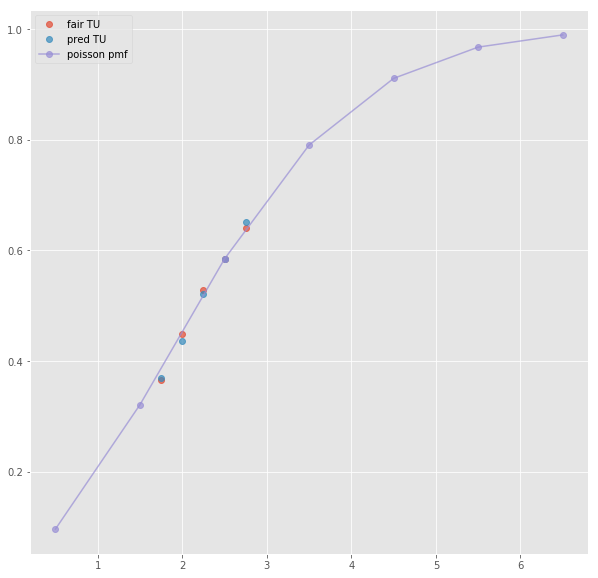

ML : 1.98 3.31 4.06
Error home:  0.008958457126260033
Error draw:  0.017576802860526708
Error away:  0.008618130143630581

(276, 124)
(1, 25)
2.5 2.35 1.66 -0.5 2.01 1.94
TO fair:  2.41566265060241 TU fair:  1.7063829787234044
TO pred:  2.41571 TU fair:  1.70636
Error TO:  0.020970859851540735

Error TO:  0.002803199369544096

Error TO:  8.113969601541982e-06

Error TO:  0.0027337592357190577



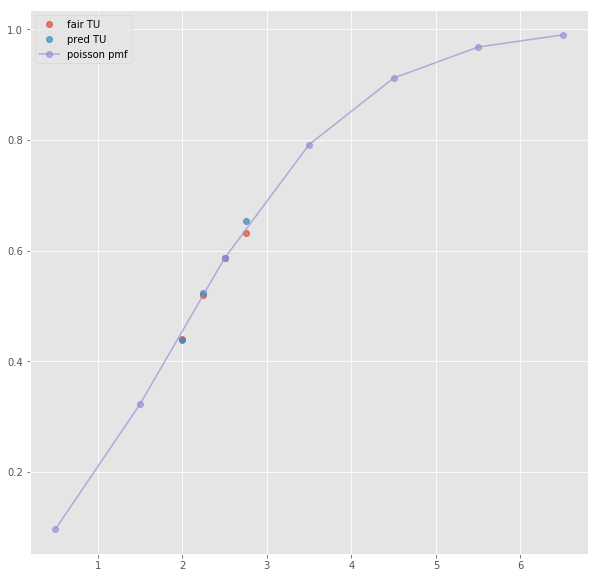

ML : 1.99 3.3 4.1
Error home:  0.012298659674194523
Error draw:  0.019684641305698802
Error away:  0.0073858370366934045

(730, 124)
(1, 27)
2.5 2.35 1.66 -0.5 2.01 1.94
TO fair:  2.41566265060241 TU fair:  1.7063829787234044
TO pred:  2.41571 TU fair:  1.70636
Error TO:  0.016818761949442818

Error TO:  0.0008344428756928979

Error TO:  8.113969601541982e-06

Error TO:  0.0049193019887706635



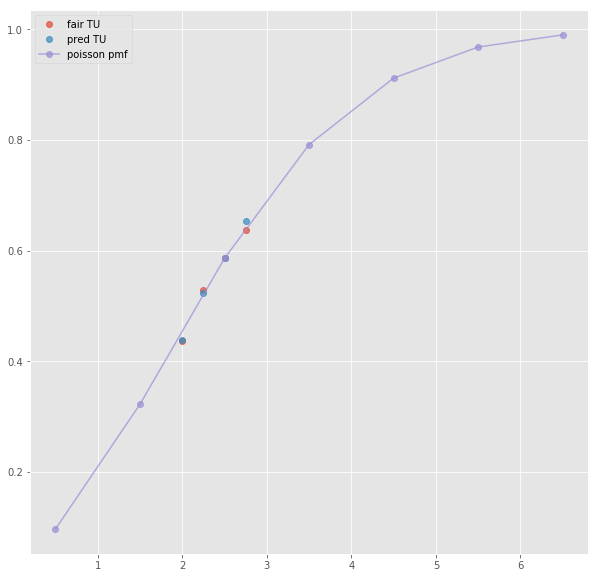

ML : 2.0 3.35 4.1
Error home:  0.011477251534372457
Error draw:  0.017294652723668646
Error away:  0.005817256594485343

(152, 124)
(1, 43)
2.5 2.37 1.653 -0.5 2.0 1.925
TO fair:  2.4337568058076227 TU fair:  1.6974683544303797
TO pred:  2.43374 TU fair:  1.69747
Error TO:  0.00019685661918006359

Error TO:  0.0016384872305362785

Error TO:  0.0012397554969955371

Error TO:  2.8373181015228788e-06

Error TO:  0.0036310383718439754

Error TO:  0.0009651923949884345

Error TO:  0.0030935548779954525



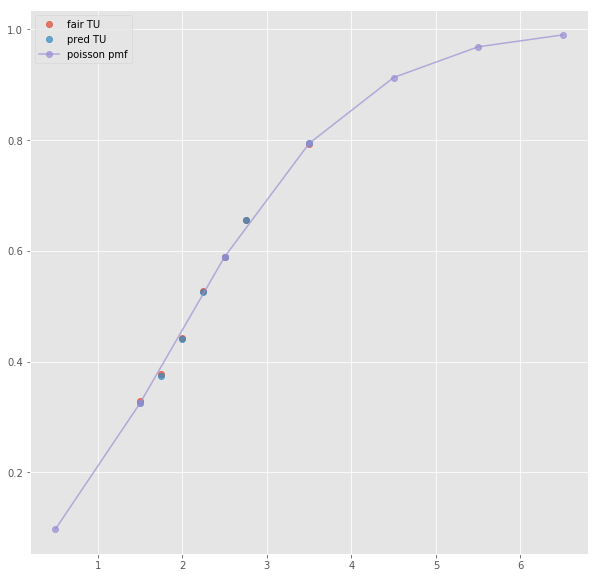

Error T1O:  0.002540520394443524
ML : 2.0 3.53 4.12
Error home:  0.0031068170595308087
Error draw:  0.00617360991601229
Error away:  0.003066822612493608

(188, 124)
(1, 61)
2.5 2.3 1.6 -0.5 2.03 1.87
TO fair:  2.4375 TU fair:  1.695652173913044
TO pred:  2.43757 TU fair:  1.69562
Error TO:  0.00853257503003696

Error TO:  0.005021371315565015

Error TO:  0.015280268315773449

Error TO:  0.01611678706185829

Error TO:  1.1781384213760404e-05

Error TO:  0.01589912457868936

Error TO:  0.06017090210635784

Error TO:  0.01859331286278268

Error TO:  0.011095481227459292

Error TO:  0.03757237890164157

Error TO:  0.043780497969966914

Error TO:  0.010201789200128264

Error TO:  0.015200499080827878

Error TO:  0.021625598608628782



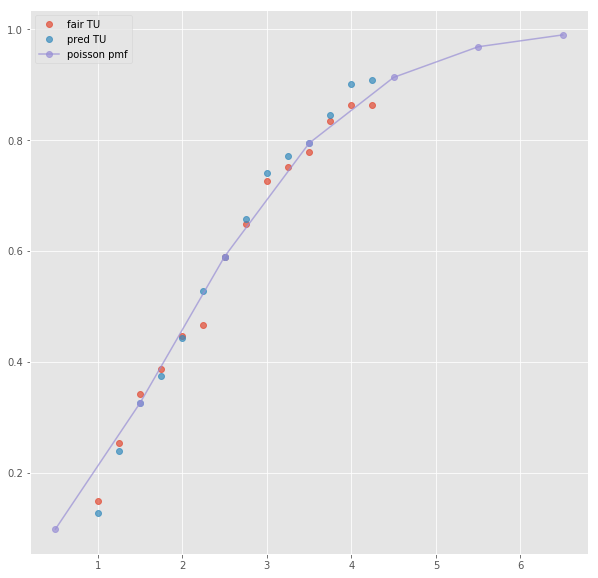

ML : 1.95 3.5 3.9
Error home:  0.006639680416309135
Error draw:  0.001097182981138034
Error away:  0.005542352244452348

(96, 124)
next positional indexers are out-of-bounds
(28, 124)
(1, 44)
3.5 2.85 1.452 0.5 2.17 1.751
TO fair:  2.962809917355372 TU fair:  1.5094736842105263
TO pred:  2.96286 TU fair:  1.50946
Error TO:  0.004215914246705532

Error TO:  0.0019371662240073584

Error TO:  5.705219176865839e-06

Error TO:  0.00407166238438364

Error TO:  0.004370939481685654

Error TO:  0.001735970323242908

Error TO:  0.005223965652349616

Error TO:  0.0006091156415130028



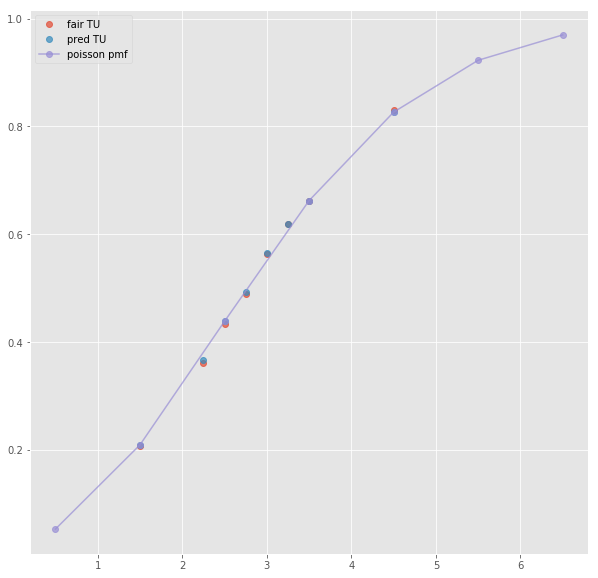

ML : 4.48 4.1 1.751
Error home:  0.00476551825770663
Error draw:  0.008120752310527501
Error away:  0.003355266013646774

(55, 124)
(1, 23)
2.5 1.74 2.13 0.5 2.21 1.7
TO fair:  1.8169014084507042 TU fair:  2.2241379310344827
TO pred:  1.81689 TU fair:  2.22415
Error TO:  0.013954614649459296

Error TO:  0.016061075589729745

Error TO:  3.4559438202297343e-06



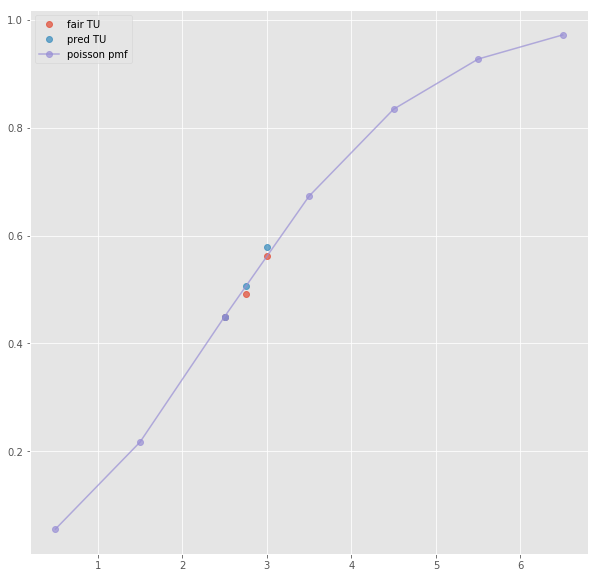

ML : 4.68 3.98 1.69
Error home:  0.006391953121543975
Error draw:  0.01162841761303951
Error away:  0.005236669598994381

(84, 124)
(1, 19)
2.5 1.71 2.23 0.5 2.21 1.74
TO fair:  1.7668161434977576 TU fair:  2.3040935672514617
TO pred:  1.76684 TU fair:  2.30405
Error TO:  0.009260149217612978

Error TO:  7.642196277690694e-06



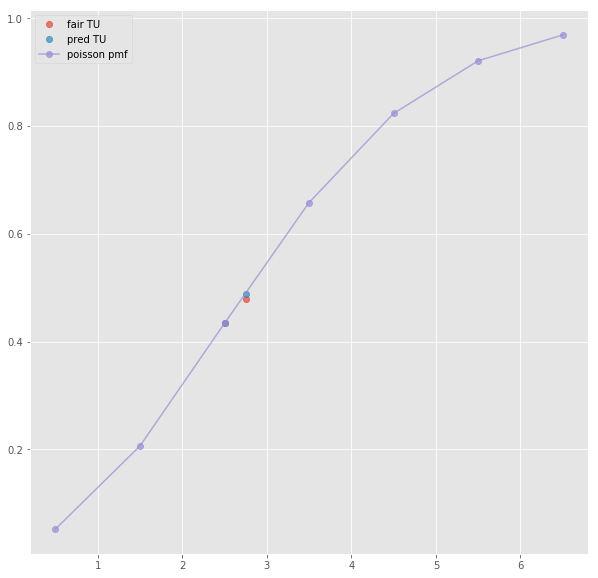

ML : 4.6 4.0 1.73
Error home:  0.007866933584787766
Error draw:  0.014449171058795868
Error away:  0.006582187152091801

(186, 124)
(1, 19)
2.5 1.71 2.23 0.5 2.23 1.73
TO fair:  1.7668161434977576 TU fair:  2.3040935672514617
TO pred:  1.76684 TU fair:  2.30405
Error TO:  0.009260149217612978

Error TO:  7.642196277690694e-06



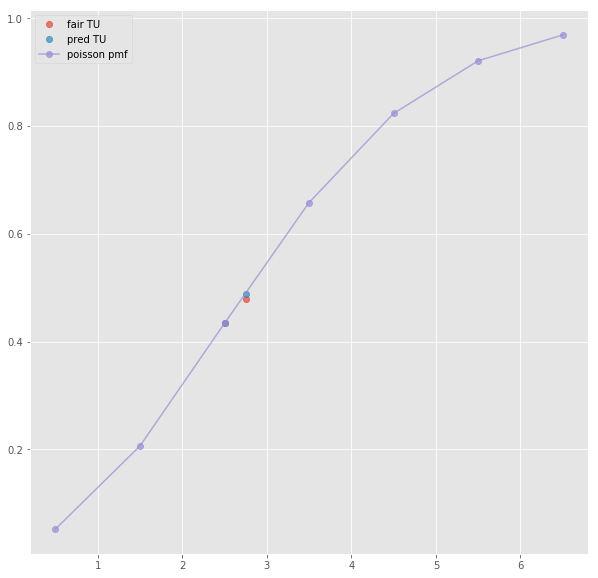

ML : 4.65 3.95 1.72
Error home:  0.008086360565412287
Error draw:  0.0173053867972848
Error away:  0.009219160771524071

(28, 124)
(1, 46)
3.5 2.85 1.452 0.5 2.17 1.751
TO fair:  2.962809917355372 TU fair:  1.5094736842105263
TO pred:  2.96286 TU fair:  1.50946
Error TO:  0.004215914246705532

Error TO:  0.0019371662240073584

Error TO:  5.705219176865839e-06

Error TO:  0.00407166238438364

Error TO:  0.004370939481685654

Error TO:  0.001735970323242908

Error TO:  0.005223965652349616

Error TO:  0.0006091156415130028



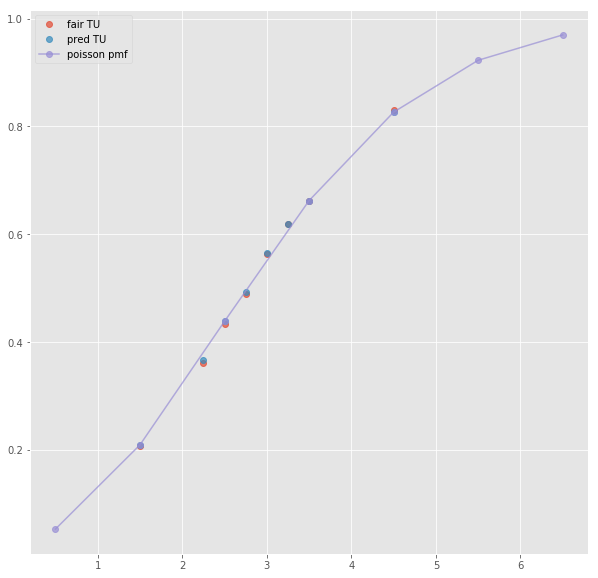

Error T1O:  0.012047422969404809
ML : 4.48 4.1 1.751
Error home:  0.00476551825770663
Error draw:  0.008120752310527501
Error away:  0.003355266013646774

(18, 124)
(1, 32)
2.5 1.71 2.19 0.5 2.15 1.74
TO fair:  1.780821917808219 TU fair:  2.280701754385965
TO pred:  1.7808 TU fair:  2.28074
Error TO:  0.002810500623875445

Error TO:  0.008513931629509475

Error TO:  6.911327665948264e-06

Error TO:  0.001309401802722987

Error TO:  0.011822741863682373



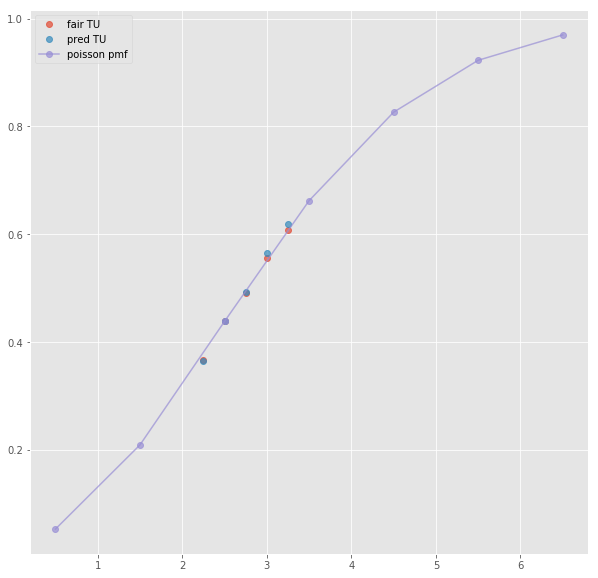

Error T1O:  0.004152698502100427
ML : 4.58 3.99 1.75
Error home:  0.01052263817616958
Error draw:  0.013962571859942707
Error away:  0.003440063555880668

(181, 124)
(1, 45)
3.5 2.62 1.5490000000000002 -1.5 2.27 1.714
TO fair:  2.691413815364751 TU fair:  1.5912213740458012
TO pred:  2.69143 TU fair:  1.59122
Error TO:  0.0045689516508758965

Error TO:  0.002680849847839062

Error TO:  2.2342890129145587e-06

Error TO:  0.0010451111747088182

Error TO:  0.005503458328489419

Error TO:  0.0022165147049776346

Error TO:  0.007218235437428611

Error TO:  0.0016389711665579232



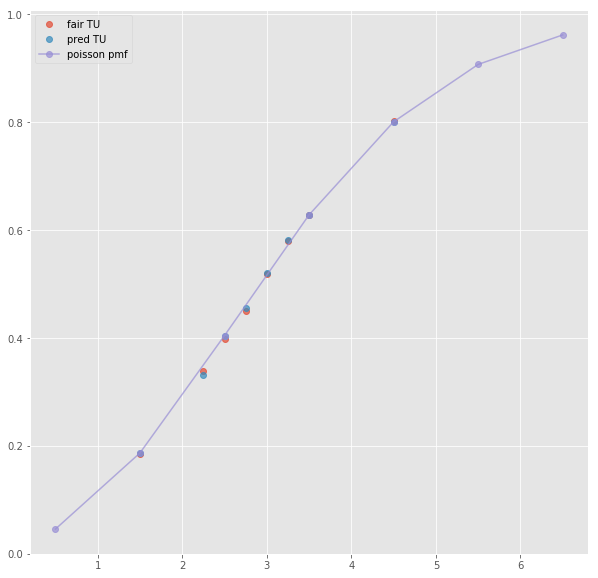

ML : 1.446 4.95 7.29
Error home:  0.004464713825614974
Error draw:  0.0050495543490835515
Error away:  0.009514181986934378

(260, 124)
(1, 27)
2.5 1.6 2.31 -1.5 2.21 1.69
TO fair:  1.6926406926406927 TU fair:  2.44375
TO pred:  1.69264 TU fair:  2.44376
Error TO:  0.005062283642569443

Error TO:  0.003993947695609623

Error TO:  2.4175675938931107e-07

Error TO:  0.0003292167729891382



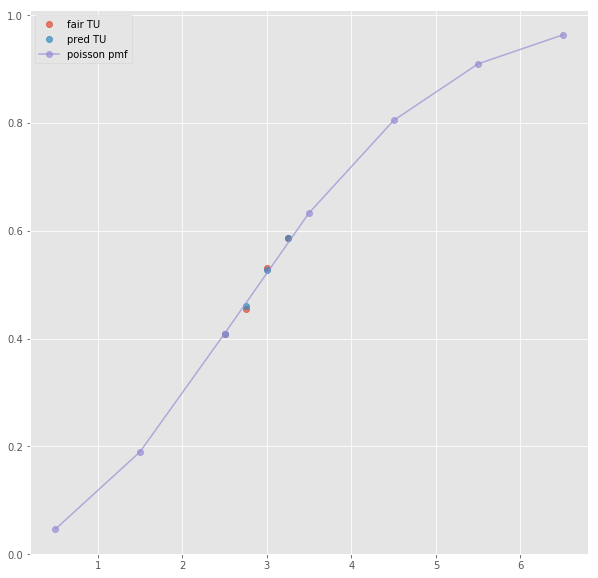

ML : 1.4 4.56 7.56
Error home:  0.00019439556253397772
Error draw:  0.015421047973285834
Error away:  0.015226653675336752

(178, 124)
(1, 22)
next list index out of range
(465, 124)
(1, 27)
2.5 1.64 2.38 -1.5 2.29 1.72
TO fair:  1.6890756302521006 TU fair:  2.451219512195122
TO pred:  1.68909 TU fair:  2.45119
Error TO:  0.003915665654563805

Error TO:  0.005231037911108627

Error TO:  5.036713666362047e-06

Error TO:  0.003100032252824292



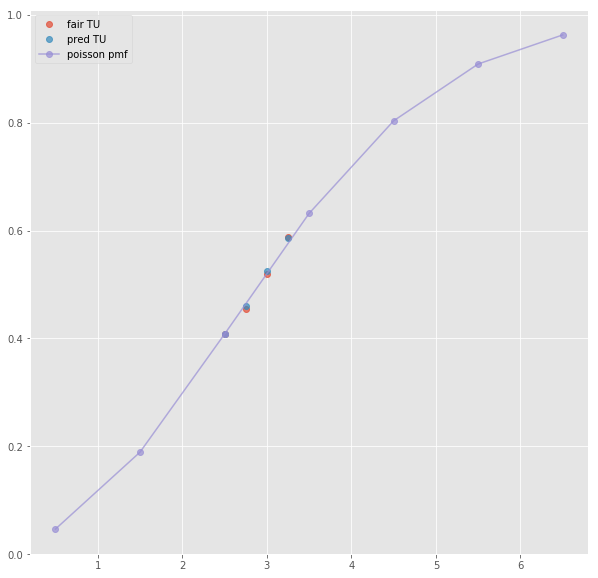

ML : 1.41 4.9 7.9
Error home:  0.01620840273807367
Error draw:  0.004620981990227174
Error away:  0.020829218592511134

(148, 124)
(1, 49)
3.5 2.62 1.5490000000000002 -1.5 2.27 1.714
TO fair:  2.691413815364751 TU fair:  1.5912213740458012
TO pred:  2.69143 TU fair:  1.59122
Error TO:  0.0045689516508758965

Error TO:  0.002680849847839062

Error TO:  2.2342890129145587e-06

Error TO:  0.0010451111747088182

Error TO:  0.005503458328489419

Error TO:  0.0022165147049776346

Error TO:  0.007218235437428611

Error TO:  0.0016389711665579232



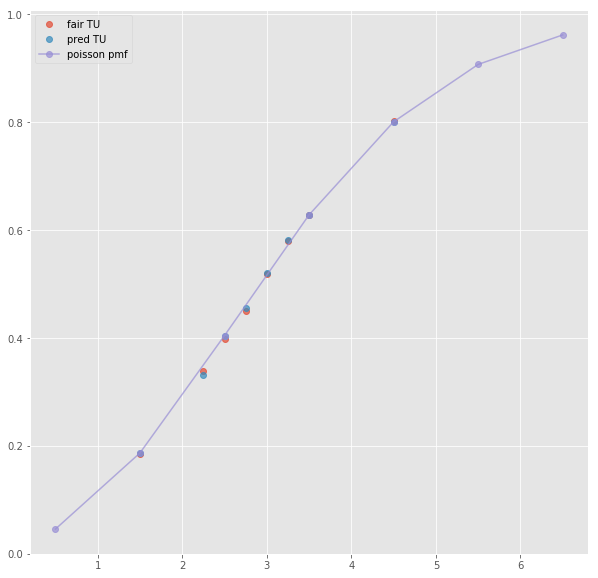

Error T1O:  0.010450292413032525
Error T1O:  0.010835000738219636
ML : 1.446 4.95 7.29
Error home:  0.004464713825614974
Error draw:  0.0050495543490835515
Error away:  0.009514181986934378

(48, 124)
(1, 69)
3.5 2.5 1.5 -1.5 2.1 1.7
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.00868177267704695

Error TO:  0.0283832840453333

Error TO:  0.013828347543941744

Error TO:  6.56261484577314e-06

Error TO:  0.012593516748375999

Error TO:  0.008944086869274948

Error TO:  0.02948759903247178

Error TO:  0.02288588915018097

Error TO:  0.011973130611186988

Error TO:  0.03401507435071538

Error TO:  0.0035467397737521666

Error TO:  0.009218399642029723

Error TO:  0.0014226721918641494

Error TO:  0.024801797381581947

Error TO:  0.009081106112049597



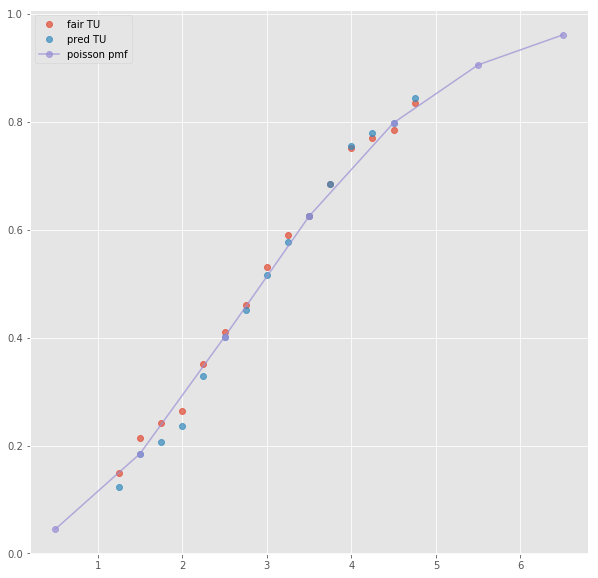

ML : 1.36 5.0 8.0
Error home:  0.011036485789076234
Error draw:  0.003486978315353606
Error away:  0.01452361265457272

(46, 124)
next positional indexers are out-of-bounds
(117, 124)
next positional indexers are out-of-bounds
(2365, 124)
next positional indexers are out-of-bounds
(173, 124)
next positional indexers are out-of-bounds
(525, 124)
next positional indexers are out-of-bounds
(99, 124)
(1, 49)
3.5 2.99 1.406 -0.5 1.505 2.67
TO fair:  3.1266002844950216 TU fair:  1.4702341137123747
TO pred:  3.12654 TU fair:  1.47025
Error TO:  0.008784782988201012

Error TO:  0.01136948877727817

Error TO:  0.0052372250466244386

Error TO:  6.166933637585803e-06

Error TO:  0.005098288661318284

Error TO:  0.01036023979899725

Error TO:  0.007756882736069892

Error TO:  0.012185521327460758

Error TO:  0.0017316265555618604



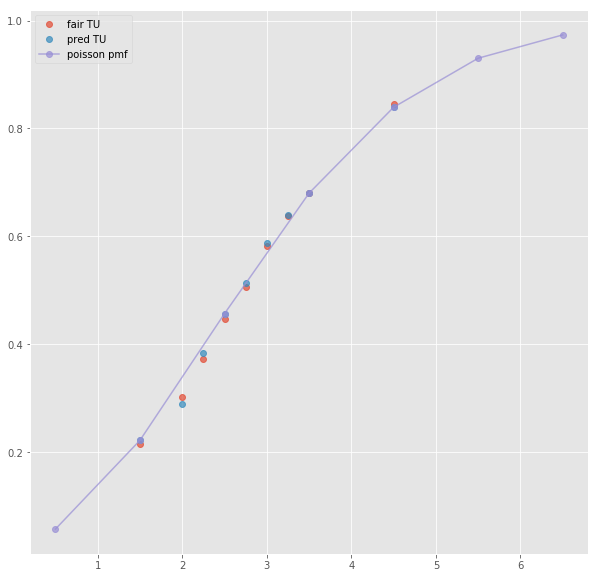

Error T1O:  0.007077426559007061
ML : 1.505 4.24 6.81
Error home:  0.005000137010101935
Error draw:  0.017789922786120793
Error away:  0.012789663284713676

(131, 124)
(1, 73)
3.5 2.75 1.425 -0.5 1.6 2.3
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.023430690631621676

Error TO:  0.03540841325086819

Error TO:  0.020453053203135063

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.019206539751107532

Error TO:  0.028265949221071396

Error TO:  0.03283043366857896

Error TO:  0.009352251151134972

Error TO:  0.030731926345489935

Error TO:  0.003218176895100039

Error TO:  0.00457625786735949

Error TO:  0.008366637600584537

Error TO:  0.024947678360244696

Error TO:  0.00572177298806098



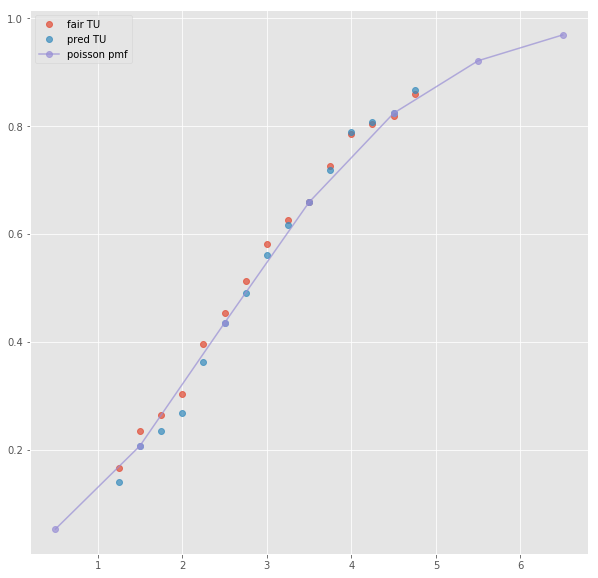

ML : 1.57 4.0 5.0
Error home:  0.0037322303717124417
Error draw:  0.012263242125246737
Error away:  0.008531204992003993

(46, 124)
(1, 35)
2.5 1.78 2.1 -0.5 1.55 2.53
TO fair:  1.847619047619048 TU fair:  2.179775280898877
TO pred:  1.84764 TU fair:  2.17975
Error TO:  0.004687213044244021

Error TO:  0.0082445848230433

Error TO:  6.137670858663569e-06

Error TO:  0.0010383607349400137

Error TO:  0.009978995070904384



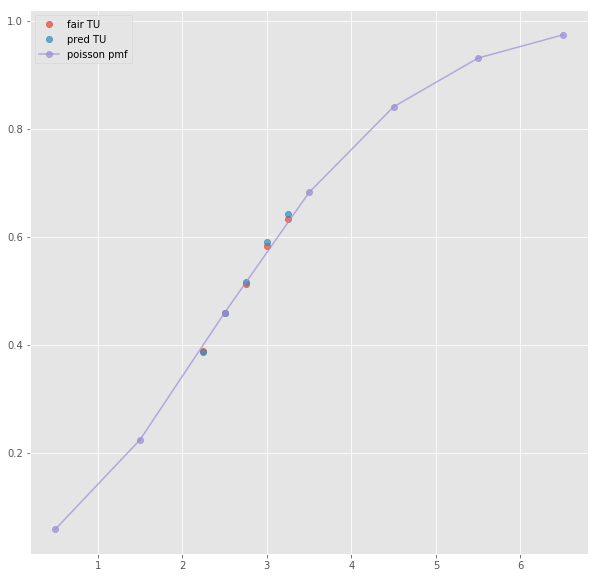

Error T1O:  0.003246552350898546
Error T1O:  0.02220546273398183
ML : 1.56 4.3 6.06
Error home:  0.0029150925617457135
Error draw:  0.010364316461920431
Error away:  0.007449063615560081

(64, 124)
(1, 41)
2.5 2.72 1.49 -0.5 2.32 1.662
TO fair:  2.825503355704698 TU fair:  1.5477941176470587
TO pred:  2.82544 TU fair:  1.54781
Error TO:  0.04787039595723347

Error TO:  0.0028963632431063258

Error TO:  0.014644544185446362

Error TO:  7.936039289557772e-06

Error TO:  0.004425121956010969

Error TO:  0.001921525027888893

Error TO:  0.0037189884565955733

Error TO:  0.008459454454429305



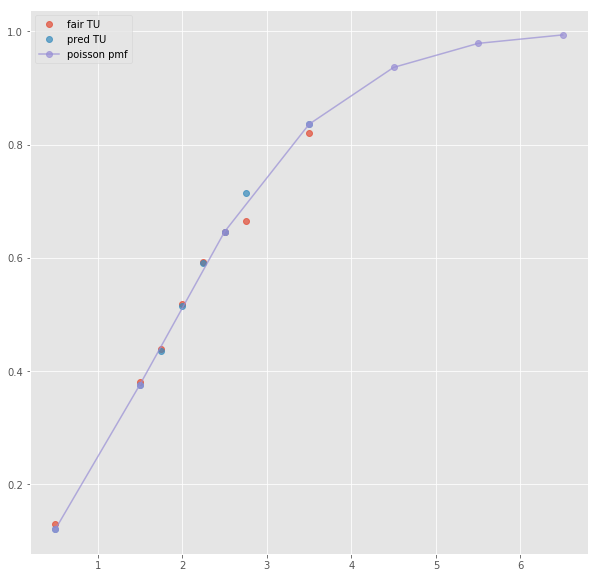

ML : 2.32 3.12 3.53
Error home:  0.0008576994403949878
Error draw:  0.014549874108204908
Error away:  0.013691770282625415

(47, 124)
(1, 21)
next list index out of range
(62, 124)
(1, 17)
next list index out of range
(96, 124)
(1, 19)
next list index out of range
(60, 124)
(1, 43)
2.5 2.72 1.49 -0.5 2.32 1.662
TO fair:  2.825503355704698 TU fair:  1.5477941176470587
TO pred:  2.82544 TU fair:  1.54781
Error TO:  0.04787039595723347

Error TO:  0.0028963632431063258

Error TO:  0.014644544185446362

Error TO:  7.936039289557772e-06

Error TO:  0.004425121956010969

Error TO:  0.001921525027888893

Error TO:  0.0037189884565955733

Error TO:  0.008459454454429305



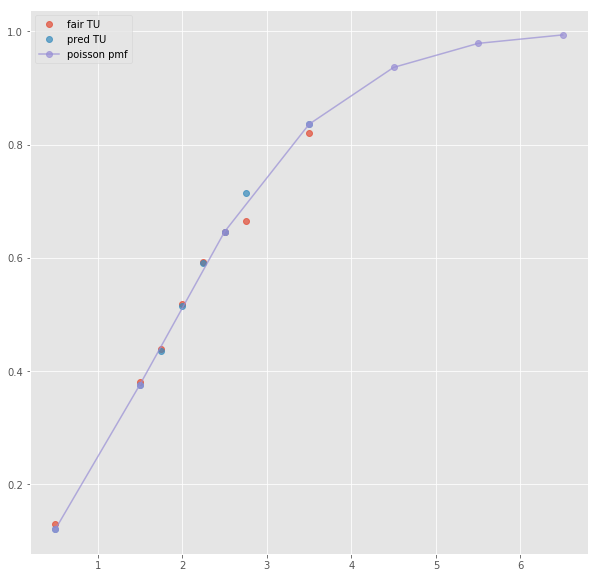

Error T1O:  0.002094924406914722
ML : 2.32 3.12 3.53
Error home:  0.0008576994403949878
Error draw:  0.014549874108204908
Error away:  0.013691770282625415

(21, 124)
(1, 37)
2.5 2.71 1.49 -0.5 2.27 1.67
TO fair:  2.8187919463087248 TU fair:  1.5498154981549817
TO pred:  2.81872 TU fair:  1.54984
Error TO:  0.05500761340146254

Error TO:  0.0053277885330199615

Error TO:  9.055106404254332e-06

Error TO:  0.006915747212245527

Error TO:  0.003054674806888369

Error TO:  0.0059183466429735265



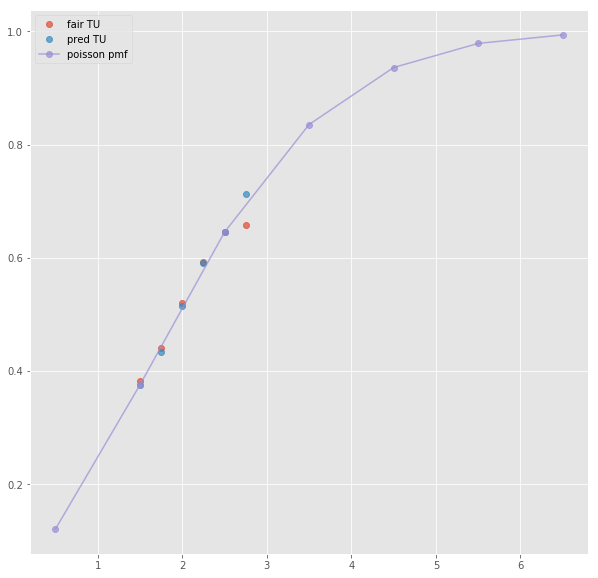

Error T1O:  0.005486240099962625
ML : 2.3 3.07 3.58
Error home:  0.005723080583635687
Error draw:  0.018973593176486225
Error away:  0.0132505673637911

(99, 124)
next positional indexers are out-of-bounds
(179, 124)
next positional indexers are out-of-bounds
(184, 124)
next positional indexers are out-of-bounds
(841, 124)
next positional indexers are out-of-bounds
(87, 124)
(1, 51)
3.5 2.98 1.431 0.5 1.99 1.925
TO fair:  3.082459818308875 TU fair:  1.4802013422818794
TO pred:  3.0824 TU fair:  1.48021
Error TO:  0.001372784897292867

Error TO:  0.02889323264919652

Error TO:  0.001428884731794089

Error TO:  6.2957534319729724e-06

Error TO:  0.0003254871871861964

Error TO:  0.0012335631612968578

Error TO:  0.00578827345009969

Error TO:  0.001880062779954006

Error TO:  0.0011293351589419798



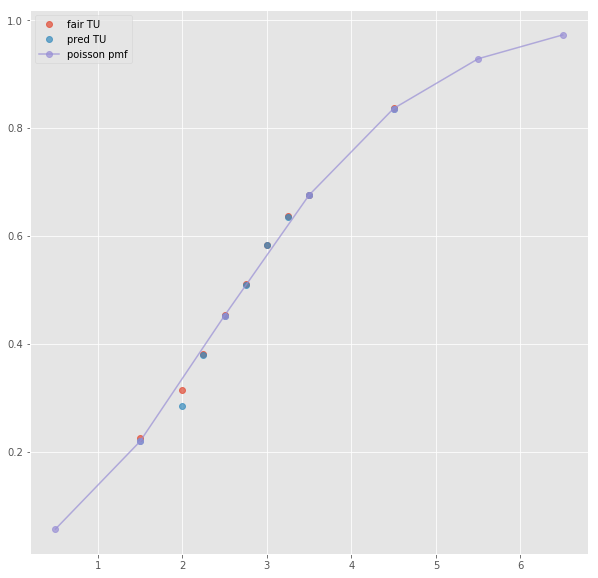

Error T1O:  0.0015338957127826736
ML : 3.98 3.84 1.925
Error home:  0.010244309119101652
Error draw:  0.014758818758346837
Error away:  0.004514704398758118

(99, 124)
(1, 72)
3.5 2.75 1.425 0.5 1.96 1.94
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.04333841448671405

Error TO:  0.018524113220500626

Error TO:  0.011236463341383951

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.019206539751107532

Error TO:  0.02313125321841436

Error TO:  0.024001924436941602

Error TO:  0.001723698215953584

Error TO:  0.030731926345489935

Error TO:  0.003218176895100039

Error TO:  0.010324910414780453

Error TO:  0.004435638359586158

Error TO:  0.024947678360244696

Error TO:  0.009905698346832609



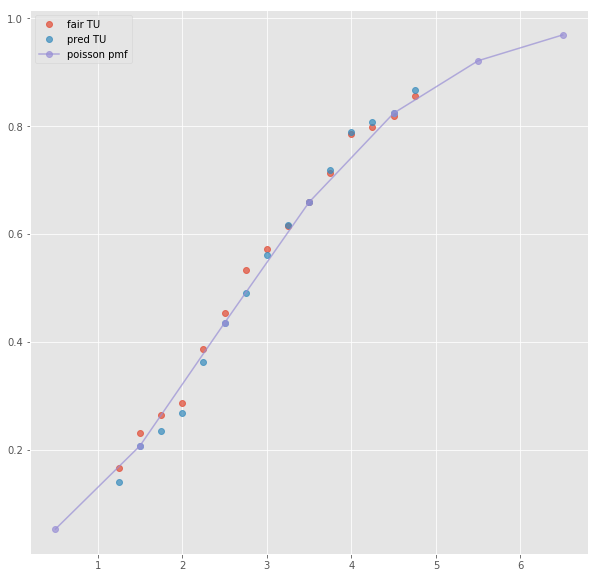

ML : 3.75 3.75 1.91
Error home:  0.009694688423285025
Error draw:  0.016889126228626233
Error away:  0.0071941627395062935

(27, 124)
(1, 35)
2.5 1.73 2.17 0.5 1.94 1.9
TO fair:  1.7972350230414749 TU fair:  2.254335260115607
TO pred:  1.79725 TU fair:  2.25431
Error TO:  0.003365541499963931

Error TO:  0.008788315822405635

Error TO:  4.6367134973746005e-06

Error TO:  0.0011935913326905911

Error TO:  0.012126988276599693



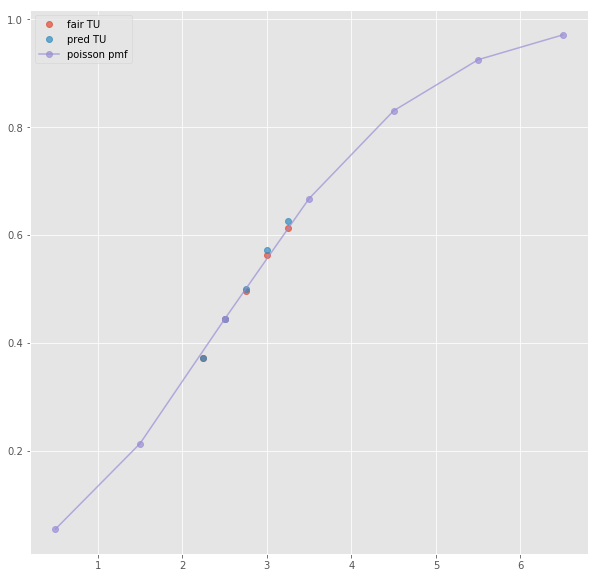

Error T1O:  0.002878359201277103
ML : 3.95 3.77 1.92
Error home:  0.014523304324555897
Error draw:  0.01856169611615785
Error away:  0.004038289277684681

(35, 124)
(1, 43)
2.5 2.58 1.537 0.5 1.518 2.67
TO fair:  2.6785946649316856 TU fair:  1.5957364341085272
TO pred:  2.6786 TU fair:  1.59574
Error TO:  0.022881918409889124

Error TO:  0.00226725452633314

Error TO:  0.0139190767113056

Error TO:  7.435755839391156e-07

Error TO:  0.0018036739671348778

Error TO:  0.00010925406065637189

Error TO:  0.0015121337689746328

Error TO:  0.01742088558584587



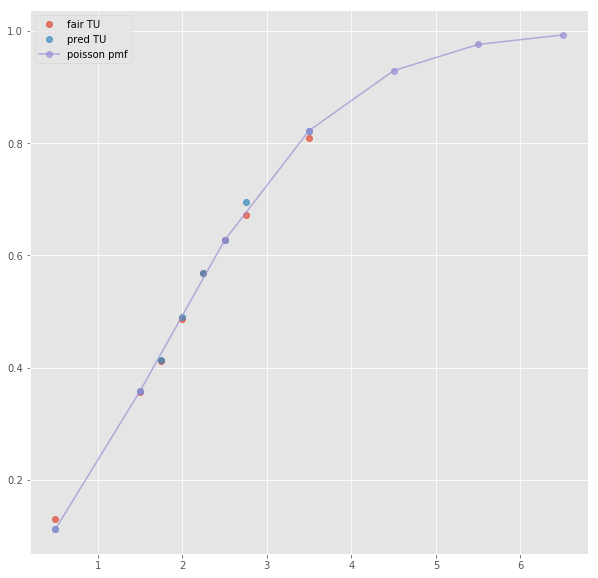

ML : 3.13 2.89 2.67
Error home:  0.03790320616892695
Error draw:  0.04026459296967755
Error away:  0.0023613868570256935

(45, 124)
(1, 19)
next list index out of range
(75, 124)
(1, 19)
next list index out of range
(116, 124)
(1, 21)
next list index out of range
(31, 124)
(1, 47)
2.5 2.58 1.537 0.5 1.518 2.67
TO fair:  2.6785946649316856 TU fair:  1.5957364341085272
TO pred:  2.6786 TU fair:  1.59574
Error TO:  0.022881918409889124

Error TO:  0.00226725452633314

Error TO:  0.0139190767113056

Error TO:  7.435755839391156e-07

Error TO:  0.0018036739671348778

Error TO:  0.00010925406065637189

Error TO:  0.0015121337689746328

Error TO:  0.01742088558584587



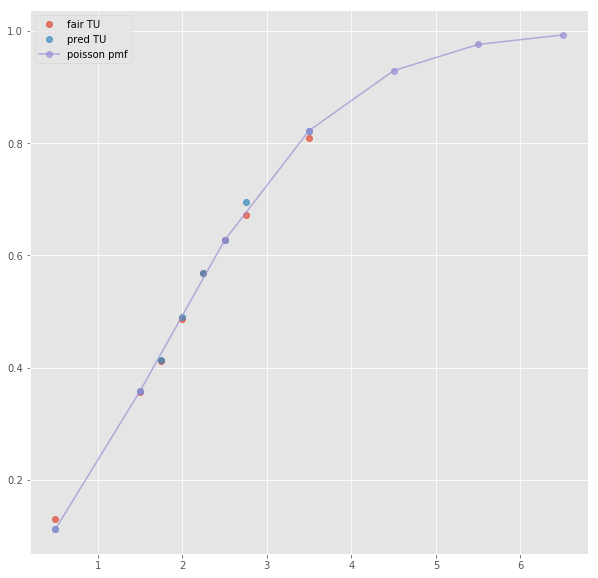

Error T1O:  0.0059413207933024514
ML : 3.13 2.89 2.67
Error home:  0.03790320616892695
Error draw:  0.04026459296967755
Error away:  0.0023613868570256935

(89, 124)
(1, 62)
2.5 2.425 1.525 -0.5 2.85 1.4
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.5902 TU fair:  1.62885
Error TO:  0.011151249378455907

Error TO:  0.005991033762880016

Error TO:  0.013915370722476311

Error TO:  0.022001185354242753

Error TO:  5.3756662160009405e-06

Error TO:  0.015318824723041358

Error TO:  0.007716358439895876

Error TO:  0.013803968720076748

Error TO:  0.010140032833630408

Error TO:  0.018542307580882156

Error TO:  0.01588736637413446

Error TO:  0.03195030148301381

Error TO:  0.03608916908940485



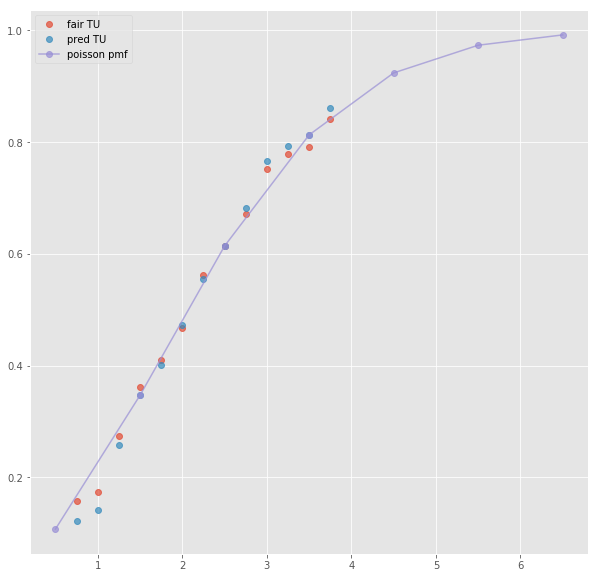

ML : 3.2 3.0 2.4
Error home:  0.03528807208327228
Error draw:  0.02550699752115143
Error away:  0.009781316426036302

(9, 124)
(1, 33)
2.5 2.52 1.55 0.5 1.53 2.58
TO fair:  2.6258064516129034 TU fair:  1.6150793650793651
TO pred:  2.62574 TU fair:  1.61511
Error TO:  0.0006647050661738874

Error TO:  9.63809261661508e-06

Error TO:  0.002574901047270761

Error TO:  0.0001710323052448448

Error TO:  0.00035101572242091095



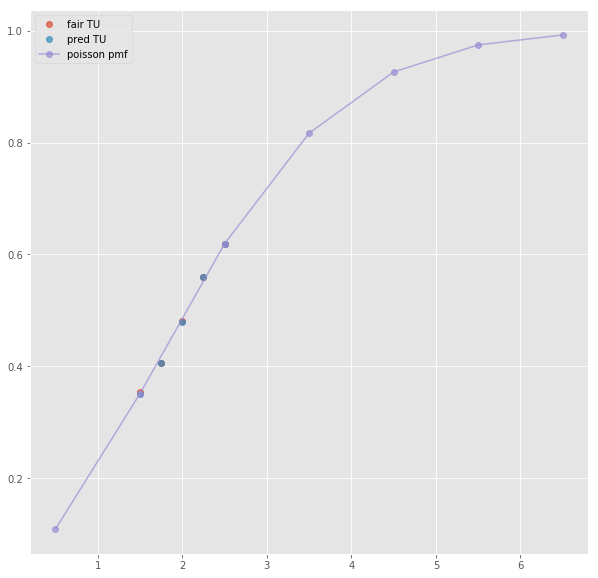

Error T1O:  0.0016962108211849292
ML : 3.08 2.99 2.63
Error home:  0.025300122267411185
Error draw:  0.03174283447807874
Error away:  0.006442433209540355

(19, 124)
(1, 20)
next list index out of range
(64, 124)
(1, 35)
3.5 1.57 2.48 3.5 1.79 2.08
TO fair:  1.6330645161290323 TU fair:  2.579617834394904
TO pred:  1.63306 TU fair:  2.57963
Error TO:  1.6934050792727362e-06

Error TO:  0.008043661367318433

Error TO:  0.05051881628776789

Error TO:  0.00427234831458434

Error TO:  0.005620789586828545

Error TO:  0.0018112350244191555



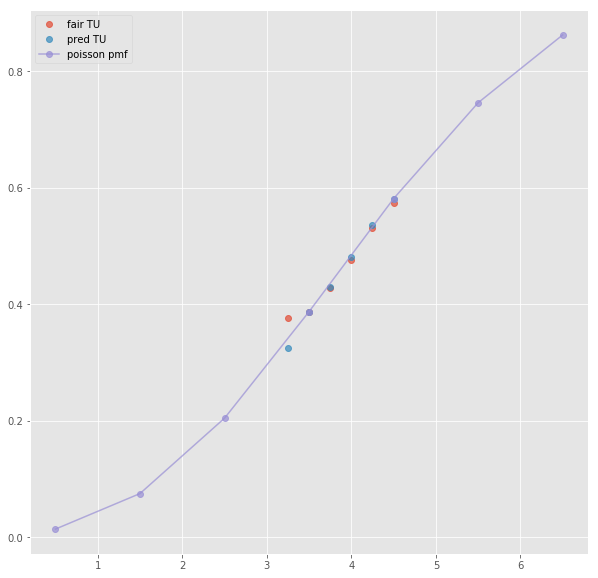

Error T1O:  0.05321026953409724
ML : 44.76 14.84 1.05
Error home:  0.008127253655360126
Error draw:  0.01853969388157784
Error away:  0.026666943659915066

(14, 124)
(1, 39)
2.5 2.12 1.757 0.5 1.653 2.32
TO fair:  2.2066021627774615 TU fair:  1.82877358490566
TO pred:  2.20664 TU fair:  1.82875
Error TO:  0.001818458317174254

Error TO:  0.0050983854067545575

Error TO:  0.008610216317591346

Error TO:  7.770764068437686e-06

Error TO:  0.004607624585239445

Error TO:  0.0023371433913103035

Error TO:  0.005103783997143618



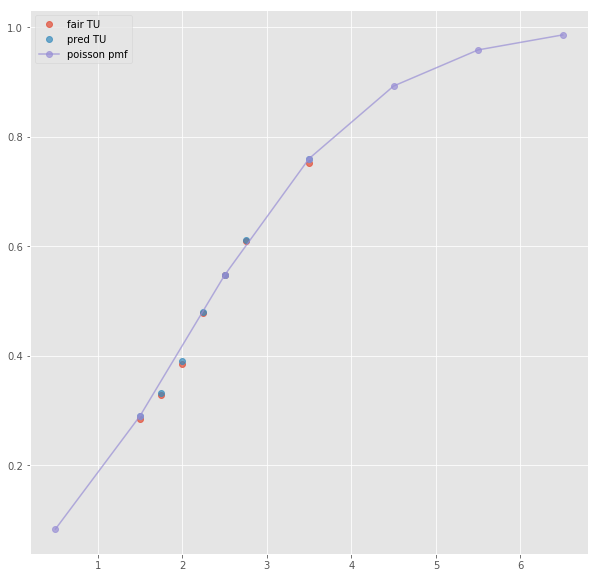

ML : 3.4 3.16 2.33
Error home:  0.03213002621288763
Error draw:  0.035425194415216577
Error away:  0.0032950249478223004

(156, 124)
(1, 19)
next list index out of range
(27, 124)
(1, 19)
2.5 2.17 1.75 0.5 1.68 2.31
TO fair:  2.2399999999999998 TU fair:  1.8064516129032258
TO pred:  2.23999 TU fair:  1.80646
Error TO:  1.992993591104497e-06

Error TO:  0.010406267832558602



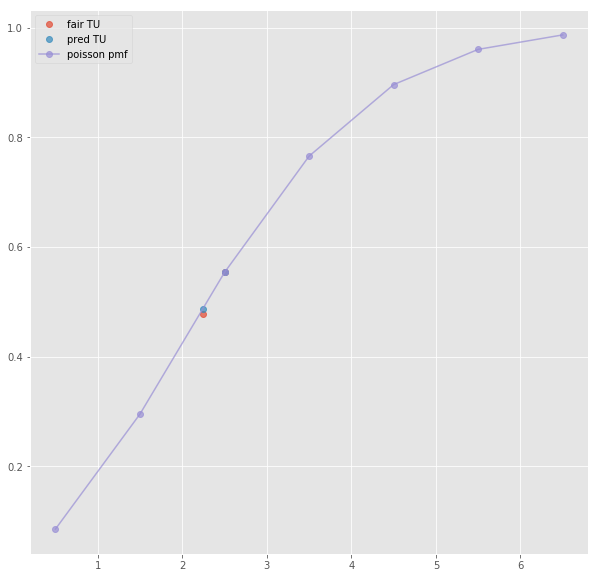

ML : 3.25 3.2 2.34
Error home:  0.015040079631034597
Error draw:  0.02814476106861491
Error away:  0.013104598174869031

(33, 124)
(1, 19)
2.5 2.13 1.78 0.5 1.69 2.29
TO fair:  2.1966292134831464 TU fair:  1.8356807511737092
TO pred:  2.19667 TU fair:  1.83565
Error TO:  8.452692000116002e-06

Error TO:  0.0033714509773671297



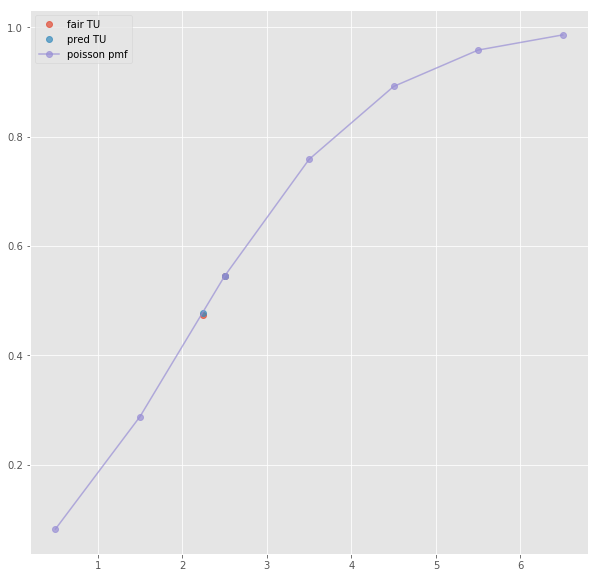

ML : 3.4 3.15 2.28
Error home:  0.027520796317664853
Error draw:  0.03450943162566922
Error away:  0.006988699627235251

(12, 124)
(1, 41)
2.5 2.12 1.757 0.5 1.653 2.32
TO fair:  2.2066021627774615 TU fair:  1.82877358490566
TO pred:  2.20664 TU fair:  1.82875
Error TO:  0.001818458317174254

Error TO:  0.0050983854067545575

Error TO:  0.008610216317591346

Error TO:  7.770764068437686e-06

Error TO:  0.004607624585239445

Error TO:  0.0023371433913103035

Error TO:  0.005103783997143618



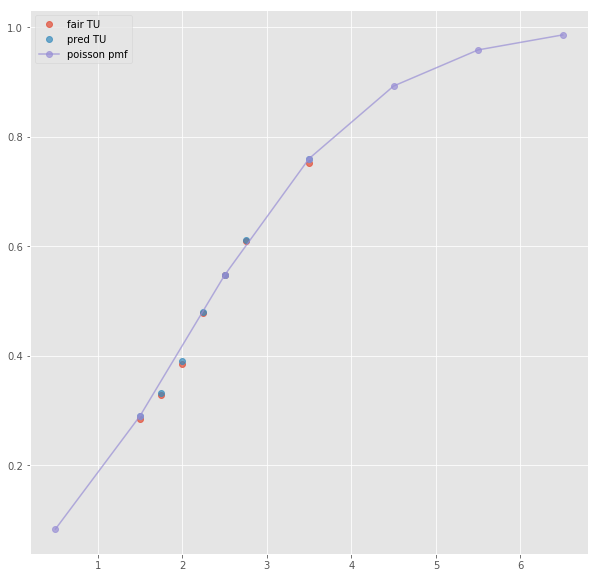

Error T1O:  0.0046120973781225705
ML : 3.4 3.16 2.33
Error home:  0.03213002621288763
Error draw:  0.035425194415216577
Error away:  0.0032950249478223004

(5, 124)
(1, 62)
2.5 2.075 1.725 0.5 1.675 2.15
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20286 TU fair:  1.83135
Error TO:  0.006166961368480883

Error TO:  0.012214611881030346

Error TO:  0.008459417505759348

Error TO:  0.013464904016729812

Error TO:  7.944217971178613e-06

Error TO:  0.014284737492228028

Error TO:  0.00139622024779118

Error TO:  0.01718642427817213

Error TO:  0.009614677377671854

Error TO:  0.01980480616583484

Error TO:  0.020474852208014843

Error TO:  0.02262909027312815

Error TO:  0.019857475386065415



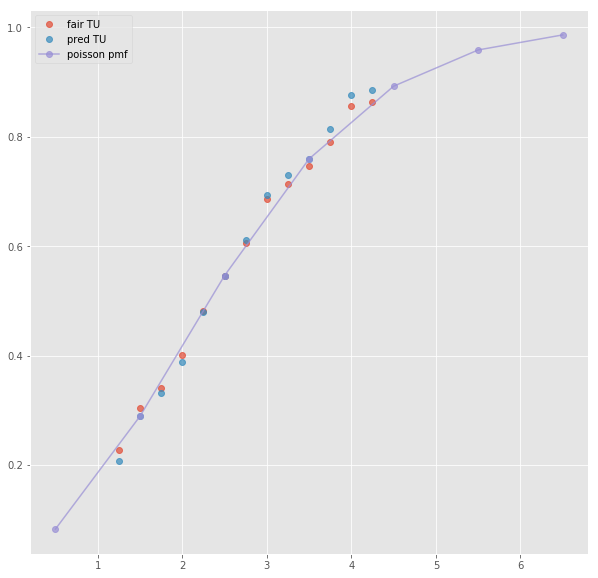

ML : 3.4 3.3 2.15
Error home:  0.01833710402287525
Error draw:  0.018388834127972375
Error away:  5.140364593342328e-05

(6, 124)
(1, 33)
2.5 2.13 1.76 0.5 1.67 2.27
TO fair:  2.210227272727273 TU fair:  1.8262910798122067
TO pred:  2.21019 TU fair:  1.82631
Error TO:  0.004920318724142836

Error TO:  0.001217635963895014

Error TO:  7.630001589653546e-06

Error TO:  0.0011030439439254636

Error TO:  0.002501533762786945



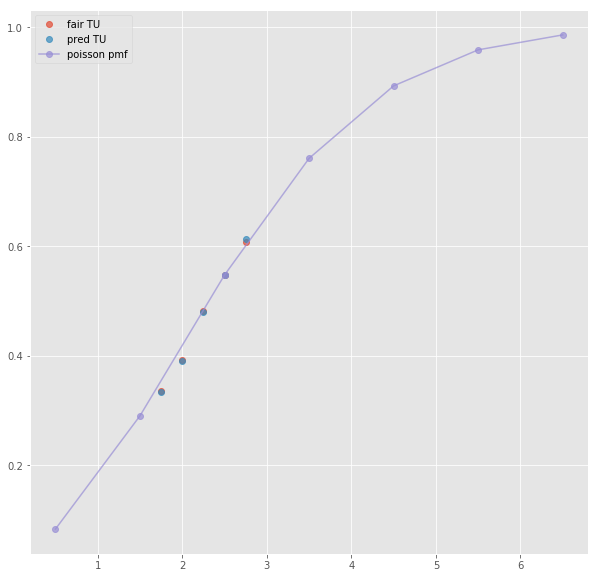

Error T1O:  0.0003240547887719547
ML : 3.36 3.25 2.3
Error home:  0.021473117700165967
Error draw:  0.02732514726771129
Error away:  0.005851863499508281

(22, 124)
(1, 47)
2.5 1.8 2.09 -0.5 2.21 1.729
TO fair:  1.8612440191387563 TU fair:  2.161111111111111
TO pred:  1.86126 TU fair:  2.16109
Error TO:  0.0006550485044758414

Error TO:  0.023097160093539126

Error TO:  0.0009984014666917784

Error TO:  6.979806265294819e-06

Error TO:  0.004218815556565836

Error TO:  4.613067627112777e-06

Error TO:  0.004897116325243922

Error TO:  0.000990517877315411

Error TO:  0.00011853584158705299



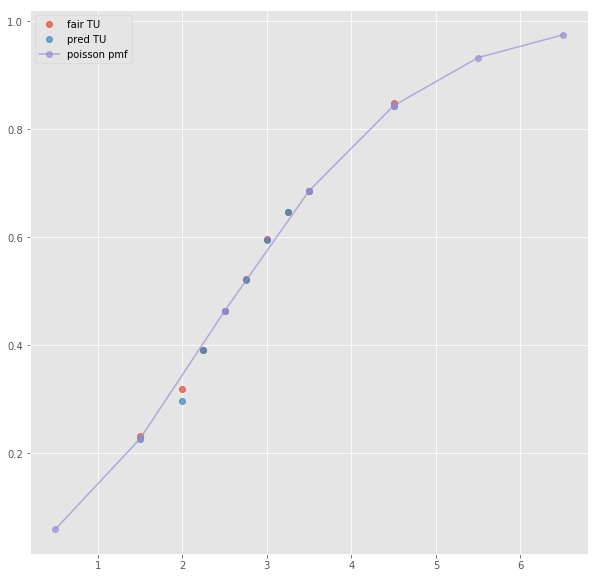

ML : 2.21 3.4 3.46
Error home:  0.002026878147848743
Error draw:  0.03543843668017341
Error away:  0.03341166433948067

(49, 124)
(1, 21)
2.5 1.77 2.05 -0.5 2.26 1.63
TO fair:  1.8634146341463418 TU fair:  2.15819209039548
TO pred:  1.86343 TU fair:  2.15818
Error TO:  0.005755604589651575

Error TO:  4.425212268843737e-06



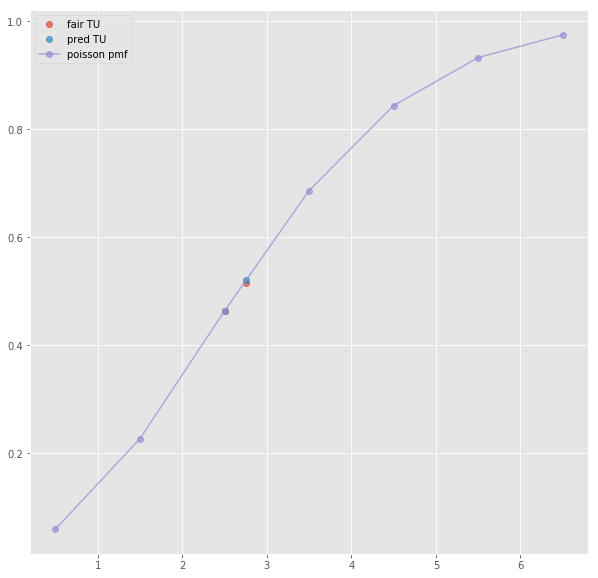

ML : 2.12 3.21 3.21
Error home:  0.011843540892429838
Error draw:  0.03443681896750517
Error away:  0.046280523132754325

(78, 124)
(1, 19)
2.5 1.77 2.14 -0.5 2.23 1.73
TO fair:  1.8271028037383177 TU fair:  2.209039548022599
TO pred:  1.82709 TU fair:  2.20906
Error TO:  0.005780217516855535

Error TO:  3.83542826798422e-06



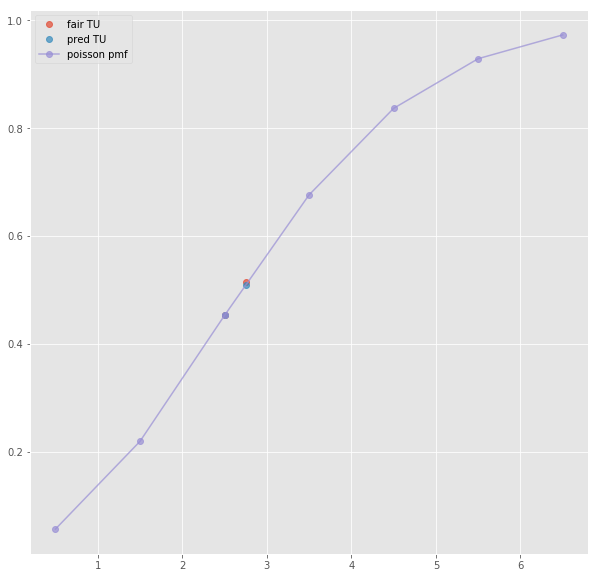

ML : 2.24 3.35 3.3
Error home:  0.010867309160630556
Error draw:  0.038167865813858004
Error away:  0.02730036285016474

(160, 124)
(1, 19)
2.5 1.79 2.12 -0.5 2.21 1.74
TO fair:  1.8443396226415094 TU fair:  2.184357541899441
TO pred:  1.84435 TU fair:  2.18434
Error TO:  0.002483754925409698

Error TO:  3.0507216447484e-06



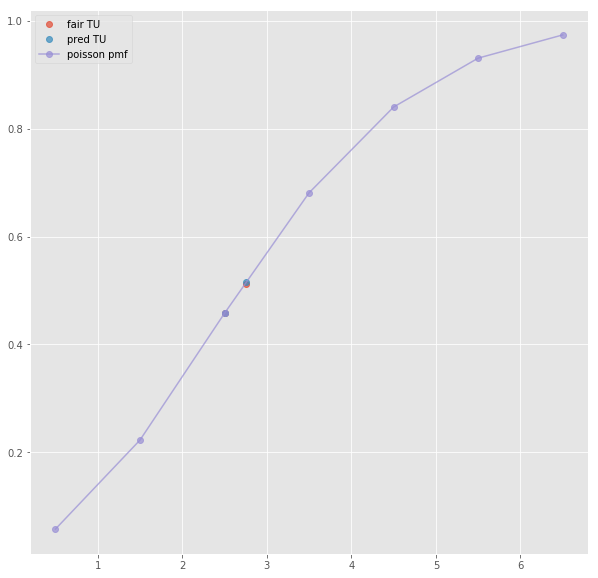

ML : 2.2 3.35 3.4
Error home:  0.006421643055233794
Error draw:  0.037640947948197
Error away:  0.031219530939457785

(23, 124)
(1, 49)
2.5 1.806 2.08 -0.5 2.22 1.719
TO fair:  1.8682692307692306 TU fair:  2.1517165005537096
TO pred:  1.86826 TU fair:  2.15173
Error TO:  0.00034156688311182126

Error TO:  0.020999274778719546

Error TO:  0.0009037975045647073

Error TO:  0.0015785803287349243

Error TO:  0.003608684618025021

Error TO:  2.6446068402963263e-06

Error TO:  0.0036174350847415493

Error TO:  0.0004838360197849667

Error TO:  0.0009744676832097454



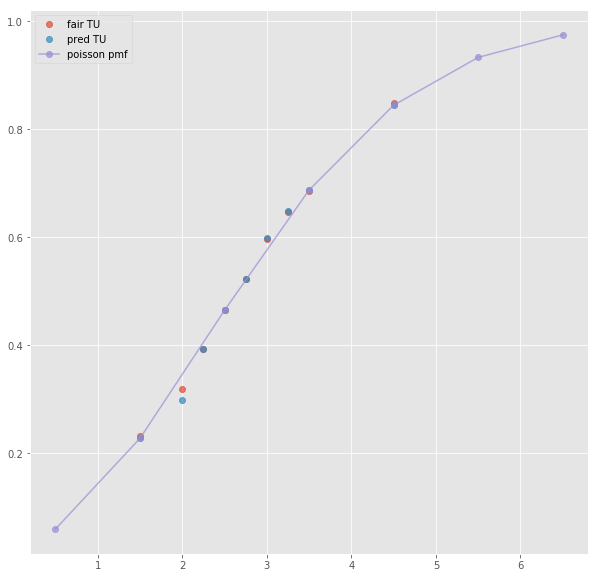

Error T1O:  0.015129796530090889
ML : 2.22 3.35 3.48
Error home:  0.0017332919173544958
Error draw:  0.03885959899851113
Error away:  0.03712614504579531

(39, 124)
(1, 71)
3.5 2.75 1.425 -0.5 2.2 1.65
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.04991736185513501

Error TO:  0.03540841325086819

Error TO:  0.020453053203135063

Error TO:  1.7985490940453097e-06

Error TO:  0.0032884385528114957

Error TO:  0.02578548711952855

Error TO:  0.028265949221071396

Error TO:  0.03283043366857896

Error TO:  0.009352251151134972

Error TO:  0.030731926345489935

Error TO:  0.0019286973203154478

Error TO:  0.002449233272790924

Error TO:  0.008366637600584537

Error TO:  0.024947678360244696

Error TO:  0.00572177298806098



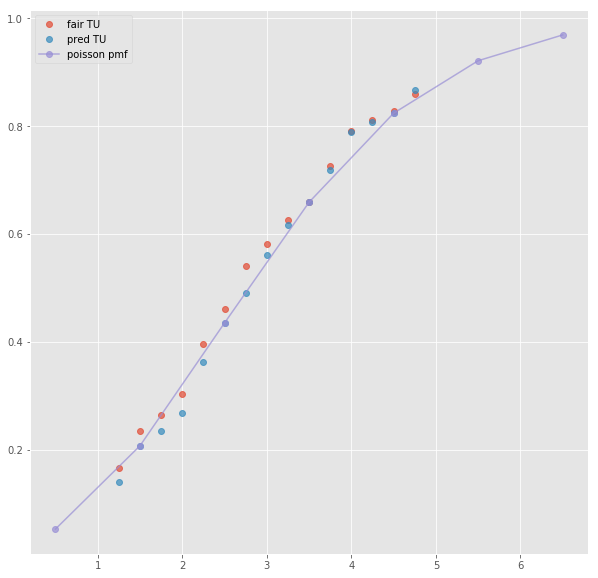

ML : 2.15 3.4 3.4
Error home:  0.012977216844733797
Error draw:  0.035562592671198434
Error away:  0.04853953621574836

(19, 124)
(1, 35)
2.5 1.8 2.06 -0.5 2.19 1.72
TO fair:  1.8737864077669903 TU fair:  2.1444444444444444
TO pred:  1.87377 TU fair:  2.14446
Error TO:  0.005263674081665504

Error TO:  0.013007015977476666

Error TO:  4.673186508430405e-06

Error TO:  0.0011095350780931934

Error TO:  0.016302681196711077



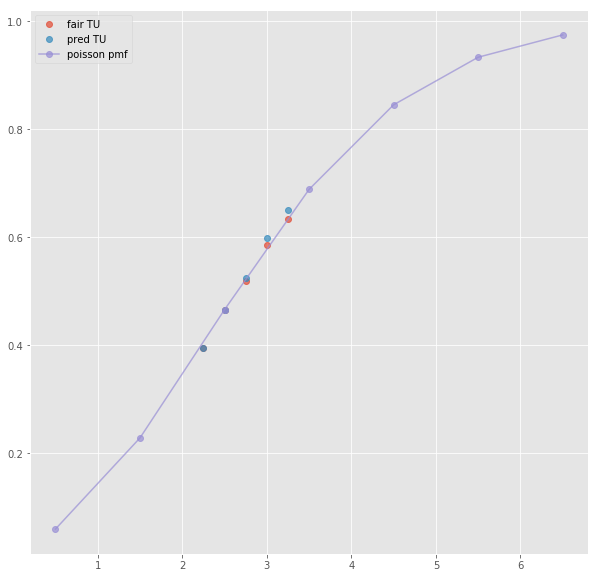

Error T1O:  0.012869043464131091
ML : 2.21 3.46 3.35
Error home:  0.004817255571660017
Error draw:  0.028678985027471515
Error away:  0.02386168977791009

(22, 124)
(1, 40)
3.5 2.69 1.487 -1.5 1.775 2.11
TO fair:  2.8090114324142568 TU fair:  1.5527881040892193
TO pred:  2.80898 TU fair:  1.5528
Error TO:  0.003619198219336761

Error TO:  0.003330289442265044

Error TO:  3.983598734769167e-06

Error TO:  0.001489003051791199

Error TO:  0.004625800584987516

Error TO:  0.008257617417729901

Error TO:  0.0017271690854603339

Error TO:  0.0003933430037361685



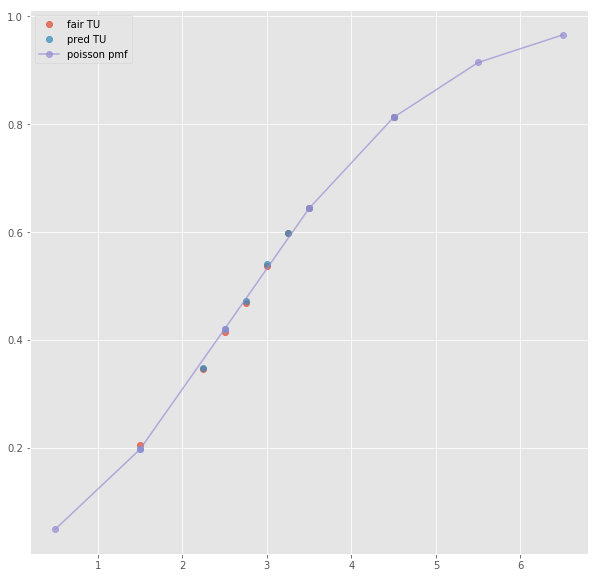

ML : 1.217 6.28 14.48
Error home:  0.010890221149492674
Error draw:  0.0007883868982986597
Error away:  0.010101817984764325

(39, 124)
(1, 20)
2.5 1.65 2.26 -1.5 1.77 2.12
TO fair:  1.7300884955752214 TU fair:  2.3696969696969696
TO pred:  1.73007 TU fair:  2.36974
Error TO:  0.003720046122764109

Error TO:  0.002376059465126368

Error TO:  6.179251177407252e-06



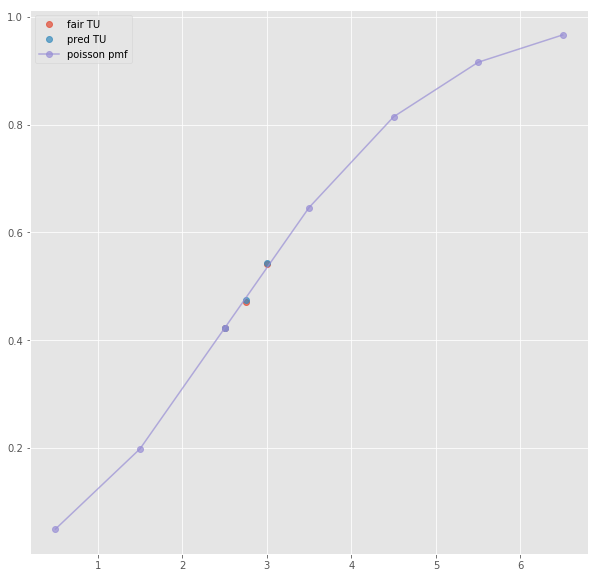

ML : 1.23 5.58 10.48
Error home:  0.026136701672685447
Error draw:  0.012966988584637379
Error away:  0.013169764763878003

(90, 124)
(1, 20)
2.5 1.69 2.26 -1.5 1.78 2.16
TO fair:  1.7477876106194692 TU fair:  2.337278106508876
TO pred:  1.74778 TU fair:  2.3373
Error TO:  0.02145621560533939

Error TO:  0.020595070390941106

Error TO:  2.4914064584713458e-06



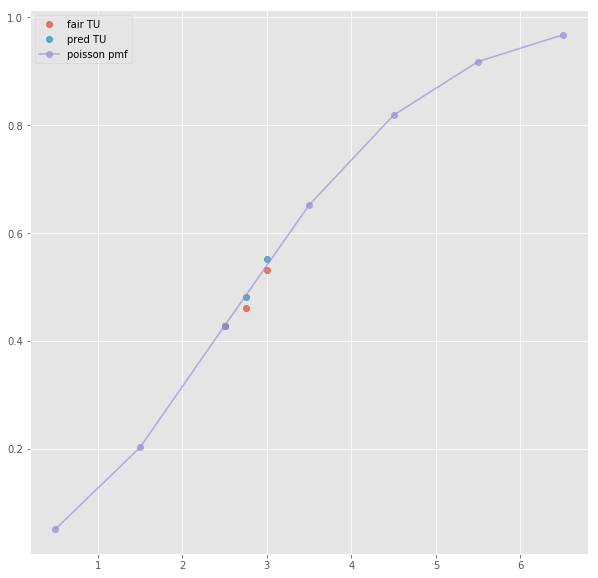

ML : 1.25 6.0 13.0
Error home:  0.010772374606610957
Error draw:  0.008908576755729342
Error away:  0.0018637157097302764

(196, 124)
(1, 18)
2.5 1.67 2.29 -1.5 1.78 2.16
TO fair:  1.7292576419213972 TU fair:  2.37125748502994
TO pred:  1.72928 TU fair:  2.37121
Error TO:  0.005697033342084601

Error TO:  7.476691414654013e-06



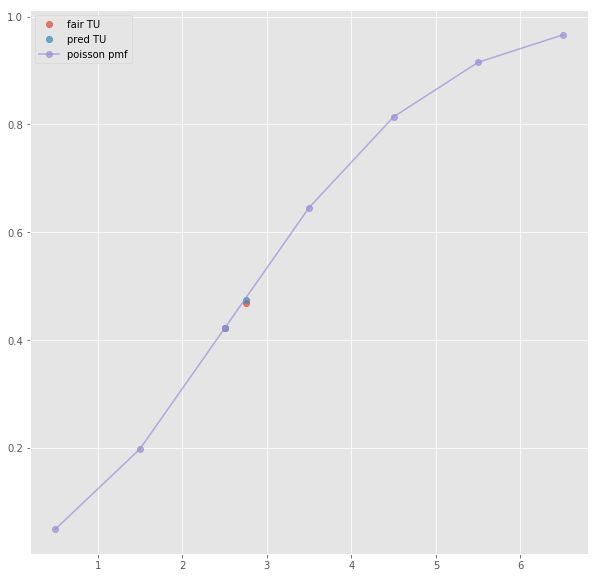

ML : 1.23 6.1 14.0
Error home:  0.0007804853367705533
Error draw:  0.00579291246668906
Error away:  0.005012438988073881

(12, 124)
(1, 42)
3.5 2.73 1.473 -1.5 1.781 2.11
TO fair:  2.85336048879837 TU fair:  1.5395604395604394
TO pred:  2.8533 TU fair:  1.53958
Error TO:  0.0068438523883427305

Error TO:  0.0035437419581705876

Error TO:  7.429693151372874e-06

Error TO:  0.004576971877822161

Error TO:  0.007917996660777749

Error TO:  0.005910324584927351

Error TO:  0.004551466754901701

Error TO:  0.0015247519548381439



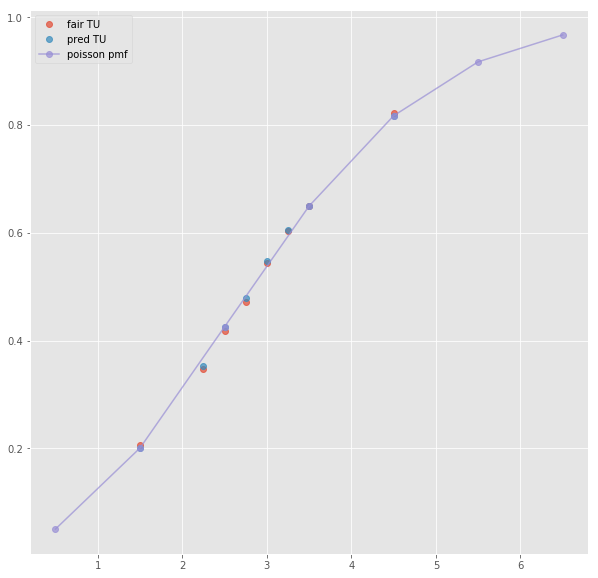

Error T1O:  0.004531658114769133
ML : 1.219 6.24 14.42
Error home:  0.009344160144120206
Error draw:  0.0003257355997110245
Error away:  0.009018428173348247

(35, 124)
next positional indexers are out-of-bounds
(243, 124)
next positional indexers are out-of-bounds
(475, 124)
next positional indexers are out-of-bounds
(265, 124)
next positional indexers are out-of-bounds
(709, 124)
next positional indexers are out-of-bounds
(246, 124)
(1, 45)
2.5 1.877 2.04 -0.5 2.6 1.568
TO fair:  1.9200980392156863 TU fair:  2.086840703249867
TO pred:  1.9201 TU fair:  2.08684
Error TO:  0.001102236169913673

Error TO:  0.004142222783954486

Error TO:  0.0007734381927026468

Error TO:  0.001827209935641394

Error TO:  0.0022203981667689165

Error TO:  5.318419279420894e-07

Error TO:  0.003474642916038939

Error TO:  0.0017128503617610535

Error TO:  0.010987051010594273



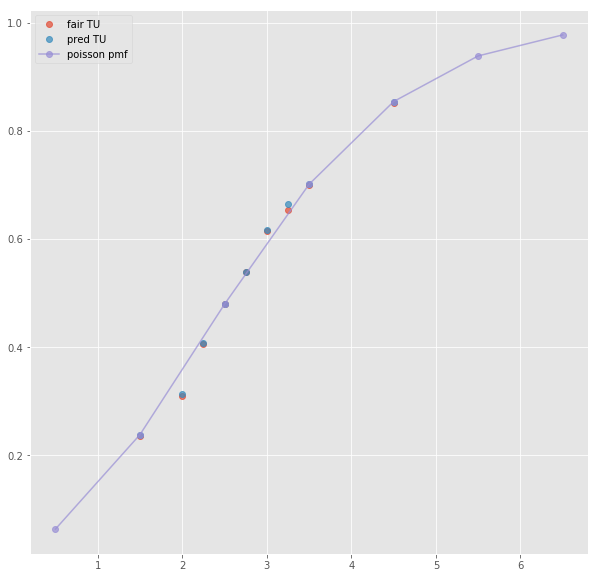

Error T1O:  0.010634758392985943
ML : 2.6 3.5 2.82
Error home:  0.0009476896160354742
Error draw:  0.023824569254007333
Error away:  0.02287675815755208

(54, 124)
(1, 67)
2.5 1.775 2.025 -0.5 2.425 1.525
TO fair:  1.8765432098765433 TU fair:  2.1408450704225355
TO pred:  1.87655 TU fair:  2.14084
Error TO:  0.027014880655148288

Error TO:  0.04037852613042481

Error TO:  0.013038017626186393

Error TO:  0.006886634065002839

Error TO:  0.0040315396879589405

Error TO:  1.9282305574463976e-06

Error TO:  0.034842832735956564

Error TO:  0.03334185771652498

Error TO:  0.007804418882504716

Error TO:  0.026142398556191604

Error TO:  0.0014223198730038134

Error TO:  0.0014584648515796883

Error TO:  0.004221738808030229

Error TO:  0.03143475765166204

Error TO:  0.020831528041164143



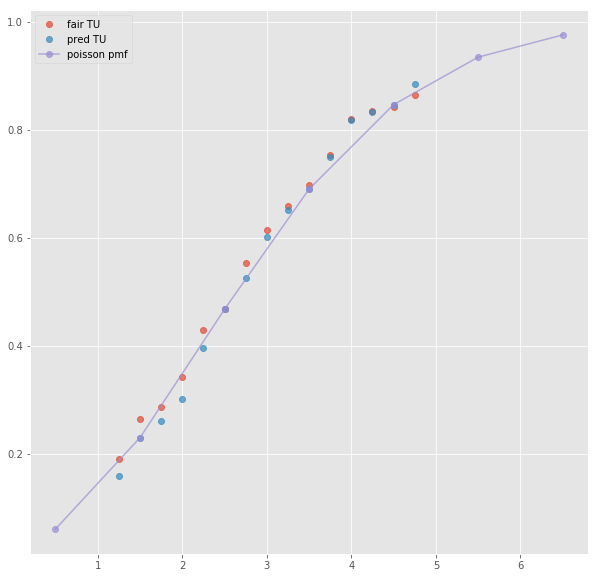

ML : 2.5 3.4 2.8
Error home:  0.005582422851942936
Error draw:  0.027585906539946137
Error away:  0.022003464481569035

(39, 124)
next positional indexers are out-of-bounds
(106, 124)
(1, 39)
2.5 2.28 1.689 -0.5 2.68 1.529
TO fair:  2.349911190053286 TU fair:  1.7407894736842107
TO pred:  2.34996 TU fair:  1.74076
Error TO:  0.005250524970400072

Error TO:  0.00539239500959432

Error TO:  0.01584415885699289

Error TO:  8.838863238769257e-06

Error TO:  0.005486367238592749

Error TO:  0.0022176813273212526

Error TO:  0.005368528115669902



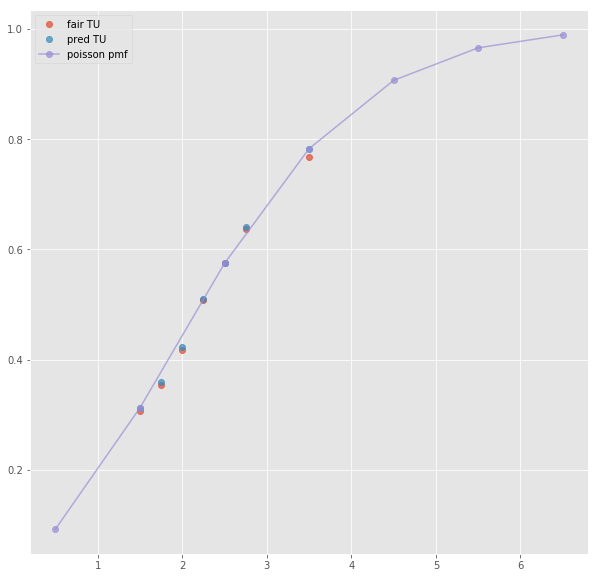

ML : 2.68 3.11 2.99
Error home:  0.0006898187782923837
Error draw:  0.03457899483309107
Error away:  0.03388910399813494

(136, 124)
(1, 27)
2.5 2.25 1.64 -0.5 2.66 1.47
TO fair:  2.371951219512195 TU fair:  1.7288888888888885
TO pred:  2.37196 TU fair:  1.72889
Error TO:  0.0039878952050246275

Error TO:  0.003305990065127551

Error TO:  1.560650047249812e-06

Error TO:  0.0016459368710890487



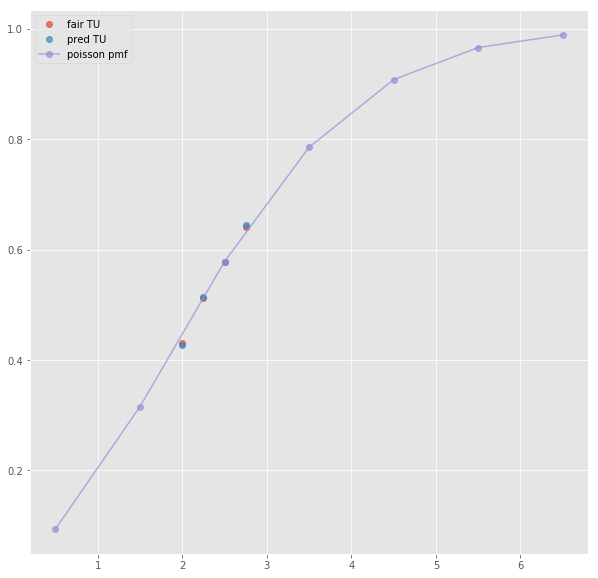

ML : 2.73 3.06 2.75
Error home:  0.0092856458589195
Error draw:  0.030355771182719427
Error away:  0.02107001882406745

(158, 124)
(1, 23)
next list index out of range
(425, 124)
(1, 27)
next list index out of range
(92, 124)
(1, 41)
2.5 2.28 1.689 -0.5 2.68 1.529
TO fair:  2.349911190053286 TU fair:  1.7407894736842107
TO pred:  2.34996 TU fair:  1.74076
Error TO:  0.005250524970400072

Error TO:  0.00539239500959432

Error TO:  0.01584415885699289

Error TO:  8.838863238769257e-06

Error TO:  0.005486367238592749

Error TO:  0.0022176813273212526

Error TO:  0.005368528115669902



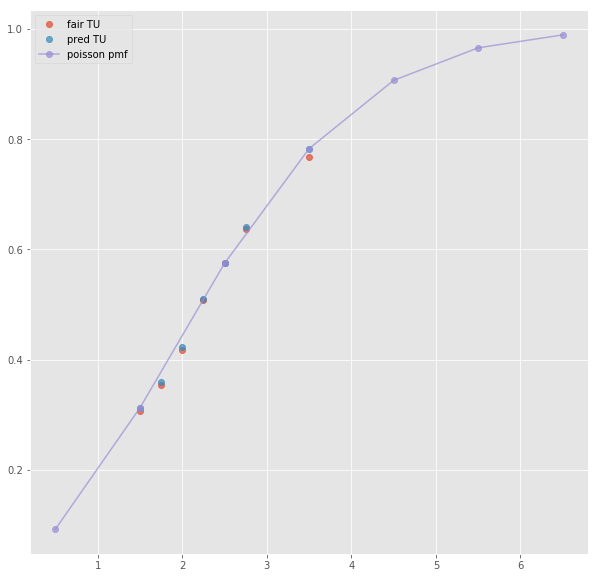

Error T1O:  0.02517650923185799
ML : 2.68 3.11 2.99
Error home:  0.0006898187782923837
Error draw:  0.03457899483309107
Error away:  0.03388910399813494

(30, 124)
next positional indexers are out-of-bounds
(16, 124)
(1, 15)
2.5 2.0 1.85 -0.5 1.9 1.95
TO fair:  2.0810810810810807 TU fair:  1.9249999999999998
TO pred:  2.0811 TU fair:  1.92499
Error TO:  4.368319201975002e-06



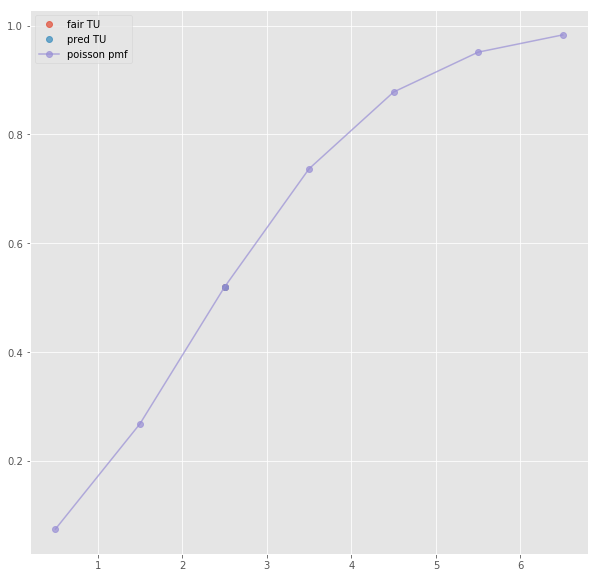

ML : 1.85 3.4 3.75
Error home:  0.015681323790201374
Error draw:  0.015583130698153369
Error away:  9.79747650990681e-05

(37, 124)
(1, 33)
2.5 2.02 1.83 -0.5 1.99 1.86
TO fair:  2.1038251366120218 TU fair:  1.9059405940594059
TO pred:  2.10382 TU fair:  1.90594
Error TO:  0.0025764383208564667

Error TO:  0.0038919605628746634

Error TO:  0.007833756917558554

Error TO:  1.1605358070099214e-06

Error TO:  0.0013599891200869463



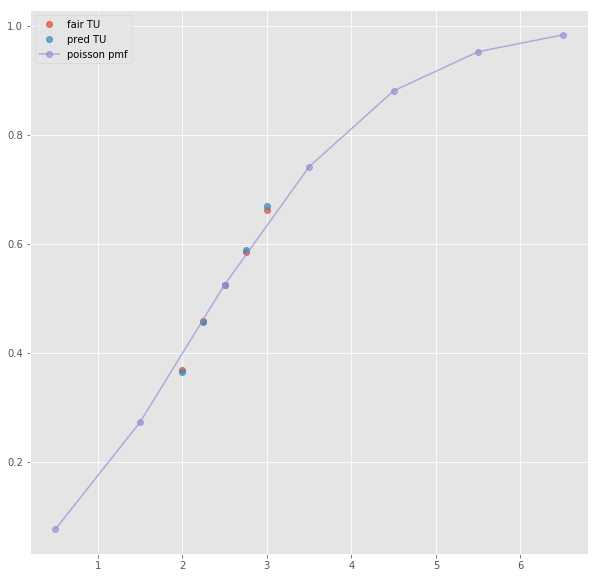

Error T1O:  0.005172365853911343
ML : 2.01 3.55 3.83
Error home:  0.004887031306972767
Error draw:  0.01437235371288198
Error away:  0.009485312524094847

(34, 124)
(1, 40)
2.5 2.49 1.571 -0.5 1.729 2.21
TO fair:  2.5849777211966902 TU fair:  1.6309236947791166
TO pred:  2.58496 TU fair:  1.63093
Error TO:  0.016609758188312618

Error TO:  0.007565874260357153

Error TO:  0.004263679503371365

Error TO:  2.652054314822294e-06

Error TO:  0.011591686240403631

Error TO:  0.0033409998182033496

Error TO:  0.010556744306783994



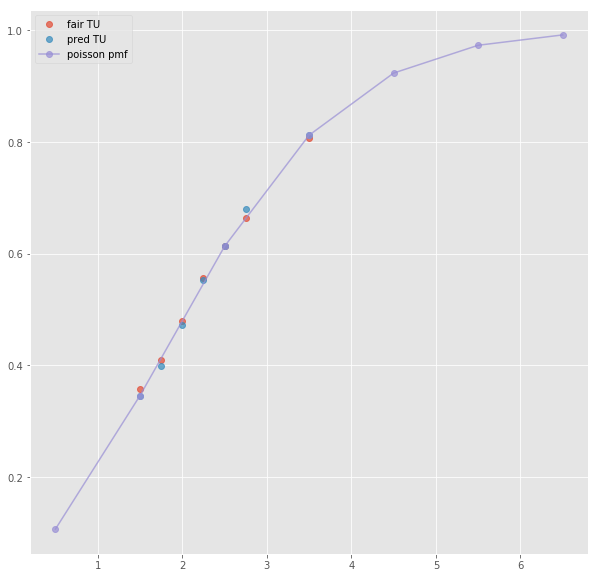

ML : 1.729 3.53 5.69
Error home:  0.0035528884954755258
Error draw:  0.012889058706318457
Error away:  0.009336362522983616

(40, 124)
(1, 21)
next list index out of range
(96, 124)
(1, 19)
next list index out of range
(161, 124)
(1, 19)
next list index out of range
(30, 124)
(1, 42)
2.5 2.49 1.571 -0.5 1.729 2.21
TO fair:  2.5849777211966902 TU fair:  1.6309236947791166
TO pred:  2.58496 TU fair:  1.63093
Error TO:  0.016609758188312618

Error TO:  0.007565874260357153

Error TO:  0.004263679503371365

Error TO:  2.652054314822294e-06

Error TO:  0.011591686240403631

Error TO:  0.0033409998182033496

Error TO:  0.010556744306783994



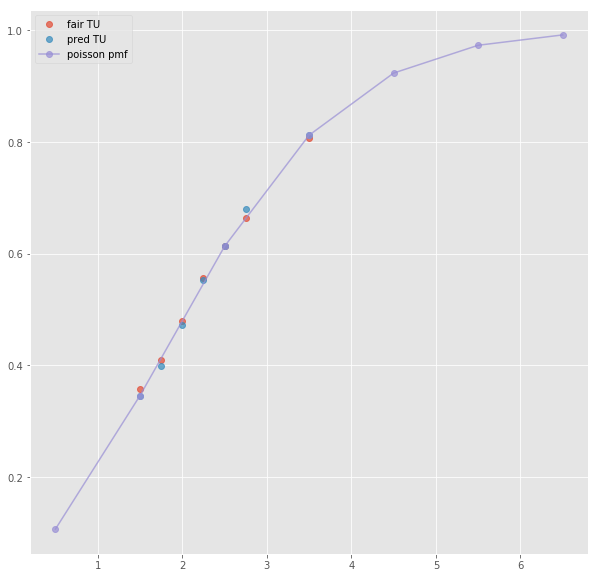

Error T1O:  0.005064512122008313
ML : 1.729 3.53 5.69
Error home:  0.0035528884954755258
Error draw:  0.012889058706318457
Error away:  0.009336362522983616

(19, 124)
next positional indexers are out-of-bounds
(16, 124)
(1, 47)
2.5 2.19 1.6569999999999998 0.5 1.719 2.11
TO fair:  2.3216656608328305 TU fair:  1.75662100456621
TO pred:  2.32167 TU fair:  1.75662
Error TO:  0.010119280995614266

Error TO:  0.011717308876067367

Error TO:  0.06223459418021893

Error TO:  0.030090071935788415

Error TO:  0.053176839084871336

Error TO:  8.050191553365948e-07

Error TO:  0.012178008911730931

Error TO:  0.00457279311950709

Error TO:  0.11690653216076949

Error TO:  0.013358008768531882



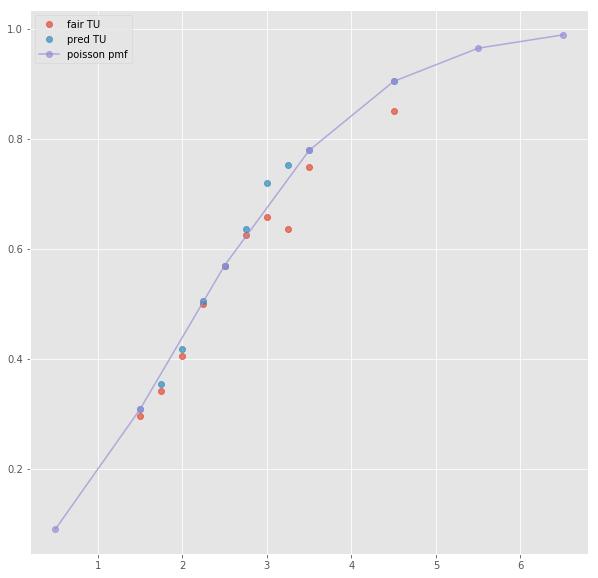

ML : 3.54 3.18 2.11
Error home:  0.016075426909270885
Error draw:  0.02243859752489552
Error away:  0.006363093963435207

(12, 124)
(1, 15)
2.5 2.01 1.73 0.5 1.81 1.95
TO fair:  2.161849710982659 TU fair:  1.8606965174129355
TO pred:  2.16189 TU fair:  1.86067
Error TO:  8.620403275039212e-06



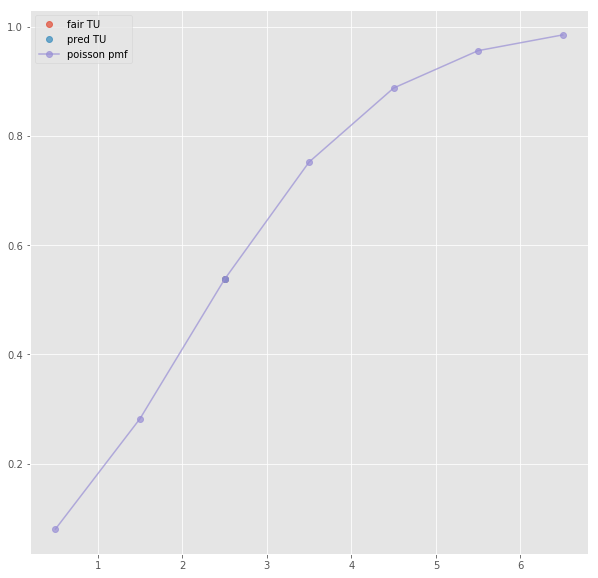

ML : 3.31 3.11 1.95
Error home:  0.006666705274748774
Error draw:  0.023467617012748854
Error away:  0.030134593405875265

(15, 124)
(1, 15)
2.5 2.03 1.79 0.5 1.79 2.05
TO fair:  2.134078212290502 TU fair:  1.8817733990147782
TO pred:  2.13413 TU fair:  1.88173
Error TO:  1.1370917285757898e-05



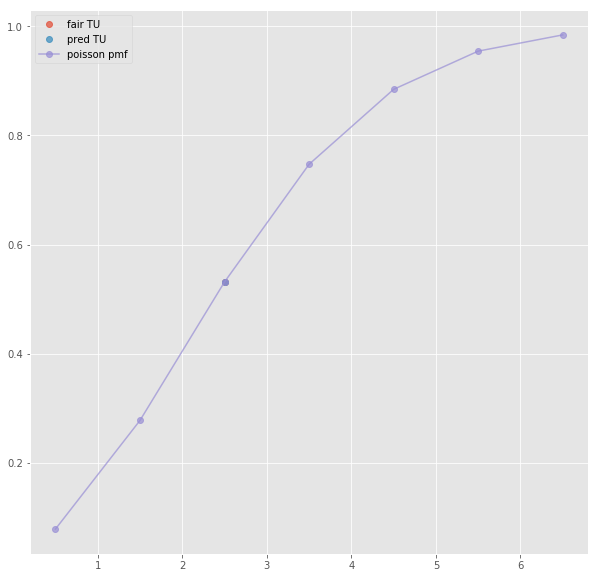

ML : 3.55 3.15 1.99
Error home:  0.017879979937375667
Error draw:  0.02788420440874889
Error away:  0.010003970836199916

(40, 124)
(1, 15)
2.5 2.14 1.69 0.5 1.81 2.03
TO fair:  2.2662721893491127 TU fair:  1.7897196261682242
TO pred:  2.2663 TU fair:  1.7897
Error TO:  5.414790835212013e-06



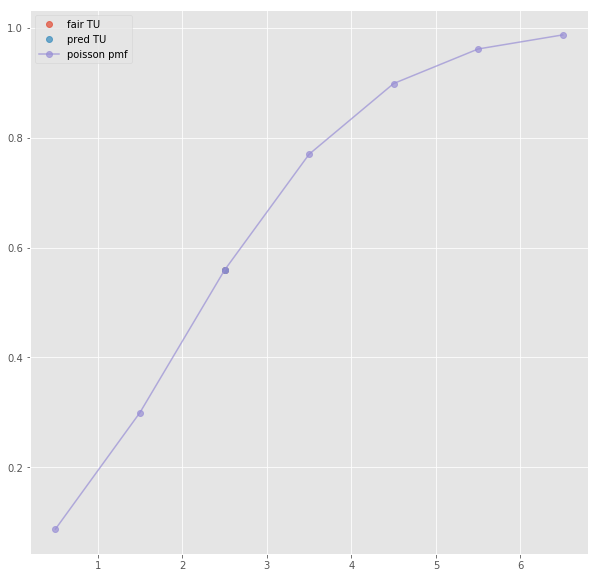

ML : 3.3 3.1 2.03
Error home:  0.008120138669048982
Error draw:  0.02270701567655492
Error away:  0.030827403682513133

(5, 124)
(1, 47)
2.5 2.01 1.787 0.5 1.9 1.917
TO fair:  2.124790151091214 TU fair:  1.889054726368159
TO pred:  2.1248 TU fair:  1.88904
Error TO:  0.010549509936492674

Error TO:  0.012582337430016466

Error TO:  0.025391085334102115

Error TO:  0.03205468636111025

Error TO:  0.032737021681951056

Error TO:  2.181493950592639e-06

Error TO:  0.010582224150229358

Error TO:  0.005079828841057732

Error TO:  0.07897792280358867

Error TO:  0.005882188743113637



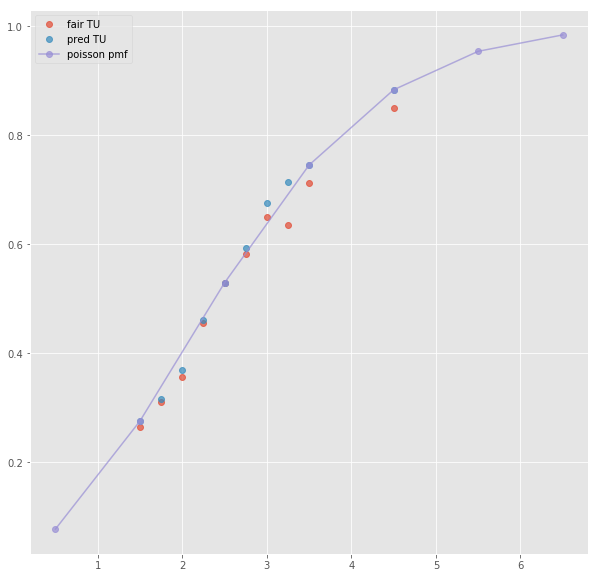

Error T1O:  0.00874733462331806
ML : 4.38 3.15 1.917
Error home:  0.03326321999069495
Error draw:  0.042332554118447774
Error away:  0.009069398455210653

(9, 124)
(1, 17)
2.5 2.025 1.825 0.5 1.925 1.925
TO fair:  2.1095890410958904 TU fair:  1.9012345679012344
TO pred:  2.10962 TU fair:  1.90121
Error TO:  6.956382986200715e-06

Error TO:  0.016613683329182893



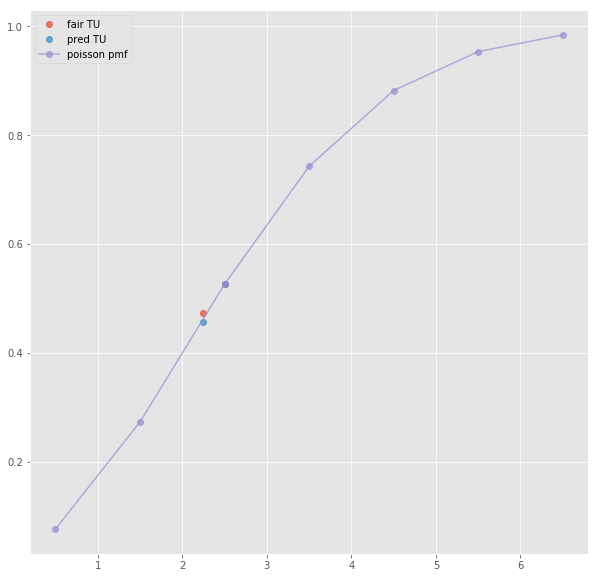

ML : 3.8 3.4 1.85
Error home:  0.006312671743582077
Error draw:  0.01393946134618601
Error away:  0.007626951269512738

(15, 124)
(1, 37)
2.5 2.08 1.78 0.5 1.82 2.04
TO fair:  2.168539325842697 TU fair:  1.855769230769231
TO pred:  2.16855 TU fair:  1.85576
Error TO:  0.003622886814515336

Error TO:  0.0026906997677591526

Error TO:  0.02250248204242994

Error TO:  2.269848420721754e-06

Error TO:  0.001405418758750221

Error TO:  0.0031281581681206205



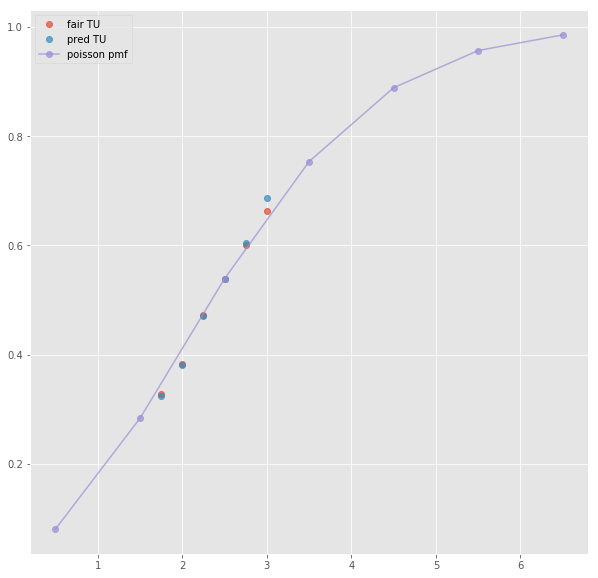

Error T1O:  0.002670738794514793
Error T1O:  0.020751047856027327
ML : 3.81 3.42 2.06
Error home:  0.014970529394560506
Error draw:  0.019859545564153924
Error away:  0.004889325885408302

(5, 124)
(1, 41)
3.5 2.77 1.473 -0.5 2.58 1.5490000000000002
TO fair:  2.8805159538357095 TU fair:  1.5317689530685923
TO pred:  2.88055 TU fair:  1.53176
Error TO:  0.009221619668847048

Error TO:  0.006907143559690632

Error TO:  4.103198124660867e-06

Error TO:  0.005875632227047539

Error TO:  0.011644098328247532

Error TO:  0.00948584327779245

Error TO:  0.011514724312515212

Error TO:  0.0026871875291293312



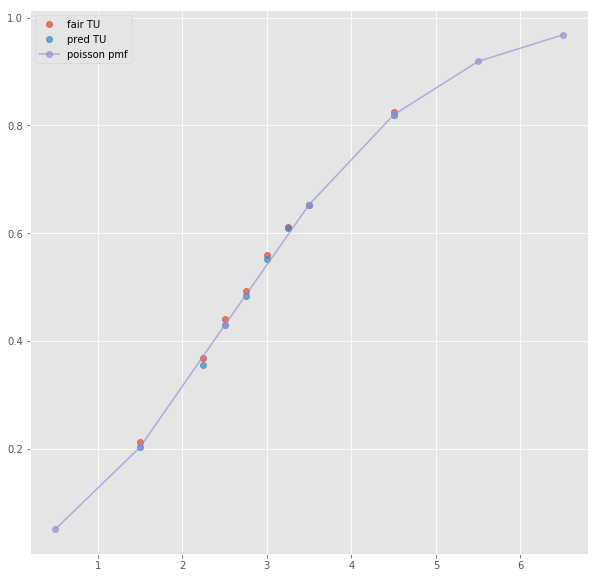

ML : 2.58 3.42 2.78
Error home:  0.002355631002224412
Error draw:  0.037070588933915044
Error away:  0.03471520028510022

(1, 124)
(1, 19)
next list index out of range
(1, 124)
(1, 15)
next list index out of range
(4, 124)
(1, 23)
next list index out of range
(68, 124)
(1, 47)
2.5 1.943 1.934 -0.5 2.48 1.591
TO fair:  2.004653567735264 TU fair:  1.9953679876479673
TO pred:  2.00467 TU fair:  1.99535
Error TO:  0.0053165230362030025

Error TO:  0.008281974940743009

Error TO:  0.01422048796989045

Error TO:  0.019315327647454028

Error TO:  0.01741740658077323

Error TO:  4.088982017980136e-06

Error TO:  0.008045567214737148

Error TO:  0.003938366800413595

Error TO:  0.04555382170224953



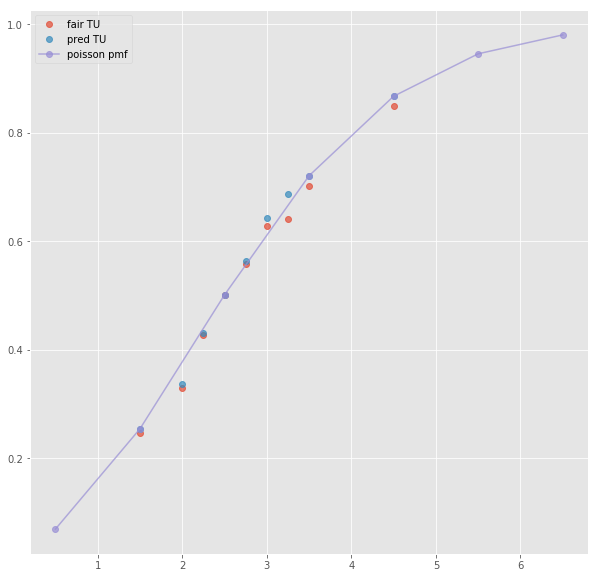

Error T1O:  0.01767668463170985
ML : 2.48 3.32 2.99
Error home:  0.002677206612660965
Error draw:  0.030335953259030102
Error away:  0.027658613495996742

(17, 124)
(1, 67)
3.5 2.675 1.45 -0.5 2.425 1.525
TO fair:  2.844827586206897 TU fair:  1.5420560747663552
TO pred:  2.84478 TU fair:  1.54207
Error TO:  0.009031737926519678

Error TO:  0.015826776113164964

Error TO:  0.005645024386429054

Error TO:  5.879988163315364e-06

Error TO:  0.012850476175087916

Error TO:  0.013471253217179457

Error TO:  0.0216309220725327

Error TO:  0.023323435595549946

Error TO:  0.0009611212849685025

Error TO:  0.022262116508840135

Error TO:  0.009205232239999944

Error TO:  0.01365895629374736

Error TO:  0.011208905461798924

Error TO:  0.025582112765512144

Error TO:  0.017251321344888576



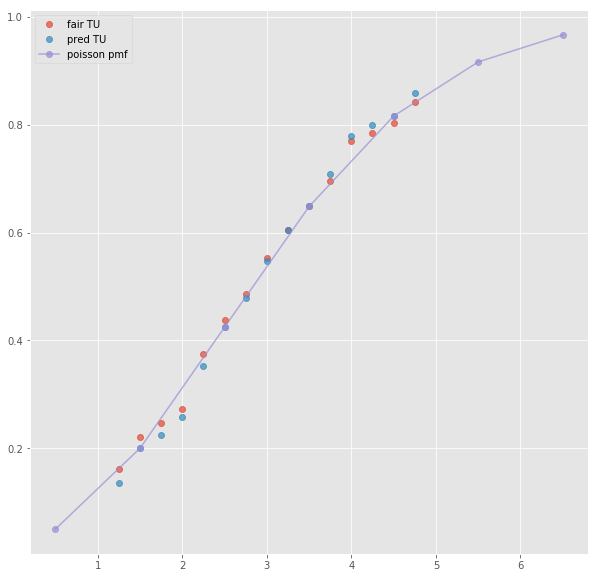

ML : 2.45 3.5 2.7
Error home:  0.0025493369387784015
Error draw:  0.025247447836826142
Error away:  0.022698137277435193

(26, 124)
next positional indexers are out-of-bounds
(181, 124)
next positional indexers are out-of-bounds
(289, 124)
next positional indexers are out-of-bounds
(208, 124)
next positional indexers are out-of-bounds
(622, 124)
next positional indexers are out-of-bounds
(146, 124)
(1, 47)
3.5 2.62 1.5490000000000002 1.5 1.602 2.5
TO fair:  2.691413815364751 TU fair:  1.5912213740458012
TO pred:  2.69143 TU fair:  1.59122
Error TO:  0.0025836247103254717

Error TO:  0.0014541704299571578

Error TO:  2.2342890129145587e-06

Error TO:  0.002570564498831529

Error TO:  0.003926398746061155

Error TO:  0.006298403429605526

Error TO:  0.00013381285341707017

Error TO:  0.02230690854665497

Error TO:  0.04391404737831994



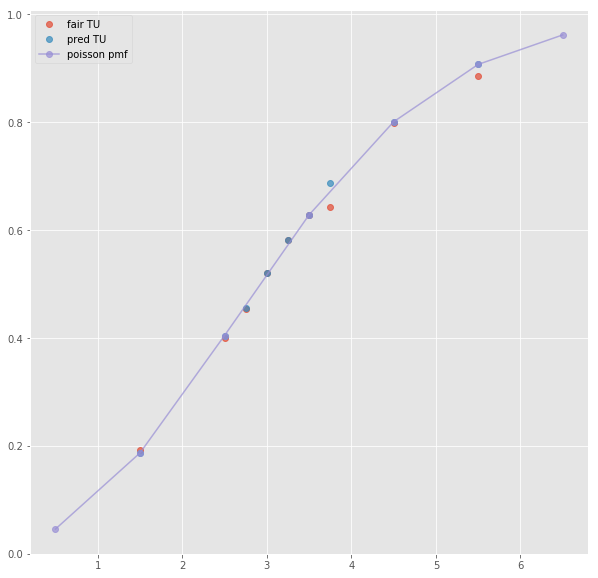

Error T1O:  0.01956290946338196
ML : 6.58 4.63 1.51
Error home:  0.02278611585422699
Error draw:  0.006611353751198312
Error away:  0.01617494796469099

(52, 124)
(1, 71)
3.5 2.3 1.6 1.5 1.675 2.15
TO fair:  2.4375 TU fair:  1.695652173913044
TO pred:  2.43748 TU fair:  1.69566
Error TO:  0.005442294679857351

Error TO:  0.02130526186775583

Error TO:  0.0057632807995973145

Error TO:  3.3662340635509658e-06

Error TO:  0.017821873149655165

Error TO:  0.006971434891142936

Error TO:  0.017122596355001685

Error TO:  0.018109589399205928

Error TO:  0.0008836608170404991

Error TO:  0.0266666360153609

Error TO:  0.006171075586141439

Error TO:  0.011750232278970374

Error TO:  0.0002210182186546117

Error TO:  0.015087408807303249

Error TO:  0.01695910073365836

Error TO:  0.02071195330115981



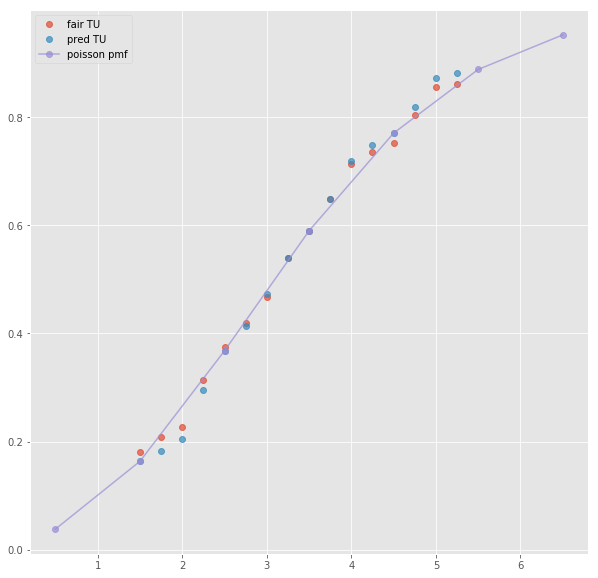

ML : 6.5 5.25 1.4
Error home:  0.0019171927302869263
Error draw:  0.0055294887596018805
Error away:  0.007446561474822255

(43, 124)
next positional indexers are out-of-bounds
(52, 124)
(1, 45)
3.5 2.84 1.442 -1.5 2.02 1.862
TO fair:  2.969486823855756 TU fair:  1.5077464788732395
TO pred:  2.9695 TU fair:  1.50774
Error TO:  0.00033938416194778664

Error TO:  0.02999248537506405

Error TO:  3.304340843168774e-05

Error TO:  1.4942511831206318e-06

Error TO:  0.005107965778718443

Error TO:  0.0010783757021809448

Error TO:  0.004821569291982741

Error TO:  0.0037039839412962294

Error TO:  0.0003624387102797999



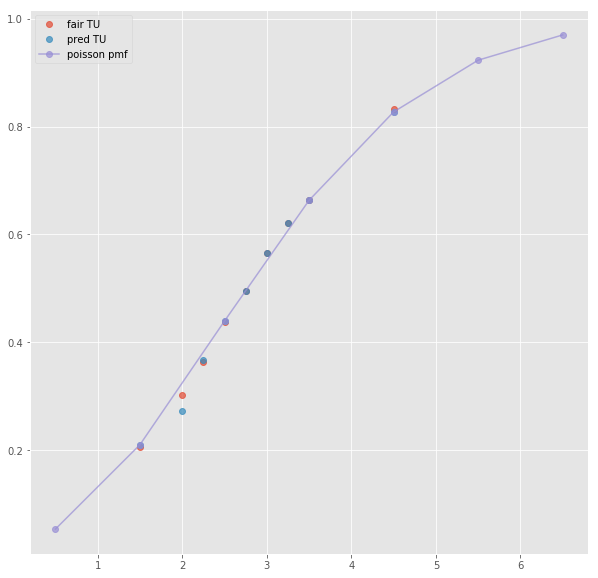

ML : 1.341 5.23 8.88
Error home:  0.009095482529450027
Error draw:  0.005437558670337295
Error away:  0.003658048616830986

(64, 124)
(1, 27)
2.5 1.69 2.12 -1.5 1.98 1.84
TO fair:  1.7971698113207548 TU fair:  2.2544378698224854
TO pred:  1.79718 TU fair:  2.25443
Error TO:  0.004707541160161477

Error TO:  0.005606560234758751

Error TO:  3.1545484250328215e-06

Error TO:  0.04194156473110411



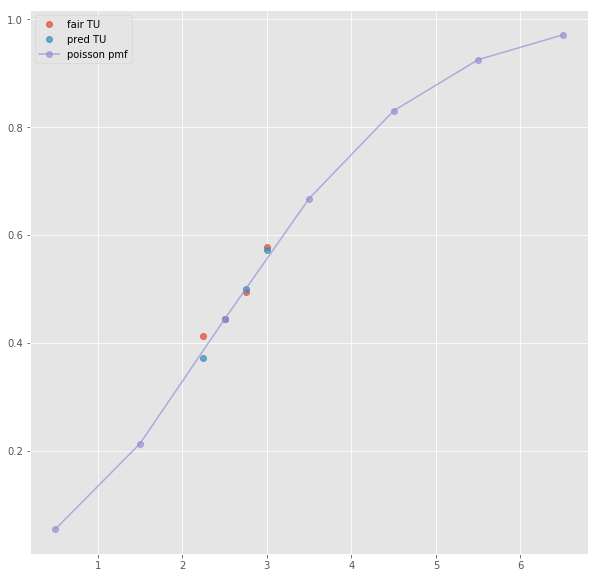

ML : 1.29 5.36 8.96
Error home:  2.8613116088038737e-05
Error draw:  0.0024616648250684325
Error away:  0.0024902182799969863

(148, 124)
(1, 27)
2.5 1.7 2.21 -1.5 2.02 1.88
TO fair:  1.7692307692307694 TU fair:  2.3000000000000003
TO pred:  1.7692 TU fair:  2.30004
Error TO:  0.0024820002135279573

Error TO:  0.020981681398554775

Error TO:  9.83003863208598e-06

Error TO:  0.03990347101851455



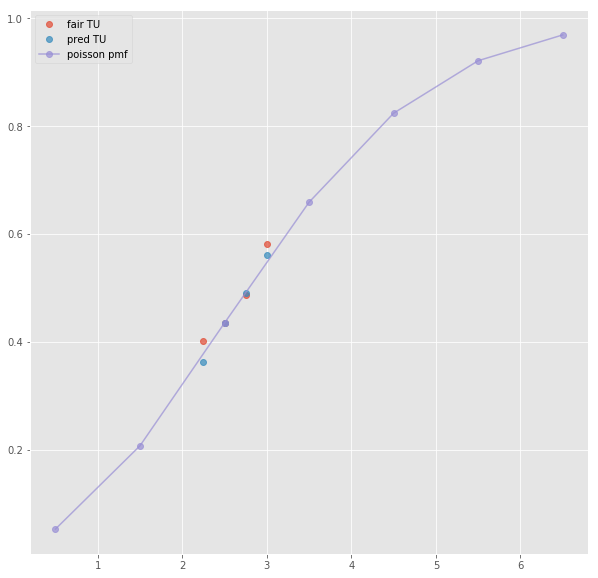

ML : 1.34 5.4 8.6
Error home:  0.008663814747093546
Error draw:  0.0011425820557008637
Error away:  0.007521153709089554

(139, 124)
(1, 24)
2.5 1.68 2.25 -1.5 2.05 1.85
TO fair:  1.7466666666666664 TU fair:  2.339285714285714
TO pred:  1.74663 TU fair:  2.33935
Error TO:  0.0005664050888134486

Error TO:  1.2018782691303187e-05

Error TO:  0.010233032731932767



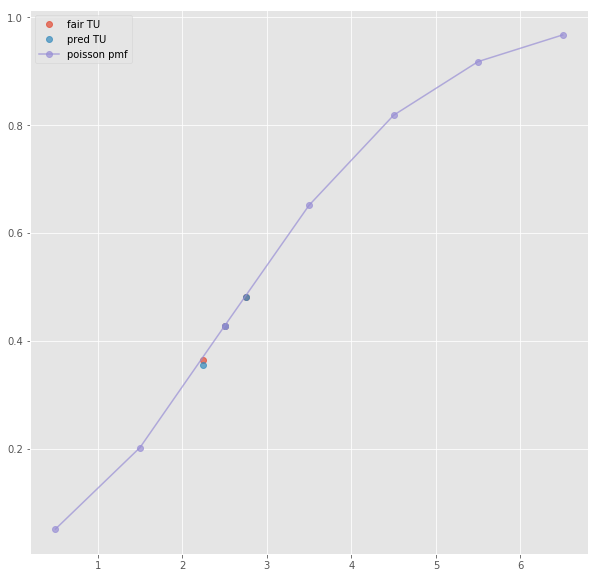

ML : 1.34 5.3 9.1
Error home:  0.0016932568247385316
Error draw:  0.002716294913971462
Error away:  0.004409453825846024

(36, 124)
(1, 47)
3.5 2.84 1.442 -1.5 2.02 1.862
TO fair:  2.969486823855756 TU fair:  1.5077464788732395
TO pred:  2.9695 TU fair:  1.50774
Error TO:  0.00033938416194778664

Error TO:  0.02999248537506405

Error TO:  3.304340843168774e-05

Error TO:  1.4942511831206318e-06

Error TO:  0.005107965778718443

Error TO:  0.0010783757021809448

Error TO:  0.004821569291982741

Error TO:  0.0037039839412962294

Error TO:  0.0003624387102797999



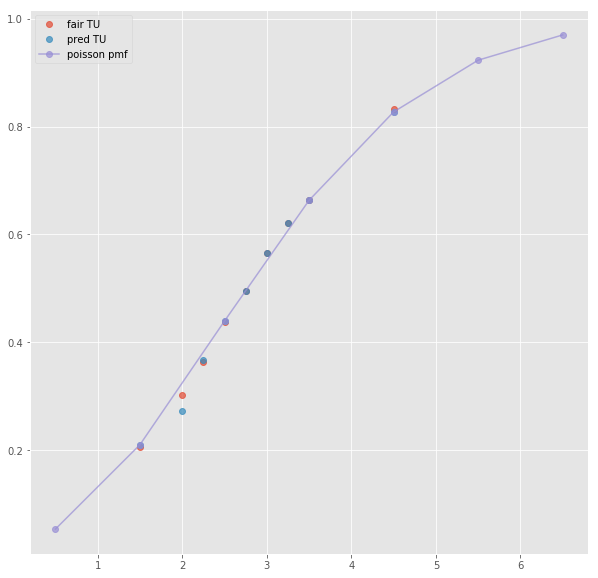

Error T1O:  0.006788887344929995
ML : 1.341 5.23 8.88
Error home:  0.009095482529450027
Error draw:  0.005437558670337295
Error away:  0.003658048616830986

(16, 124)
(1, 64)
2.5 1.875 1.975 -1.5 2.3 1.6
TO fair:  1.9493670886075947 TU fair:  2.0533333333333332
TO pred:  1.9494 TU fair:  2.0533
Error TO:  0.001499626135286647

Error TO:  0.019168576928501935

Error TO:  0.011342010463709917

Error TO:  0.011490317406564032

Error TO:  0.016750878787660434

Error TO:  8.660673480709313e-06

Error TO:  0.02045527004861314

Error TO:  0.0033544182299802827

Error TO:  0.013159087969153549

Error TO:  0.008941098275500825

Error TO:  0.014772012481225172

Error TO:  0.012808500691032176

Error TO:  0.013364521312267313

Error TO:  0.019881701521094808



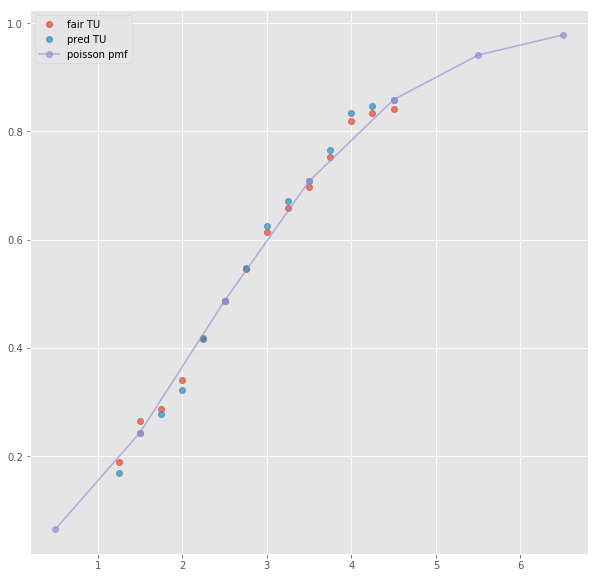

ML : 1.4 4.6 8.0
Error home:  0.013656100107944158
Error draw:  0.0008894431576814688
Error away:  0.014545565212220779

(24, 124)
next positional indexers are out-of-bounds
(36, 124)
(1, 45)
3.5 2.83 1.4580000000000002 -0.5 2.17 1.751
TO fair:  2.9410150891632374 TU fair:  1.5151943462897528
TO pred:  2.941 TU fair:  1.5152
Error TO:  0.009211951782569283

Error TO:  0.03136485659179866

Error TO:  0.006176478433711219

Error TO:  1.7445076555544503e-06

Error TO:  0.00763161624467576

Error TO:  0.010744088843735566

Error TO:  0.0013519708446333434

Error TO:  0.008341070102557024

Error TO:  0.0025594234883307143



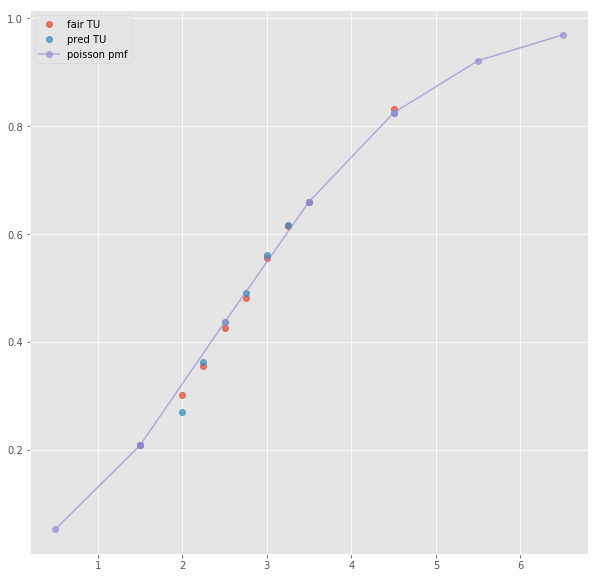

ML : 2.17 3.69 3.3
Error home:  0.001277040740120916
Error draw:  0.019356021697620823
Error away:  0.01807900280243785

(45, 124)
(1, 23)
2.5 1.68 2.16 -0.5 2.12 1.73
TO fair:  1.7777777777777777 TU fair:  2.2857142857142856
TO pred:  1.77776 TU fair:  2.28575
Error TO:  0.018821338730970805

Error TO:  0.0011998254799301389

Error TO:  5.625056250568861e-06



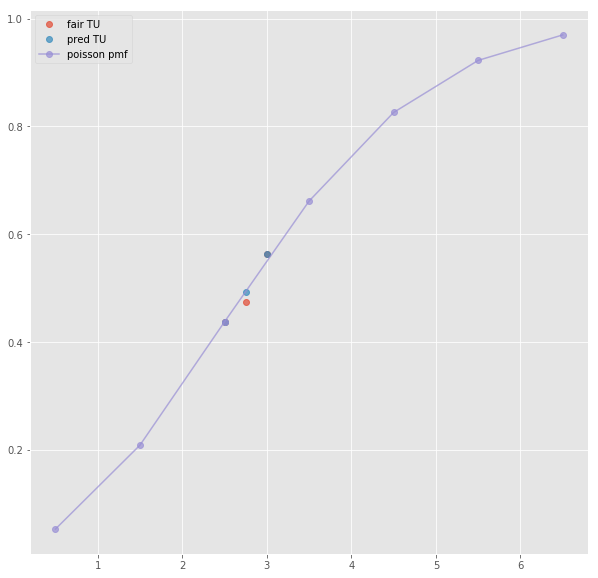

ML : 2.12 3.46 3.31
Error home:  0.005519975053397519
Error draw:  0.029381133393848152
Error away:  0.02386109647334167

(60, 124)
(1, 23)
2.5 1.76 2.16 -0.5 2.2 1.75
TO fair:  1.8148148148148149 TU fair:  2.2272727272727275
TO pred:  1.8148 TU fair:  2.2273
Error TO:  0.01573080866601595

Error TO:  0.02099045884429468

Error TO:  4.49816250069901e-06



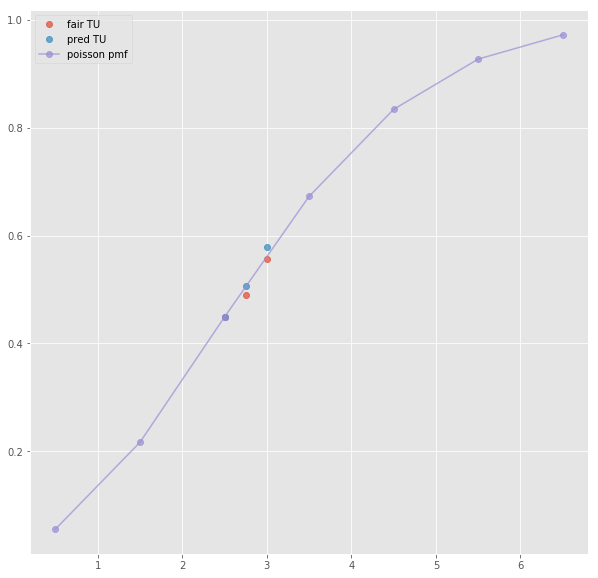

ML : 2.18 3.6 3.2
Error home:  0.005731609588755626
Error draw:  0.019393914527041145
Error away:  0.013662599339355985

(130, 124)
(1, 23)
2.5 1.69 2.26 -0.5 2.2 1.75
TO fair:  1.7477876106194692 TU fair:  2.337278106508876
TO pred:  1.74778 TU fair:  2.3373
Error TO:  0.0002370101799579194

Error TO:  0.004049723155056806

Error TO:  2.4914064584713458e-06



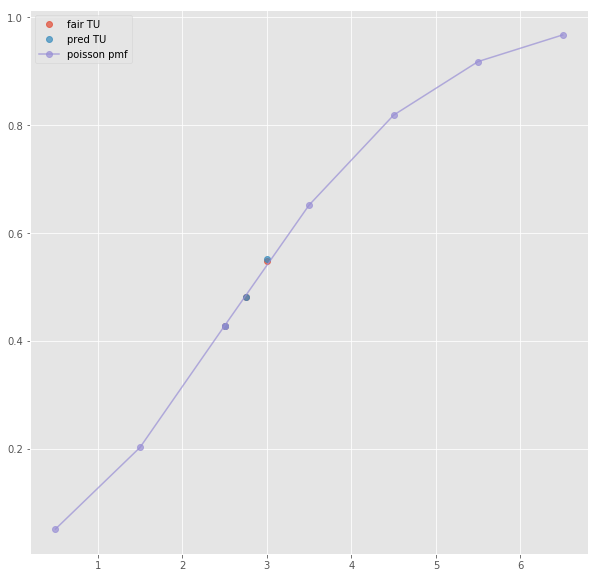

ML : 2.19 3.6 3.15
Error home:  0.00893393405769749
Error draw:  0.022882281157017237
Error away:  0.01394844767910397

(35, 124)
(1, 47)
3.5 2.83 1.4580000000000002 -0.5 2.17 1.751
TO fair:  2.9410150891632374 TU fair:  1.5151943462897528
TO pred:  2.941 TU fair:  1.5152
Error TO:  0.009211951782569283

Error TO:  0.03136485659179866

Error TO:  0.006176478433711219

Error TO:  1.7445076555544503e-06

Error TO:  0.00763161624467576

Error TO:  0.010744088843735566

Error TO:  0.0013519708446333434

Error TO:  0.008341070102557024

Error TO:  0.0025594234883307143



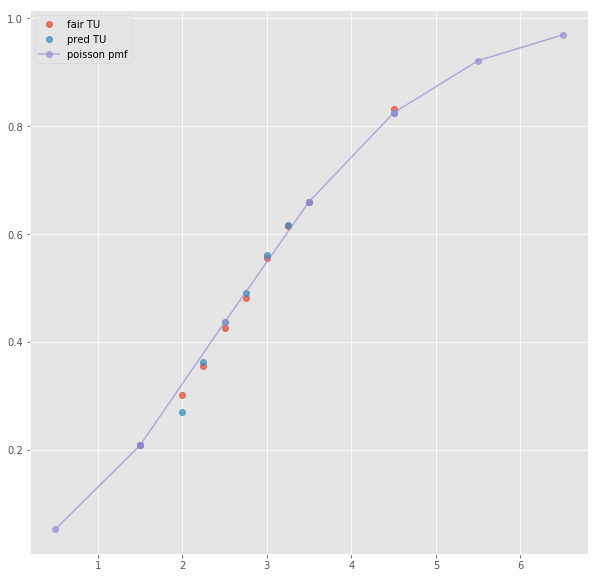

Error T1O:  0.011311700047278939
ML : 2.17 3.69 3.3
Error home:  0.001277040740120916
Error draw:  0.019356021697620823
Error away:  0.01807900280243785

(33, 124)
(1, 66)
3.5 2.85 1.4 -0.5 2.35 1.575
TO fair:  3.0357142857142856 TU fair:  1.4912280701754383
TO pred:  3.03568 TU fair:  1.49124
Error TO:  0.029670661093712303

Error TO:  0.03409338167698739

Error TO:  0.023026655208570168

Error TO:  3.7204572441718042e-06

Error TO:  0.005405694091826729

Error TO:  0.020147548771052848

Error TO:  0.03224468593099716

Error TO:  0.026774285670574605

Error TO:  0.008922298921189675

Error TO:  0.030199700180966405

Error TO:  0.0025133095277964645

Error TO:  0.0013142695805644367

Error TO:  0.0061063255624799195

Error TO:  0.025898092781382887

Error TO:  0.00922003042385472



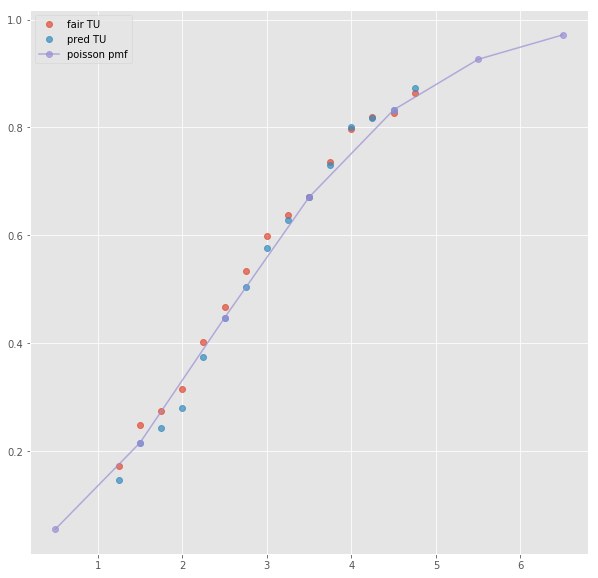

ML : 2.375 3.6 2.75
Error home:  0.004969173830949192
Error draw:  0.013910303266236018
Error away:  0.00894089124123415

(3, 124)
(1, 33)
2.5 1.7 2.21 -0.5 2.34 1.63
TO fair:  1.7692307692307694 TU fair:  2.3000000000000003
TO pred:  1.7692 TU fair:  2.30004
Error TO:  0.003881116561097908

Error TO:  0.010108058008750198

Error TO:  9.83003863208598e-06

Error TO:  0.001748842454005084

Error TO:  0.013694627212511468



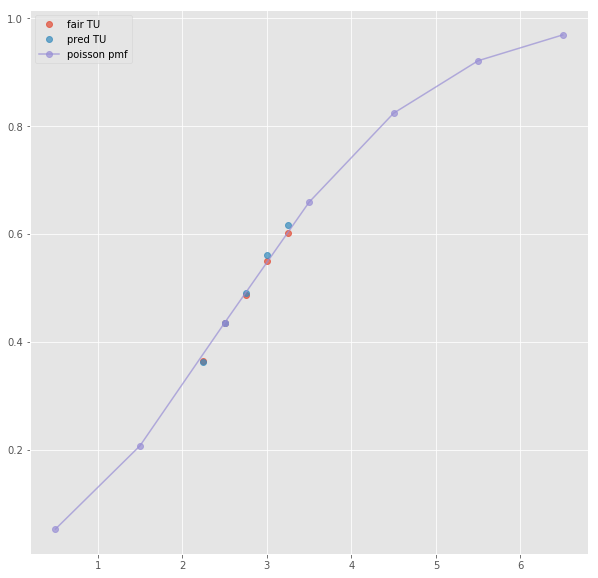

Error T1O:  0.01180532135038842
ML : 2.37 3.56 2.97
Error home:  0.004674430237962046
Error draw:  0.025551272551793347
Error away:  0.02087698041593472

(27, 124)
(1, 41)
3.5 2.22 1.709 1.5 1.9 1.99
TO fair:  2.299005266237566 TU fair:  1.7698198198198196
TO pred:  2.29904 TU fair:  1.7698
Error TO:  0.00644663720114691

Error TO:  0.004207006494052701

Error TO:  6.571512465136653e-06

Error TO:  0.0008012640842146312

Error TO:  0.006963549227669064

Error TO:  0.012194639794298023

Error TO:  0.002234148480351583

Error TO:  0.0009189376275474115



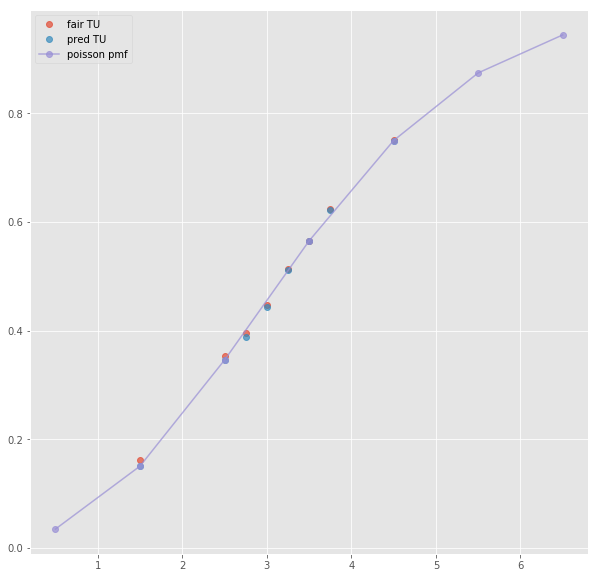

ML : 8.72 5.38 1.349
Error home:  0.0113519147820587
Error draw:  0.010560535042436592
Error away:  0.0007912465205146546

(29, 124)
(1, 23)
3.5 2.23 1.63 1.5 1.88 1.96
TO fair:  2.3680981595092025 TU fair:  1.7309417040358743
TO pred:  2.36809 TU fair:  1.73095
Error TO:  0.004839421612375161

Error TO:  0.0026528510673715644

Error TO:  1.4550105168487093e-06

Error TO:  0.00702414267609025



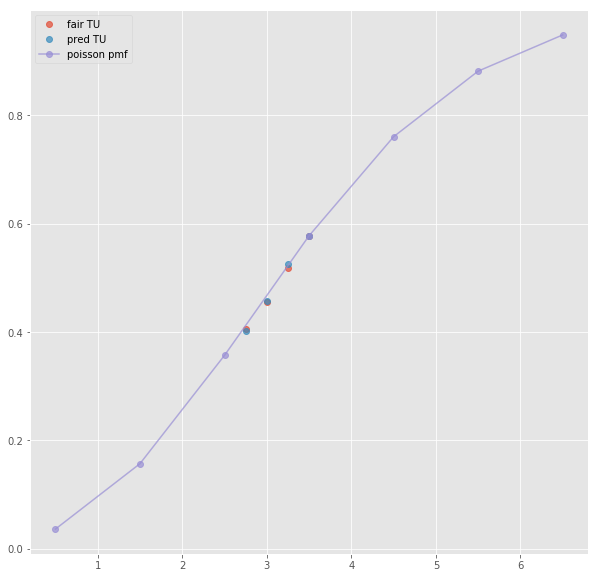

ML : 8.21 5.56 1.3
Error home:  0.004261480786317634
Error draw:  0.00023716197431483677
Error away:  0.004498541311214632

(74, 124)
(1, 18)
next list index out of range
(123, 124)
(1, 18)
next list index out of range
(24, 124)
(1, 43)
3.5 2.22 1.704 1.5 1.9 2.0
TO fair:  2.302816901408451 TU fair:  1.7675675675675677
TO pred:  2.30278 TU fair:  1.76759
Error TO:  0.0063215213070967335

Error TO:  0.005209166433495671

Error TO:  6.9587476146382166e-06

Error TO:  0.000837067737510605

Error TO:  0.007629371758321679

Error TO:  0.01240027185446213

Error TO:  0.002714142551936971

Error TO:  0.0006340381632177206



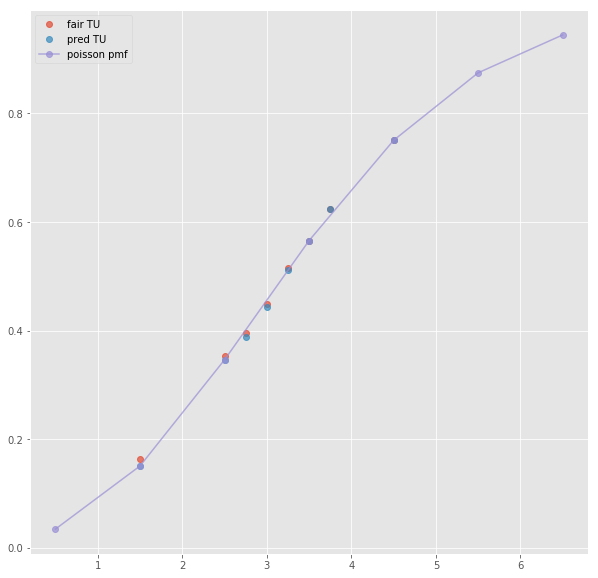

Error T1O:  0.012128739637038866
ML : 8.7 5.36 1.35
Error home:  0.011719824365080012
Error draw:  0.010710090434098707
Error away:  0.0010097558181976218

(76, 124)
(1, 73)
3.5 2.2 1.65 1.5 1.925 1.925
TO fair:  2.3333333333333335 TU fair:  1.7499999999999998
TO pred:  2.33331 TU fair:  1.75001
Error TO:  0.015444078952473017

Error TO:  0.02267354643206476

Error TO:  0.01001913391834075

Error TO:  4.285757143285274e-06

Error TO:  0.009223429278914785

Error TO:  0.023626209687881095

Error TO:  0.019185123461283315

Error TO:  0.023121464881868392

Error TO:  0.021034712439633785

Error TO:  0.01902094172077562

Error TO:  0.003446967166968795

Error TO:  0.004105373543334345

Error TO:  0.0042410192905897315

Error TO:  0.035269085432338754

Error TO:  0.013719851988902881

Error TO:  0.018777270226819326

Error TO:  0.018351880308185714



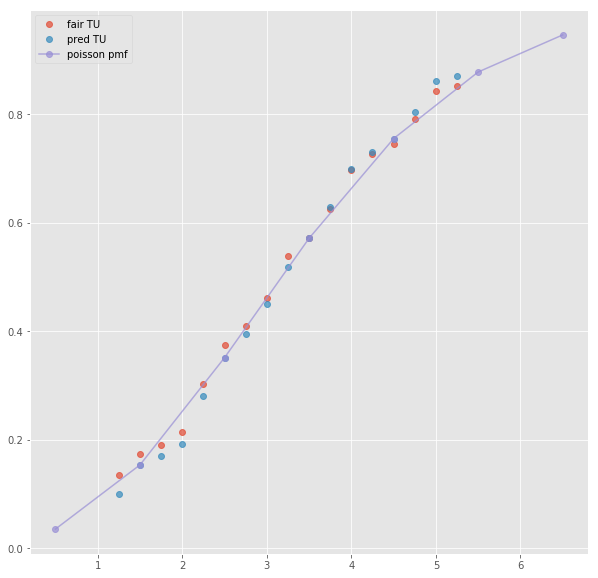

ML : 10.0 4.75 1.33
Error home:  0.019282542511755943
Error draw:  0.033767373927012734
Error away:  0.014484867856860761

(15, 124)
(1, 33)
3.5 2.19 1.71 1.5 1.91 1.94
TO fair:  2.280701754385965 TU fair:  1.780821917808219
TO pred:  2.28069 TU fair:  1.78083
Error TO:  0.009872545128465693

Error TO:  0.006133585892752369

Error TO:  2.259774960156058e-06

Error TO:  0.024598986937436673

Error TO:  0.0027922310521573124

Error TO:  0.0021802982281659



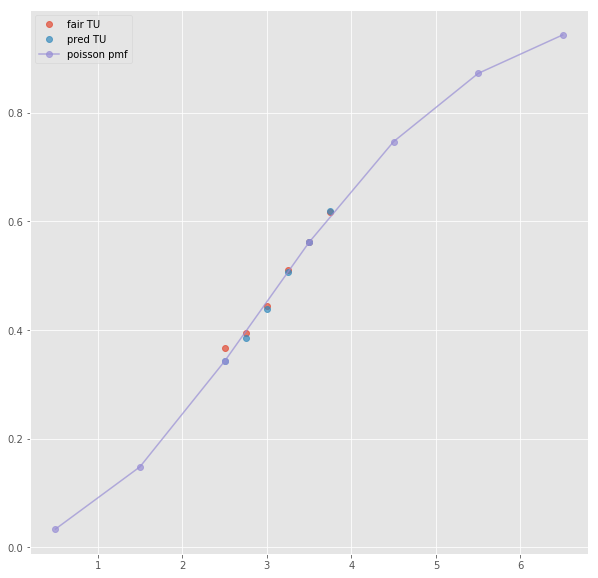

Error T1O:  0.0070174169231626005
ML : 8.1 5.43 1.37
Error home:  0.0012744574455031549
Error draw:  0.012346354137270754
Error away:  0.013620753363639437

(34, 124)
(1, 42)
3.5 2.77 1.473 -0.5 1.671 2.31
TO fair:  2.8805159538357095 TU fair:  1.5317689530685923
TO pred:  2.88055 TU fair:  1.53176
Error TO:  0.0034035209966085667

Error TO:  0.002364463143008144

Error TO:  4.103198124660867e-06

Error TO:  0.0020496824209562114

Error TO:  0.0035995445971184203

Error TO:  0.001759846648013652

Error TO:  0.00306500826106737

Error TO:  0.0011235632552457075



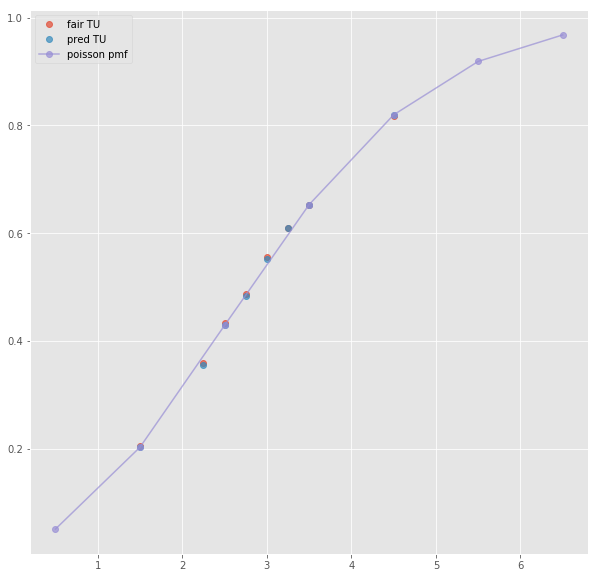

ML : 1.671 4.0 5.19
Error home:  0.005448392107895272
Error draw:  0.021068883122653148
Error away:  0.015620543026412803

(184, 124)
(1, 26)
2.5 1.62 2.25 -0.5 1.64 2.25
TO fair:  1.7199999999999998 TU fair:  2.3888888888888884
TO pred:  1.72002 TU fair:  2.38885
Error TO:  0.002405122441024643

Error TO:  0.005037114137495247

Error TO:  6.760332424526894e-06

Error TO:  0.0034650360690460236



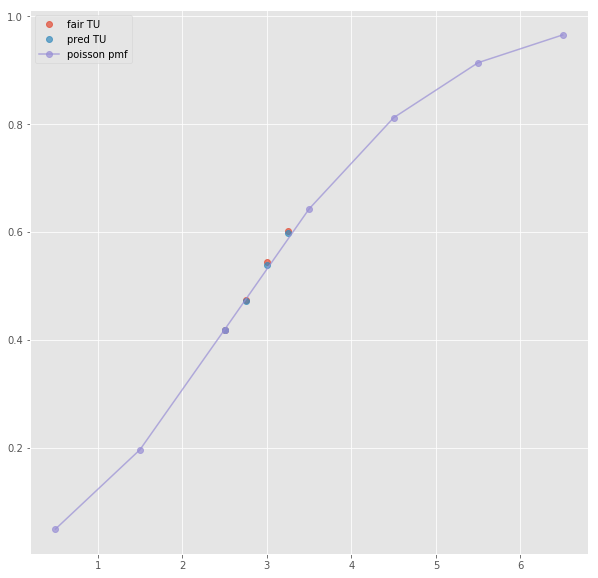

ML : 1.63 3.76 5.36
Error home:  0.002901013215907966
Error draw:  0.03171359019505546
Error away:  0.028812415030519845

(61, 124)
(1, 21)
next list index out of range
(70, 124)
(1, 23)
2.5 1.68 2.28 -0.5 1.7 2.28
TO fair:  1.736842105263158 TU fair:  2.357142857142857
TO pred:  1.73684 TU fair:  2.35715
Error TO:  0.00429085423262443

Error TO:  0.006839491303728462

Error TO:  6.978888166253583e-07



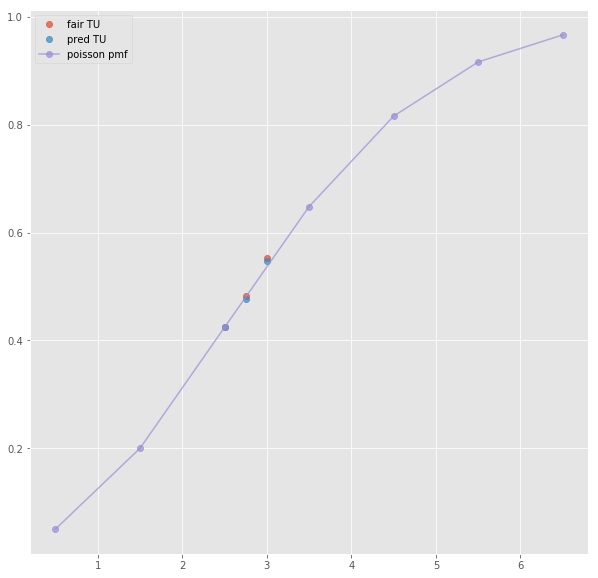

ML : 1.69 3.85 5.0
Error home:  0.010093979075393889
Error draw:  0.027015784619074418
Error away:  0.016921726589501584

(31, 124)
(1, 44)
3.5 2.77 1.473 -0.5 1.671 2.31
TO fair:  2.8805159538357095 TU fair:  1.5317689530685923
TO pred:  2.88055 TU fair:  1.53176
Error TO:  0.0034035209966085667

Error TO:  0.002364463143008144

Error TO:  4.103198124660867e-06

Error TO:  0.0020496824209562114

Error TO:  0.0035995445971184203

Error TO:  0.001759846648013652

Error TO:  0.00306500826106737

Error TO:  0.0011235632552457075



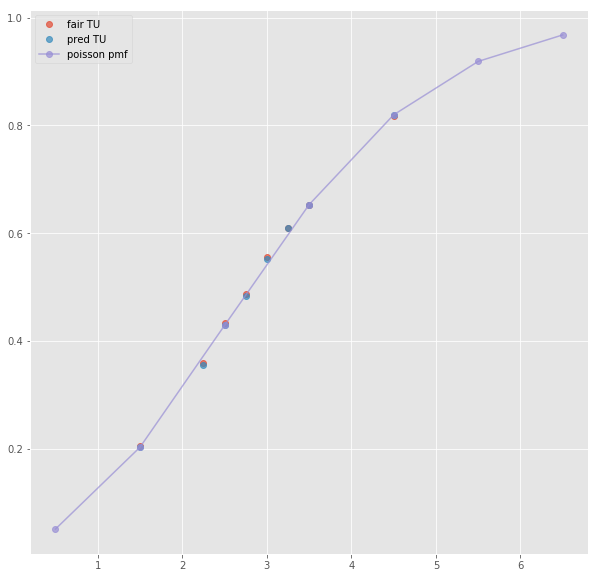

Error T1O:  0.0034503681266402353
ML : 1.671 4.0 5.19
Error home:  0.005448392107895272
Error draw:  0.021068883122653148
Error away:  0.015620543026412803

(71, 124)
(1, 68)
3.5 2.6 1.475 -0.5 1.65 2.2
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.0008228731704371661

Error TO:  0.025807077317834826

Error TO:  0.012479244015746571

Error TO:  6.306488034957258e-06

Error TO:  0.010726207947077154

Error TO:  0.014507784164484061

Error TO:  0.02850582482961528

Error TO:  0.02067264661700574

Error TO:  0.006330379820712273

Error TO:  0.03043844406988616

Error TO:  0.004170206983200114

Error TO:  0.004772560002322596

Error TO:  0.0007934326163293037

Error TO:  0.02801228972349956

Error TO:  0.010362726084071044



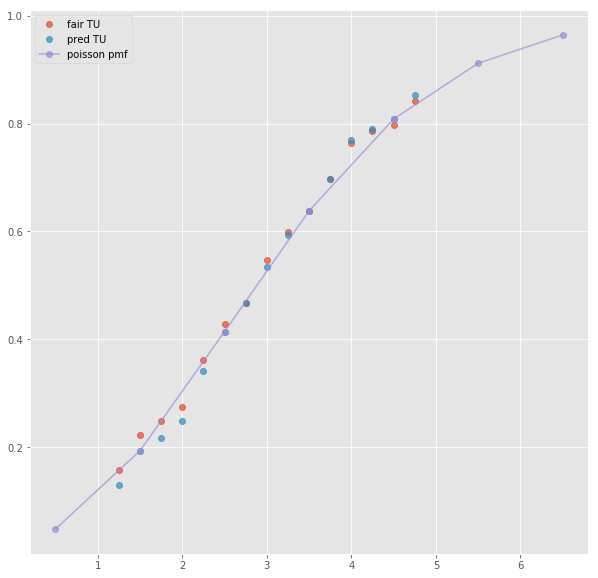

ML : 1.615 4.2 4.75
Error home:  0.008425321096627969
Error draw:  0.004366956762424157
Error away:  0.01279231015041321

(8, 124)
(1, 36)
3.5 2.59 1.53 -0.5 1.69 2.23
TO fair:  2.6928104575163396 TU fair:  1.5907335907335909
TO pred:  2.69286 TU fair:  1.59072
Error TO:  0.02081574831360722

Error TO:  0.01846793042977196

Error TO:  6.832162924408358e-06

Error TO:  0.022623363375306238

Error TO:  0.023468501590781732

Error TO:  0.012125574731127686



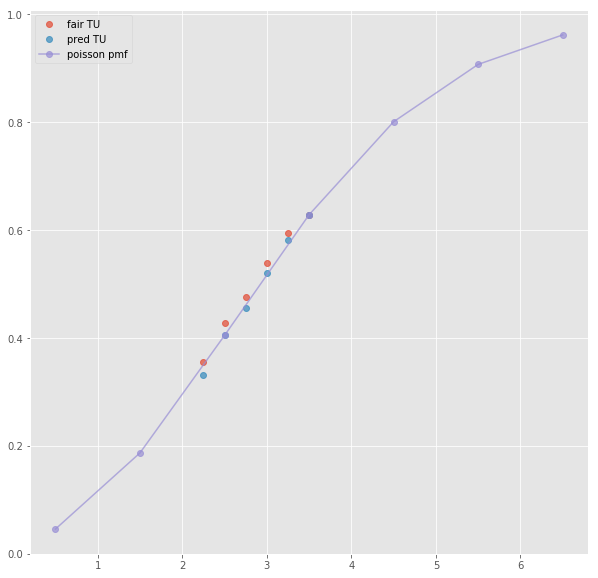

Error T1O:  0.007373550004257989
ML : 1.7 4.05 4.9
Error home:  0.0028600345423462903
Error draw:  0.019965789099542663
Error away:  0.017105987471616596

(21, 124)
(1, 50)
2.5 2.06 1.746 0.5 1.671 2.19
TO fair:  2.1798396334478807 TU fair:  1.8475728155339806
TO pred:  2.17989 TU fair:  1.84754
Error TO:  0.007864272198459865

Error TO:  0.004188534781207287

Error TO:  0.030924495876701485

Error TO:  0.02389151659799707

Error TO:  0.04108412979306568

Error TO:  1.0599444330239294e-05

Error TO:  0.0020279430337373228

Error TO:  0.001209437722999085

Error TO:  0.06552704983253388

Error TO:  0.0029992892042419728



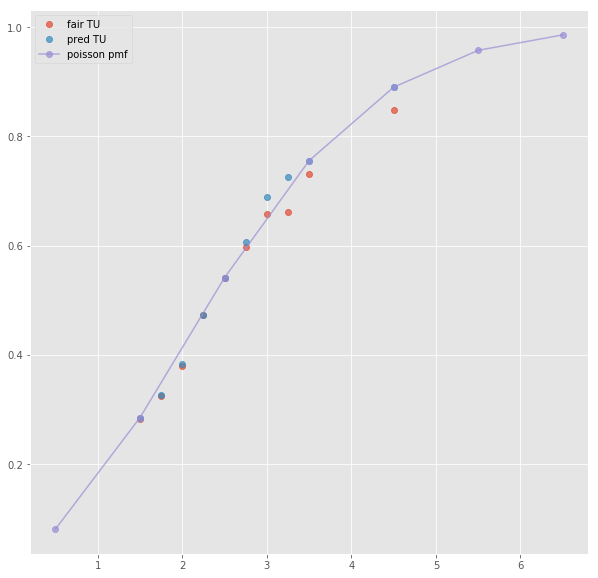

ML : 3.27 3.25 2.19
Error home:  0.015185369594688913
Error draw:  0.02127763765468671
Error away:  0.006092497709746736

(17, 124)
(1, 19)
2.5 1.96 1.78 0.5 1.67 2.09
TO fair:  2.101123595505618 TU fair:  1.9081632653061225
TO pred:  2.1011 TU fair:  1.90819
Error TO:  0.025106691125447445

Error TO:  5.344793928885316e-06



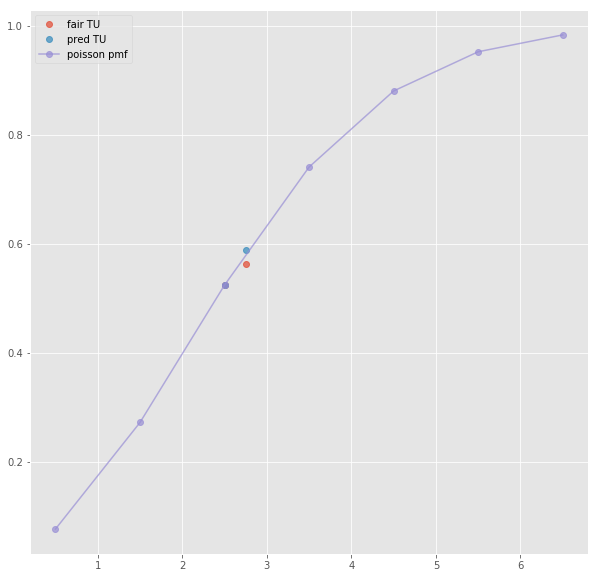

ML : 3.01 3.06 2.09
Error home:  0.0025749323504782873
Error draw:  0.026080414990825362
Error away:  0.023505570587454228

(19, 124)
(1, 15)
next list index out of range
(5, 124)
(1, 52)
2.5 2.04 1.757 0.5 1.704 2.14
TO fair:  2.1610700056915197 TU fair:  1.8612745098039216
TO pred:  2.16107 TU fair:  1.86127
Error TO:  0.006164775060164662

Error TO:  0.0012314939643764955

Error TO:  0.020138108061522608

Error TO:  0.021412812037468976

Error TO:  0.038974458245431554

Error TO:  1.2186824882576275e-09

Error TO:  0.00037377135196081657

Error TO:  0.00020519568055288318

Error TO:  0.08269631724078402

Error TO:  0.00043683427355267757



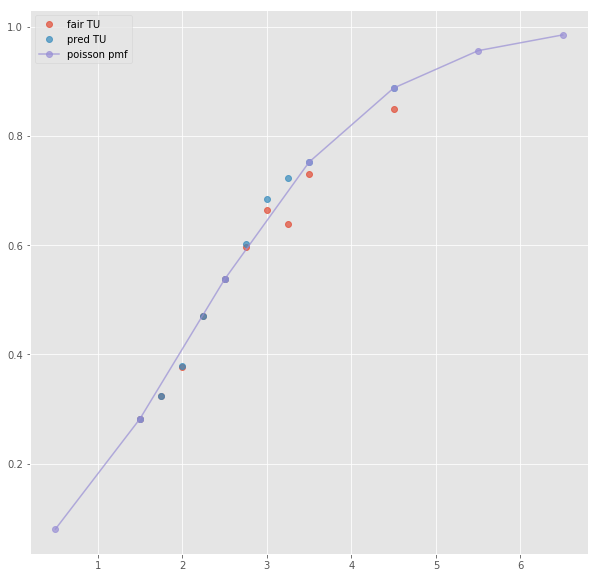

Error T1O:  0.011355930339939257
ML : 3.3 3.34 2.14
Error home:  0.009120528844944964
Error draw:  0.015591368143313189
Error away:  0.006470498873230368

(14, 124)
(1, 19)
2.5 2.025 1.825 0.5 2.0 1.85
TO fair:  2.1095890410958904 TU fair:  1.9012345679012344
TO pred:  2.10962 TU fair:  1.90121
Error TO:  0.04145240742379919

Error TO:  6.956382986200715e-06



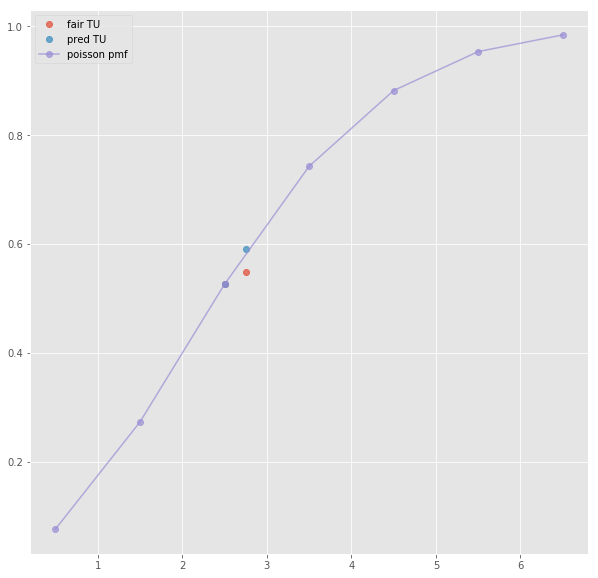

ML : 4.0 3.75 1.73
Error home:  0.0017227928284629934
Error draw:  0.006826200885260536
Error away:  0.008549050175381434

(18, 124)
(1, 38)
2.5 2.05 1.81 0.5 1.75 2.13
TO fair:  2.132596685082873 TU fair:  1.882926829268293
TO pred:  2.13255 TU fair:  1.88296
Error TO:  0.002340720193439949

Error TO:  0.004082065607604046

Error TO:  0.00900312924341301

Error TO:  1.0265265391107281e-05

Error TO:  0.0022135903606271823



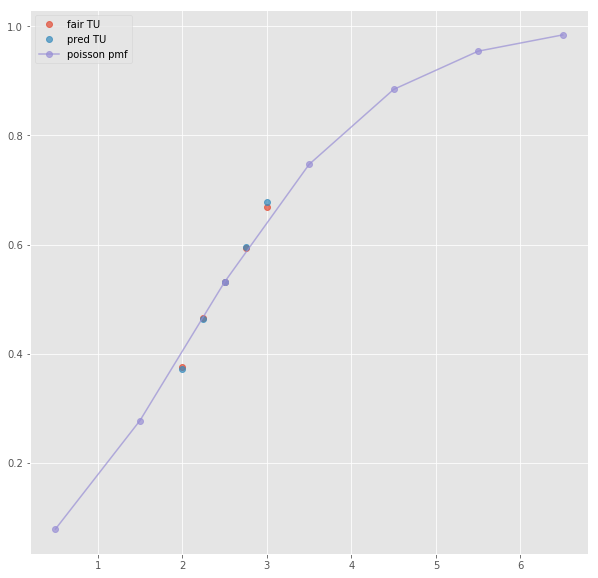

Error T1O:  0.0021898344468110342
Error T1O:  0.04194971380167345
ML : 3.53 3.43 2.15
Error home:  0.014504418156734533
Error draw:  0.01829840120635229
Error away:  0.0037939838857024566

(31, 124)
(1, 43)
2.5 2.04 1.84 0.5 1.709 2.24
TO fair:  2.108695652173913 TU fair:  1.9019607843137256
TO pred:  2.10875 TU fair:  1.90192
Error TO:  0.0018354106798308956

Error TO:  0.0033074971640111306

Error TO:  0.005376599258102965

Error TO:  0.008301534175913672

Error TO:  0.006378353305753343

Error TO:  1.2222025311814377e-05

Error TO:  0.0031828409439315086

Error TO:  0.0003118356146381007



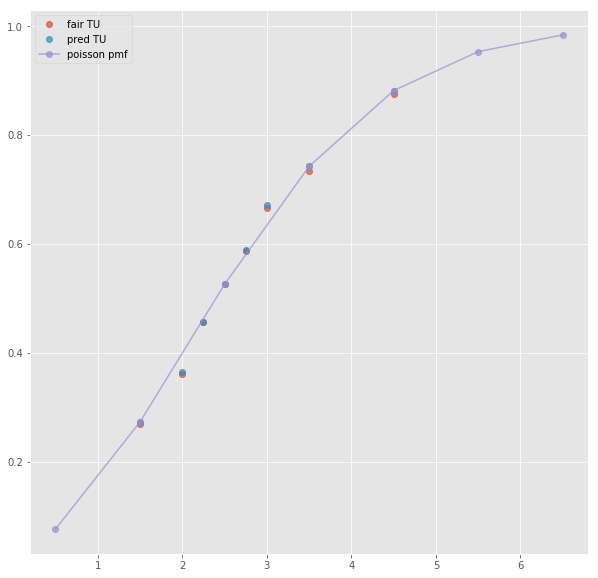

ML : 3.49 3.26 2.24
Error home:  0.028933159998054236
Error draw:  0.03234144810892997
Error away:  0.003408170673846078

(40, 124)
(1, 21)
2.5 2.03 1.79 0.5 1.66 2.21
TO fair:  2.134078212290502 TU fair:  1.8817733990147782
TO pred:  2.13413 TU fair:  1.88173
Error TO:  1.1370917285757898e-05

Error TO:  0.014191280744462964



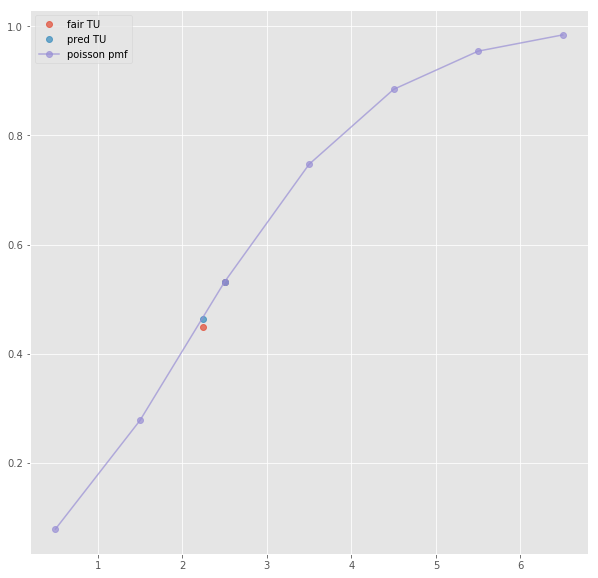

ML : 3.11 3.06 2.23
Error home:  0.013571053581374115
Error draw:  0.03364849276588738
Error away:  0.020077363606927467

(96, 124)
(1, 21)
2.5 2.08 1.82 0.5 1.71 2.26
TO fair:  2.142857142857143 TU fair:  1.8749999999999998
TO pred:  2.14287 TU fair:  1.87499
Error TO:  2.799983200074685e-06

Error TO:  0.007540200122561402



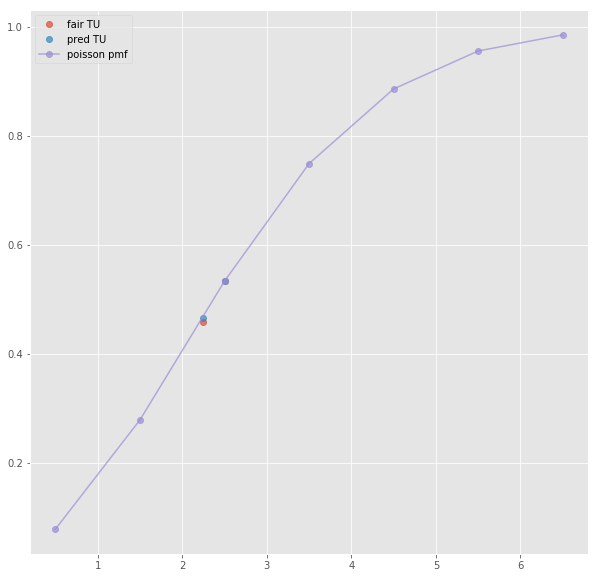

ML : 3.55 3.2 2.2
Error home:  0.036085062927961875
Error draw:  0.03337580608707219
Error away:  0.0027090535754155654

(137, 124)
(1, 23)
2.5 2.05 1.85 0.5 1.72 2.25
TO fair:  2.108108108108108 TU fair:  1.902439024390244
TO pred:  2.10809 TU fair:  1.90246
Error TO:  0.0004966292580379505

Error TO:  4.074656959507372e-06

Error TO:  0.0007623684385020812



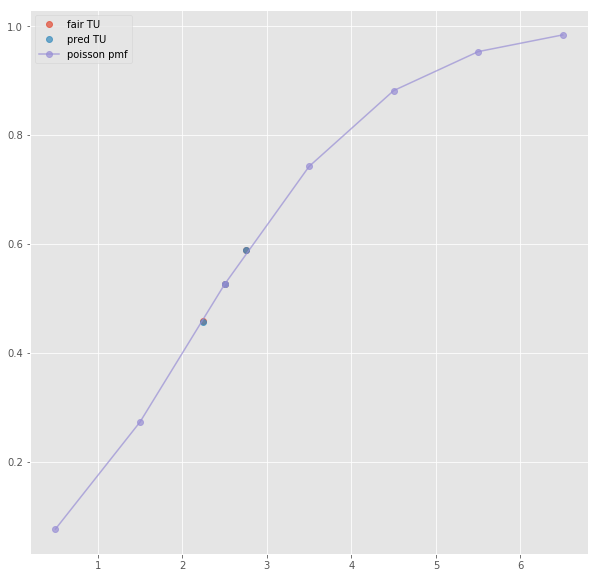

ML : 3.25 3.1 2.23
Error home:  0.01887780659547178
Error draw:  0.03642802368847531
Error away:  0.01754993483746481

(29, 124)
(1, 45)
2.5 2.04 1.84 0.5 1.709 2.24
TO fair:  2.108695652173913 TU fair:  1.9019607843137256
TO pred:  2.10875 TU fair:  1.90192
Error TO:  0.0018354106798308956

Error TO:  0.0033074971640111306

Error TO:  0.005376599258102965

Error TO:  0.008301534175913672

Error TO:  0.006378353305753343

Error TO:  1.2222025311814377e-05

Error TO:  0.0031828409439315086

Error TO:  0.0003118356146381007



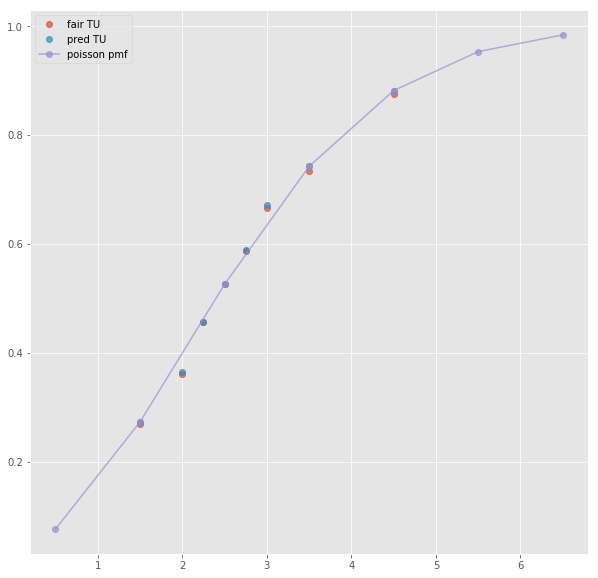

Error T1O:  0.00021520028804000724
ML : 3.49 3.26 2.24
Error home:  0.028933159998054236
Error draw:  0.03234144810892997
Error away:  0.003408170673846078

(12, 124)
(1, 33)
2.5 2.03 1.82 0.5 1.7 2.22
TO fair:  2.1153846153846154 TU fair:  1.8965517241379313
TO pred:  2.11535 TU fair:  1.89658
Error TO:  0.005360806693431475

Error TO:  0.0009140834638761142

Error TO:  0.013151527552126951

Error TO:  7.735663773711376e-06

Error TO:  0.001155862681745834



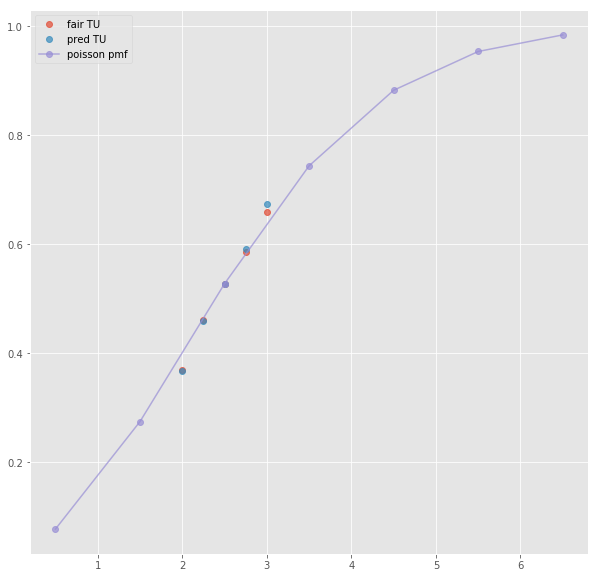

Error T1O:  0.0006063382651358418
ML : 3.42 3.31 2.24
Error home:  0.02246749463656389
Error draw:  0.02728416085350238
Error away:  0.004816895500515395

(9, 124)
(1, 41)
2.5 2.17 1.751 -0.5 2.0 1.925
TO fair:  2.2392918332381497 TU fair:  1.8069124423963134
TO pred:  2.23935 TU fair:  1.80687
Error TO:  0.000791210173035406

Error TO:  0.0042746797988242324

Error TO:  0.003385498833860051

Error TO:  1.159957864993455e-05

Error TO:  0.006202737394895408

Error TO:  1.3148906767068702e-05

Error TO:  0.005542809011787608



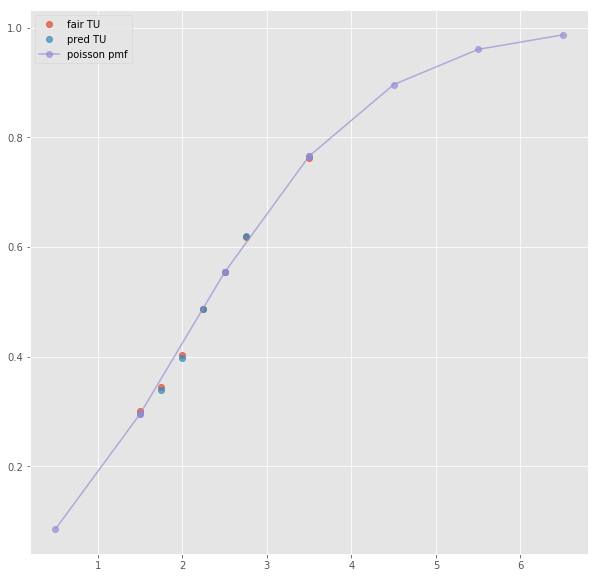

ML : 2.0 3.44 4.23
Error home:  0.0036598723155651935
Error draw:  0.021435340847951845
Error away:  0.01777523401844397

(28, 124)
(1, 23)
2.5 2.14 1.69 -0.5 1.92 1.92
TO fair:  2.2662721893491127 TU fair:  1.7897196261682242
TO pred:  2.2663 TU fair:  1.7897
Error TO:  0.008137617389797236

Error TO:  5.414790835212013e-06

Error TO:  0.0008568507179177454



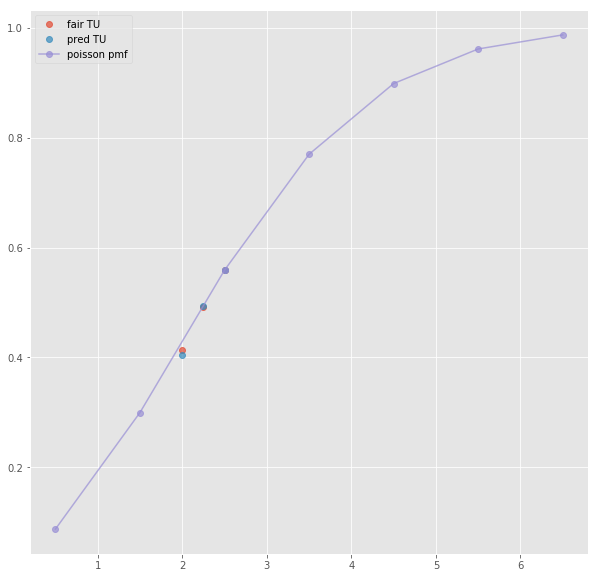

ML : 1.91 3.26 3.71
Error home:  0.023956457472180892
Error draw:  0.017749004327728968
Error away:  0.006207145227559413

(31, 124)
(1, 19)
2.5 2.17 1.75 -0.5 1.99 1.93
TO fair:  2.2399999999999998 TU fair:  1.8064516129032258
TO pred:  2.23999 TU fair:  1.80646
Error TO:  1.992993591104497e-06

Error TO:  0.004978347552056839



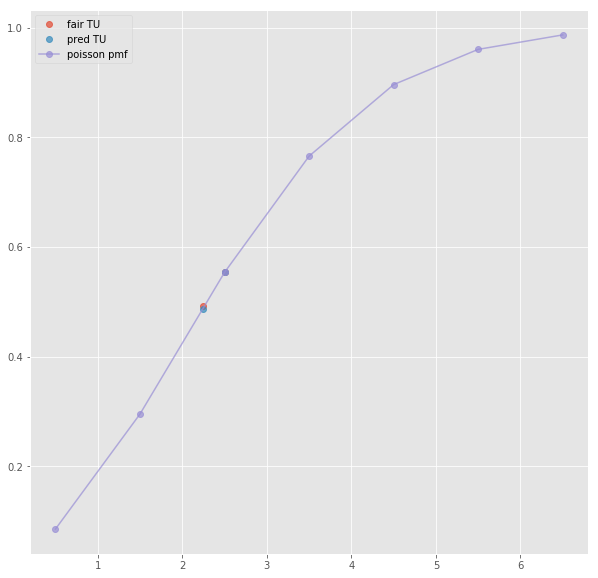

ML : 1.97 3.4 4.1
Error home:  0.006890761526905709
Error draw:  0.01997686582136121
Error away:  0.013085765299909874

(77, 124)
(1, 23)
2.5 2.2 1.73 -0.5 2.0 1.92
TO fair:  2.2716763005780347 TU fair:  1.7863636363636364
TO pred:  2.27165 TU fair:  1.78638
Error TO:  0.009089047052102006

Error TO:  5.096563353679251e-06

Error TO:  0.004398576541997379



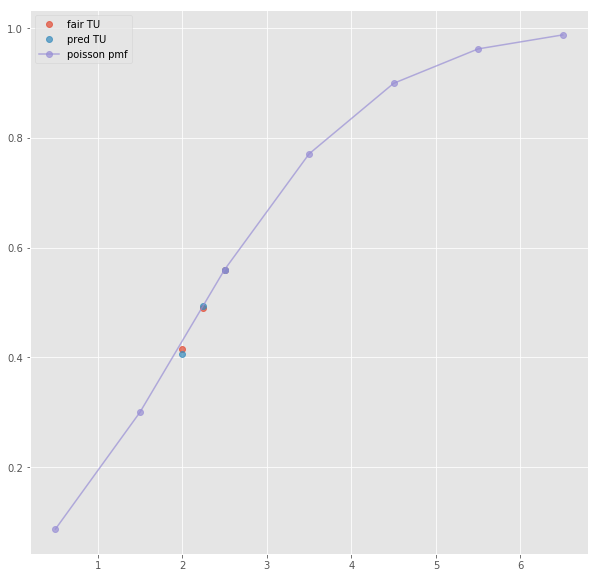

ML : 1.99 3.3 4.1
Error home:  0.01097555888482199
Error draw:  0.025612248400687154
Error away:  0.014636353313884382

(9, 124)
(1, 43)
2.5 2.17 1.751 -0.5 2.0 1.925
TO fair:  2.2392918332381497 TU fair:  1.8069124423963134
TO pred:  2.23935 TU fair:  1.80687
Error TO:  0.000791210173035406

Error TO:  0.0042746797988242324

Error TO:  0.003385498833860051

Error TO:  1.159957864993455e-05

Error TO:  0.006202737394895408

Error TO:  1.3148906767068702e-05

Error TO:  0.005542809011787608



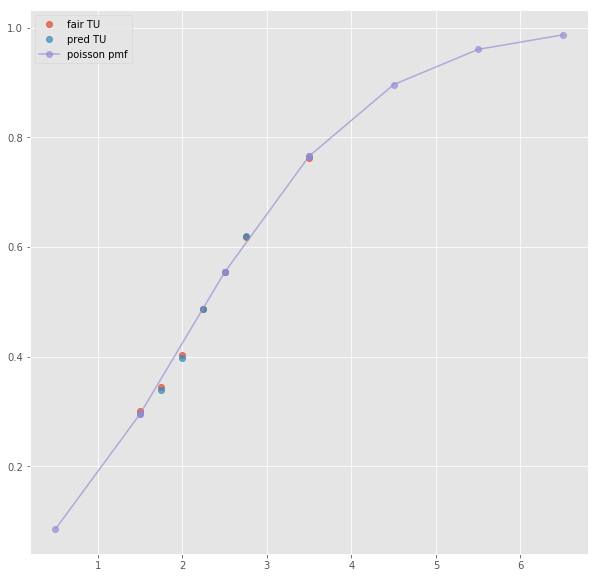

Error T1O:  0.004507242676159151
ML : 2.0 3.44 4.23
Error home:  0.0036598723155651935
Error draw:  0.021435340847951845
Error away:  0.01777523401844397

(28, 124)
(1, 61)
2.5 2.1 1.7 -0.5 1.975 1.875
TO fair:  2.235294117647059 TU fair:  1.8095238095238095
TO pred:  2.23531 TU fair:  1.80951
Error TO:  0.004320791854910522

Error TO:  0.004377456326562057

Error TO:  0.015815671723886204

Error TO:  0.01890964162004033

Error TO:  3.178647774992882e-06

Error TO:  0.008967580285023091

Error TO:  0.0007028210911704802

Error TO:  0.010648143020739409

Error TO:  0.013464327057453374

Error TO:  0.019795841247292154

Error TO:  0.020816609353313975

Error TO:  0.018180805011021595

Error TO:  0.028348814604790995



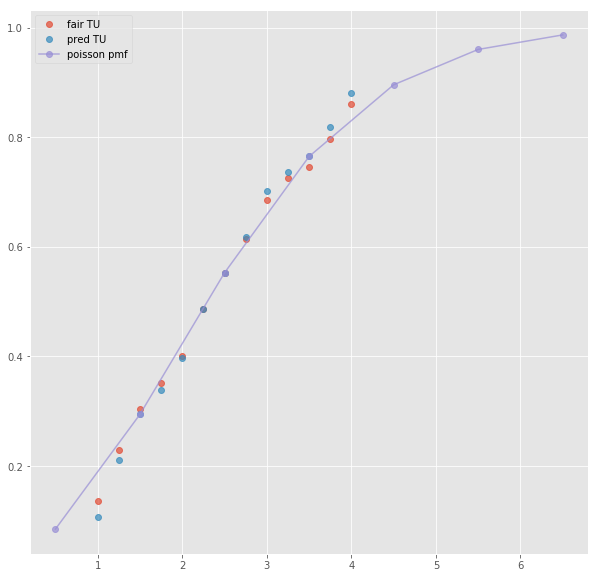

ML : 1.91 3.4 4.0
Error home:  0.003351934379942134
Error draw:  0.013500648495210266
Error away:  0.01685225096324003

(11, 124)
next positional indexers are out-of-bounds
(86, 124)
next positional indexers are out-of-bounds
(218, 124)
next positional indexers are out-of-bounds
(172, 124)
next positional indexers are out-of-bounds
(483, 124)
next positional indexers are out-of-bounds
(83, 124)
(1, 46)
3.5 2.76 1.505 -0.5 1.763 2.19
TO fair:  2.8338870431893692 TU fair:  1.5452898550724639
TO pred:  2.83393 TU fair:  1.54528
Error TO:  0.0017066831452837716

Error TO:  0.0011380679218631617

Error TO:  5.348849458908234e-06

Error TO:  0.0024208351433746833

Error TO:  0.002039823624181758

Error TO:  0.0012460091112576066

Error TO:  0.0018892023032813787

Error TO:  0.0002083143719058267



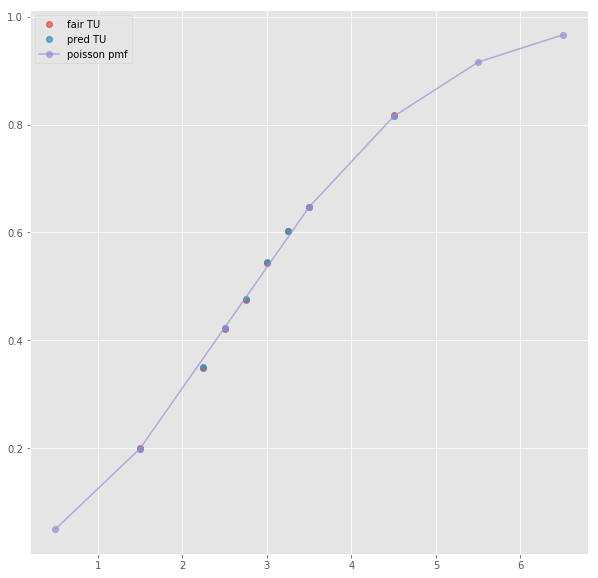

Error T1O:  0.006655429306573812
ML : 1.763 4.04 4.68
Error home:  0.0024552897608844937
Error draw:  0.016732050441124913
Error away:  0.014276636238467727

(28, 124)
(1, 68)
3.5 2.675 1.45 -0.5 1.92 2.01
TO fair:  2.844827586206897 TU fair:  1.5420560747663552
TO pred:  2.84478 TU fair:  1.54207
Error TO:  0.0042970385601514005

Error TO:  0.015826776113164964

Error TO:  0.005645024386429054

Error TO:  5.879988163315364e-06

Error TO:  0.012850476175087916

Error TO:  0.013471253217179457

Error TO:  0.0216309220725327

Error TO:  0.023323435595549946

Error TO:  0.0009611212849685025

Error TO:  0.022262116508840135

Error TO:  0.009205232239999944

Error TO:  0.01365895629374736

Error TO:  0.011208905461798924

Error TO:  0.025582112765512144

Error TO:  0.011324020052308426



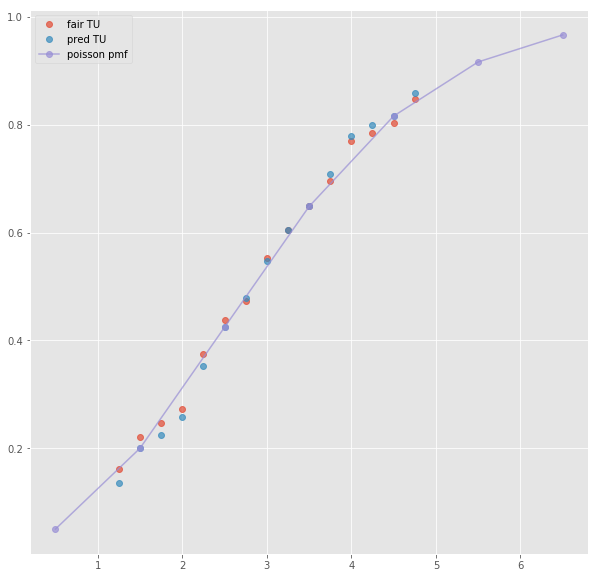

ML : 1.85 3.7 4.2
Error home:  0.0038964896263149473
Error draw:  0.025562908547152374
Error away:  0.029459133546011013

(51, 124)
next positional indexers are out-of-bounds
(55, 124)
(1, 43)
3.5 2.66 1.507 1.5 1.649 2.35
TO fair:  2.7650962176509624 TU fair:  1.5665413533834585
TO pred:  2.76514 TU fair:  1.56653
Error TO:  0.005428001030219232

Error TO:  0.004270282787087687

Error TO:  5.726268212546959e-06

Error TO:  0.007301095531390439

Error TO:  0.0061740878833449475

Error TO:  0.0038568430564452916

Error TO:  0.005561561040644425

Error TO:  0.0021052955757831504



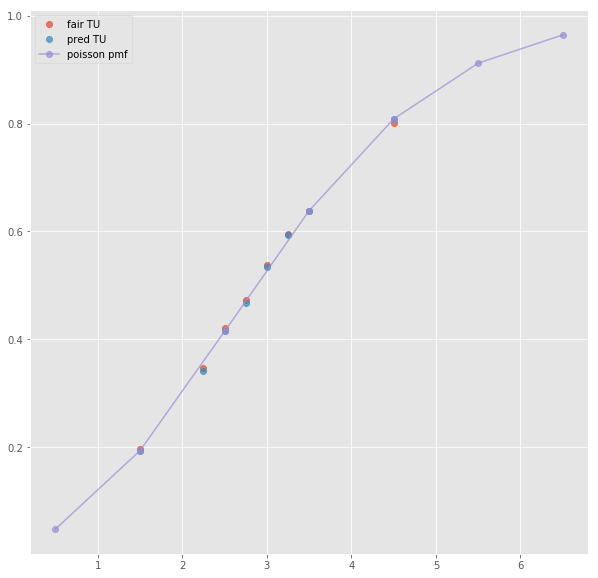

ML : 6.17 5.0 1.469
Error home:  0.003424776913238753
Error draw:  0.0056301860600527776
Error away:  0.0022052176555659164

(70, 124)
(1, 24)
2.5 1.69 2.14 0.5 2.12 1.73
TO fair:  1.7897196261682242 TU fair:  2.2662721893491127
TO pred:  1.78973 TU fair:  2.26626
Error TO:  0.02565115743027424

Error TO:  0.009735183099994271

Error TO:  3.2386698818331894e-06



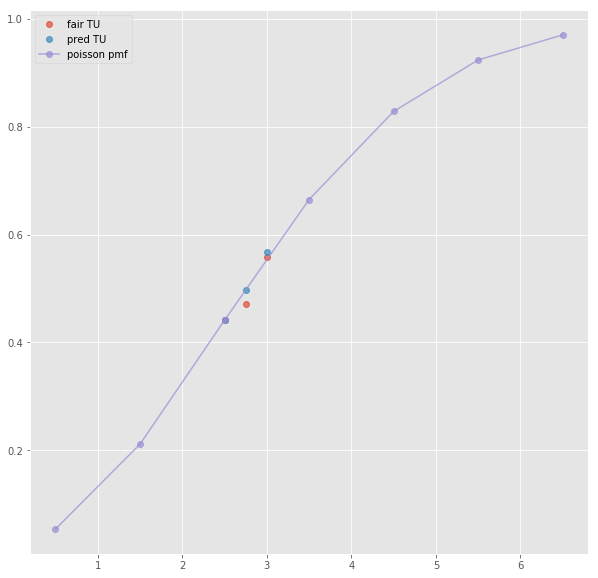

ML : 5.96 4.16 1.44
Error home:  0.06932975299238334
Error draw:  0.009847172633909801
Error away:  0.07917672217607363

(122, 124)
(1, 20)
next list index out of range
(158, 124)
(1, 22)
next list index out of range
(52, 124)
(1, 45)
3.5 2.66 1.507 1.5 1.649 2.35
TO fair:  2.7650962176509624 TU fair:  1.5665413533834585
TO pred:  2.76514 TU fair:  1.56653
Error TO:  0.005428001030219232

Error TO:  0.004270282787087687

Error TO:  5.726268212546959e-06

Error TO:  0.007301095531390439

Error TO:  0.0061740878833449475

Error TO:  0.0038568430564452916

Error TO:  0.005561561040644425

Error TO:  0.0021052955757831504



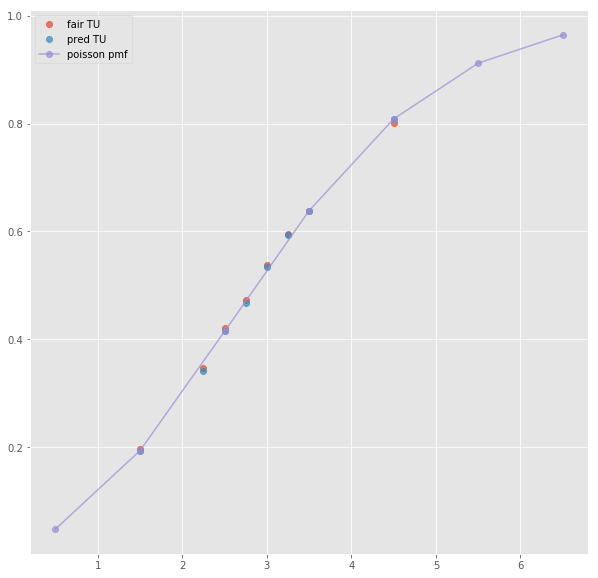

Error T1O:  0.013997976560446934
ML : 6.17 5.0 1.469
Error home:  0.003424776913238753
Error draw:  0.0056301860600527776
Error away:  0.0022052176555659164

(90, 124)
(1, 68)
3.5 2.6 1.475 1.5 1.625 2.25
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.014237090532022822

Error TO:  0.025807077317834826

Error TO:  0.012479244015746571

Error TO:  6.306488034957258e-06

Error TO:  0.010726207947077154

Error TO:  0.014507784164484061

Error TO:  0.02850582482961528

Error TO:  0.02067264661700574

Error TO:  0.006330379820712273

Error TO:  0.02415882778140921

Error TO:  0.004170206983200114

Error TO:  0.004772560002322596

Error TO:  0.0007934326163293037

Error TO:  0.02801228972349956

Error TO:  0.010362726084071044



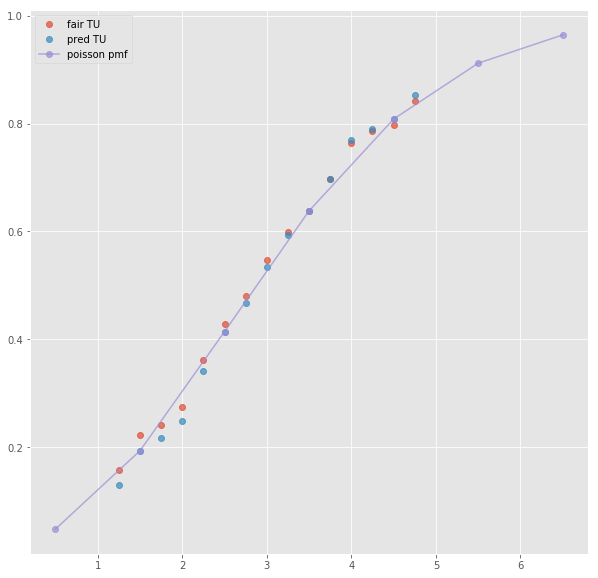

ML : 6.0 4.33 1.5
Error home:  0.009312592292733596
Error draw:  0.021804256747682244
Error away:  0.03111694742246318

(31, 124)
(1, 36)
2.5 1.68 2.25 1.5 1.64 2.33
TO fair:  1.7466666666666664 TU fair:  2.339285714285714
TO pred:  1.74663 TU fair:  2.33935
Error TO:  0.0034702798757064723

Error TO:  0.007068306984889139

Error TO:  1.2018782691303187e-05

Error TO:  0.003264755812607878

Error TO:  0.01003686210022725



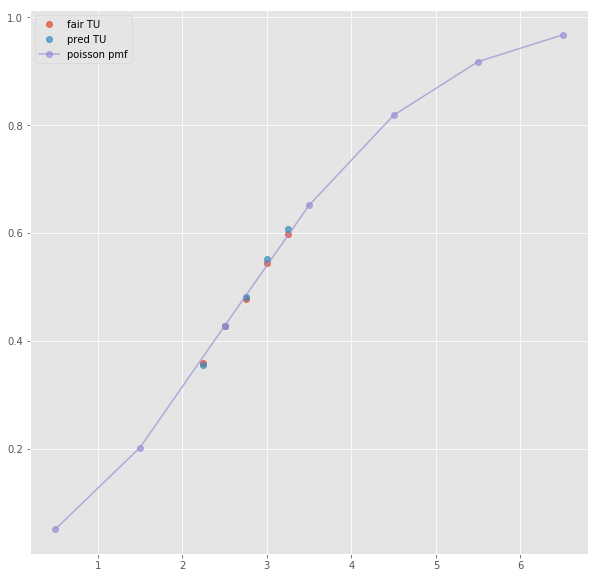

Error T1O:  0.05454871460714619
Error T1O:  0.002869108761963113
ML : 6.39 4.54 1.51
Error home:  0.002778824431268062
Error draw:  0.013600116583421862
Error away:  0.01637881267278407

(303, 124)
next positional indexers are out-of-bounds
(476, 124)
next positional indexers are out-of-bounds
(467, 124)
next positional indexers are out-of-bounds
(974, 124)
next positional indexers are out-of-bounds
(272, 124)
(1, 48)
3.5 2.45 1.602 0.5 2.25 1.719
TO fair:  2.529338327091136 TU fair:  1.6538775510204082
TO pred:  2.52931 TU fair:  1.65389
Error TO:  0.0006022543562246296

Error TO:  0.000587144130362538

Error TO:  4.427850955335266e-06

Error TO:  0.004802921198250321

Error TO:  0.0007964667228848032

Error TO:  0.0008742411646601722

Error TO:  0.00018958724442824648

Error TO:  0.014848113556701792

Error TO:  0.01819277180299317



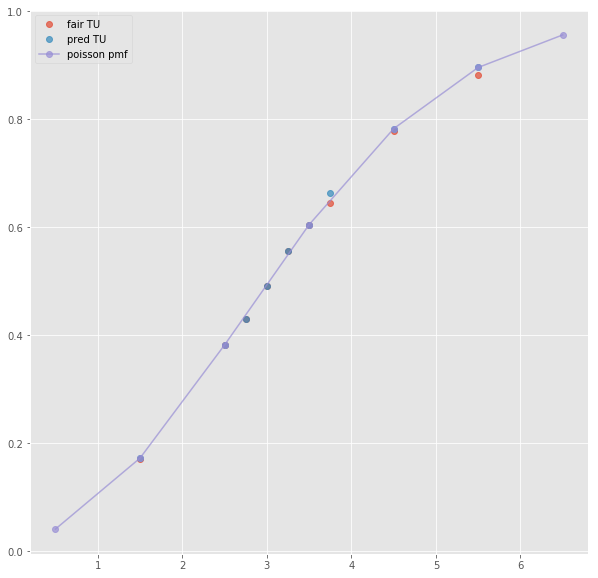

Error T1O:  0.004626347414446341
ML : 4.81 4.12 1.719
Error home:  0.017504310948101093
Error draw:  0.020878822575320255
Error away:  0.0033743631532480167

(47, 124)
(1, 74)
3.5 2.35 1.575 0.5 2.05 1.75
TO fair:  2.492063492063492 TU fair:  1.6702127659574466
TO pred:  2.49211 TU fair:  1.67019
Error TO:  0.014463465482746796

Error TO:  0.021976086443525666

Error TO:  0.016882889210083518

Error TO:  7.488602181360271e-06

Error TO:  0.012757263088487236

Error TO:  0.018540255293456376

Error TO:  0.020633743616199962

Error TO:  0.010063733266538644

Error TO:  0.0040947711533078635

Error TO:  0.0205966239790909

Error TO:  0.002818034669159808

Error TO:  0.009765205781596287

Error TO:  0.009045879570576731

Error TO:  0.02406759851161855

Error TO:  0.014670530307930307

Error TO:  0.014485059116925464

Error TO:  0.025874290919950152



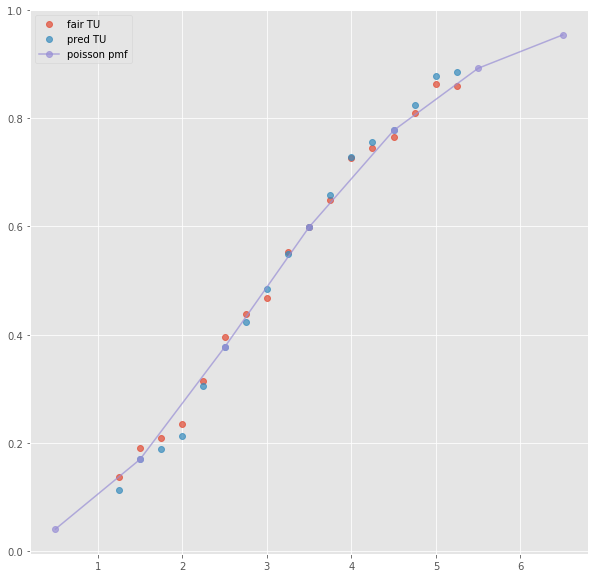

ML : 4.2 4.0 1.75
Error home:  0.017052796761625744
Error draw:  0.01720608156559375
Error away:  0.00015323630468710991

(78, 124)
next positional indexers are out-of-bounds
(13, 124)
(1, 39)
2.5 2.29 1.666 -0.5 2.51 1.578
TO fair:  2.3745498199279713 TU fair:  1.7275109170305678
TO pred:  2.37456 TU fair:  1.72751
Error TO:  0.002122220417546783

Error TO:  0.01109412842047064

Error TO:  0.00670726172399555

Error TO:  1.8054539561163097e-06

Error TO:  0.012013732056032178

Error TO:  0.0038137359946863736

Error TO:  0.012461225776201457



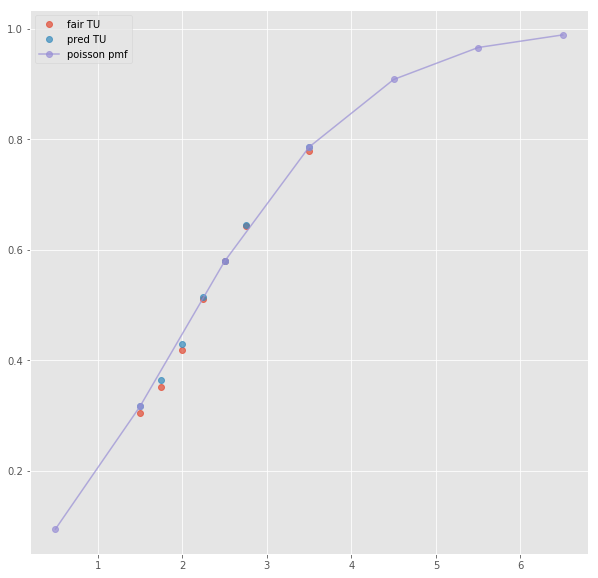

ML : 2.51 2.97 3.34
Error home:  0.0008852235326581859
Error draw:  0.04690746016625569
Error away:  0.04602239882288933

(17, 124)
(1, 19)
next list index out of range
(30, 124)
(1, 19)
next list index out of range
(20, 124)
(1, 19)
next list index out of range
(12, 124)
(1, 41)
2.5 2.29 1.666 -0.5 2.51 1.578
TO fair:  2.3745498199279713 TU fair:  1.7275109170305678
TO pred:  2.37456 TU fair:  1.72751
Error TO:  0.002122220417546783

Error TO:  0.01109412842047064

Error TO:  0.00670726172399555

Error TO:  1.8054539561163097e-06

Error TO:  0.012013732056032178

Error TO:  0.0038137359946863736

Error TO:  0.012461225776201457



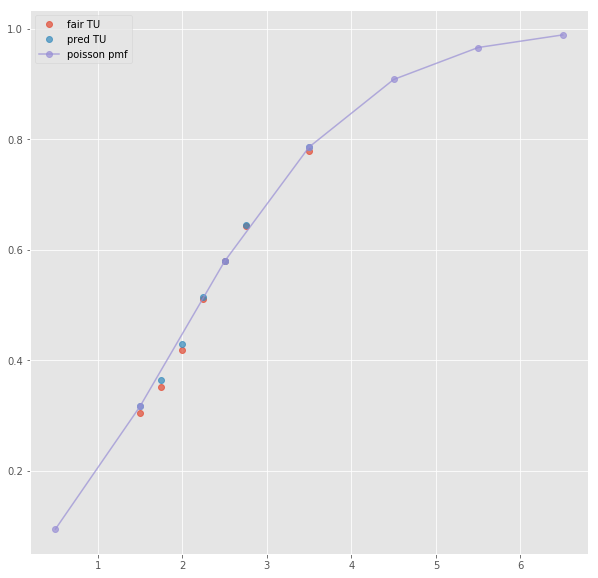

Error T1O:  0.03554707346650754
ML : 2.51 2.97 3.34
Error home:  0.0008852235326581859
Error draw:  0.04690746016625569
Error away:  0.04602239882288933

(8, 124)
(1, 62)
2.5 2.15 1.675 -0.5 2.35 1.575
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.011081319061399753

Error TO:  0.0015477089331937255

Error TO:  0.01384320327034061

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.009817964538896273

Error TO:  0.010097138835415354

Error TO:  0.014687662129951318

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.03187120233894902

Error TO:  0.037133735416098546



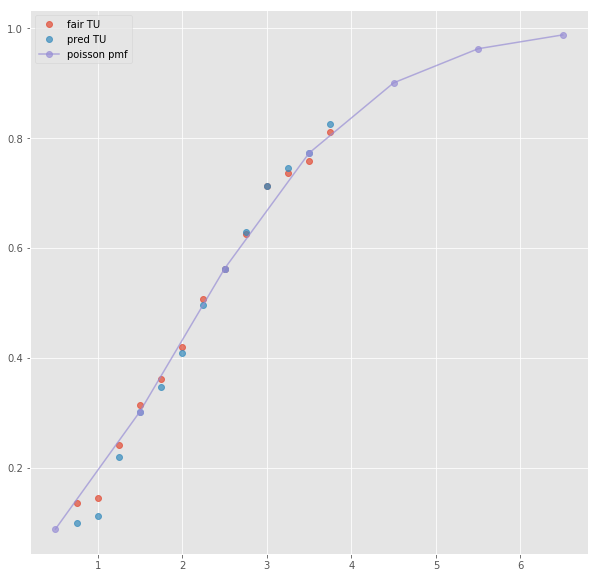

ML : 2.4 3.2 3.0
Error home:  0.009119195118909462
Error draw:  0.020530315246635678
Error away:  0.011411148476323685

(7, 124)
(1, 33)
2.5 2.25 1.68 -0.5 2.46 1.58
TO fair:  2.339285714285714 TU fair:  1.7466666666666664
TO pred:  2.33928 TU fair:  1.74667
Error TO:  0.005394930183368951

Error TO:  0.0003518869127401292

Error TO:  1.0442307425972963e-06

Error TO:  0.000938534696496518

Error TO:  0.0012692203491566634



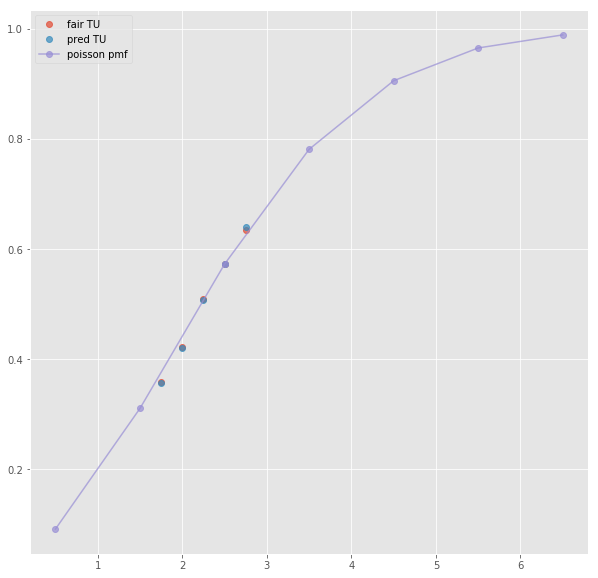

Error T1O:  0.014107914868053795
ML : 2.49 3.06 3.2
Error home:  0.005273871967293731
Error draw:  0.03723991492934392
Error away:  0.03196632035850344

(79, 124)
(1, 44)
2.5 2.26 1.714 -0.5 1.787 2.16
TO fair:  2.31855309218203 TU fair:  1.7584070796460176
TO pred:  2.31851 TU fair:  1.75843
Error TO:  0.00043458112024535867

Error TO:  0.00032097866429681154

Error TO:  0.0012590713819791155

Error TO:  8.016272412147973e-06

Error TO:  0.001014527264459275

Error TO:  0.0007893563737942366

Error TO:  0.00022960170449626283



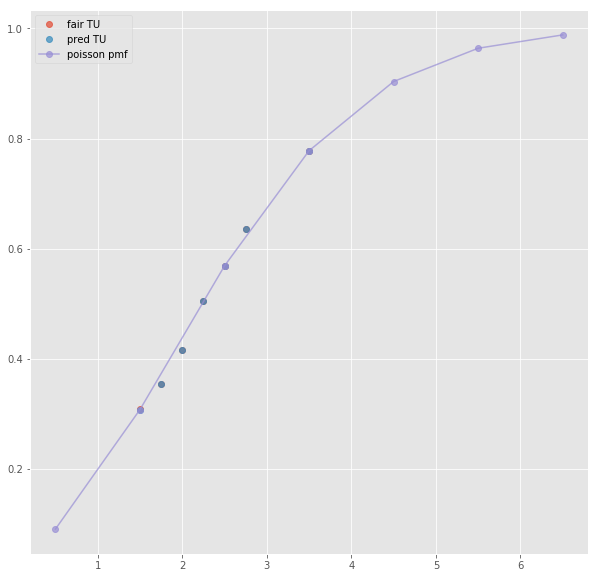

Error T1O:  0.00011409669301565284
ML : 1.787 3.63 5.24
Error home:  0.0017991141298615565
Error draw:  0.01496938674520798
Error away:  0.013170594058381252

(15, 124)
(1, 64)
2.5 2.15 1.675 -0.5 1.82 2.11
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.03046439883500962

Error TO:  0.052252796141195934

Error TO:  0.023785490756467798

Error TO:  0.01311621863071552

Error TO:  7.269732788139915e-06

Error TO:  0.049376207378929116

Error TO:  0.0007603554812872781

Error TO:  0.018969921468332457

Error TO:  0.047628930544628245

Error TO:  0.021645654202264566

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.027687276980177478

Error TO:  0.041116212516855266



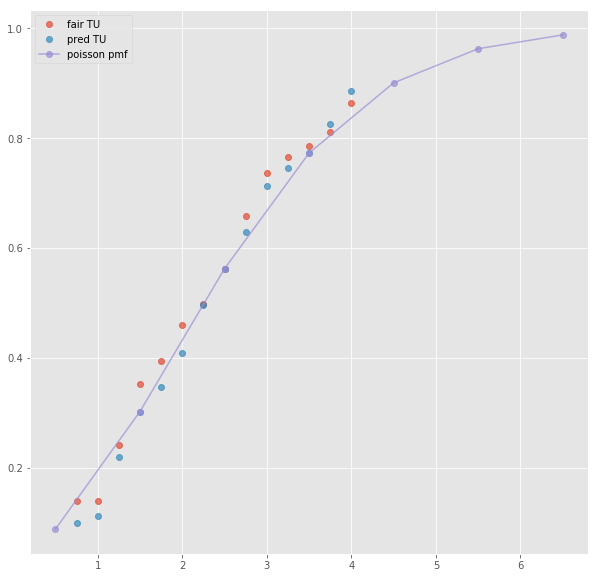

ML : 1.95 3.3 4.0
Error home:  0.05577551821694482
Error draw:  0.029821766491189283
Error away:  0.025953798456450183

(35, 124)
next positional indexers are out-of-bounds
(93, 124)
(1, 45)
3.5 1.961 1.943 -2.5 2.15 1.787
TO fair:  2.009264024704066 TU fair:  1.990821009688934
TO pred:  2.00926 TU fair:  1.99082
Error TO:  0.014298995411595739

Error TO:  0.004403229288733046

Error TO:  9.969211404170508e-07

Error TO:  0.0051279842037911805

Error TO:  0.004392643800816165

Error TO:  0.0015276245938425914

Error TO:  0.0029301663980327852

Error TO:  0.0042235644545716156

Error TO:  0.006219842402260312

Error TO:  0.0014772016966963508



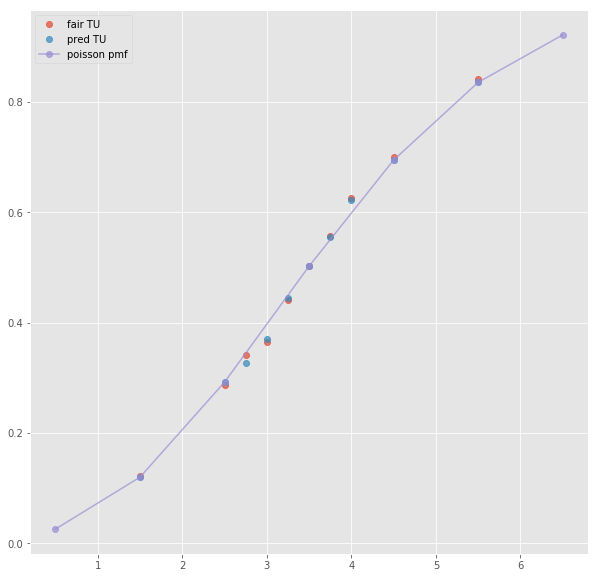

ML : 1.14 9.15 21.79
Error home:  0.0020470633122871007
Error draw:  0.0020818941060770507
Error away:  0.00412899139823044

(80, 124)
(1, 25)
3.5 1.94 1.88 -2.5 2.06 1.78
TO fair:  2.0319148936170213 TU fair:  1.9690721649484533
TO pred:  2.03188 TU fair:  1.9691
Error TO:  0.03372922463932526

Error TO:  8.451667848963229e-06

Error TO:  0.008482884775625865

Error TO:  0.0033508294183297593



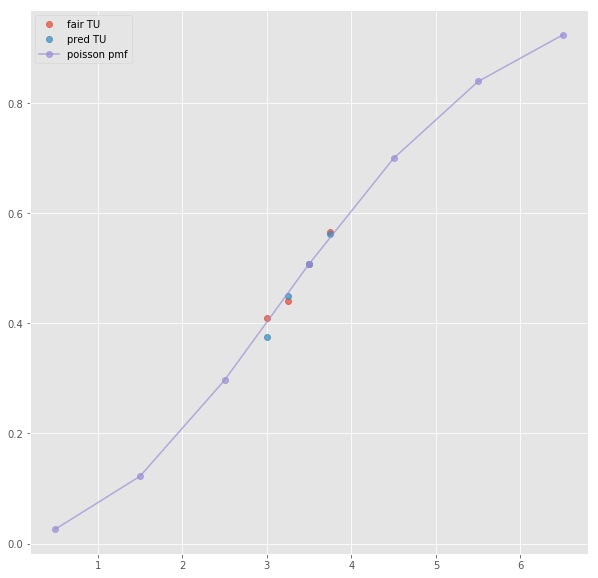

ML : 1.09 8.71 19.46
Error home:  0.008950042276606451
Error draw:  0.005841325363334607
Error away:  0.003108704179727008

(91, 124)
(1, 22)
3.5 1.94 1.96 -2.5 2.11 1.82
TO fair:  1.989795918367347 TU fair:  2.0103092783505154
TO pred:  1.98979 TU fair:  2.01031
Error TO:  0.05734001854477788

Error TO:  1.494810494828691e-06

Error TO:  0.004671422999763197



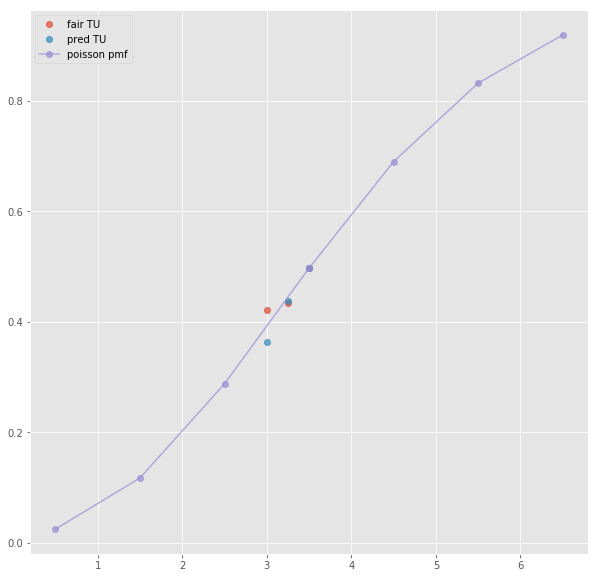

ML : 1.14 9.0 19.0
Error home:  0.010298235757429719
Error draw:  0.005994330737597614
Error away:  0.004303921192877744

(324, 124)
(1, 27)
3.5 1.94 1.96 -2.5 2.13 1.8
TO fair:  1.989795918367347 TU fair:  2.0103092783505154
TO pred:  1.98979 TU fair:  2.01031
Error TO:  0.018915230119989634

Error TO:  1.494810494828691e-06

Error TO:  0.007746996144544327

Error TO:  0.006744655831466606



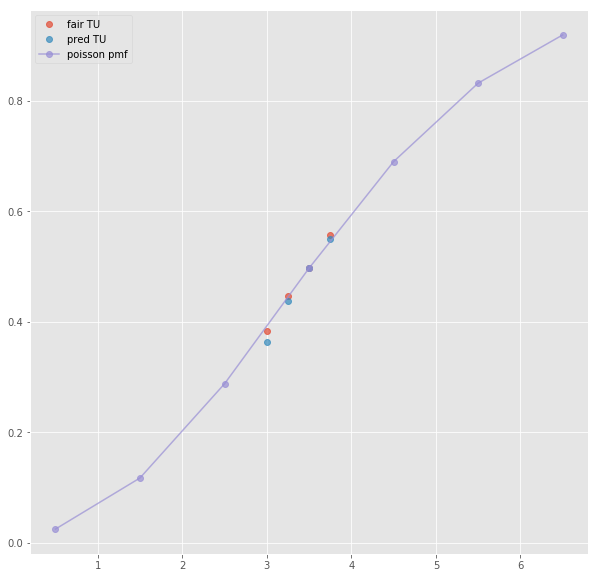

ML : 1.13 8.5 19.0
Error home:  0.010824596358758432
Error draw:  0.008952375957462858
Error away:  0.0018722627018195742

(56, 124)
(1, 47)
3.5 1.961 1.943 -2.5 2.15 1.787
TO fair:  2.009264024704066 TU fair:  1.990821009688934
TO pred:  2.00926 TU fair:  1.99082
Error TO:  0.026624496794731223

Error TO:  0.004403229288733046

Error TO:  9.969211404170508e-07

Error TO:  0.0051279842037911805

Error TO:  0.004392643800816165

Error TO:  0.0015276245938425914

Error TO:  0.0029301663980327852

Error TO:  0.0042235644545716156

Error TO:  0.006219842402260312

Error TO:  0.0014772016966963508



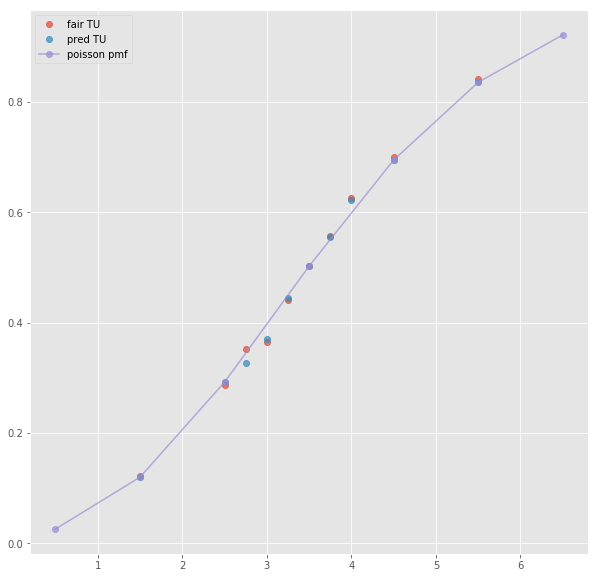

Error T1O:  0.003966319056174283
ML : 1.14 9.15 21.79
Error home:  0.0020470633122871007
Error draw:  0.0020818941060770507
Error away:  0.00412899139823044

(36, 124)
(1, 69)
3.5 2.0 1.8 -2.5 2.075 1.725
TO fair:  2.111111111111111 TU fair:  1.9000000000000001
TO pred:  2.11109 TU fair:  1.90001
Error TO:  0.008183051050272394

Error TO:  0.013070785644421656

Error TO:  0.011074985953235195

Error TO:  4.736889474221684e-06

Error TO:  0.03063800474096884

Error TO:  0.008691513121290684

Error TO:  0.021064096480153838

Error TO:  0.01049052047988741

Error TO:  0.00895281882489074

Error TO:  0.021518957742678646

Error TO:  0.024801087017425893

Error TO:  0.024137420803349713

Error TO:  0.02788785086580775

Error TO:  0.019480947462182263

Error TO:  0.032394216539958554

Error TO:  0.03041398920711022

Error TO:  0.03007423219962707



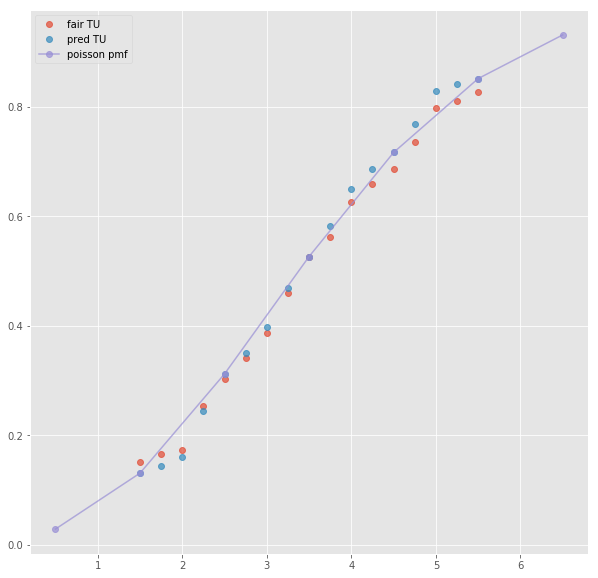

ML : 1.125 9.0 19.0
Error home:  0.008666852455349039
Error draw:  0.002930509502566167
Error away:  0.005736387168509806

(60, 124)
next positional indexers are out-of-bounds
(34, 124)
(1, 40)
2.5 2.26 1.6840000000000002 -0.5 1.99 1.917
TO fair:  2.342042755344418 TU fair:  1.745132743362832
TO pred:  2.34208 TU fair:  1.74511
Error TO:  0.0029511925794452054

Error TO:  0.002993884124762869

Error TO:  0.009319940317296327

Error TO:  6.789963159670176e-06

Error TO:  0.005025193373691561

Error TO:  0.0015914757575281047

Error TO:  0.004016516415973781



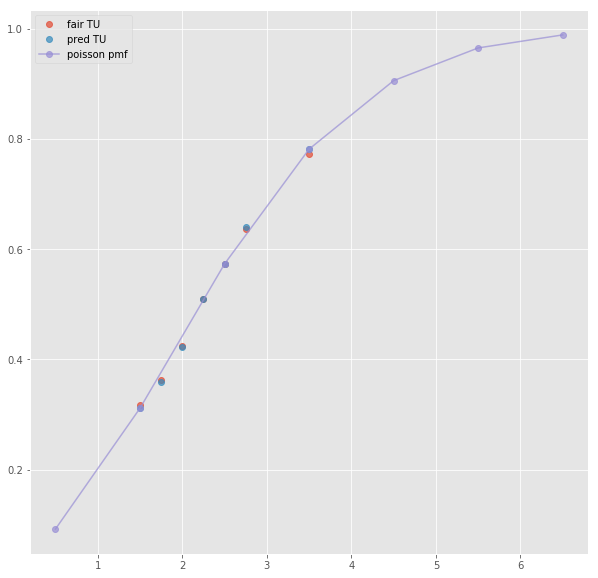

ML : 1.99 3.46 4.08
Error home:  0.005891330301234565
Error draw:  0.012742395917448246
Error away:  0.0068510677241575

(20, 124)
(1, 17)
2.5 2.16 1.66 -0.5 1.97 1.85
TO fair:  2.3012048192771086 TU fair:  1.7685185185185184
TO pred:  2.30125 TU fair:  1.76849
Error TO:  8.53167098457952e-06

Error TO:  0.025951055729317662



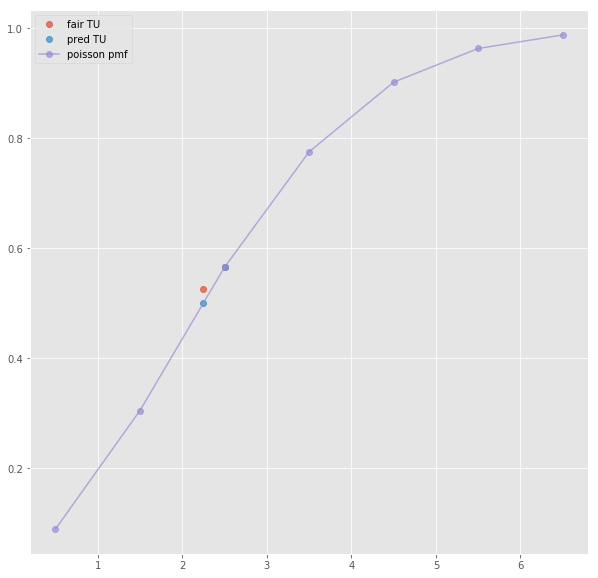

ML : 1.95 3.06 3.56
Error home:  0.0266300459496967
Error draw:  0.026297579315930186
Error away:  0.0003326484849066613

(52, 124)
(1, 19)
2.5 2.16 1.74 -0.5 1.99 1.91
TO fair:  2.2413793103448274 TU fair:  1.8055555555555551
TO pred:  2.24138 TU fair:  1.80555
Error TO:  1.372780643049687e-07

Error TO:  0.0381391481340293



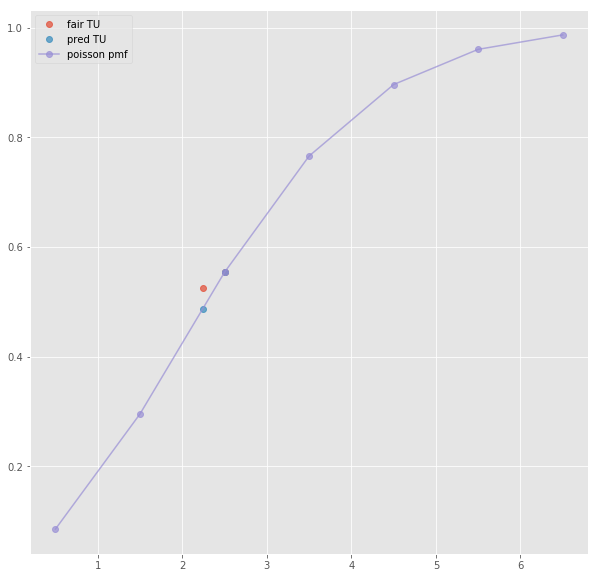

ML : 1.93 3.0 3.85
Error home:  0.023459493514585428
Error draw:  0.03817103793113319
Error away:  0.014711295205334624

(49, 124)
(1, 15)
2.5 2.19 1.72 -0.5 2.0 1.9
TO fair:  2.2732558139534884 TU fair:  1.7853881278538815
TO pred:  2.27322 TU fair:  1.78541
Error TO:  6.930466784349498e-06



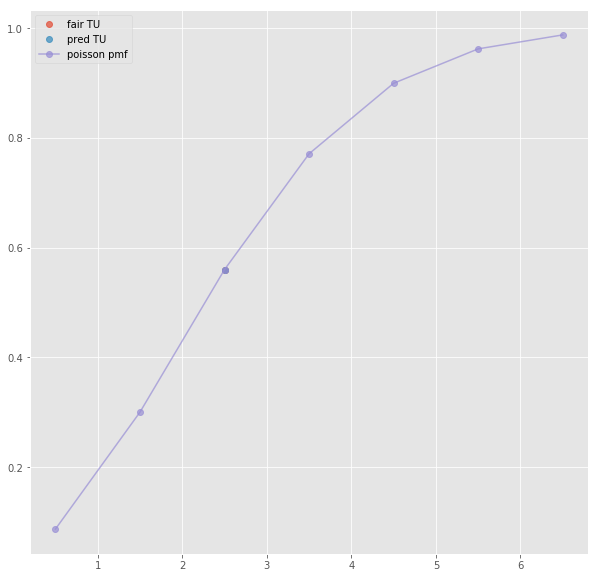

ML : 1.99 3.2 3.5
Error home:  0.030635306448807187
Error draw:  0.020255589447231326
Error away:  0.010379853978024434

(33, 124)
(1, 42)
2.5 2.26 1.6840000000000002 -0.5 1.99 1.917
TO fair:  2.342042755344418 TU fair:  1.745132743362832
TO pred:  2.34208 TU fair:  1.74511
Error TO:  0.0029511925794452054

Error TO:  0.002993884124762869

Error TO:  0.009319940317296327

Error TO:  6.789963159670176e-06

Error TO:  0.005025193373691561

Error TO:  0.0015914757575281047

Error TO:  0.004016516415973781



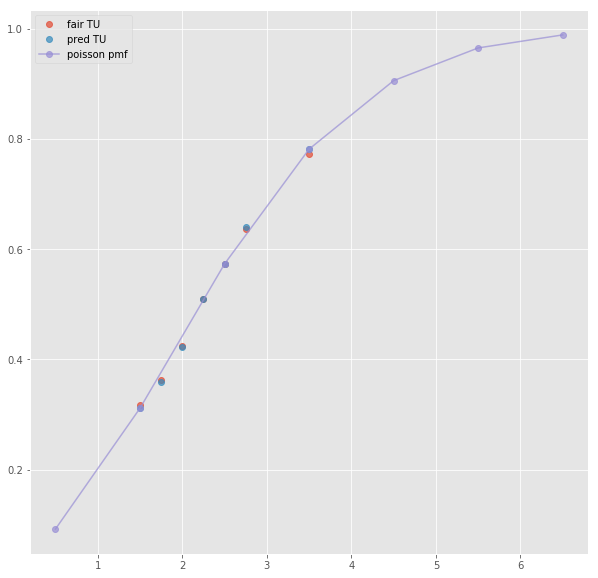

Error T1O:  0.0013118466332595613
ML : 1.99 3.46 4.08
Error home:  0.005891330301234565
Error draw:  0.012742395917448246
Error away:  0.0068510677241575

(61, 124)
(1, 66)
2.5 2.2 1.65 -0.5 1.95 1.85
TO fair:  2.3333333333333335 TU fair:  1.7499999999999998
TO pred:  2.33328 TU fair:  1.75003
Error TO:  5.396942931656934e-05

Error TO:  0.008951112960956187

Error TO:  0.008585969313624042

Error TO:  0.015270928110261789

Error TO:  0.04473514013816356

Error TO:  9.796142279250297e-06

Error TO:  0.019542889619615922

Error TO:  0.02009771674211791

Error TO:  0.008504545351582238

Error TO:  0.018513066532815925

Error TO:  0.027194411721239

Error TO:  0.0384059896693317

Error TO:  0.013000791667004824

Error TO:  0.02232214295763646

Error TO:  0.02293532025074274



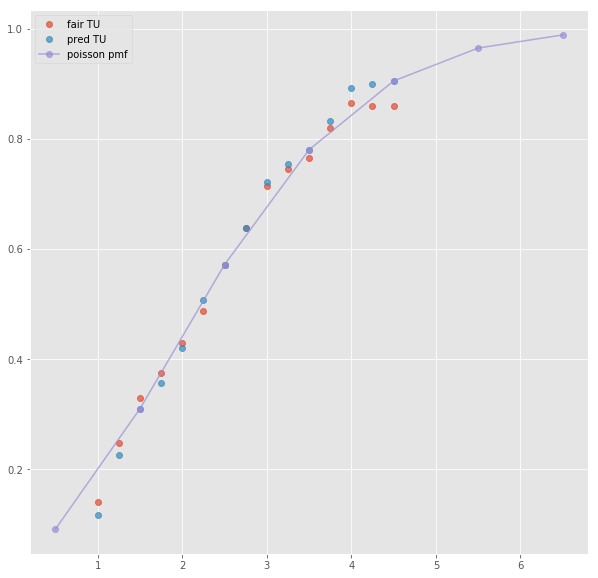

ML : 1.95 3.6 3.6
Error home:  0.006840695987458956
Error draw:  0.006326478977519423
Error away:  0.01316686906983397

(19, 124)
(1, 34)
2.5 2.24 1.69 -0.5 1.99 1.86
TO fair:  2.325443786982249 TU fair:  1.7544642857142858
TO pred:  2.32539 TU fair:  1.7545
Error TO:  0.0036125413315033494

Error TO:  0.0034800773227056103

Error TO:  9.946620133649553e-06

Error TO:  0.002479984516907785

Error TO:  0.004669630779519984



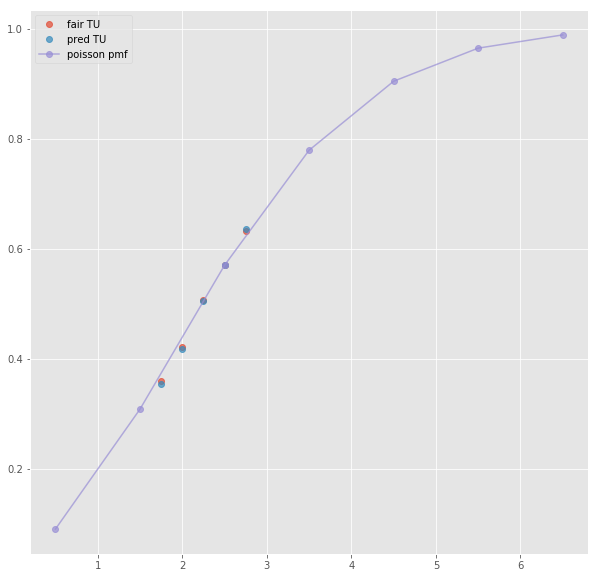

Error T1O:  0.0049052327256544626
ML : 2.01 3.42 4.0
Error home:  0.004708096331910661
Error draw:  0.014583881904649654
Error away:  0.009875543456877356

(45, 124)
(1, 41)
2.5 2.3 1.645 -0.5 2.21 1.714
TO fair:  2.398176291793313 TU fair:  1.7152173913043478
TO pred:  2.39811 TU fair:  1.71525
Error TO:  0.0006391779043810053

Error TO:  0.001838657128802712

Error TO:  0.0011563341730095877

Error TO:  1.1526821351526273e-05

Error TO:  0.000993575993465945

Error TO:  0.0004199210197703418

Error TO:  0.0013001983630304137



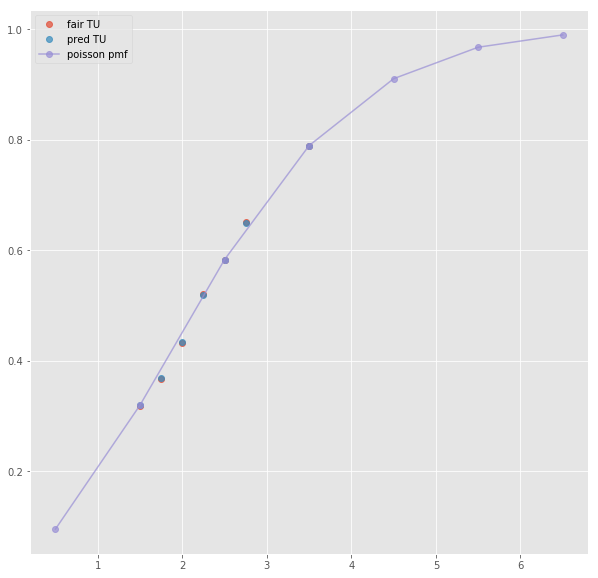

ML : 2.21 3.26 3.55
Error home:  0.002103703428925574
Error draw:  0.018721330803971203
Error away:  0.016617898090747207

(41, 124)
(1, 21)
next list index out of range
(70, 124)
(1, 21)
next list index out of range
(110, 124)
(1, 19)
next list index out of range
(41, 124)
(1, 43)
2.5 2.3 1.645 -0.5 2.21 1.714
TO fair:  2.398176291793313 TU fair:  1.7152173913043478
TO pred:  2.39811 TU fair:  1.71525
Error TO:  0.0006391779043810053

Error TO:  0.001838657128802712

Error TO:  0.0011563341730095877

Error TO:  1.1526821351526273e-05

Error TO:  0.000993575993465945

Error TO:  0.0004199210197703418

Error TO:  0.0013001983630304137



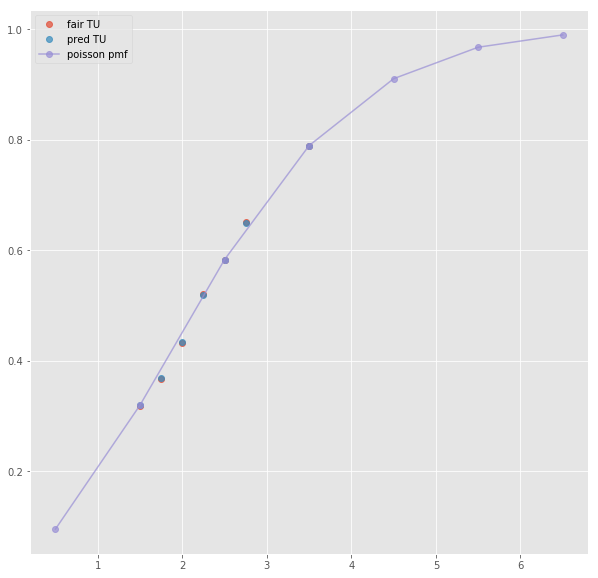

Error T1O:  0.004667647005706321
ML : 2.21 3.26 3.55
Error home:  0.002103703428925574
Error draw:  0.018721330803971203
Error away:  0.016617898090747207

(15, 124)
(1, 59)
2.5 2.25 1.625 -0.5 2.05 1.8
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.009547734651831286

Error TO:  0.002412627601825479

Error TO:  0.018463264954572955

Error TO:  0.022573559724438308

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.0023390419334406443

Error TO:  0.027128482339291993

Error TO:  0.00927629075225167

Error TO:  0.019463835812848967

Error TO:  0.01555031236588067

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



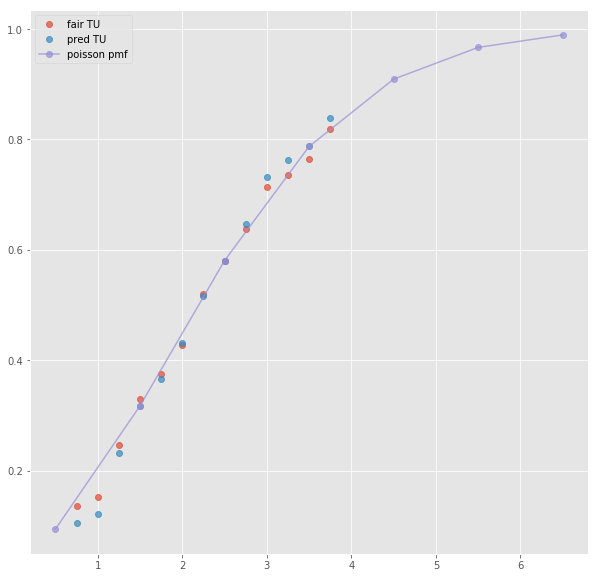

ML : 2.0 3.1 4.2
Error home:  0.003874056649078861
Error draw:  0.03259933800700643
Error away:  0.036473739389667165

(3, 124)
(1, 33)
2.5 2.25 1.68 -0.5 1.91 1.93
TO fair:  2.339285714285714 TU fair:  1.7466666666666664
TO pred:  2.33928 TU fair:  1.74667
Error TO:  0.0029852916291521203

Error TO:  0.003968476726873393

Error TO:  1.0442307425972963e-06

Error TO:  0.002264292272253998

Error TO:  0.005398314938777848



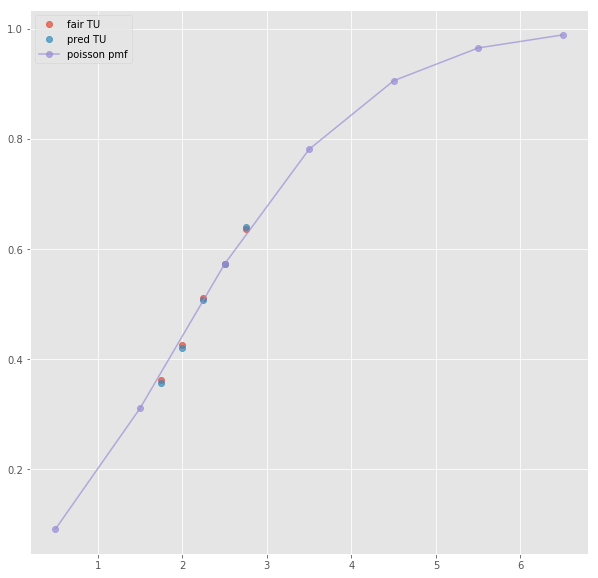

Error T1O:  0.007159809695321595
ML : 1.93 3.43 4.36
Error home:  0.003922988775154845
Error draw:  0.01677131802478027
Error away:  0.012848598820214802

(150, 124)
(1, 43)
2.5 2.43 1.625 -0.5 2.23 1.746
TO fair:  2.4953846153846153 TU fair:  1.668724279835391
TO pred:  2.49534 TU fair:  1.66875
Error TO:  0.0001901479030344544

Error TO:  0.0007335189941775067

Error TO:  0.002134133911644992

Error TO:  7.165020209198847e-06

Error TO:  0.0015097344662889922

Error TO:  3.056584119437433e-05

Error TO:  0.001213226500320852

Error TO:  0.01251067168311415



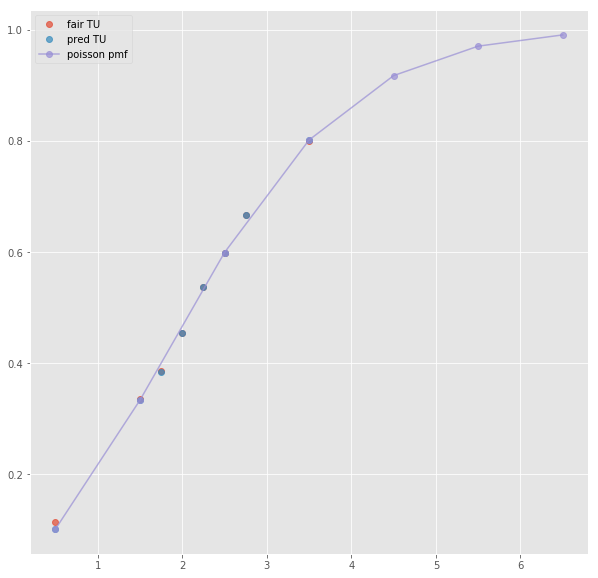

ML : 2.23 3.19 3.82
Error home:  0.001069360004098574
Error draw:  0.026350579396262452
Error away:  0.02528107459993162

(194, 124)
(1, 27)
2.5 2.36 1.61 -0.5 2.25 1.71
TO fair:  2.4658385093167703 TU fair:  1.6822033898305087
TO pred:  2.46585 TU fair:  1.6822
Error TO:  0.018234203687951034

Error TO:  1.8897944409346223e-06

Error TO:  0.009891851549281405

Error TO:  0.015197346795750466



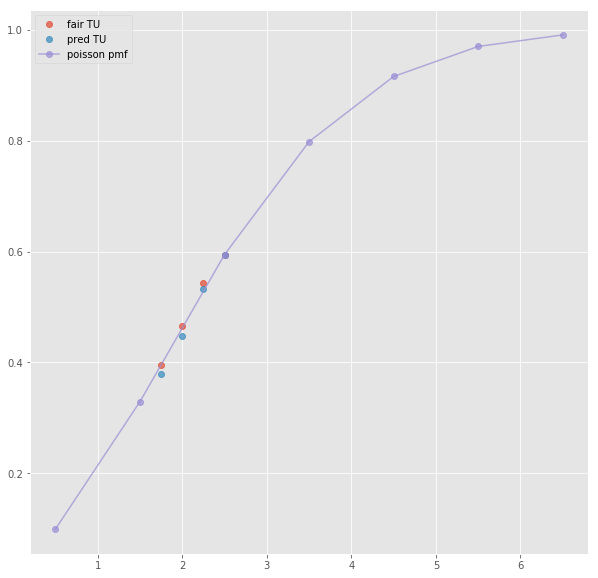

ML : 2.26 3.08 3.58
Error home:  0.00898119520846935
Error draw:  0.030838390971431706
Error away:  0.021857163561922077

(205, 124)
(1, 25)
2.5 2.44 1.61 -0.5 2.26 1.74
TO fair:  2.515527950310559 TU fair:  1.6598360655737707
TO pred:  2.51554 TU fair:  1.65983
Error TO:  0.008425322339158714

Error TO:  1.9042127959445487e-06

Error TO:  0.009270898710694586



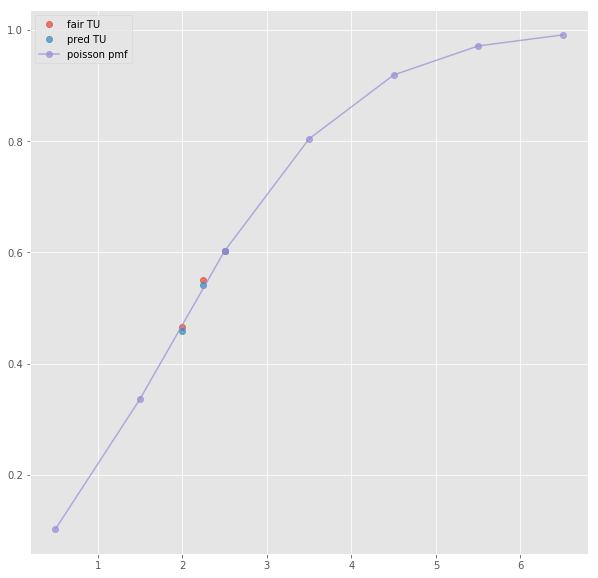

ML : 2.22 3.05 3.7
Error home:  0.005420751718579919
Error draw:  0.03150311529718225
Error away:  0.026082372329485348

(496, 124)
(1, 27)
2.5 2.4 1.63 -0.5 2.26 1.74
TO fair:  2.4723926380368098 TU fair:  1.6791666666666667
TO pred:  2.47232 TU fair:  1.6792
Error TO:  0.01350446660218152

Error TO:  1.1883434428205941e-05

Error TO:  0.014512944068941935

Error TO:  0.0054149448797341515



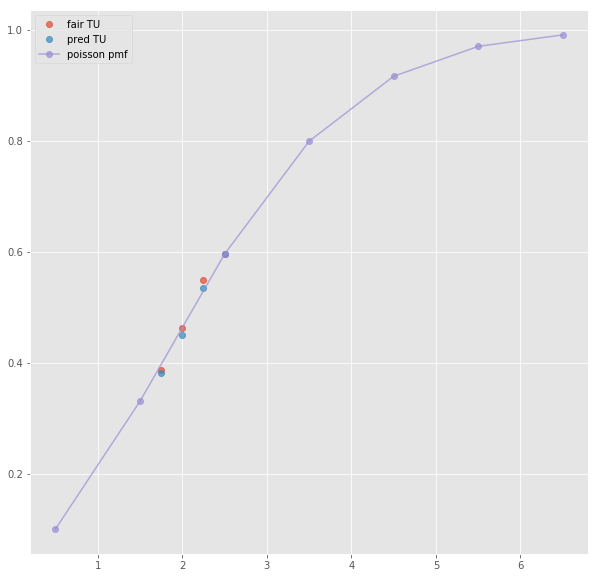

ML : 2.25 3.0 3.8
Error home:  0.008022463405837732
Error draw:  0.04086623791731414
Error away:  0.032844085577167614

(148, 124)
(1, 47)
2.5 2.43 1.625 -0.5 2.23 1.746
TO fair:  2.4953846153846153 TU fair:  1.668724279835391
TO pred:  2.49534 TU fair:  1.66875
Error TO:  0.0001901479030344544

Error TO:  0.0007335189941775067

Error TO:  0.002134133911644992

Error TO:  7.165020209198847e-06

Error TO:  0.0015097344662889922

Error TO:  3.056584119437433e-05

Error TO:  0.001213226500320852

Error TO:  0.01251067168311415



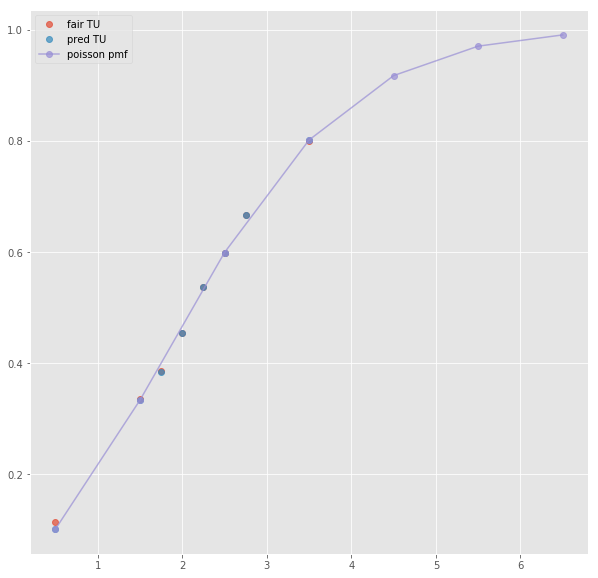

Error T1O:  0.0036134859530110863
Error T1O:  0.013210942830833128
ML : 2.23 3.19 3.82
Error home:  0.001069360004098574
Error draw:  0.026350579396262452
Error away:  0.02528107459993162

(24, 124)
(1, 10)
next list index out of range
(60, 124)
next positional indexers are out-of-bounds
(82, 124)
(1, 38)
3.5 2.67 1.52 -0.5 1.5490000000000002 2.62
TO fair:  2.7565789473684212 TU fair:  1.5692883895131087
TO pred:  2.75652 TU fair:  1.56931
Error TO:  0.000854820114609689

Error TO:  1.0519991700319586e-05

Error TO:  7.757697462751345e-06

Error TO:  0.007634555158057915

Error TO:  0.0009026383520400749

Error TO:  0.0035540430138515378

Error TO:  0.00013768295318916657



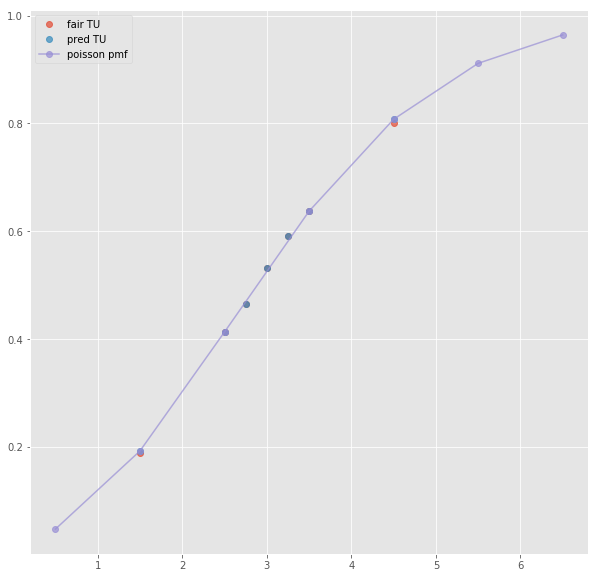

ML : 1.5490000000000002 4.42 6.22
Error home:  0.003236644206768058
Error draw:  0.015240976762993352
Error away:  0.012004160066022312

(107, 124)
(1, 28)
3.5 2.47 1.56 -0.5 1.54 2.58
TO fair:  2.5833333333333335 TU fair:  1.631578947368421
TO pred:  2.5833 TU fair:  1.63159
Error TO:  0.027838477478662083

Error TO:  0.04073959506722602

Error TO:  4.994861536211648e-06

Error TO:  0.018356141661466263

Error TO:  0.027667495497322447



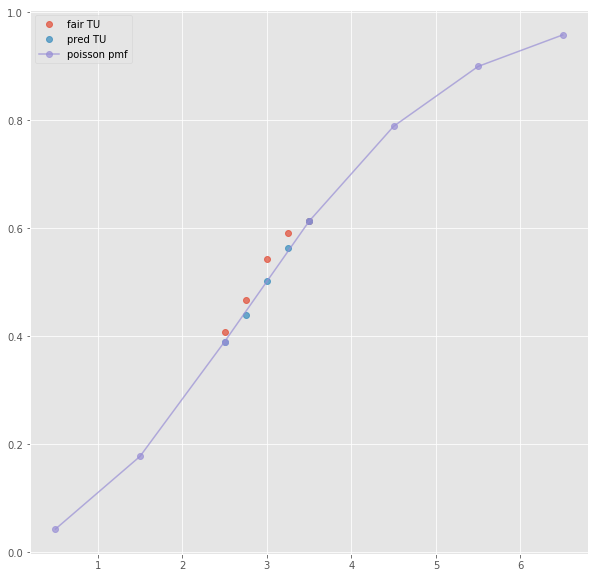

ML : 1.54 4.28 5.98
Error home:  0.007925169682359345
Error draw:  0.021615532491251976
Error away:  0.013690209247259666

(140, 124)
(1, 22)
next list index out of range
(309, 124)
(1, 26)
3.5 2.58 1.55 -0.5 1.57 2.61
TO fair:  2.6645161290322577 TU fair:  1.6007751937984496
TO pred:  2.66452 TU fair:  1.60077
Error TO:  0.00394789109767002

Error TO:  0.03165610959131082

Error TO:  5.452331015565193e-07

Error TO:  0.025028748399816336



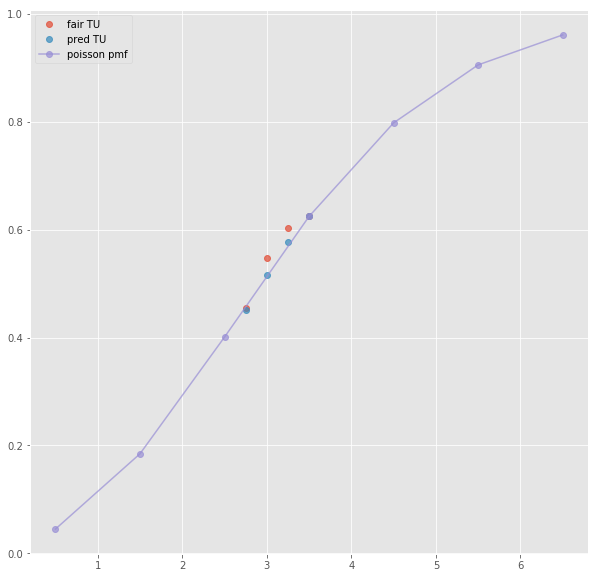

ML : 1.56 4.25 6.1
Error home:  0.008167120755218193
Error draw:  0.023076978007722487
Error away:  0.014909898788122489

(85, 124)
(1, 40)
3.5 2.67 1.52 -0.5 1.5490000000000002 2.62
TO fair:  2.7565789473684212 TU fair:  1.5692883895131087
TO pred:  2.75652 TU fair:  1.56931
Error TO:  0.000854820114609689

Error TO:  1.0519991700319586e-05

Error TO:  7.757697462751345e-06

Error TO:  0.007634555158057915

Error TO:  0.0009026383520400749

Error TO:  0.0035540430138515378

Error TO:  0.00013768295318916657



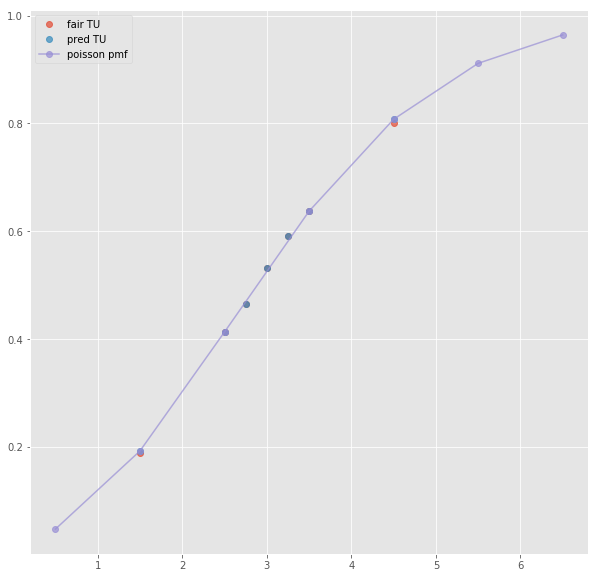

Error T1O:  0.0002656205167230752
ML : 1.5490000000000002 4.42 6.22
Error home:  0.003236644206768058
Error draw:  0.015240976762993352
Error away:  0.012004160066022312

(27, 124)
(1, 10)
next list index out of range
(27, 124)
next positional indexers are out-of-bounds
(38, 124)
(1, 46)
2.5 1.84 2.04 0.5 2.19 1.74
TO fair:  1.9019607843137256 TU fair:  2.108695652173913
TO pred:  1.90192 TU fair:  2.10874
Error TO:  0.0003781455104843179

Error TO:  0.0007636277803875213

Error TO:  7.500463261223e-05

Error TO:  0.00048414527465057144

Error TO:  0.002377895703886218

Error TO:  1.1274553592732772e-05

Error TO:  0.0019207269811104544

Error TO:  0.0006669086840568328

Error TO:  0.0006540797657295649



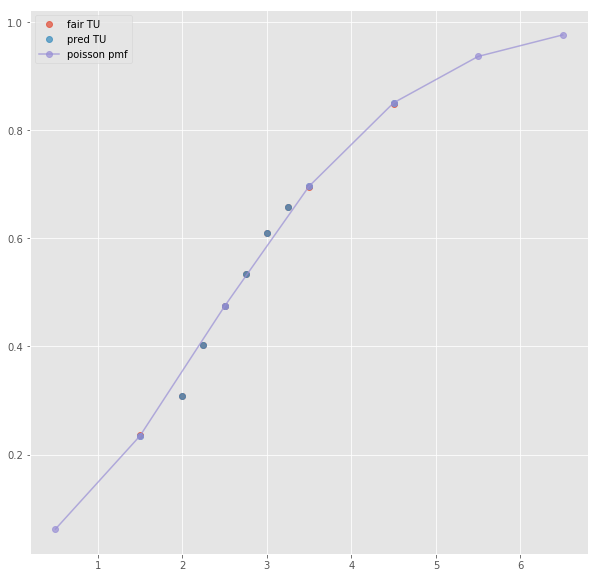

ML : 4.59 4.07 1.74
Error home:  0.0005232830677308897
Error draw:  0.004244480448252791
Error away:  0.0037209478003753516

(44, 124)
(1, 23)
2.5 1.82 2.0 0.5 2.19 1.68
TO fair:  1.9099999999999997 TU fair:  2.0989010989010985
TO pred:  1.91001 TU fair:  2.09889
Error TO:  0.005958548788472351

Error TO:  2.7411385775666375e-06

Error TO:  0.011088747622495565



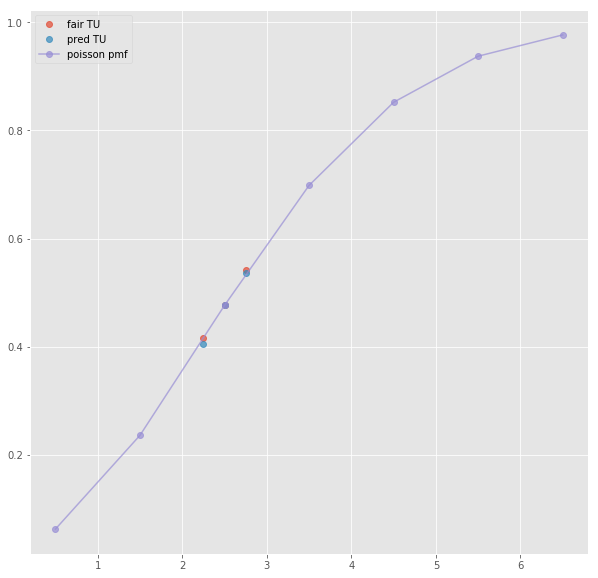

ML : 4.56 3.96 1.67
Error home:  0.0015438358626058413
Error draw:  0.005041067343601685
Error away:  0.00658487595527002

(64, 124)
(1, 19)
2.5 1.81 2.09 0.5 2.21 1.74
TO fair:  1.8660287081339717 TU fair:  2.154696132596685
TO pred:  1.866 TU fair:  2.15474
Error TO:  0.017361121292679194

Error TO:  8.244702778603674e-06



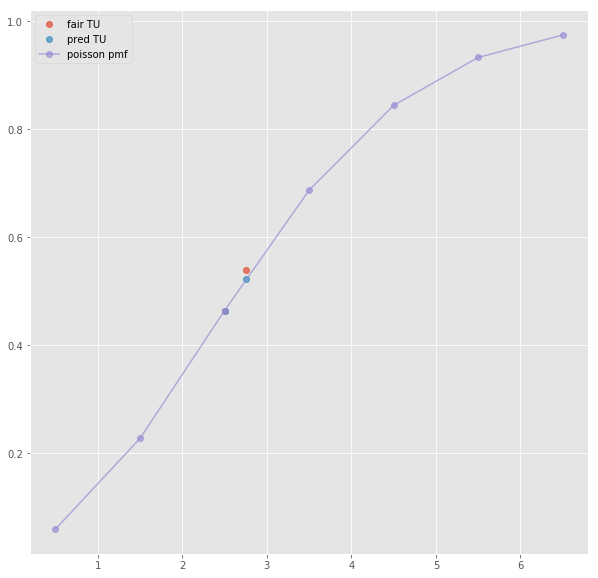

ML : 4.6 3.9 1.75
Error home:  0.0024734865501830627
Error draw:  0.0152725219815876
Error away:  0.01279882705468971

(116, 124)
(1, 19)
2.5 1.79 2.12 0.5 2.2 1.75
TO fair:  1.8443396226415094 TU fair:  2.184357541899441
TO pred:  1.84435 TU fair:  2.18434
Error TO:  0.012900860459205687

Error TO:  3.0507216447484e-06



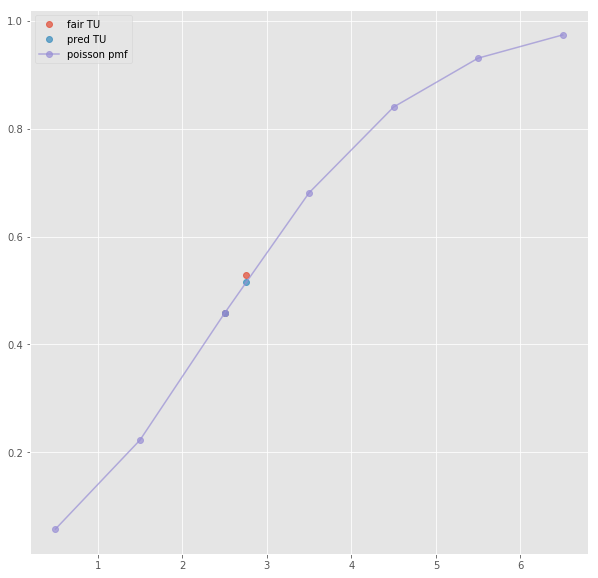

ML : 4.4 4.05 1.74
Error home:  0.0031235934953126043
Error draw:  0.0059353693442336375
Error away:  0.00905901261037112

(35, 124)
(1, 48)
2.5 1.84 2.04 0.5 2.19 1.74
TO fair:  1.9019607843137256 TU fair:  2.108695652173913
TO pred:  1.90192 TU fair:  2.10874
Error TO:  0.0003781455104843179

Error TO:  0.0007636277803875213

Error TO:  7.500463261223e-05

Error TO:  0.00048414527465057144

Error TO:  0.002377895703886218

Error TO:  1.1274553592732772e-05

Error TO:  0.0019207269811104544

Error TO:  0.0006669086840568328

Error TO:  0.0006540797657295649



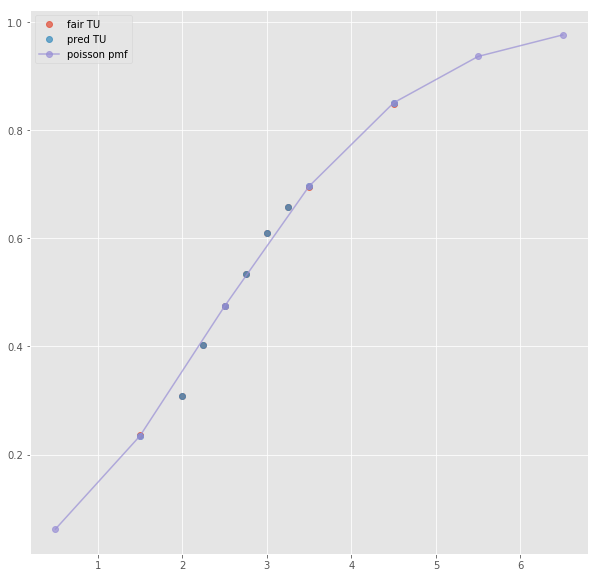

Error T1O:  0.011003511149659972
ML : 4.59 4.07 1.74
Error home:  0.0005232830677308897
Error draw:  0.004244480448252791
Error away:  0.0037209478003753516

(40, 124)
(1, 67)
2.5 1.85 2.0 0.5 2.1 1.7
TO fair:  1.9249999999999998 TU fair:  2.0810810810810807
TO pred:  1.92498 TU fair:  2.08111
Error TO:  0.0009336986852748752

Error TO:  0.014272909108854592

Error TO:  0.012261158682907725

Error TO:  0.005545211043385734

Error TO:  0.01552255840471789

Error TO:  5.39725627779486e-06

Error TO:  0.014986189913481884

Error TO:  0.010175843578042576

Error TO:  0.006369583628618836

Error TO:  0.014617083990454693

Error TO:  0.009596443700429641

Error TO:  0.01571915447633132

Error TO:  0.014211452170680011

Error TO:  0.01505820465029517



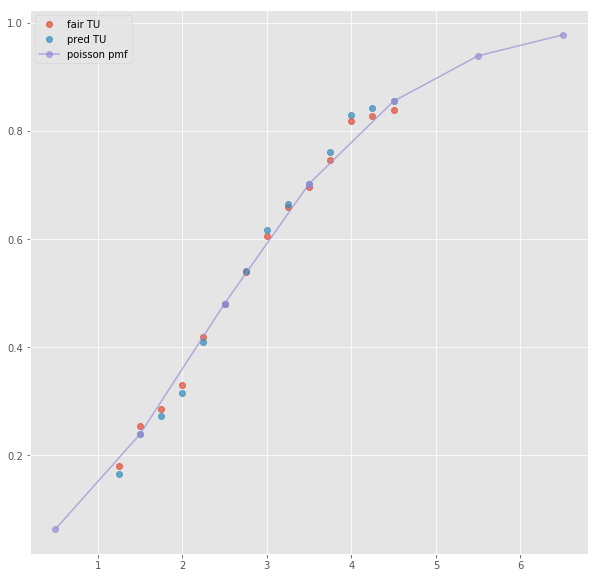

ML : 4.75 3.8 1.7
Error home:  0.014532432328782152
Error draw:  0.013220312807668333
Error away:  0.0013122796101312506

(6, 124)
(1, 34)
2.5 1.86 1.99 0.5 2.12 1.76
TO fair:  1.934673366834171 TU fair:  2.0698924731182795
TO pred:  1.93465 TU fair:  2.06992
Error TO:  0.0032105244473448757

Error TO:  0.005534823385506482

Error TO:  0.007220228855166877

Error TO:  6.242949410983911e-06

Error TO:  0.0022417911137556645



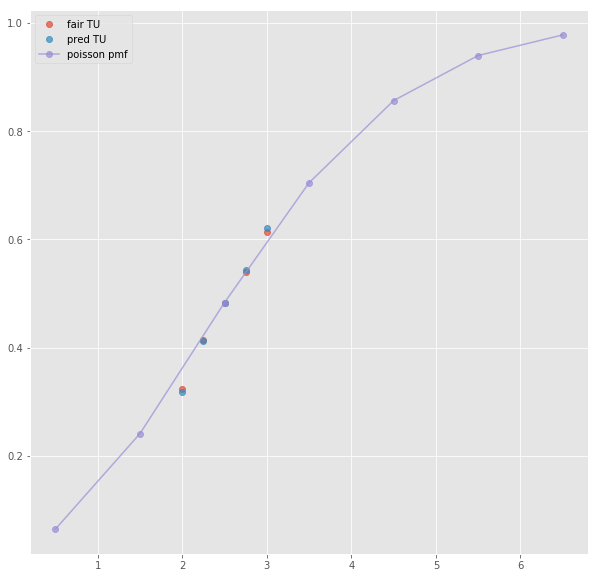

Error T1O:  0.010270088747930672
Error T1O:  0.008236787322916994
ML : 4.56 3.9 1.77
Error home:  0.00645958625384796
Error draw:  0.00994588904938895
Error away:  0.0034864744388742874

(15, 124)
(1, 40)
2.5 2.38 1.621 -0.5 1.632 2.38
TO fair:  2.468229487970389 TU fair:  1.6810924369747902
TO pred:  2.46821 TU fair:  1.6811
Error TO:  0.0002211363306986458

Error TO:  0.00444814027202467

Error TO:  0.0021523758496523326

Error TO:  3.198887500888148e-06

Error TO:  0.005897173287579105

Error TO:  0.0018943704755892132

Error TO:  0.005506562140746407



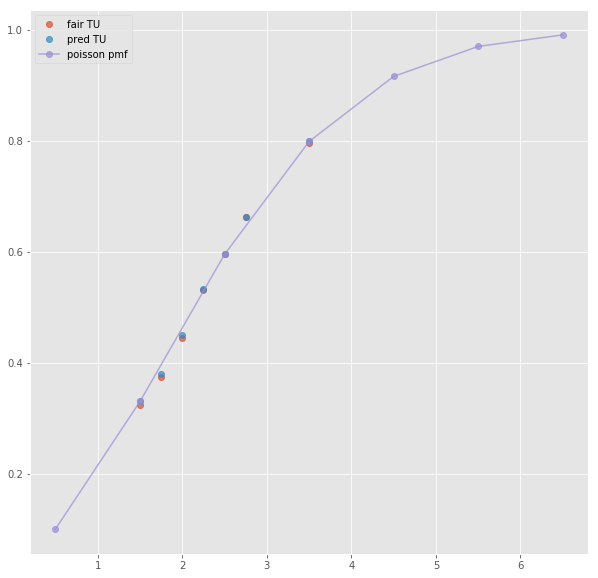

ML : 1.632 3.76 6.22
Error home:  0.0037529089557212236
Error draw:  0.008823305307640639
Error away:  0.005070133121675258

(35, 124)
(1, 19)
next list index out of range
(51, 124)
(1, 19)
next list index out of range
(114, 124)
(1, 19)
next list index out of range
(16, 124)
(1, 42)
2.5 2.38 1.621 -0.5 1.632 2.38
TO fair:  2.468229487970389 TU fair:  1.6810924369747902
TO pred:  2.46821 TU fair:  1.6811
Error TO:  0.0002211363306986458

Error TO:  0.00444814027202467

Error TO:  0.0021523758496523326

Error TO:  3.198887500888148e-06

Error TO:  0.005897173287579105

Error TO:  0.0018943704755892132

Error TO:  0.005506562140746407



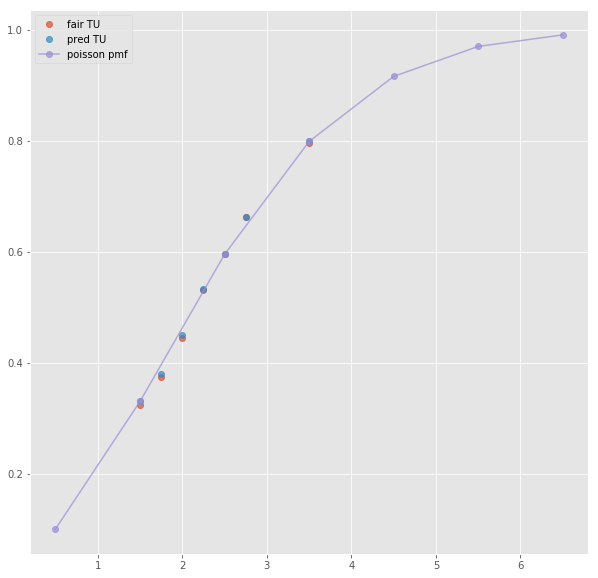

Error T1O:  9.706767128808691e-05
ML : 1.632 3.76 6.22
Error home:  0.0037529089557212236
Error draw:  0.008823305307640639
Error away:  0.005070133121675258

(15, 124)
next positional indexers are out-of-bounds
(200, 124)
(1, 45)
3.5 2.56 1.555 -0.5 1.884 2.03
TO fair:  2.6463022508038585 TU fair:  1.607421875
TO pred:  2.64627 TU fair:  1.60743
Error TO:  0.0001289260071619669

Error TO:  0.0004691139213019446

Error TO:  4.605395629186937e-06

Error TO:  0.0006430701462087351

Error TO:  0.00015925158913021598

Error TO:  0.0038446751249519018

Error TO:  0.019606462755546117

Error TO:  0.0006288450515935518



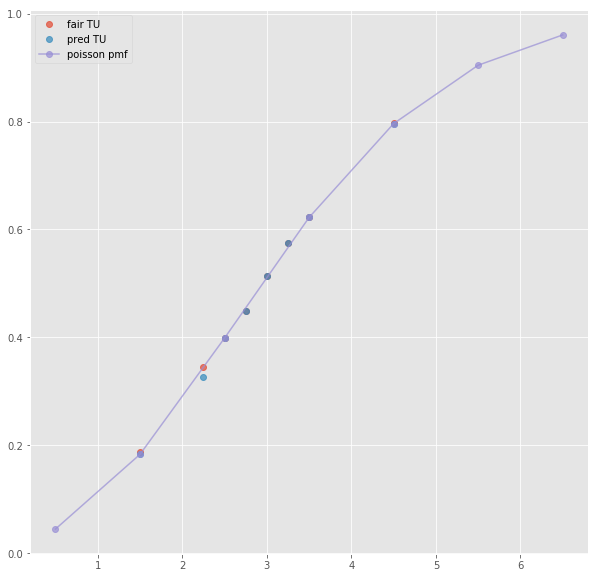

ML : 1.884 4.03 3.99
Error home:  0.003084053532055764
Error draw:  0.014768214859830181
Error away:  0.011684148615673184

(183, 124)
(1, 29)
2.5 1.57 2.36 -0.5 1.83 2.04
TO fair:  1.6652542372881358 TU fair:  2.5031847133757963
TO pred:  1.66527 TU fair:  2.50316
Error TO:  0.009370082895225451

Error TO:  0.0010642497050957767

Error TO:  5.684152632801087e-06

Error TO:  0.009779179665453441



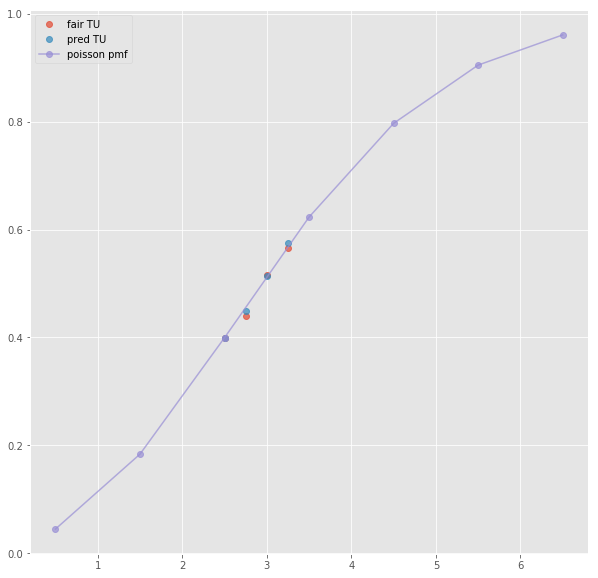

ML : 1.83 3.96 3.86
Error home:  0.010670861773835583
Error draw:  0.013698629257301198
Error away:  0.003027934461719506

(221, 124)
(1, 25)
2.5 1.63 2.4 -0.5 1.89 2.06
TO fair:  1.6791666666666667 TU fair:  2.4723926380368098
TO pred:  1.67918 TU fair:  2.47237
Error TO:  0.009857052948382017

Error TO:  0.005768968187559564

Error TO:  4.728764426698007e-06

Error TO:  0.012143544361985725



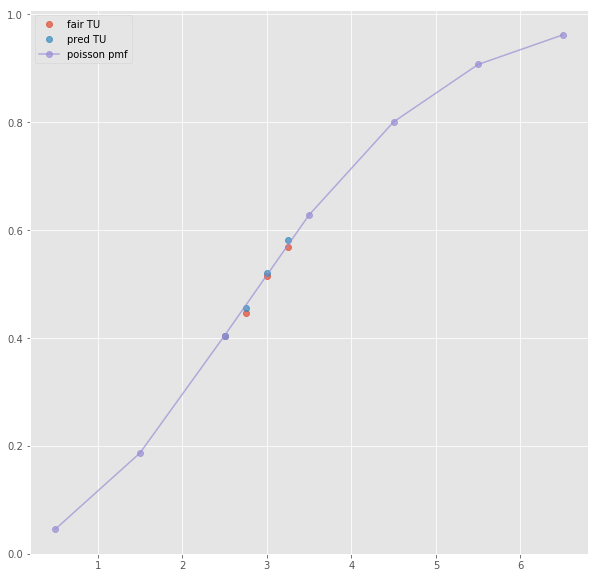

ML : 1.87 3.9 3.95
Error home:  0.00947644070710496
Error draw:  0.018703957300408275
Error away:  0.009227305209441788

(585, 124)
(1, 27)
2.5 1.6 2.47 -0.5 1.89 2.06
TO fair:  1.6477732793522268 TU fair:  2.54375
TO pred:  1.64777 TU fair:  2.54375
Error TO:  0.0020365672102039545

Error TO:  0.009125967093256415

Error TO:  1.2077971988100344e-06

Error TO:  0.0015133164309575342



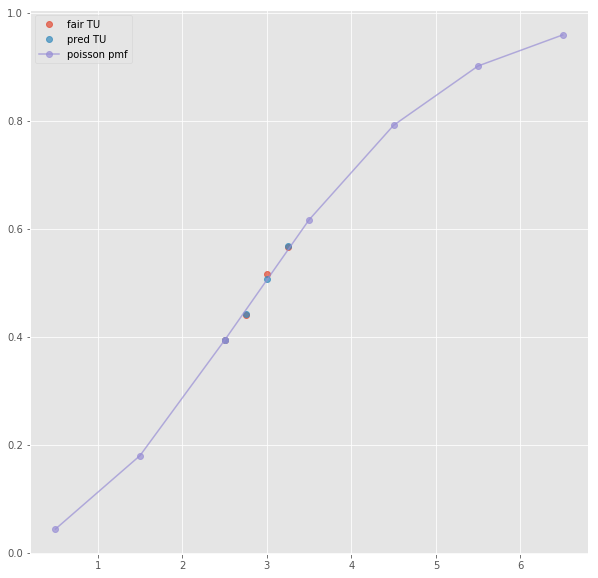

ML : 1.88 3.9 3.95
Error home:  0.010811804328698993
Error draw:  0.02138816162117077
Error away:  0.010576545121954967

(154, 124)
(1, 47)
3.5 2.56 1.555 -0.5 1.884 2.03
TO fair:  2.6463022508038585 TU fair:  1.607421875
TO pred:  2.64627 TU fair:  1.60743
Error TO:  0.0001289260071619669

Error TO:  0.0004691139213019446

Error TO:  4.605395629186937e-06

Error TO:  0.0006430701462087351

Error TO:  0.00015925158913021598

Error TO:  0.0038446751249519018

Error TO:  0.019606462755546117

Error TO:  0.0006288450515935518



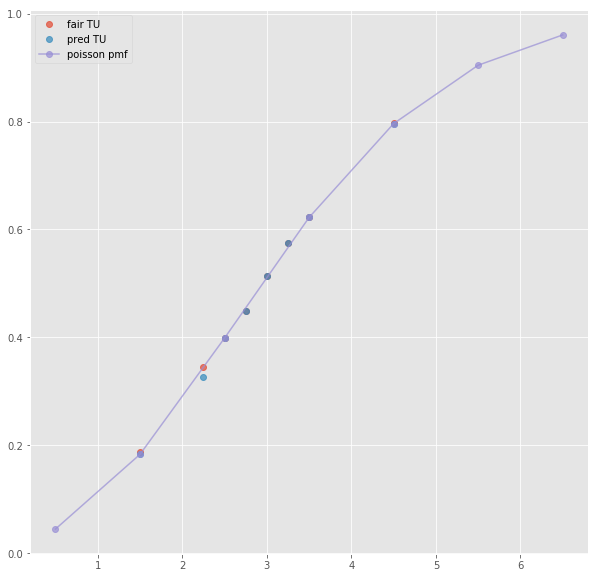

Error T1O:  0.007668498043523431
ML : 1.884 4.03 3.99
Error home:  0.003084053532055764
Error draw:  0.014768214859830181
Error away:  0.011684148615673184

(53, 124)
next positional indexers are out-of-bounds
(20, 124)
(1, 40)
2.5 2.11 1.769 -1.5 2.56 1.546
TO fair:  2.1927642736009045 TU fair:  1.8383886255924171
TO pred:  2.19281 TU fair:  1.83836
Error TO:  0.0008104700931526043

Error TO:  0.00014864856460850007

Error TO:  0.004490092831427844

Error TO:  9.509858450829078e-06

Error TO:  0.002292190535220895

Error TO:  0.0001749134628313831

Error TO:  0.0014640445835369942



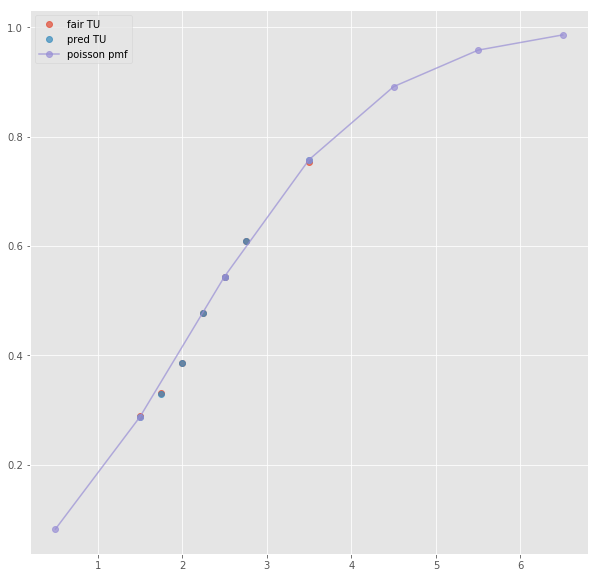

ML : 1.471 4.18 8.09
Error home:  0.012772799204917917
Error draw:  0.007038162293897754
Error away:  0.019810785214204776

(180, 124)
(1, 20)
next list index out of range
(34, 124)
(1, 18)
next list index out of range
(60, 124)
(1, 20)
next list index out of range
(21, 124)
(1, 42)
2.5 2.11 1.769 -1.5 2.56 1.546
TO fair:  2.1927642736009045 TU fair:  1.8383886255924171
TO pred:  2.19281 TU fair:  1.83836
Error TO:  0.0008104700931526043

Error TO:  0.00014864856460850007

Error TO:  0.004490092831427844

Error TO:  9.509858450829078e-06

Error TO:  0.002292190535220895

Error TO:  0.0001749134628313831

Error TO:  0.0014640445835369942



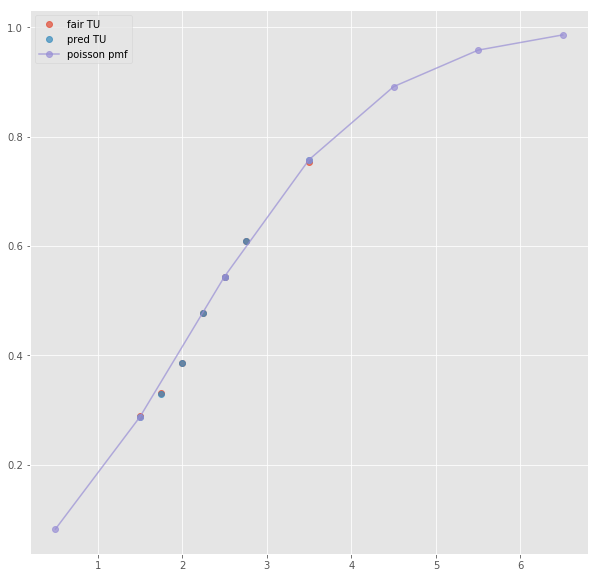

Error T1O:  0.010957519267526417
ML : 1.471 4.18 8.09
Error home:  0.012772799204917917
Error draw:  0.007038162293897754
Error away:  0.019810785214204776

(2, 124)
(1, 62)
2.5 2.075 1.725 -1.5 2.425 1.525
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20286 TU fair:  1.83135
Error TO:  0.006166961368480883

Error TO:  0.012214611881030346

Error TO:  0.008459417505759348

Error TO:  0.013464904016729812

Error TO:  7.944217971178613e-06

Error TO:  0.014284737492228028

Error TO:  0.00139622024779118

Error TO:  0.004384148318001435

Error TO:  0.009614677377671854

Error TO:  0.01980480616583484

Error TO:  0.020474852208014843

Error TO:  0.02262909027312815

Error TO:  0.019857475386065415



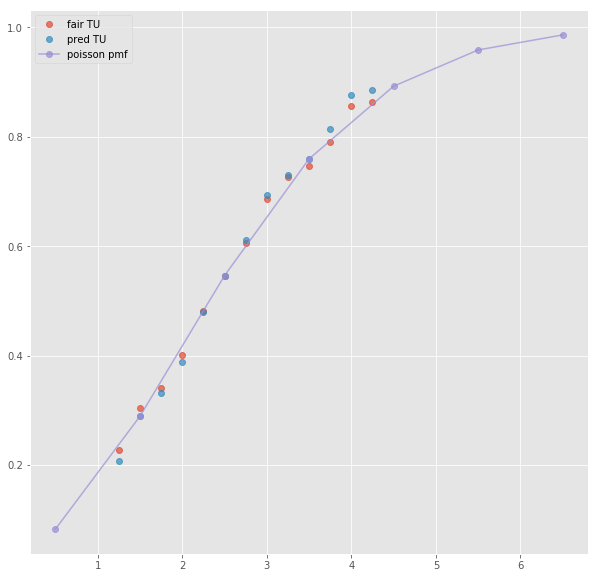

ML : 1.5 3.8 7.5
Error home:  0.022549475257000906
Error draw:  0.02825343491775456
Error away:  0.005703875701325162

(6, 124)
(1, 32)
2.5 2.16 1.74 -1.5 2.42 1.6
TO fair:  2.2413793103448274 TU fair:  1.8055555555555551
TO pred:  2.24138 TU fair:  1.80555
Error TO:  0.0028168649896084808

Error TO:  0.005164528572104143

Error TO:  1.372780643049687e-07

Error TO:  0.0032750431668315816

Error TO:  0.006654928236211499



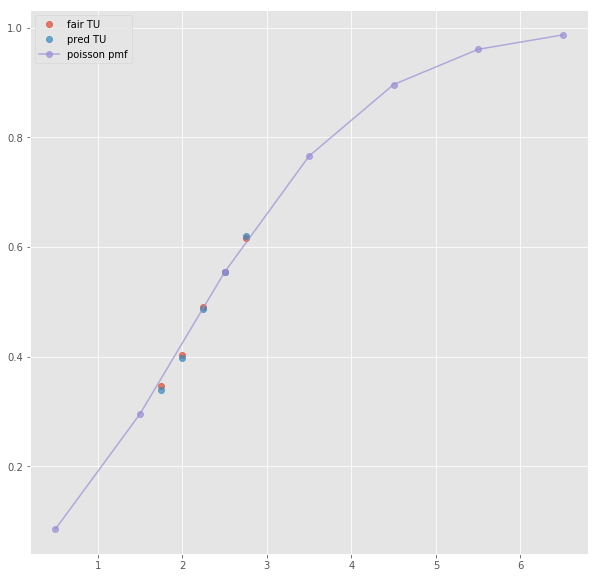

Error T1O:  0.006853656568801658
ML : 1.49 4.16 7.85
Error home:  0.01751042315312712
Error draw:  0.015614624695807267
Error away:  0.001895671714160052

(165, 124)
(1, 41)
3.5 2.49 1.584 -1.5 1.884 2.03
TO fair:  2.571969696969697 TU fair:  1.6361445783132529
TO pred:  2.57201 TU fair:  1.63613
Error TO:  0.004051818374788407

Error TO:  0.0018474088729713012

Error TO:  6.092551387004708e-06

Error TO:  0.0001387253480231998

Error TO:  0.003625956743368519

Error TO:  0.002244258580947678

Error TO:  0.0013243695567189406

Error TO:  0.026044656607852656



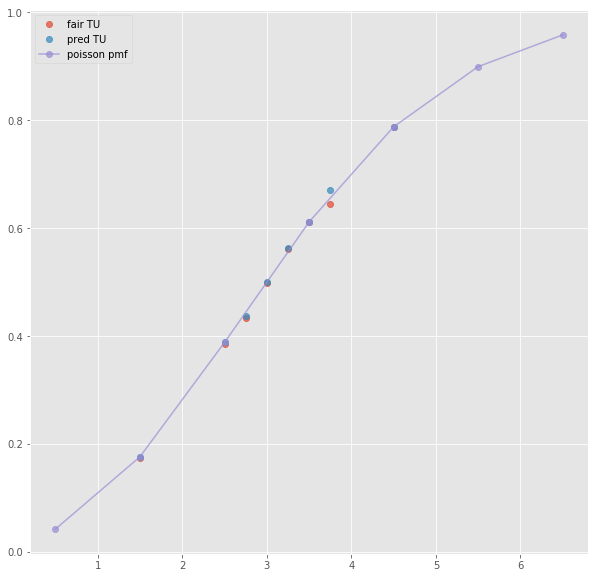

ML : 1.294 5.81 11.05
Error home:  0.0012215755905825576
Error draw:  0.006251937903576421
Error away:  0.007473420482222562

(232, 124)
(1, 27)
3.5 2.38 1.56 -1.5 1.86 2.01
TO fair:  2.5256410256410255 TU fair:  1.6554621848739497
TO pred:  2.52566 TU fair:  1.65545
Error TO:  0.003881295522484285

Error TO:  0.0015677370655623468

Error TO:  2.974545408040985e-06

Error TO:  0.007727557928433548



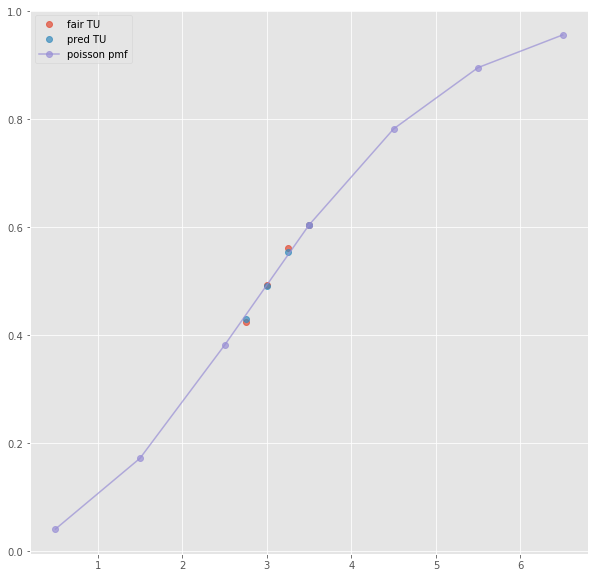

ML : 1.26 5.76 9.96
Error home:  0.0012431691357653873
Error draw:  0.0032217722258485737
Error away:  0.0019786754706161147

(286, 124)
(1, 21)
next list index out of range
(797, 124)
(1, 25)
3.5 2.42 1.62 -1.5 1.91 2.04
TO fair:  2.493827160493827 TU fair:  1.669421487603306
TO pred:  2.49383 TU fair:  1.66942
Error TO:  0.0008823861489047902

Error TO:  0.010566549294181327

Error TO:  4.5657236519280886e-07

Error TO:  0.008117660475916721



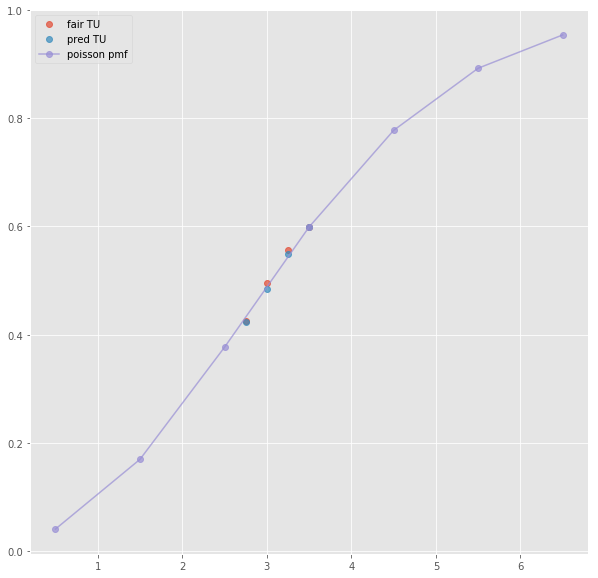

ML : 1.29 5.7 11.0
Error home:  0.0030845431532369183
Error draw:  0.008258814944602372
Error away:  0.0113434078475462

(142, 124)
(1, 43)
3.5 2.49 1.584 -1.5 1.884 2.03
TO fair:  2.571969696969697 TU fair:  1.6361445783132529
TO pred:  2.57201 TU fair:  1.63613
Error TO:  0.004051818374788407

Error TO:  0.0018474088729713012

Error TO:  6.092551387004708e-06

Error TO:  0.0001387253480231998

Error TO:  0.003625956743368519

Error TO:  0.002244258580947678

Error TO:  0.0013243695567189406

Error TO:  0.026044656607852656



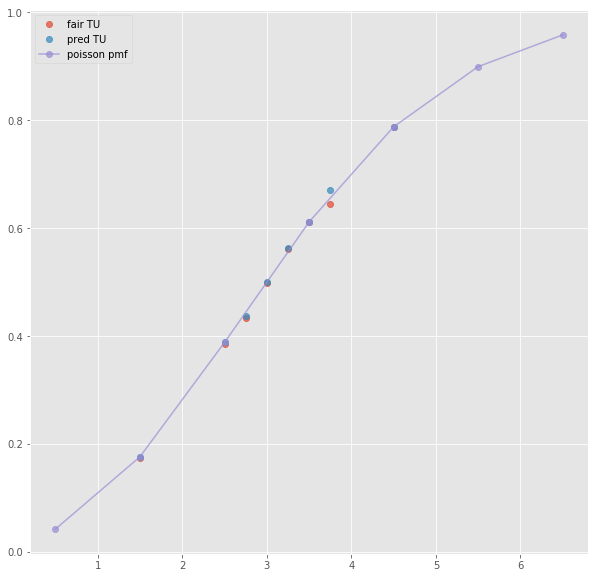

Error T1O:  0.009638158055433999
ML : 1.294 5.81 11.05
Error home:  0.0012215755905825576
Error draw:  0.006251937903576421
Error away:  0.007473420482222562

(110, 124)
(1, 71)
3.5 2.35 1.575 -1.5 1.92 2.01
TO fair:  2.492063492063492 TU fair:  1.6702127659574466
TO pred:  2.49211 TU fair:  1.67019
Error TO:  0.0051263973221491455

Error TO:  0.021976086443525666

Error TO:  0.0019368703166963153

Error TO:  7.488602181360271e-06

Error TO:  0.01882075491579302

Error TO:  0.009711746061819015

Error TO:  0.020633743616199962

Error TO:  0.010063733266538644

Error TO:  0.0024841762151132096

Error TO:  0.025743498194506387

Error TO:  0.015620310629330503

Error TO:  0.01998165238029259

Error TO:  0.009045879570576731

Error TO:  0.02406759851161855

Error TO:  0.02169602144808072

Error TO:  0.01846753621768213

Error TO:  0.03005821627872178



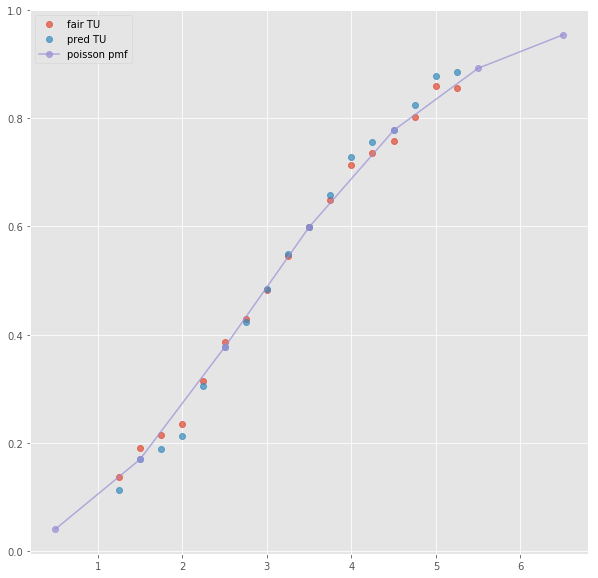

ML : 1.285 5.5 10.0
Error home:  0.0026050522193927783
Error draw:  0.009608579413380725
Error away:  0.007003531116010209

(87, 124)
next positional indexers are out-of-bounds
(12, 124)
(1, 39)
2.5 2.59 1.534 -0.5 2.4 1.625
TO fair:  2.6883963494132983 TU fair:  1.5922779922779924
TO pred:  2.68842 TU fair:  1.59227
Error TO:  0.002896366960174368

Error TO:  0.010796113324526097

Error TO:  3.2722878828828073e-06

Error TO:  0.003856732246459549

Error TO:  0.0008823545735465732

Error TO:  0.004294109911194166

Error TO:  0.016398165669539888



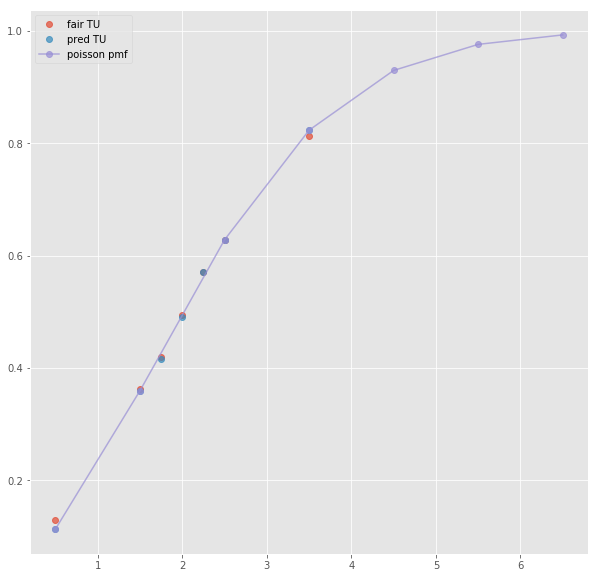

ML : 2.4 3.07 3.36
Error home:  0.003108024409601784
Error draw:  0.022152852074875884
Error away:  0.019045067631122348

(175, 124)
(1, 23)
next list index out of range
(39, 124)
(1, 23)
next list index out of range
(51, 124)
(1, 23)
next list index out of range
(9, 124)
(1, 41)
2.5 2.59 1.534 -0.5 2.4 1.625
TO fair:  2.6883963494132983 TU fair:  1.5922779922779924
TO pred:  2.68842 TU fair:  1.59227
Error TO:  0.002896366960174368

Error TO:  0.010796113324526097

Error TO:  3.2722878828828073e-06

Error TO:  0.003856732246459549

Error TO:  0.0008823545735465732

Error TO:  0.004294109911194166

Error TO:  0.016398165669539888



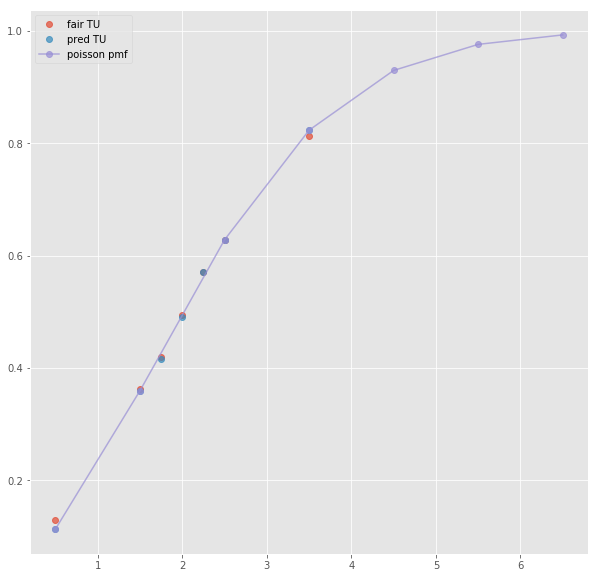

Error T1O:  0.012905842352726626
ML : 2.4 3.07 3.36
Error home:  0.003108024409601784
Error draw:  0.022152852074875884
Error away:  0.019045067631122348

(3, 124)
(1, 60)
2.5 2.375 1.55 -0.5 2.3 1.6
TO fair:  2.5322580645161286 TU fair:  1.6526315789473682
TO pred:  2.53226 TU fair:  1.65263
Error TO:  0.0021684298345053254

Error TO:  0.0057745688296310105

Error TO:  0.011485125092901421

Error TO:  0.02052519066727526

Error TO:  3.0183757210311413e-07

Error TO:  0.01272463590399564

Error TO:  0.0016168934737302298

Error TO:  0.014620705993667854

Error TO:  0.010443100374867842

Error TO:  0.01568727962067029

Error TO:  0.022955544154362517

Error TO:  0.02984359962820593

Error TO:  0.03081889920121217



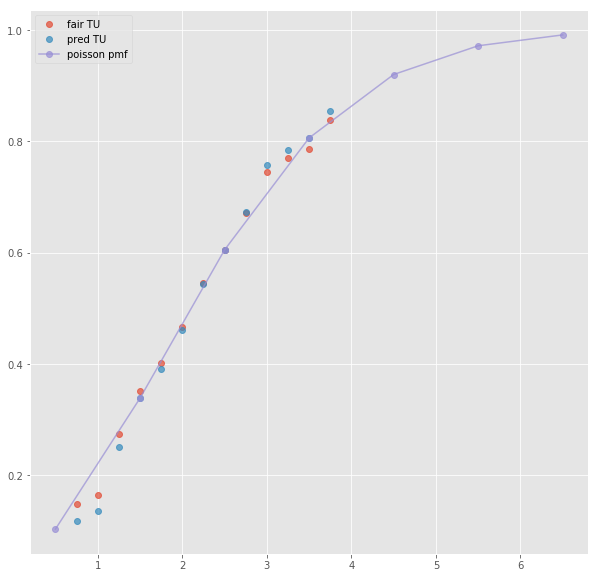

ML : 2.3 3.1 3.3
Error home:  0.0002229057923854305
Error draw:  0.020048889675120474
Error away:  0.019825777436521308

(7, 124)
(1, 33)
2.5 2.53 1.55 -0.5 2.37 1.62
TO fair:  2.632258064516129 TU fair:  1.6126482213438735
TO pred:  2.63225 TU fair:  1.61265
Error TO:  0.002039392418569097

Error TO:  1.163918886992743e-06

Error TO:  0.003411245285109832

Error TO:  0.0013217522700978424

Error TO:  0.002878698702960536



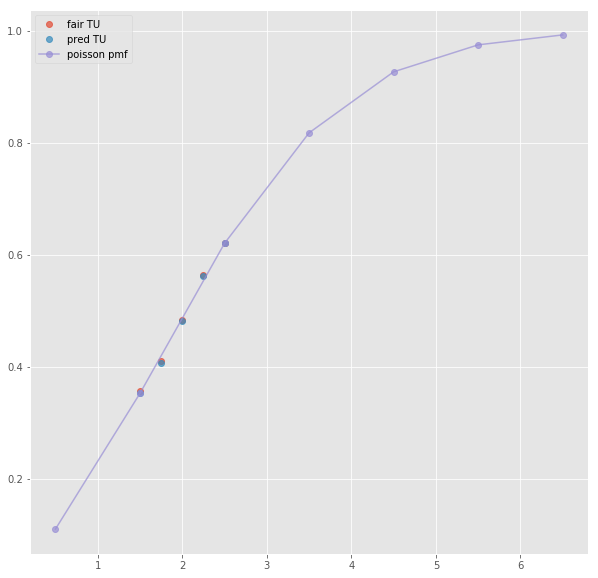

Error T1O:  0.009792941625910212
ML : 2.4 3.07 3.36
Error home:  0.00538496770079383
Error draw:  0.02458049155378611
Error away:  0.019195119998447918

(14, 124)
(1, 41)
2.5 1.925 1.952 0.5 1.775 2.14
TO fair:  1.9861680327868854 TU fair:  2.014025974025974
TO pred:  1.98619 TU fair:  2.014
Error TO:  0.0011119245381768783

Error TO:  0.002825884203969009

Error TO:  0.0029748131309377257

Error TO:  0.005156960542863853

Error TO:  0.005256860361778526

Error TO:  5.5684994959559475e-06

Error TO:  0.004632676516276746

Error TO:  0.0009711900203277501



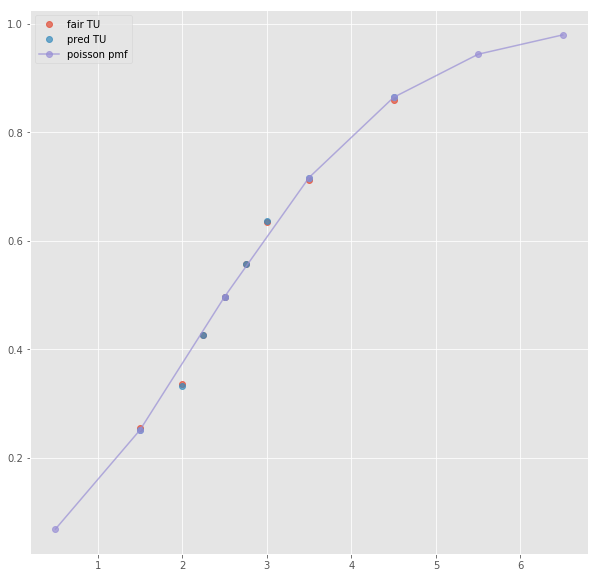

ML : 3.47 3.57 2.14
Error home:  0.014111928323978284
Error draw:  0.01625477250098023
Error away:  0.0021428395853412274

(12, 124)
(1, 17)
2.5 1.94 1.92 0.5 1.73 2.17
TO fair:  2.010416666666667 TU fair:  1.9896907216494846
TO pred:  2.01041 TU fair:  1.9897
Error TO:  1.6494457232285598e-06



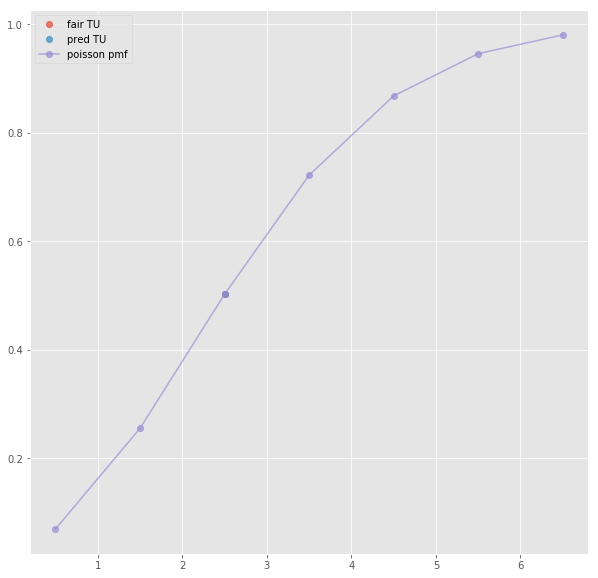

ML : 3.43 3.28 2.17
Error home:  0.024105333689315778
Error draw:  0.03182570822631148
Error away:  0.007720226017556897

(41, 124)
(1, 19)
2.5 1.99 1.91 0.5 1.75 2.2
TO fair:  2.0418848167539263 TU fair:  1.959798994974874
TO pred:  2.04185 TU fair:  1.95983
Error TO:  0.013072176726752038

Error TO:  8.350898474895896e-06



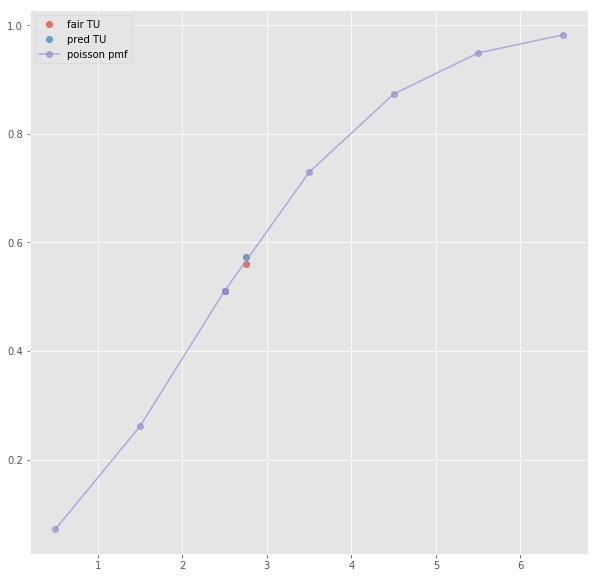

ML : 3.45 3.4 2.16
Error home:  0.021828912312505833
Error draw:  0.02266545201473741
Error away:  0.0008367787352899225

(56, 124)
(1, 17)
2.5 1.97 1.93 0.5 1.78 2.16
TO fair:  2.0207253886010363 TU fair:  1.9796954314720812
TO pred:  2.02072 TU fair:  1.9797
Error TO:  1.3196616388544413e-06



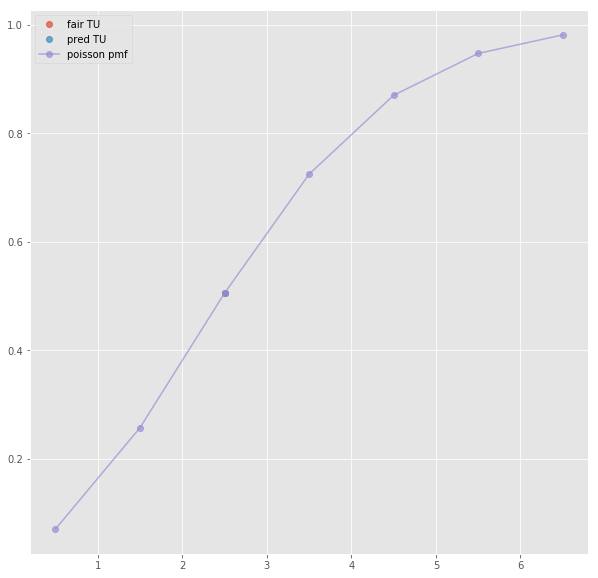

ML : 3.5 3.35 2.14
Error home:  0.020240308735598955
Error draw:  0.02763817606928126
Error away:  0.007397541785283457

(7, 124)
(1, 43)
2.5 1.925 1.952 0.5 1.775 2.14
TO fair:  1.9861680327868854 TU fair:  2.014025974025974
TO pred:  1.98619 TU fair:  2.014
Error TO:  0.0011119245381768783

Error TO:  0.002825884203969009

Error TO:  0.0029748131309377257

Error TO:  0.005156960542863853

Error TO:  0.005256860361778526

Error TO:  5.5684994959559475e-06

Error TO:  0.004632676516276746

Error TO:  0.0009711900203277501



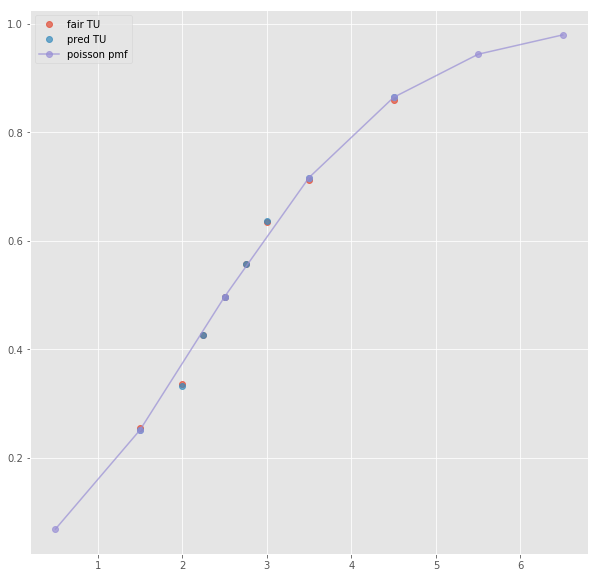

Error T1O:  0.0065140831113966735
ML : 3.47 3.57 2.14
Error home:  0.014111928323978284
Error draw:  0.01625477250098023
Error away:  0.0021428395853412274

(18, 124)
(1, 12)
next list index out of range
(1, 124)
next positional indexers are out-of-bounds
(32, 124)
(1, 41)
2.5 2.49 1.574 0.5 1.621 2.41
TO fair:  2.581956797966963 TU fair:  1.6321285140562247
TO pred:  2.58199 TU fair:  1.63211
Error TO:  0.009848190115142541

Error TO:  0.0004076148958197523

Error TO:  0.001700222654123229

Error TO:  4.980364745221788e-06

Error TO:  0.0006288080401548601

Error TO:  2.677923834515372e-06

Error TO:  0.0005087774817902346

Error TO:  0.021278739253633328



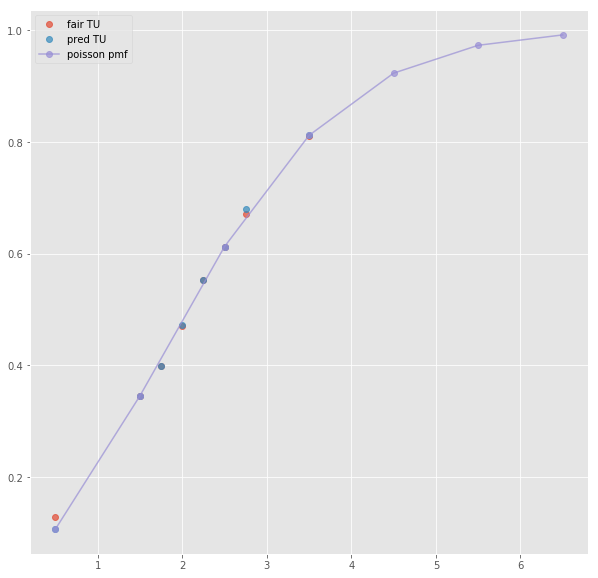

ML : 3.41 3.02 2.41
Error home:  0.028862684023468754
Error draw:  0.031775041729161235
Error away:  0.002912171118839124

(44, 124)
(1, 23)
next list index out of range
(73, 124)
(1, 21)
next list index out of range
(108, 124)
(1, 23)
next list index out of range
(21, 124)
(1, 43)
2.5 2.49 1.574 0.5 1.621 2.41
TO fair:  2.581956797966963 TU fair:  1.6321285140562247
TO pred:  2.58199 TU fair:  1.63211
Error TO:  0.009848190115142541

Error TO:  0.0004076148958197523

Error TO:  0.001700222654123229

Error TO:  4.980364745221788e-06

Error TO:  0.0006288080401548601

Error TO:  2.677923834515372e-06

Error TO:  0.0005087774817902346

Error TO:  0.021278739253633328



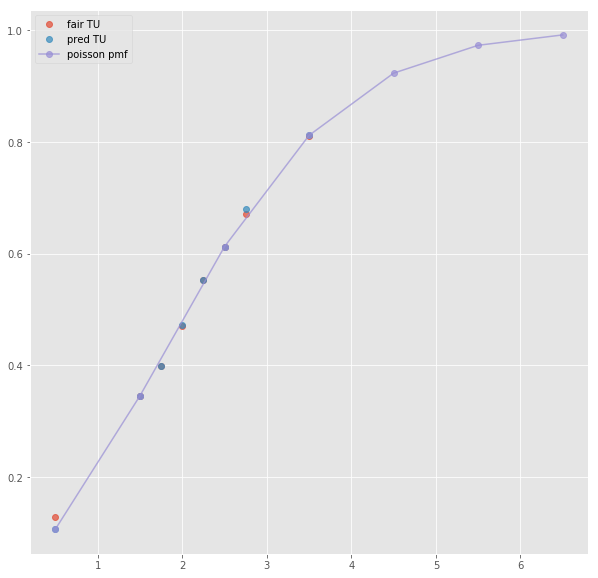

Error T1O:  0.015241072403061828
ML : 3.41 3.02 2.41
Error home:  0.028862684023468754
Error draw:  0.031775041729161235
Error away:  0.002912171118839124

(13, 124)
next positional indexers are out-of-bounds
(22, 124)
next positional indexers are out-of-bounds
(36, 124)
(1, 45)
3.5 2.13 1.763 -0.5 2.11 1.8
TO fair:  2.2081678956324446 TU fair:  1.8276995305164319
TO pred:  2.20819 TU fair:  1.82768
Error TO:  0.00457744600949328

Error TO:  0.003846064841598662

Error TO:  4.533248883664687e-06

Error TO:  0.0008370657135753357

Error TO:  0.005424530940745131

Error TO:  0.006382083702779706

Error TO:  0.001219550557637561

Error TO:  0.0027706197526807808

Error TO:  0.0009885239502897547



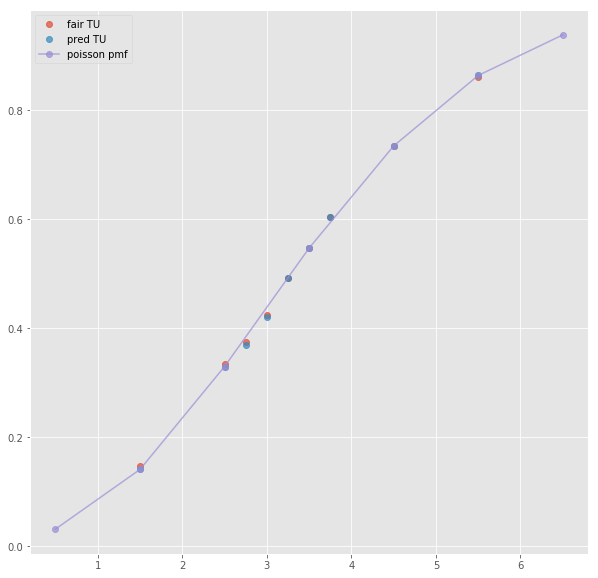

ML : 2.11 4.02 3.16
Error home:  0.004288988969158858
Error draw:  0.018083736952251767
Error away:  0.01379488675220758

(47, 124)
(1, 23)
3.5 2.09 1.73 -0.5 2.08 1.76
TO fair:  2.208092485549133 TU fair:  1.8277511961722492
TO pred:  2.20812 TU fair:  1.82773
Error TO:  0.00452371760704029

Error TO:  5.643141217037684e-06

Error TO:  0.005033789794788079



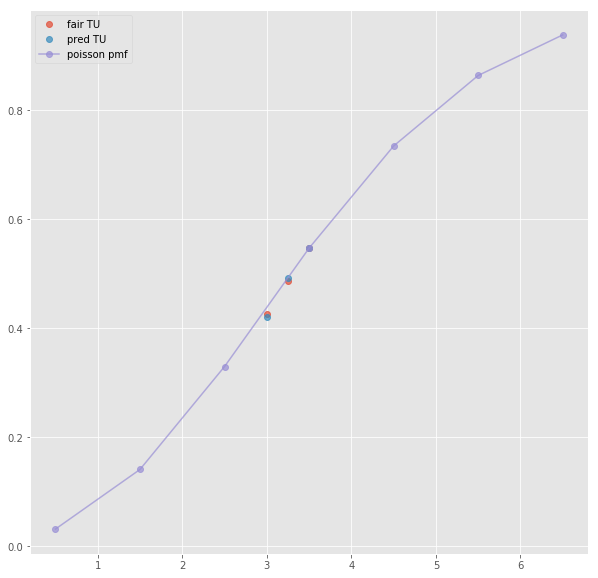

ML : 2.09 3.76 3.11
Error home:  0.009462490773566201
Error draw:  0.028021532831741747
Error away:  0.018558854581555984

(96, 124)
(1, 19)
3.5 2.16 1.76 -0.5 2.11 1.82
TO fair:  2.2272727272727275 TU fair:  1.8148148148148149
TO pred:  2.22731 TU fair:  1.81479
Error TO:  7.513410291981604e-06

Error TO:  0.003818947622982183



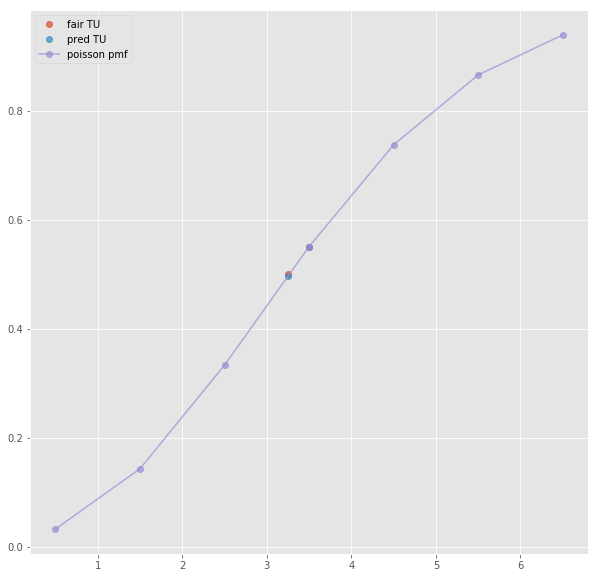

ML : 2.1 3.9 3.15
Error home:  0.009626818548345017
Error draw:  0.022515046176904724
Error away:  0.012888212360265938

(134, 124)
(1, 23)
3.5 2.14 1.77 -0.5 2.08 1.84
TO fair:  2.209039548022599 TU fair:  1.8271028037383177
TO pred:  2.20905 TU fair:  1.8271
Error TO:  3.9343432590821514e-05

Error TO:  2.1418518369453743e-06

Error TO:  0.002720598126090046



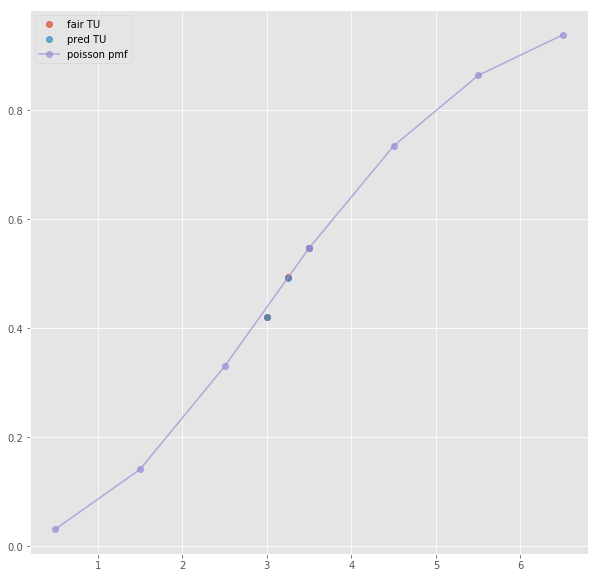

ML : 2.07 3.95 3.2
Error home:  0.008758006142554009
Error draw:  0.02090097936869137
Error away:  0.012143045932229035

(31, 124)
(1, 47)
3.5 2.13 1.763 -0.5 2.12 1.787
TO fair:  2.2081678956324446 TU fair:  1.8276995305164319
TO pred:  2.20819 TU fair:  1.82768
Error TO:  0.00457744600949328

Error TO:  0.003846064841598662

Error TO:  4.533248883664687e-06

Error TO:  0.0009860856305182741

Error TO:  0.005424530940745131

Error TO:  0.006382083702779706

Error TO:  0.00236412034256106

Error TO:  0.0027706197526807808

Error TO:  0.0009885239502897547



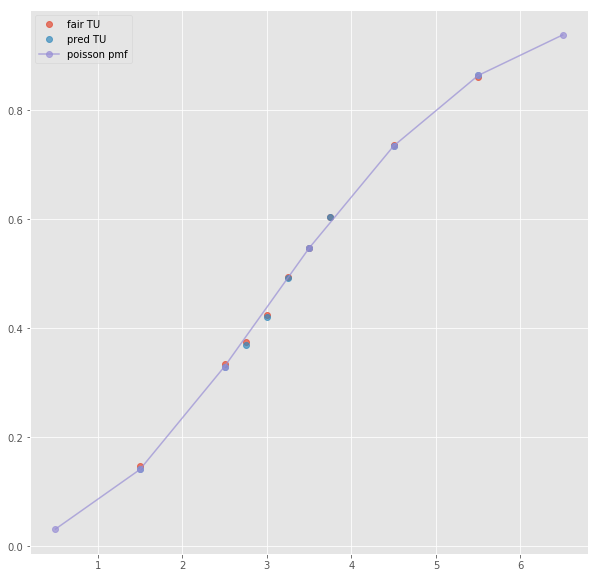

Error T1O:  0.005927807005102426
ML : 2.12 4.0 3.14
Error home:  0.003890859648316758
Error draw:  0.01878692373781443
Error away:  0.014895961791227375

(28, 124)
(1, 72)
3.5 2.05 1.75 -0.5 2.05 1.75
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17143 TU fair:  1.85365
Error TO:  0.02360742748382061

Error TO:  0.020972261654221058

Error TO:  0.016115494376363837

Error TO:  3.0297764003206495e-07

Error TO:  0.001611643331193513

Error TO:  0.018030973303405085

Error TO:  0.02061073936123603

Error TO:  0.01978582956682906

Error TO:  0.003349886513172806

Error TO:  0.014094273160439208

Error TO:  0.0060675203225143415

Error TO:  0.002994715676161386

Error TO:  0.0031308914789053843

Error TO:  0.009170599354506037

Error TO:  0.011001073884264995

Error TO:  0.014912815888843328



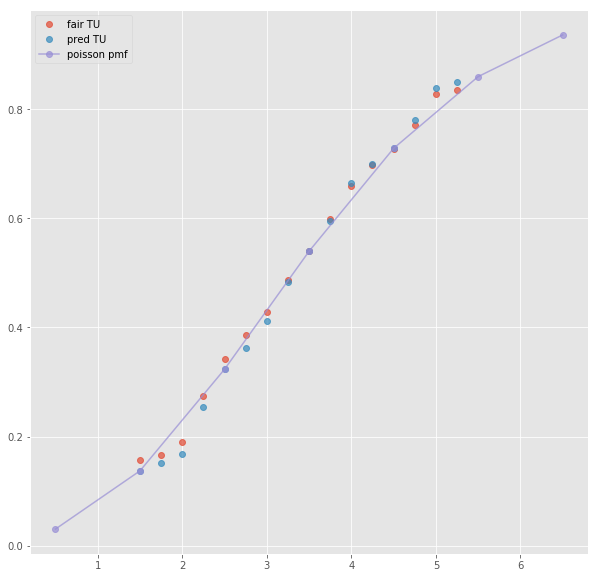

ML : 2.2 3.75 2.9
Error home:  0.034149634321918254
Error draw:  0.030063045945806
Error away:  0.004086350068255917

(10, 124)
(1, 33)
3.5 2.08 1.79 -0.5 2.07 1.79
TO fair:  2.1620111731843576 TU fair:  1.860576923076923
TO pred:  2.162 TU fair:  1.86059
Error TO:  0.011787990201913456

Error TO:  0.010150581396173641

Error TO:  2.3903601555907983e-06

Error TO:  0.004222434069837244

Error TO:  0.0004964063096369875



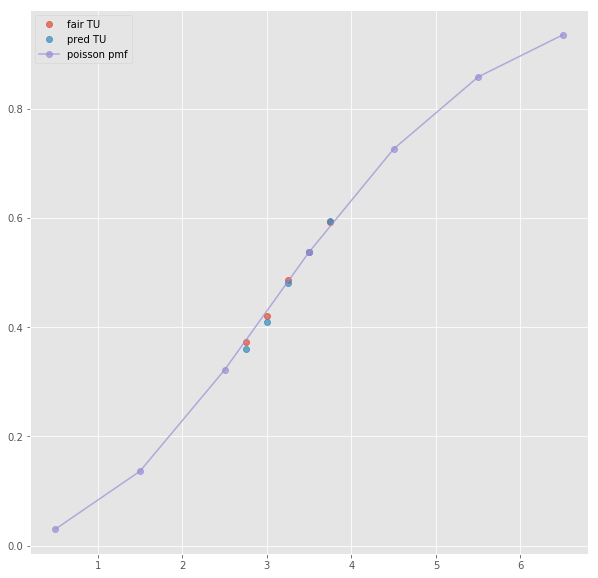

Error T1O:  0.0016194212035222089
ML : 2.09 4.01 3.19
Error home:  0.004259340014529156
Error draw:  0.019991654264451236
Error away:  0.015732309194961214

(366, 124)
(1, 51)
3.5 2.27 1.689 1.5 1.775 2.16
TO fair:  2.343990526939017 TU fair:  1.7440528634361232
TO pred:  2.34398 TU fair:  1.74406
Error TO:  0.0021338557905854483

Error TO:  0.00251201247094357

Error TO:  1.9159860958906094e-06

Error TO:  5.1148834862763115e-05

Error TO:  0.002627938163413668

Error TO:  0.00040176463843122345

Error TO:  6.71791707215208e-05

Error TO:  0.0047444558829177474

Error TO:  0.000783006881793058



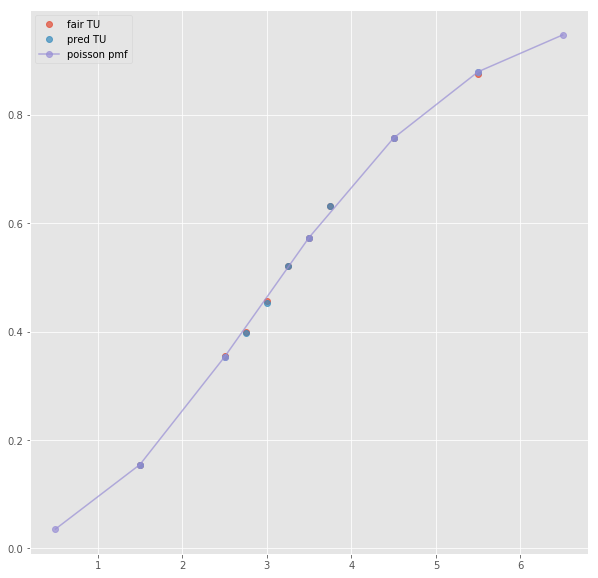

ML : 6.92 5.02 1.4480000000000002
Error home:  0.002806432929600311
Error draw:  0.012390874486690323
Error away:  0.009584554795661782

(432, 124)
(1, 31)
3.5 2.28 1.62 1.5 1.72 2.17
TO fair:  2.4074074074074074 TU fair:  1.710526315789474
TO pred:  2.4074 TU fair:  1.71053
Error TO:  0.006489889842316687

Error TO:  0.008239450143225135

Error TO:  1.2781104415382494e-06

Error TO:  0.0016850826471371816



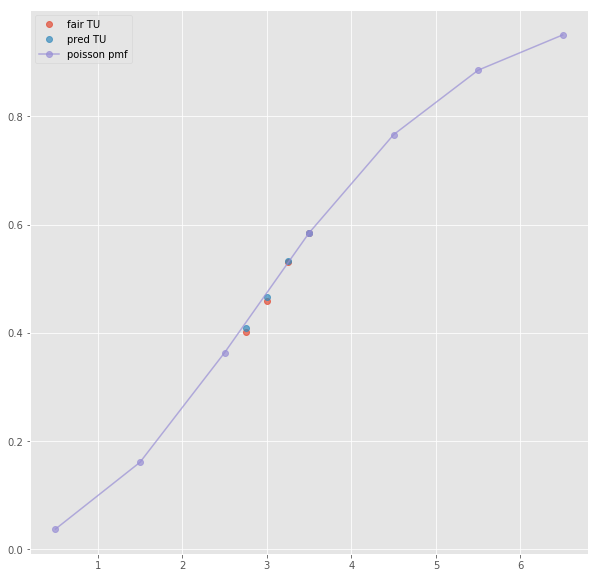

ML : 6.56 5.16 1.41
Error home:  0.0012472520449484381
Error draw:  0.0001474459242835069
Error away:  0.0013946378159337414

(455, 124)
(1, 26)
3.5 2.35 1.66 1.5 1.76 2.23
TO fair:  2.41566265060241 TU fair:  1.7063829787234044
TO pred:  2.41569 TU fair:  1.70637
Error TO:  0.0010650907605762594

Error TO:  4.686733711956048e-06

Error TO:  0.006445771870048855



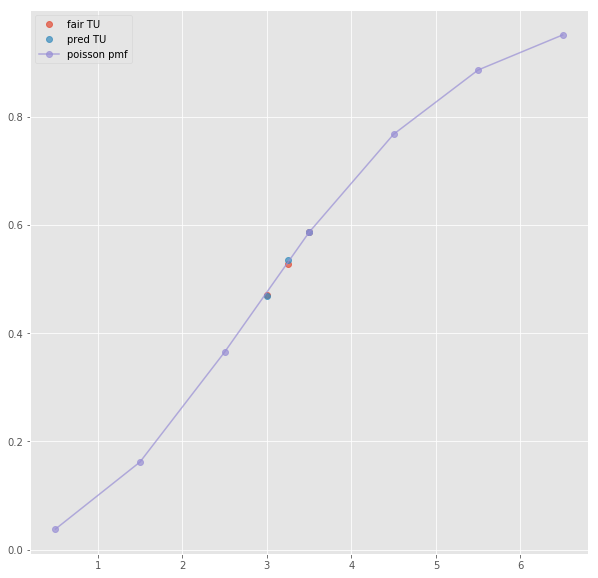

ML : 6.6 5.0 1.45
Error home:  0.0005045778786147703
Error draw:  0.00789452712823907
Error away:  0.007389835471137252

(1063, 124)
(1, 30)
3.5 2.29 1.69 1.5 1.79 2.19
TO fair:  2.3550295857988166 TU fair:  1.737991266375546
TO pred:  2.35503 TU fair:  1.73799
Error TO:  0.005568923082352462

Error TO:  0.0078052032128591575

Error TO:  7.468244439534644e-08

Error TO:  0.007836707423908185



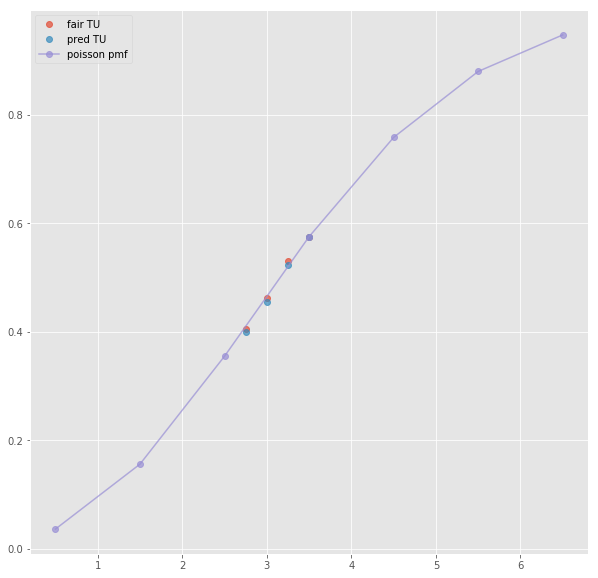

ML : 6.8 5.0 1.44
Error home:  0.0017271278245293564
Error draw:  0.011271187909903724
Error away:  0.00954417528160667

(336, 124)
(1, 55)
3.5 2.27 1.689 1.5 1.775 2.16
TO fair:  2.343990526939017 TU fair:  1.7440528634361232
TO pred:  2.34398 TU fair:  1.74406
Error TO:  0.0021338557905854483

Error TO:  0.00251201247094357

Error TO:  1.9159860958906094e-06

Error TO:  5.1148834862763115e-05

Error TO:  0.002627938163413668

Error TO:  0.00040176463843122345

Error TO:  6.71791707215208e-05

Error TO:  0.0047444558829177474

Error TO:  0.000783006881793058



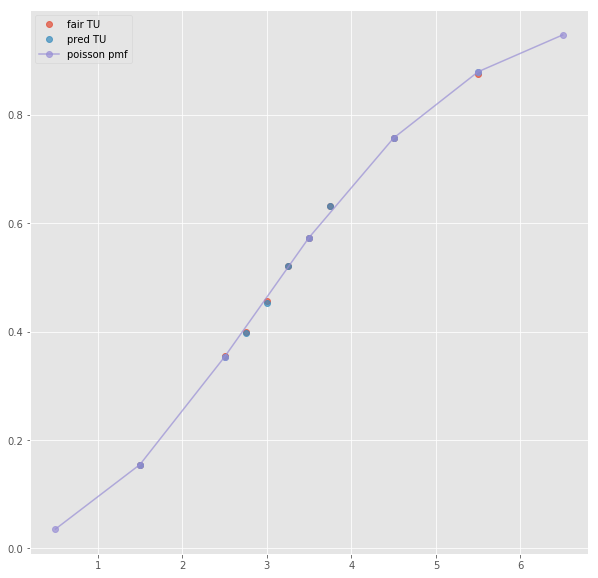

Error T1O:  0.08149513624652555
Error T1O:  0.01636700593768714
ML : 6.92 5.02 1.4480000000000002
Error home:  0.002806432929600311
Error draw:  0.012390874486690323
Error away:  0.009584554795661782

(193, 124)
(1, 77)
3.5 2.25 1.625 1.5 1.625 2.25
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38462 TU fair:  1.72222
Error TO:  0.0058774047052226885

Error TO:  0.02291945583397237

Error TO:  0.005387926149885147

Error TO:  8.116529556234653e-07

Error TO:  0.01036854004968496

Error TO:  0.015295047958099106

Error TO:  0.014166252743735064

Error TO:  0.01518042014843557

Error TO:  0.04830335429889032

Error TO:  0.020152097923241463

Error TO:  0.01337870330072577

Error TO:  0.04378376891058451

Error TO:  0.012757922202767225

Error TO:  0.0008063325376360675

Error TO:  0.01402388633629495

Error TO:  0.01543804775446414

Error TO:  0.015350500791108695



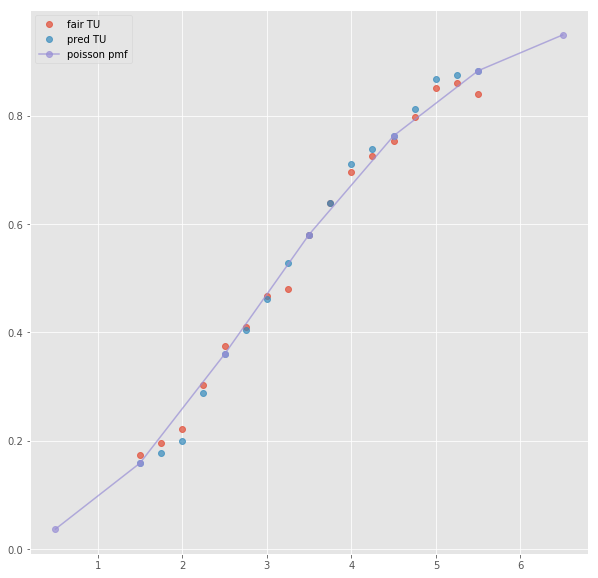

ML : 5.5 4.5 1.53
Error home:  0.009770386829677902
Error draw:  0.01982392033439792
Error away:  0.02959440096213184

(73, 124)
next positional indexers are out-of-bounds
(69, 124)
(1, 43)
2.5 1.813 2.09 -0.5 2.8 1.492
TO fair:  1.867464114832536 TU fair:  2.1527854384997243
TO pred:  1.86745 TU fair:  2.15281
Error TO:  0.001160917484471835

Error TO:  0.002843170328172162

Error TO:  0.003354799854828616

Error TO:  0.0003105043800699647

Error TO:  4.0473846668609426e-06

Error TO:  0.0013917347140297576

Error TO:  0.0017273280214116227

Error TO:  0.002715328548764717



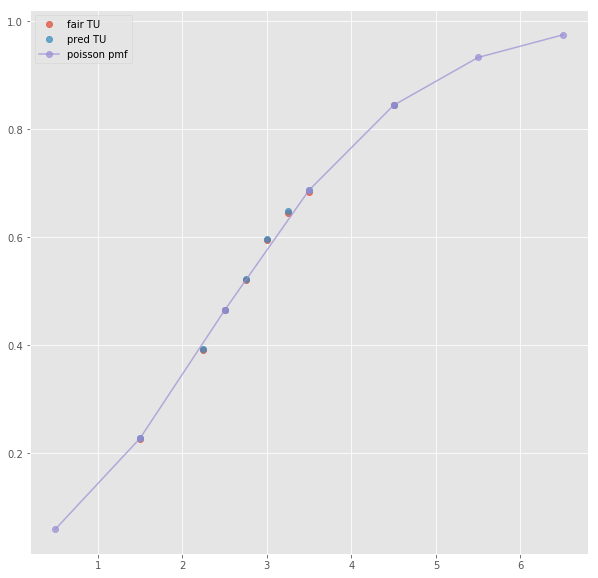

ML : 2.8 3.52 2.58
Error home:  0.0004990985131489434
Error draw:  0.024898237082927432
Error away:  0.02439904023871542

(117, 124)
(1, 25)
2.5 1.72 2.11 0.5 1.54 2.42
TO fair:  1.8151658767772514 TU fair:  2.226744186046512
TO pred:  1.81517 TU fair:  2.22674
Error TO:  0.0022518685285246587

Error TO:  0.003010725993244867

Error TO:  1.2514202361035842e-06



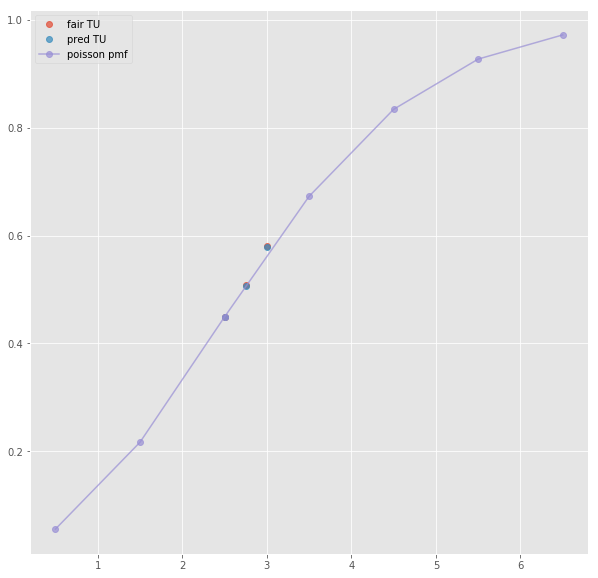

ML : 2.76 3.21 2.54
Error home:  0.02340848658800193
Error draw:  0.043514479502359954
Error away:  0.02010580537525375

(172, 124)
(1, 21)
2.5 1.8 2.11 0.5 1.64 2.38
TO fair:  1.8530805687203793 TU fair:  2.172222222222222
TO pred:  1.85307 TU fair:  2.17223
Error TO:  0.004939611485234252

Error TO:  3.077770838855187e-06



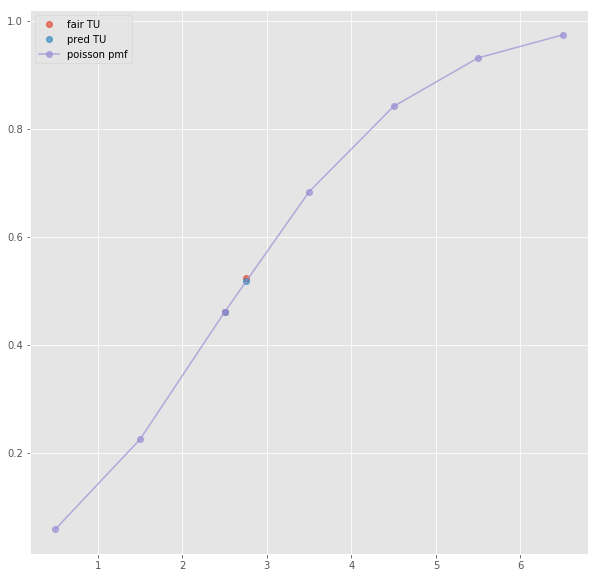

ML : 2.76 3.4 2.58
Error home:  0.005061387561480113
Error draw:  0.03163785254072232
Error away:  0.03669894269316709

(323, 124)
(1, 27)
2.5 1.78 2.13 0.5 1.59 2.49
TO fair:  1.8356807511737092 TU fair:  2.1966292134831464
TO pred:  1.83567 TU fair:  2.19665
Error TO:  0.010624946557235893

Error TO:  0.0006844238118629553

Error TO:  3.190539418218563e-06

Error TO:  0.018513597538823978



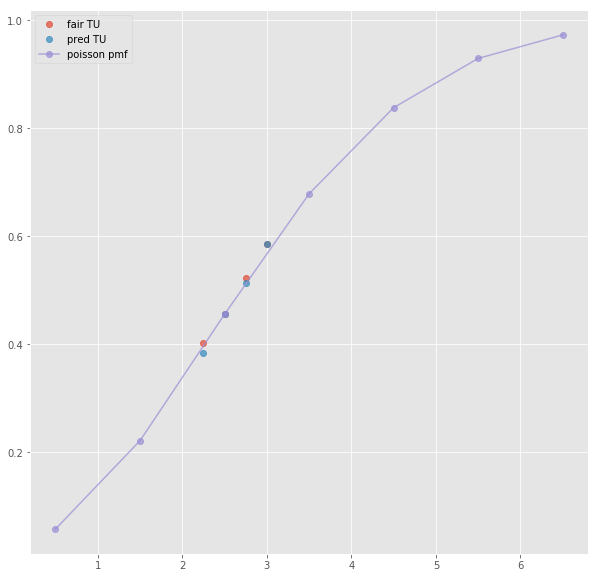

ML : 2.73 3.45 2.54
Error home:  0.01180735743272121
Error draw:  0.026503943613054054
Error away:  0.014696503166237995

(60, 124)
(1, 47)
2.5 1.813 2.09 -0.5 2.8 1.492
TO fair:  1.867464114832536 TU fair:  2.1527854384997243
TO pred:  1.86745 TU fair:  2.15281
Error TO:  0.001160917484471835

Error TO:  0.01903411192580018

Error TO:  0.002843170328172162

Error TO:  0.003354799854828616

Error TO:  0.0003105043800699647

Error TO:  4.0473846668609426e-06

Error TO:  0.0013917347140297576

Error TO:  0.0017273280214116227

Error TO:  0.002715328548764717



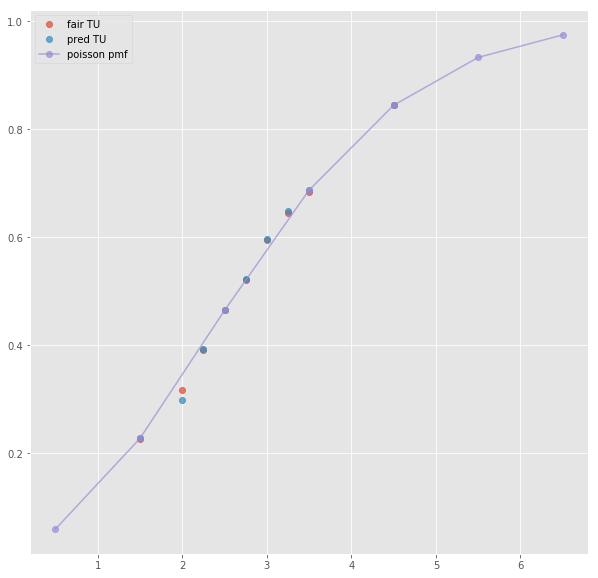

Error T1O:  0.0034885084958642953
ML : 2.8 3.52 2.58
Error home:  0.0004990985131489434
Error draw:  0.024898237082927432
Error away:  0.02439904023871542

(56, 124)
(1, 67)
3.5 2.75 1.425 0.5 1.65 2.2
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.04333841448671405

Error TO:  0.03540841325086819

Error TO:  0.020453053203135063

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.019206539751107532

Error TO:  0.028265949221071396

Error TO:  0.03283043366857896

Error TO:  0.009352251151134972

Error TO:  0.030731926345489935

Error TO:  0.003218176895100039

Error TO:  0.00457625786735949

Error TO:  0.008366637600584537

Error TO:  0.024947678360244696

Error TO:  0.009905698346832609



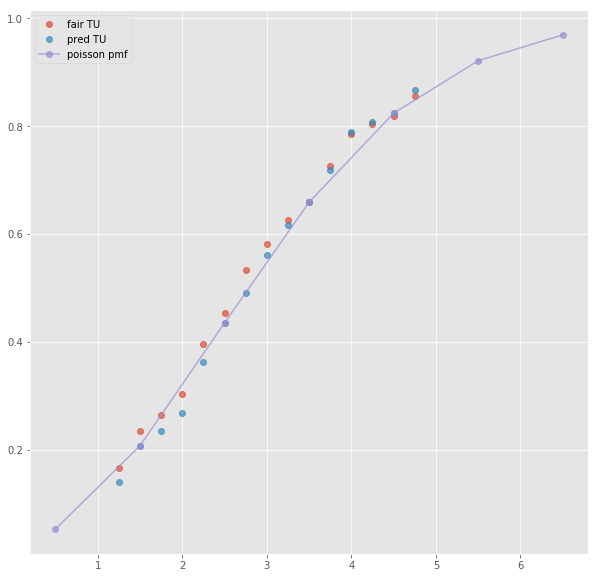

ML : 3.2 3.5 2.2
Error home:  0.03094294330473918
Error draw:  0.027736747897719738
Error away:  0.003206428929654781

(24, 124)
(1, 35)
2.5 1.76 2.12 -0.5 2.74 1.48
TO fair:  1.830188679245283 TU fair:  2.2045454545454546
TO pred:  1.83022 TU fair:  2.20451
Error TO:  0.004152391985091652

Error TO:  0.011557712090909833

Error TO:  9.350461726898018e-06

Error TO:  0.0010346541823974542

Error TO:  0.012897042902314415



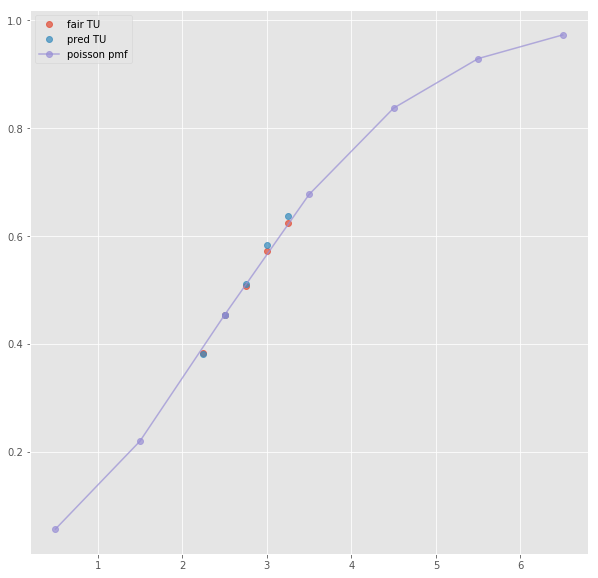

Error T1O:  0.01245881626067652
ML : 2.79 3.52 2.52
Error home:  0.005864363786887816
Error draw:  0.0243792684891104
Error away:  0.018514797842472674

(27, 124)
(1, 39)
2.5 2.26 1.699 -0.5 2.0 1.925
TO fair:  2.330194231901118 TU fair:  1.751769911504425
TO pred:  2.33023 TU fair:  1.75175
Error TO:  0.00100316908407716

Error TO:  0.004241457233369328

Error TO:  0.0007775529054104835

Error TO:  6.587262123158855e-06

Error TO:  0.005793685948799032

Error TO:  0.001764025553743609

Error TO:  0.005216819172157439



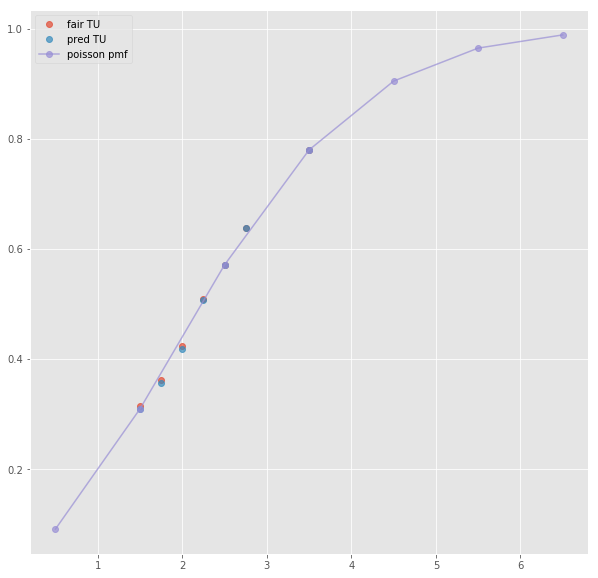

ML : 2.0 3.49 4.1
Error home:  0.00522154466703495
Error draw:  0.012481763567661175
Error away:  0.007260536178879479

(23, 124)
(1, 21)
next list index out of range
(40, 124)
(1, 19)
next list index out of range
(121, 124)
(1, 23)
2.5 2.25 1.7 -0.5 1.98 1.94
TO fair:  2.3235294117647056 TU fair:  1.7555555555555553
TO pred:  2.32359 TU fair:  1.75552
Error TO:  0.0028598782885261853

Error TO:  1.1222267855826029e-05

Error TO:  0.002724658056403928



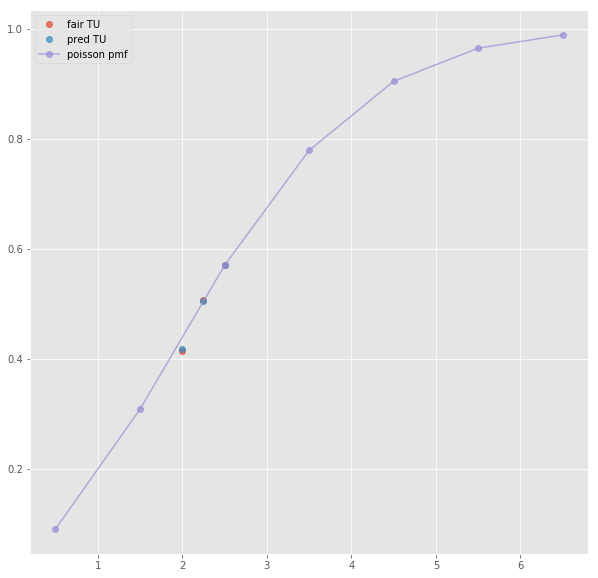

ML : 1.97 3.4 4.05
Error home:  0.01082857533513032
Error draw:  0.01593690428678951
Error away:  0.005108385907013513

(22, 124)
(1, 41)
2.5 2.26 1.699 -0.5 2.0 1.925
TO fair:  2.330194231901118 TU fair:  1.751769911504425
TO pred:  2.33023 TU fair:  1.75175
Error TO:  0.00100316908407716

Error TO:  0.004241457233369328

Error TO:  0.0007775529054104835

Error TO:  6.587262123158855e-06

Error TO:  0.005793685948799032

Error TO:  0.001764025553743609

Error TO:  0.005216819172157439



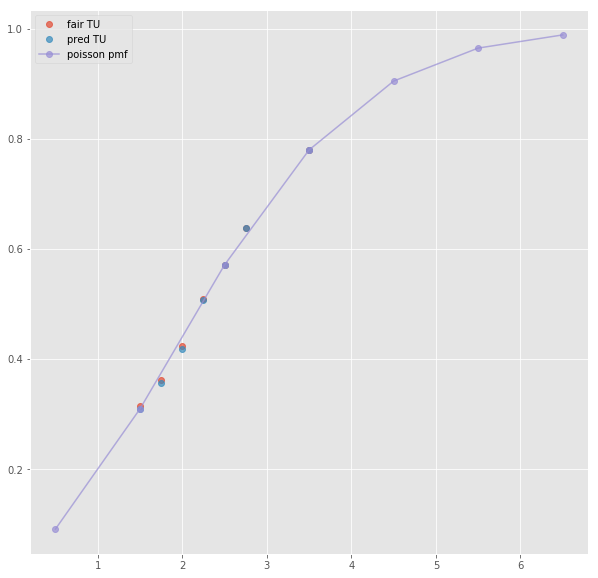

Error T1O:  0.0023007903714991063
ML : 2.0 3.49 4.1
Error home:  0.00522154466703495
Error draw:  0.012481763567661175
Error away:  0.007260536178879479

(19, 124)
(1, 59)
2.5 2.15 1.675 -0.5 1.95 1.9
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.011081319061399753

Error TO:  0.015336591097173724

Error TO:  0.01384320327034061

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.003324458045389722

Error TO:  0.010097138835415354

Error TO:  0.014687662129951318

Error TO:  0.021645654202264566

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.023704799879420757



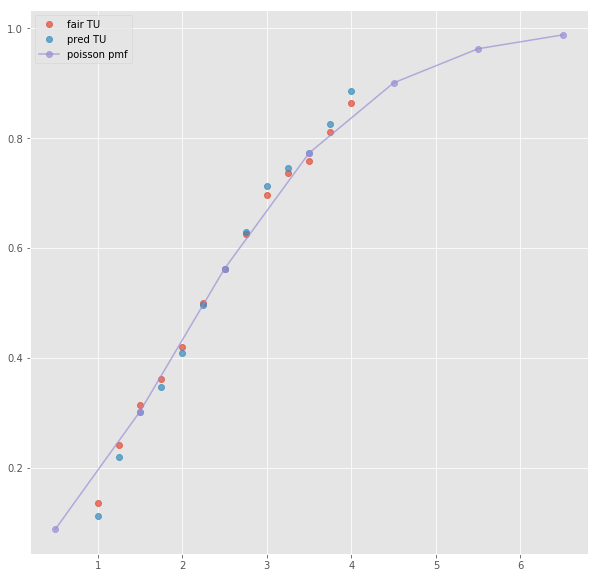

ML : 1.91 3.5 4.0
Error home:  0.0007526794932603553
Error draw:  0.006683403629888285
Error away:  0.007436423624028743

(15, 124)
(1, 33)
2.5 2.2 1.71 -0.5 1.96 1.89
TO fair:  2.2865497076023393 TU fair:  1.7772727272727273
TO pred:  2.28654 TU fair:  1.77728
Error TO:  0.0035019929001541272

Error TO:  0.005192894725372876

Error TO:  1.856746130290965e-06

Error TO:  0.0027096047697087178

Error TO:  0.006094570720924564



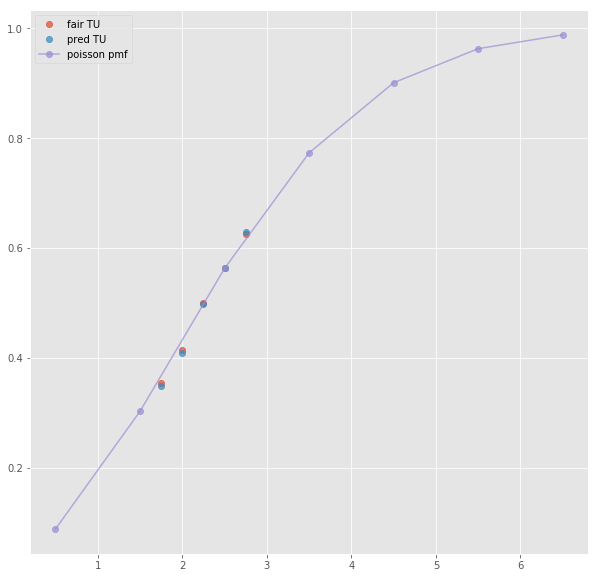

Error T1O:  0.006133799449147992
ML : 1.97 3.44 4.13
Error home:  0.0030326667356211923
Error draw:  0.01578441009415371
Error away:  0.012752077914693183

(75, 124)
(1, 42)
3.5 2.68 1.515 -0.5 1.555 2.6
TO fair:  2.768976897689769 TU fair:  1.5652985074626864
TO pred:  2.76904 TU fair:  1.56528
Error TO:  0.001861644641480309

Error TO:  0.0011538556290183744

Error TO:  8.229940544335346e-06

Error TO:  0.00013408091538061329

Error TO:  0.0025196758104817363

Error TO:  0.0023814462965278116

Error TO:  0.0003892327264340967

Error TO:  9.705239202434379e-05



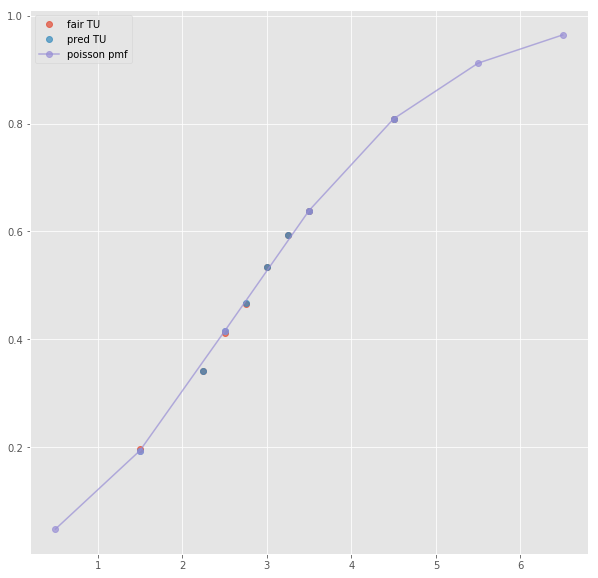

ML : 1.555 4.56 5.79
Error home:  0.004480735417929482
Error draw:  0.006982754372372502
Error away:  0.0025019695958348465

(77, 124)
(1, 24)
2.5 1.63 2.23 -0.5 1.62 2.28
TO fair:  1.7309417040358743 TU fair:  2.3680981595092025
TO pred:  1.73092 TU fair:  2.36814
Error TO:  0.02004451413665831

Error TO:  0.020634656386884775

Error TO:  7.2440436897913685e-06



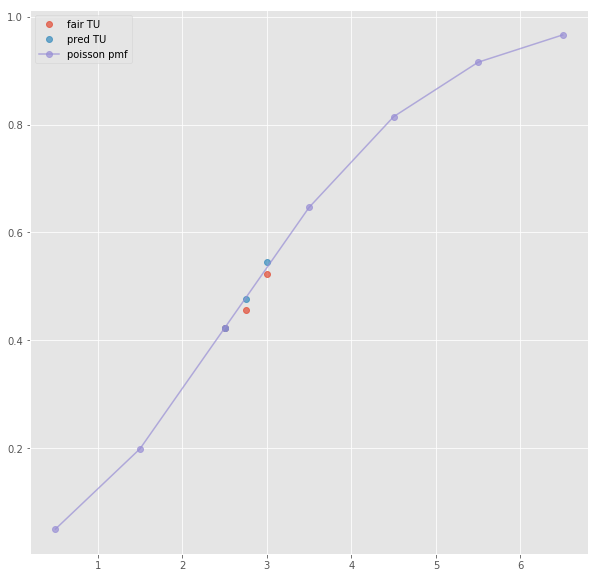

ML : 1.5 4.26 5.96
Error home:  0.03890528118600112
Error draw:  0.002645606871976486
Error away:  0.041550790890504924

(115, 124)
(1, 19)
next list index out of range
(218, 124)
(1, 25)
2.5 1.61 2.4 -0.5 1.57 2.53
TO fair:  1.6708333333333334 TU fair:  2.4906832298136643
TO pred:  1.67085 TU fair:  2.49065
Error TO:  0.003081207496971161

Error TO:  0.011014693628238259

Error TO:  5.9700525745221e-06

Error TO:  0.00029320129779697446



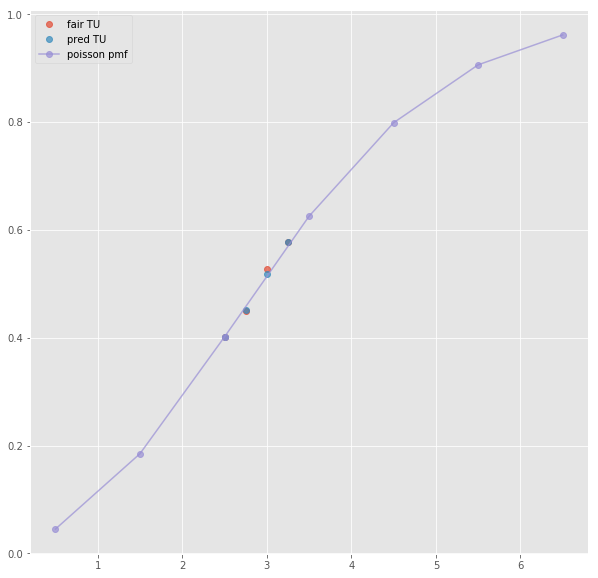

ML : 1.56 4.35 5.6
Error home:  0.0062687767438899256
Error draw:  0.013842634586363728
Error away:  0.007574012539214359

(66, 124)
(1, 44)
3.5 2.68 1.515 -0.5 1.555 2.6
TO fair:  2.768976897689769 TU fair:  1.5652985074626864
TO pred:  2.76904 TU fair:  1.56528
Error TO:  0.001861644641480309

Error TO:  0.0011538556290183744

Error TO:  8.229940544335346e-06

Error TO:  0.00013408091538061329

Error TO:  0.0025196758104817363

Error TO:  0.0023814462965278116

Error TO:  0.0003892327264340967

Error TO:  9.705239202434379e-05



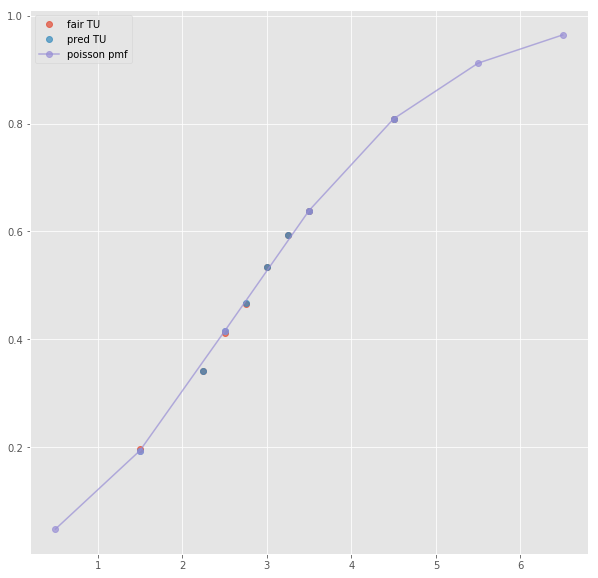

Error T1O:  0.0032907166593062476
ML : 1.555 4.56 5.79
Error home:  0.004480735417929482
Error draw:  0.006982754372372502
Error away:  0.0025019695958348465

(160, 124)
(1, 68)
3.5 2.425 1.525 -0.5 1.55 2.375
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.59019 TU fair:  1.62886
Error TO:  0.014174596584795807

Error TO:  0.027954184820545014

Error TO:  0.03650392850089129

Error TO:  3.885155582861177e-06

Error TO:  0.011278027205546215

Error TO:  0.01957038365376229

Error TO:  0.024404758866645948

Error TO:  0.023138646275283836

Error TO:  0.006009005748257468

Error TO:  0.02801453483607741

Error TO:  0.00906789630144772

Error TO:  0.00458571529999624

Error TO:  0.0024818977009522514

Error TO:  0.025523228236961293

Error TO:  0.008855884329115299



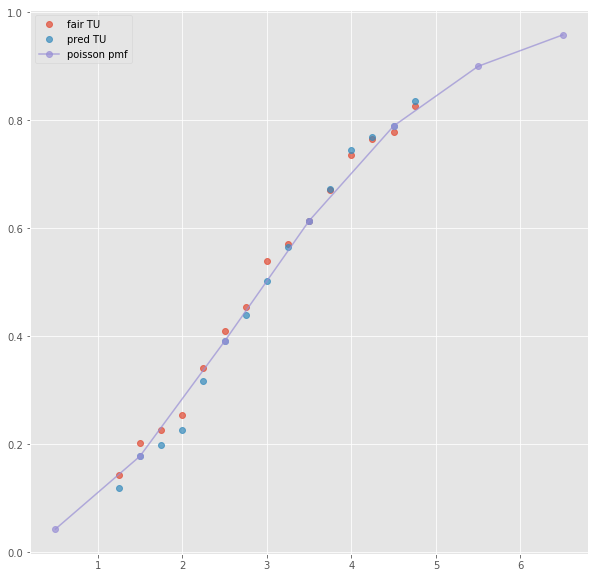

ML : 1.55 4.33 5.75
Error home:  0.009316143646044717
Error draw:  0.013286002310498313
Error away:  0.02260221035280599

(23, 124)
(1, 38)
3.5 2.54 1.55 -0.5 1.56 2.5
TO fair:  2.6387096774193552 TU fair:  1.6102362204724412
TO pred:  2.63873 TU fair:  1.61023
Error TO:  0.009859686311987637

Error TO:  0.007556815567123676

Error TO:  2.918719039513018e-06

Error TO:  0.01206263587430012

Error TO:  0.03075054048013348

Error TO:  0.002801516992857911



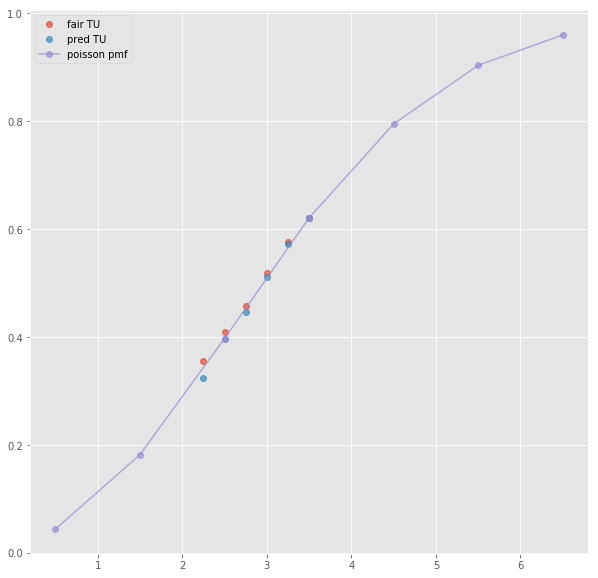

Error T1O:  0.03419492124240142
Error T1O:  0.007642065803750542
ML : 1.57 4.45 5.62
Error home:  0.003085468060762264
Error draw:  0.011233659669173973
Error away:  0.008148127113080744

(293, 124)
next positional indexers are out-of-bounds
(279, 124)
next positional indexers are out-of-bounds
(294, 124)
next positional indexers are out-of-bounds
(619, 124)
next positional indexers are out-of-bounds
(202, 124)
(1, 44)
3.5 2.85 1.465 -0.5 1.558 2.59
TO fair:  2.945392491467577 TU fair:  1.5140350877192983
TO pred:  2.9454 TU fair:  1.51403
Error TO:  0.002004039168077121

Error TO:  0.00147943837648995

Error TO:  8.655010569902366e-07

Error TO:  0.004610074389343022

Error TO:  0.0019942751342379994

Error TO:  0.0074342584979872894

Error TO:  0.00526663624540491

Error TO:  0.00031152352402363803



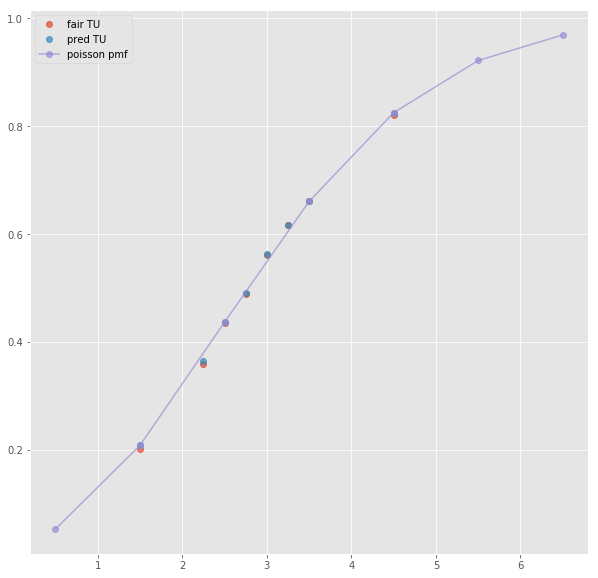

Error T1O:  0.002698370295183994
ML : 1.558 4.47 5.98
Error home:  0.0029262538847353303
Error draw:  0.007907105429637129
Error away:  0.0049809486034956

(58, 124)
(1, 68)
3.5 2.425 1.525 -0.5 1.55 2.375
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.59019 TU fair:  1.62886
Error TO:  0.014174596584795807

Error TO:  0.02144667923127641

Error TO:  0.01241485967498046

Error TO:  3.885155582861177e-06

Error TO:  0.011278027205546215

Error TO:  0.01058785874767032

Error TO:  0.024404758866645948

Error TO:  0.023138646275283836

Error TO:  0.006009005748257468

Error TO:  0.02243817451111374

Error TO:  0.00906789630144772

Error TO:  0.010649207127302024

Error TO:  0.0024818977009522514

Error TO:  0.021339302878189748

Error TO:  0.008855884329115299



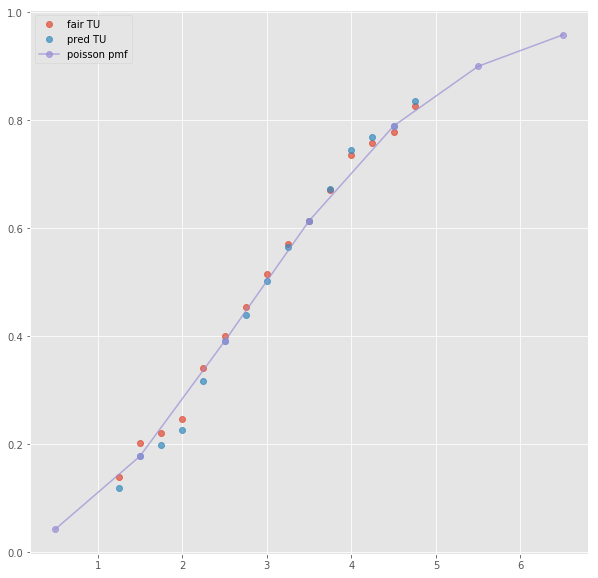

ML : 1.55 4.5 5.25
Error home:  0.004763387426935939
Error draw:  0.0034087986188747477
Error away:  0.008172250442073425

(35, 124)
next positional indexers are out-of-bounds
(88, 124)
(1, 46)
3.5 2.41 1.606 0.5 2.08 1.826
TO fair:  2.5006226650062264 TU fair:  1.6663900414937758
TO pred:  2.50064 TU fair:  1.66638
Error TO:  0.003771501933846233

Error TO:  0.003861447056898948

Error TO:  2.7721986837203616e-06

Error TO:  0.001682260602105523

Error TO:  0.004768019242888277

Error TO:  0.000808283650231556

Error TO:  0.0009138540838161124



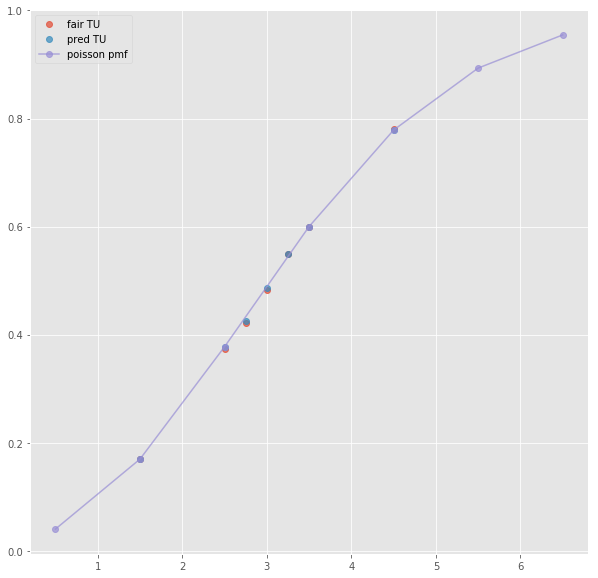

ML : 3.89 4.32 1.826
Error home:  0.0008169717816368383
Error draw:  0.003171884974312672
Error away:  0.003989058160997261

(77, 124)
(1, 25)
next list index out of range
(93, 124)
(1, 21)
next list index out of range
(121, 124)
(1, 21)
next list index out of range
(73, 124)
(1, 48)
3.5 2.41 1.606 0.5 2.08 1.826
TO fair:  2.5006226650062264 TU fair:  1.6663900414937758
TO pred:  2.50064 TU fair:  1.66638
Error TO:  0.003771501933846233

Error TO:  0.003861447056898948

Error TO:  2.7721986837203616e-06

Error TO:  0.001682260602105523

Error TO:  0.004768019242888277

Error TO:  0.000808283650231556

Error TO:  0.0009138540838161124



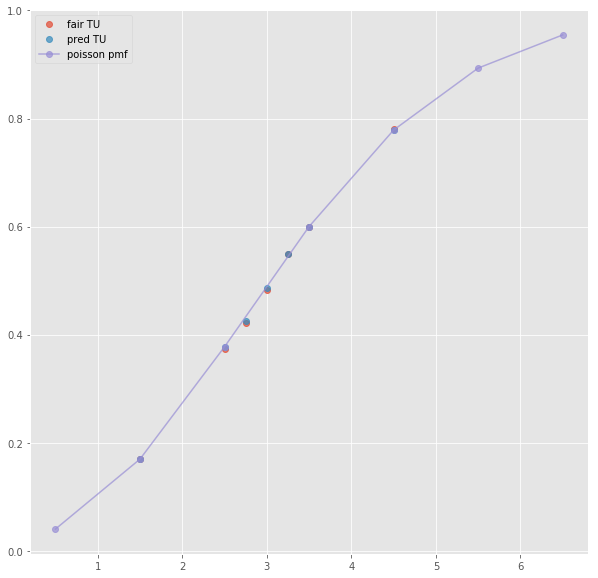

Error T1O:  0.014770662619116193
ML : 3.89 4.32 1.826
Error home:  0.0008169717816368383
Error draw:  0.003171884974312672
Error away:  0.003989058160997261

(45, 124)
(1, 75)
3.5 2.35 1.575 0.5 2.025 1.775
TO fair:  2.492063492063492 TU fair:  1.6702127659574466
TO pred:  2.49211 TU fair:  1.67019
Error TO:  0.0051263973221491455

Error TO:  0.021976086443525666

Error TO:  0.0030248346450085783

Error TO:  7.488602181360271e-06

Error TO:  0.012757263088487236

Error TO:  0.009711746061819015

Error TO:  0.020633743616199962

Error TO:  0.010063733266538644

Error TO:  0.0024841762151132096

Error TO:  0.0205966239790909

Error TO:  0.002818034669159808

Error TO:  0.009765205781596287

Error TO:  0.009045879570576731

Error TO:  0.02406759851161855

Error TO:  0.014670530307930307

Error TO:  0.01846753621768213



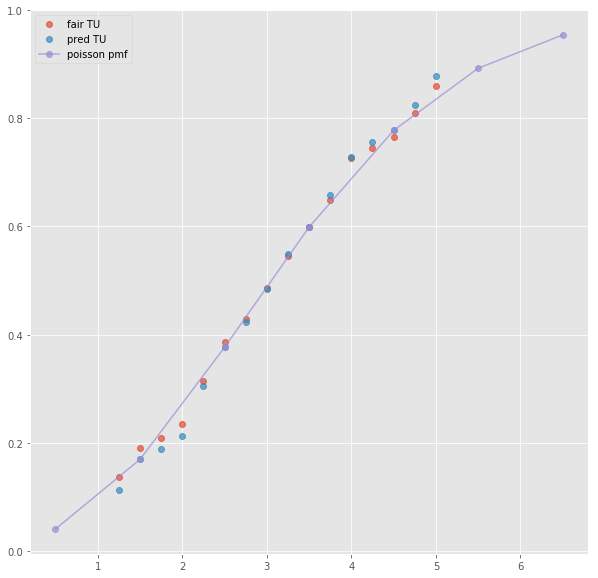

ML : 3.8 4.2 1.75
Error home:  0.0018428017886784887
Error draw:  0.0020282012651490766
Error away:  0.00018536800030355405

(14, 124)
(1, 34)
3.5 2.35 1.63 0.5 2.08 1.79
TO fair:  2.441717791411043 TU fair:  1.6936170212765955
TO pred:  2.44173 TU fair:  1.69361
Error TO:  0.010269119160176032

Error TO:  0.009366198992772579

Error TO:  2.047728454857012e-06

Error TO:  0.012148512148512092

Error TO:  0.003257129402711001



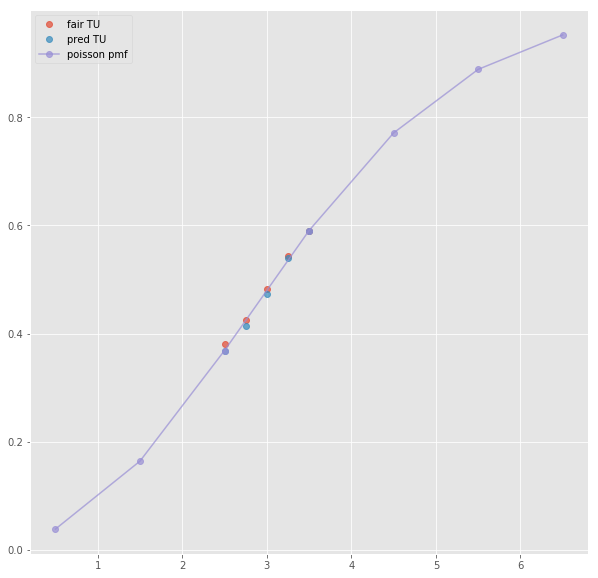

Error T1O:  0.004805603819202808
ML : 4.17 4.16 1.79
Error home:  0.01389735498965719
Error draw:  0.013586499627443599
Error away:  0.00031068575643999896

(51, 124)
(1, 47)
2.5 1.819 2.08 -0.5 2.06 1.862
TO fair:  1.8745192307692309 TU fair:  2.1434854315558
TO pred:  1.8745 TU fair:  2.1435
Error TO:  0.00012799163877191821

Error TO:  0.008418136283950495

Error TO:  0.0023013951109028263

Error TO:  0.0040837935251638036

Error TO:  0.0029425922274916305

Error TO:  5.472947868678801e-06

Error TO:  0.0016380069716522838

Error TO:  0.0007311660762080452

Error TO:  0.0032710068841350637



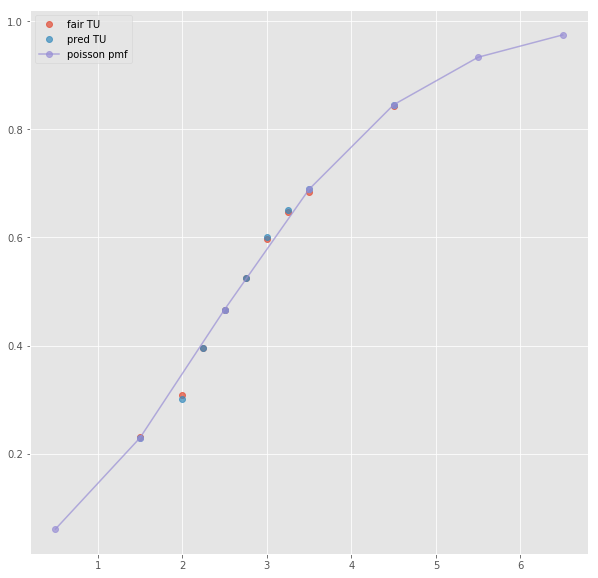

ML : 2.06 3.57 3.76
Error home:  0.004156494244117959
Error draw:  0.026047261768658125
Error away:  0.02189094572655459

(47, 124)
(1, 23)
2.5 1.8 2.02 -0.5 2.04 1.8
TO fair:  1.8910891089108912 TU fair:  2.1222222222222222
TO pred:  1.89108 TU fair:  2.12223
Error TO:  0.006583425666669029

Error TO:  2.5470915703262875e-06

Error TO:  0.012892386467742822



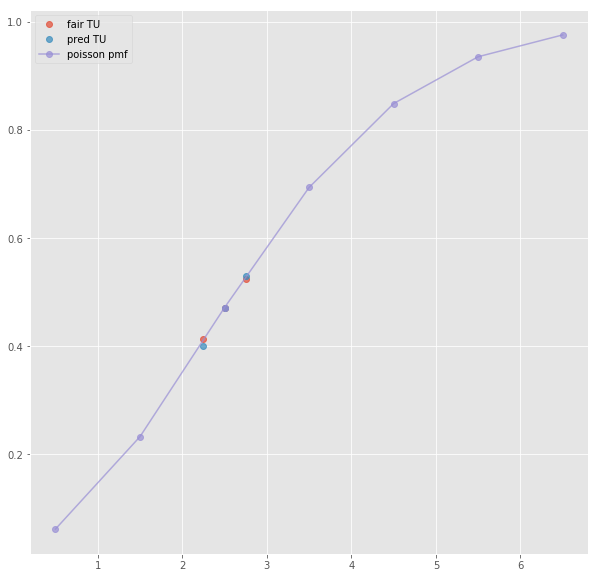

ML : 2.03 3.56 3.41
Error home:  0.006966181426140972
Error draw:  0.01611372753534865
Error away:  0.00914756383044274

(57, 124)
(1, 21)
2.5 1.82 2.08 -0.5 2.08 1.84
TO fair:  1.8749999999999998 TU fair:  2.142857142857143
TO pred:  1.87499 TU fair:  2.14287
Error TO:  0.004615038811056571

Error TO:  2.8444596148480272e-06



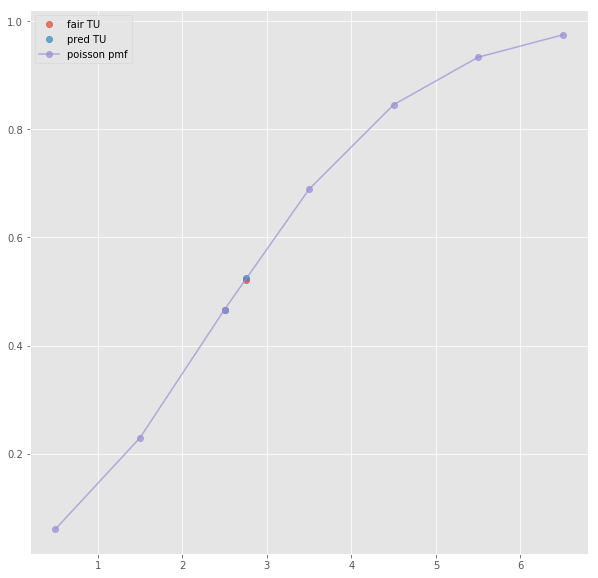

ML : 2.06 3.55 3.55
Error home:  0.006537753460072682
Error draw:  0.02236745700051543
Error away:  0.01582956590716844

(194, 124)
(1, 25)
2.5 1.8 2.11 -0.5 2.09 1.83
TO fair:  1.8530805687203793 TU fair:  2.172222222222222
TO pred:  1.85307 TU fair:  2.17223
Error TO:  0.002375508921131697

Error TO:  3.077770838855187e-06

Error TO:  0.006288951688271371



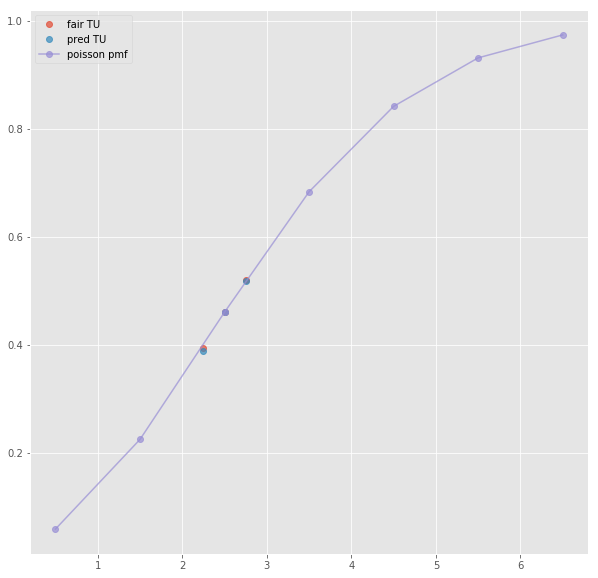

ML : 2.08 3.6 3.4
Error home:  0.010123913359451397
Error draw:  0.018628072753319347
Error away:  0.00850433180192428

(40, 124)
(1, 49)
2.5 1.819 2.08 -0.5 2.06 1.862
TO fair:  1.8745192307692309 TU fair:  2.1434854315558
TO pred:  1.8745 TU fair:  2.1435
Error TO:  0.00012799163877191821

Error TO:  0.008418136283950495

Error TO:  0.0023013951109028263

Error TO:  0.0040837935251638036

Error TO:  0.0029425922274916305

Error TO:  5.472947868678801e-06

Error TO:  0.0016380069716522838

Error TO:  0.0007311660762080452

Error TO:  0.0032710068841350637



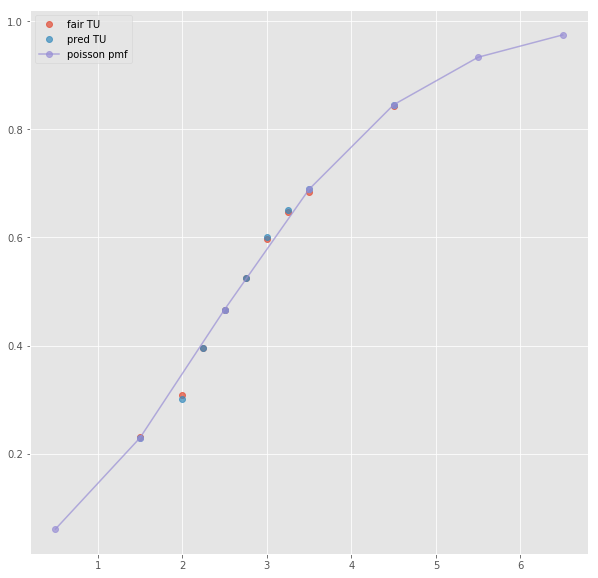

Error T1O:  0.008327717560871362
ML : 2.06 3.57 3.76
Error home:  0.004156494244117959
Error draw:  0.026047261768658125
Error away:  0.02189094572655459

(138, 124)
(1, 67)
2.5 1.825 2.025 -0.5 2.03 1.87
TO fair:  1.9012345679012344 TU fair:  2.1095890410958904
TO pred:  1.90124 TU fair:  2.10958
Error TO:  0.00036951960118158933

Error TO:  0.006054359180115765

Error TO:  0.01069313082641693

Error TO:  0.010478401036069729

Error TO:  0.01610180215455695

Error TO:  1.5027786377519448e-06

Error TO:  0.01316877394390592

Error TO:  0.007838592746057249

Error TO:  0.009743475501029497

Error TO:  0.007419141445172084

Error TO:  0.020017341012010775

Error TO:  0.019112513017122135

Error TO:  0.018705317146638284

Error TO:  0.0107830760953056



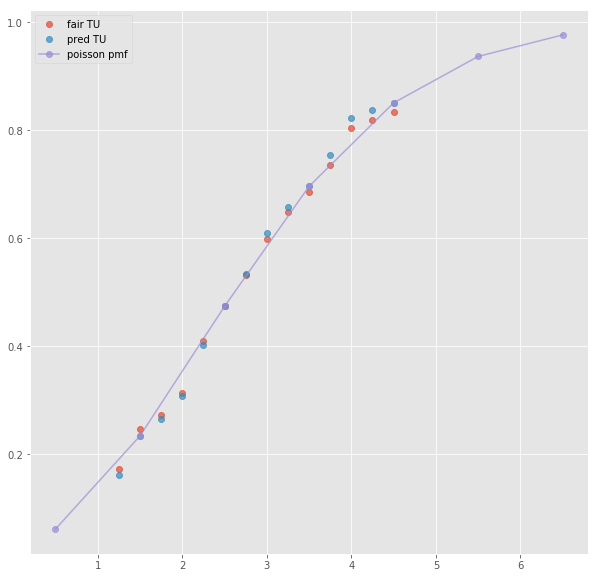

ML : 2.0 3.5 3.75
Error home:  0.004367504413337164
Error draw:  0.02510343883085664
Error away:  0.020735904924224224

(14, 124)
(1, 37)
2.5 1.81 2.05 -0.5 2.02 1.83
TO fair:  1.882926829268293 TU fair:  2.132596685082873
TO pred:  1.88295 TU fair:  2.13257
Error TO:  0.004306224604343933

Error TO:  0.009660465424326525

Error TO:  0.010159382127809535

Error TO:  6.5353299246728724e-06

Error TO:  0.0009026293229541515

Error TO:  0.012521351614589948



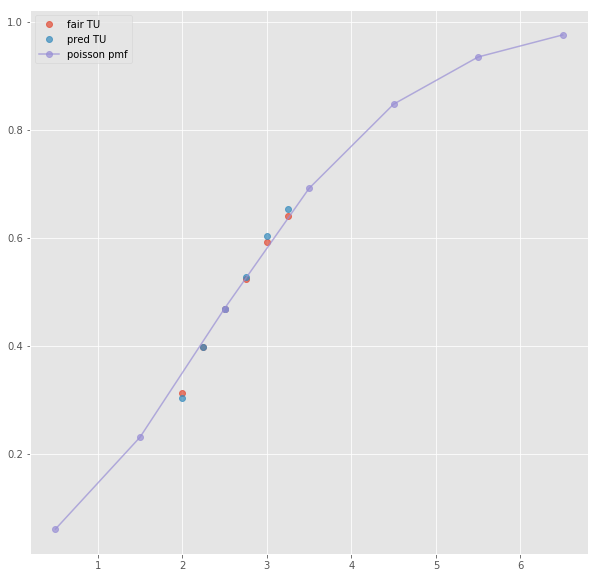

Error T1O:  0.009535829268281892
ML : 2.04 3.62 3.66
Error home:  0.003830768174613086
Error draw:  0.019789056683043926
Error away:  0.01595832454827384

(39, 124)
(1, 41)
3.5 2.77 1.476 -0.5 1.54 2.61
TO fair:  2.8766937669376698 TU fair:  1.532851985559567
TO pred:  2.87674 TU fair:  1.53284
Error TO:  0.002670643199307321

Error TO:  0.0029576820628464673

Error TO:  5.5867394330721964e-06

Error TO:  0.0021191021977350066

Error TO:  0.0029653756346221805

Error TO:  0.01259417458116463

Error TO:  0.006481727434599738

Error TO:  0.0011905014522256563



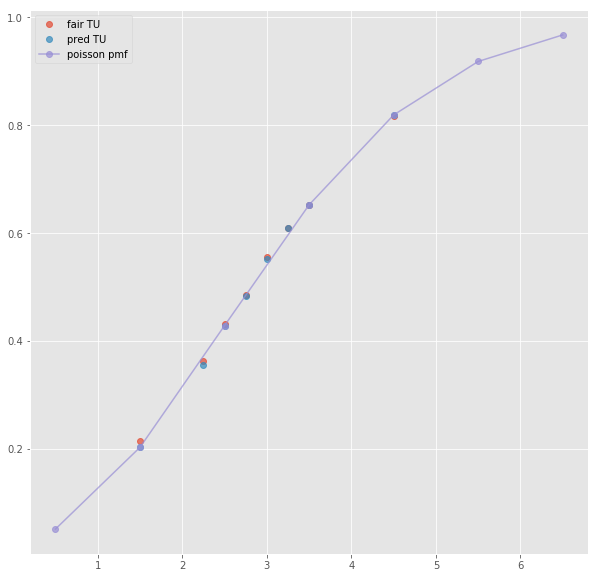

ML : 1.54 4.23 6.4
Error home:  0.005754002525479862
Error draw:  0.02079046004908275
Error away:  0.015036400882844303

(49, 124)
(1, 24)
2.5 1.64 2.21 -1.5 2.38 1.56
TO fair:  1.742081447963801 TU fair:  2.347560975609756
TO pred:  1.74208 TU fair:  2.34756
Error TO:  0.003271553277653827

Error TO:  0.0019534845050218075

Error TO:  4.771128944147662e-07



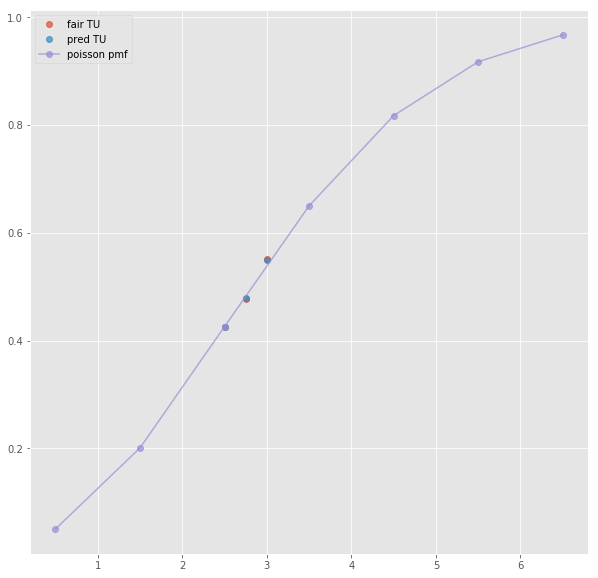

ML : 1.52 4.26 5.76
Error home:  0.019121700401700692
Error draw:  0.016569703498516525
Error away:  0.0025520466609814385

(107, 124)
(1, 18)
next list index out of range
(139, 124)
(1, 20)
next list index out of range
(31, 124)
(1, 43)
3.5 2.78 1.473 -0.5 1.5490000000000002 2.58
TO fair:  2.887304820095044 TU fair:  1.5298561151079137
TO pred:  2.88737 TU fair:  1.52984
Error TO:  0.002472058475248673

Error TO:  0.0020128235042988774

Error TO:  7.818413707283423e-06

Error TO:  0.0026594556368521316

Error TO:  0.002772096135232549

Error TO:  0.012241629022659462

Error TO:  0.0063571560266852956

Error TO:  0.0011586559103962668



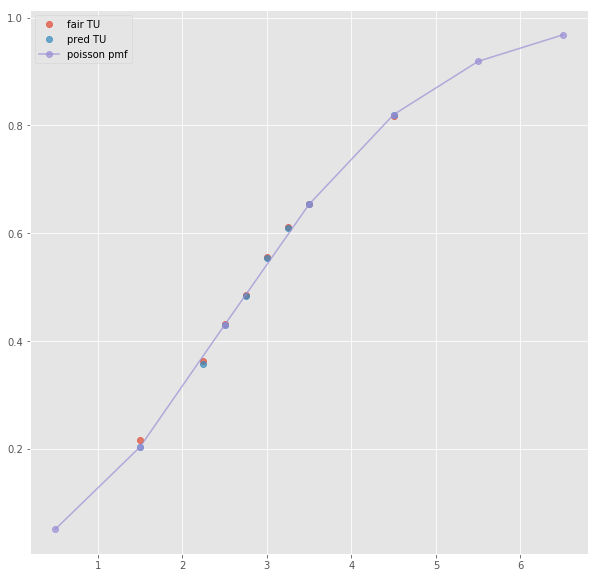

Error T1O:  0.004112894141523438
ML : 1.5490000000000002 4.19 6.34
Error home:  0.005269518669859141
Error draw:  0.021579217503939485
Error away:  0.016309593760185703

(178, 124)
(1, 68)
3.5 2.675 1.45 -1.5 2.35 1.575
TO fair:  2.844827586206897 TU fair:  1.5420560747663552
TO pred:  2.84478 TU fair:  1.54207
Error TO:  0.0025382314330132383

Error TO:  0.015826776113164964

Error TO:  0.0009339229819920192

Error TO:  5.879988163315364e-06

Error TO:  0.01859912872250888

Error TO:  0.004134185056581807

Error TO:  0.0216309220725327

Error TO:  0.010286625779599046

Error TO:  0.0009611212849685025

Error TO:  0.022262116508840135

Error TO:  0.014339928242657007

Error TO:  0.01365895629374736

Error TO:  0.011208905461798924

Error TO:  0.022737162552140977

Error TO:  0.017251321344888576



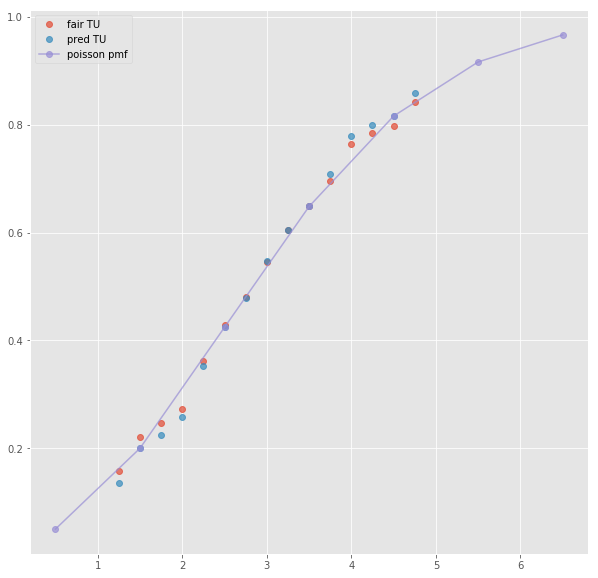

ML : 1.444 4.5 6.5
Error home:  0.006773232017018516
Error draw:  0.006159281465729943
Error away:  0.012932316059886373

(19, 124)
(1, 33)
2.5 1.67 2.26 -0.5 1.56 2.5
TO fair:  1.7389380530973453 TU fair:  2.3532934131736525
TO pred:  1.73896 TU fair:  2.35326
Error TO:  0.0032254855426000484

Error TO:  0.007582446894934924

Error TO:  7.25770871090603e-06

Error TO:  0.002577147854574857

Error TO:  0.01071593452764985



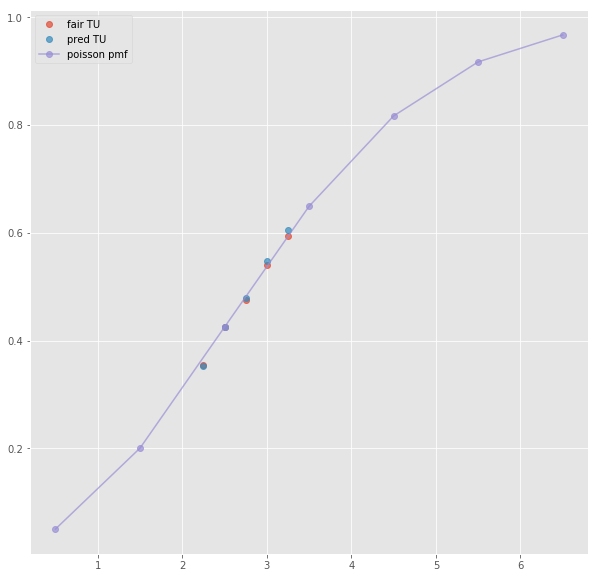

Error T1O:  0.014472089695410195
ML : 1.57 4.39 5.71
Error home:  0.0032236700825154507
Error draw:  0.009778361332379859
Error away:  0.006554527161627854

(48, 124)
next positional indexers are out-of-bounds
(41, 124)
next positional indexers are out-of-bounds
(64, 124)
next positional indexers are out-of-bounds
(125, 124)
next positional indexers are out-of-bounds
(49, 124)
(1, 46)
2.5 2.08 1.819 -0.5 1.763 2.18
TO fair:  2.1434854315558 TU fair:  1.8745192307692309
TO pred:  2.14344 TU fair:  1.87455
Error TO:  0.0016008911289058236

Error TO:  0.000504980578973524

Error TO:  0.004173250479309221

Error TO:  0.004057901894175903

Error TO:  9.88839354071347e-06

Error TO:  8.48280369879495e-05

Error TO:  0.0009605562946918278

Error TO:  0.014657077986627853



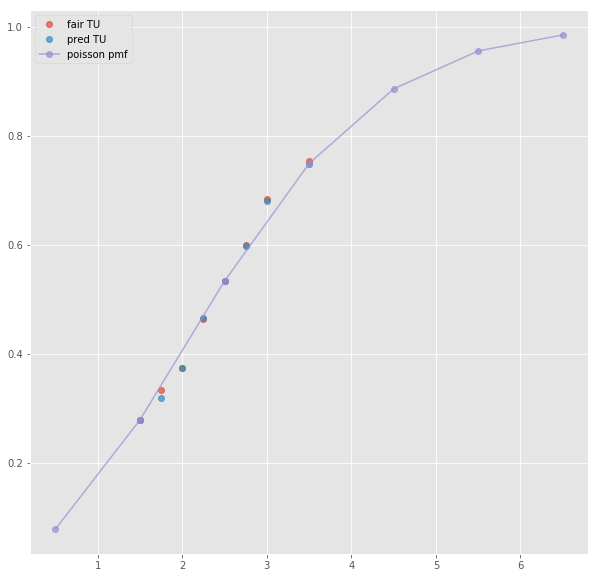

Error T1O:  0.0032908373171224303
ML : 1.763 3.56 5.47
Error home:  0.0026763232465022435
Error draw:  0.027641740852250934
Error away:  0.024965400542451527

(24, 124)
(1, 10)
next list index out of range
(36, 124)
next positional indexers are out-of-bounds
(57, 124)
(1, 45)
3.5 2.02 1.84 -1.5 1.561 2.52
TO fair:  2.0978260869565215 TU fair:  1.9108910891089108
TO pred:  2.09783 TU fair:  1.91088
Error TO:  0.016046422214784695

Error TO:  0.0009678458637710774

Error TO:  8.891497281227068e-07

Error TO:  0.0094270136724256

Error TO:  0.0008823288653102557

Error TO:  0.009095782456062018

Error TO:  5.5945352424813244e-05

Error TO:  0.008980546890692997

Error TO:  0.01102342941826659

Error TO:  0.004055529013153147



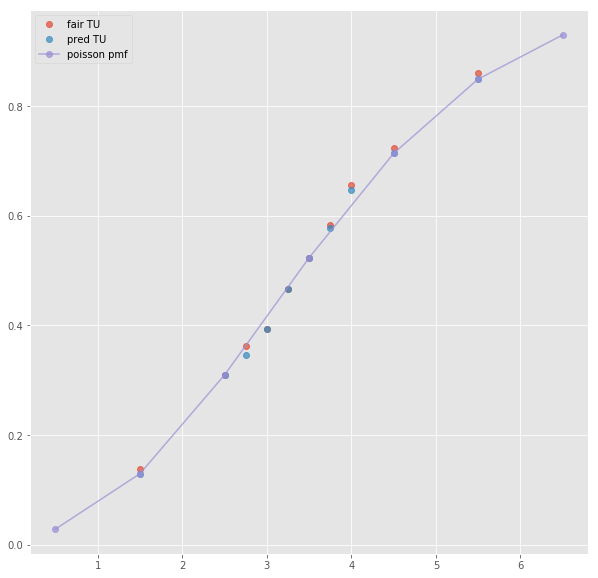

ML : 1.173 7.59 15.34
Error home:  0.0006685014448123416
Error draw:  0.003505858405993309
Error away:  0.002837323945217754

(86, 124)
(1, 19)
next list index out of range
(96, 124)
(1, 19)
next list index out of range
(229, 124)
(1, 21)
next list index out of range
(49, 124)
(1, 47)
3.5 2.02 1.84 -1.5 1.561 2.52
TO fair:  2.0978260869565215 TU fair:  1.9108910891089108
TO pred:  2.09783 TU fair:  1.91088
Error TO:  0.016046422214784695

Error TO:  0.0009678458637710774

Error TO:  8.891497281227068e-07

Error TO:  0.0094270136724256

Error TO:  0.0008823288653102557

Error TO:  0.009095782456062018

Error TO:  5.5945352424813244e-05

Error TO:  0.008980546890692997

Error TO:  0.01102342941826659

Error TO:  0.004055529013153147



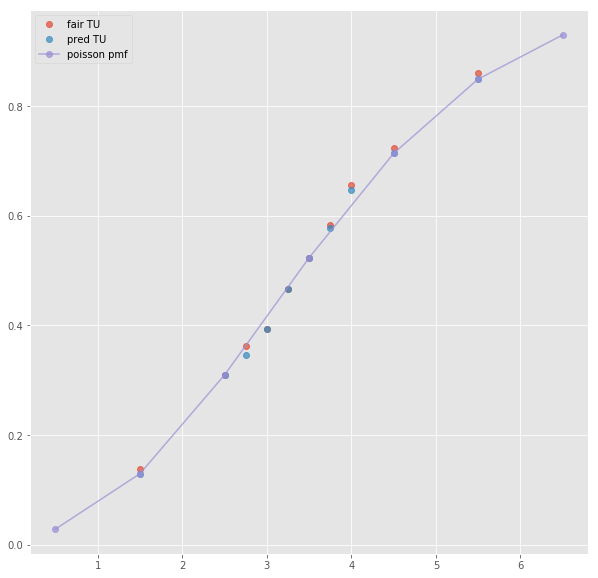

Error T1O:  0.011568643279150193
ML : 1.173 7.59 15.34
Error home:  0.0006685014448123416
Error draw:  0.003505858405993309
Error away:  0.002837323945217754

(41, 124)
(1, 35)
3.5 2.02 1.84 -1.5 1.54 2.55
TO fair:  2.0978260869565215 TU fair:  1.9108910891089108
TO pred:  2.09783 TU fair:  1.91088
Error TO:  0.015529983603240316

Error TO:  0.005301945064582481

Error TO:  8.891497281227068e-07

Error TO:  0.002646618927554467

Error TO:  0.005222377161110736

Error TO:  0.002228269622497059



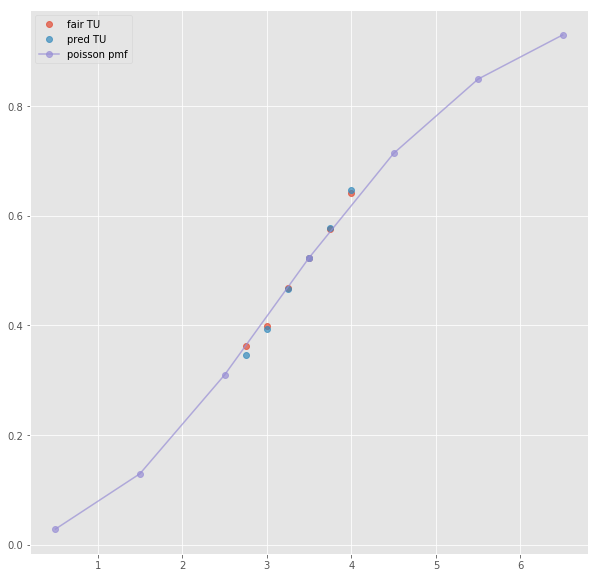

Error T1O:  0.0004238666640284938
ML : 1.19 7.53 14.69
Error home:  0.01051950387940459
Error draw:  0.00764410540208868
Error away:  0.0028754571068642237

(16, 124)
(1, 41)
2.5 2.36 1.632 0.5 1.621 2.41
TO fair:  2.4460784313725488 TU fair:  1.6915254237288135
TO pred:  2.44604 TU fair:  1.69154
Error TO:  0.002284041104917145

Error TO:  0.009158720667652775

Error TO:  0.006999089023086741

Error TO:  6.423207652206386e-06

Error TO:  0.010097907802637973

Error TO:  0.003086503253515227

Error TO:  0.010165252728661978



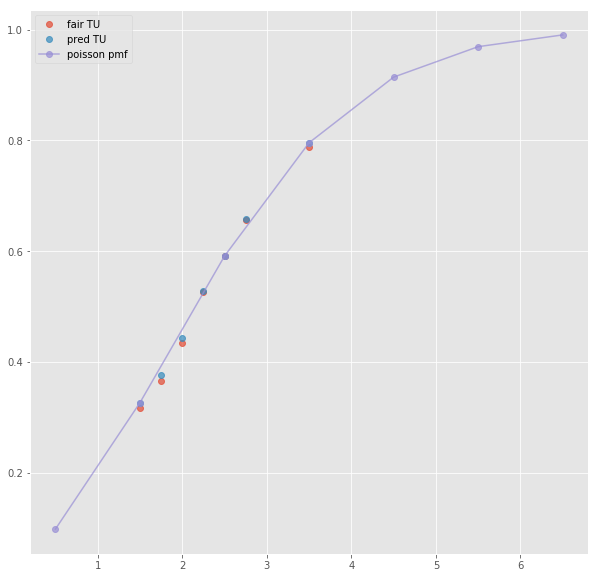

ML : 3.34 3.12 2.41
Error home:  0.02756593786986028
Error draw:  0.02872261548590921
Error away:  0.0011565067939220408

(7, 124)
(1, 17)
next list index out of range
(29, 124)
(1, 17)
next list index out of range
(32, 124)
(1, 17)
next list index out of range
(13, 124)
(1, 43)
2.5 2.36 1.632 0.5 1.621 2.41
TO fair:  2.4460784313725488 TU fair:  1.6915254237288135
TO pred:  2.44604 TU fair:  1.69154
Error TO:  0.002284041104917145

Error TO:  0.009158720667652775

Error TO:  0.006999089023086741

Error TO:  6.423207652206386e-06

Error TO:  0.010097907802637973

Error TO:  0.003086503253515227

Error TO:  0.010165252728661978



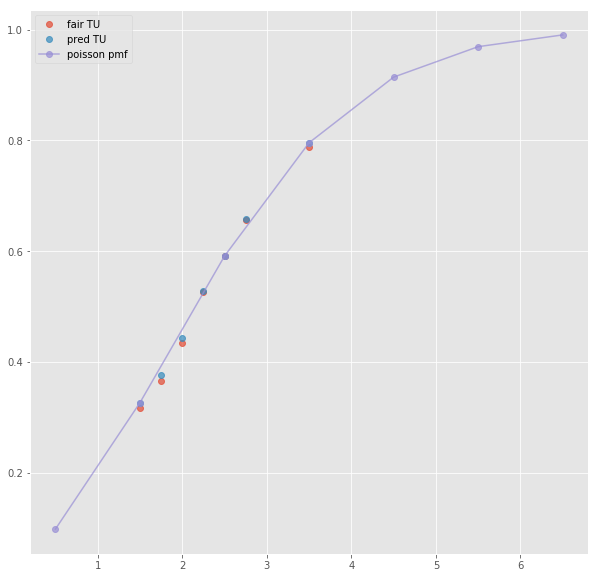

Error T1O:  0.0043096802208481555
ML : 3.34 3.12 2.41
Error home:  0.02756593786986028
Error draw:  0.02872261548590921
Error away:  0.0011565067939220408

(53, 124)
(1, 60)
2.5 2.25 1.625 0.5 1.65 2.2
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.009547734651831286

Error TO:  0.006924440558772171

Error TO:  0.018463264954572955

Error TO:  0.022573559724438308

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.0025953645581843765

Error TO:  0.016912035740595688

Error TO:  0.00927629075225167

Error TO:  0.019463835812848967

Error TO:  0.01555031236588067

Error TO:  0.026633774838264346

Error TO:  0.02934572556484627



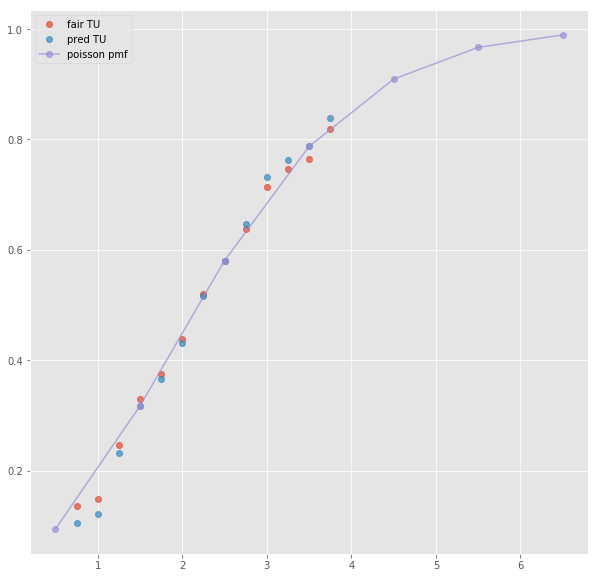

ML : 3.4 3.2 2.2
Error home:  0.018067229899147608
Error draw:  0.01829316214403104
Error away:  0.00022558412428780317

(10, 124)
(1, 33)
2.5 2.29 1.66 0.5 1.64 2.33
TO fair:  2.379518072289157 TU fair:  1.7248908296943233
TO pred:  2.37949 TU fair:  1.72491
Error TO:  0.004647076331203592

Error TO:  0.0038053979160165285

Error TO:  4.957981901365649e-06

Error TO:  0.001988513762080646

Error TO:  0.004110778132189741



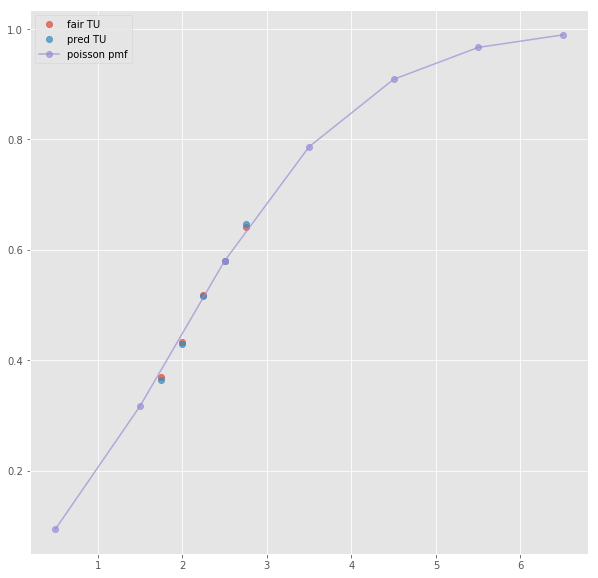

Error T1O:  0.0020152582307305655
ML : 3.26 3.23 2.36
Error home:  0.014713344324988609
Error draw:  0.020389071070663123
Error away:  0.0056758024112942285

(9, 124)
(1, 43)
2.5 2.38 1.621 -0.5 1.793 2.04
TO fair:  2.468229487970389 TU fair:  1.6810924369747902
TO pred:  2.46821 TU fair:  1.6811
Error TO:  0.0033829252446608282

Error TO:  0.0037375292447825448

Error TO:  0.010332809515873675

Error TO:  3.198887500888148e-06

Error TO:  0.0034913861322679596

Error TO:  0.0018943704755892132

Error TO:  0.003680263198956868



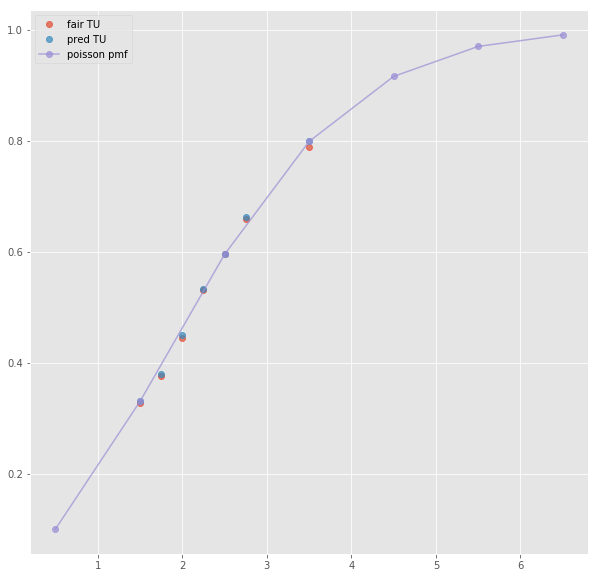

ML : 2.26 3.04 3.73
Error home:  0.10654840992652265
Error draw:  0.053500438236286085
Error away:  0.05304822184161756

(4, 124)
(1, 19)
next list index out of range
(4, 124)
(1, 15)
next list index out of range
(8, 124)
(1, 19)
next list index out of range
(11, 124)
(1, 41)
2.5 2.38 1.621 -0.5 2.26 1.699
TO fair:  2.468229487970389 TU fair:  1.6810924369747902
TO pred:  2.46821 TU fair:  1.6811
Error TO:  0.0033829252446608282

Error TO:  0.0037375292447825448

Error TO:  0.010332809515873675

Error TO:  3.198887500888148e-06

Error TO:  0.0034913861322679596

Error TO:  0.0018943704755892132

Error TO:  0.003680263198956868



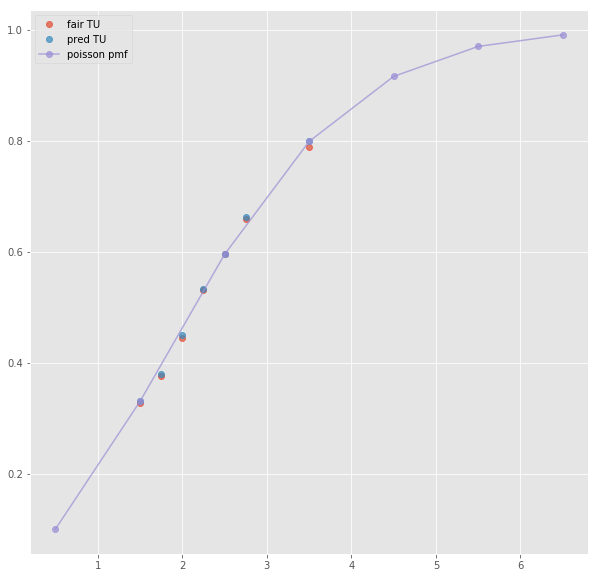

Error T1O:  0.018999887005299976
ML : 2.26 3.04 3.73
Error home:  0.0034924801674856565
Error draw:  0.03665817250631637
Error away:  0.03316541946679824

(67, 124)
(1, 59)
2.5 2.3 1.6 -0.5 2.2 1.65
TO fair:  2.4375 TU fair:  1.695652173913044
TO pred:  2.43757 TU fair:  1.69562
Error TO:  0.00853257503003696

Error TO:  0.005021371315565015

Error TO:  0.015280268315773449

Error TO:  0.02169314738682193

Error TO:  1.1781384213760404e-05

Error TO:  0.01589912457868936

Error TO:  0.012197518946273633

Error TO:  0.01859331286278268

Error TO:  0.011095481227459292

Error TO:  0.017676935702087032

Error TO:  0.02541694567952424

Error TO:  0.03399535885106475

Error TO:  0.0334903090619737



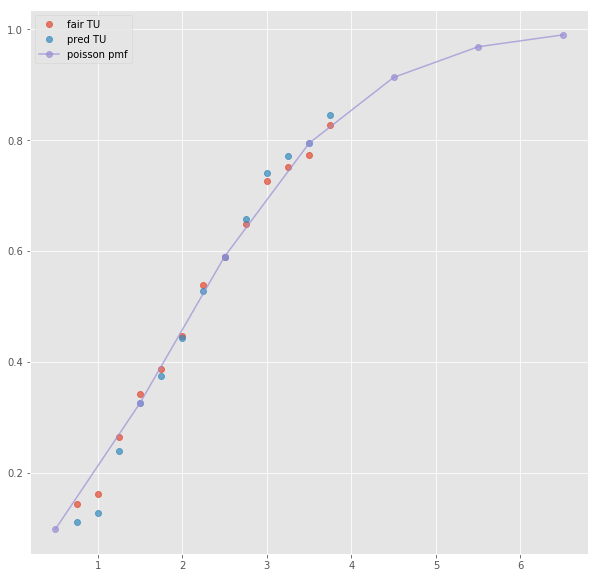

ML : 2.2 3.0 3.6
Error home:  0.0020501246436378517
Error draw:  0.0342757094220712
Error away:  0.03222572804004664

(3, 124)
(1, 33)
2.5 2.37 1.62 -0.5 2.23 1.69
TO fair:  2.462962962962963 TU fair:  1.6835443037974682
TO pred:  2.46302 TU fair:  1.68352
Error TO:  0.00330348923764906

Error TO:  0.0033553853143530876

Error TO:  9.40223576623156e-06

Error TO:  0.001674844029392053

Error TO:  0.003970909056748906



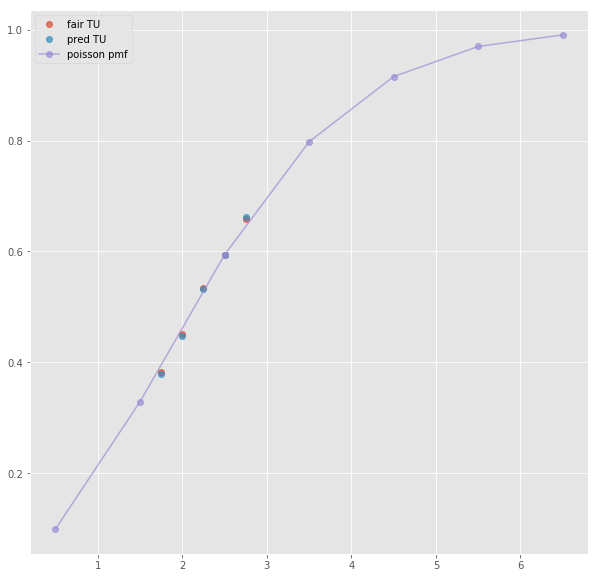

Error T1O:  0.009902365367880472
ML : 2.26 3.13 3.6
Error home:  0.005568916906480481
Error draw:  0.027913900987073137
Error away:  0.022344652439420132

(55, 124)
(1, 47)
3.5 2.66 1.473 -1.5 2.03 1.813
TO fair:  2.805838424983028 TU fair:  1.5537593984962406
TO pred:  2.80588 TU fair:  1.55375
Error TO:  0.013395153749602318

Error TO:  0.05813058381622316

Error TO:  0.008491153206635738

Error TO:  5.280811716024125e-06

Error TO:  0.009296755497841563

Error TO:  0.015263901879525754

Error TO:  0.0070413335094190455

Error TO:  0.006190793188513677

Error TO:  0.0029574995148933247



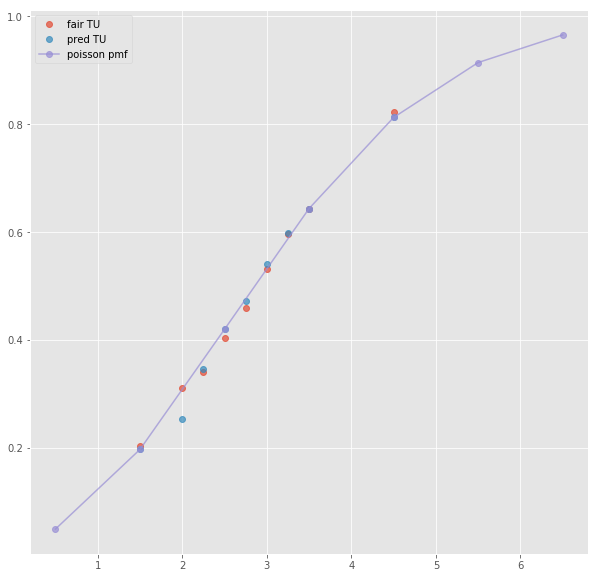

ML : 1.3219999999999998 5.06 9.05
Error home:  0.0018319845934807732
Error draw:  0.0074024551724646
Error away:  0.009234522094918915

(53, 124)
(1, 26)
2.5 1.66 2.16 -1.5 2.16 1.68
TO fair:  1.7685185185185184 TU fair:  2.3012048192771086
TO pred:  1.76851 TU fair:  2.30122
Error TO:  0.007766239965296906

Error TO:  0.00995018636109607

Error TO:  2.723622669176251e-06

Error TO:  0.03143349409460183



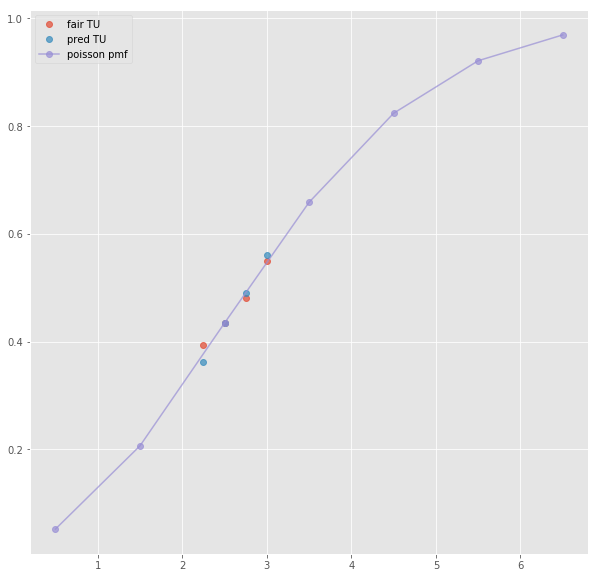

ML : 1.3 4.96 9.21
Error home:  0.0335430840962988
Error draw:  0.004261883525439797
Error away:  0.029281048875689844

(141, 124)
(1, 24)
2.5 1.68 2.25 -1.5 2.17 1.75
TO fair:  1.7466666666666664 TU fair:  2.339285714285714
TO pred:  1.74663 TU fair:  2.33935
Error TO:  0.0031437246764423055

Error TO:  0.0029634138715738945

Error TO:  1.2018782691303187e-05

Error TO:  0.04026952908229775



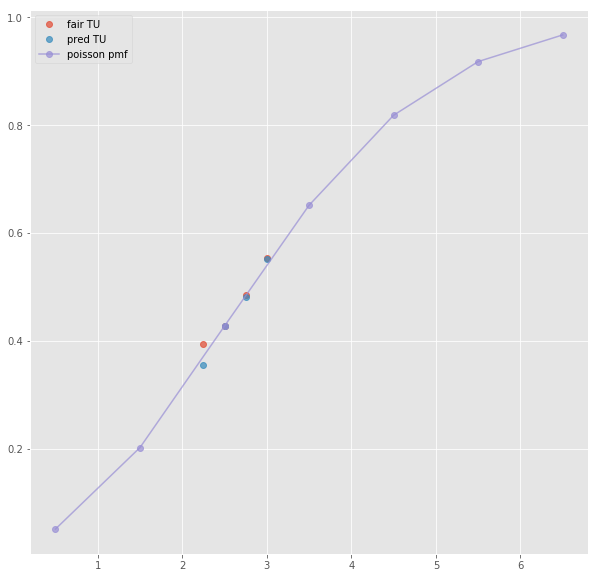

ML : 1.38 4.8 8.4
Error home:  0.0024556684227633463
Error draw:  0.010553306019004921
Error away:  0.013008938072413379

(153, 124)
(1, 26)
2.5 1.7 2.21 -1.5 2.17 1.75
TO fair:  1.7692307692307694 TU fair:  2.3000000000000003
TO pred:  1.7692 TU fair:  2.30004
Error TO:  0.012791278564043385

Error TO:  0.012678752096153767

Error TO:  9.83003863208598e-06

Error TO:  0.0004560937958485445



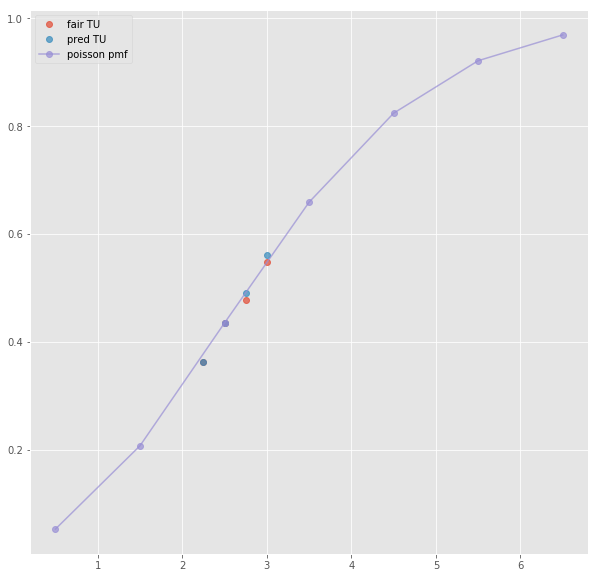

ML : 1.37 4.85 8.7
Error home:  0.0067743091992016335
Error draw:  0.008123455156346382
Error away:  0.014897759166341423

(48, 124)
(1, 49)
3.5 2.66 1.473 -1.5 2.03 1.813
TO fair:  2.805838424983028 TU fair:  1.5537593984962406
TO pred:  2.80588 TU fair:  1.55375
Error TO:  0.013395153749602318

Error TO:  0.05813058381622316

Error TO:  0.008491153206635738

Error TO:  5.280811716024125e-06

Error TO:  0.009296755497841563

Error TO:  0.015263901879525754

Error TO:  0.0070413335094190455

Error TO:  0.006190793188513677

Error TO:  0.0029574995148933247



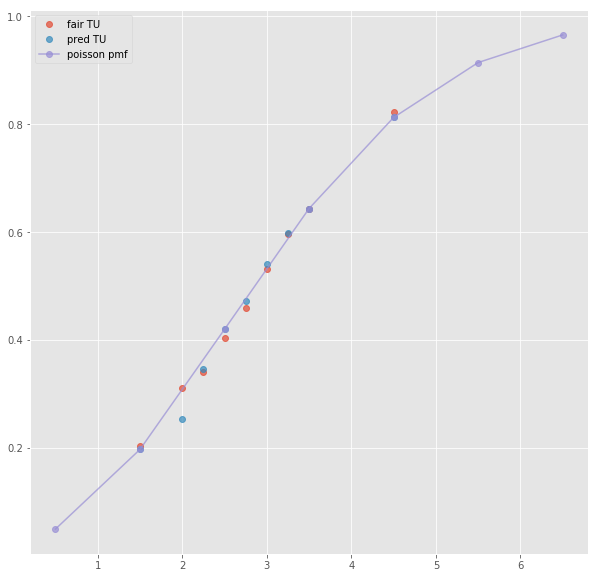

Error T1O:  0.009545789282031425
ML : 1.3219999999999998 5.06 9.05
Error home:  0.0018319845934807732
Error draw:  0.0074024551724646
Error away:  0.009234522094918915

(201, 124)
(1, 71)
3.5 2.75 1.425 -1.5 2.05 1.75
TO fair:  2.929824561403509 TU fair:  1.5181818181818183
TO pred:  2.92984 TU fair:  1.51818
Error TO:  0.04991736185513501

Error TO:  0.018524113220500626

Error TO:  0.011236463341383951

Error TO:  1.7985490940453097e-06

Error TO:  0.004746469309668461

Error TO:  0.019206539751107532

Error TO:  0.028265949221071396

Error TO:  0.024001924436941602

Error TO:  0.001723698215953584

Error TO:  0.030731926345489935

Error TO:  0.003218176895100039

Error TO:  0.010324910414780453

Error TO:  0.004435638359586158

Error TO:  0.024947678360244696

Error TO:  0.009905698346832609



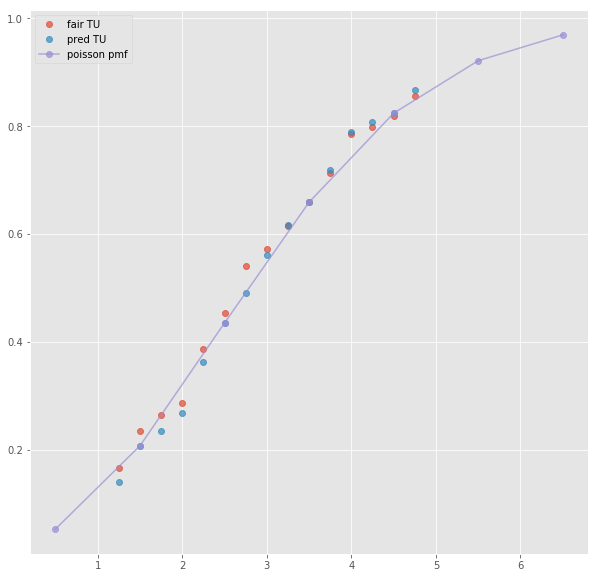

ML : 1.36 4.75 9.5
Error home:  0.0014927014770397262
Error draw:  0.0171037704356094
Error away:  0.015611016650848311

(35, 124)
(1, 37)
2.5 1.69 2.23 -1.5 1.99 1.86
TO fair:  1.7578475336322872 TU fair:  2.319526627218935
TO pred:  1.75782 TU fair:  2.31958
Error TO:  0.0036202623149301782

Error TO:  0.053897668360077144

Error TO:  0.007995739621167786

Error TO:  8.910619577751078e-06

Error TO:  0.001309550905415957

Error TO:  0.010610746313436004



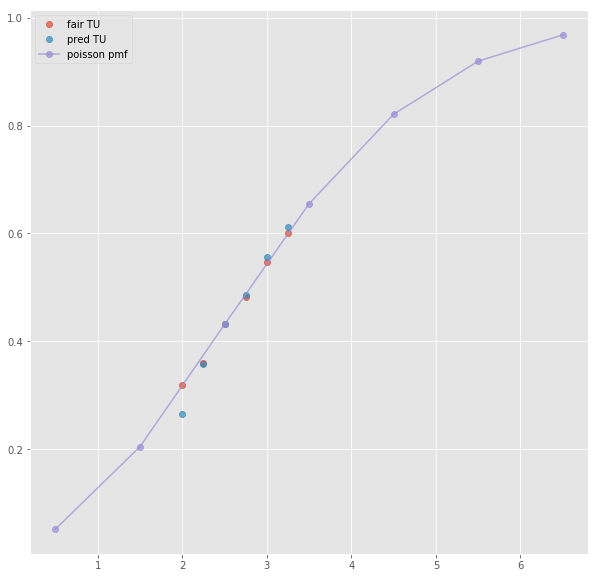

Error T1O:  0.07081353118665223
Error T1O:  0.0067242010661394125
ML : 1.36 5.12 9.03
Error home:  0.015142570445058845
Error draw:  0.012564139974785782
Error away:  0.0025784635466954142

(115, 124)
(1, 43)
2.5 1.99 1.925 -0.5 2.59 1.564
TO fair:  2.0337662337662334 TU fair:  1.9673366834170853
TO pred:  2.03378 TU fair:  1.96733
Error TO:  0.0004527000296969397

Error TO:  0.0020394847168675456

Error TO:  0.0016617023085182536

Error TO:  0.0006711087739561528

Error TO:  0.0024089307531033055

Error TO:  3.3282055106886865e-06

Error TO:  0.0036719027759035683

Error TO:  0.0008983219356449856

Error TO:  0.024409605582230598



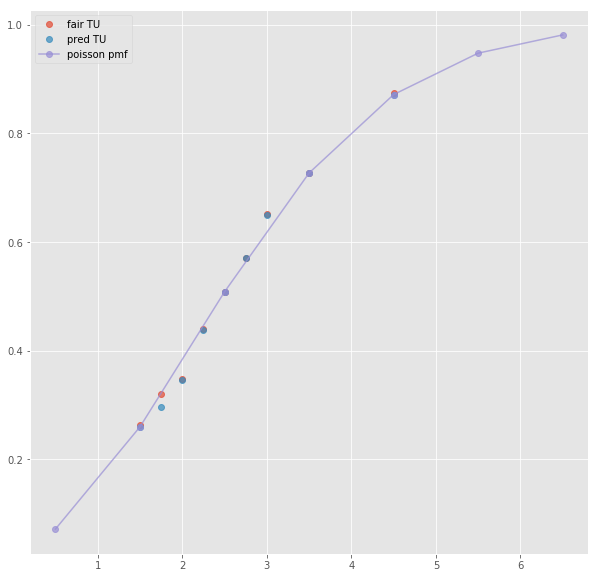

ML : 2.59 3.42 2.87
Error home:  0.000520769568954027
Error draw:  0.023223580398507693
Error away:  0.022702690580286067

(174, 124)
(1, 27)
2.5 1.95 1.89 -0.5 2.51 1.53
TO fair:  2.031746031746032 TU fair:  1.9692307692307693
TO pred:  2.03177 TU fair:  1.96921
Error TO:  0.016945050064933187

Error TO:  0.021296975814649066

Error TO:  5.806205918890139e-06

Error TO:  0.013969982043764206



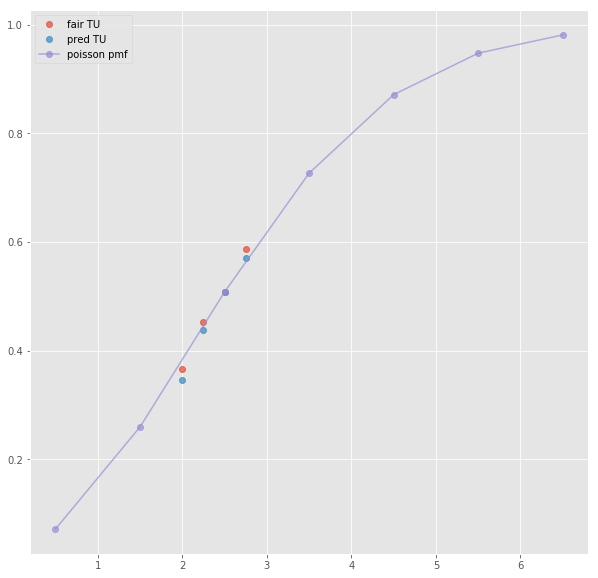

ML : 2.57 3.31 2.75
Error home:  0.009854528182951794
Error draw:  0.025034880157681905
Error away:  0.01518042774179984

(142, 124)
(1, 25)
next list index out of range
(394, 124)
(1, 27)
2.5 1.98 1.94 -0.5 2.61 1.57
TO fair:  2.0206185567010313 TU fair:  1.97979797979798
TO pred:  2.02062 TU fair:  1.97979
Error TO:  0.015213111207269592

Error TO:  0.02162633586918694

Error TO:  3.53498289695775e-07

Error TO:  0.0017766068777255173



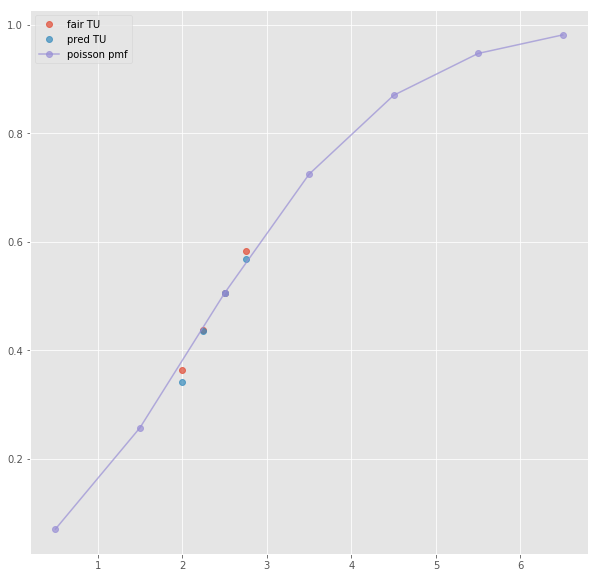

ML : 2.56 3.35 2.85
Error home:  4.97721562853215e-06
Error draw:  0.026244428717022317
Error away:  0.02624964592075918

(109, 124)
(1, 45)
2.5 1.99 1.925 -0.5 2.59 1.564
TO fair:  2.0337662337662334 TU fair:  1.9673366834170853
TO pred:  2.03378 TU fair:  1.96733
Error TO:  0.0004527000296969397

Error TO:  0.0020394847168675456

Error TO:  0.0016617023085182536

Error TO:  0.0006711087739561528

Error TO:  0.0024089307531033055

Error TO:  3.3282055106886865e-06

Error TO:  0.0036719027759035683

Error TO:  0.0008983219356449856

Error TO:  0.024409605582230598



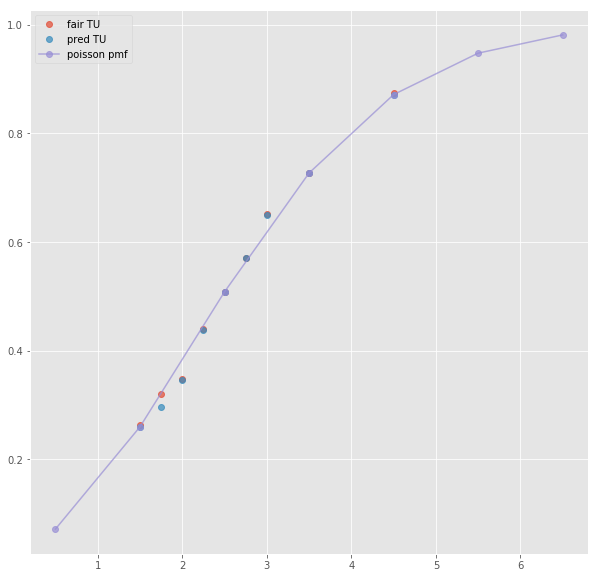

Error T1O:  0.011502848893248263
ML : 2.59 3.42 2.87
Error home:  0.000520769568954027
Error draw:  0.023223580398507693
Error away:  0.022702690580286067

(26, 124)
(1, 64)
2.5 2.05 1.75 -0.5 2.375 1.55
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17137 TU fair:  1.8537
Error TO:  0.00553519951934639

Error TO:  0.013601482666040221

Error TO:  0.016165847866408345

Error TO:  0.018186318005699253

Error TO:  1.2422426491298655e-05

Error TO:  0.019544129112695985

Error TO:  0.0023894734005991403

Error TO:  0.010867722361024845

Error TO:  0.01589457400388683

Error TO:  0.015531073378818011

Error TO:  0.016659109888788493

Error TO:  0.0176332615127954

Error TO:  0.018742052420808952

Error TO:  0.03452538387395965



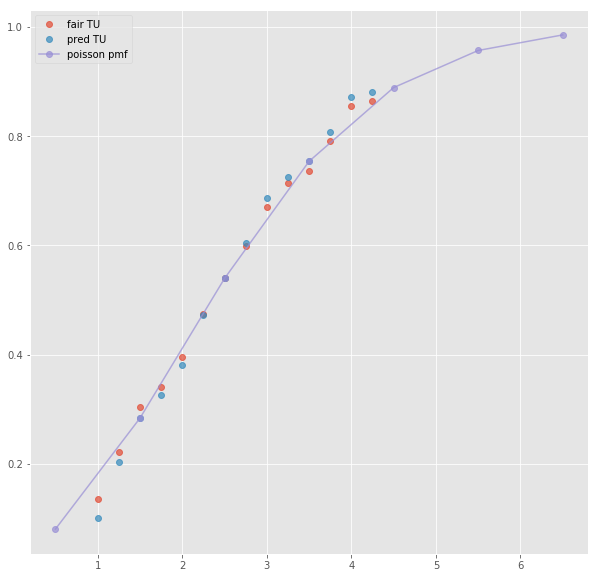

ML : 2.55 3.3 2.8
Error home:  0.022243700963318458
Error draw:  0.019600724004642023
Error away:  0.00264292024123175

(9, 124)
(1, 33)
2.5 2.11 1.77 -0.5 2.55 1.54
TO fair:  2.192090395480226 TU fair:  1.8388625592417065
TO pred:  2.19208 TU fair:  1.83887
Error TO:  0.004414614401592187

Error TO:  0.0012340679473666905

Error TO:  2.1633644946561503e-06

Error TO:  0.0012274841902301104

Error TO:  0.00299801899763652



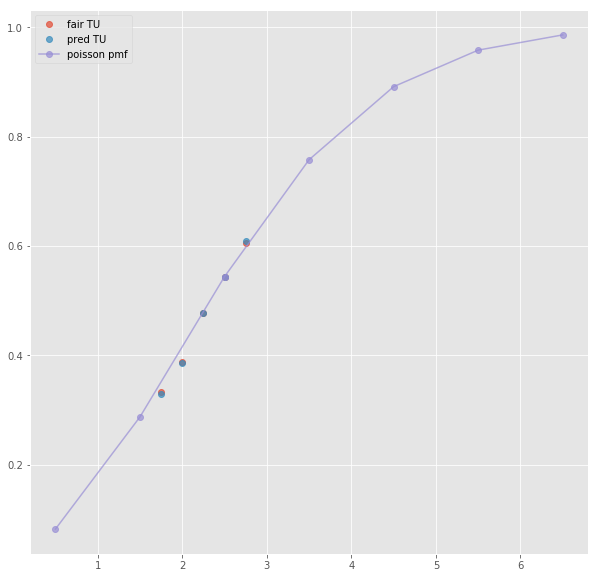

Error T1O:  0.010707424019804401
ML : 2.59 3.28 2.87
Error home:  0.0050691956402723615
Error draw:  0.023368983754496975
Error away:  0.018299696188136205

(28, 124)
(1, 41)
2.5 2.67 1.52 0.5 1.526 2.69
TO fair:  2.7565789473684212 TU fair:  1.5692883895131087
TO pred:  2.75655 TU fair:  1.5693
Error TO:  0.0035274375561635263

Error TO:  0.005524317054638461

Error TO:  3.8095421151518316e-06

Error TO:  0.004292338721262223

Error TO:  0.0005233652578790493

Error TO:  0.003794690621762853

Error TO:  0.01565355429569426



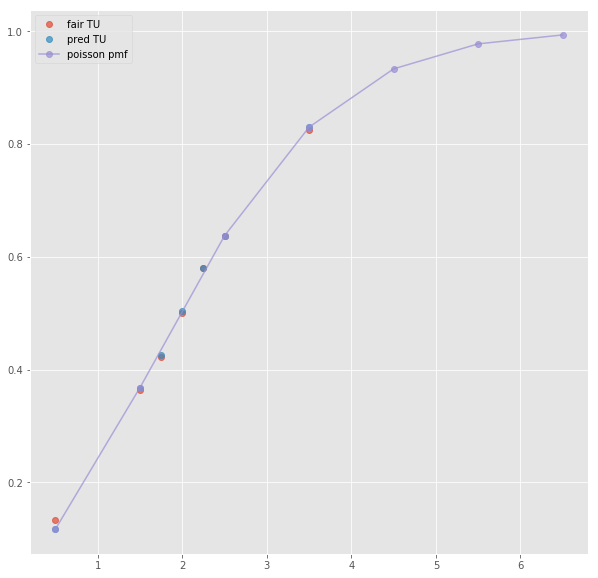

ML : 3.11 2.98 2.69
Error home:  0.029908109222739954
Error draw:  0.030541493778114603
Error away:  0.000633805912052976

(13, 124)
(1, 27)
next list index out of range
(43, 124)
(1, 21)
next list index out of range
(79, 124)
(1, 27)
next list index out of range
(28, 124)
(1, 43)
2.5 2.67 1.52 0.5 1.526 2.69
TO fair:  2.7565789473684212 TU fair:  1.5692883895131087
TO pred:  2.75655 TU fair:  1.5693
Error TO:  0.0035274375561635263

Error TO:  0.005524317054638461

Error TO:  3.8095421151518316e-06

Error TO:  0.004292338721262223

Error TO:  0.0005233652578790493

Error TO:  0.003794690621762853

Error TO:  0.01565355429569426



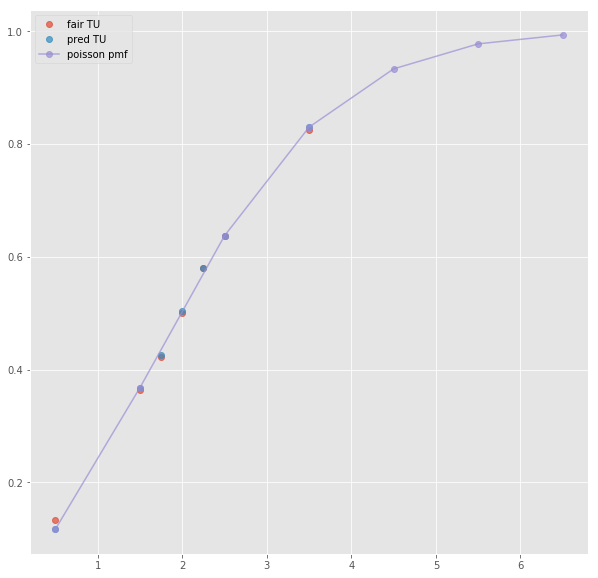

Error T1O:  0.01581305994648141
ML : 3.11 2.98 2.69
Error home:  0.029908109222739954
Error draw:  0.030541493778114603
Error away:  0.000633805912052976

(17, 124)
(1, 62)
2.5 2.5 1.5 -0.5 2.85 1.4
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.003721510072886125

Error TO:  0.019040660831705525

Error TO:  0.004568112034905175

Error TO:  0.017673153762311128

Error TO:  6.56261484577314e-06

Error TO:  0.01835574355840064

Error TO:  0.013764966559658143

Error TO:  0.010710787105882885

Error TO:  0.007441381525318258

Error TO:  0.011579562296835239

Error TO:  0.0196081920208222

Error TO:  0.032973713938759364

Error TO:  0.033400954857766285



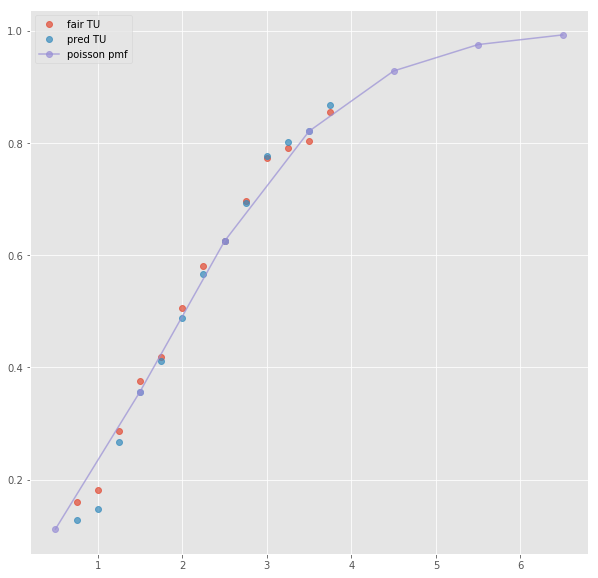

ML : 3.1 3.0 2.45
Error home:  0.0262623657181984
Error draw:  0.021737374531398346
Error away:  0.004524993422571566

(15, 124)
next positional indexers are out-of-bounds
(25, 124)
(1, 43)
2.5 2.3 1.662 -0.5 1.884 2.01
TO fair:  2.3838748495788202 TU fair:  1.7226086956521738
TO pred:  2.38386 TU fair:  1.72262
Error TO:  0.0049271054546001225

Error TO:  0.0020363273958245998

Error TO:  0.009810382625145164

Error TO:  2.61306334398137e-06

Error TO:  0.0012832908243246566

Error TO:  0.00010909704173339696

Error TO:  0.0009740064323633391

Error TO:  0.035339162829202686



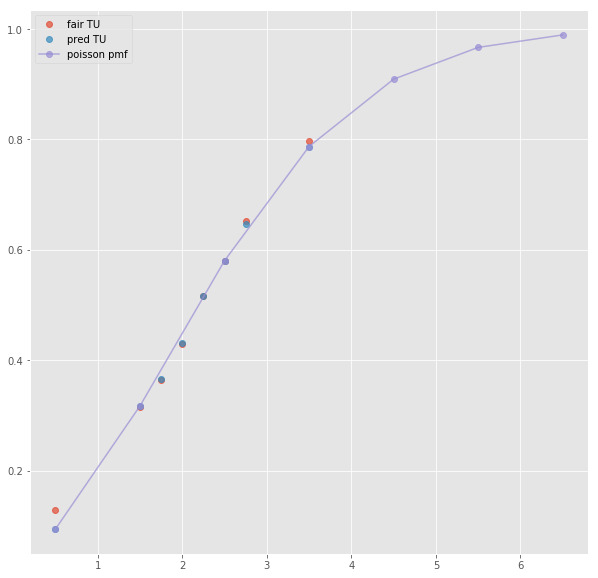

ML : 1.884 3.36 4.83
Error home:  0.0035525804514631165
Error draw:  0.02439527851050266
Error away:  0.02084266511309535

(17, 124)
(1, 21)
next list index out of range
(59, 124)
(1, 21)
next list index out of range
(62, 124)
(1, 21)
next list index out of range
(22, 124)
(1, 45)
2.5 2.3 1.662 -0.5 1.884 2.01
TO fair:  2.3838748495788202 TU fair:  1.7226086956521738
TO pred:  2.38386 TU fair:  1.72262
Error TO:  0.0049271054546001225

Error TO:  0.0020363273958245998

Error TO:  0.009810382625145164

Error TO:  2.61306334398137e-06

Error TO:  0.0012832908243246566

Error TO:  0.00010909704173339696

Error TO:  0.0009740064323633391

Error TO:  0.035339162829202686



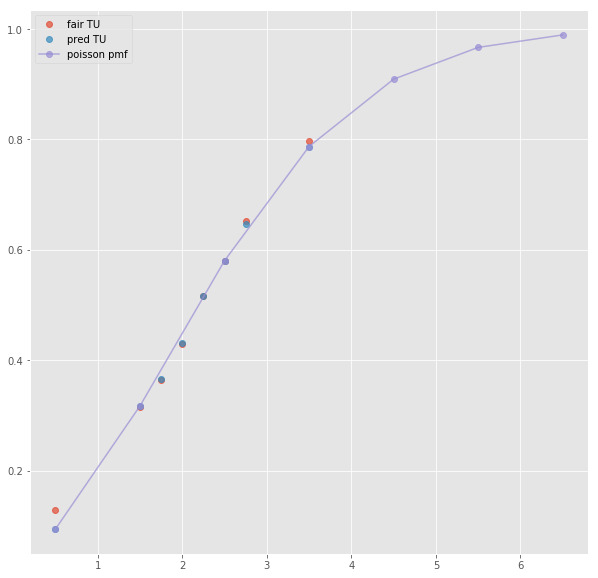

Error T1O:  0.006141291883431599
ML : 1.884 3.36 4.83
Error home:  0.0035525804514631165
Error draw:  0.02439527851050266
Error away:  0.02084266511309535

(81, 124)
(1, 60)
2.5 2.25 1.625 -0.5 1.825 2.025
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.0009003040170663112

Error TO:  0.016384364879377666

Error TO:  0.005660988994402261

Error TO:  0.014579997301658959

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.028911154031868613

Error TO:  0.016912035740595688

Error TO:  0.020352240119340337

Error TO:  0.011428927950369011

Error TO:  0.022057817955149273

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



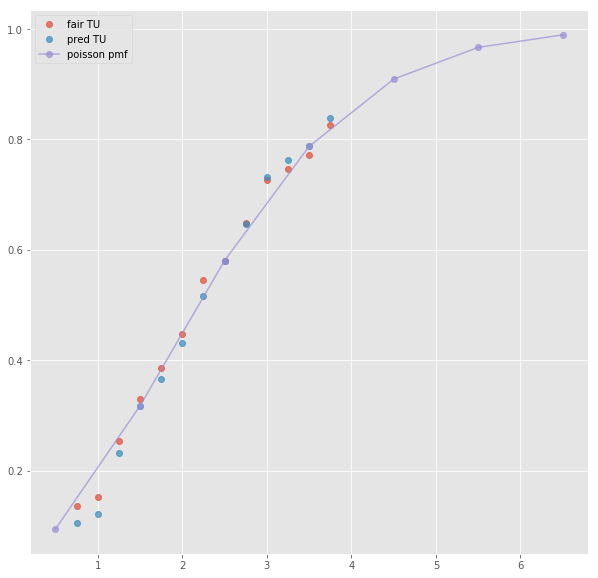

ML : 1.85 3.3 4.5
Error home:  0.0187976255914466
Error draw:  0.02330349443675933
Error away:  0.004505687308897971

(2, 124)
(1, 32)
2.5 2.34 1.63 -0.5 1.86 1.99
TO fair:  2.4355828220858897 TU fair:  1.6965811965811965
TO pred:  2.43558 TU fair:  1.69658
Error TO:  0.003369334702675253

Error TO:  0.0042269314050905615

Error TO:  4.7573480504992105e-07

Error TO:  0.0015947301762967991

Error TO:  0.005265453314346802



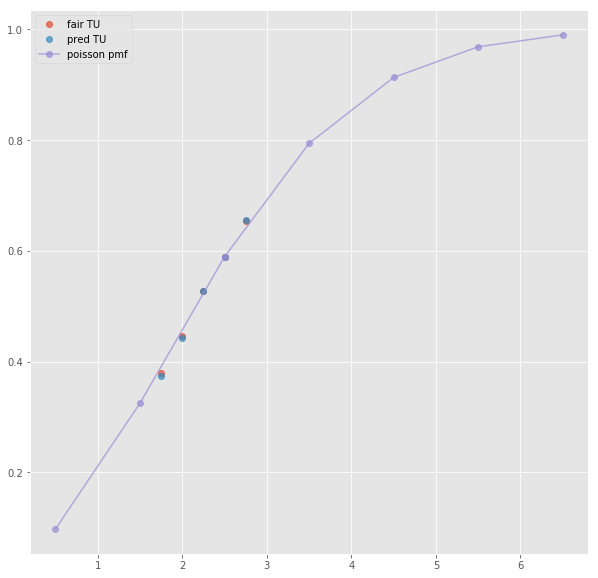

Error T1O:  0.005849513577694754
ML : 1.87 3.45 4.64
Error home:  0.0027627616175824876
Error draw:  0.013702069430210795
Error away:  0.0109391623049718

(32, 124)
next positional indexers are out-of-bounds
(52, 124)
next positional indexers are out-of-bounds
(83, 124)
next positional indexers are out-of-bounds
(203, 124)
next positional indexers are out-of-bounds
(23, 124)
(1, 46)
3.5 2.92 1.4340000000000002 -0.5 1.877 2.02
TO fair:  3.0362622036262197 TU fair:  1.4910958904109588
TO pred:  3.03628 TU fair:  1.49109
Error TO:  0.013807742022999059

Error TO:  0.008746051223197604

Error TO:  1.9304138573761342e-06

Error TO:  0.009026986463181952

Error TO:  0.015699941262398043

Error TO:  0.0001199314262315676

Error TO:  0.012280512539640243

Error TO:  0.0036614652600131525



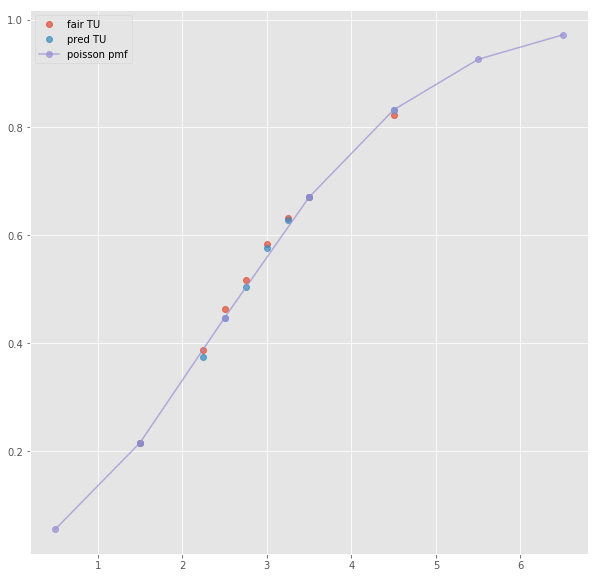

Error T1O:  0.004536333938454873
ML : 1.877 3.73 4.28
Error home:  0.003355141231413339
Error draw:  0.024034735881913794
Error away:  0.020679773681482827

(30, 124)
(1, 68)
3.5 2.5 1.5 -0.5 1.875 1.975
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.01526072004546808

Error TO:  0.011659331857368338

Error TO:  0.02253280098523719

Error TO:  6.56261484577314e-06

Error TO:  0.007446642532960512

Error TO:  0.018042515322542085

Error TO:  0.024340724817056292

Error TO:  0.02288588915018097

Error TO:  0.011973130611186988

Error TO:  0.027951582523409346

Error TO:  0.0035467397737521666

Error TO:  0.006359533221907437

Error TO:  0.0014226721918641494

Error TO:  0.024801797381581947

Error TO:  0.009081106112049597



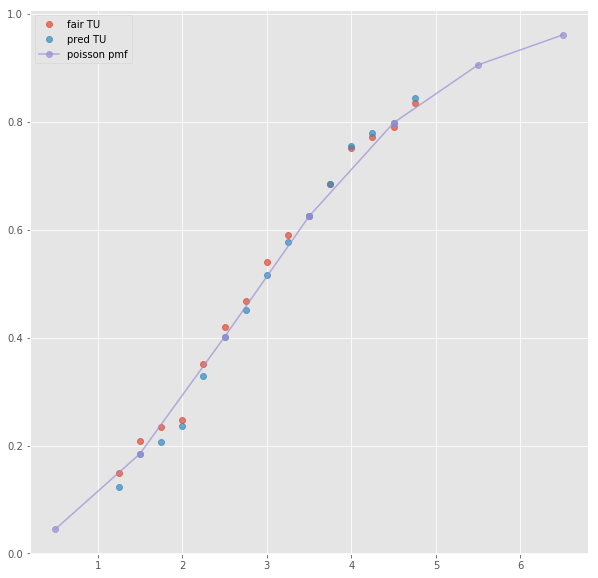

ML : 1.83 3.75 4.0
Error home:  0.0010178036857508843
Error draw:  0.023170847310537285
Error away:  0.02418880381085431

(16, 124)
(1, 34)
3.5 2.56 1.54 -0.5 1.84 2.01
TO fair:  2.6623376623376624 TU fair:  1.6015625
TO pred:  2.66231 TU fair:  1.60157
Error TO:  0.0501190120407613

Error TO:  0.052705598532322484

Error TO:  3.902717528148081e-06

Error TO:  0.04914753979763142

Error TO:  0.05092128449088251

Error TO:  0.04300612437245832



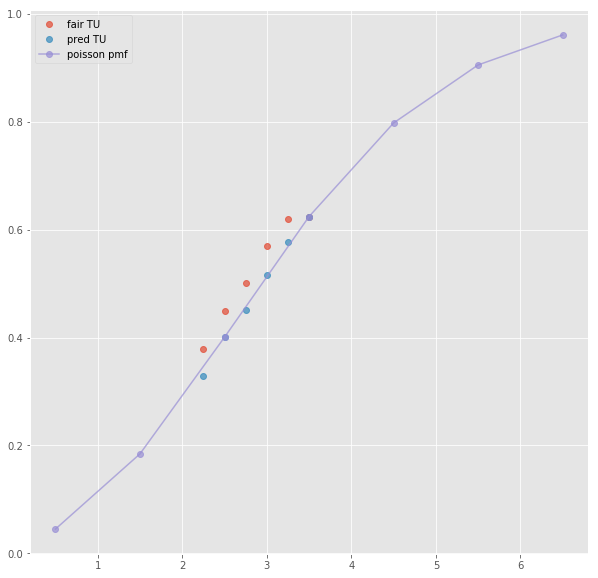

Error T1O:  0.02468851151567475
ML : 1.85 3.83 4.18
Error home:  0.00276886440639601
Error draw:  0.024782447265898788
Error away:  0.02201377549173178

(114, 124)
next positional indexers are out-of-bounds
(148, 124)
next positional indexers are out-of-bounds
(201, 124)
next positional indexers are out-of-bounds
(742, 124)
next positional indexers are out-of-bounds
(99, 124)
(1, 45)
2.5 1.943 1.952 -0.5 2.08 1.84
TO fair:  1.9953893442622952 TU fair:  2.0046320123520327
TO pred:  1.99543 TU fair:  2.0046
Error TO:  0.0005701788511862094

Error TO:  0.0003653081062385821

Error TO:  0.0018360280960971753

Error TO:  0.001169509659038559

Error TO:  0.0021471338075808033

Error TO:  1.0210751335670842e-05

Error TO:  0.00033599487940538797

Error TO:  4.001020653421339e-05



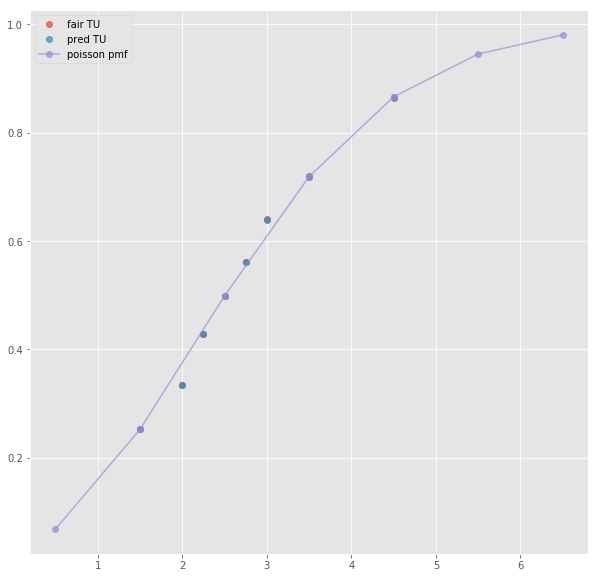

Error T1O:  0.0036438889981249
Error T1O:  0.010816517954118754
ML : 2.08 3.6 3.71
Error home:  0.0017526457507652249
Error draw:  0.017363826346240008
Error away:  0.015611050625850609

(139, 124)
(1, 65)
2.5 2.0 1.8 -0.5 2.06 1.87
TO fair:  2.111111111111111 TU fair:  1.9000000000000001
TO pred:  2.11116 TU fair:  1.89996
Error TO:  0.037579380450733446

Error TO:  0.024728025880532467

Error TO:  0.046744774997455996

Error TO:  0.0461757555248527

Error TO:  0.033786476865588264

Error TO:  1.0969275060501715e-05

Error TO:  0.009249980369407385

Error TO:  0.02921155448971191

Error TO:  0.04099958909747686

Error TO:  0.009702797040875288

Error TO:  0.03566887008579003

Error TO:  0.03373072276277672

Error TO:  0.04581668859026952

Error TO:  0.002473972394991586



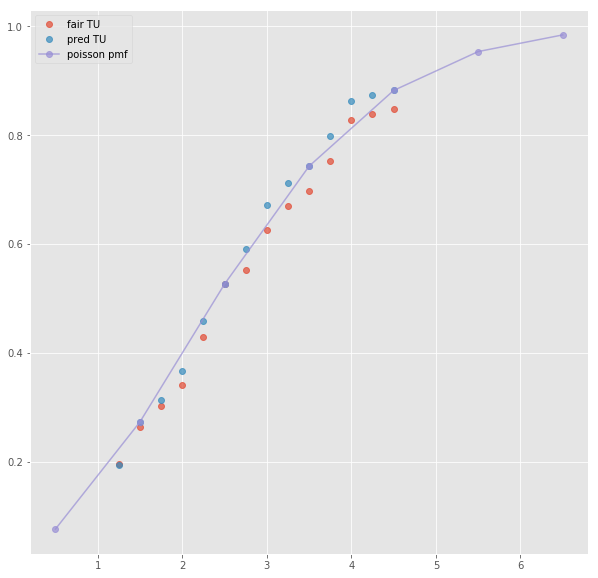

ML : 2.0 3.5 3.8
Error home:  0.000892680632759546
Error draw:  0.014567138636502386
Error away:  0.015459506020981839

(47, 124)
next positional indexers are out-of-bounds
(128, 124)
(1, 47)
2.5 1.787 2.12 -0.5 1.961 1.961
TO fair:  1.8429245283018865 TU fair:  2.186345831001679
TO pred:  1.84295 TU fair:  2.18631
Error TO:  0.0002770838696488642

Error TO:  0.01495412362546622

Error TO:  0.00045946666291712956

Error TO:  0.00032136055315357126

Error TO:  0.0033758962899630984

Error TO:  7.499577471814511e-06

Error TO:  0.0019864836110615736

Error TO:  0.0007329568799040453

Error TO:  0.000875557078646505



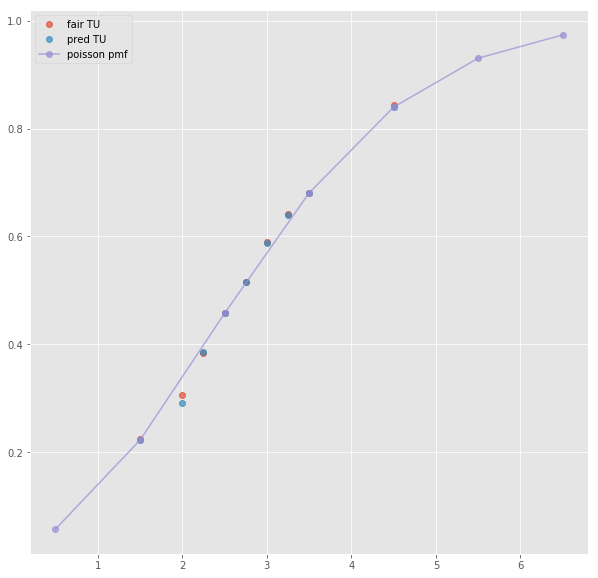

ML : 1.961 3.67 4.1
Error home:  0.0031514782631932303
Error draw:  0.02537119166483104
Error away:  0.02221961822293564

(153, 124)
(1, 27)
2.5 1.76 2.08 -0.5 1.94 1.93
TO fair:  1.8461538461538463 TU fair:  2.181818181818182
TO pred:  1.84615 TU fair:  2.18182
Error TO:  0.004942451528574476

Error TO:  0.0028012829186304655

Error TO:  1.1284745732309531e-06

Error TO:  0.023039253494772982



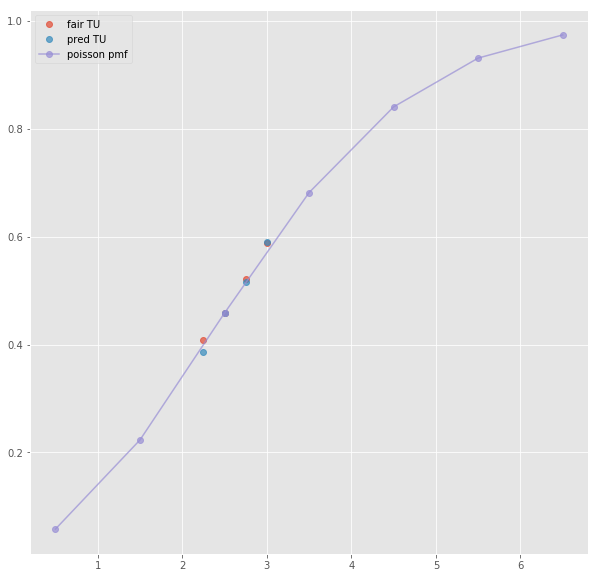

ML : 1.94 3.61 3.76
Error home:  0.011712593591733989
Error draw:  0.021213757207120404
Error away:  0.009501091641783088

(228, 124)
(1, 25)
2.5 1.79 2.14 -0.5 1.99 1.96
TO fair:  1.836448598130841 TU fair:  2.195530726256983
TO pred:  1.83644 TU fair:  2.19555
Error TO:  0.0077019770703398716

Error TO:  0.009137770464223371

Error TO:  2.549461916578899e-06

Error TO:  0.014312252202366427



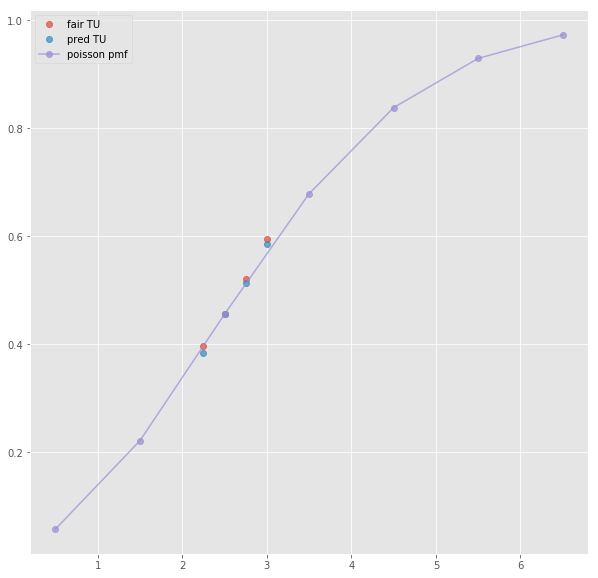

ML : 1.97 3.6 3.9
Error home:  0.00896519984029176
Error draw:  0.02629818697204067
Error away:  0.01733281628751171

(397, 124)
(1, 27)
2.5 1.81 2.12 -0.5 1.97 1.98
TO fair:  1.8537735849056605 TU fair:  2.1712707182320443
TO pred:  1.85378 TU fair:  2.17126
Error TO:  0.0005099288628165333

Error TO:  0.0007194586413091786

Error TO:  1.866758620905351e-06

Error TO:  0.012524867819181718



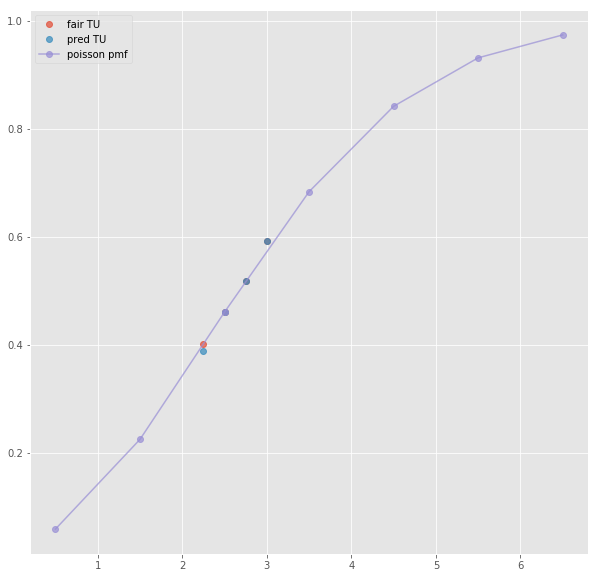

ML : 1.96 3.7 3.85
Error home:  0.01079108763177894
Error draw:  0.019287272610616274
Error away:  0.008496390299148227

(109, 124)
(1, 49)
2.5 1.787 2.12 -0.5 1.961 1.961
TO fair:  1.8429245283018865 TU fair:  2.186345831001679
TO pred:  1.84295 TU fair:  2.18631
Error TO:  0.0002770838696488642

Error TO:  0.01495412362546622

Error TO:  0.00045946666291712956

Error TO:  0.00032136055315357126

Error TO:  0.0033758962899630984

Error TO:  7.499577471814511e-06

Error TO:  0.0019864836110615736

Error TO:  0.0007329568799040453

Error TO:  0.000875557078646505



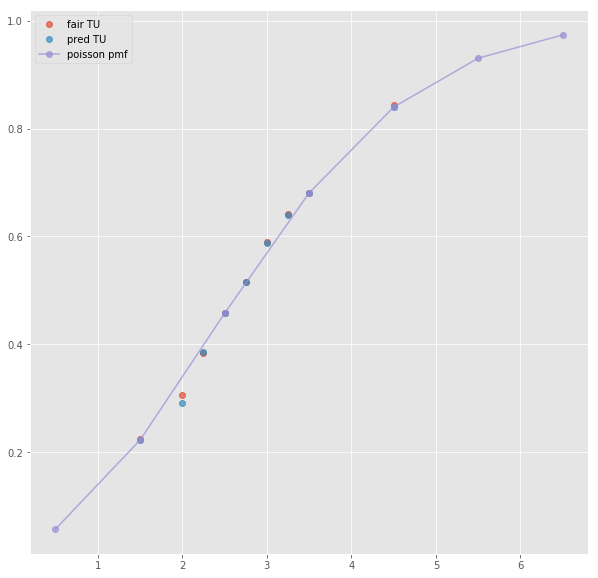

Error T1O:  0.017297718827215203
ML : 1.961 3.67 4.1
Error home:  0.0031514782631932303
Error draw:  0.02537119166483104
Error away:  0.02221961822293564

(156, 124)
(1, 69)
3.5 2.85 1.4 -0.5 2.01 1.92
TO fair:  3.0357142857142856 TU fair:  1.4912280701754383
TO pred:  3.03568 TU fair:  1.49124
Error TO:  0.02309171372529123

Error TO:  0.023178453908127117

Error TO:  0.01404413030247842

Error TO:  3.7204572441718042e-06

Error TO:  0.005405694091826729

Error TO:  0.020147548771052848

Error TO:  0.02596506964252021

Error TO:  0.02040485891898225

Error TO:  0.008922298921189675

Error TO:  0.02076419431786314

Error TO:  0.009250777385402309

Error TO:  0.007345720255009541

Error TO:  0.0033291803006234577

Error TO:  0.025898092781382887

Error TO:  0.013202507524611384



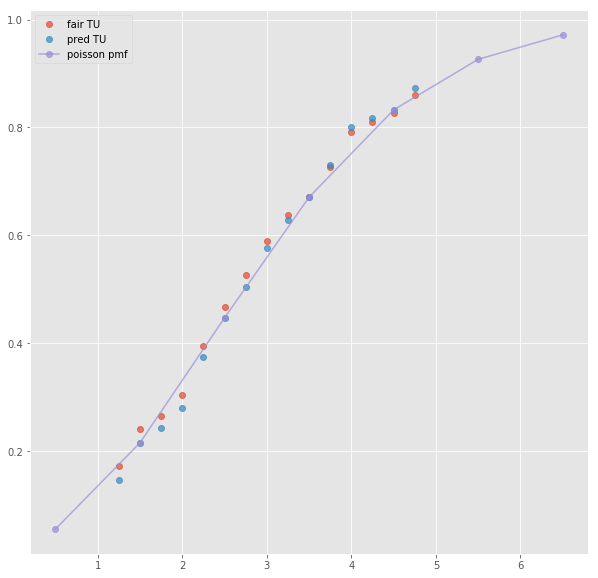

ML : 1.91 3.5 4.0
Error home:  0.005721753896945625
Error draw:  0.029912485704561953
Error away:  0.03563405399035388

(57, 124)
next positional indexers are out-of-bounds
(129, 124)
(1, 45)
2.5 2.05 1.833 -0.5 2.17 1.751
TO fair:  2.1183851609383524 TU fair:  1.8941463414634145
TO pred:  2.11835 TU fair:  1.89418
Error TO:  0.003403816284606287

Error TO:  0.0040762181318391155

Error TO:  0.007544134389593282

Error TO:  0.009451773918021322

Error TO:  0.00890248480359973

Error TO:  7.835339412176623e-06

Error TO:  0.006904138619486688

Error TO:  0.00022553935142610726

Error TO:  0.0023257769108376847



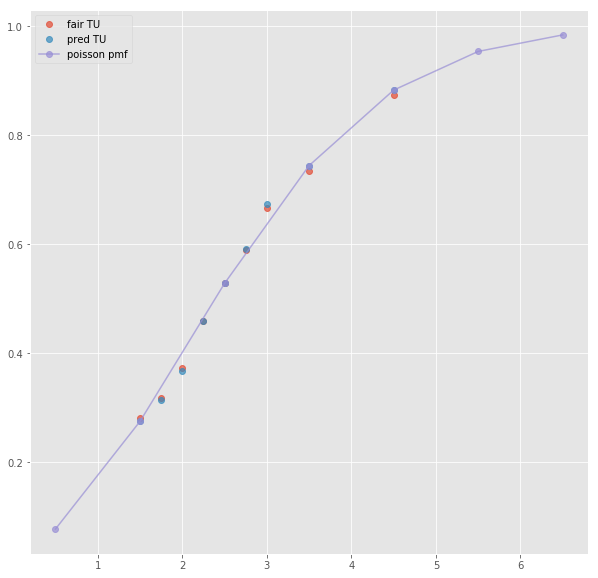

ML : 2.17 3.44 3.52
Error home:  0.0015760030889319654
Error draw:  0.01886749433105772
Error away:  0.017291350616857604

(99, 124)
(1, 27)
2.5 1.92 1.88 -0.5 2.08 1.74
TO fair:  2.021276595744681 TU fair:  1.9791666666666667
TO pred:  2.02132 TU fair:  1.97913
Error TO:  0.013258859830102332

Error TO:  0.04045259024002701

Error TO:  1.0623594586922636e-05

Error TO:  0.0007189465629278136



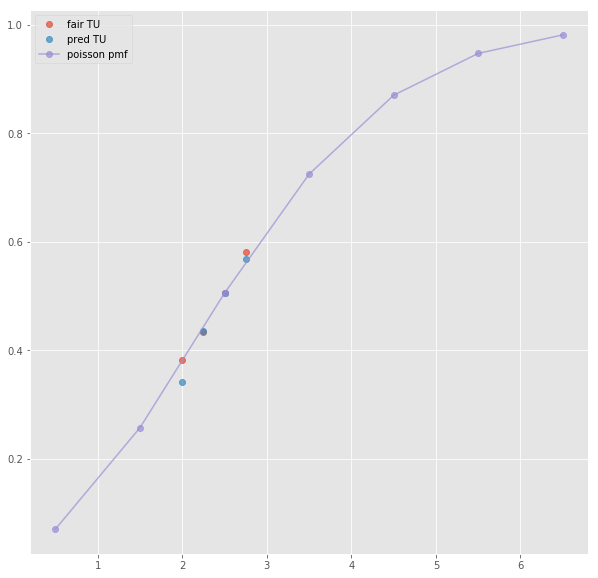

ML : 2.08 3.36 3.51
Error home:  0.0033302260943002815
Error draw:  0.02403531114557389
Error away:  0.020705188051468204

(146, 124)
(1, 27)
2.5 1.94 1.94 -0.5 2.14 1.77
TO fair:  2.0 TU fair:  2.0
TO pred:  2.00004 TU fair:  1.99996
Error TO:  0.000914191839148204

Error TO:  0.06565051639231978

Error TO:  9.999800003934745e-06

Error TO:  0.010205208019007816



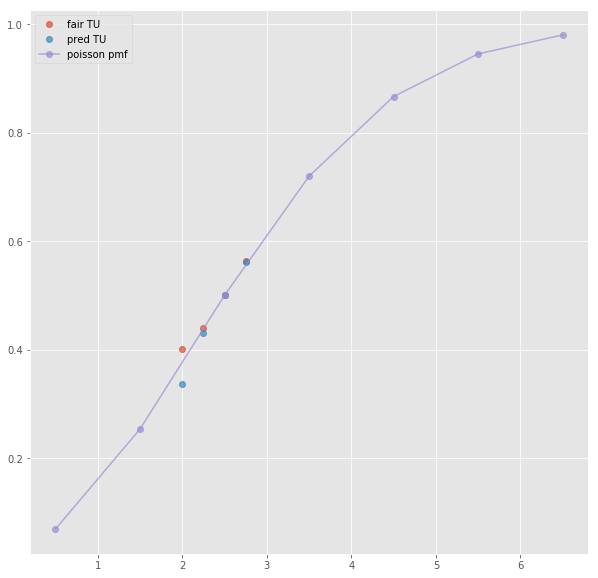

ML : 2.14 3.4 3.5
Error home:  0.00643236995365809
Error draw:  0.025833333255860347
Error away:  0.019400692520147866

(189, 124)
(1, 23)
2.5 1.98 1.9 -0.5 2.11 1.8
TO fair:  2.042105263157895 TU fair:  1.9595959595959596
TO pred:  2.04215 TU fair:  1.95955
Error TO:  0.00042796573522724257

Error TO:  1.0727525644405045e-05

Error TO:  0.009227534588659658



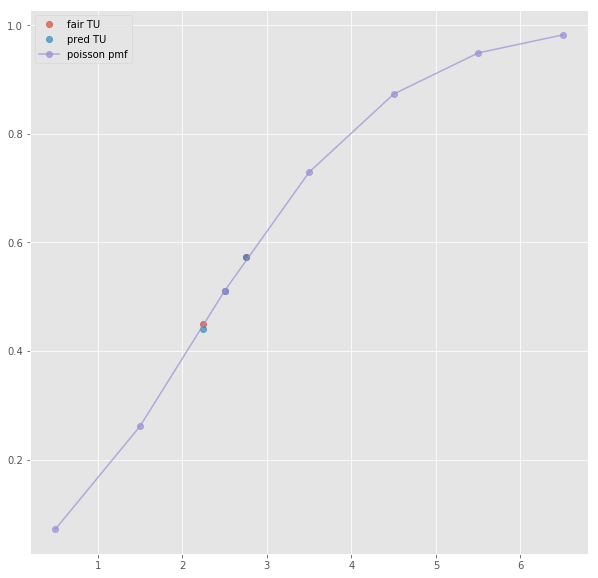

ML : 2.09 3.35 3.65
Error home:  0.005095922809354059
Error draw:  0.02764952658520453
Error away:  0.02255371228867442

(98, 124)
(1, 47)
2.5 2.0 1.877 -0.5 2.16 1.763
TO fair:  2.0655301012253595 TU fair:  1.9385
TO pred:  2.06551 TU fair:  1.93852
Error TO:  0.0018676346019218526

Error TO:  0.008017520720958737

Error TO:  0.0045050213624160396

Error TO:  0.005784090250402052

Error TO:  0.005133531364716698

Error TO:  4.711548892977202e-06

Error TO:  0.011217765817845171

Error TO:  0.0023055770281027455

Error TO:  0.013493752775664336



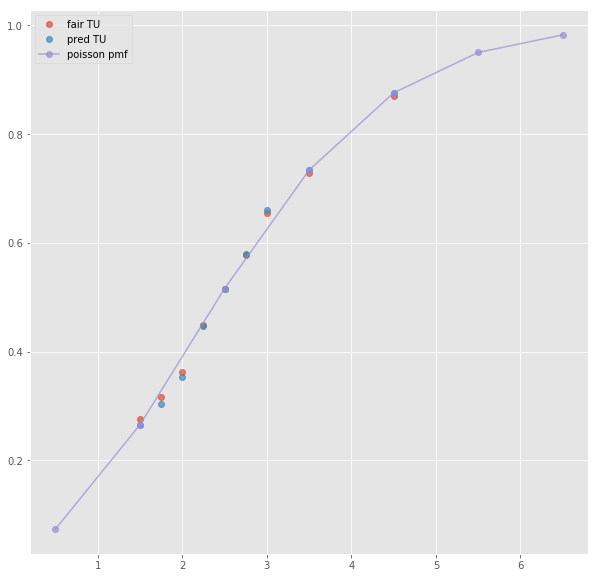

Error T1O:  0.007287341895901023
ML : 2.16 3.48 3.51
Error home:  0.0021955681929982096
Error draw:  0.018738026943448727
Error away:  0.016542588222165644

(48, 124)
(1, 63)
2.5 2.075 1.725 -0.5 2.025 1.825
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20286 TU fair:  1.83135
Error TO:  0.04917099950178089

Error TO:  0.03754412195413648

Error TO:  0.05613689340409417

Error TO:  0.04591913243870019

Error TO:  0.04070609206410726

Error TO:  7.944217971178613e-06

Error TO:  0.024837344361413494

Error TO:  0.041214763539663135

Error TO:  0.060111702497567976

Error TO:  0.028331901374935242

Error TO:  0.04129311889561295

Error TO:  0.045412070127688886

Error TO:  0.054735386389599766

Error TO:  0.004929234337926913



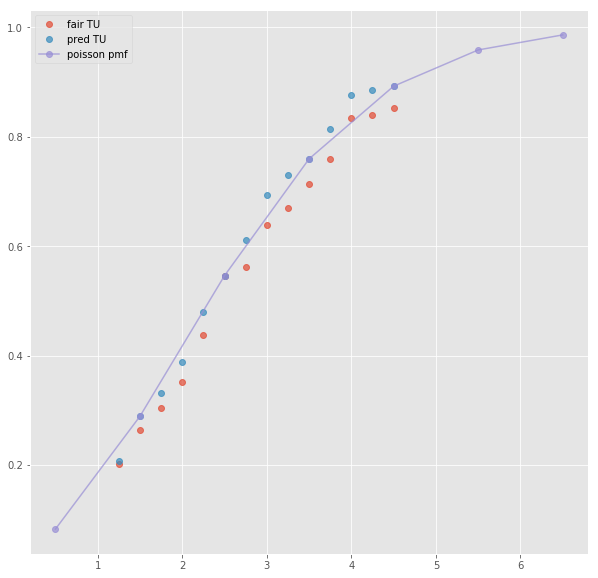

ML : 2.0 3.5 3.8
Error home:  0.002661020849533957
Error draw:  0.00993355319863165
Error away:  0.012594667778805302

(35, 124)
next positional indexers are out-of-bounds
(81, 124)
(1, 44)
3.5 2.69 1.5 0.5 2.3 1.675
TO fair:  2.793333333333333 TU fair:  1.557620817843866
TO pred:  2.79328 TU fair:  1.55764
Error TO:  0.0037936029249342473

Error TO:  0.001368177778857338

Error TO:  6.8353615673144574e-06

Error TO:  0.00107398014169105

Error TO:  0.004138774320306737

Error TO:  0.00024800011925107945

Error TO:  0.004076844095886045

Error TO:  0.0003830178336112766



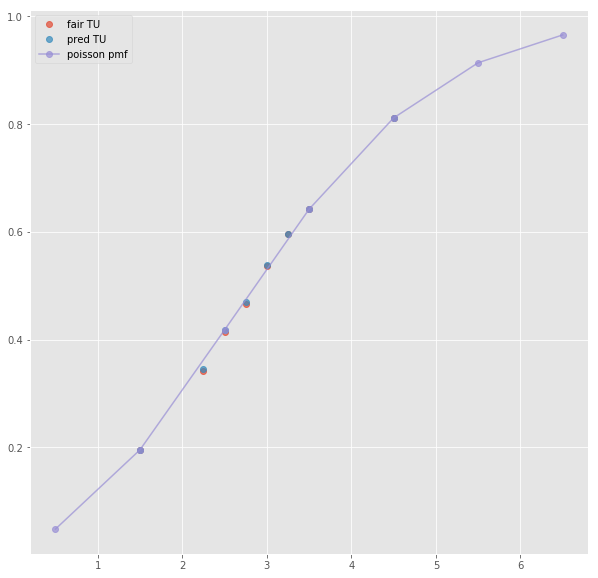

ML : 4.86 4.19 1.675
Error home:  0.006181715544358118
Error draw:  0.011556064514510328
Error away:  0.0053741637229426376

(59, 124)
(1, 25)
2.5 1.6 2.28 0.5 2.2 1.67
TO fair:  1.7017543859649125 TU fair:  2.425
TO pred:  1.70173 TU fair:  2.42506
Error TO:  0.014699183121333337

Error TO:  0.019552536429256084

Error TO:  8.42078173823868e-06

Error TO:  0.010567031597965182



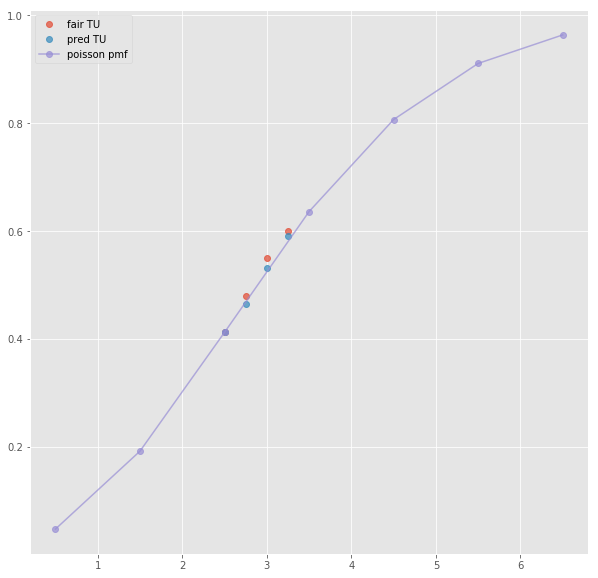

ML : 4.96 3.76 1.66
Error home:  0.02411486011640837
Error draw:  0.029577395356798153
Error away:  0.005462322594282698

(97, 124)
(1, 23)
next list index out of range
(147, 124)
(1, 21)
next list index out of range
(66, 124)
(1, 46)
3.5 2.69 1.5 0.5 2.3 1.675
TO fair:  2.793333333333333 TU fair:  1.557620817843866
TO pred:  2.79328 TU fair:  1.55764
Error TO:  0.0037936029249342473

Error TO:  0.001368177778857338

Error TO:  6.8353615673144574e-06

Error TO:  0.00107398014169105

Error TO:  0.004138774320306737

Error TO:  0.00024800011925107945

Error TO:  0.004076844095886045

Error TO:  0.0003830178336112766



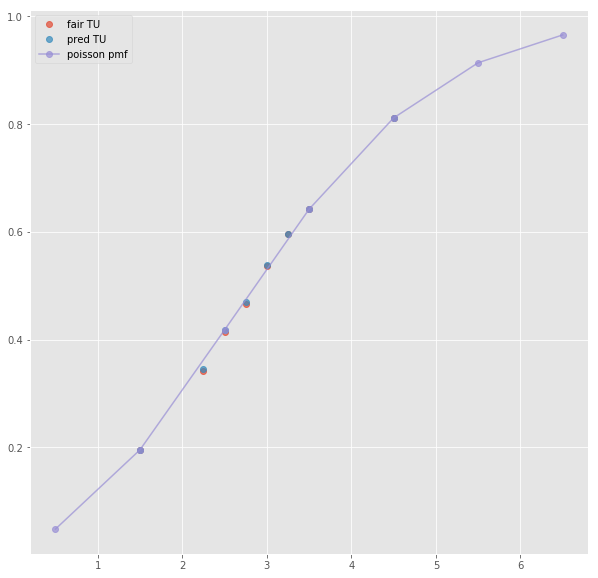

Error T1O:  0.013642986558467074
ML : 4.86 4.19 1.675
Error home:  0.006181715544358118
Error draw:  0.011556064514510328
Error away:  0.0053741637229426376

(17, 124)
(1, 36)
3.5 2.54 1.55 0.5 2.27 1.67
TO fair:  2.6387096774193552 TU fair:  1.6102362204724412
TO pred:  2.63873 TU fair:  1.61023
Error TO:  0.021407262325162102

Error TO:  0.020376037688671578

Error TO:  2.918719039513018e-06

Error TO:  0.022768061737794887

Error TO:  0.025023745284999288

Error TO:  0.013561148237343779



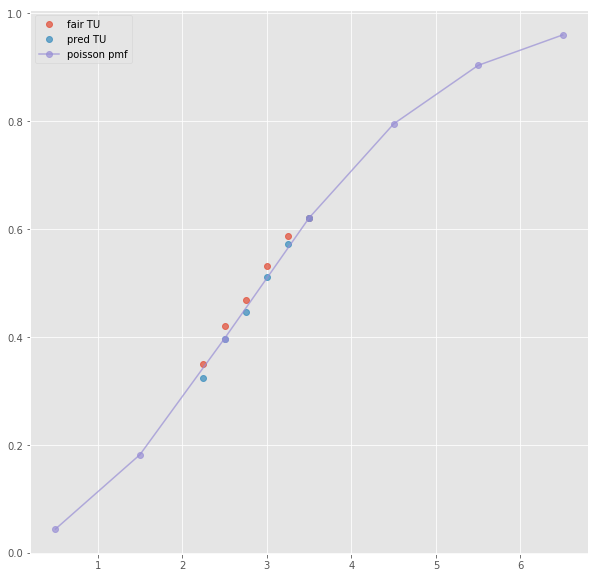

Error T1O:  0.012324432113171024
ML : 4.88 4.17 1.68
Error home:  0.012043580048020197
Error draw:  0.015822508161207144
Error away:  0.0037790878277067508

(30, 124)
(1, 40)
2.5 2.32 1.653 0.5 2.02 1.877
TO fair:  2.4035087719298245 TU fair:  1.7125000000000001
TO pred:  2.40345 TU fair:  1.71253
Error TO:  0.0005616683914167475

Error TO:  0.0008189761145239727

Error TO:  0.00036449371211963455

Error TO:  1.0173939438973267e-05

Error TO:  0.0008103220230042396

Error TO:  0.00044476189650183295

Error TO:  0.0014453140959749256



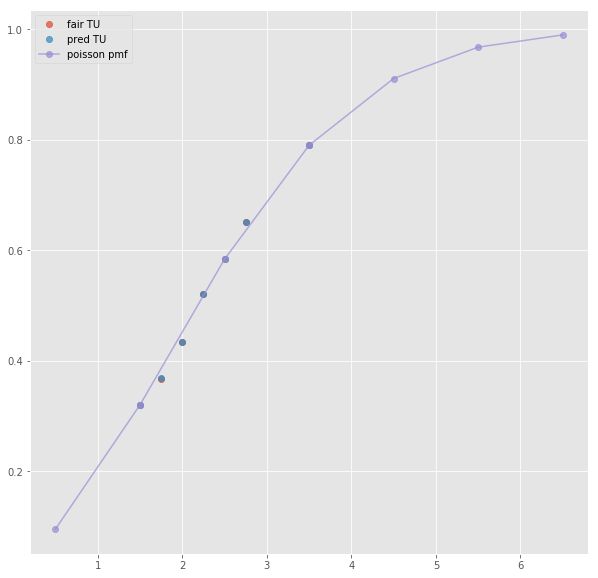

ML : 4.46 3.6 1.877
Error home:  0.001576337292080482
Error draw:  0.00506461128873531
Error away:  0.003488446945275836

(53, 124)
(1, 23)
2.5 2.29 1.63 0.5 2.0 1.88
TO fair:  2.404907975460123 TU fair:  1.7117903930131007
TO pred:  2.40493 TU fair:  1.71178
Error TO:  3.808078931633041e-06

Error TO:  0.0022340905664265387



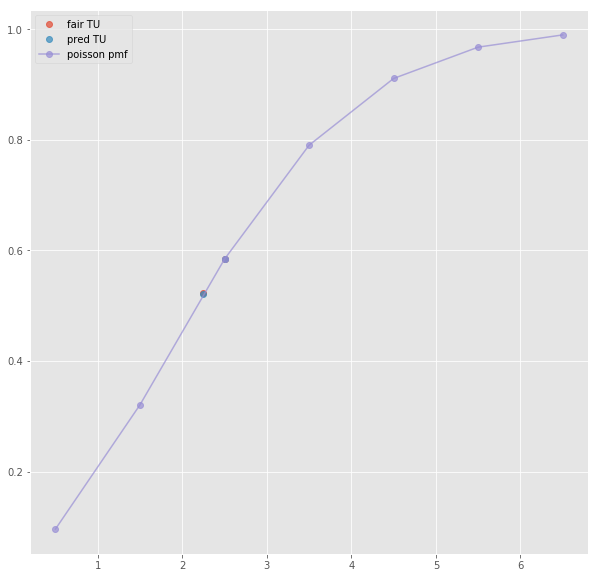

ML : 4.38 3.38 1.87
Error home:  0.004907658216339705
Error draw:  0.015357743923289813
Error away:  0.010449882261968302

(88, 124)
(1, 19)
next list index out of range
(177, 124)
(1, 23)
2.5 2.29 1.67 0.5 2.06 1.86
TO fair:  2.37125748502994 TU fair:  1.7292576419213972
TO pred:  2.37124 TU fair:  1.72927
Error TO:  0.018366985100187194

Error TO:  3.109654600041978e-06

Error TO:  0.0034233179176475503



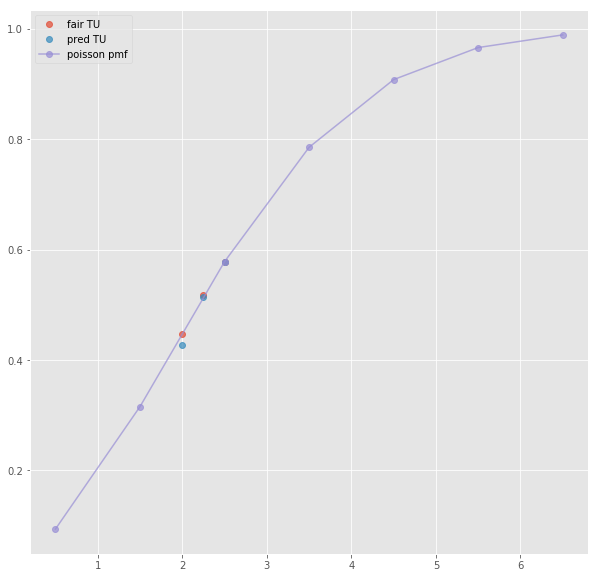

ML : 4.55 3.45 1.85
Error home:  0.00462292154479918
Error draw:  0.015430775184397616
Error away:  0.010807653855401056

(20, 124)
(1, 42)
2.5 2.32 1.653 0.5 2.02 1.877
TO fair:  2.4035087719298245 TU fair:  1.7125000000000001
TO pred:  2.40345 TU fair:  1.71253
Error TO:  0.0005616683914167475

Error TO:  0.0008189761145239727

Error TO:  0.00036449371211963455

Error TO:  1.0173939438973267e-05

Error TO:  0.0008103220230042396

Error TO:  0.00044476189650183295

Error TO:  0.0014453140959749256



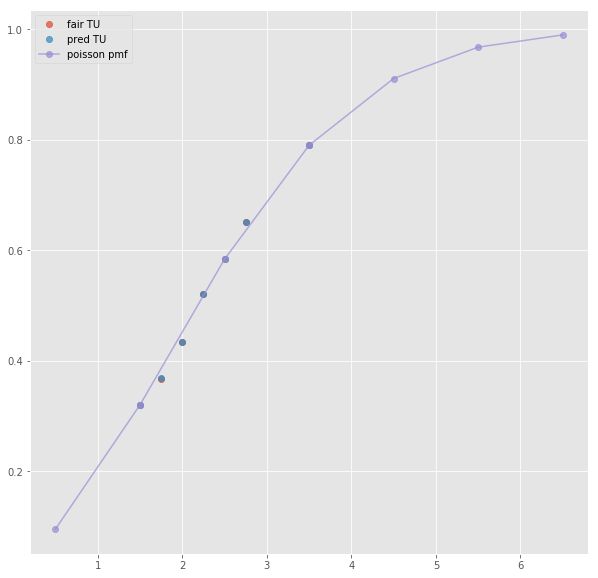

Error T1O:  0.004025290347327126
ML : 4.46 3.6 1.877
Error home:  0.001576337292080482
Error draw:  0.00506461128873531
Error away:  0.003488446945275836

(45, 124)
(1, 10)
next list index out of range
(16, 124)
(1, 32)
2.5 2.31 1.65 0.5 1.99 1.86
TO fair:  2.4 TU fair:  1.714285714285714
TO pred:  2.40003 TU fair:  1.71427
Error TO:  0.001927821494279558

Error TO:  0.005562948827708025

Error TO:  5.208268230028068e-06

Error TO:  0.003178629536873645

Error TO:  0.007158123229257796



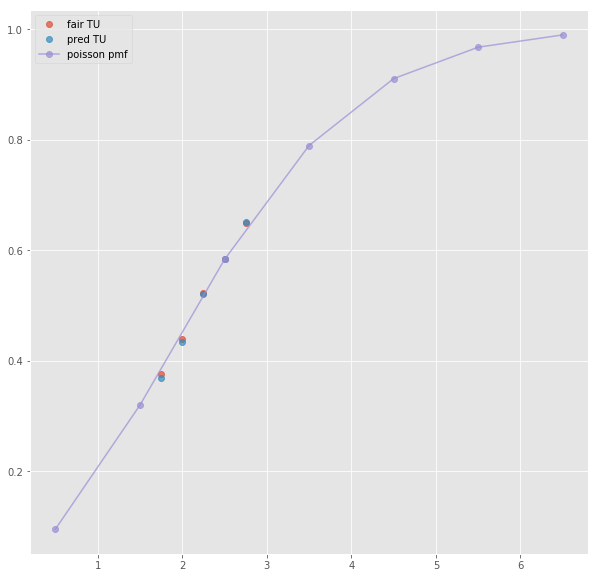

Error T1O:  0.010137775515285163
ML : 4.58 3.46 1.88
Error home:  0.009469425442704682
Error draw:  0.014552229759792923
Error away:  0.005082892926541516

(18, 124)
(1, 45)
2.5 1.854 2.04 -0.5 2.62 1.5490000000000002
TO fair:  1.9088235294117646 TU fair:  2.100323624595469
TO pred:  1.90881 TU fair:  2.10034
Error TO:  0.0020702351818128184

Error TO:  0.004440376080109165

Error TO:  0.0053968497680556005

Error TO:  0.006466295984761727

Error TO:  0.008457498808832786

Error TO:  3.7132178828391815e-06

Error TO:  0.006161695039037962

Error TO:  0.001180031490856992

Error TO:  0.0032392763446394968

Error TO:  0.05324896023711778



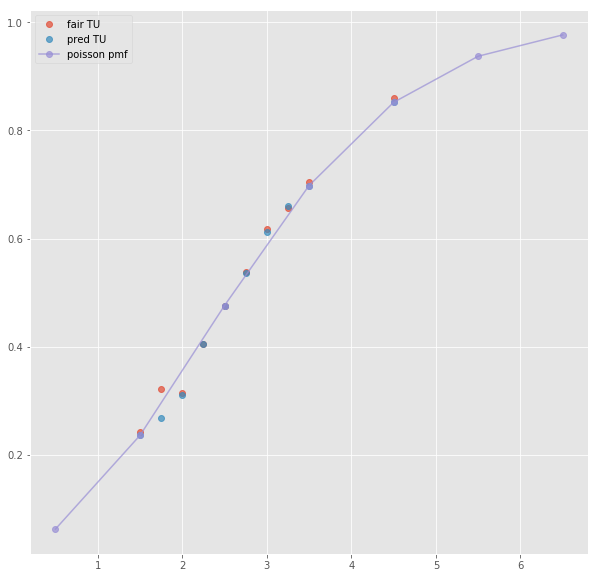

ML : 2.62 3.56 2.72
Error home:  0.001064088456315726
Error draw:  0.018391761746772428
Error away:  0.017327654152245853

(34, 124)
(1, 23)
next list index out of range
(73, 124)
(1, 21)
next list index out of range
(116, 124)
(1, 23)
next list index out of range
(18, 124)
(1, 47)
2.5 1.854 2.04 -0.5 2.62 1.5490000000000002
TO fair:  1.9088235294117646 TU fair:  2.100323624595469
TO pred:  1.90881 TU fair:  2.10034
Error TO:  0.0020702351818128184

Error TO:  0.004440376080109165

Error TO:  0.0053968497680556005

Error TO:  0.006466295984761727

Error TO:  0.008457498808832786

Error TO:  3.7132178828391815e-06

Error TO:  0.006161695039037962

Error TO:  0.001180031490856992

Error TO:  0.0032392763446394968

Error TO:  0.05324896023711778



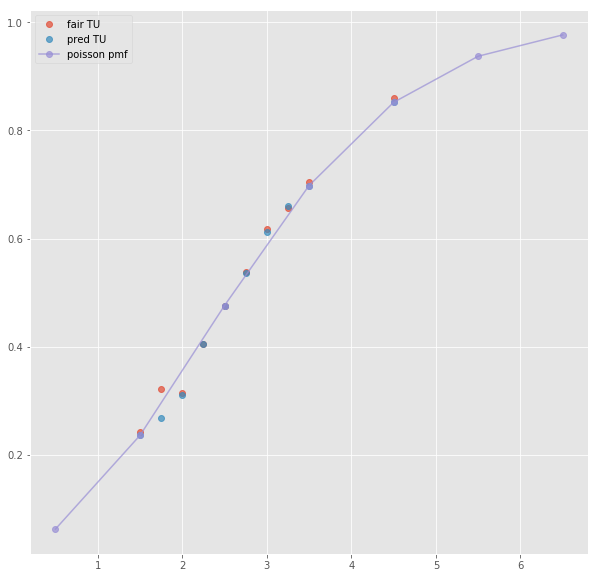

Error T1O:  0.004690491144822562
ML : 2.62 3.56 2.72
Error home:  0.001064088456315726
Error draw:  0.018391761746772428
Error away:  0.017327654152245853

(48, 124)
(1, 67)
3.5 2.85 1.4 -0.5 2.5 1.5
TO fair:  3.0357142857142856 TU fair:  1.4912280701754383
TO pred:  3.03568 TU fair:  1.49124
Error TO:  0.029670661093712303

Error TO:  0.03409338167698739

Error TO:  0.023026655208570168

Error TO:  3.7204572441718042e-06

Error TO:  0.002069452410132039

Error TO:  0.01356860140263172

Error TO:  0.03224468593099716

Error TO:  0.035756810576666576

Error TO:  0.008922298921189675

Error TO:  0.030199700180966405

Error TO:  0.003235343019624498

Error TO:  0.0013142695805644367

Error TO:  0.0061063255624799195

Error TO:  0.025898092781382887

Error TO:  0.013202507524611384



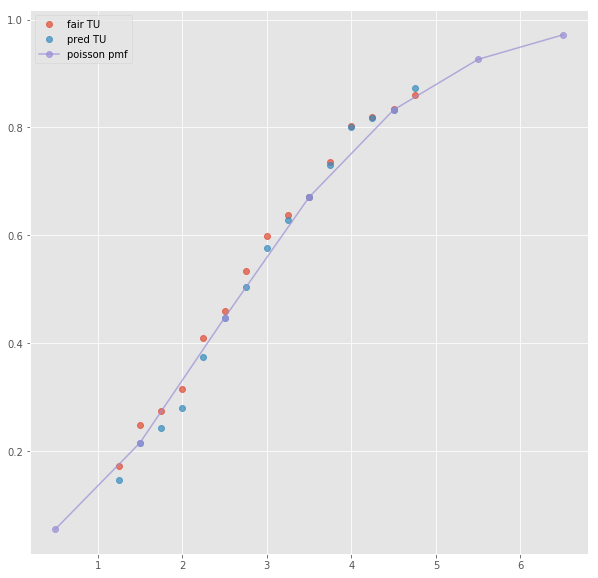

ML : 2.55 3.3 2.75
Error home:  0.004616505088988643
Error draw:  0.03822922778936075
Error away:  0.03361254988777912

(8, 124)
(1, 35)
2.5 1.84 2.02 -0.5 2.52 1.55
TO fair:  1.9108910891089108 TU fair:  2.0978260869565215
TO pred:  1.91087 TU fair:  2.09785
Error TO:  0.005096478537757632

Error TO:  0.002858058141211428

Error TO:  0.009179056402715047

Error TO:  5.775520799500278e-06

Error TO:  0.000838880512904483

Error TO:  0.023133006281200685



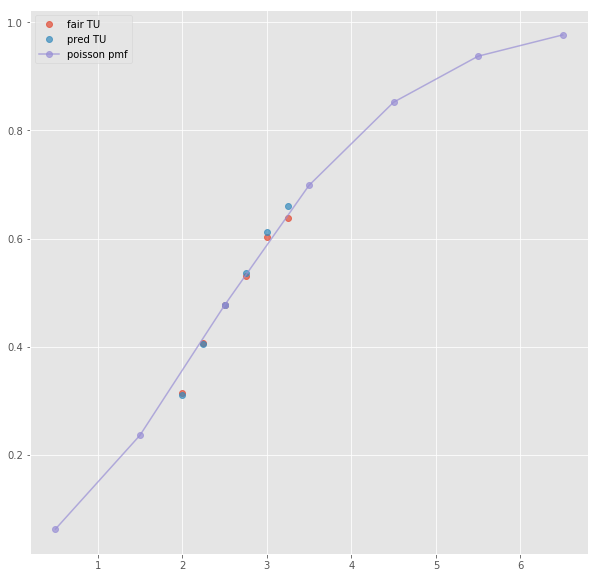

Error T1O:  0.008698470538561709
ML : 2.56 3.55 2.72
Error home:  0.005217351707164308
Error draw:  0.016518963090544958
Error away:  0.011301400518216043

(77, 124)
(1, 40)
2.5 1.961 1.833 -0.5 1.52 2.49
TO fair:  2.0698308783415165 TU fair:  1.9347271800101988
TO pred:  2.0698 TU fair:  1.93475
Error TO:  0.0009100954756164348

Error TO:  0.0002390183533855783

Error TO:  0.0032154125399453393

Error TO:  0.006136151557618763

Error TO:  7.207600753733612e-06

Error TO:  0.0031409365562972136

Error TO:  0.00012738285950286699



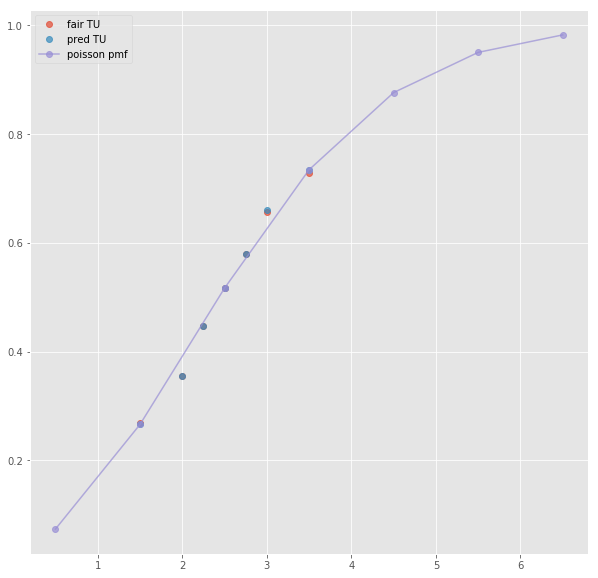

ML : 1.52 4.01 5.89
Error home:  0.010110666175179306
Error draw:  0.008222055683699603
Error away:  0.0018884861610480586

(8, 124)
(1, 15)
next list index out of range
(21, 124)
(1, 15)
next list index out of range
(34, 124)
(1, 15)
next list index out of range
(3, 124)
(1, 42)
2.5 1.917 1.884 -1.5 2.55 1.497
TO fair:  2.017515923566879 TU fair:  1.9827856025039123
TO pred:  2.01747 TU fair:  1.98283
Error TO:  0.0009682640767384454

Error TO:  0.00014564859614707437

Error TO:  0.001189259566718226

Error TO:  0.0009378017386609261

Error TO:  1.1282661422140627e-05

Error TO:  0.0020721014623765743

Error TO:  3.582263702428534e-05



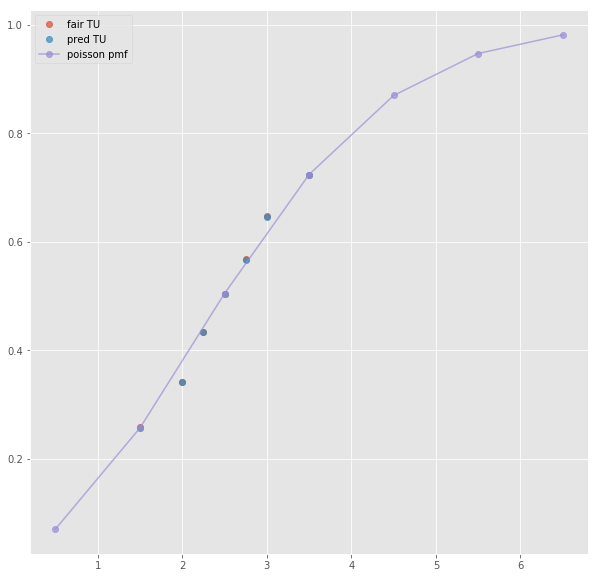

Error T1O:  0.011261398544452517
ML : 1.469 4.23 6.2
Error home:  0.007077136876245005
Error draw:  0.0008978565686760254
Error away:  0.006179455133342143

(10, 124)
(1, 17)
next list index out of range
(10, 124)
(1, 32)
2.5 1.96 1.88 -0.5 1.55 2.52
TO fair:  2.0425531914893615 TU fair:  1.9591836734693875
TO pred:  2.04256 TU fair:  1.95918
Error TO:  0.0030782458527754963

Error TO:  0.0059627442475979064

Error TO:  0.007126895692778967

Error TO:  1.6319390046537485e-06

Error TO:  0.0028425817978975365



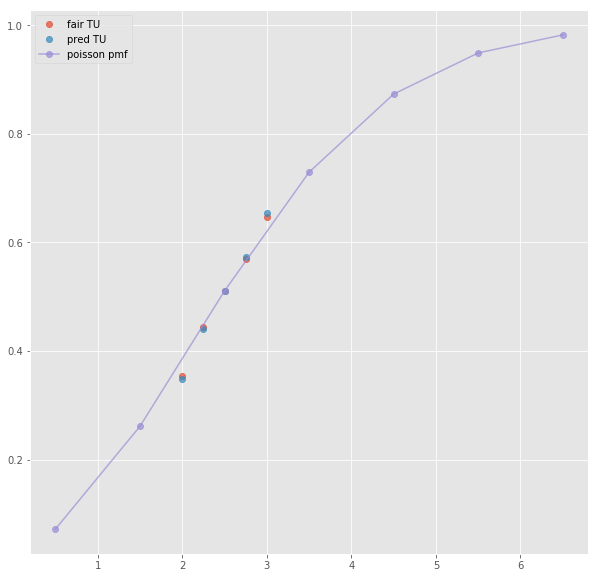

Error T1O:  0.001953044595340847
ML : 1.56 4.23 6.13
Error home:  0.003135551215608934
Error draw:  0.004494940976965872
Error away:  0.0013592730055765334

(110, 124)
(1, 41)
1.5 1.709 2.22 -0.5 2.72 1.505
TO fair:  1.7698198198198196 TU fair:  2.299005266237566
TO pred:  1.76982 TU fair:  2.299
Error TO:  0.004001348719302911

Error TO:  0.018987041456143453

Error TO:  0.00527421190038202

Error TO:  5.752397180813773e-08

Error TO:  0.004875529847100046

Error TO:  0.0016706840614404972

Error TO:  0.004867197096424691

Error TO:  0.015491440052212035



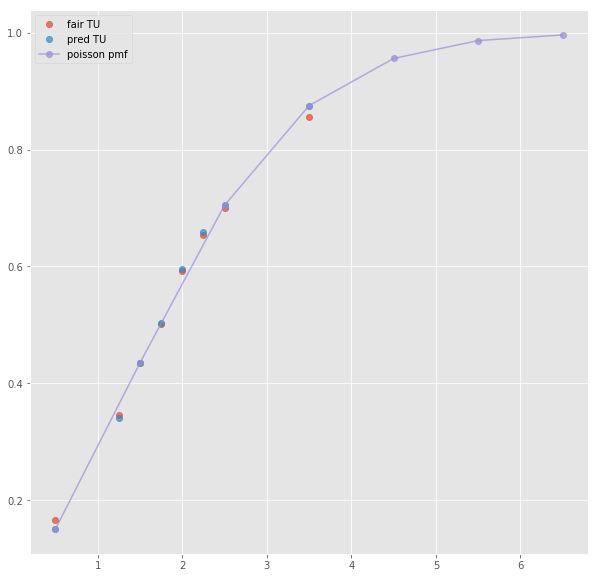

ML : 2.72 2.76 3.24
Error home:  0.0022259233831956604
Error draw:  0.03036087056903225
Error away:  0.028134837311331706

(58, 124)
(1, 21)
next list index out of range
(99, 124)
(1, 19)
next list index out of range
(130, 124)
(1, 23)
next list index out of range
(91, 124)
(1, 43)
1.5 1.709 2.22 -0.5 2.72 1.505
TO fair:  1.7698198198198196 TU fair:  2.299005266237566
TO pred:  1.76982 TU fair:  2.299
Error TO:  0.004001348719302911

Error TO:  0.018987041456143453

Error TO:  0.00527421190038202

Error TO:  5.752397180813773e-08

Error TO:  0.004875529847100046

Error TO:  0.0016706840614404972

Error TO:  0.004867197096424691

Error TO:  0.015491440052212035



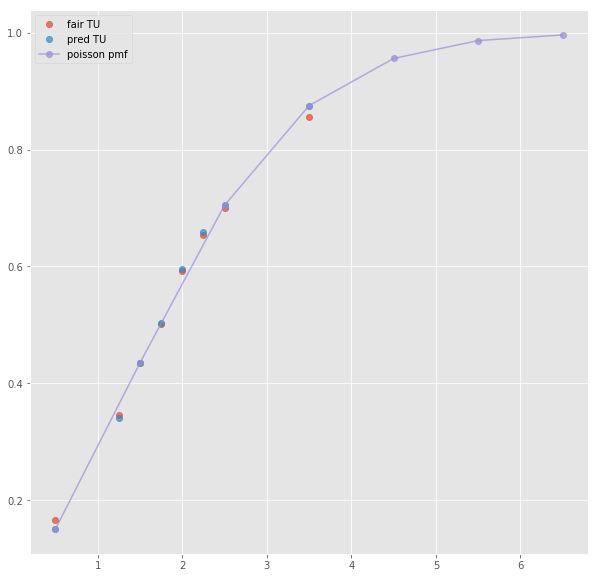

Error T1O:  0.01827433749064189
ML : 2.72 2.76 3.24
Error home:  0.0022259233831956604
Error draw:  0.03036087056903225
Error away:  0.028134837311331706

(39, 124)
(1, 60)
1.5 1.625 2.25 -0.5 2.35 1.575
TO fair:  1.7222222222222223 TU fair:  2.3846153846153846
TO pred:  1.72223 TU fair:  2.38461
Error TO:  0.020655213481296814

Error TO:  0.0034302817106707795

Error TO:  0.018124658611708838

Error TO:  0.023702573664434817

Error TO:  0.00414953348872632

Error TO:  2.6222566278377712e-06

Error TO:  0.016355961381209927

Error TO:  0.018321114358964885

Error TO:  0.0244212776281566

Error TO:  0.040431945112921155

Error TO:  0.015412560993001145

Error TO:  0.030581616225521246

Error TO:  0.024665431522908787



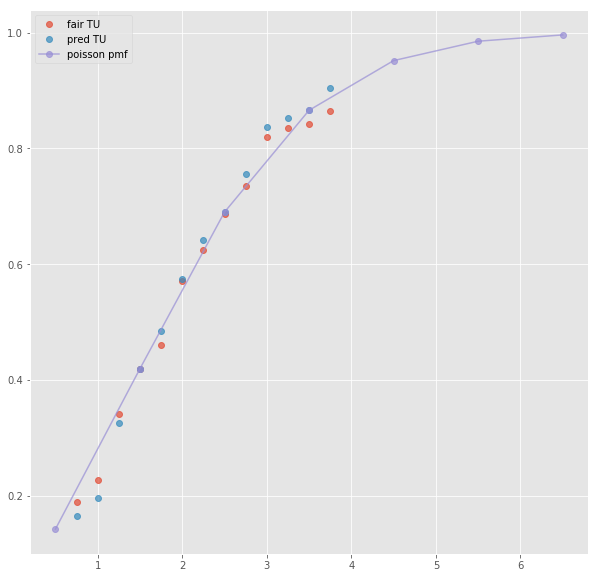

ML : 2.4 2.875 3.3
Error home:  0.0109708666540968
Error draw:  0.015214266271622034
Error away:  0.0042433866831166345

(16, 124)
(1, 35)
1.5 1.67 2.27 -0.5 2.62 1.52
TO fair:  1.73568281938326 TU fair:  2.3592814371257487
TO pred:  1.73572 TU fair:  2.35922
Error TO:  0.002264515181543303

Error TO:  1.2341460487119704e-05

Error TO:  0.004447195462522424

Error TO:  0.001817207103550711

Error TO:  0.007702475064297776



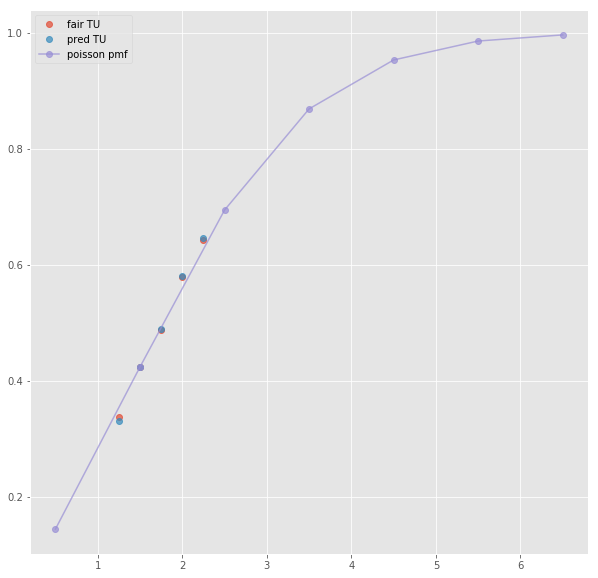

Error T1O:  0.012985661024314532
ML : 2.66 2.81 3.25
Error home:  0.005482408460465105
Error draw:  0.02808000900814356
Error away:  0.022598008390245172

(18, 124)
(1, 40)
2.5 2.36 1.628 0.5 2.14 1.775
TO fair:  2.4496314496314495 TU fair:  1.6898305084745762
TO pred:  2.4496 TU fair:  1.68984
Error TO:  0.000887335047293325

Error TO:  0.00798790768409674

Error TO:  0.000743550030400747

Error TO:  5.241066111438819e-06

Error TO:  0.010360802543922243

Error TO:  0.0035705040513105968

Error TO:  0.009810336059525748



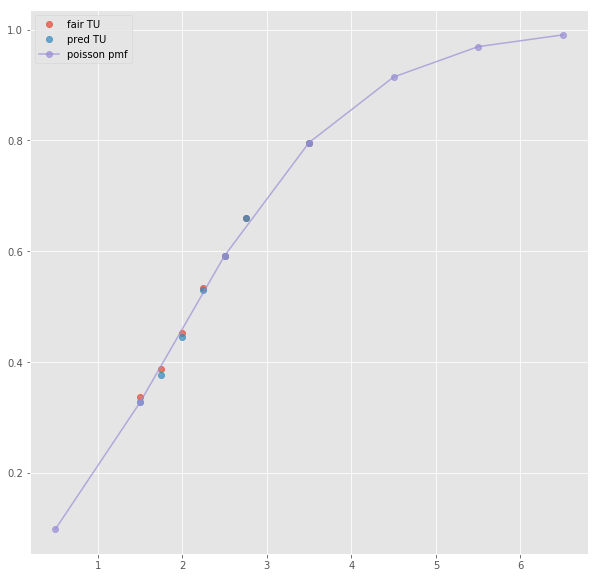

ML : 5.04 3.63 1.775
Error home:  0.0032297912524042183
Error draw:  0.006722351594200648
Error away:  0.003492420849981581

(56, 124)
(1, 19)
next list index out of range
(77, 124)
(1, 19)
next list index out of range
(230, 124)
(1, 19)
next list index out of range
(8, 124)
(1, 40)
2.5 2.36 1.628 0.5 2.14 1.775
TO fair:  2.4496314496314495 TU fair:  1.6898305084745762
TO pred:  2.4496 TU fair:  1.68984
Error TO:  0.000887335047293325

Error TO:  0.00798790768409674

Error TO:  0.000743550030400747

Error TO:  5.241066111438819e-06

Error TO:  0.010360802543922243

Error TO:  0.0035705040513105968

Error TO:  0.009810336059525748



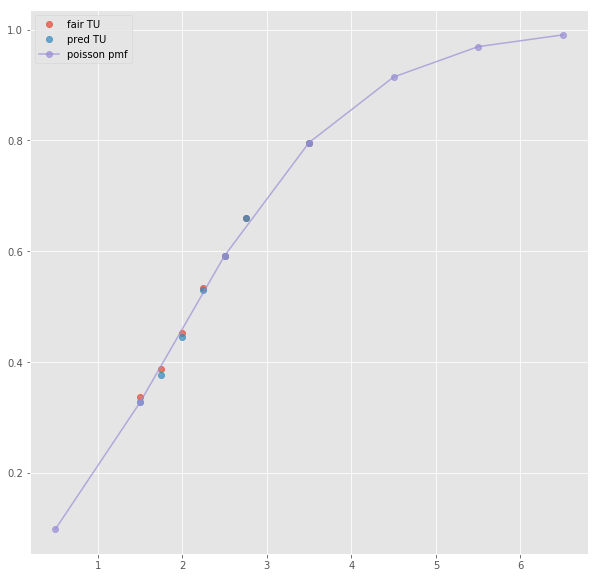

Error T1O:  0.008432579751874947
ML : 5.04 3.63 1.775
Error home:  0.0032297912524042183
Error draw:  0.006722351594200648
Error away:  0.003492420849981581

(18, 124)
next positional indexers are out-of-bounds
(131, 124)
(1, 48)
3.5 2.16 1.757 0.5 2.0 1.925
TO fair:  2.2293682413204325 TU fair:  1.8134259259259256
TO pred:  2.22937 TU fair:  1.81343
Error TO:  0.007257261818012117

Error TO:  0.0062050294750009005

Error TO:  3.5385289670619713e-07

Error TO:  0.0028319208388097317

Error TO:  0.008346985152699937

Error TO:  0.007795545124373637

Error TO:  0.0033675287674541643

Error TO:  0.0025959194762203708

Error TO:  0.0013721234959063744



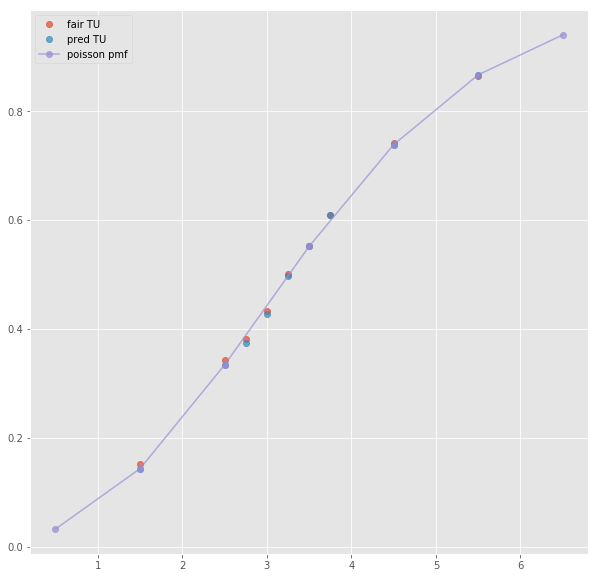

ML : 3.79 4.04 1.925
Error home:  0.018193472271375966
Error draw:  0.023822475835751727
Error away:  0.005628855721284354

(297, 124)
(1, 27)
3.5 2.16 1.7 0.5 1.96 1.91
TO fair:  2.2705882352941176 TU fair:  1.787037037037037
TO pred:  2.27056 TU fair:  1.78706
Error TO:  0.013261143211510062

Error TO:  0.0015693594667843813

Error TO:  5.476725195796561e-06

Error TO:  0.013301571308475979



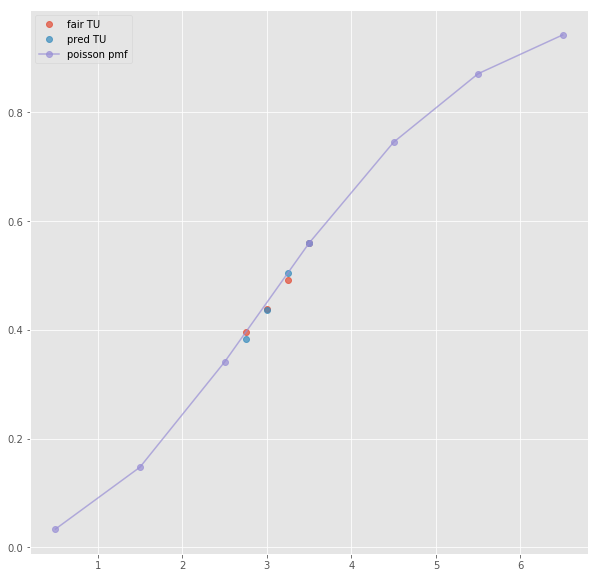

ML : 3.71 3.81 1.91
Error home:  0.020215043494585194
Error draw:  0.03067672145330863
Error away:  0.010461889074480146

(87, 124)
(1, 23)
3.5 2.19 1.76 0.5 2.0 1.95
TO fair:  2.244318181818182 TU fair:  1.8036529680365299
TO pred:  2.2443 TU fair:  1.80366
Error TO:  0.005485391762312997

Error TO:  3.609707179497157e-06

Error TO:  0.002428490388308391



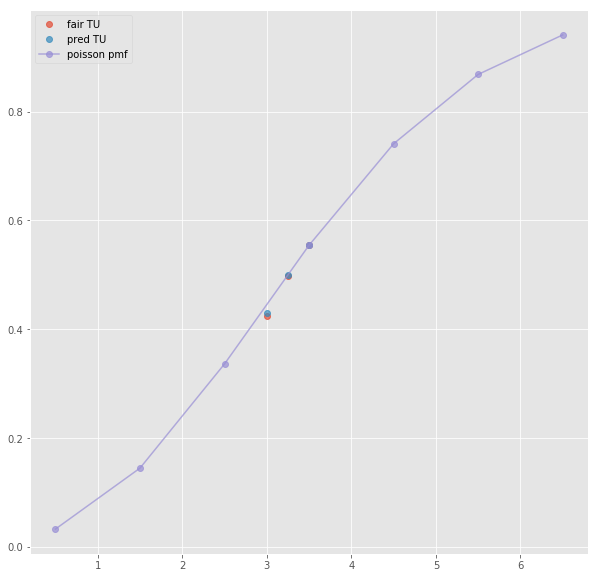

ML : 3.65 3.9 1.94
Error home:  0.014502867420789545
Error draw:  0.02796945646964788
Error away:  0.013466711409956755

(374, 124)
(1, 27)
3.5 2.21 1.74 0.5 1.99 1.96
TO fair:  2.2701149425287355 TU fair:  1.7873303167420813
TO pred:  2.27015 TU fair:  1.78731
Error TO:  0.0003327366080142502

Error TO:  0.009023437505533805

Error TO:  6.802650915016528e-06

Error TO:  0.005403467121695538



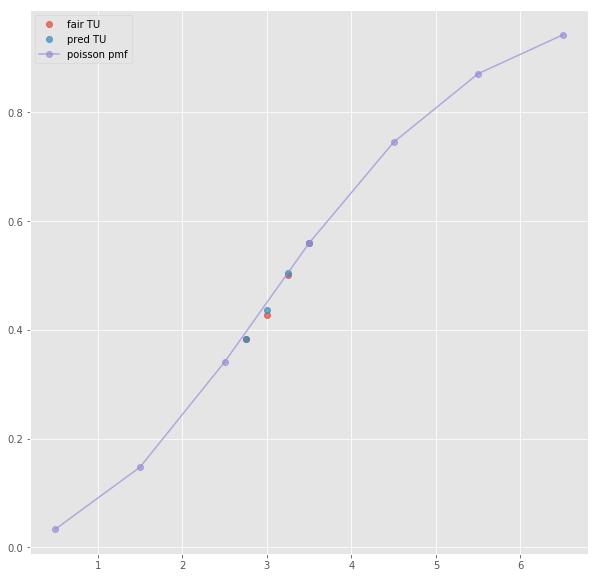

ML : 3.75 3.85 1.95
Error home:  0.02125640426030434
Error draw:  0.03160722001964991
Error away:  0.010350656443127382

(104, 124)
(1, 48)
3.5 2.24 1.709 0.5 1.99 1.925
TO fair:  2.3107080163838503 TU fair:  1.7629464285714287
TO pred:  2.31074 TU fair:  1.76293
Error TO:  0.001271371624177009

Error TO:  0.0011178790732838673

Error TO:  5.990063293770387e-06

Error TO:  0.00854909962222114

Error TO:  0.0016823221873274452

Error TO:  0.00956690179985309

Error TO:  1.9485765648197262e-05

Error TO:  0.004950293864299279

Error TO:  0.003153903201904118



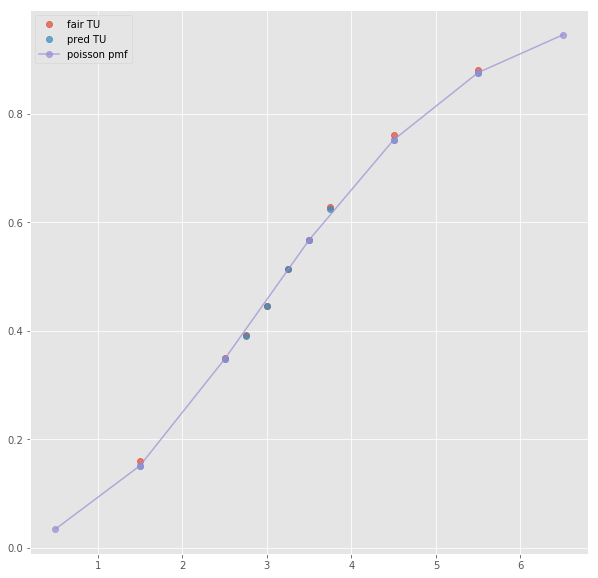

Error T1O:  0.009910086551888853
ML : 3.95 3.86 1.925
Error home:  0.0274044169931289
Error draw:  0.03221017151314157
Error away:  0.004805734556019625

(15, 124)
(1, 70)
3.5 2.15 1.675 0.5 2.025 1.775
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28361 TU fair:  1.77905
Error TO:  0.016034282485534956

Error TO:  0.02447365731299944

Error TO:  0.014677214388563953

Error TO:  5.3521495449460055e-06

Error TO:  0.011600956259946171

Error TO:  0.018915718794331737

Error TO:  0.01666590070236451

Error TO:  0.014108472312410192

Error TO:  0.0071475856329557

Error TO:  0.016165848919060033

Error TO:  0.004192810451725593

Error TO:  0.008048191197105592

Error TO:  0.005554101705205039

Error TO:  0.01160670311607398

Error TO:  0.015187330417270162

Error TO:  0.016148802319595007



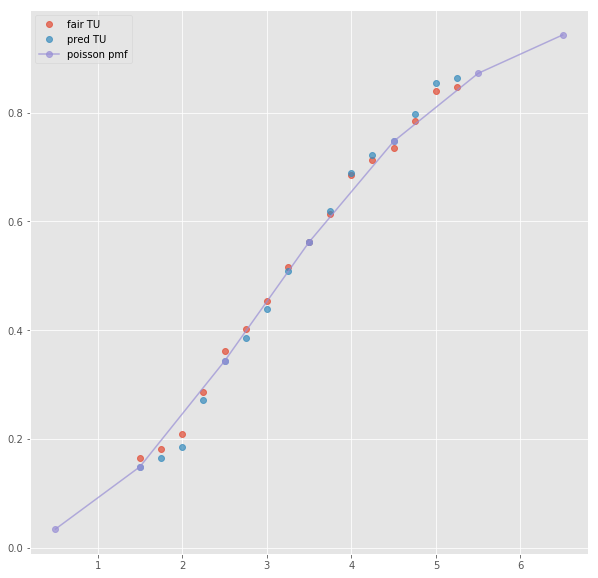

ML : 4.0 4.0 1.8
Error home:  0.016021575926312898
Error draw:  0.022587304884355397
Error away:  0.006565660390164596

(40, 124)
(1, 32)
3.5 2.13 1.75 0.5 1.97 1.88
TO fair:  2.2171428571428566 TU fair:  1.821596244131455
TO pred:  2.21716 TU fair:  1.82159
Error TO:  0.01228247641455138

Error TO:  0.01003902347678054

Error TO:  3.487325571038813e-06

Error TO:  0.0034482198763882144

Error TO:  0.0011788517446051916



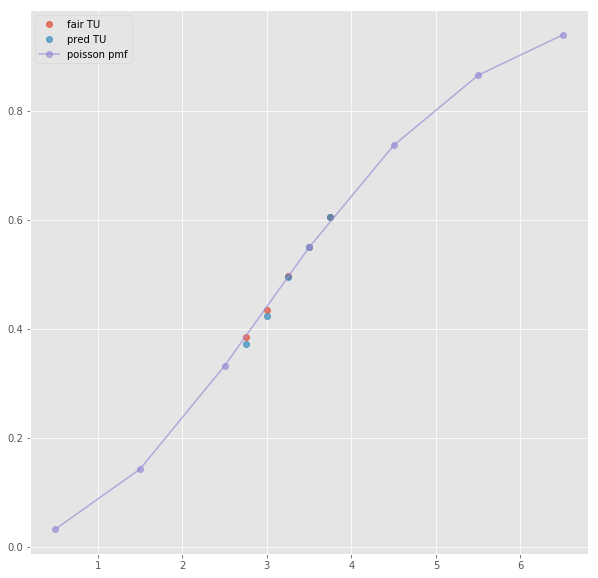

Error T1O:  0.011040755071182184
ML : 3.83 3.97 1.9
Error home:  0.021465952950361022
Error draw:  0.026752782320316276
Error away:  0.005287053162774336

(74, 124)
next positional indexers are out-of-bounds
(97, 124)
next positional indexers are out-of-bounds
(134, 124)
next positional indexers are out-of-bounds
(219, 124)
next positional indexers are out-of-bounds
(69, 124)
(1, 44)
3.5 2.61 1.526 -0.5 1.671 2.31
TO fair:  2.710353866317169 TU fair:  1.584674329501916
TO pred:  2.71032 TU fair:  1.58468
Error TO:  0.0007852396652702209

Error TO:  0.0001973713109787445

Error TO:  4.610217395062399e-06

Error TO:  0.005482180790984781

Error TO:  0.00043115641682900385

Error TO:  0.0011437443191600893

Error TO:  0.01046519221113873

Error TO:  9.790371195139702e-06



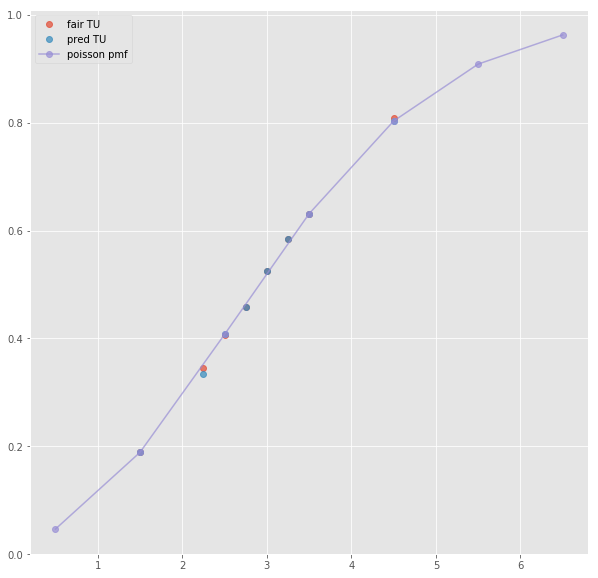

Error T1O:  0.006350365082440079
ML : 1.671 3.98 5.31
Error home:  0.0037160220647605158
Error draw:  0.026616432498822645
Error away:  0.022900634696947725

(23, 124)
next positional indexers are out-of-bounds
(7, 124)
(1, 42)
2.5 2.07 1.735 0.5 1.813 2.0
TO fair:  2.1930835734870318 TU fair:  1.8381642512077296
TO pred:  2.19305 TU fair:  1.83819
Error TO:  0.0008938861422415068

Error TO:  0.0065896731510998174

Error TO:  0.01942406528738344

Error TO:  0.006043814774198075

Error TO:  6.980599715045166e-06

Error TO:  0.010393300788228643

Error TO:  0.0018966323213044367

Error TO:  0.008511712090217727



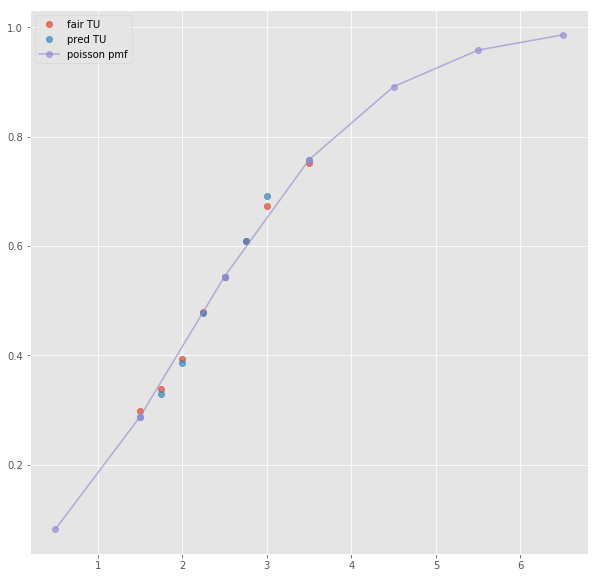

ML : 3.82 3.26 2.0
Error home:  0.01772007818062632
Error draw:  0.025275606971433273
Error away:  0.007555358421837022

(14, 124)
(1, 19)
2.5 2.12 1.63 0.5 1.7 2.06
TO fair:  2.3006134969325154 TU fair:  1.7688679245283017
TO pred:  2.30058 TU fair:  1.76889
Error TO:  6.3288388145732455e-06

Error TO:  0.002448897995901811



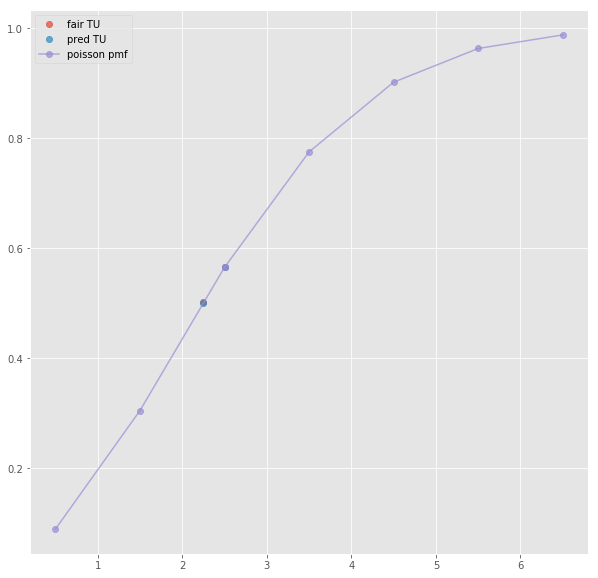

ML : 3.11 3.06 2.06
Error home:  0.005600308344554272
Error draw:  0.0183634114196925
Error away:  0.023963689737379834

(9, 124)
(1, 17)
2.5 2.13 1.7 0.5 1.78 2.06
TO fair:  2.2529411764705882 TU fair:  1.7981220657276995
TO pred:  2.25299 TU fair:  1.79809
Error TO:  9.618781386833142e-06



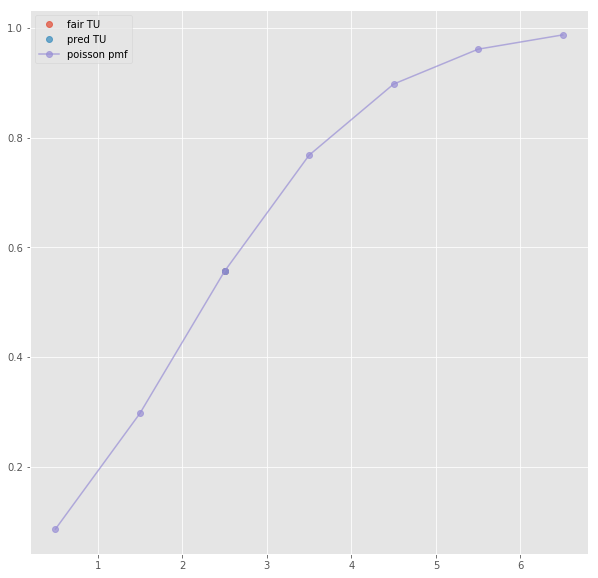

ML : 3.25 3.1 2.05
Error home:  0.0049952204269109735
Error draw:  0.02226723423736454
Error away:  0.02726214760551182

(6, 124)
(1, 35)
2.5 2.15 1.74 0.5 1.8 2.06
TO fair:  2.2356321839080455 TU fair:  1.8093023255813951
TO pred:  2.23569 TU fair:  1.80926
Error TO:  0.00502303163706902

Error TO:  0.0020187812355104695

Error TO:  1.1567427737946279e-05

Error TO:  0.0019197334681075873

Error TO:  0.003795068590214057



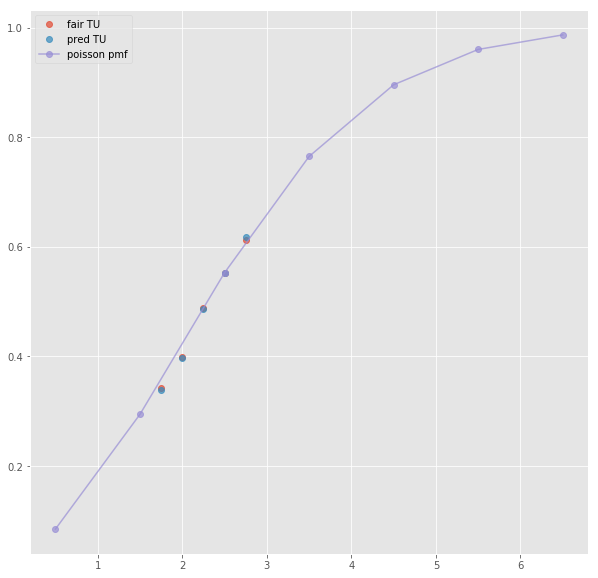

Error T1O:  0.0042390346027977865
Error T1O:  0.013452822453071445
ML : 3.74 3.42 2.08
Error home:  0.011632576591368515
Error draw:  0.015928408917606884
Error away:  0.004295623984283736

(37, 124)
(1, 39)
2.5 2.11 1.781 -0.5 1.884 2.02
TO fair:  2.1847276810780456 TU fair:  1.844075829383886
TO pred:  2.18477 TU fair:  1.84405
Error TO:  0.00386982043872669

Error TO:  0.005654834843839662

Error TO:  0.008458982666994408

Error TO:  8.866078266611677e-06

Error TO:  0.007812661857927061

Error TO:  0.0013639739162929487

Error TO:  0.006921925059152789



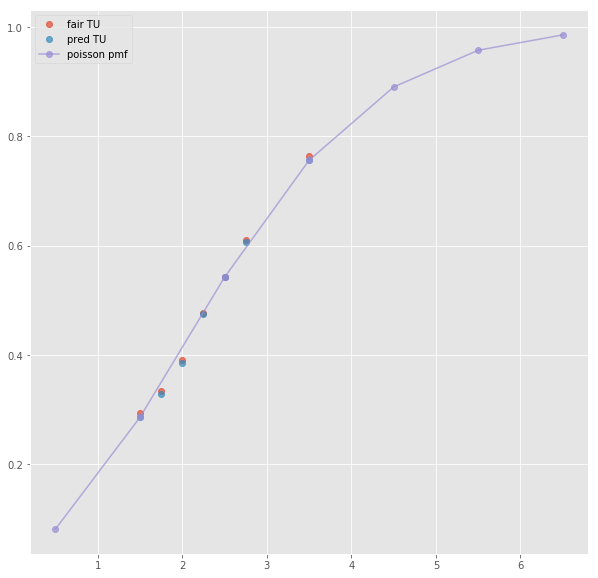

ML : 1.884 3.66 4.35
Error home:  0.004045051257496435
Error draw:  0.00999762953968153
Error away:  0.00595249448808835

(39, 124)
(1, 21)
next list index out of range
(63, 124)
(1, 21)
2.5 2.17 1.75 -0.5 1.93 1.99
TO fair:  2.2399999999999998 TU fair:  1.8064516129032258
TO pred:  2.23999 TU fair:  1.80646
Error TO:  1.992993591104497e-06

Error TO:  0.012970370396661046



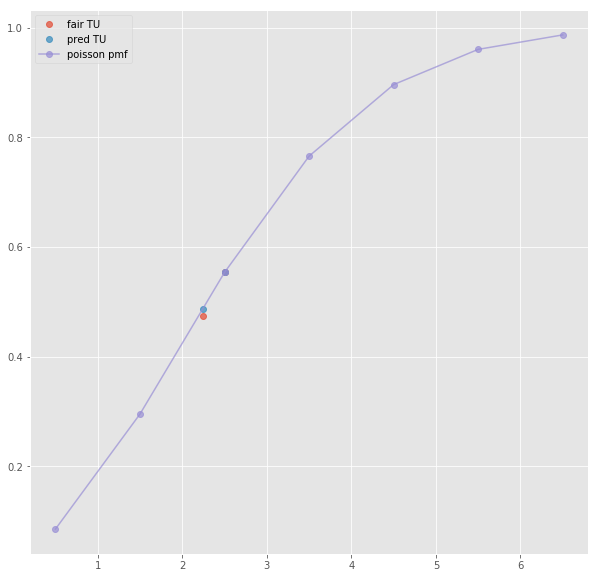

ML : 1.88 3.5 4.4
Error home:  0.0014146936915107045
Error draw:  0.014840745218066942
Error away:  0.016255460106934988

(165, 124)
(1, 23)
2.5 2.16 1.76 -0.5 1.94 1.98
TO fair:  2.2272727272727275 TU fair:  1.8148148148148149
TO pred:  2.22728 TU fair:  1.81481
Error TO:  0.016057790181857712

Error TO:  1.4660510229136392e-06

Error TO:  0.017882700617681824



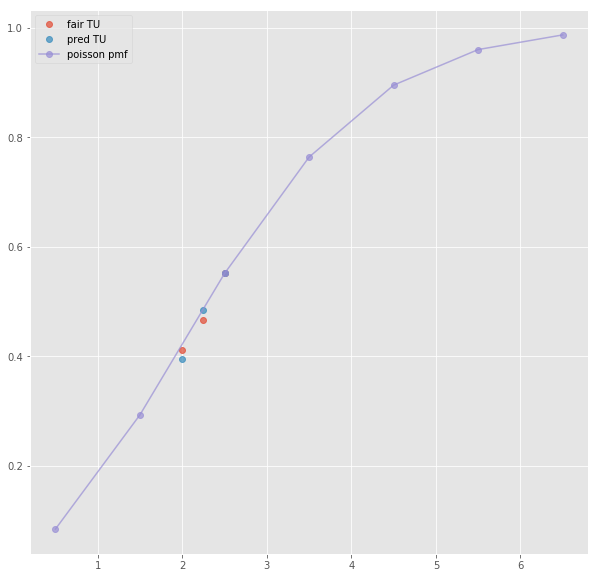

ML : 1.93 3.4 4.2
Error home:  0.01180064610750442
Error draw:  0.02151854626500377
Error away:  0.00971814492429307

(30, 124)
(1, 41)
2.5 2.11 1.781 -0.5 1.884 2.02
TO fair:  2.1847276810780456 TU fair:  1.844075829383886
TO pred:  2.18477 TU fair:  1.84405
Error TO:  0.00386982043872669

Error TO:  0.005654834843839662

Error TO:  0.008458982666994408

Error TO:  8.866078266611677e-06

Error TO:  0.007812661857927061

Error TO:  0.0013639739162929487

Error TO:  0.006921925059152789



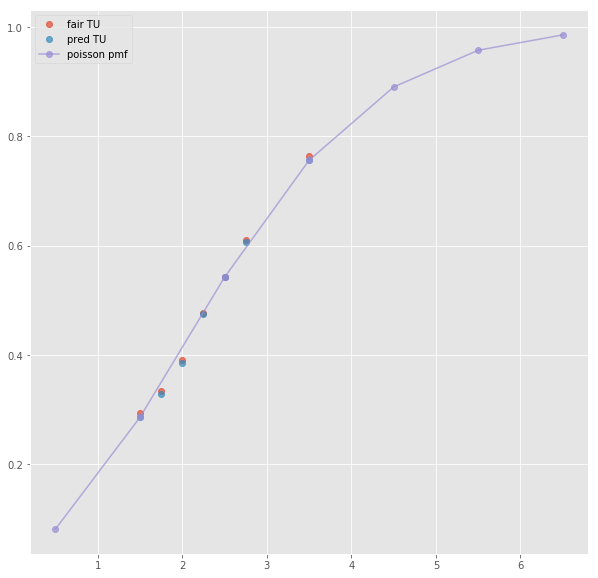

Error T1O:  0.0053726516315028006
ML : 1.884 3.66 4.35
Error home:  0.004045051257496435
Error draw:  0.00999762953968153
Error away:  0.00595249448808835

(24, 124)
next positional indexers are out-of-bounds
(28, 124)
(1, 43)
2.5 1.833 2.07 0.5 1.6840000000000002 2.31
TO fair:  1.8855072463768119 TU fair:  2.1292962356792144
TO pred:  1.88551 TU fair:  2.12929
Error TO:  0.00237410568584151

Error TO:  0.0055564606911079895

Error TO:  0.008006963308331172

Error TO:  0.007077410124501499

Error TO:  7.745464437602934e-07

Error TO:  0.0011486005482630457

Error TO:  0.00047309043337928625

Error TO:  0.006892501946790586



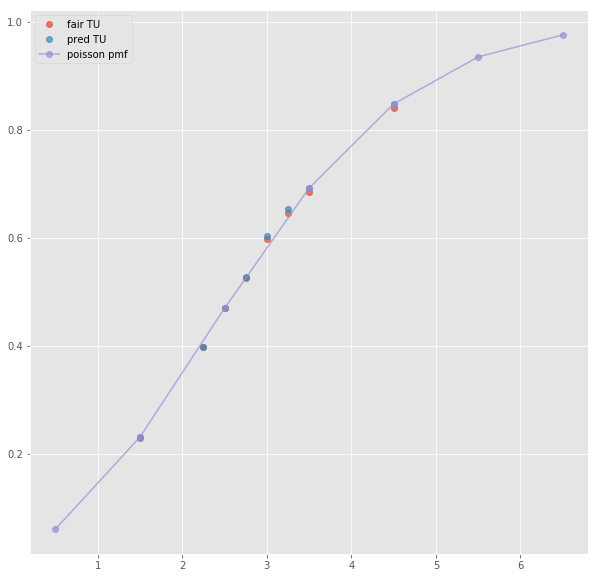

ML : 3.18 3.51 2.31
Error home:  0.02245963433521536
Error draw:  0.024707776656833935
Error away:  0.002248135721157174

(61, 124)
(1, 29)
2.5 1.76 2.08 0.5 1.66 2.26
TO fair:  1.8461538461538463 TU fair:  2.181818181818182
TO pred:  1.84615 TU fair:  2.18182
Error TO:  0.00026588180475872747

Error TO:  0.0008120687765627022

Error TO:  1.1284745732309531e-06

Error TO:  0.015867715779122493



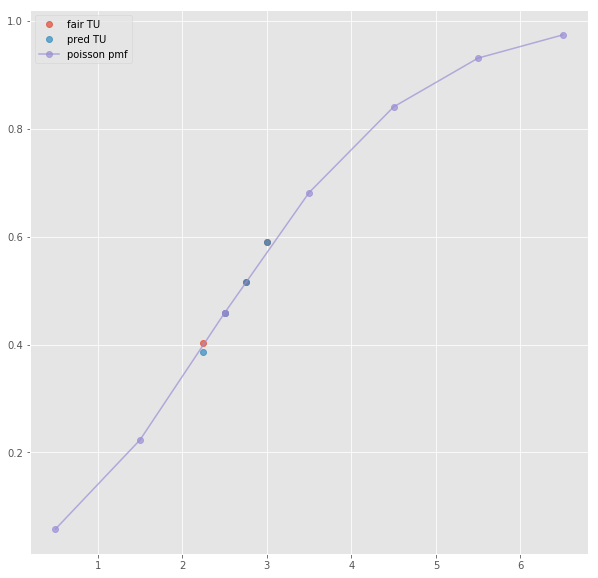

ML : 3.01 3.56 2.28
Error home:  0.011843520488059645
Error draw:  0.018279170532829403
Error away:  0.006435947148396182

(19, 124)
(1, 23)
2.5 1.79 2.14 0.5 1.7 2.33
TO fair:  1.836448598130841 TU fair:  2.195530726256983
TO pred:  1.83644 TU fair:  2.19555
Error TO:  0.005150956662176576

Error TO:  2.549461916578899e-06

Error TO:  0.014312252202366427



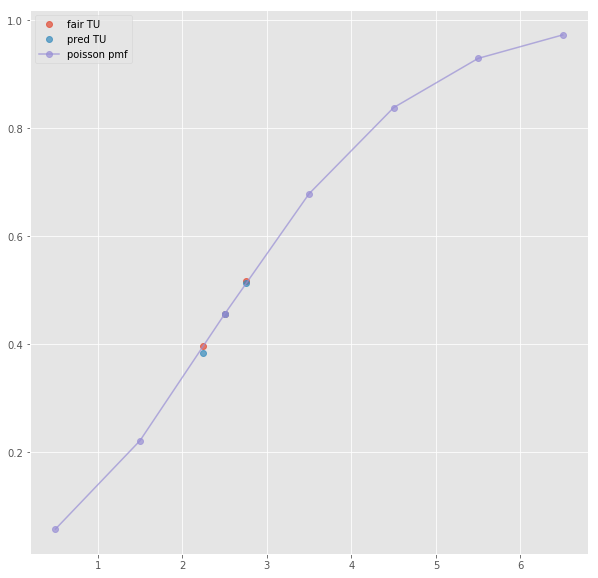

ML : 3.15 3.45 2.28
Error home:  0.026327374623175193
Error draw:  0.02881626493810599
Error away:  0.002488719337397749

(67, 124)
(1, 29)
2.5 1.79 2.14 0.5 1.7 2.33
TO fair:  1.836448598130841 TU fair:  2.195530726256983
TO pred:  1.83644 TU fair:  2.19555
Error TO:  0.005150956662176576

Error TO:  0.009137770464223371

Error TO:  2.549461916578899e-06

Error TO:  0.014312252202366427



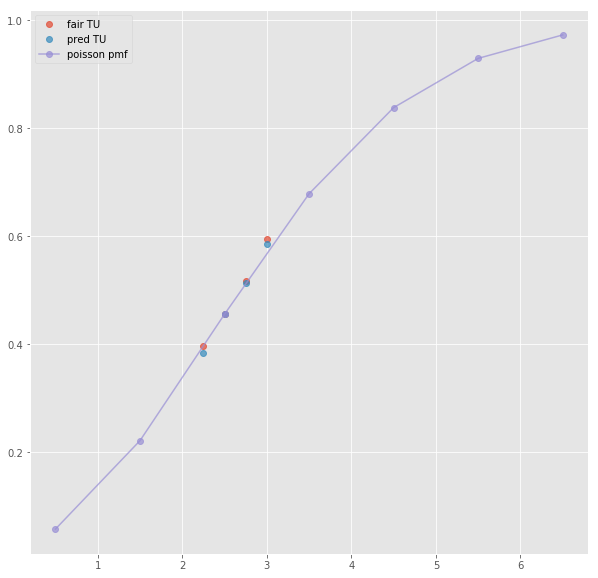

ML : 3.1 3.55 2.31
Error home:  0.018832627038236127
Error draw:  0.023279455640676155
Error away:  0.004446657624907091

(11, 124)
(1, 45)
2.5 1.826 2.07 0.5 1.694 2.29
TO fair:  1.8821256038647343 TU fair:  2.133625410733844
TO pred:  1.88213 TU fair:  2.13363
Error TO:  0.0013176254897704354

Error TO:  0.0002193997604943987

Error TO:  0.0011079825855573877

Error TO:  0.0002158646736980241

Error TO:  1.2410029874843076e-06

Error TO:  0.001656528101158572

Error TO:  6.791577977038887e-05

Error TO:  0.0007447192463998498



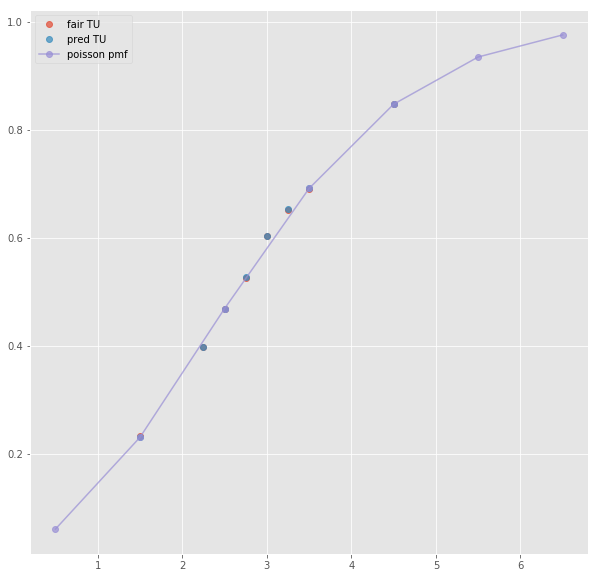

Error T1O:  0.007267410659564155
ML : 3.16 3.57 2.29
Error home:  0.01767818840713853
Error draw:  0.020247924242764836
Error away:  0.0025697546421454276

(63, 124)
(1, 67)
3.5 2.85 1.4 0.5 1.65 2.2
TO fair:  3.0357142857142856 TU fair:  1.4912280701754383
TO pred:  3.03568 TU fair:  1.49124
Error TO:  0.029670661093712303

Error TO:  0.023178453908127117

Error TO:  0.01404413030247842

Error TO:  3.7204572441718042e-06

Error TO:  0.005405694091826729

Error TO:  0.020147548771052848

Error TO:  0.02596506964252021

Error TO:  0.026774285670574605

Error TO:  0.008922298921189675

Error TO:  0.030199700180966405

Error TO:  0.009250777385402309

Error TO:  0.007345720255009541

Error TO:  0.0033291803006234577

Error TO:  0.025898092781382887

Error TO:  0.00922003042385472



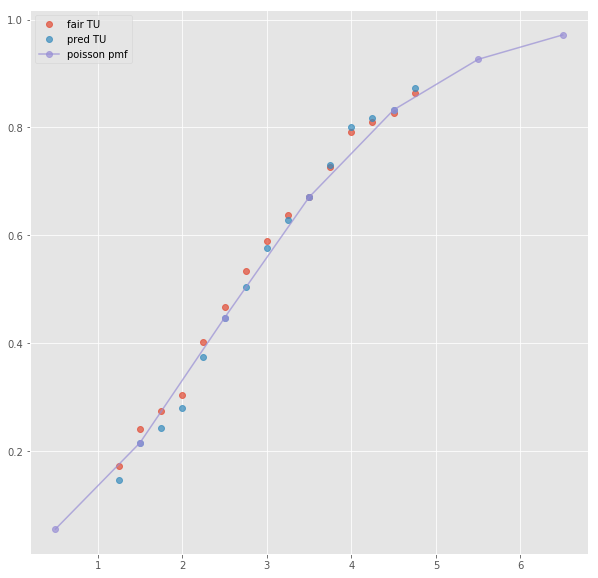

ML : 3.1 3.5 2.25
Error home:  0.018873995166760638
Error draw:  0.025272377946267077
Error away:  0.006398562781024797

(5, 124)
(1, 33)
2.5 1.8 2.06 0.5 1.66 2.28
TO fair:  1.8737864077669903 TU fair:  2.1444444444444444
TO pred:  1.87377 TU fair:  2.14446
Error TO:  0.0026662714842627944

Error TO:  0.009456517895125305

Error TO:  4.673186508430405e-06

Error TO:  0.0011095350780931934

Error TO:  0.01301839018651646



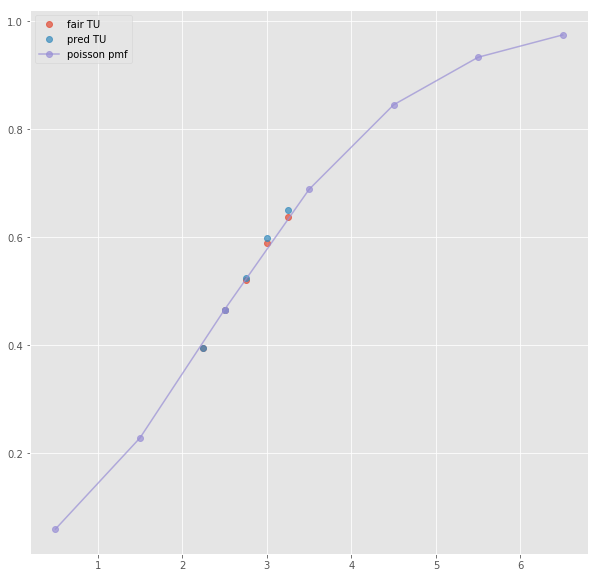

Error T1O:  0.0012223474948870883
ML : 3.11 3.51 2.31
Error home:  0.018708225333605555
Error draw:  0.023506472154172675
Error away:  0.004798537993472296

(55, 124)
next positional indexers are out-of-bounds
(65, 124)
next positional indexers are out-of-bounds
(81, 124)
next positional indexers are out-of-bounds
(262, 124)
next positional indexers are out-of-bounds
(46, 124)
(1, 45)
3.5 2.97 1.423 -0.5 2.08 1.826
TO fair:  3.087139845397049 TU fair:  1.4791245791245793
TO pred:  3.08707 TU fair:  1.47914
Error TO:  0.005347900617144408

Error TO:  0.0032803272315441445

Error TO:  7.328836111042403e-06

Error TO:  0.005006159667507282

Error TO:  0.007073974298263175

Error TO:  0.00621656918971103

Error TO:  0.006509840736891093

Error TO:  0.0013785017374545183



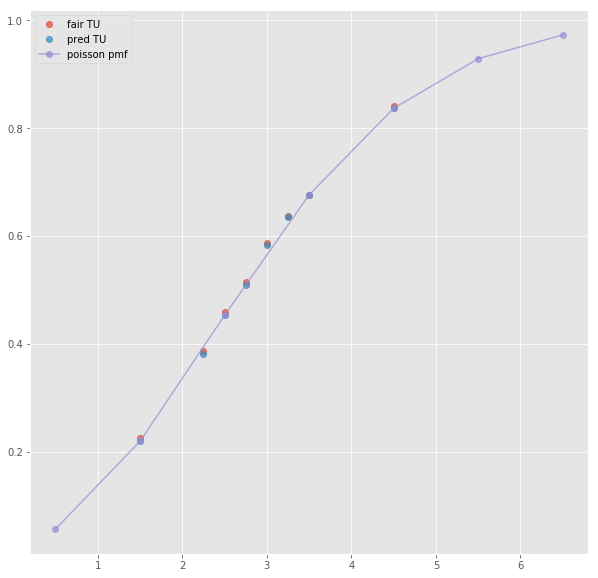

Error T1O:  0.007808753577568883
ML : 2.08 3.49 3.69
Error home:  0.004464444464871875
Error draw:  0.032317121189934295
Error away:  0.027852940989027963

(139, 124)
(1, 71)
3.5 2.6 1.475 -0.5 2.0 1.85
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.014237090532022822

Error TO:  0.025807077317834826

Error TO:  0.012479244015746571

Error TO:  6.306488034957258e-06

Error TO:  0.010726207947077154

Error TO:  0.02384485232508171

Error TO:  0.02117981750360798

Error TO:  0.02067264661700574

Error TO:  0.006330379820712273

Error TO:  0.02415882778140921

Error TO:  0.004170206983200114

Error TO:  0.004772560002322596

Error TO:  0.0007934326163293037

Error TO:  0.02801228972349956

Error TO:  0.013207676297442295



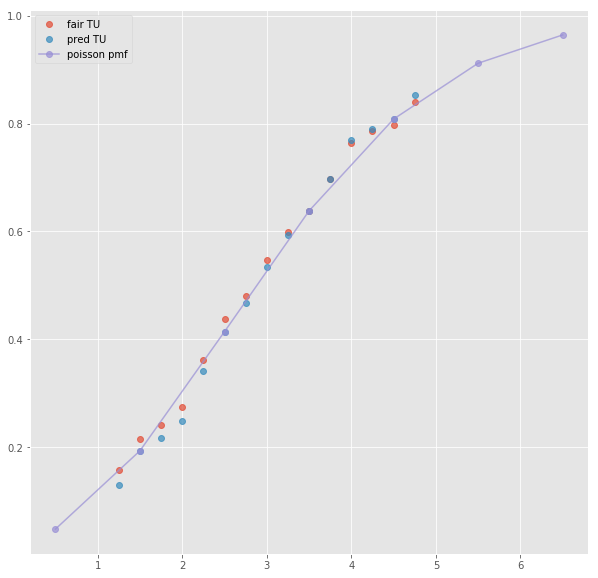

ML : 1.91 3.6 4.0
Error home:  0.017462914689724607
Error draw:  0.02958415789072444
Error away:  0.04704719601860766

(18, 124)
next positional indexers are out-of-bounds
(41, 124)
(1, 39)
2.5 2.69 1.5 -0.5 2.58 1.5490000000000002
TO fair:  2.793333333333333 TU fair:  1.557620817843866
TO pred:  2.79342 TU fair:  1.55759
Error TO:  0.0030584015090523997

Error TO:  0.007300289470358712

Error TO:  1.1106905865698735e-05

Error TO:  0.004803182667484696

Error TO:  0.0006657324612598936

Error TO:  0.004037159585475569

Error TO:  0.021721029662659985



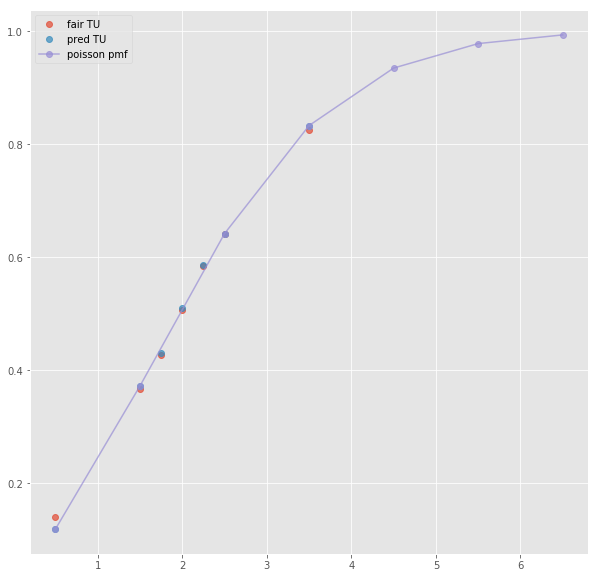

ML : 2.58 2.84 3.39
Error home:  0.000532962167601958
Error draw:  0.04356287528856012
Error away:  0.04302985558965772

(73, 124)
(1, 23)
next list index out of range
(168, 124)
(1, 23)
next list index out of range
(269, 124)
(1, 23)
next list index out of range
(30, 124)
(1, 41)
2.5 2.69 1.5 -0.5 2.58 1.5490000000000002
TO fair:  2.793333333333333 TU fair:  1.557620817843866
TO pred:  2.79342 TU fair:  1.55759
Error TO:  0.0030584015090523997

Error TO:  0.007300289470358712

Error TO:  1.1106905865698735e-05

Error TO:  0.004803182667484696

Error TO:  0.0006657324612598936

Error TO:  0.004037159585475569

Error TO:  0.021721029662659985



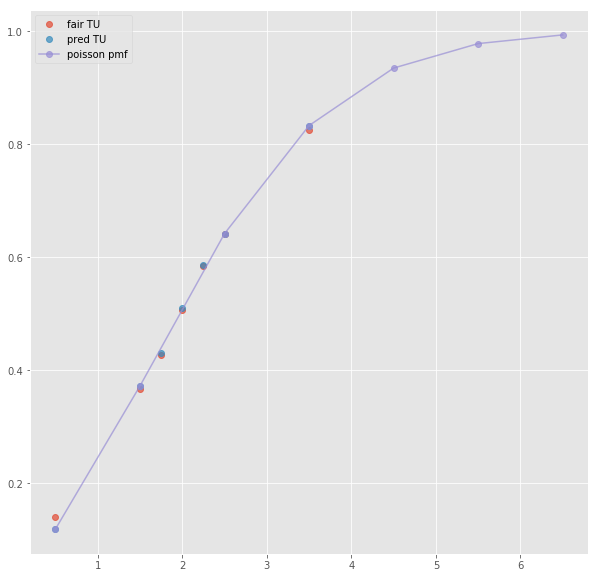

Error T1O:  0.025124960087317405
ML : 2.58 2.84 3.39
Error home:  0.000532962167601958
Error draw:  0.04356287528856012
Error away:  0.04302985558965772

(15, 124)
next positional indexers are out-of-bounds
(39, 124)
next positional indexers are out-of-bounds
(79, 124)
next positional indexers are out-of-bounds
(88, 124)
next positional indexers are out-of-bounds
(142, 124)
next positional indexers are out-of-bounds
(247, 124)
next positional indexers are out-of-bounds
(62, 124)
(1, 43)
2.5 2.36 1.645 -0.5 2.22 1.74
TO fair:  2.4346504559270516 TU fair:  1.6970338983050848
TO pred:  2.43466 TU fair:  1.69703
Error TO:  0.002000562976643694

Error TO:  0.004614076204452644

Error TO:  0.00776468222743526

Error TO:  1.610122101314282e-06

Error TO:  0.005021789650687003

Error TO:  0.0006845979566756921

Error TO:  0.0051974173681126334



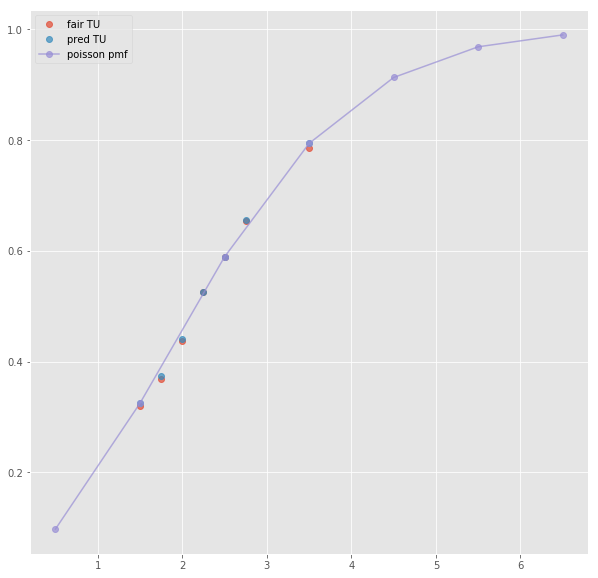

Error T1O:  0.007830743708165167
ML : 2.22 3.23 3.73
Error home:  0.0012764765142641021
Error draw:  0.02385236295603671
Error away:  0.02257585020507752

(48, 124)
(1, 61)
2.5 2.25 1.625 -0.5 2.05 1.88
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.0009003040170663112

Error TO:  0.016384364879377666

Error TO:  0.005660988994402261

Error TO:  0.014579997301658959

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.008832548426947251

Error TO:  0.010404530151327085

Error TO:  0.020352240119340337

Error TO:  0.03249454955068706

Error TO:  0.011428927950369011

Error TO:  0.022057817955149273

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



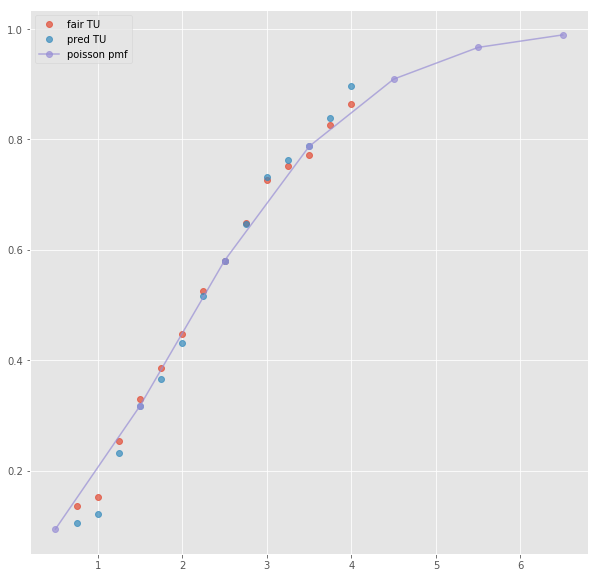

ML : 2.05 3.3 4.0
Error home:  0.009710559032121036
Error draw:  0.021253437225312977
Error away:  0.011542723041857855

(48, 124)
next positional indexers are out-of-bounds
(49, 124)
(1, 42)
2.5 1.952 1.934 -0.5 1.609 2.43
TO fair:  2.0093071354705274 TU fair:  1.9907786885245904
TO pred:  2.00934 TU fair:  1.99075
Error TO:  0.002896760775214946

Error TO:  0.0071244139707974385

Error TO:  0.009894762992498918

Error TO:  0.01388627876351578

Error TO:  0.011017167038843534

Error TO:  8.140061056371994e-06

Error TO:  0.0070430913939025785

Error TO:  0.0015390714900525015



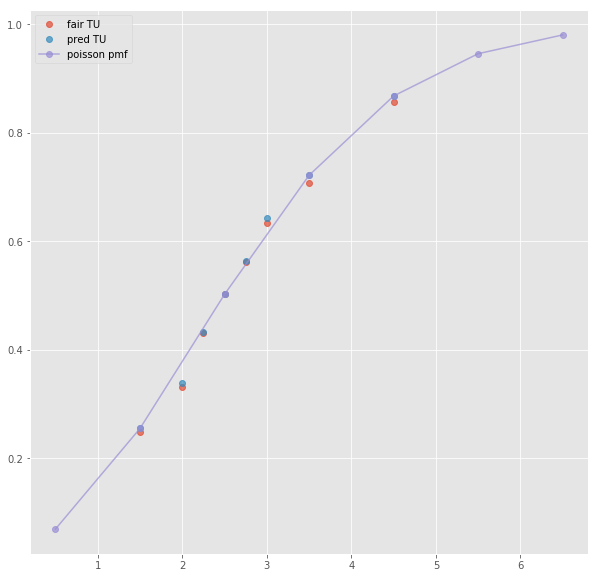

ML : 1.609 3.68 6.75
Error home:  0.004846883564334714
Error draw:  0.03460355994584652
Error away:  0.029756549574448732

(31, 124)
(1, 21)
2.5 1.92 1.9 -0.5 1.65 2.23
TO fair:  2.0105263157894737 TU fair:  1.9895833333333333
TO pred:  2.01051 TU fair:  1.9896
Error TO:  4.036380443828147e-06

Error TO:  0.011414003880202972



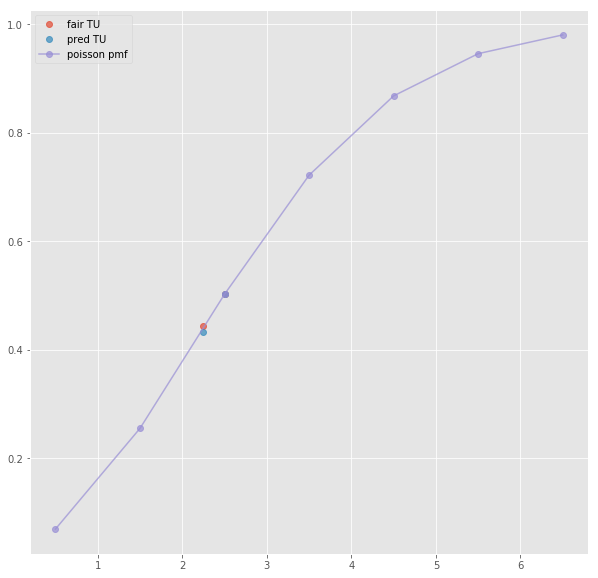

ML : 1.54 3.61 5.76
Error home:  0.015602372190596903
Error draw:  0.01830612884776653
Error away:  0.03390837309930042

(57, 124)
(1, 21)
2.5 1.93 1.97 -0.5 1.66 2.35
TO fair:  1.9796954314720812 TU fair:  2.0207253886010363
TO pred:  1.97969 TU fair:  2.02074
Error TO:  1.3858683650669334e-06

Error TO:  0.01848979084710456



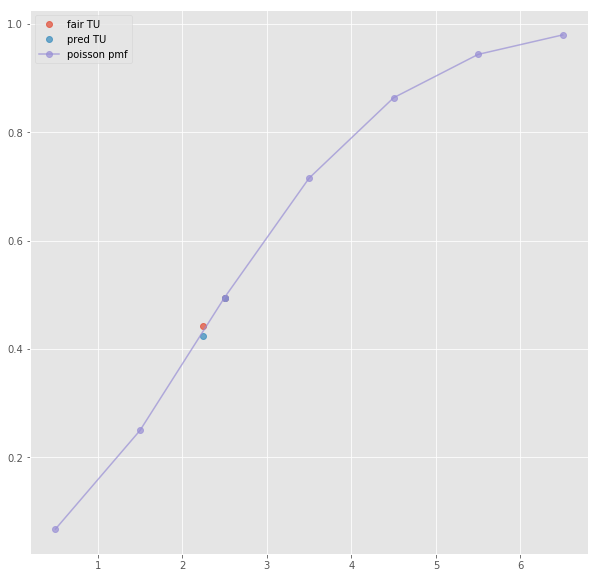

ML : 1.64 3.8 5.9
Error home:  0.0010781173443760173
Error draw:  0.02324717006389318
Error away:  0.02216916344747244

(103, 124)
(1, 21)
2.5 1.94 1.96 -0.5 1.65 2.36
TO fair:  1.989795918367347 TU fair:  2.0103092783505154
TO pred:  1.9898 TU fair:  2.01031
Error TO:  1.0308986085894034e-06

Error TO:  0.010688813436565692



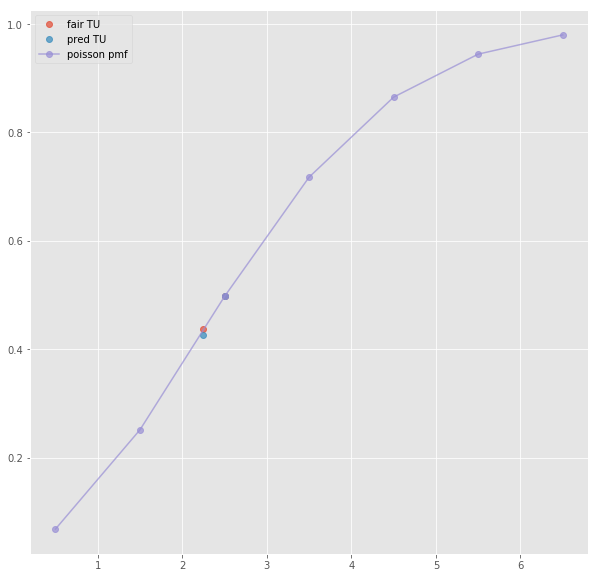

ML : 1.55 3.8 7.0
Error home:  0.02521524418353016
Error draw:  0.021330250412916307
Error away:  0.046545290795702216

(43, 124)
(1, 44)
2.5 1.952 1.934 -0.5 1.609 2.43
TO fair:  2.0093071354705274 TU fair:  1.9907786885245904
TO pred:  2.00934 TU fair:  1.99075
Error TO:  0.002896760775214946

Error TO:  0.0071244139707974385

Error TO:  0.009894762992498918

Error TO:  0.01388627876351578

Error TO:  0.011017167038843534

Error TO:  8.140061056371994e-06

Error TO:  0.0070430913939025785

Error TO:  0.0015390714900525015



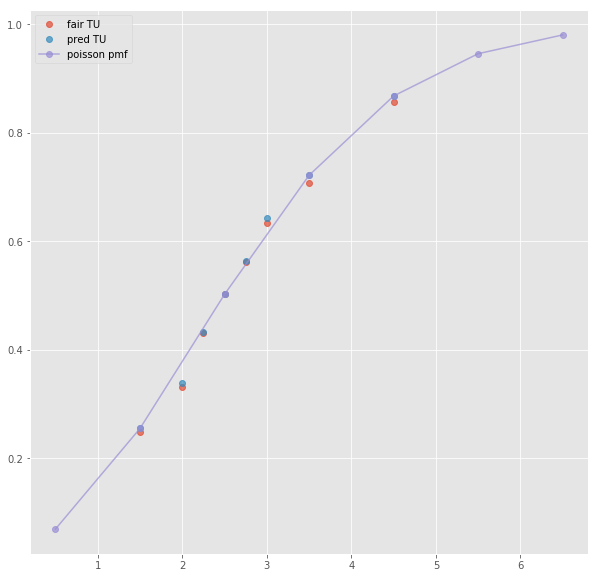

Error T1O:  0.012088753840362787
ML : 1.609 3.68 6.75
Error home:  0.004846883564334714
Error draw:  0.03460355994584652
Error away:  0.029756549574448732

(42, 124)
(1, 66)
2.5 1.925 1.925 -0.5 1.575 2.35
TO fair:  1.9999999999999998 TU fair:  1.9999999999999998
TO pred:  2.00004 TU fair:  1.99996
Error TO:  0.00911407576079798

Error TO:  0.004957831410524527

Error TO:  0.01587554542026537

Error TO:  0.02318104202188198

Error TO:  0.018716717661282467

Error TO:  9.999800004045767e-06

Error TO:  0.010834939106221908

Error TO:  0.001121061619282382

Error TO:  0.014627612199256124

Error TO:  0.014320117158059142

Error TO:  0.01673187565894127

Error TO:  0.021640372427431637

Error TO:  0.02441305829890894

Error TO:  0.019082011306923108



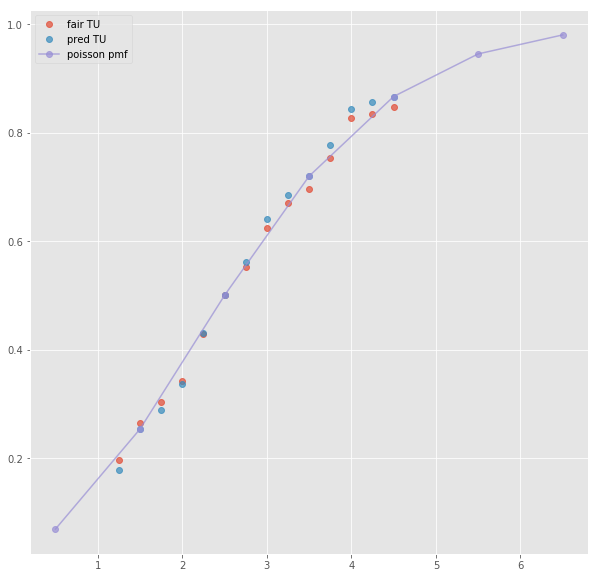

ML : 1.57 3.6 6.5
Error home:  0.0026514833444103436
Error draw:  0.03322197576473182
Error away:  0.030570725280857775

(16, 124)
(1, 34)
2.5 1.93 1.91 -0.5 1.59 2.44
TO fair:  2.0104712041884816 TU fair:  1.9896373056994816
TO pred:  2.01051 TU fair:  1.9896
Error TO:  0.005605046502361211

Error TO:  0.0018809722699008047

Error TO:  0.011124566111496093

Error TO:  9.598000009991559e-06

Error TO:  0.001223243502945004



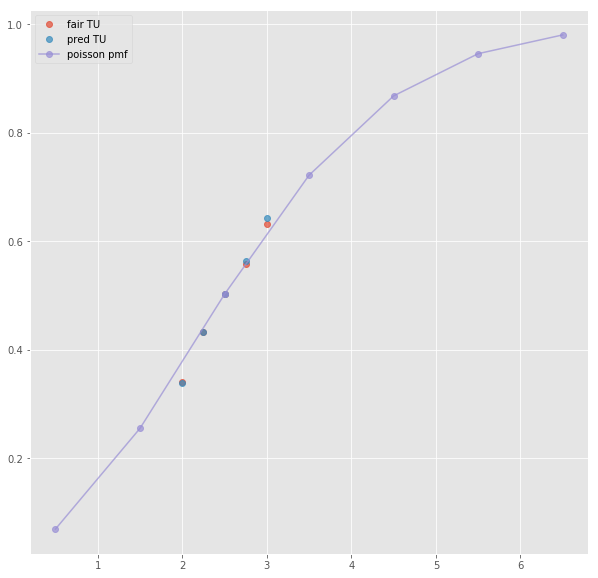

Error T1O:  0.009209152920559238
ML : 1.59 3.91 6.38
Error home:  0.0015415190467388262
Error draw:  0.020266707620071434
Error away:  0.018725101066581262

(54, 124)
(1, 43)
2.5 2.11 1.8 -0.5 2.26 1.714
TO fair:  2.172222222222222 TU fair:  1.8530805687203793
TO pred:  2.1722 TU fair:  1.8531
Error TO:  0.00040419877867614584

Error TO:  0.0011198850456815013

Error TO:  0.007952765364574732

Error TO:  0.003647748979160176

Error TO:  4.709593512564059e-06

Error TO:  0.0020509392964984663

Error TO:  0.00036415613319407125

Error TO:  0.002125370579266983



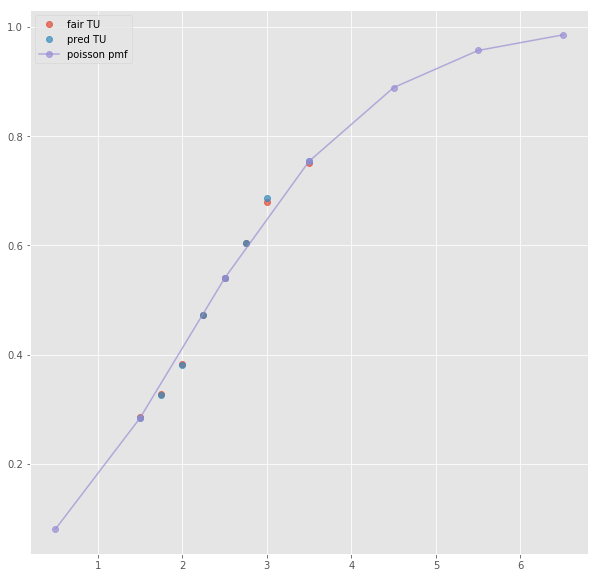

ML : 2.26 3.43 3.39
Error home:  0.001298008709701537
Error draw:  0.01731869159345273
Error away:  0.016020553514073277

(70, 124)
(1, 23)
2.5 2.04 1.78 -0.5 2.19 1.68
TO fair:  2.146067415730337 TU fair:  1.8725490196078434
TO pred:  2.14607 TU fair:  1.87255
Error TO:  0.024019953801491356

Error TO:  5.61113328856333e-07

Error TO:  0.005112719272180377



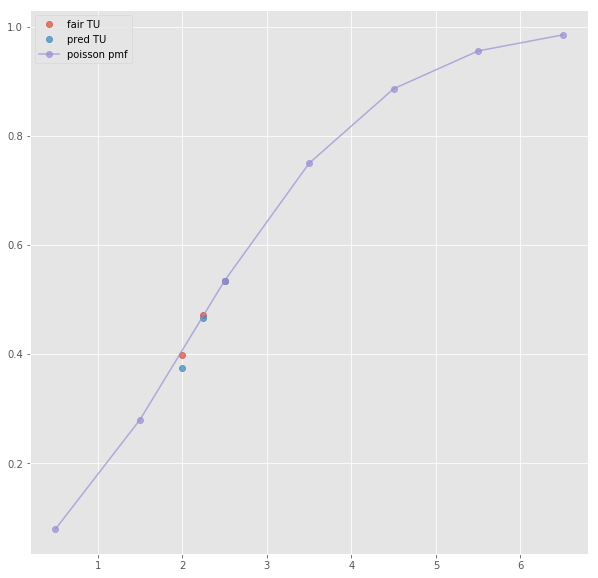

ML : 2.19 3.26 3.31
Error home:  0.005536476474963581
Error draw:  0.02343860274025178
Error away:  0.017902127547742452

(107, 124)
(1, 19)
2.5 2.12 1.79 -0.5 2.29 1.69
TO fair:  2.184357541899441 TU fair:  1.8443396226415094
TO pred:  2.18441 TU fair:  1.8443
Error TO:  1.0993973324047168e-05

Error TO:  0.004531808280626937



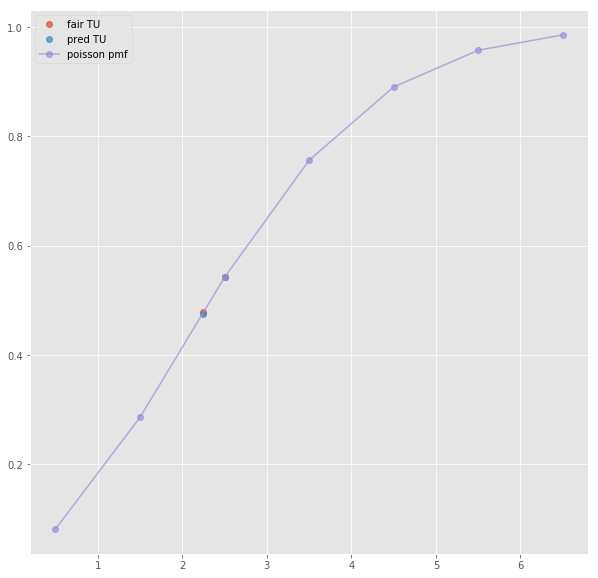

ML : 2.24 3.25 3.4
Error home:  0.001266897584686566
Error draw:  0.026350214779929604
Error away:  0.02761690294845348

(357, 124)
(1, 23)
2.5 2.14 1.77 -0.5 2.26 1.71
TO fair:  2.209039548022599 TU fair:  1.8271028037383177
TO pred:  2.20909 TU fair:  1.82707
Error TO:  0.010672666399714426

Error TO:  1.0338589500780149e-05

Error TO:  0.0015345001459214913



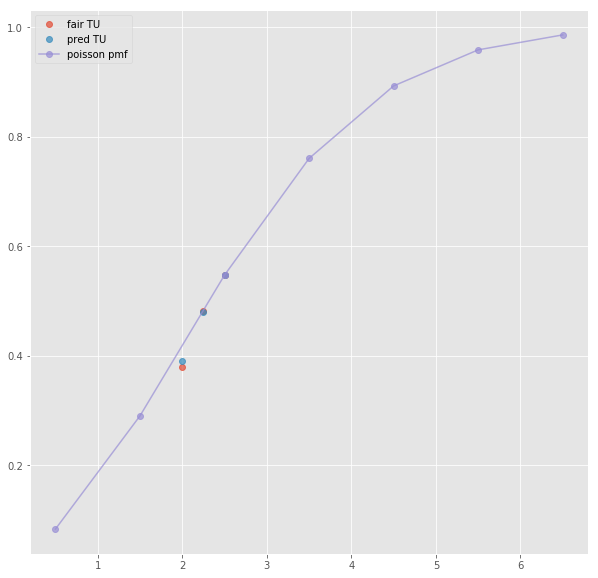

ML : 2.25 3.2 3.4
Error home:  0.007860603176167658
Error draw:  0.029455183535298135
Error away:  0.021594630382163194

(50, 124)
(1, 47)
2.5 2.11 1.8 -0.5 2.26 1.714
TO fair:  2.172222222222222 TU fair:  1.8530805687203793
TO pred:  2.1722 TU fair:  1.8531
Error TO:  0.00040419877867614584

Error TO:  0.0011198850456815013

Error TO:  0.007952765364574732

Error TO:  0.003647748979160176

Error TO:  4.709593512564059e-06

Error TO:  0.0020509392964984663

Error TO:  0.00036415613319407125

Error TO:  0.002125370579266983



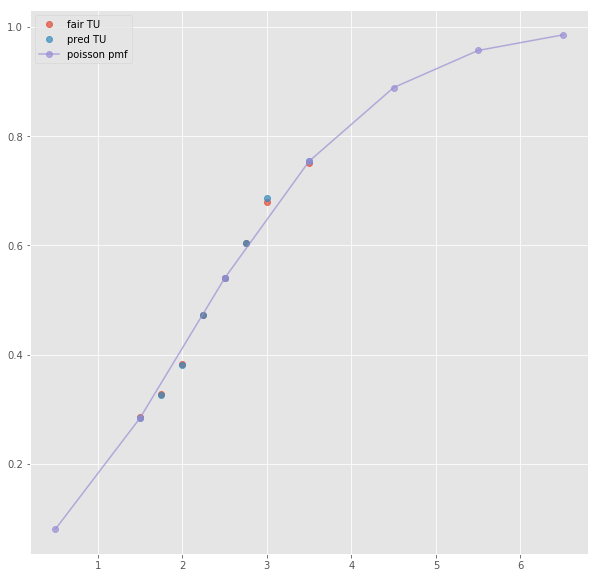

Error T1O:  0.004381434292372588
ML : 2.26 3.43 3.39
Error home:  0.001298008709701537
Error draw:  0.01731869159345273
Error away:  0.016020553514073277

(53, 124)
(1, 62)
2.5 2.075 1.725 -0.5 2.2 1.65
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20286 TU fair:  1.83135
Error TO:  0.006166961368480883

Error TO:  0.005845185129437991

Error TO:  0.008459417505759348

Error TO:  0.023681350615426117

Error TO:  0.02813863438686913

Error TO:  7.944217971178613e-06

Error TO:  0.014284737492228028

Error TO:  0.005439049745373459

Error TO:  0.01718642427817213

Error TO:  0.009614677377671854

Error TO:  0.01980480616583484

Error TO:  0.020474852208014843

Error TO:  0.02262909027312815

Error TO:  0.019857475386065415



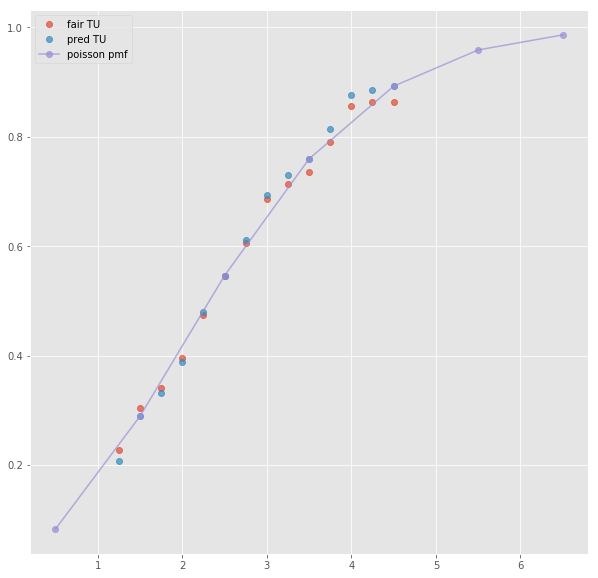

ML : 2.2 3.25 3.5
Error home:  0.005181731183445171
Error draw:  0.02586029322603267
Error away:  0.031042150735853646

(9, 124)
(1, 33)
2.5 2.06 1.8 -0.5 2.24 1.68
TO fair:  2.1444444444444444 TU fair:  1.8737864077669903
TO pred:  2.14447 TU fair:  1.87377
Error TO:  0.004108392469514499

Error TO:  0.0010553861089440675

Error TO:  5.557129941491379e-06

Error TO:  0.0006063166669425524

Error TO:  0.0027680751754196598



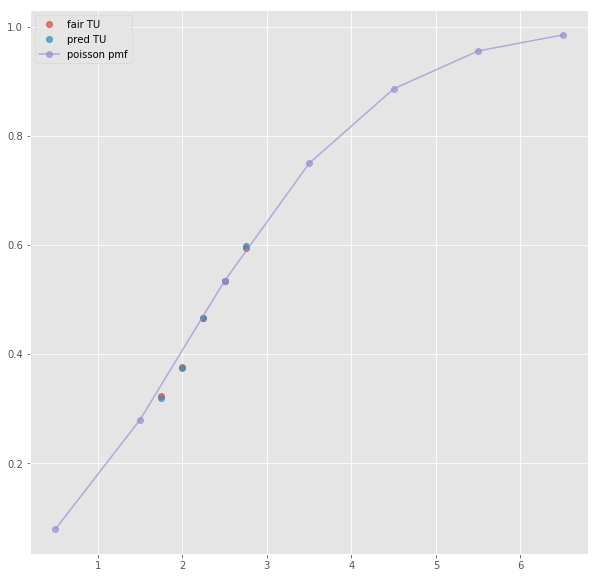

Error T1O:  0.009864562579093239
ML : 2.27 3.33 3.34
Error home:  0.005098894293073475
Error draw:  0.02382223027624808
Error away:  0.01872327908764365

(230, 124)
(1, 47)
3.5 2.59 1.546 0.5 1.909 2.01
TO fair:  2.67529107373868 TU fair:  1.5969111969111967
TO pred:  2.67527 TU fair:  1.59692
Error TO:  0.006608647932692557

Error TO:  0.004606095743217076

Error TO:  2.9444415013957226e-06

Error TO:  0.006079168984097411

Error TO:  0.007125343762445668

Error TO:  0.002639497507552546

Error TO:  0.0023001540047712377

Error TO:  0.03723767663291977



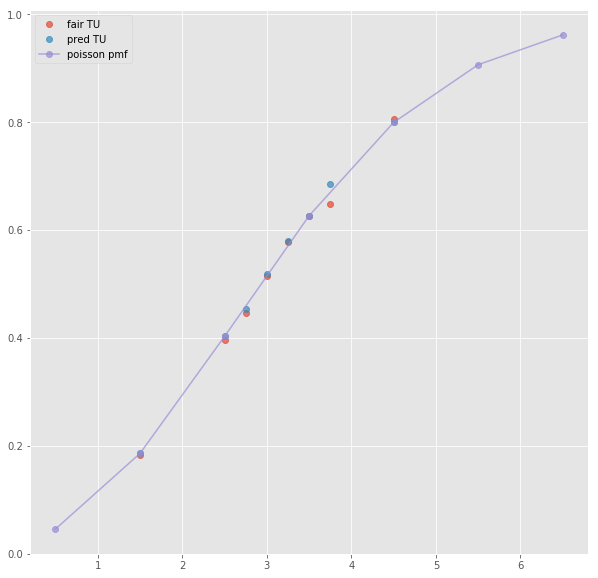

ML : 3.79 3.76 2.01
Error home:  0.024412310301254014
Error draw:  0.027252030647127584
Error away:  0.002839678483442354

(225, 124)
(1, 27)
2.5 1.52 2.47 0.5 1.87 2.0
TO fair:  1.6153846153846156 TU fair:  2.6250000000000004
TO pred:  1.61536 TU fair:  2.62506
Error TO:  0.0028519126704126263

Error TO:  0.02033977026264433

Error TO:  9.433250320878273e-06

Error TO:  0.03682714783372548



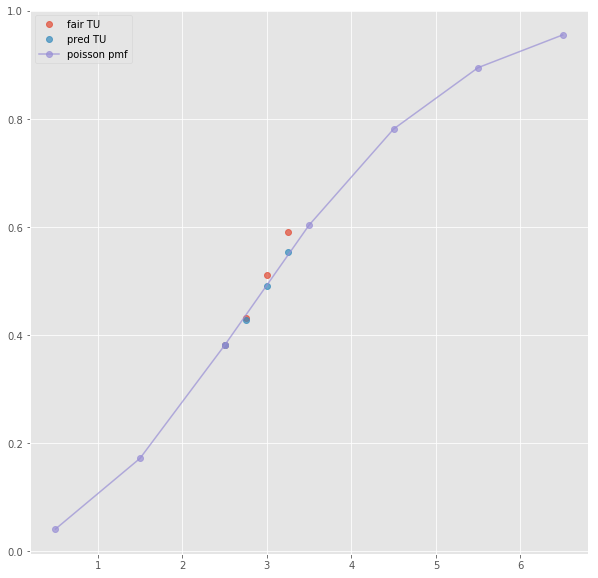

ML : 3.61 3.61 2.0
Error home:  0.02580235926041624
Error draw:  0.03463495087996857
Error away:  0.008832683181899392

(283, 124)
(1, 27)
2.5 1.62 2.42 0.5 1.9 2.05
TO fair:  1.669421487603306 TU fair:  2.493827160493827
TO pred:  1.66943 TU fair:  2.4938
Error TO:  0.010980416063273268

Error TO:  0.0012213847185000848

Error TO:  3.05434184177944e-06

Error TO:  0.002027788637014749



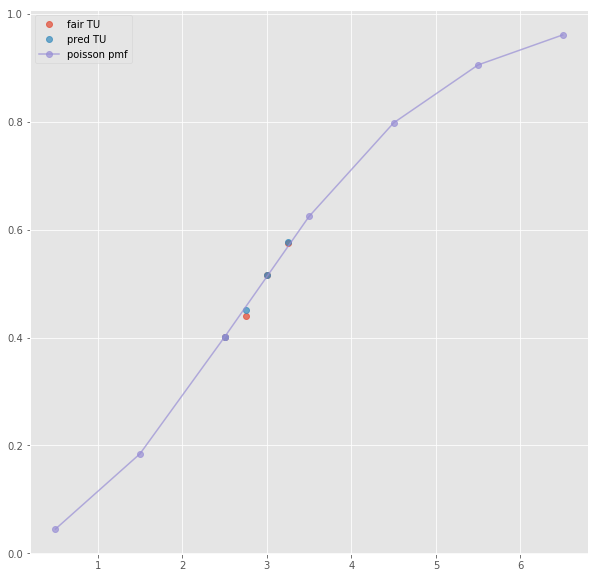

ML : 3.55 3.75 2.0
Error home:  0.018150923664958296
Error draw:  0.022235197101255405
Error away:  0.004084448186372325

(689, 124)
(1, 27)
2.5 1.59 2.49 0.5 1.93 2.02
TO fair:  1.6385542168674698 TU fair:  2.566037735849057
TO pred:  1.63857 TU fair:  2.56601
Error TO:  0.004375304738667651

Error TO:  0.01617531901261815

Error TO:  5.878511715295964e-06

Error TO:  0.024250931511155205



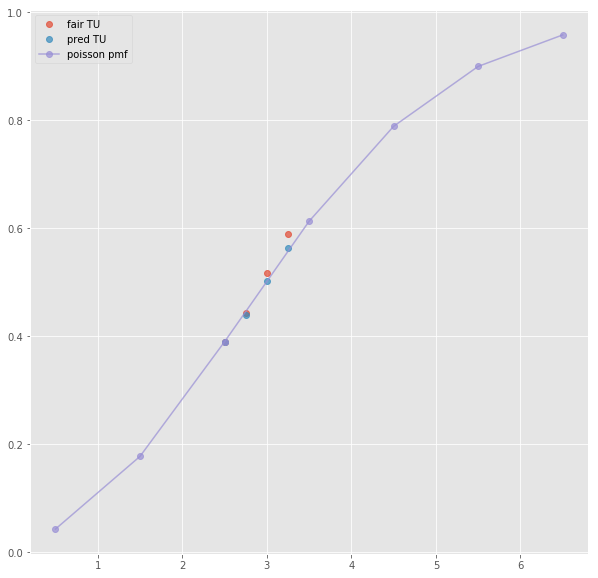

ML : 3.7 3.6 2.02
Error home:  0.023198917202595926
Error draw:  0.037204213249945106
Error away:  0.014005343973289508

(152, 124)
(1, 49)
3.5 2.59 1.546 0.5 1.909 2.01
TO fair:  2.67529107373868 TU fair:  1.5969111969111967
TO pred:  2.67527 TU fair:  1.59692
Error TO:  0.006608647932692557

Error TO:  0.004606095743217076

Error TO:  2.9444415013957226e-06

Error TO:  0.006079168984097411

Error TO:  0.007125343762445668

Error TO:  0.002639497507552546

Error TO:  0.0023001540047712377

Error TO:  0.04257491599996788



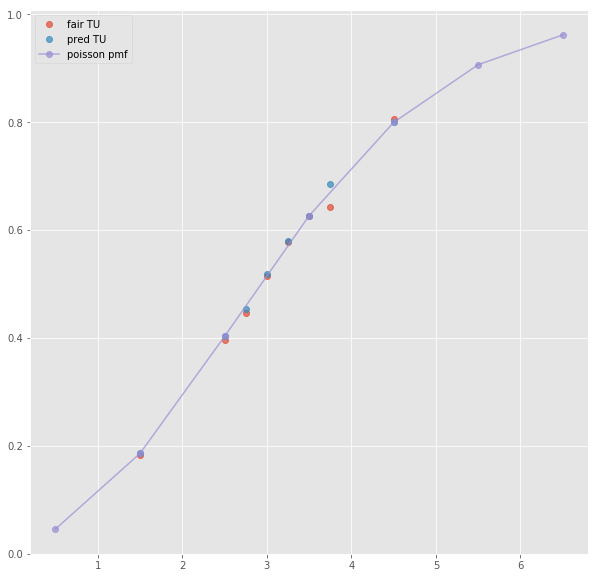

Error T1O:  0.006271568706085917
ML : 3.79 3.76 2.01
Error home:  0.024412310301254014
Error draw:  0.027252030647127584
Error away:  0.002839678483442354

(81, 124)
next positional indexers are out-of-bounds
(147, 124)
(1, 48)
3.5 2.51 1.578 0.5 1.909 2.01
TO fair:  2.5906210392902405 TU fair:  1.6286852589641436
TO pred:  2.59063 TU fair:  1.62868
Error TO:  0.005588782792935176

Error TO:  0.005029406077942056

Error TO:  1.3351594437827075e-06

Error TO:  0.009884246215158071

Error TO:  0.0066329347830549334

Error TO:  0.007681607066337137

Error TO:  0.02487755353562815

Error TO:  0.0017390020273983509



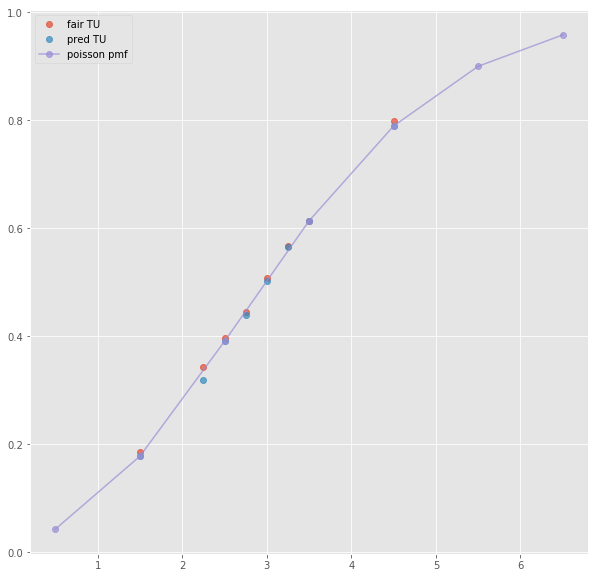

Error T1O:  0.023368843197385303
ML : 3.78 3.77 2.01
Error home:  0.025891063324282204
Error draw:  0.02872260651382405
Error away:  0.0028314276196382826

(155, 124)
(1, 70)
3.5 2.5 1.5 0.5 1.99 1.94
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.01526072004546808

Error TO:  0.0283832840453333

Error TO:  0.0027959588799740254

Error TO:  6.56261484577314e-06

Error TO:  0.007446642532960512

Error TO:  0.018042515322542085

Error TO:  0.024340724817056292

Error TO:  0.02288588915018097

Error TO:  0.002874702157919795

Error TO:  0.02281688652075231

Error TO:  0.0035467397737521666

Error TO:  0.006359533221907437

Error TO:  0.0014226721918641494

Error TO:  0.024801797381581947

Error TO:  0.009081106112049597

Error TO:  0.030196257800876578



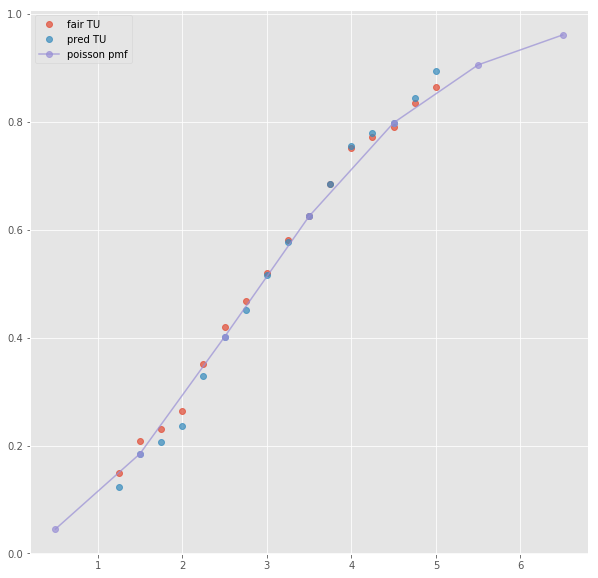

ML : 4.0 3.6 1.91
Error home:  0.02714071971413498
Error draw:  0.035519314109787786
Error away:  0.008378510367191616

(60, 124)
next positional indexers are out-of-bounds
(30, 124)
(1, 17)
next list index out of range
(50, 124)
(1, 35)
2.5 2.05 1.81 -0.5 1.53 2.58
TO fair:  2.132596685082873 TU fair:  1.882926829268293
TO pred:  2.13255 TU fair:  1.88296
Error TO:  0.002340720193439949

Error TO:  0.0050004268694562315

Error TO:  0.0059415264042795846

Error TO:  1.0265265391107281e-05

Error TO:  0.0022135903606271823

Error TO:  0.07595505825330601



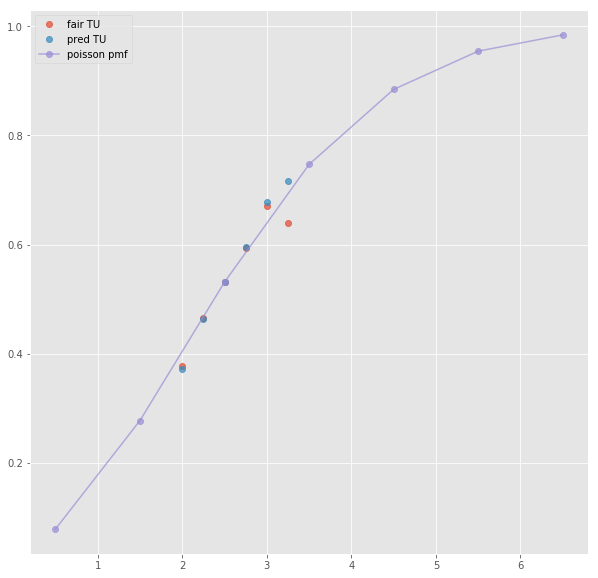

Error T1O:  0.0019209662766167535
ML : 1.54 4.17 6.64
Error home:  0.0032352558041972568
Error draw:  0.006863497400365209
Error away:  0.0036282202773118277

(103, 124)
(1, 45)
2.5 1.99 1.917 -0.5 2.19 1.757
TO fair:  2.0380803338549818 TU fair:  1.9633165829145731
TO pred:  2.03811 TU fair:  1.96329
Error TO:  0.0007617338939844842

Error TO:  0.004138363341025242

Error TO:  0.0014470455330441445

Error TO:  0.0012394895108634452

Error TO:  0.004231314921879864

Error TO:  7.141874217964084e-06

Error TO:  0.005773932109477964

Error TO:  0.0013084870609813004

Error TO:  0.027840013989127277



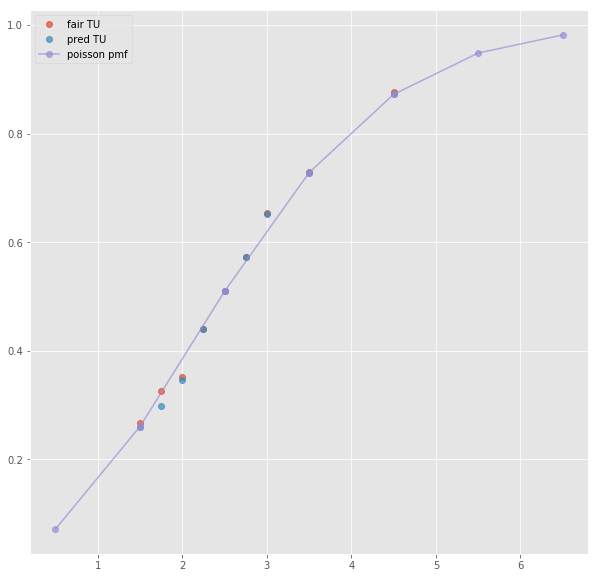

ML : 2.19 3.37 3.63
Error home:  0.001319211468841841
Error draw:  0.030559316848467855
Error away:  0.029240139398285625

(190, 124)
(1, 27)
2.5 2.0 1.84 -0.5 2.2 1.7
TO fair:  2.0869565217391304 TU fair:  1.92
TO pred:  2.08696 TU fair:  1.91999
Error TO:  0.003326428564711492

Error TO:  0.01089671975103268

Error TO:  7.986097800838365e-07

Error TO:  0.009053897998278937



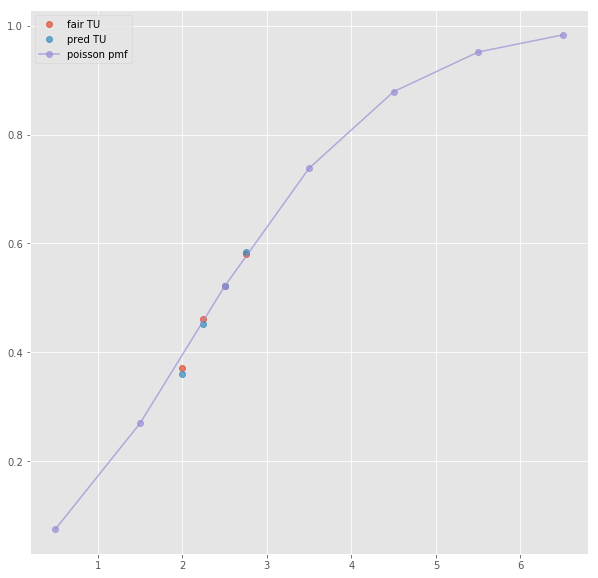

ML : 2.22 3.16 3.46
Error home:  0.009287953509661329
Error draw:  0.03840053366926621
Error away:  0.02911241970256956

(208, 124)
(1, 27)
2.5 2.02 1.9 -0.5 2.25 1.75
TO fair:  2.063157894736842 TU fair:  1.9405940594059403
TO pred:  2.06312 TU fair:  1.94063
Error TO:  0.004170489812441003

Error TO:  0.02947297973251295

Error TO:  8.902704127067285e-06

Error TO:  0.005823965386948515



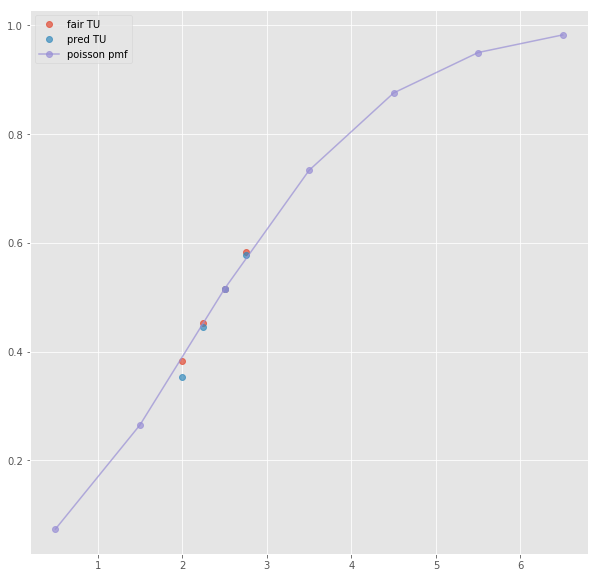

ML : 2.16 3.3 3.5
Error home:  0.0027061566698467487
Error draw:  0.0282213344565298
Error away:  0.03092770218781088

(410, 124)
(1, 27)
2.5 2.0 1.92 -0.5 2.26 1.74
TO fair:  2.041666666666667 TU fair:  1.9600000000000002
TO pred:  2.04165 TU fair:  1.96002
Error TO:  0.013219212840806405

Error TO:  0.020078652398571317

Error TO:  3.998366667257169e-06

Error TO:  0.011264159187544531



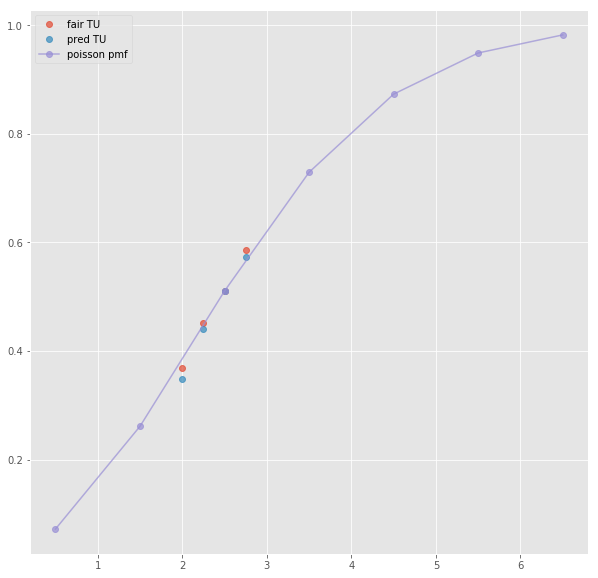

ML : 2.25 3.2 3.5
Error home:  0.008741296917863073
Error draw:  0.040707590276804484
Error away:  0.03196625940041248

(82, 124)
(1, 47)
2.5 1.99 1.917 -0.5 2.19 1.757
TO fair:  2.0380803338549818 TU fair:  1.9633165829145731
TO pred:  2.03811 TU fair:  1.96329
Error TO:  0.0007617338939844842

Error TO:  0.004138363341025242

Error TO:  0.0014470455330441445

Error TO:  0.0012394895108634452

Error TO:  0.004231314921879864

Error TO:  7.141874217964084e-06

Error TO:  0.005773932109477964

Error TO:  0.0013084870609813004

Error TO:  0.027840013989127277



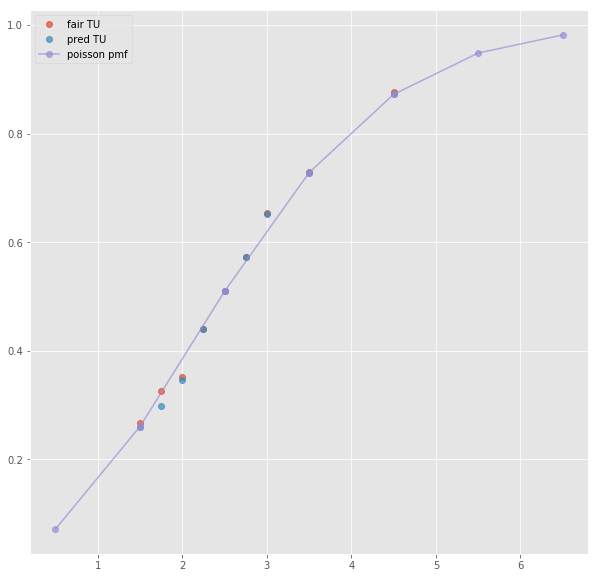

Error T1O:  0.006437280665702649
ML : 2.19 3.37 3.63
Error home:  0.001319211468841841
Error draw:  0.030559316848467855
Error away:  0.029240139398285625

(61, 124)
(1, 63)
2.5 2.075 1.725 -0.5 2.04 1.86
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20286 TU fair:  1.83135
Error TO:  0.012536388120073183

Error TO:  0.005845185129437991

Error TO:  0.023585467925927417

Error TO:  0.023681350615426117

Error TO:  0.032121111487625795

Error TO:  7.944217971178613e-06

Error TO:  0.014284737492228028

Error TO:  0.004764285912714827

Error TO:  0.01718642427817213

Error TO:  0.009614677377671854

Error TO:  0.01980480616583484

Error TO:  0.020474852208014843

Error TO:  0.02262909027312815

Error TO:  0.014281115061101746

Error TO:  0.03148260384609469



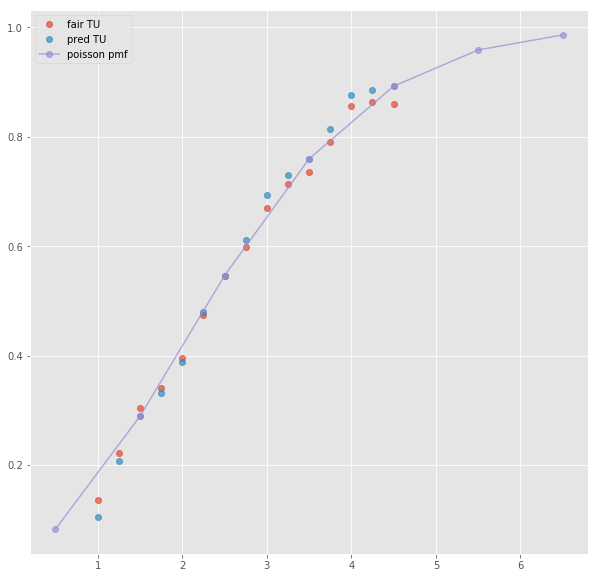

ML : 1.95 3.4 4.0
Error home:  0.008254481274542758
Error draw:  0.01622907177234234
Error away:  0.02448322009573345

(11, 124)
(1, 35)
2.5 2.08 1.79 -0.5 2.1 1.77
TO fair:  2.1620111731843576 TU fair:  1.860576923076923
TO pred:  2.162 TU fair:  1.86058
Error TO:  0.0036304117581125173

Error TO:  0.003386091926057544

Error TO:  2.3903601555907983e-06

Error TO:  0.0016943610369154483

Error TO:  0.004452637535550474



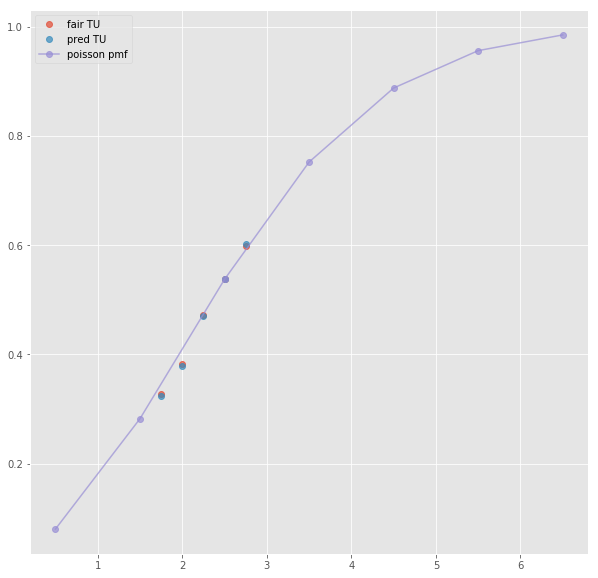

Error T1O:  0.008197681087488251
ML : 2.12 3.38 3.66
Error home:  0.0041381210999705265
Error draw:  0.02151634541245867
Error away:  0.01737793716745384

(47, 124)
(1, 45)
2.5 2.1 1.787 -0.5 2.54 1.564
TO fair:  2.1751538891997764 TU fair:  1.850952380952381
TO pred:  2.17515 TU fair:  1.85096
Error TO:  0.0011725759620680454

Error TO:  0.0016585068131459435

Error TO:  0.011671812942211535

Error TO:  0.0005452986057295495

Error TO:  8.22017479196191e-07

Error TO:  0.003232510013811085

Error TO:  0.0013888273715565447

Error TO:  0.0021078983446528587



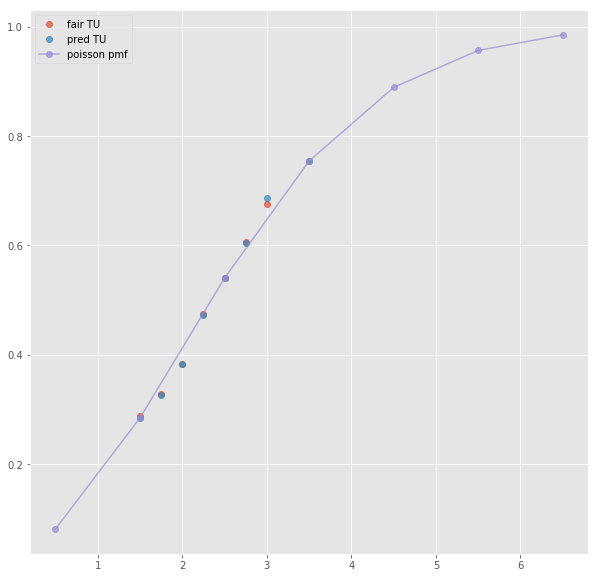

ML : 2.54 3.33 2.93
Error home:  0.0008154662450244321
Error draw:  0.02106805685005375
Error away:  0.020252831994632403

(63, 124)
(1, 25)
2.5 2.08 1.74 -0.5 2.47 1.52
TO fair:  2.195402298850575 TU fair:  1.8365384615384617
TO pred:  2.19546 TU fair:  1.8365
Error TO:  0.011729589359530612

Error TO:  1.1971396660814815e-05

Error TO:  0.0010177267202400309



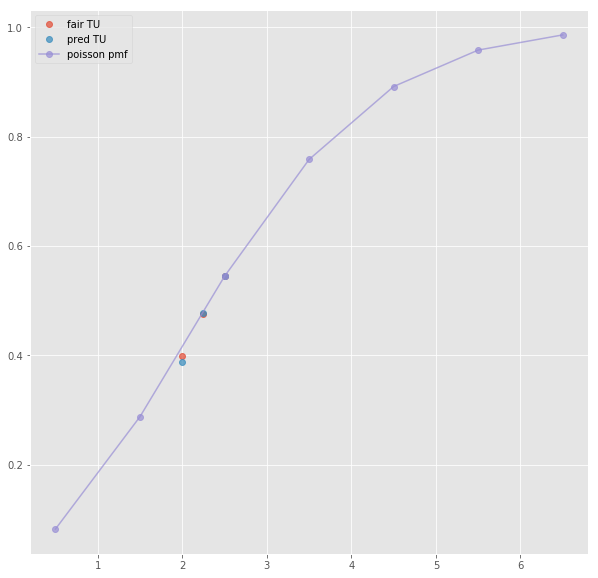

ML : 2.48 2.96 2.81
Error home:  0.01335068823495078
Error draw:  0.03794877470259084
Error away:  0.02459816377330576

(70, 124)
(1, 19)
next list index out of range
(107, 124)
(1, 25)
2.5 2.13 1.78 -0.5 2.53 1.57
TO fair:  2.1966292134831464 TU fair:  1.8356807511737092
TO pred:  2.19667 TU fair:  1.83565
Error TO:  0.013952392181106998

Error TO:  8.452692000116002e-06

Error TO:  0.0017567541508379803



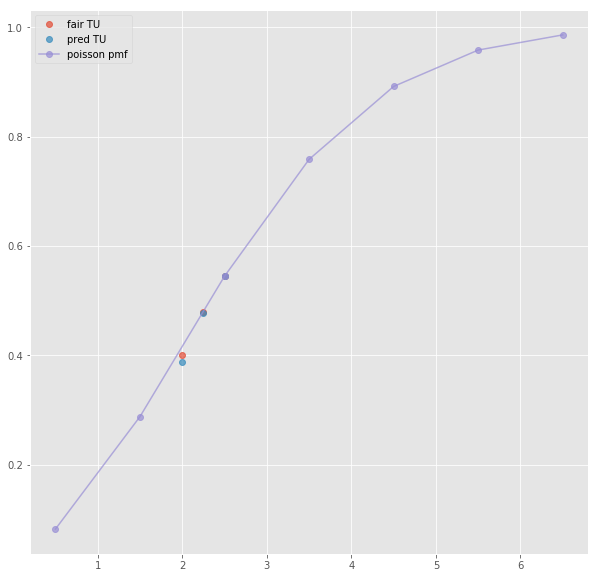

ML : 2.53 3.2 2.94
Error home:  0.005748687174399636
Error draw:  0.02816981539841873
Error away:  0.022420911494560325

(28, 124)
(1, 47)
2.5 2.1 1.787 -0.5 2.54 1.564
TO fair:  2.1751538891997764 TU fair:  1.850952380952381
TO pred:  2.17515 TU fair:  1.85096
Error TO:  0.0011725759620680454

Error TO:  0.0016585068131459435

Error TO:  0.010776287676032503

Error TO:  0.0005452986057295495

Error TO:  8.22017479196191e-07

Error TO:  0.003232510013811085

Error TO:  0.0013888273715565447

Error TO:  0.0021078983446528587



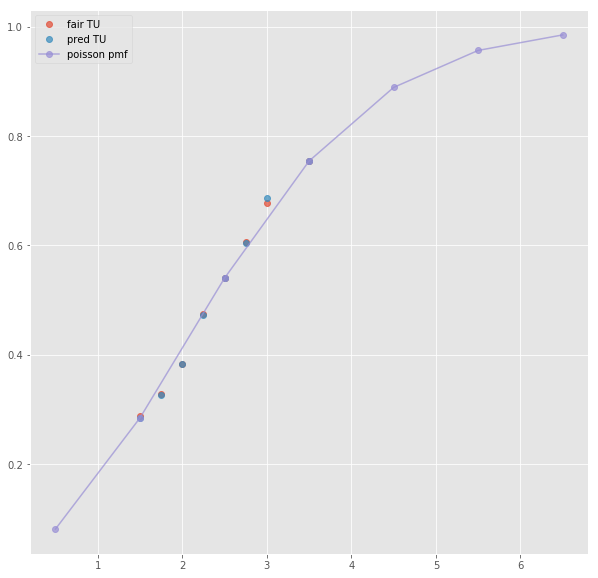

Error T1O:  0.010693503826334605
ML : 2.54 3.33 2.93
Error home:  0.0008154662450244321
Error draw:  0.02106805685005375
Error away:  0.020252831994632403

(48, 124)
(1, 66)
2.5 2.05 1.75 -0.5 2.5 1.5
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17137 TU fair:  1.8537
Error TO:  0.00553519951934639

Error TO:  0.013601482666040221

Error TO:  0.016165847866408345

Error TO:  0.018186318005699253

Error TO:  0.024698764938304515

Error TO:  1.2422426491298655e-05

Error TO:  0.0026598290823284243

Error TO:  0.004864237800480509

Error TO:  0.010867722361024845

Error TO:  0.003988973440308019

Error TO:  0.01993212859652785

Error TO:  0.020641586989545158

Error TO:  0.022780135728210887

Error TO:  0.018742052420808952

Error TO:  0.03452538387395965



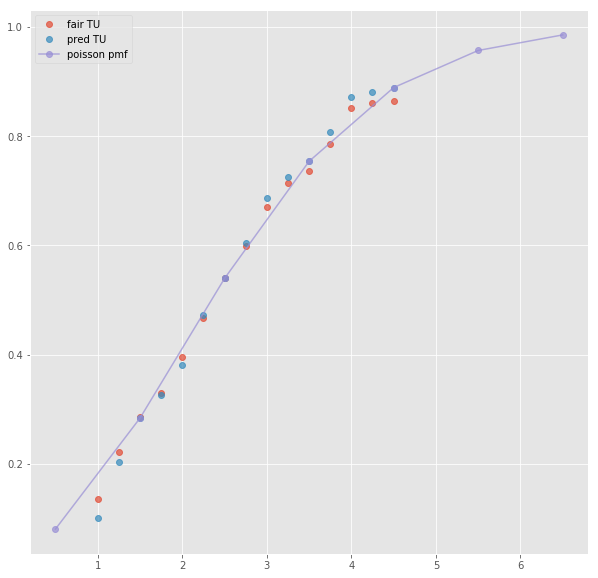

ML : 2.55 3.1 3.0
Error home:  0.0008321566795549407
Error draw:  0.03887469838515634
Error away:  0.038042653586722264

(3, 124)
(1, 35)
2.5 2.08 1.79 -0.5 2.45 1.58
TO fair:  2.1620111731843576 TU fair:  1.860576923076923
TO pred:  2.162 TU fair:  1.86058
Error TO:  0.004634152406491565

Error TO:  0.003386091926057544

Error TO:  2.3903601555907983e-06

Error TO:  0.0016943610369154483

Error TO:  0.0037021074408681853



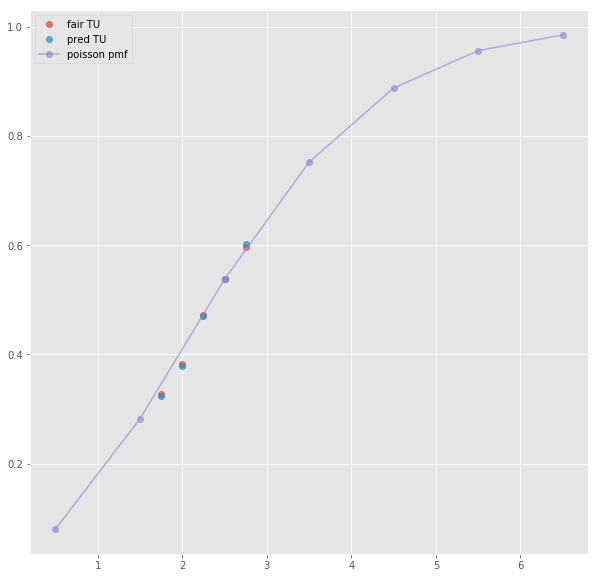

Error T1O:  0.009318819151635682
ML : 2.48 3.31 2.99
Error home:  0.004250282415306117
Error draw:  0.02256024468721407
Error away:  0.0183101940911386

(47, 124)
next positional indexers are out-of-bounds
(791, 124)
(1, 41)
2.5 2.64 1.5019999999999998 -0.5 2.63 1.52
TO fair:  2.7576564580559255 TU fair:  1.5689393939393939
TO pred:  2.75775 TU fair:  1.56891
Error TO:  0.0018316441350990642

Error TO:  0.01365112845215613

Error TO:  1.230017630399205e-05

Error TO:  0.002212838503760417

Error TO:  0.00040706254797323593

Error TO:  0.0014014869084323367

Error TO:  0.022817851543403433



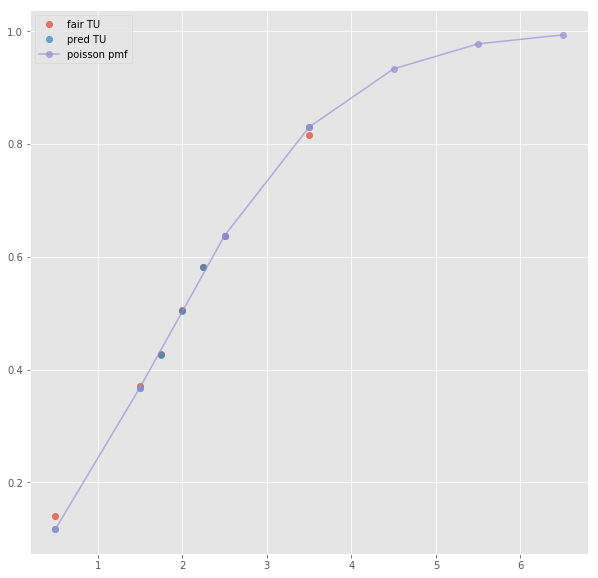

ML : 2.65 2.87 3.2
Error home:  0.0028180237114954765
Error draw:  0.03999640744411109
Error away:  0.037178801995188304

(163, 124)
(1, 19)
next list index out of range
(32, 124)
(1, 19)
next list index out of range
(70, 124)
(1, 19)
next list index out of range
(25, 124)
(1, 43)
2.5 2.64 1.5019999999999998 -0.5 2.63 1.52
TO fair:  2.7576564580559255 TU fair:  1.5689393939393939
TO pred:  2.75775 TU fair:  1.56891
Error TO:  0.0018316441350990642

Error TO:  0.01365112845215613

Error TO:  1.230017630399205e-05

Error TO:  0.002212838503760417

Error TO:  0.00040706254797323593

Error TO:  0.0014014869084323367

Error TO:  0.022817851543403433



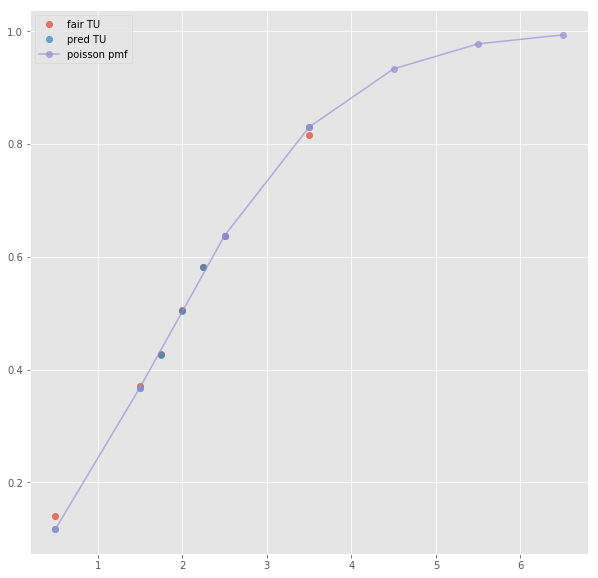

Error T1O:  0.018231496364251754
ML : 2.65 2.87 3.2
Error home:  0.0028180237114954765
Error draw:  0.03999640744411109
Error away:  0.037178801995188304

(56, 124)
(1, 62)
2.5 2.5 1.5 -0.5 2.425 1.525
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.0071934176959742024

Error TO:  0.0060536478446925335

Error TO:  0.012561674457684524

Error TO:  0.017673153762311128

Error TO:  6.56261484577314e-06

Error TO:  0.01835574355840064

Error TO:  0.004548376697907031

Error TO:  0.015857661321298372

Error TO:  0.007441381525318258

Error TO:  0.015980617514545076

Error TO:  0.0196081920208222

Error TO:  0.02493880607627963

Error TO:  0.03055600464439512



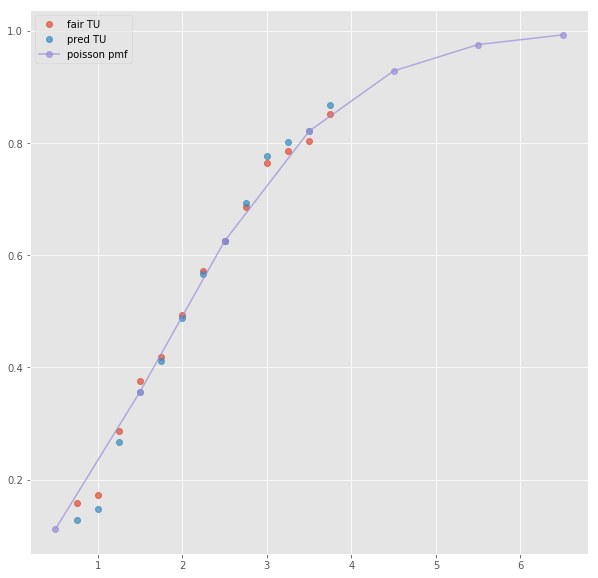

ML : 2.4 3.1 3.1
Error home:  0.00634641326102664
Error draw:  0.012568979218709198
Error away:  0.01891538497580486

(11, 124)
(1, 33)
2.5 2.6 1.53 -0.5 2.56 1.54
TO fair:  2.699346405228758 TU fair:  1.5884615384615384
TO pred:  2.69927 TU fair:  1.58849
Error TO:  0.001402943833696324

Error TO:  1.0486199878367852e-05

Error TO:  0.0021789590214958965

Error TO:  0.0004931829769936336

Error TO:  0.0009139141585088328



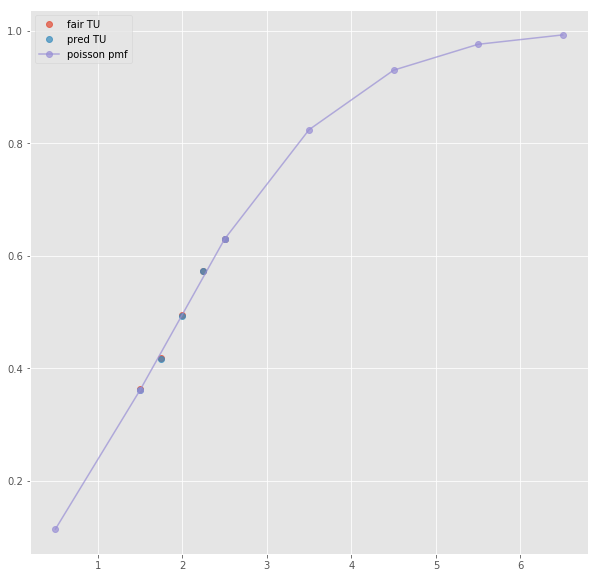

Error T1O:  0.011152728293667591
ML : 2.6 2.97 3.14
Error home:  0.005718258287695788
Error draw:  0.030840722816354083
Error away:  0.02512270151267615

(13, 124)
(1, 40)
3.5 2.18 1.689 -2.5 1.917 1.934
TO fair:  2.290704558910598 TU fair:  1.7747706422018348
TO pred:  2.29075 TU fair:  1.77475
Error TO:  0.009934301726735484

Error TO:  0.008648561299448465

Error TO:  8.659682299128058e-06

Error TO:  0.010800575864698958

Error TO:  0.009670645028586722

Error TO:  0.0039893299518790615

Error TO:  0.0030777330820408455

Error TO:  0.00353298435400462



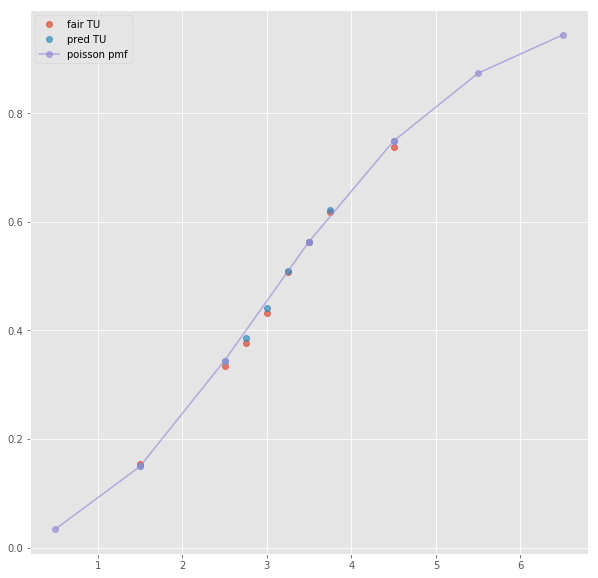

ML : 1.081 9.93 31.76
Error home:  0.017801167591534828
Error draw:  0.012152662697396718
Error away:  0.005648533582241998

(15, 124)
(1, 15)
3.5 2.17 1.69 -2.5 1.93 1.93
TO fair:  2.2840236686390534 TU fair:  1.7788018433179724
TO pred:  2.28403 TU fair:  1.7788
Error TO:  1.213653378184798e-06



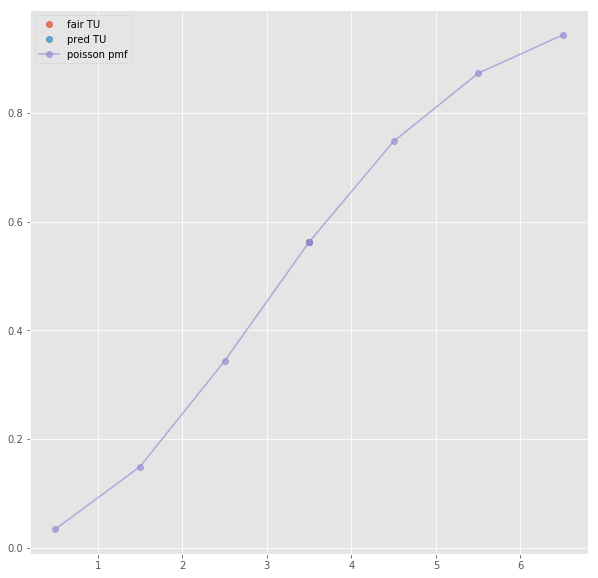

ML : 1.074 8.48 14.48
Error home:  0.05838371765459327
Error draw:  0.021491265642473445
Error away:  0.03689246988255429

(22, 124)
(1, 14)
3.5 2.13 1.76 -2.5 1.97 1.93
TO fair:  2.210227272727273 TU fair:  1.8262910798122067
TO pred:  2.21021 TU fair:  1.8263
Error TO:  3.535822399591826e-06

Error TO:  0.005011127699310891



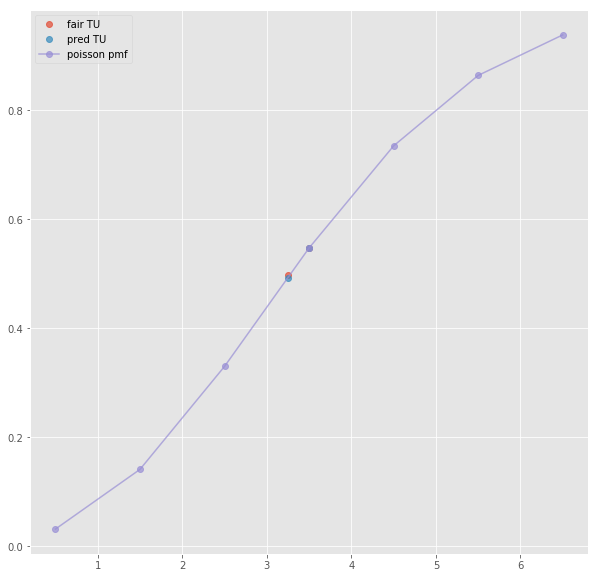

next "['HOME' 'DRAW' 'AWAY'] not in index"
(33, 124)
(1, 17)
next list index out of range
(6, 124)
(1, 42)
3.5 2.18 1.689 -2.5 1.917 1.934
TO fair:  2.290704558910598 TU fair:  1.7747706422018348
TO pred:  2.29075 TU fair:  1.77475
Error TO:  0.009934301726735484

Error TO:  0.008648561299448465

Error TO:  8.659682299128058e-06

Error TO:  0.010800575864698958

Error TO:  0.009670645028586722

Error TO:  0.0039893299518790615

Error TO:  0.0030777330820408455

Error TO:  0.00353298435400462



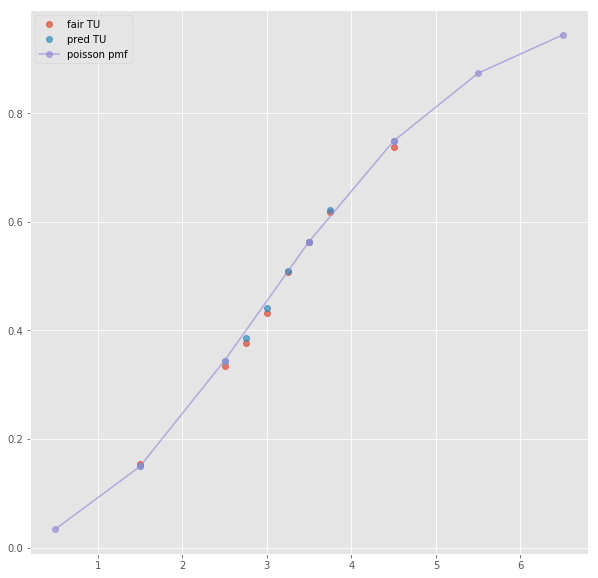

Error T1O:  0.01408815951636011
ML : 1.081 9.93 31.76
Error home:  0.017801167591534828
Error draw:  0.012152662697396718
Error away:  0.005648533582241998

(36, 124)
(1, 10)
next list index out of range
(21, 124)
(1, 35)
3.5 2.16 1.73 -2.5 1.97 1.88
TO fair:  2.248554913294798 TU fair:  1.8009259259259258
TO pred:  2.24858 TU fair:  1.80091
Error TO:  0.005929821598809726

Error TO:  0.003665834035986637

Error TO:  4.961714655138394e-06

Error TO:  0.001805444621938157

Error TO:  0.00339453469645723



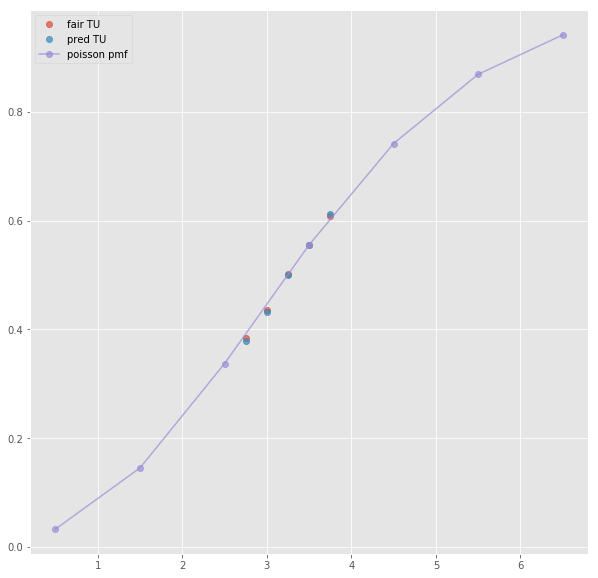

Error T1O:  0.00395279285002359
Error T1O:  0.006422556947444535
ML : 1.11 9.74 28.63
Error home:  0.014914669575537554
Error draw:  0.01025786565610362
Error away:  0.00465682696669565

(36, 124)
(1, 41)
2.5 2.36 1.628 -0.5 2.12 1.787
TO fair:  2.4496314496314495 TU fair:  1.6898305084745762
TO pred:  2.4496 TU fair:  1.68984
Error TO:  0.006254036518164807

Error TO:  0.0005740306977058962

Error TO:  0.017846094098976945

Error TO:  5.241066111438819e-06

Error TO:  7.949685213326507e-05

Error TO:  0.0006266964684326082

Error TO:  0.0009739004103505033



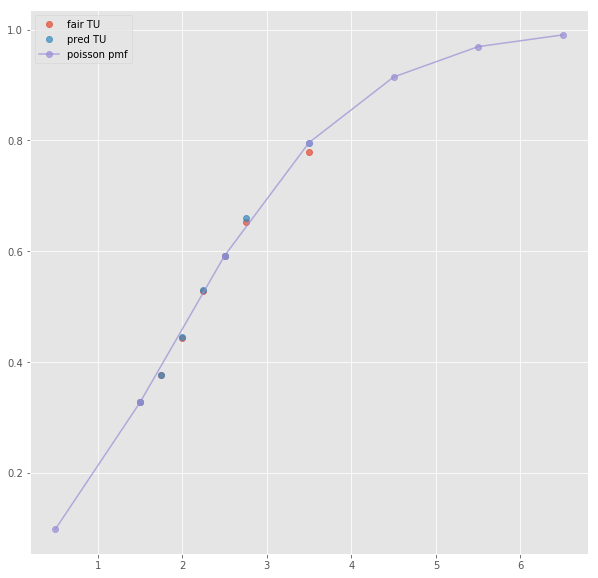

ML : 2.12 3.27 3.81
Error home:  0.0038252034066628693
Error draw:  0.01835905830182316
Error away:  0.01453402995771419

(22, 124)
(1, 19)
2.5 2.16 1.66 -0.5 2.06 1.76
TO fair:  2.3012048192771086 TU fair:  1.7685185185185184
TO pred:  2.30125 TU fair:  1.76849
Error TO:  8.53167098457952e-06

Error TO:  0.018056318887212264



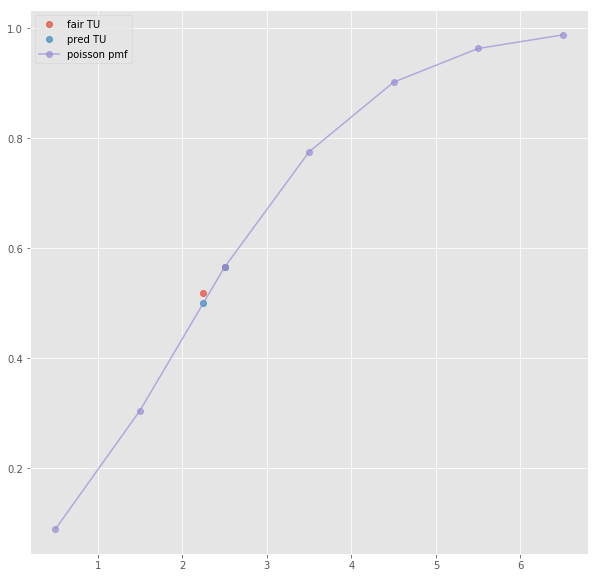

ML : 2.06 3.16 3.21
Error home:  0.02475060780543309
Error draw:  0.01540905522037972
Error away:  0.009341842570442294

(19, 124)
(1, 19)
2.5 2.19 1.72 -0.5 2.12 1.79
TO fair:  2.2732558139534884 TU fair:  1.7853881278538815
TO pred:  2.27322 TU fair:  1.78541
Error TO:  6.930466784349498e-06

Error TO:  0.028718713282820996



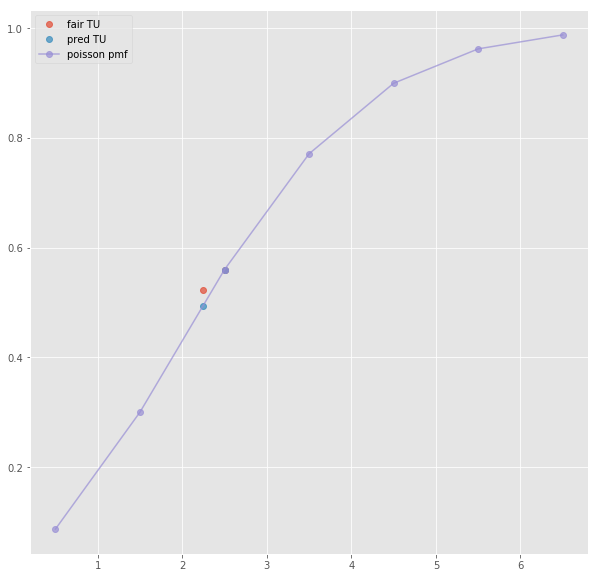

ML : 2.02 3.0 3.65
Error home:  0.008725001961386758
Error draw:  0.03446083728854593
Error away:  0.025735600303284145

(19, 124)
(1, 17)
2.5 2.25 1.68 -0.5 2.08 1.82
TO fair:  2.339285714285714 TU fair:  1.7466666666666664
TO pred:  2.33928 TU fair:  1.74667
Error TO:  1.0442307425972963e-06



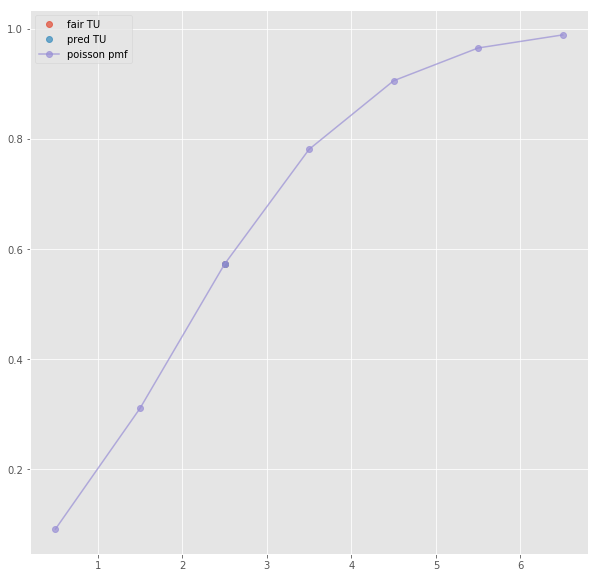

ML : 2.07 3.2 3.3
Error home:  0.026929984071844104
Error draw:  0.014759330282529293
Error away:  0.012170846663006496

(31, 124)
(1, 43)
2.5 2.36 1.628 -0.5 2.12 1.787
TO fair:  2.4496314496314495 TU fair:  1.6898305084745762
TO pred:  2.4496 TU fair:  1.68984
Error TO:  0.006254036518164807

Error TO:  0.0005740306977058962

Error TO:  0.017846094098976945

Error TO:  5.241066111438819e-06

Error TO:  7.949685213326507e-05

Error TO:  0.0006266964684326082

Error TO:  0.0009739004103505033



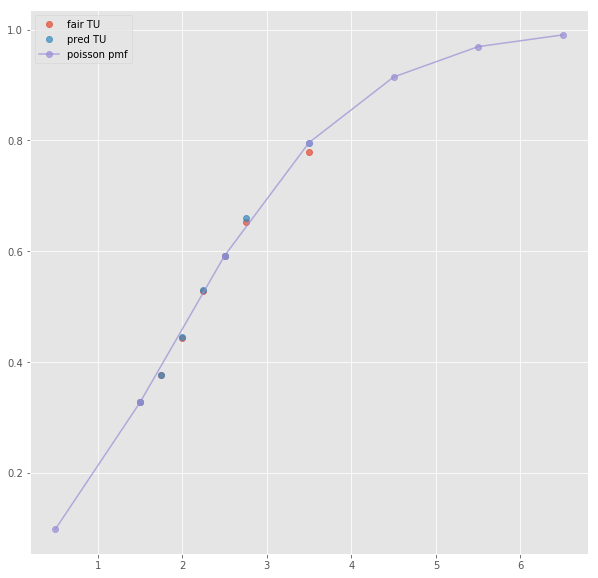

Error T1O:  0.007951634338084435
ML : 2.12 3.27 3.81
Error home:  0.0038252034066628693
Error draw:  0.01835905830182316
Error away:  0.01453402995771419

(63, 124)
(1, 64)
2.5 2.15 1.675 -0.5 2.025 1.775
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.011081319061399753

Error TO:  0.015336591097173724

Error TO:  0.02012281955881773

Error TO:  0.03623657642800844

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.003324458045389722

Error TO:  0.010097138835415354

Error TO:  0.014687662129951318

Error TO:  0.021645654202264566

Error TO:  0.03760433693485167

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.027687276980177478



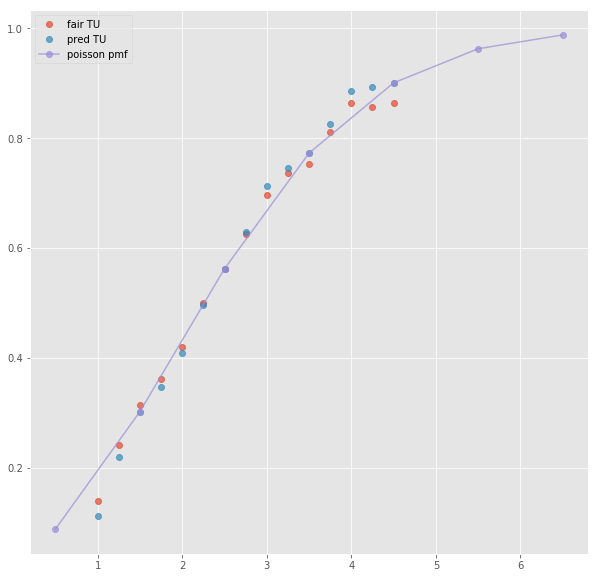

ML : 2.0 3.3 3.8
Error home:  0.0018365338291355116
Error draw:  0.017068726125695988
Error away:  0.018905108104922158

(12, 124)
(1, 35)
2.5 2.28 1.66 -0.5 2.09 1.78
TO fair:  2.373493975903614 TU fair:  1.7280701754385963
TO pred:  2.37355 TU fair:  1.72804
Error TO:  0.0035537202121310174

Error TO:  0.005105306141107935

Error TO:  9.944623417967868e-06

Error TO:  0.0019032694704568809

Error TO:  0.005169584484995493



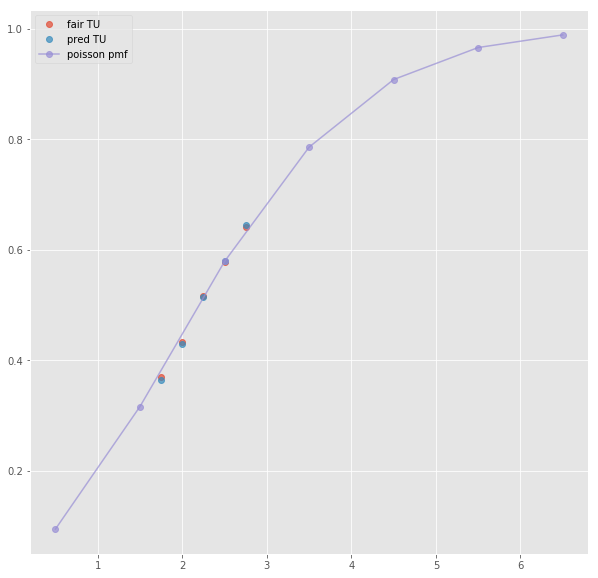

Error T1O:  0.0054593925054376435
ML : 2.12 3.34 3.73
Error home:  0.006053584264487988
Error draw:  0.016003403894084667
Error away:  0.009949578390259728

(40, 124)
(1, 43)
3.5 2.69 1.5 -0.5 1.709 2.24
TO fair:  2.793333333333333 TU fair:  1.557620817843866
TO pred:  2.79328 TU fair:  1.55764
Error TO:  0.0017653409701557932

Error TO:  0.0003996159838864921

Error TO:  6.8353615673144574e-06

Error TO:  0.003690384113532258

Error TO:  0.0008670009829742087

Error TO:  0.008516696291456238

Error TO:  0.001145417924765857

Error TO:  0.0003830178336112766



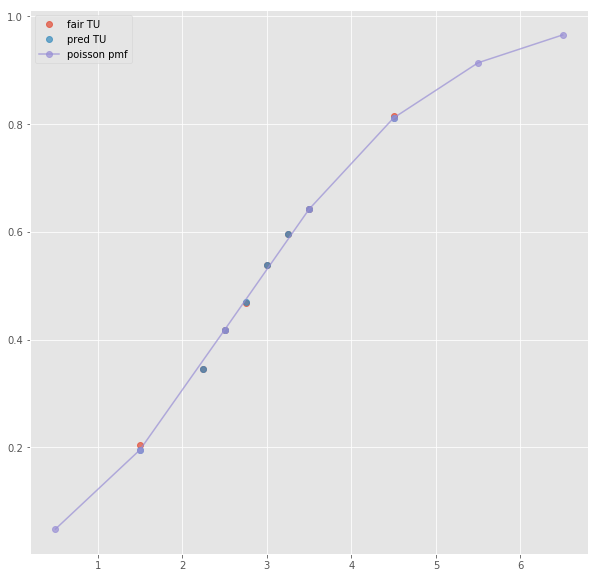

ML : 1.709 3.82 5.23
Error home:  0.003565043102680465
Error draw:  0.03194579966224553
Error away:  0.028380672818967057

(50, 124)
(1, 24)
2.5 1.71 2.12 -0.5 1.7 2.16
TO fair:  1.8066037735849054 TU fair:  2.2397660818713447
TO pred:  1.80663 TU fair:  2.23973
Error TO:  0.03672680459344896

Error TO:  0.02797868928486036

Error TO:  8.035387035310038e-06



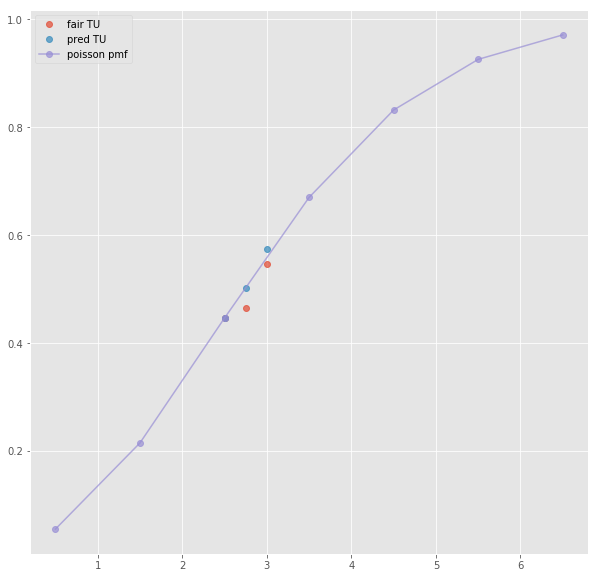

ML : 1.69 3.71 4.16
Error home:  0.022462906725849274
Error draw:  0.0178057240629384
Error away:  0.004657311140385284

(103, 124)
(1, 23)
2.5 1.73 2.2 -0.5 1.73 2.23
TO fair:  1.7863636363636364 TU fair:  2.2716763005780347
TO pred:  1.78636 TU fair:  2.27169
Error TO:  0.03531736043220224

Error TO:  0.024945050604456676

Error TO:  1.1395370528299864e-06



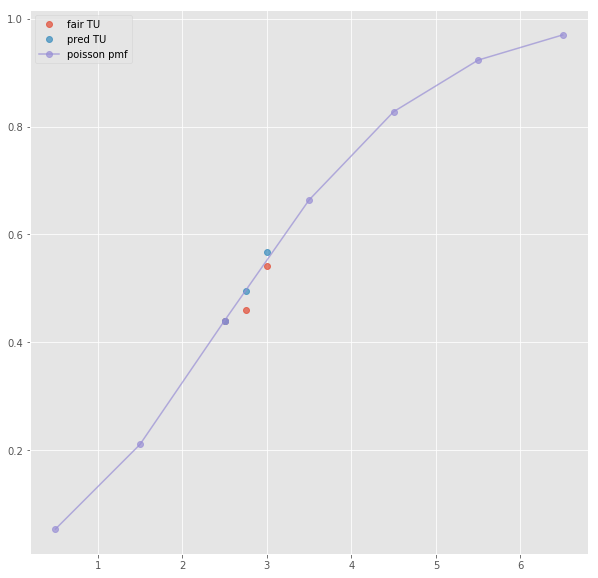

ML : 1.71 4.0 4.8
Error home:  0.0025129709929864186
Error draw:  0.014690233097175237
Error away:  0.012177038348835517

(192, 124)
(1, 22)
next list index out of range
(39, 124)
(1, 45)
3.5 2.69 1.5 -0.5 1.709 2.24
TO fair:  2.793333333333333 TU fair:  1.557620817843866
TO pred:  2.79328 TU fair:  1.55764
Error TO:  0.0017653409701557932

Error TO:  0.0003996159838864921

Error TO:  6.8353615673144574e-06

Error TO:  0.003690384113532258

Error TO:  0.0008670009829742087

Error TO:  0.008516696291456238

Error TO:  0.001145417924765857

Error TO:  0.0003830178336112766



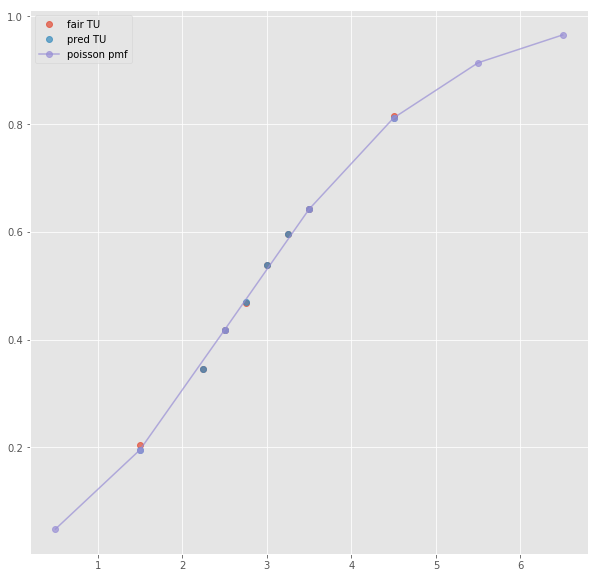

Error T1O:  0.008250753169658731
ML : 1.709 3.82 5.23
Error home:  0.003565043102680465
Error draw:  0.03194579966224553
Error away:  0.028380672818967057

(38, 124)
(1, 73)
3.5 2.6 1.475 -0.5 1.7 2.1
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.0008228731704371661

Error TO:  0.01637157145473156

Error TO:  0.005900296647325498

Error TO:  6.306488034957258e-06

Error TO:  0.017463675804683

Error TO:  0.014507784164484061

Error TO:  0.02117981750360798

Error TO:  0.02067264661700574

Error TO:  0.002652145085379476

Error TO:  0.02415882778140921

Error TO:  0.010233698810505898

Error TO:  0.012098567328329951

Error TO:  0.0007934326163293037

Error TO:  0.022084988430919328

Error TO:  0.013207676297442295



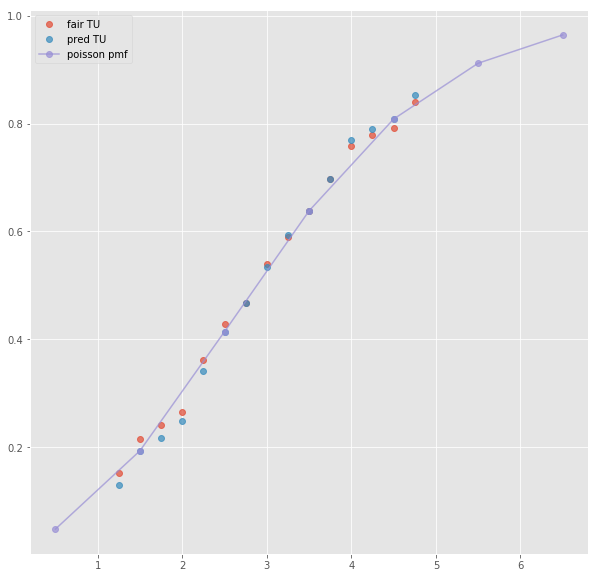

ML : 1.666 4.0 4.75
Error home:  0.01324069249424098
Error draw:  0.013006138329064054
Error away:  0.026246806616202184

(12, 124)
(1, 32)
2.5 1.73 2.16 -0.5 1.76 2.12
TO fair:  1.8009259259259258 TU fair:  2.248554913294798
TO pred:  1.8009 TU fair:  2.2486
Error TO:  0.002027637052500697

Error TO:  0.007654871874678393

Error TO:  7.993718079468692e-06

Error TO:  0.0033916144574180906

Error TO:  0.009956063268489745



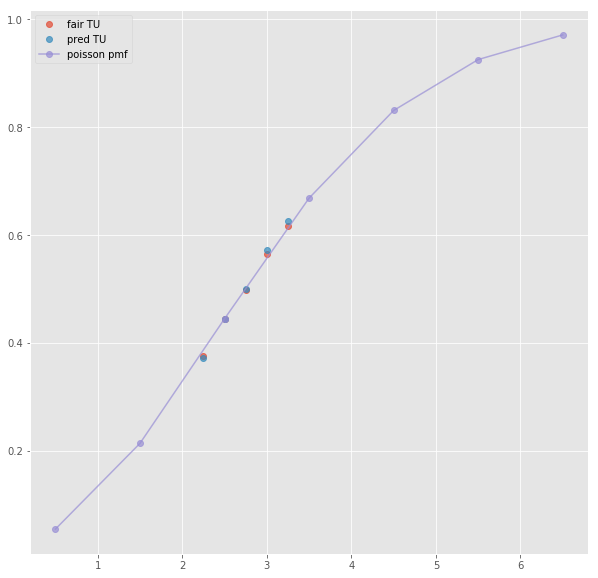

Error T1O:  0.00542582242856704
ML : 1.77 3.94 4.51
Error home:  0.0033997677628545553
Error draw:  0.014560901575034257
Error away:  0.011161217725110278

(227, 124)
next positional indexers are out-of-bounds
(237, 124)
next positional indexers are out-of-bounds
(313, 124)
next positional indexers are out-of-bounds
(579, 124)
next positional indexers are out-of-bounds
(171, 124)
(1, 47)
3.5 2.31 1.666 1.5 1.666 2.34
TO fair:  2.3865546218487395 TU fair:  1.721212121212121
TO pred:  2.38655 TU fair:  1.72121
Error TO:  0.006367626579466323

Error TO:  0.004750069053867434

Error TO:  8.114725097985165e-07

Error TO:  0.0041156767881549705

Error TO:  0.006700358090846903

Error TO:  0.004063358960311958

Error TO:  0.0016808296075181417

Error TO:  0.005841170811279092

Error TO:  0.0021338926516699663



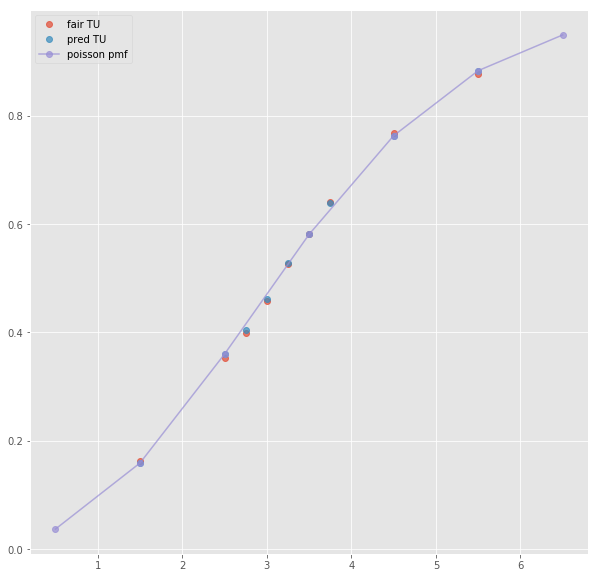

Error T1O:  0.012032366417939588
ML : 6.57 5.06 1.462
Error home:  0.017286040767067967
Error draw:  0.00016640452891403257
Error away:  0.01745246952582835

(172, 124)
(1, 75)
3.5 2.1 1.7 1.5 1.65 2.2
TO fair:  2.235294117647059 TU fair:  1.8095238095238095
TO pred:  2.23533 TU fair:  1.8095
Error TO:  0.010432082105202523

Error TO:  0.024573715979393285

Error TO:  0.009928700485622777

Error TO:  7.181325164029584e-06

Error TO:  0.012987158749274363

Error TO:  0.016802455837523156

Error TO:  0.016845433237244856

Error TO:  0.009140561191903762

Error TO:  0.041542206522451386

Error TO:  0.01385499116999589

Error TO:  0.008883534181978958

Error TO:  0.01583764832267709

Error TO:  0.0044319869079803564

Error TO:  0.04239612479340027

Error TO:  0.01700292983619997

Error TO:  0.013190620387617341

Error TO:  0.018878812852025306



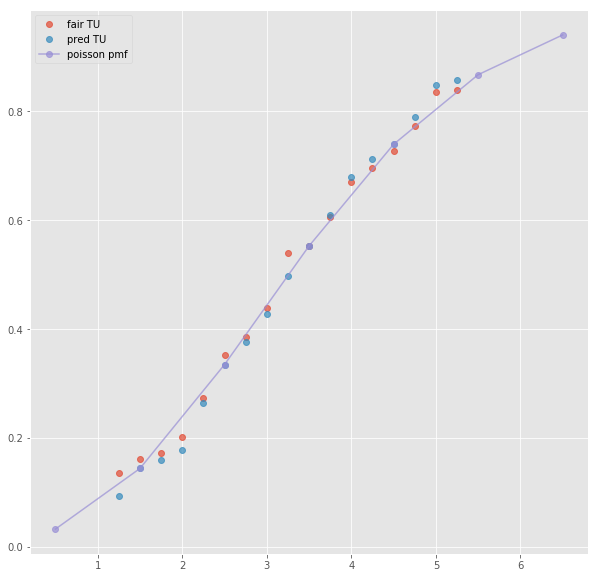

ML : 7.0 4.5 1.444
Error home:  0.027393623247744636
Error draw:  0.024760790099221414
Error away:  0.0026328970391341633

(63, 124)
next positional indexers are out-of-bounds
(67, 124)
(1, 41)
2.5 2.19 1.729 -0.5 2.14 1.775
TO fair:  2.266628108733372 TU fair:  1.7894977168949773
TO pred:  2.26669 TU fair:  1.78946
Error TO:  6.989270991453189e-05

Error TO:  0.0029752685231846376

Error TO:  0.001853477841065293

Error TO:  1.204639146068498e-05

Error TO:  0.0027276893151226833

Error TO:  0.0009511096536516384

Error TO:  0.0029515486987146122



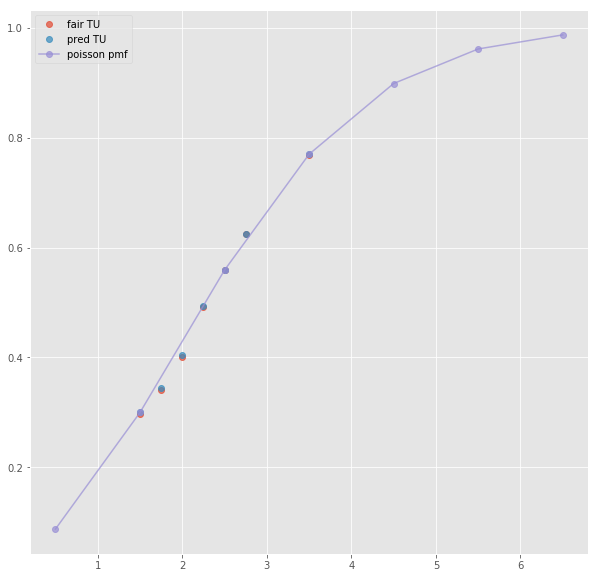

ML : 2.14 3.09 4.01
Error home:  0.004212296144986916
Error draw:  0.04291776322334745
Error away:  0.03870545912530449

(104, 124)
(1, 25)
2.5 2.16 1.68 -0.5 2.08 1.76
TO fair:  2.2857142857142856 TU fair:  1.7777777777777777
TO pred:  2.28574 TU fair:  1.77776
Error TO:  0.015906167358835877

Error TO:  4.921819629521984e-06

Error TO:  0.004976949828411237



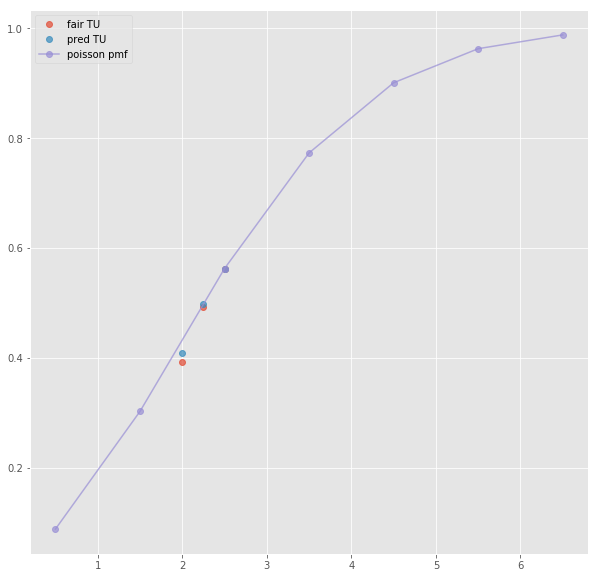

ML : 2.1 3.06 3.41
Error home:  0.023936293239067596
Error draw:  0.02967987309412351
Error away:  0.005743919173452461

(167, 124)
(1, 23)
2.5 2.2 1.73 -0.5 2.11 1.82
TO fair:  2.2716763005780347 TU fair:  1.7863636363636364
TO pred:  2.27165 TU fair:  1.78638
Error TO:  0.003037485988639288

Error TO:  5.096563353679251e-06

Error TO:  0.0018344739778947128



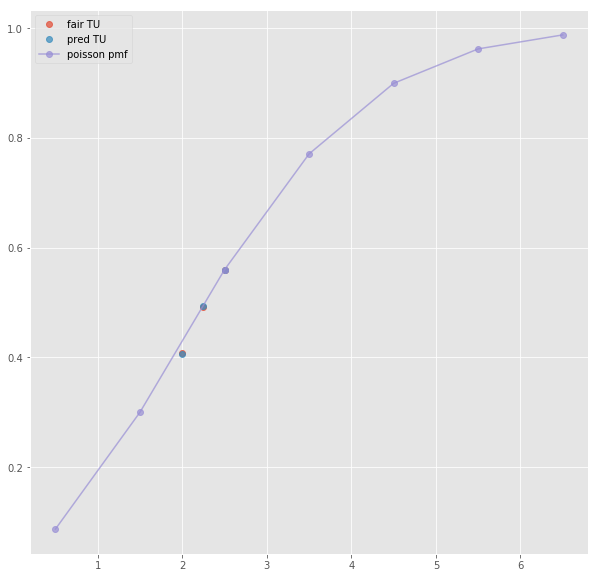

ML : 2.1 3.05 4.0
Error home:  0.011325552990884669
Error draw:  0.04389455704810624
Error away:  0.03256924295949307

(318, 124)
(1, 25)
2.5 2.19 1.74 -0.5 2.12 1.81
TO fair:  2.258620689655172 TU fair:  1.7945205479452053
TO pred:  2.25865 TU fair:  1.7945
Error TO:  0.002564327799887689

Error TO:  5.745511361510136e-06

Error TO:  0.001622347033196303



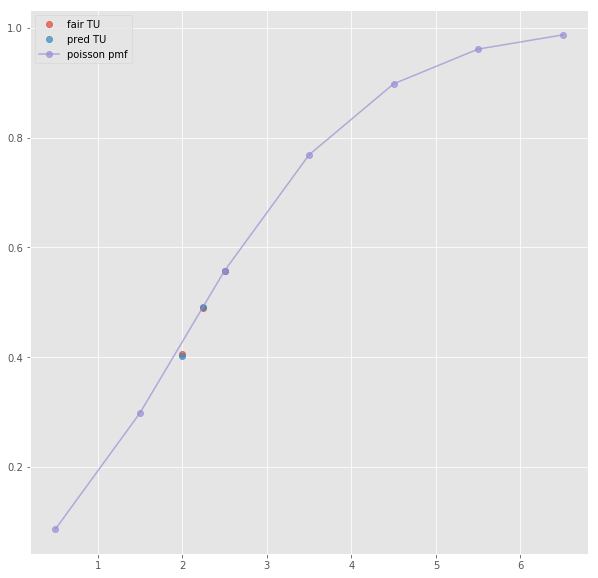

ML : 2.11 3.05 3.6
Error home:  0.021576736455099554
Error draw:  0.03680160726795906
Error away:  0.015224705239519187

(63, 124)
(1, 43)
2.5 2.19 1.729 -0.5 2.14 1.775
TO fair:  2.266628108733372 TU fair:  1.7894977168949773
TO pred:  2.26669 TU fair:  1.78946
Error TO:  6.989270991453189e-05

Error TO:  0.0029752685231846376

Error TO:  0.001853477841065293

Error TO:  1.204639146068498e-05

Error TO:  0.0027276893151226833

Error TO:  0.0009511096536516384

Error TO:  0.0029515486987146122



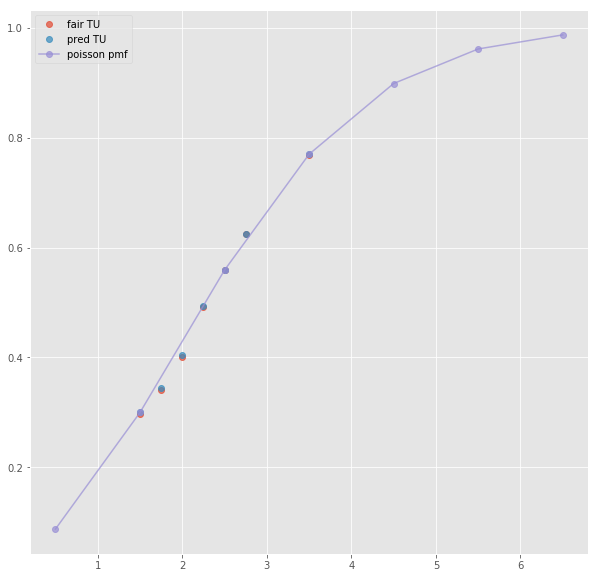

Error T1O:  0.01903412131284743
ML : 2.14 3.09 4.01
Error home:  0.004212296144986916
Error draw:  0.04291776322334745
Error away:  0.03870545912530449

(43, 124)
(1, 64)
2.5 2.15 1.675 -0.5 2.075 1.725
TO fair:  2.2835820895522385 TU fair:  1.7790697674418603
TO pred:  2.28362 TU fair:  1.77905
Error TO:  0.003218235895529331

Error TO:  0.0019828906081326148

Error TO:  0.015336591097173724

Error TO:  0.02012281955881773

Error TO:  7.269732788139915e-06

Error TO:  0.012146770149491837

Error TO:  0.003324458045389722

Error TO:  0.01953264469851873

Error TO:  0.004239623461053776

Error TO:  0.021645654202264566

Error TO:  0.014980059468408385

Error TO:  0.0227393531295651

Error TO:  0.027687276980177478

Error TO:  0.037133735416098546



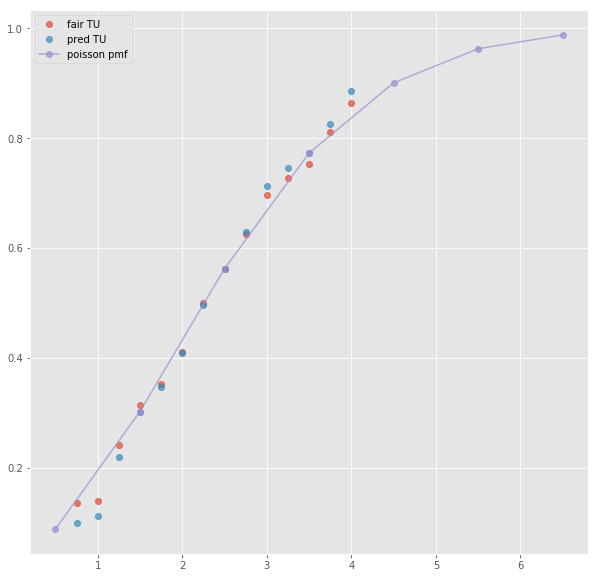

ML : 2.05 3.2 3.8
Error home:  0.004733337152820316
Error draw:  0.024972012254643072
Error away:  0.029704998791604403

(29, 124)
(1, 35)
2.5 2.18 1.72 -0.5 2.1 1.77
TO fair:  2.2674418604651168 TU fair:  1.7889908256880735
TO pred:  2.26747 TU fair:  1.78897
Error TO:  0.005772557812524504

Error TO:  0.00099792141494226

Error TO:  5.473173365022621e-06

Error TO:  0.0002538343498224016

Error TO:  0.0008468290116588895



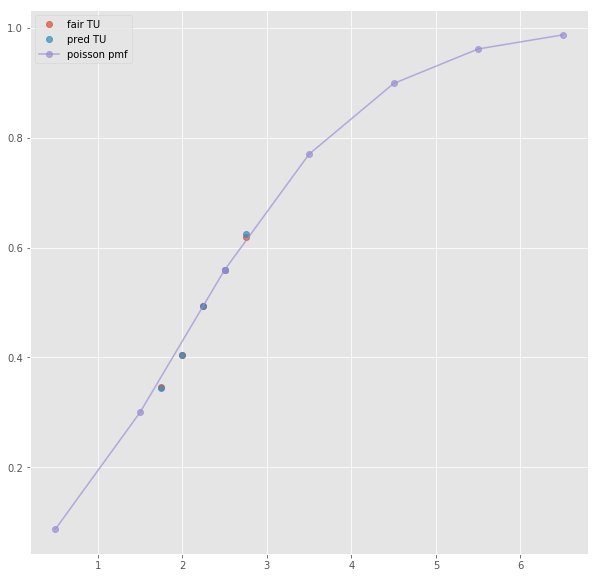

Error T1O:  0.012877907429059976
ML : 2.12 3.23 3.85
Error home:  0.004276656627670794
Error draw:  0.029679025578088047
Error away:  0.025402532040148168

(15, 124)
(1, 45)
3.5 2.75 1.483 -0.5 2.06 1.847
TO fair:  2.8543492919757254 TU fair:  1.5392727272727276
TO pred:  2.85437 TU fair:  1.53927
Error TO:  0.0007407048297704

Error TO:  0.0006320930543894376

Error TO:  2.5416823889456985e-06

Error TO:  0.002666457072947187

Error TO:  0.0003076037631948303

Error TO:  0.0026018763204307405

Error TO:  0.0002477424134962325

Error TO:  0.000156241106662236



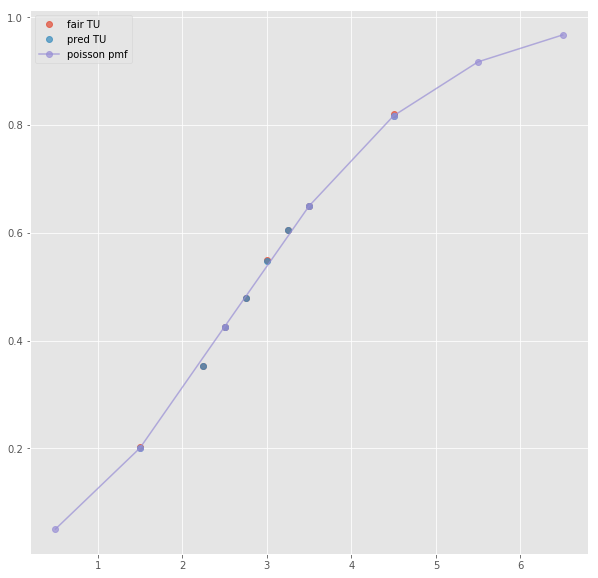

ML : 2.06 3.69 3.55
Error home:  0.005139030410828527
Error draw:  0.02328095525166643
Error away:  0.018142004509866638

(40, 124)
(1, 25)
2.5 1.62 2.25 -0.5 2.01 1.83
TO fair:  1.7199999999999998 TU fair:  2.3888888888888884
TO pred:  1.72002 TU fair:  2.38885
Error TO:  0.015494127676626612

Error TO:  0.02303449633644805

Error TO:  6.760332424526894e-06



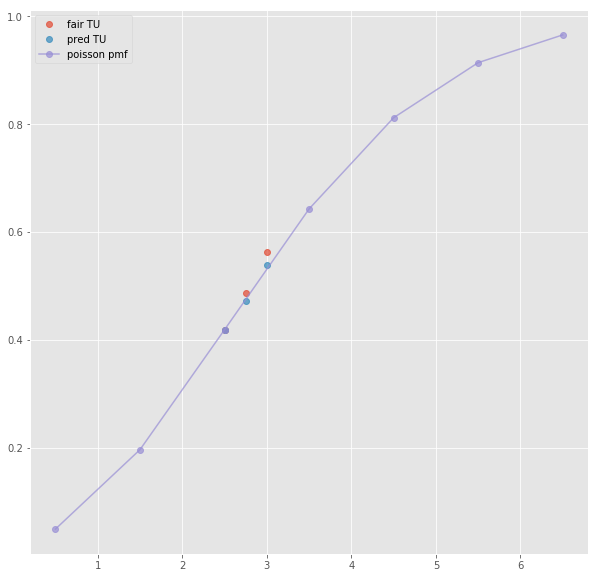

ML : 2.0 3.51 3.56
Error home:  0.0074288395750155
Error draw:  0.03133491162269425
Error away:  0.023905837399235963

(67, 124)
(1, 19)
next list index out of range
(91, 124)
(1, 19)
next list index out of range
(13, 124)
(1, 47)
3.5 2.75 1.483 -0.5 2.06 1.847
TO fair:  2.8543492919757254 TU fair:  1.5392727272727276
TO pred:  2.85437 TU fair:  1.53927
Error TO:  0.0007407048297704

Error TO:  0.0006320930543894376

Error TO:  2.5416823889456985e-06

Error TO:  0.002666457072947187

Error TO:  0.0003076037631948303

Error TO:  0.0026018763204307405

Error TO:  0.0002477424134962325

Error TO:  0.000156241106662236



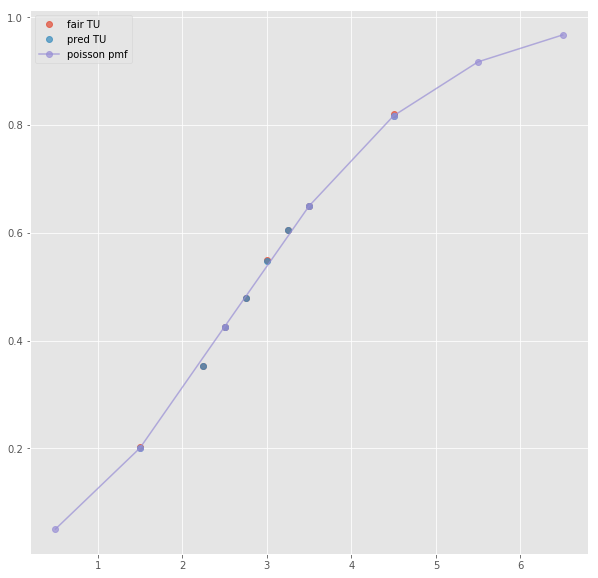

Error T1O:  0.006614954659156513
ML : 2.06 3.69 3.55
Error home:  0.005139030410828527
Error draw:  0.02328095525166643
Error away:  0.018142004509866638

(16, 124)
(1, 37)
3.5 2.58 1.53 -0.5 2.02 1.83
TO fair:  2.6862745098039214 TU fair:  1.5930232558139534
TO pred:  2.68622 TU fair:  1.59304
Error TO:  0.023065396100427127

Error TO:  0.02082121806649695

Error TO:  7.554098622908345e-06

Error TO:  0.023517274248385567

Error TO:  0.024352823966439785

Error TO:  0.014167700613661516



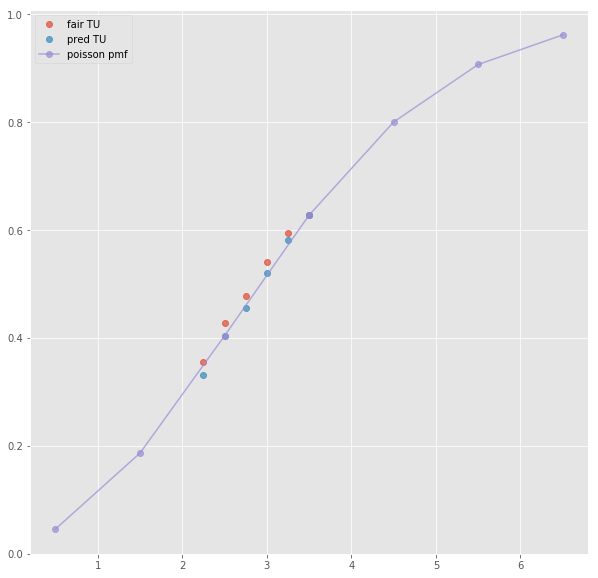

Error T1O:  0.007341293102309687
ML : 2.04 3.73 3.54
Error home:  0.004338261081822503
Error draw:  0.02422170050679512
Error away:  0.01988357695789844

(59, 124)
(1, 41)
2.5 2.43 1.598 -0.5 2.17 1.751
TO fair:  2.520650813516896 TU fair:  1.6576131687242799
TO pred:  2.52065 TU fair:  1.65761
Error TO:  0.005309155598098858

Error TO:  0.006946182715631022

Error TO:  1.28038725843993e-07

Error TO:  0.006614776316734572

Error TO:  0.0018927172466295383

Error TO:  0.006358859393680305

Error TO:  0.021127109907695285



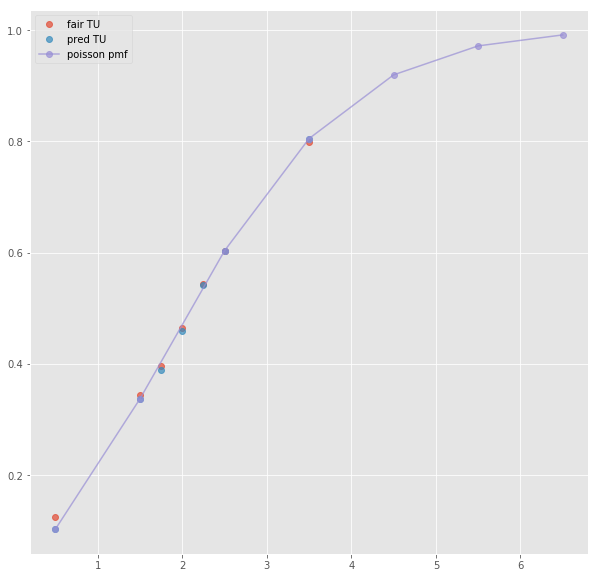

ML : 2.17 3.2 3.75
Error home:  0.0034512350287216886
Error draw:  0.02043651142382169
Error away:  0.016985394086039607

(64, 124)
(1, 25)
next list index out of range
(110, 124)
(1, 19)
next list index out of range
(233, 124)
(1, 25)
next list index out of range
(47, 124)
(1, 43)
2.5 2.43 1.598 -0.5 2.17 1.751
TO fair:  2.520650813516896 TU fair:  1.6576131687242799
TO pred:  2.52065 TU fair:  1.65761
Error TO:  0.005309155598098858

Error TO:  0.006946182715631022

Error TO:  1.28038725843993e-07

Error TO:  0.006614776316734572

Error TO:  0.0018927172466295383

Error TO:  0.006358859393680305

Error TO:  0.021127109907695285



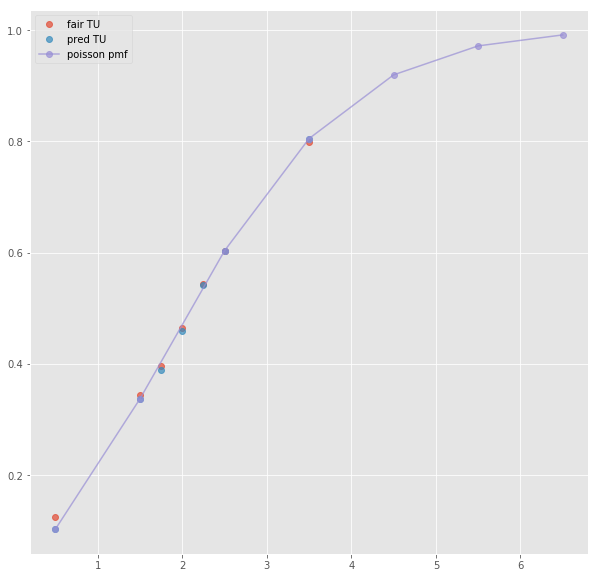

Error T1O:  0.013823068681713901
ML : 2.17 3.2 3.75
Error home:  0.0034512350287216886
Error draw:  0.02043651142382169
Error away:  0.016985394086039607

(188, 124)
(1, 59)
2.5 2.375 1.55 -0.5 2.09 1.81
TO fair:  2.5322580645161286 TU fair:  1.6526315789473682
TO pred:  2.53226 TU fair:  1.65263
Error TO:  0.0021684298345053254

Error TO:  0.011926311823479252

Error TO:  0.004977619503632819

Error TO:  0.015378316451859775

Error TO:  3.0183757210311413e-07

Error TO:  0.02317267457289318

Error TO:  0.008195840842151303

Error TO:  0.0061854792485819265

Error TO:  0.019425625280959813

Error TO:  0.012842329407299041

Error TO:  0.022955544154362517

Error TO:  0.0251261023585736

Error TO:  0.026417843983502443



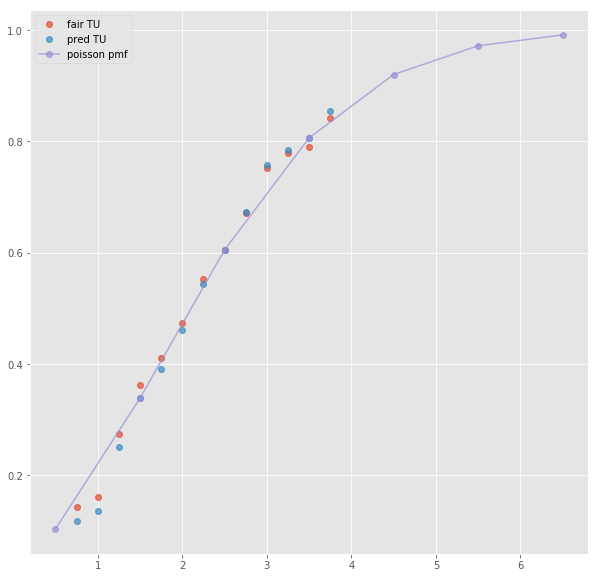

ML : 2.0 3.3 3.8
Error home:  0.0048586279132580845
Error draw:  0.006067435747631966
Error away:  0.010925996008341515

(35, 124)
(1, 35)
2.5 2.47 1.58 -0.5 2.19 1.71
TO fair:  2.5632911392405062 TU fair:  1.6396761133603237
TO pred:  2.56336 TU fair:  1.63965
Error TO:  0.00360994865412112

Error TO:  1.048007206588819e-05

Error TO:  0.006022080237796712

Error TO:  0.0028779497439916923

Error TO:  0.004149297374367311



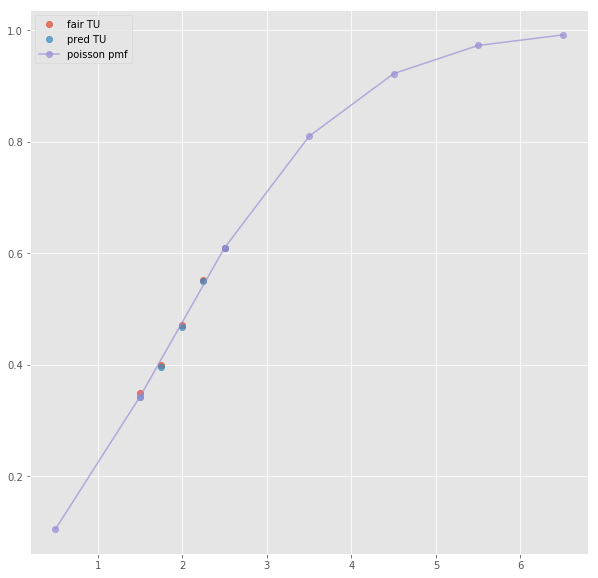

Error T1O:  0.007819367196003735
ML : 2.22 3.16 3.68
Error home:  0.00478881273331061
Error draw:  0.021928552918244693
Error away:  0.017139751804666425

(120, 124)
(1, 42)
2.5 2.15 1.751 -0.5 1.51 2.69
TO fair:  2.2278697886921757 TU fair:  1.8144186046511628
TO pred:  2.22791 TU fair:  1.81439
Error TO:  0.0035222432486843314

Error TO:  0.009672432465366532

Error TO:  0.02022160865334477

Error TO:  0.009739167994331444

Error TO:  8.101412601657643e-06

Error TO:  0.010500881395868245

Error TO:  0.0028596205603306224

Error TO:  0.010592488636828157



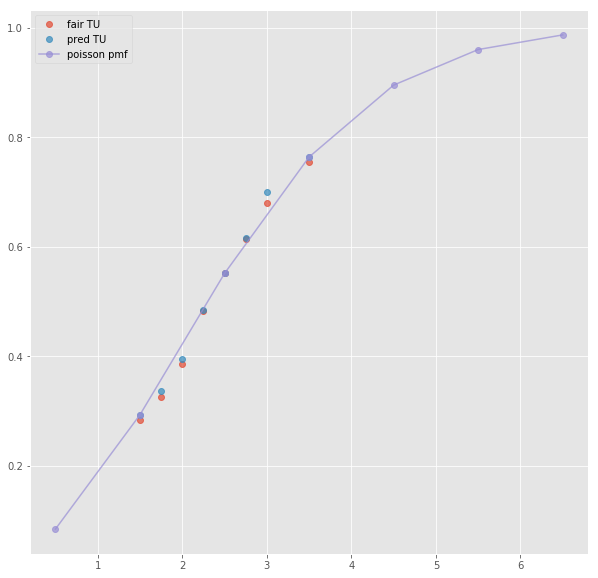

ML : 1.51 4.24 7.03
Error home:  0.003920499045267145
Error draw:  0.0033880530105186712
Error away:  0.0005326391361393512

(91, 124)
(1, 24)
2.5 2.09 1.71 -0.5 1.56 2.35
TO fair:  2.2222222222222223 TU fair:  1.8181818181818181
TO pred:  2.22217 TU fair:  1.81821
Error TO:  0.01924603108990741

Error TO:  1.0575248518329694e-05

Error TO:  0.004475677110040266



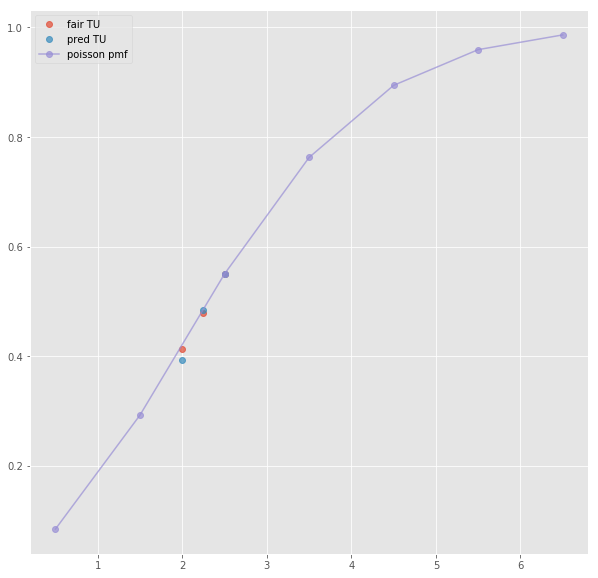

ML : 1.45 4.16 7.16
Error home:  0.04369982210168433
Error draw:  0.010765270466387838
Error away:  0.032934707640684874

(142, 124)
(1, 26)
2.5 2.14 1.75 -0.5 1.6 2.42
TO fair:  2.222857142857143 TU fair:  1.8177570093457944
TO pred:  2.2228 TU fair:  1.8178
Error TO:  0.017588355028464675

Error TO:  0.01164992176545665

Error TO:  1.1565116463052583e-05

Error TO:  0.0035542979835219146



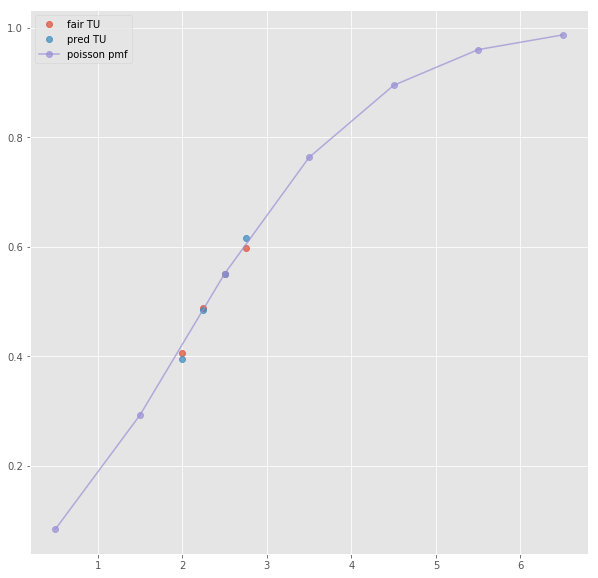

ML : 1.52 4.1 6.8
Error home:  0.025260848452357876
Error draw:  0.0026829838483288793
Error away:  0.022578128634944433

(155, 124)
(1, 26)
2.5 2.14 1.75 -0.5 1.55 2.53
TO fair:  2.222857142857143 TU fair:  1.8177570093457944
TO pred:  2.2228 TU fair:  1.8178
Error TO:  0.010578304777208392

Error TO:  0.004604600654114055

Error TO:  1.1565116463052583e-05

Error TO:  0.004177660779364767



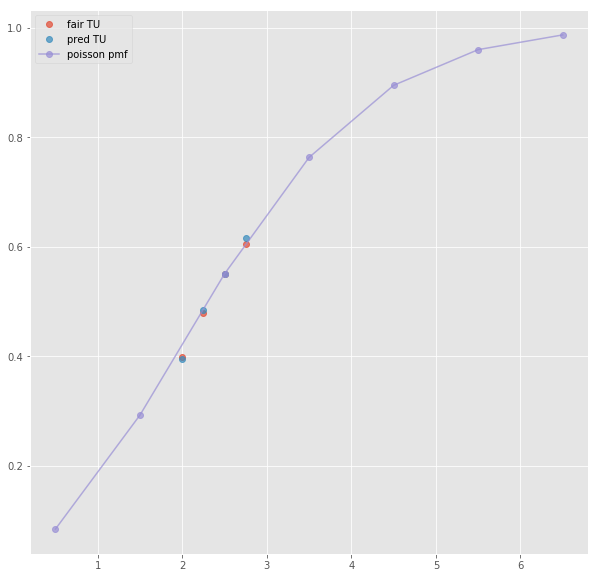

ML : 1.51 3.95 6.2
Error home:  0.005033404640964689
Error draw:  0.005391472028915878
Error away:  0.000357884239143319

(113, 124)
(1, 44)
2.5 2.15 1.751 -0.5 1.51 2.69
TO fair:  2.2278697886921757 TU fair:  1.8144186046511628
TO pred:  2.22791 TU fair:  1.81439
Error TO:  0.0035222432486843314

Error TO:  0.009672432465366532

Error TO:  0.02022160865334477

Error TO:  0.009739167994331444

Error TO:  8.101412601657643e-06

Error TO:  0.010500881395868245

Error TO:  0.0028596205603306224

Error TO:  0.010592488636828157



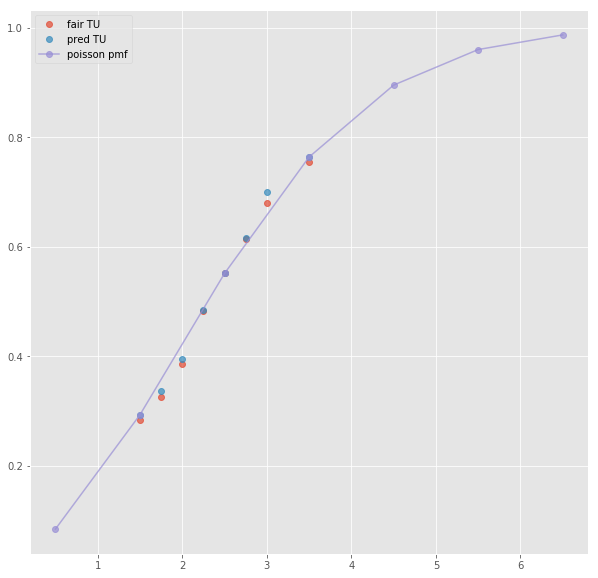

Error T1O:  0.008245229026986212
ML : 1.51 4.24 7.03
Error home:  0.003920499045267145
Error draw:  0.0033880530105186712
Error away:  0.0005326391361393512

(35, 124)
(1, 66)
2.5 2.075 1.725 -0.5 1.55 2.375
TO fair:  2.2028985507246377 TU fair:  1.8313253012048192
TO pred:  2.20286 TU fair:  1.83135
Error TO:  0.006166961368480883

Error TO:  0.012214611881030346

Error TO:  0.008459417505759348

Error TO:  0.013464904016729812

Error TO:  0.02813863438686913

Error TO:  7.944217971178613e-06

Error TO:  0.014284737492228028

Error TO:  0.018596944482215605

Error TO:  0.004384148318001435

Error TO:  0.009614677377671854

Error TO:  0.015620880807063212

Error TO:  0.020474852208014843

Error TO:  0.015891622415522305

Error TO:  0.019857475386065415



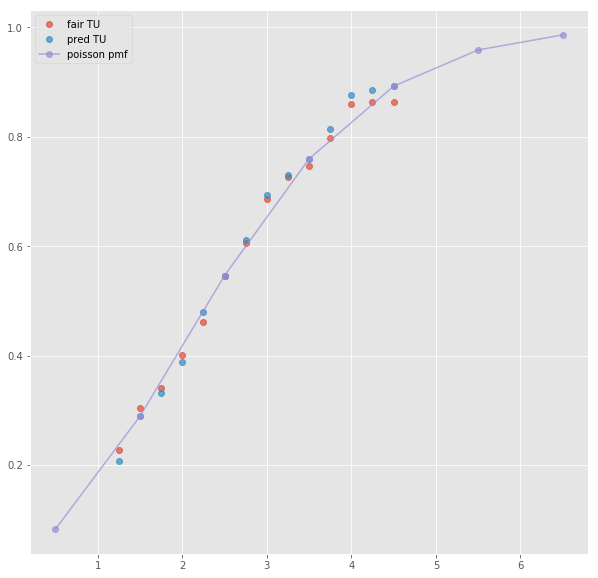

ML : 1.57 4.0 6.0
Error home:  0.0005804221003884447
Error draw:  0.0037667701177505897
Error away:  0.003186172551063904

(21, 124)
(1, 34)
2.5 2.16 1.73 -0.5 1.52 2.61
TO fair:  2.248554913294798 TU fair:  1.8009259259259258
TO pred:  2.24851 TU fair:  1.80096
Error TO:  0.003369828663964236

Error TO:  0.005977839900241921

Error TO:  8.883346331201025e-06

Error TO:  0.0017282404973707477

Error TO:  0.008456681582794001



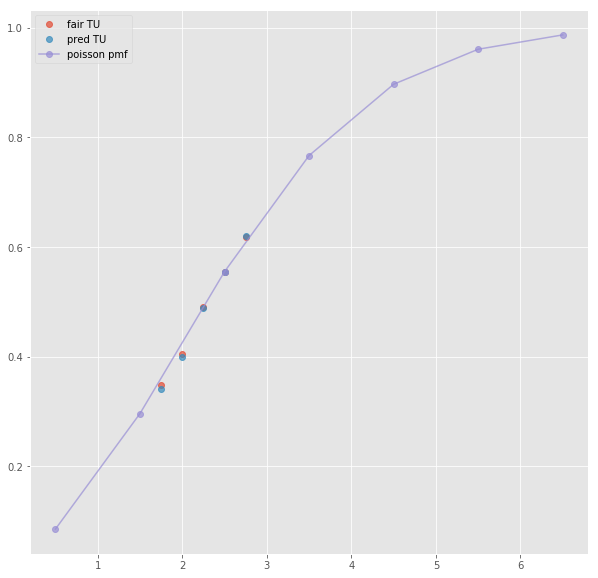

Error T1O:  0.00177687670662241
ML : 1.53 4.15 6.9
Error home:  0.0032042664843052737
Error draw:  0.004897785304829677
Error away:  0.0016934890349993015

(56, 124)
(1, 42)
3.5 2.33 1.578 1.5 2.32 1.595
TO fair:  2.476552598225602 TU fair:  1.6772532188841203
TO pred:  2.47654 TU fair:  1.67726
Error TO:  0.007068385575913716

Error TO:  0.0043727857936464165

Error TO:  2.054075857238491e-06

Error TO:  0.0027897272666846384

Error TO:  0.007895475575035671

Error TO:  0.004596078911676571

Error TO:  0.02511685049759682

Error TO:  0.002237504483608155



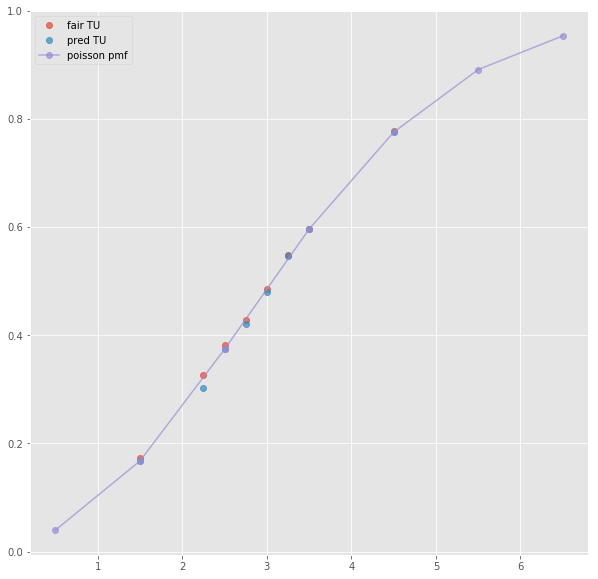

ML : 11.16 6.37 1.198
Error home:  0.019473513378418808
Error draw:  0.012652446494653136
Error away:  0.03212593489709281

(30, 124)
(1, 14)
next list index out of range
(137, 124)
(1, 18)
next list index out of range
(49, 124)
(1, 44)
3.5 2.34 1.574 1.5 2.31 1.602
TO fair:  2.4866581956797966 TU fair:  1.6726495726495727
TO pred:  2.48666 TU fair:  1.67265
Error TO:  0.005913539470821072

Error TO:  0.004438280289438601

Error TO:  2.917971933524832e-07

Error TO:  0.002017302852828806

Error TO:  0.00826031944607264

Error TO:  0.004565325888909677

Error TO:  0.023638670526758054

Error TO:  0.0011359063929871627



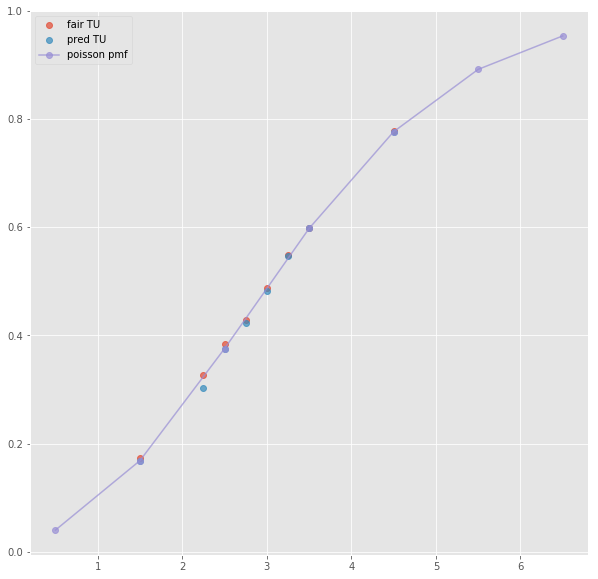

Error T1O:  0.020924874238297253
ML : 11.09 6.33 1.2
Error home:  0.019402694245261434
Error draw:  0.012727917355259744
Error away:  0.03213054328585452

(23, 124)
(1, 18)
next list index out of range
(58, 124)
(1, 32)
3.5 2.46 1.58 1.5 2.17 1.73
TO fair:  2.5569620253164556 TU fair:  1.6422764227642277
TO pred:  2.55696 TU fair:  1.64228
Error TO:  0.005546950421407293

Error TO:  0.004623159344091188

Error TO:  3.097737969470771e-07

Error TO:  0.006136656870993962

Error TO:  0.001702554712396831



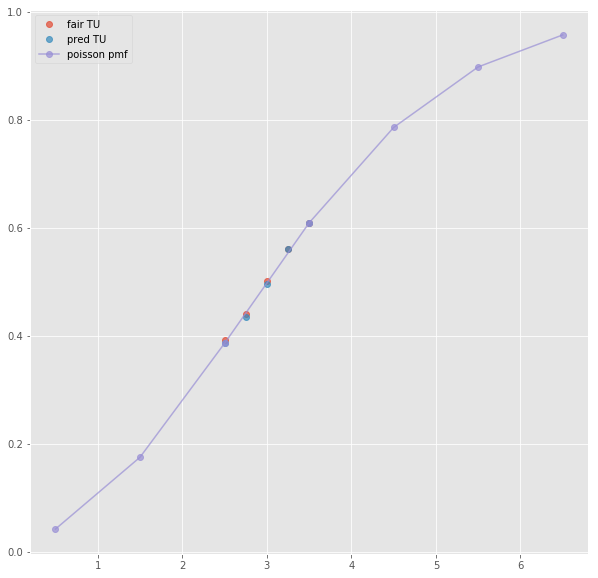

Error T1O:  0.005501333306881129
ML : 11.73 6.51 1.25
Error home:  0.005162666657756887
Error draw:  0.0015951106335546084
Error away:  0.006757860175198638

(33, 124)
(1, 41)
2.5 2.57 1.54 0.5 1.909 1.99
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66885 TU fair:  1.59921
Error TO:  0.005320065485107328

Error TO:  0.012048081563454882

Error TO:  2.6438207732515373e-06

Error TO:  0.006353020659496278

Error TO:  0.002158689879904807

Error TO:  0.006499388649444882

Error TO:  0.01379371494025361



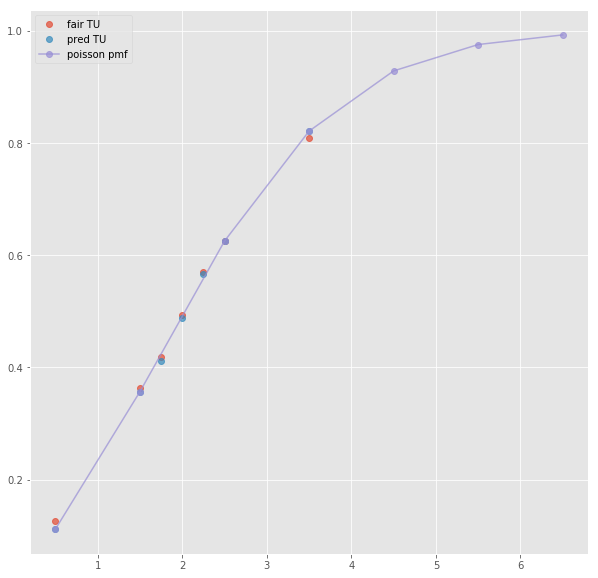

ML : 4.49 3.24 1.99
Error home:  0.01575703223215205
Error draw:  0.019303598092564378
Error away:  0.003546828796864687

(53, 124)
(1, 19)
next list index out of range
(70, 124)
(1, 19)
next list index out of range
(196, 124)
(1, 19)
next list index out of range
(32, 124)
(1, 43)
2.5 2.57 1.54 0.5 1.909 1.99
TO fair:  2.6688311688311686 TU fair:  1.5992217898832684
TO pred:  2.66885 TU fair:  1.59921
Error TO:  0.005320065485107328

Error TO:  0.012048081563454882

Error TO:  2.6438207732515373e-06

Error TO:  0.006353020659496278

Error TO:  0.002158689879904807

Error TO:  0.006499388649444882

Error TO:  0.01379371494025361



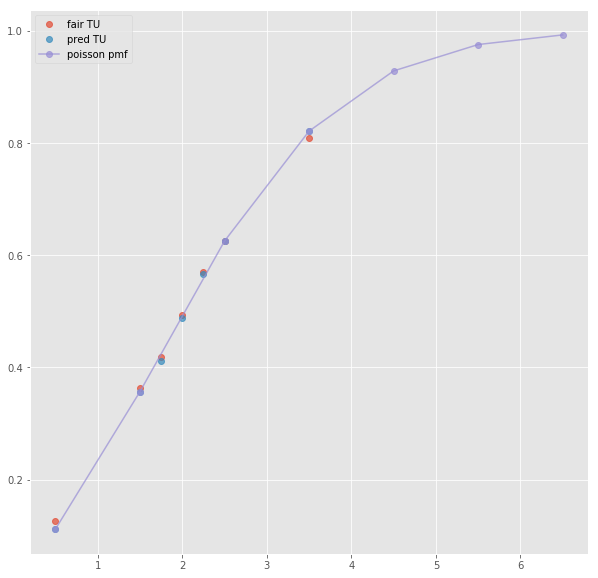

Error T1O:  0.0014314654614939748
ML : 4.49 3.24 1.99
Error home:  0.01575703223215205
Error draw:  0.019303598092564378
Error away:  0.003546828796864687

(33, 124)
(1, 59)
2.5 2.425 1.525 0.5 1.825 2.025
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.5902 TU fair:  1.62885
Error TO:  0.0039748010417121615

Error TO:  0.01391669009221208

Error TO:  0.007635754433999192

Error TO:  0.015263717496636908

Error TO:  5.3756662160009405e-06

Error TO:  0.015318824723041358

Error TO:  0.007716358439895876

Error TO:  0.0064779613940693925

Error TO:  0.019238461286897546

Error TO:  0.012615006288302005

Error TO:  0.028689642334305154

Error TO:  0.03195030148301381

Error TO:  0.03608916908940485



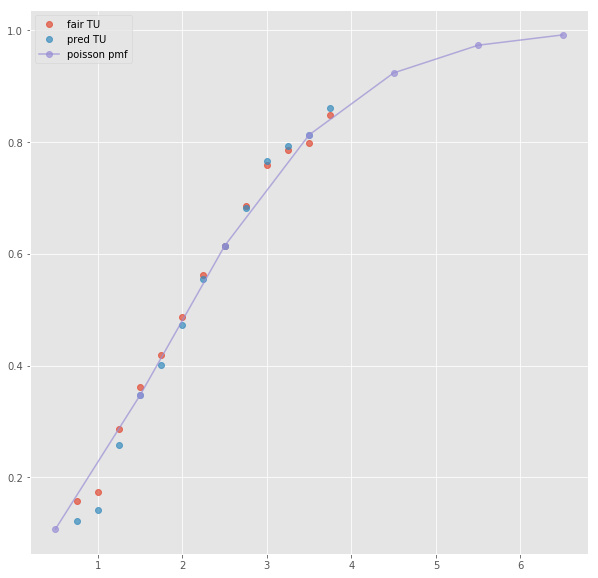

ML : 4.0 3.1 2.0
Error home:  0.0139736171338056
Error draw:  0.02183363621477835
Error away:  0.007860345025885562

(17, 124)
next positional indexers are out-of-bounds
(14, 124)
(1, 37)
2.5 2.48 1.578 -0.5 2.95 1.4380000000000002
TO fair:  2.5716096324461346 TU fair:  1.6362903225806453
TO pred:  2.5716 TU fair:  1.63629
Error TO:  0.0035573774040484896

Error TO:  0.0027643568647848504

Error TO:  1.4565591580084636e-06

Error TO:  0.004131821397883484

Error TO:  0.00208904265655685

Error TO:  0.0039051140470657275



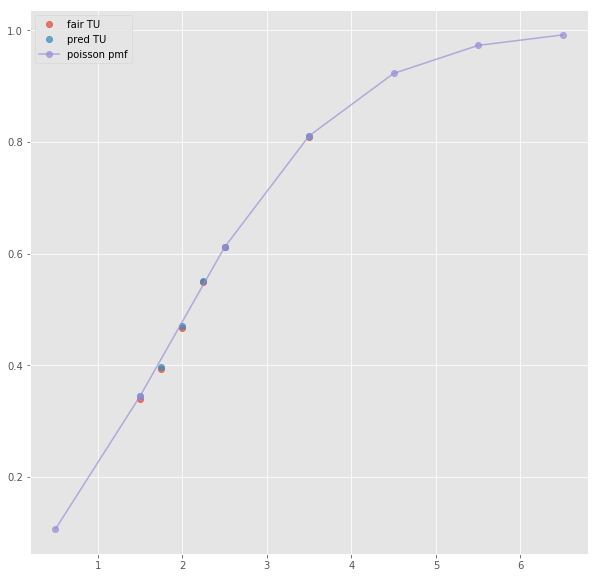

ML : 2.95 3.09 2.69
Error home:  5.710338264963699e-06
Error draw:  0.025548368031054647
Error away:  0.02555436730706584

(47, 124)
(1, 19)
next list index out of range
(91, 124)
(1, 19)
next list index out of range
(174, 124)
(1, 19)
next list index out of range
(8, 124)
(1, 39)
2.5 2.48 1.578 -0.5 2.95 1.4380000000000002
TO fair:  2.5716096324461346 TU fair:  1.6362903225806453
TO pred:  2.5716 TU fair:  1.63629
Error TO:  0.0035573774040484896

Error TO:  0.0027643568647848504

Error TO:  1.4565591580084636e-06

Error TO:  0.004131821397883484

Error TO:  0.00208904265655685

Error TO:  0.0039051140470657275



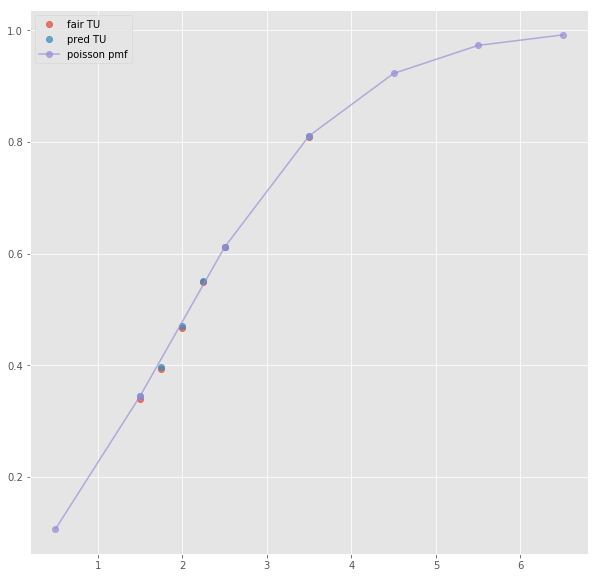

Error T1O:  0.014441878195233793
ML : 2.95 3.09 2.69
Error home:  5.710338264963699e-06
Error draw:  0.025548368031054647
Error away:  0.02555436730706584

(14, 124)
next positional indexers are out-of-bounds
(21, 124)
(1, 41)
2.5 2.32 1.649 -0.5 2.88 1.4580000000000002
TO fair:  2.406913280776228 TU fair:  1.7107758620689655
TO pred:  2.40687 TU fair:  1.7108
Error TO:  0.0014922274740096775

Error TO:  0.0015584261422900703

Error TO:  0.0061554285979402434

Error TO:  7.4710555245660615e-06

Error TO:  0.001467155010457799

Error TO:  0.0011029158891390778

Error TO:  0.002045863427054595



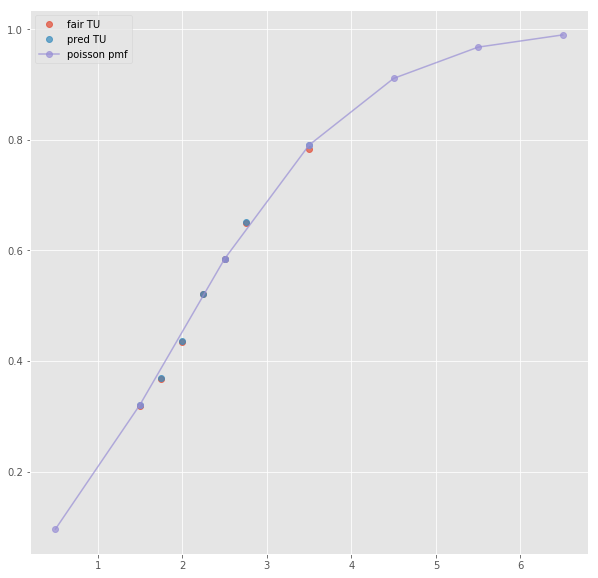

ML : 2.88 3.14 2.71
Error home:  0.0005061783491252525
Error draw:  0.02766642418648979
Error away:  0.02716061269795933

(9, 124)
(1, 15)
next list index out of range
(30, 124)
(1, 17)
next list index out of range
(22, 124)
(1, 15)
next list index out of range
(19, 124)
(1, 43)
2.5 2.32 1.649 -0.5 2.88 1.4580000000000002
TO fair:  2.406913280776228 TU fair:  1.7107758620689655
TO pred:  2.40687 TU fair:  1.7108
Error TO:  0.0014922274740096775

Error TO:  0.0015584261422900703

Error TO:  0.0061554285979402434

Error TO:  7.4710555245660615e-06

Error TO:  0.001467155010457799

Error TO:  0.0011029158891390778

Error TO:  0.002045863427054595



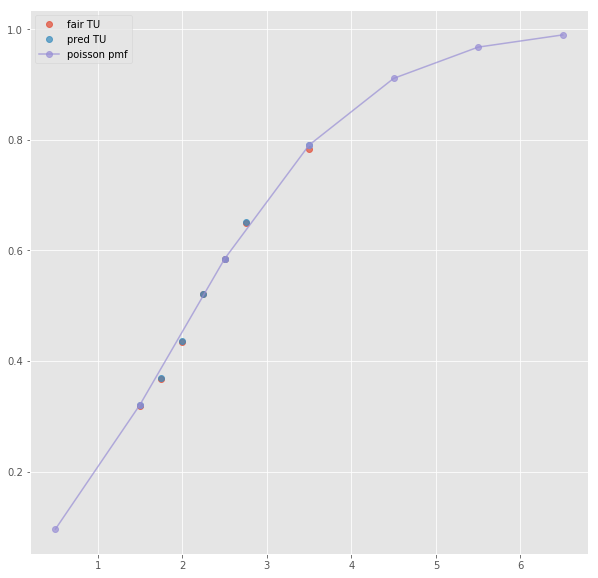

Error T1O:  0.017017891911063787
ML : 2.88 3.14 2.71
Error home:  0.0005061783491252525
Error draw:  0.02766642418648979
Error away:  0.02716061269795933

(39, 124)
(1, 62)
2.5 2.25 1.625 -0.5 2.3 1.6
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.0009003040170663112

Error TO:  0.016384364879377666

Error TO:  0.005660988994402261

Error TO:  0.014579997301658959

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.009174311926605505

Error TO:  0.016912035740595688

Error TO:  0.020352240119340337

Error TO:  0.011428927950369011

Error TO:  0.022057817955149273

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



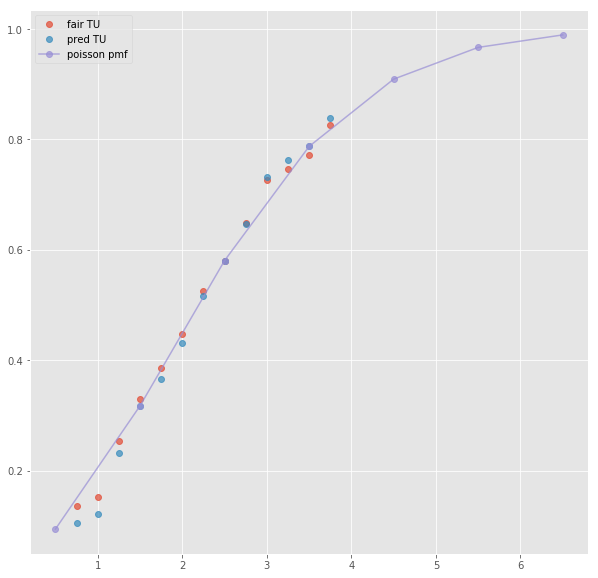

ML : 2.375 3.1 3.1
Error home:  0.015335121315943945
Error draw:  0.02483325011921389
Error away:  0.009497812918218052

(5, 124)
(1, 33)
2.5 2.34 1.63 -0.5 2.76 1.48
TO fair:  2.4355828220858897 TU fair:  1.6965811965811965
TO pred:  2.43558 TU fair:  1.69658
Error TO:  0.005727825268713016

Error TO:  0.0016628288409882286

Error TO:  4.7573480504992105e-07

Error TO:  0.0003700481225993313

Error TO:  0.0018916098894462552



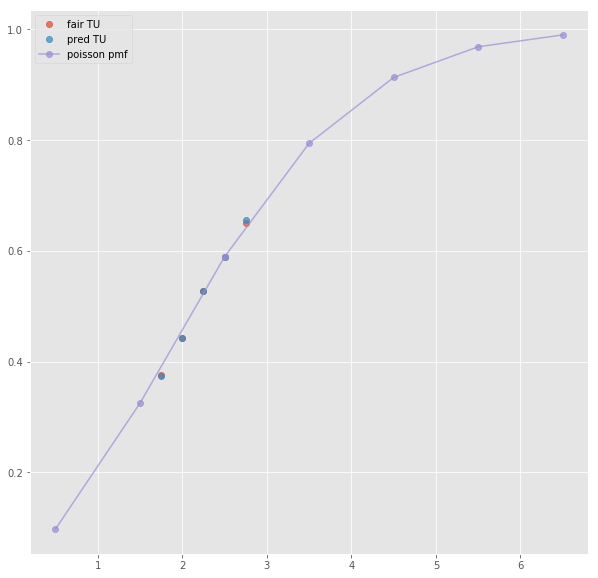

Error T1O:  0.010127433777068873
ML : 2.81 3.13 2.74
Error home:  0.006995169382728095
Error draw:  0.02530457045356249
Error away:  0.018309195346426388

(96, 124)
next positional indexers are out-of-bounds
(129, 124)
next positional indexers are out-of-bounds
(140, 124)
next positional indexers are out-of-bounds
(223, 124)
next positional indexers are out-of-bounds
(83, 124)
(1, 45)
3.5 2.68 1.518 -0.5 2.91 1.46
TO fair:  2.7654808959156782 TU fair:  1.566417910447761
TO pred:  2.76552 TU fair:  1.56641
Error TO:  0.00217210099038867

Error TO:  0.0005661966657075079

Error TO:  5.112986598720948e-06

Error TO:  0.007091905385428754

Error TO:  0.0020673929571805028

Error TO:  0.00018223716256859923

Error TO:  0.0010378359214607835

Error TO:  0.00017123459902551597



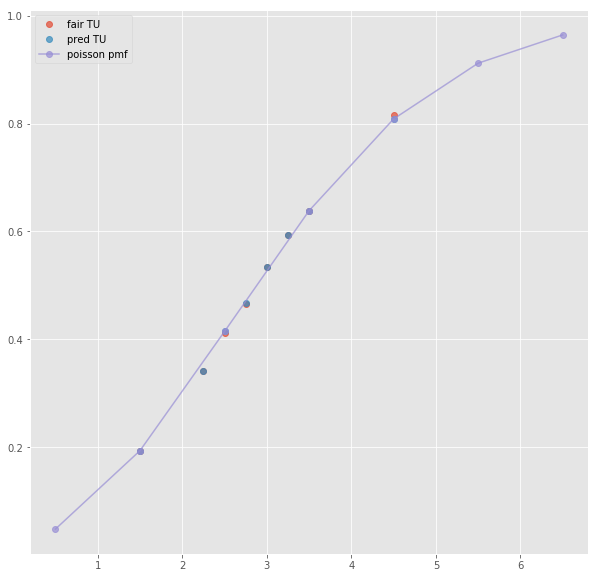

Error T1O:  0.013901342856734444
ML : 2.91 3.62 2.44
Error home:  0.00035904167030226253
Error draw:  0.02849886578653041
Error away:  0.028140049758532293

(155, 124)
(1, 67)
3.5 2.5 1.5 -0.5 2.675 1.45
TO fair:  2.6666666666666665 TU fair:  1.6
TO pred:  2.66662 TU fair:  1.60002
Error TO:  0.00868177267704695

Error TO:  0.0283832840453333

Error TO:  0.015953853616816227

Error TO:  6.56261484577314e-06

Error TO:  0.007446642532960512

Error TO:  0.018042515322542085

Error TO:  0.024340724817056292

Error TO:  0.02288588915018097

Error TO:  0.011973130611186988

Error TO:  0.027951582523409346

Error TO:  0.0035467397737521666

Error TO:  0.006359533221907437

Error TO:  0.0014226721918641494

Error TO:  0.024801797381581947

Error TO:  0.009081106112049597



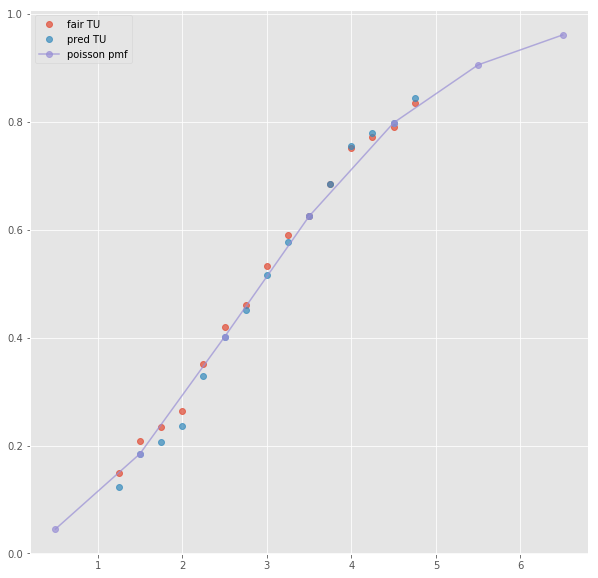

ML : 2.8 3.75 2.375
Error home:  0.00969143917132903
Error draw:  0.017258383306376468
Error away:  0.007566717679748702

(32, 124)
next positional indexers are out-of-bounds
(187, 124)
next positional indexers are out-of-bounds
(362, 124)
next positional indexers are out-of-bounds
(325, 124)
next positional indexers are out-of-bounds
(775, 124)
next positional indexers are out-of-bounds
(140, 124)
(1, 52)
3.5 2.02 1.877 -1.5 2.03 1.884
TO fair:  2.076185402237613 TU fair:  1.9292079207920791
TO pred:  2.07619 TU fair:  1.92921
Error TO:  0.001993322769187289

Error TO:  1.0666287733052116e-06

Error TO:  0.004126879149165319

Error TO:  0.001357347931877917

Error TO:  0.004467950857558689

Error TO:  0.0015523831200937588

Error TO:  0.003596019915799442

Error TO:  0.0050913673411091265

Error TO:  0.04887786113611786

Error TO:  0.0014064939442444135



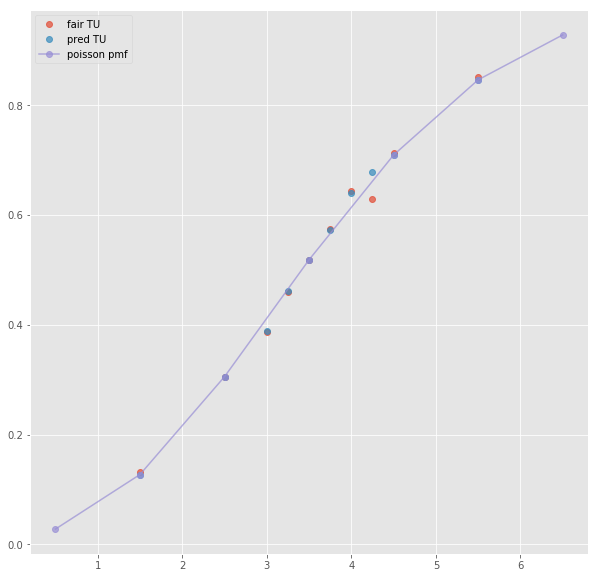

Error T1O:  0.016612967480227225
Error T1O:  0.01310188704760451
ML : 1.381 5.74 7.32
Error home:  0.0025297619027980778
Error draw:  0.000973323017765898
Error away:  0.003503009049664718

(80, 124)
(1, 77)
3.5 1.8 2.0 -1.5 2.05 1.88
TO fair:  1.9000000000000001 TU fair:  2.111111111111111
TO pred:  1.90002 TU fair:  2.11109
Error TO:  0.041592573426266766

Error TO:  0.03728156402206273

Error TO:  0.047792972699230885

Error TO:  5.54010788800241e-06

Error TO:  0.01767661462920045

Error TO:  0.03431150722440457

Error TO:  0.03650725074563421

Error TO:  0.0364358229134476

Error TO:  0.04024443341794526

Error TO:  0.035055417605177275

Error TO:  0.02596724924185362

Error TO:  0.011363456539824734

Error TO:  0.026374303205022986

Error TO:  0.0279574148078508

Error TO:  0.01445809578271845

Error TO:  0.0070857913748169354

Error TO:  0.00936071877491046

Error TO:  0.016446830273351504



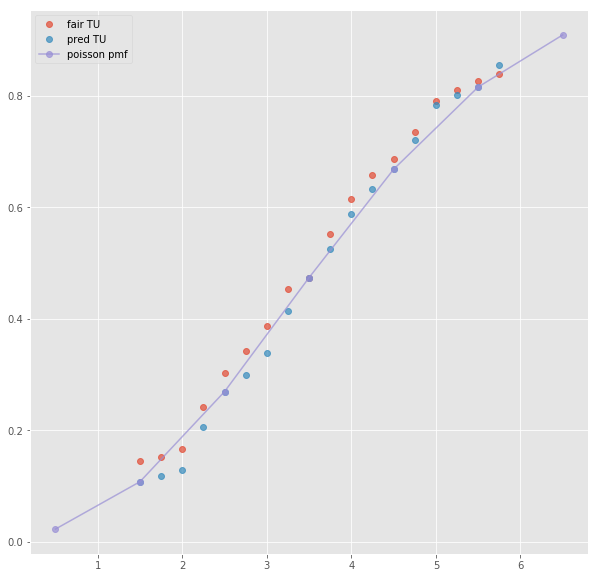

ML : 1.36 5.75 6.5
Error home:  0.0037199535746840207
Error draw:  0.0019715505173811265
Error away:  0.0017484850339978542

(94, 124)
next positional indexers are out-of-bounds
(59, 124)
(1, 39)
2.5 2.36 1.645 -0.5 2.0 1.917
TO fair:  2.4346504559270516 TU fair:  1.6970338983050848
TO pred:  2.43466 TU fair:  1.69703
Error TO:  0.0035749703555922885

Error TO:  0.0035029433232722784

Error TO:  0.009536714104509403

Error TO:  1.610122101314282e-06

Error TO:  0.003686989679017927

Error TO:  0.0016278151014317843

Error TO:  0.003395699180968159



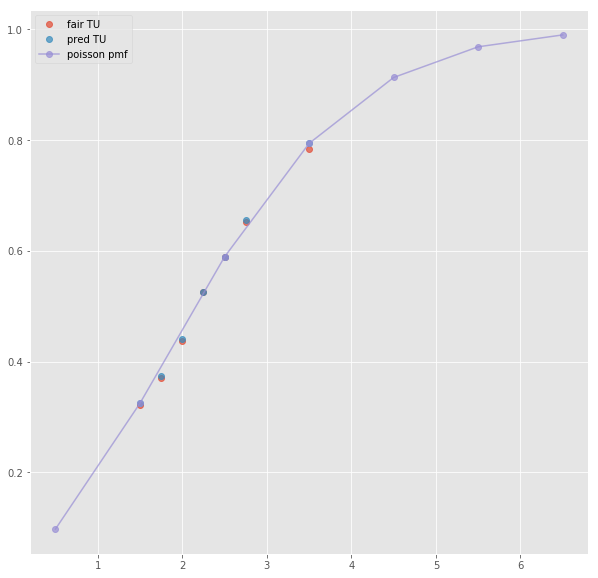

ML : 2.0 3.27 4.48
Error home:  0.003526563276351702
Error draw:  0.027039286322203038
Error away:  0.023512551346631494

(32, 124)
(1, 23)
2.5 2.21 1.68 -0.5 2.02 1.86
TO fair:  2.3154761904761907 TU fair:  1.760180995475113
TO pred:  2.3155 TU fair:  1.76017
Error TO:  0.0027696494838476138

Error TO:  4.440844892927842e-06

Error TO:  0.009645398948701145



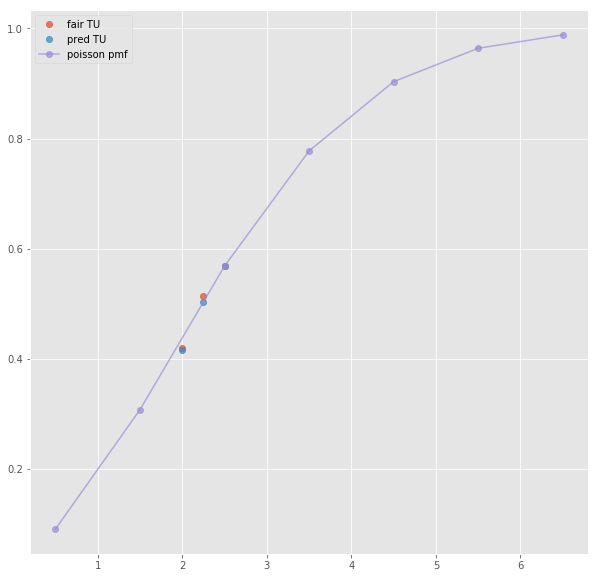

ML : 2.0 3.18 4.08
Error home:  0.007484735050099944
Error draw:  0.03003354746539355
Error away:  0.022548486100957776

(77, 124)
(1, 19)
2.5 2.26 1.69 -0.5 2.03 1.89
TO fair:  2.337278106508876 TU fair:  1.7477876106194692
TO pred:  2.33732 TU fair:  1.74776
Error TO:  7.66863357726244e-06

Error TO:  0.010190979900359998



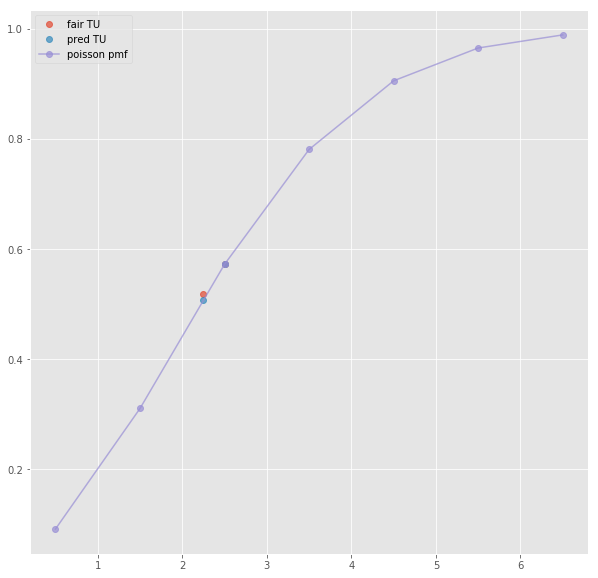

ML : 2.0 3.25 4.1
Error home:  0.006656876069930373
Error draw:  0.025326983904534417
Error away:  0.018670067984803695

(156, 124)
(1, 23)
2.5 2.25 1.7 -0.5 2.02 1.9
TO fair:  2.3235294117647056 TU fair:  1.7555555555555553
TO pred:  2.32359 TU fair:  1.75552
Error TO:  0.020226290468746133

Error TO:  1.1222267855826029e-05

Error TO:  0.010416965748711704



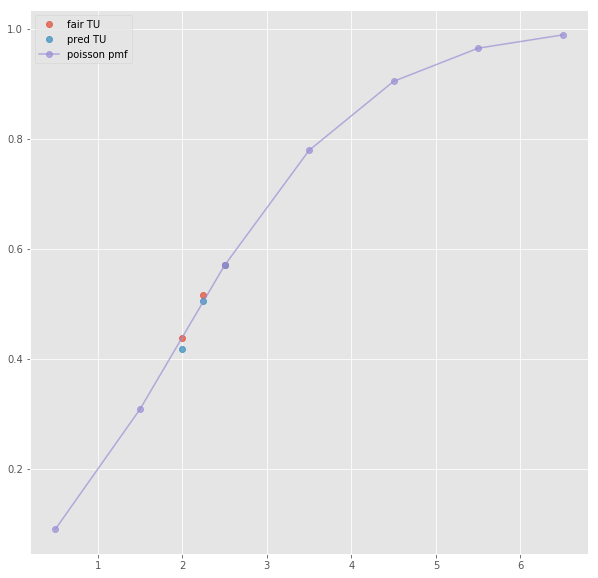

ML : 2.01 3.15 4.2
Error home:  0.012261835373257646
Error draw:  0.03520249555117727
Error away:  0.022940732270001457

(48, 124)
(1, 41)
2.5 2.36 1.645 -0.5 2.0 1.917
TO fair:  2.4346504559270516 TU fair:  1.6970338983050848
TO pred:  2.43466 TU fair:  1.69703
Error TO:  0.0035749703555922885

Error TO:  0.0035029433232722784

Error TO:  0.009536714104509403

Error TO:  1.610122101314282e-06

Error TO:  0.003686989679017927

Error TO:  0.0016278151014317843

Error TO:  0.003395699180968159



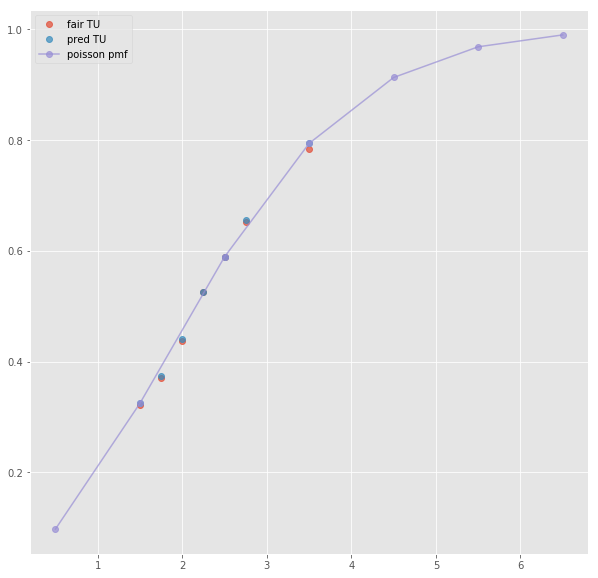

Error T1O:  0.0064149625845147384
ML : 2.0 3.27 4.48
Error home:  0.003526563276351702
Error draw:  0.027039286322203038
Error away:  0.023512551346631494

(36, 124)
(1, 10)
next list index out of range
(22, 124)
next positional indexers are out-of-bounds
(78, 124)
(1, 45)
2.5 2.08 1.819 0.5 1.787 2.15
TO fair:  2.1434854315558 TU fair:  1.8745192307692309
TO pred:  2.14344 TU fair:  1.87455
Error TO:  0.0030308545713015334

Error TO:  0.008874627154782933

Error TO:  0.007643318946360611

Error TO:  0.00924556974642976

Error TO:  0.005750426394740937

Error TO:  9.88839354071347e-06

Error TO:  0.009247043606223637

Error TO:  0.0031094409409111456

Error TO:  0.009173889869158125



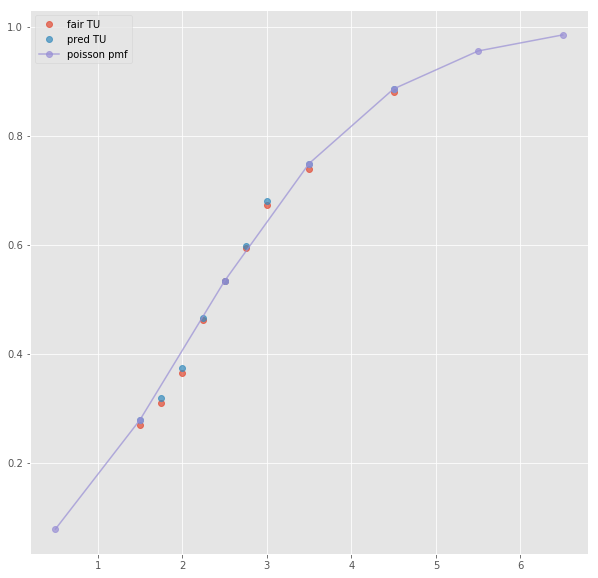

ML : 3.88 3.27 2.15
Error home:  0.03328460685427054
Error draw:  0.03503458612939109
Error away:  0.0017498737604922932

(136, 124)
(1, 27)
2.5 2.08 1.8 0.5 1.78 2.14
TO fair:  2.1555555555555554 TU fair:  1.8653846153846152
TO pred:  2.1555 TU fair:  1.86542
Error TO:  0.006186918815767994

Error TO:  0.004785974165506857

Error TO:  1.1956945430879884e-05

Error TO:  0.0007749430954694381



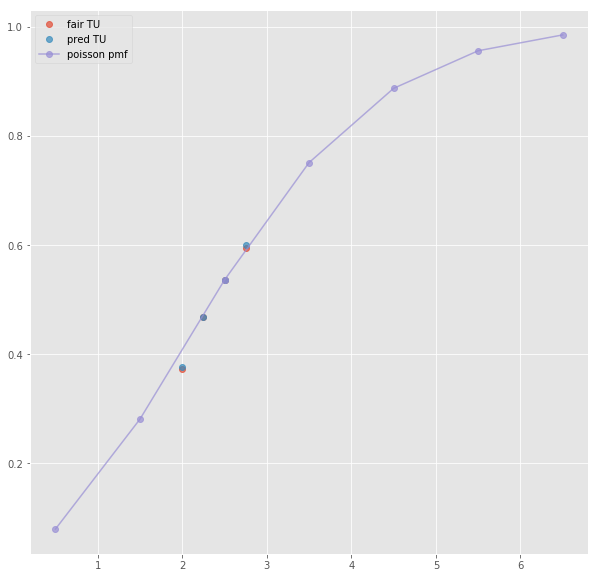

ML : 3.73 3.18 2.15
Error home:  0.02719297886061245
Error draw:  0.03732867389587469
Error away:  0.010135615393365882

(153, 124)
(1, 25)
2.5 2.09 1.83 0.5 1.79 2.19
TO fair:  2.14207650273224 TU fair:  1.875598086124402
TO pred:  2.14207 TU fair:  1.8756
Error TO:  0.009006627911022858

Error TO:  1.4171872467771962e-06

Error TO:  0.0016847576281607823



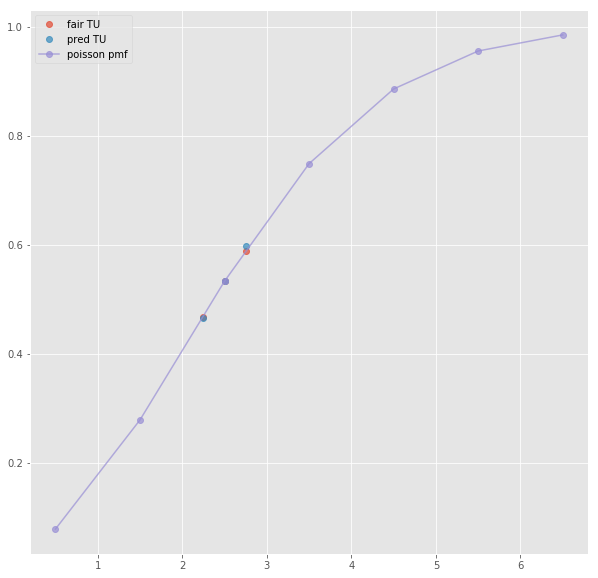

ML : 3.65 3.3 2.12
Error home:  0.02634649862208821
Error draw:  0.026293403188534847
Error away:  5.3372017254527115e-05

(365, 124)
(1, 27)
2.5 2.08 1.84 0.5 1.79 2.19
TO fair:  2.1304347826086953 TU fair:  1.8846153846153844
TO pred:  2.13041 TU fair:  1.88463
Error TO:  0.00627180145199252

Error TO:  0.007345784837009872

Error TO:  5.460288423853044e-06

Error TO:  0.006993260182412753



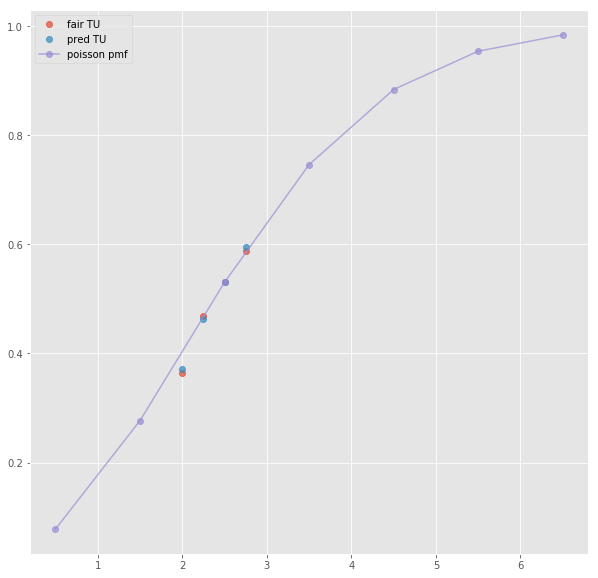

ML : 3.6 3.3 2.17
Error home:  0.021507001443761997
Error draw:  0.02882768092656879
Error away:  0.007320593561272959

(59, 124)
(1, 47)
2.5 2.08 1.819 0.5 1.787 2.15
TO fair:  2.1434854315558 TU fair:  1.8745192307692309
TO pred:  2.14344 TU fair:  1.87455
Error TO:  0.0030308545713015334

Error TO:  0.008874627154782933

Error TO:  0.007643318946360611

Error TO:  0.00924556974642976

Error TO:  0.005750426394740937

Error TO:  9.88839354071347e-06

Error TO:  0.009247043606223637

Error TO:  0.0031094409409111456

Error TO:  0.0006499052810632344



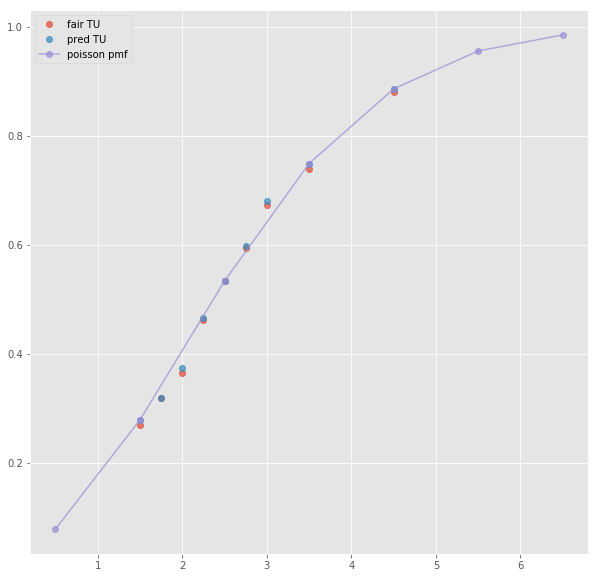

Error T1O:  0.013350501077553256
ML : 3.88 3.27 2.15
Error home:  0.03328460685427054
Error draw:  0.03503458612939109
Error away:  0.0017498737604922932

(24, 124)
(1, 12)
next list index out of range
(52, 124)
next positional indexers are out-of-bounds
(33, 124)
(1, 41)
2.5 2.52 1.561 -0.5 2.22 1.719
TO fair:  2.614349775784753 TU fair:  1.6194444444444442
TO pred:  2.61443 TU fair:  1.61941
Error TO:  0.010640675145352219

Error TO:  0.0056618271329228476

Error TO:  0.00020187382061773174

Error TO:  1.1737207095408042e-05

Error TO:  0.007169836327798773

Error TO:  0.0015784686020607896

Error TO:  0.007187408692324926

Error TO:  0.027011217564789636



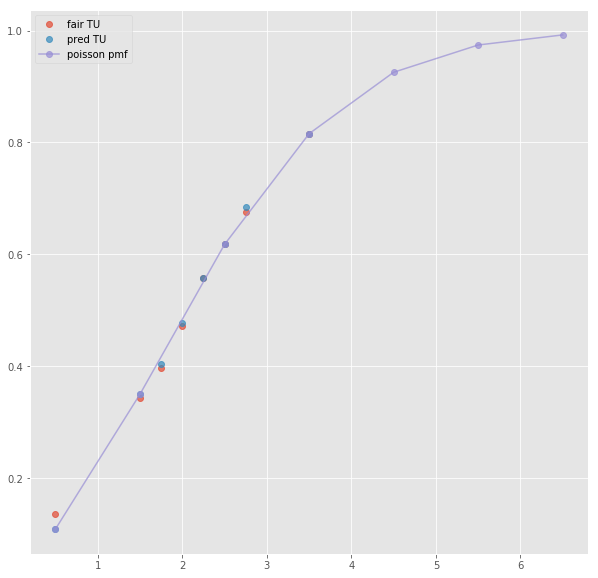

ML : 2.22 2.86 4.17
Error home:  0.0032282111699881155
Error draw:  0.05118604449981223
Error away:  0.04795821997764538

(31, 124)
(1, 19)
next list index out of range
(69, 124)
(1, 19)
next list index out of range
(72, 124)
(1, 23)
next list index out of range
(28, 124)
(1, 43)
2.5 2.52 1.561 -0.5 2.22 1.719
TO fair:  2.614349775784753 TU fair:  1.6194444444444442
TO pred:  2.61443 TU fair:  1.61941
Error TO:  0.013651216377016329

Error TO:  0.0056618271329228476

Error TO:  0.00020187382061773174

Error TO:  1.1737207095408042e-05

Error TO:  0.007169836327798773

Error TO:  0.0015784686020607896

Error TO:  0.007187408692324926

Error TO:  0.027011217564789636



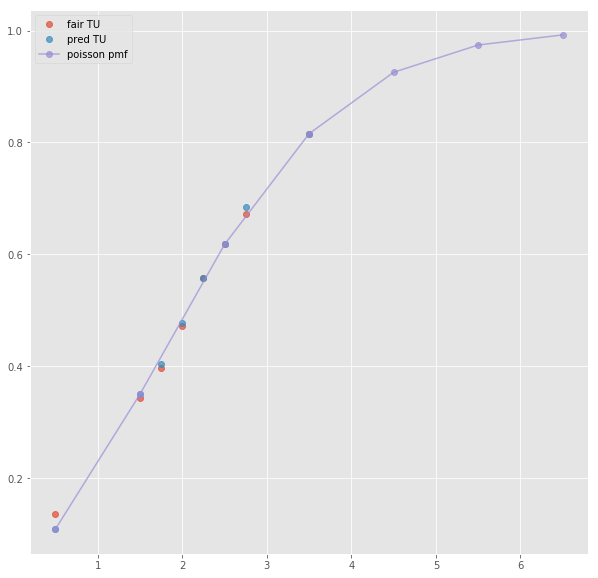

Error T1O:  0.023306287867947195
ML : 2.22 2.86 4.17
Error home:  0.0032282111699881155
Error draw:  0.05118604449981223
Error away:  0.04795821997764538

(17, 124)
(1, 57)
2.5 2.375 1.55 -0.5 2.1 1.7
TO fair:  2.5322580645161286 TU fair:  1.6526315789473682
TO pred:  2.53226 TU fair:  1.65263
Error TO:  0.0021684298345053254

Error TO:  0.01226807532313745

Error TO:  0.011485125092901421

Error TO:  0.015378316451859775

Error TO:  3.0183757210311413e-07

Error TO:  0.01272463590399564

Error TO:  0.008195840842151303

Error TO:  0.011761839573545568

Error TO:  0.010443100374867842

Error TO:  0.01568727962067029

Error TO:  0.022955544154362517

Error TO:  0.03731874613016484

Error TO:  0.04034370923027697



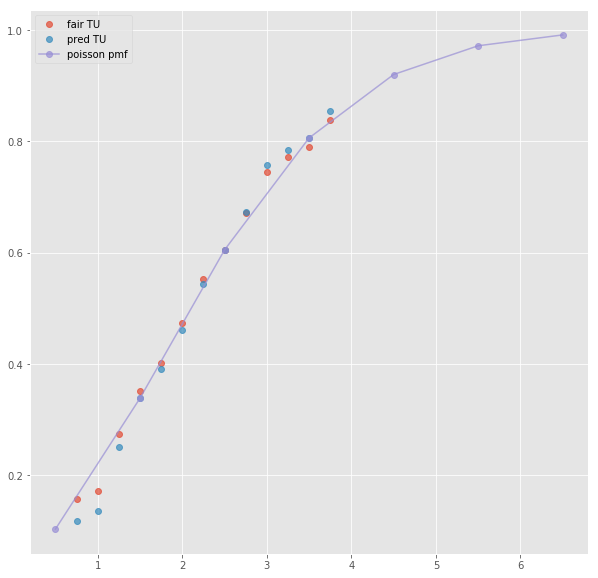

ML : 2.1 3.0 3.9
Error home:  0.0006338499648692597
Error draw:  0.0322948197048078
Error away:  0.03166123339000371

(6, 124)
next positional indexers are out-of-bounds
(41, 124)
(1, 43)
2.5 1.98 1.884 -0.5 2.01 1.869
TO fair:  2.050955414012739 TU fair:  1.9515151515151514
TO pred:  2.05093 TU fair:  1.95154
Error TO:  0.003906535430492131

Error TO:  0.008741490280076425

Error TO:  0.012347471960681033

Error TO:  0.013300237635191503

Error TO:  6.041797793121528e-06

Error TO:  0.012338591678472843

Error TO:  0.001712087887583147

Error TO:  0.03512425568102717



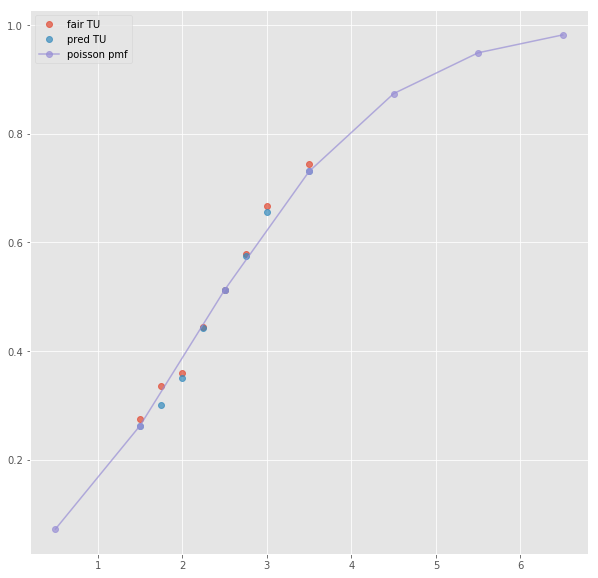

ML : 2.01 3.7 3.67
Error home:  0.0035757703786492567
Error draw:  0.005834390674879619
Error away:  0.002258891454193168

(42, 124)
(1, 19)
2.5 1.99 1.83 -0.5 1.97 1.87
TO fair:  2.0874316939890707 TU fair:  1.9195979899497486
TO pred:  2.08739 TU fair:  1.91963
Error TO:  9.568802183279601e-06

Error TO:  0.013979853499086481



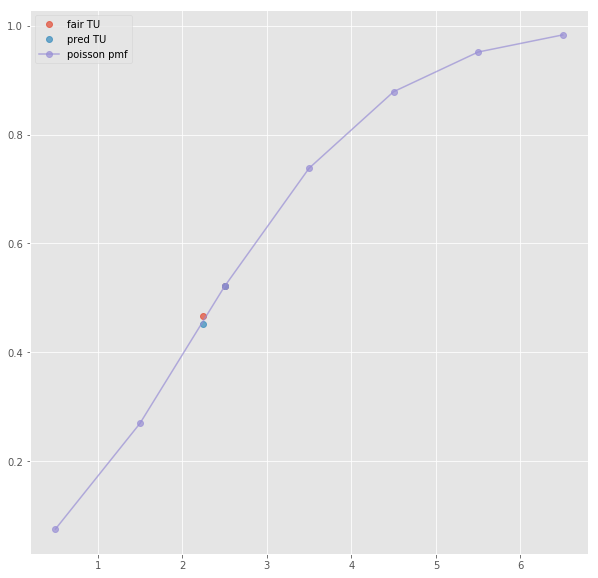

ML : 1.96 3.51 3.31
Error home:  0.0219641845955299
Error draw:  0.0046398597675677555
Error away:  0.01732400249224575

(48, 124)
(1, 19)
2.5 2.03 1.87 -0.5 2.04 1.88
TO fair:  2.085561497326203 TU fair:  1.9211822660098523
TO pred:  2.08557 TU fair:  1.92117
Error TO:  1.9548243775369123e-06

Error TO:  0.015125770813565809



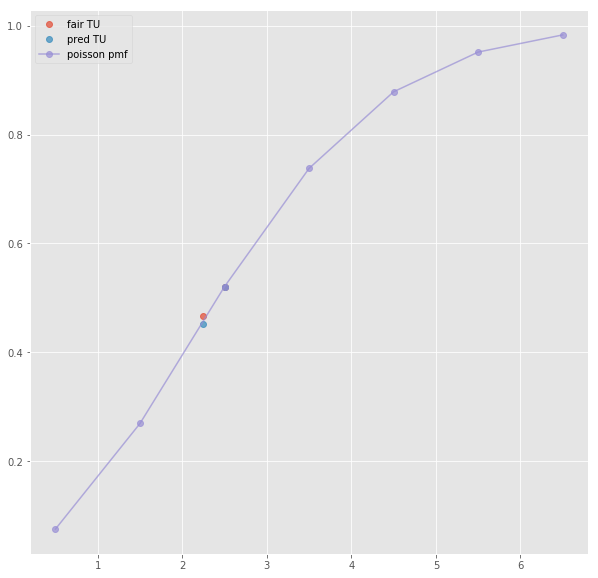

ML : 2.0 3.45 3.9
Error home:  0.0016823544949441938
Error draw:  0.021002431985680914
Error away:  0.019320265515341467

(73, 124)
(1, 19)
2.5 2.04 1.86 -0.5 2.05 1.87
TO fair:  2.096774193548387 TU fair:  1.911764705882353
TO pred:  2.09676 TU fair:  1.91178
Error TO:  3.2284242207358815e-06

Error TO:  0.009817068102651594



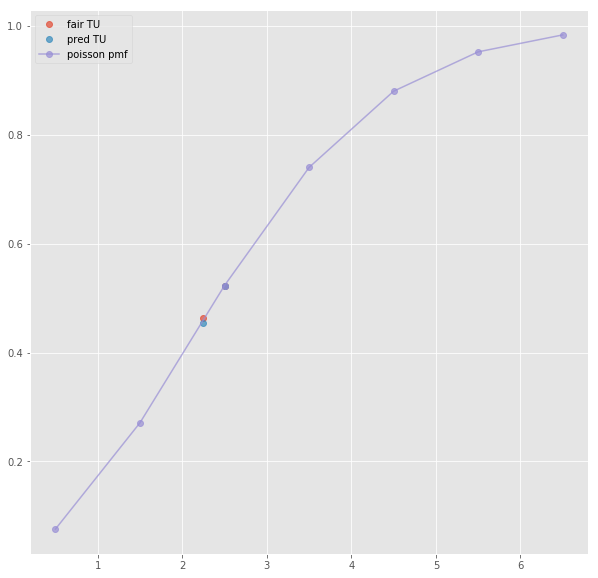

ML : 2.04 3.45 3.7
Error home:  0.010334072464174504
Error draw:  0.019016140110978907
Error away:  0.008681944112906625

(27, 124)
(1, 45)
2.5 1.98 1.884 -0.5 2.01 1.869
TO fair:  2.050955414012739 TU fair:  1.9515151515151514
TO pred:  2.05093 TU fair:  1.95154
Error TO:  0.003906535430492131

Error TO:  0.008741490280076425

Error TO:  0.012347471960681033

Error TO:  0.013300237635191503

Error TO:  6.041797793121528e-06

Error TO:  0.012338591678472843

Error TO:  0.001712087887583147

Error TO:  0.03512425568102717



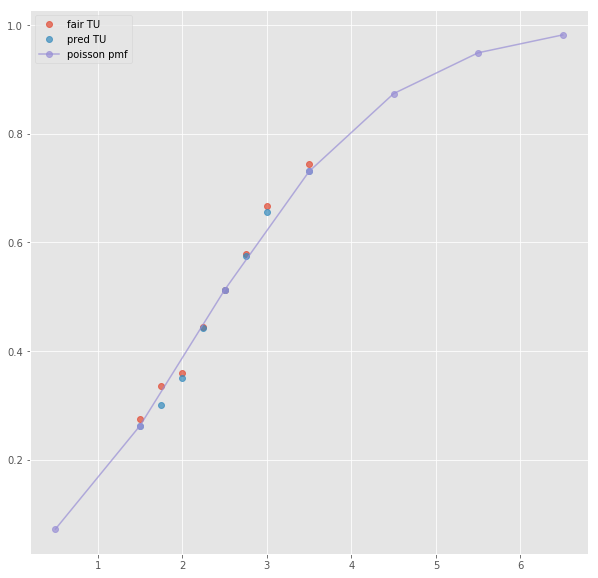

Error T1O:  0.00034137417506419077
ML : 2.01 3.7 3.67
Error home:  0.0035757703786492567
Error draw:  0.005834390674879619
Error away:  0.002258891454193168

(18, 124)
(1, 64)
2.5 2.0 1.85 -0.5 2.075 1.725
TO fair:  2.0810810810810807 TU fair:  1.9249999999999998
TO pred:  2.0811 TU fair:  1.92499
Error TO:  0.011419823163475118

Error TO:  0.003754043380809313

Error TO:  0.015333236757437807

Error TO:  0.010599010384249818

Error TO:  0.02198551988317242

Error TO:  4.368319201975002e-06

Error TO:  0.005486126383731471

Error TO:  0.0035126622736152413

Error TO:  0.019110645952685967

Error TO:  0.007550645479169837

Error TO:  0.018715818524131123

Error TO:  0.02072488356435026

Error TO:  0.020039380241173133

Error TO:  0.01938029202298075



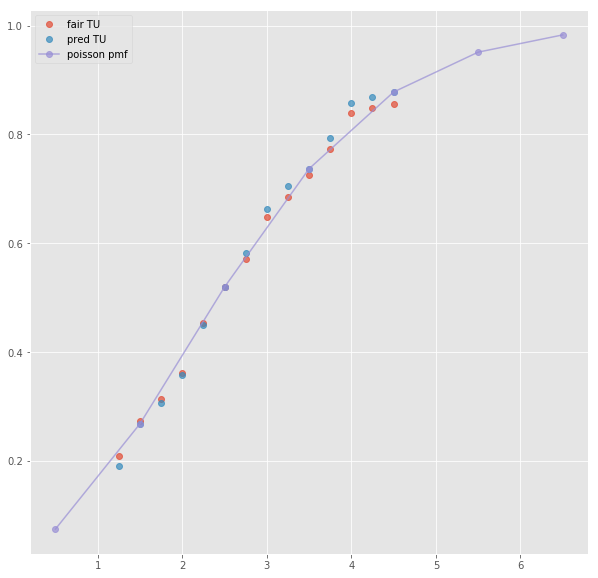

ML : 2.0 3.4 3.6
Error home:  0.012522526816557855
Error draw:  0.015253067046498536
Error away:  0.027775475210759903

(2, 124)
(1, 33)
2.5 2.06 1.81 -0.5 2.12 1.76
TO fair:  2.1381215469613264 TU fair:  1.8786407766990294
TO pred:  2.13809 TU fair:  1.87866
Error TO:  0.003641831062799805

Error TO:  0.0026712206623176193

Error TO:  0.010394375823206015

Error TO:  6.900795553044237e-06

Error TO:  0.0009013649561168124



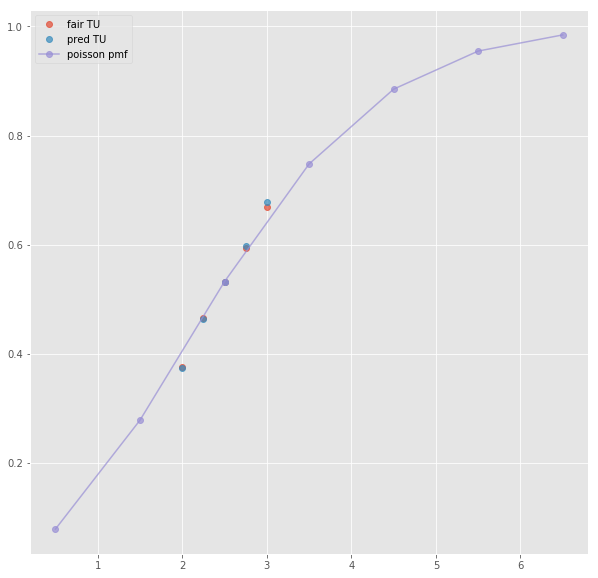

Error T1O:  0.008643218501119432
ML : 2.14 3.41 3.57
Error home:  0.0045615523057891405
Error draw:  0.019767621824637094
Error away:  0.015205986257798454

(179, 124)
next positional indexers are out-of-bounds
(2455, 124)
next positional indexers are out-of-bounds
(235, 124)
next positional indexers are out-of-bounds
(778, 124)
next positional indexers are out-of-bounds
(174, 124)
(1, 41)
2.5 2.29 1.68 -0.5 2.03 1.884
TO fair:  2.363095238095238 TU fair:  1.7336244541484715
TO pred:  2.36305 TU fair:  1.73365
Error TO:  0.0017781490279970003

Error TO:  0.0030829809870748237

Error TO:  0.0024904247927823586

Error TO:  8.101215304923137e-06

Error TO:  0.0026740648956260493

Error TO:  8.505418176191215e-05

Error TO:  0.0032128675489326852



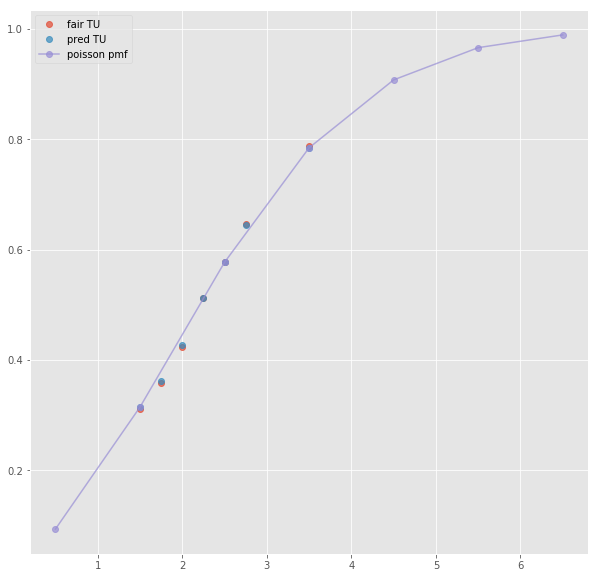

Error T1O:  0.0023839615028906636
ML : 2.03 3.35 4.21
Error home:  0.002437682542983599
Error draw:  0.02169148002371274
Error away:  0.019253782260243157

(136, 124)
(1, 60)
2.5 2.2 1.65 -0.5 2.01 1.92
TO fair:  2.3333333333333335 TU fair:  1.7499999999999998
TO pred:  2.33328 TU fair:  1.75003
Error TO:  0.012982840386634331

Error TO:  0.008951112960956187

Error TO:  0.008585969313624042

Error TO:  0.021334419937567572

Error TO:  9.796142279250297e-06

Error TO:  0.004416839199447908

Error TO:  0.006047190981737172

Error TO:  0.018720991950278543

Error TO:  0.0054762567168650245

Error TO:  0.013000791667004824

Error TO:  0.02232214295763646

Error TO:  0.03152030082722401

Error TO:  0.03328324061027366



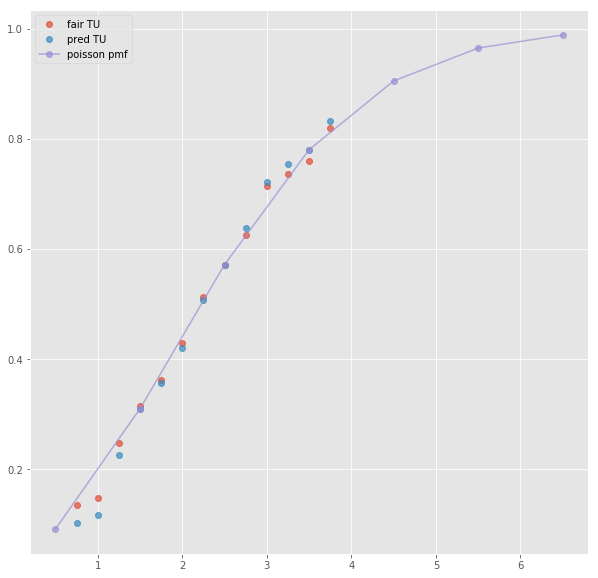

ML : 1.95 3.2 4.2
Error home:  0.006321392558790329
Error draw:  0.02782413968696318
Error away:  0.021502712134611607

(98, 124)
next positional indexers are out-of-bounds
(80, 124)
(1, 40)
2.5 2.31 1.6569999999999998 -1.5 2.64 1.529
TO fair:  2.394085697042849 TU fair:  1.7173160173160174
TO pred:  2.39412 TU fair:  1.7173
Error TO:  0.001937566846254124

Error TO:  0.0049921122320908395

Error TO:  0.007425422020794853

Error TO:  5.984749182785798e-06

Error TO:  0.005847832949143261

Error TO:  0.0018865819753000057

Error TO:  0.005761840657620865



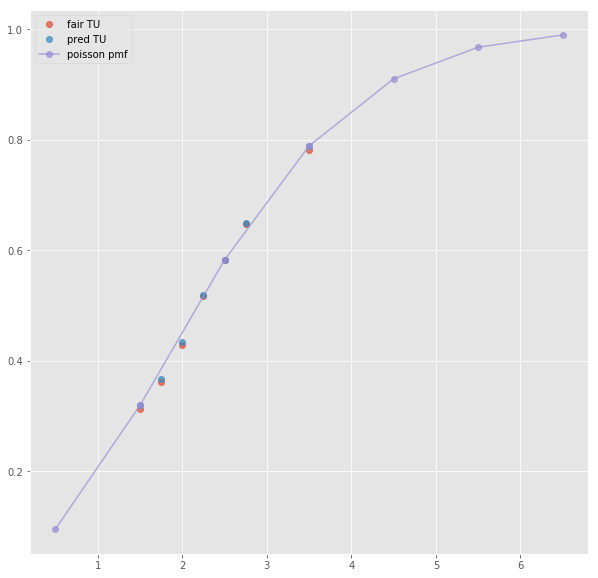

ML : 1.485 4.14 7.96
Error home:  0.010029920818538263
Error draw:  0.001680787066117101
Error away:  0.011710934192179445

(2298, 124)
(1, 22)
next list index out of range
(152, 124)
(1, 20)
next list index out of range
(237, 124)
(1, 21)
next list index out of range
(77, 124)
(1, 42)
2.5 2.31 1.6569999999999998 -1.5 2.64 1.529
TO fair:  2.394085697042849 TU fair:  1.7173160173160174
TO pred:  2.39412 TU fair:  1.7173
Error TO:  0.001937566846254124

Error TO:  0.0049921122320908395

Error TO:  0.007425422020794853

Error TO:  5.984749182785798e-06

Error TO:  0.005847832949143261

Error TO:  0.0018865819753000057

Error TO:  0.005761840657620865



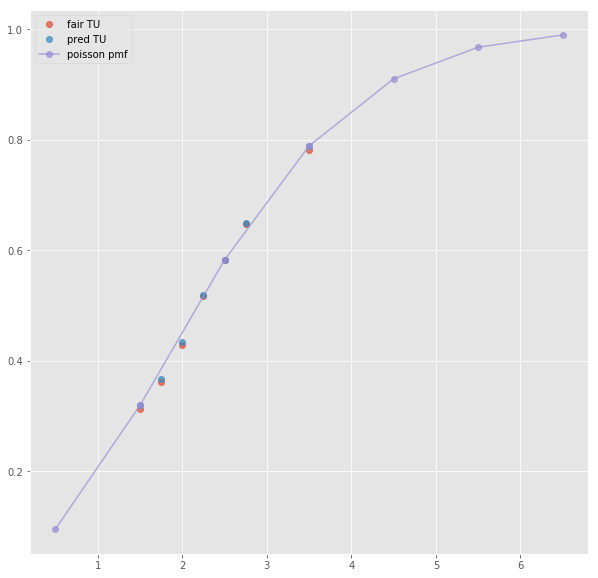

Error T1O:  0.010471879624150526
ML : 1.485 4.14 7.96
Error home:  0.010029920818538263
Error draw:  0.001680787066117101
Error away:  0.011710934192179445

(29, 124)
(1, 62)
2.5 2.2 1.65 -1.5 2.425 1.525
TO fair:  2.3333333333333335 TU fair:  1.7499999999999998
TO pred:  2.33328 TU fair:  1.75003
Error TO:  0.012982840386634331

Error TO:  0.008951112960956187

Error TO:  0.008585969313624042

Error TO:  0.015270928110261789

Error TO:  9.796142279250297e-06

Error TO:  0.019542889619615922

Error TO:  0.006047190981737172

Error TO:  0.018720991950278543

Error TO:  0.018513066532815925

Error TO:  0.013000791667004824

Error TO:  0.02232214295763646

Error TO:  0.027119245609514286

Error TO:  0.03328324061027366



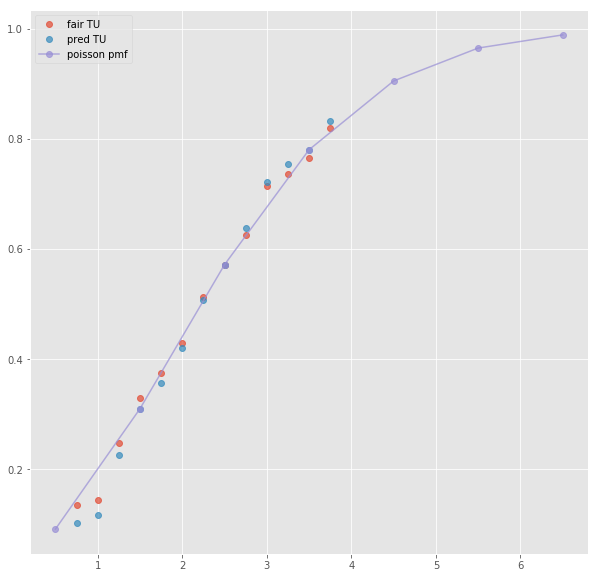

ML : 1.45 3.8 8.5
Error home:  0.010764197771959472
Error draw:  0.023767494103186126
Error away:  0.013003181192216495

(39, 124)
next positional indexers are out-of-bounds
(50, 124)
next positional indexers are out-of-bounds
(37, 124)
next positional indexers are out-of-bounds
(49, 124)
next positional indexers are out-of-bounds
(82, 124)
next positional indexers are out-of-bounds
(39, 124)
(1, 46)
2.5 2.33 1.645 0.5 2.42 1.6130000000000002
TO fair:  2.4164133738601827 TU fair:  1.7060085836909873
TO pred:  2.41646 TU fair:  1.70599
Error TO:  0.005629027712486689

Error TO:  0.0010651496728041332

Error TO:  0.0713205503971811

Error TO:  0.01799784447411909

Error TO:  7.985068026850062e-06

Error TO:  0.0006538756759257858

Error TO:  0.00031558474716203433

Error TO:  0.0007137448997962537



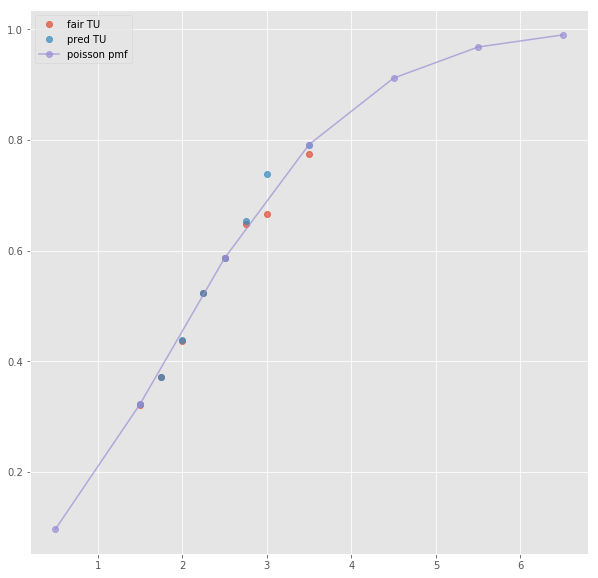

Error T1O:  0.017451457668848924
ML : 6.58 3.74 1.6130000000000002
Error home:  0.010585740502870644
Error draw:  0.014125882679255075
Error away:  0.0035400474063557175

(21, 124)
(1, 34)
2.5 2.34 1.63 0.5 2.33 1.64
TO fair:  2.4355828220858897 TU fair:  1.6965811965811965
TO pred:  2.43558 TU fair:  1.69658
Error TO:  0.003369334702675253

Error TO:  0.005373856459470749

Error TO:  4.7573480504992105e-07

Error TO:  0.0015947301762967991

Error TO:  0.006198873365413915



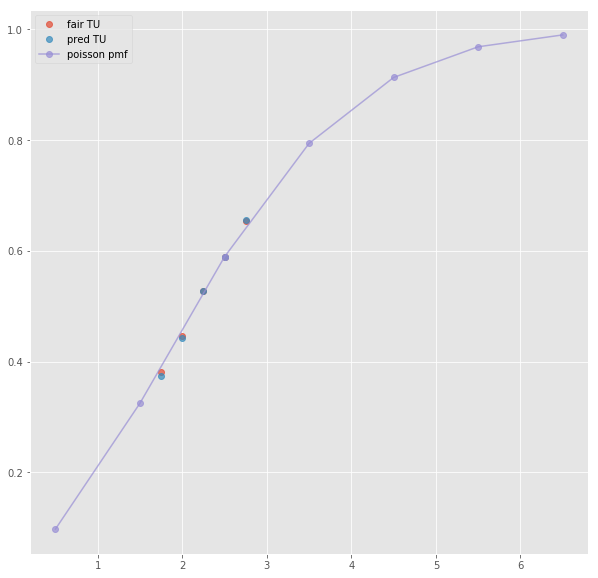

Error T1O:  0.008551242139091086
ML : 6.02 3.76 1.65
Error home:  0.005382952577799777
Error draw:  0.008492902801156638
Error away:  0.0031098361753705284

(22, 124)
(1, 42)
3.5 2.76 1.476 -0.5 1.787 2.13
TO fair:  2.869918699186992 TU fair:  1.5347826086956524
TO pred:  2.86997 TU fair:  1.53477
Error TO:  0.009404035428049906

Error TO:  0.006717931136331234

Error TO:  6.228411484288099e-06

Error TO:  0.0060614197238721135

Error TO:  0.011097856044639642

Error TO:  0.004429136619154228

Error TO:  0.00982385494534066

Error TO:  0.0025670843264748444



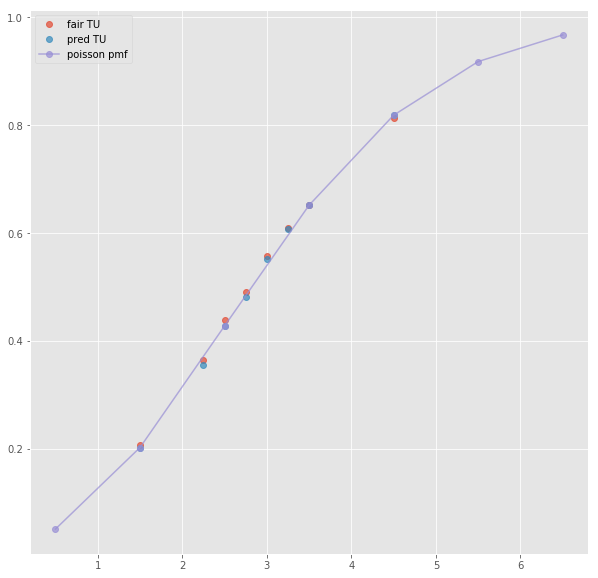

ML : 1.787 4.09 4.25
Error home:  0.005377957245895626
Error draw:  0.00840974996218663
Error away:  0.0030317103759422426

(181, 124)
(1, 23)
2.5 1.63 2.23 -0.5 1.72 2.13
TO fair:  1.7309417040358743 TU fair:  2.3680981595092025
TO pred:  1.73092 TU fair:  2.36814
Error TO:  0.008751297381666245

Error TO:  0.0023100490570417964

Error TO:  7.2440436897913685e-06



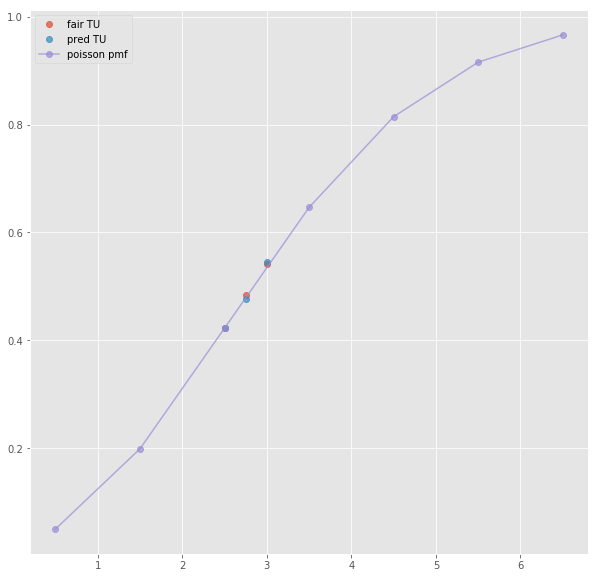

ML : 1.71 3.81 4.46
Error home:  0.007460313780621397
Error draw:  0.020988951151009322
Error away:  0.01352865832143868

(74, 124)
(1, 21)
next list index out of range
(160, 124)
(1, 23)
2.5 1.69 2.26 -0.5 1.77 2.17
TO fair:  1.7477876106194692 TU fair:  2.337278106508876
TO pred:  1.74778 TU fair:  2.3373
Error TO:  0.005365215308163029

Error TO:  0.0003438929969065696

Error TO:  2.4914064584713458e-06



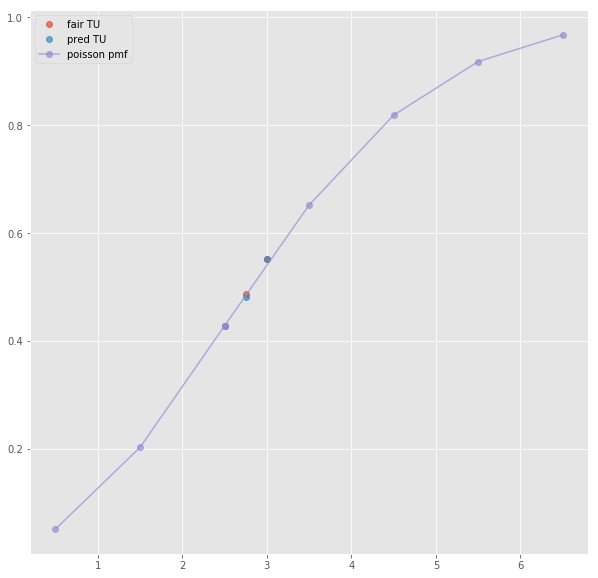

ML : 1.76 4.05 4.25
Error home:  0.0098269007011198
Error draw:  0.009607237572000465
Error away:  0.00021979647854392104

(20, 124)
(1, 44)
3.5 2.76 1.476 -0.5 1.787 2.13
TO fair:  2.869918699186992 TU fair:  1.5347826086956524
TO pred:  2.86997 TU fair:  1.53477
Error TO:  0.009404035428049906

Error TO:  0.006717931136331234

Error TO:  6.228411484288099e-06

Error TO:  0.0060614197238721135

Error TO:  0.011097856044639642

Error TO:  0.004429136619154228

Error TO:  0.00982385494534066

Error TO:  0.0025670843264748444



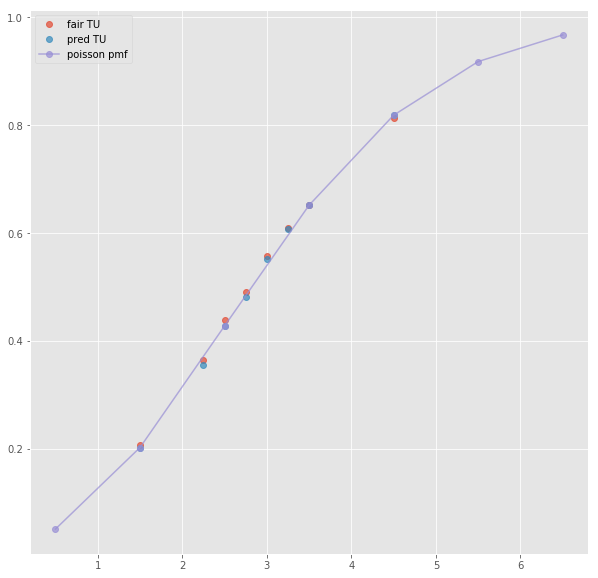

Error T1O:  0.00034379825320585145
ML : 1.787 4.09 4.25
Error home:  0.005377957245895626
Error draw:  0.00840974996218663
Error away:  0.0030317103759422426

(5, 124)
(1, 68)
3.5 2.6 1.475 -0.5 1.675 2.15
TO fair:  2.7627118644067794 TU fair:  1.5673076923076923
TO pred:  2.76276 TU fair:  1.56729
Error TO:  0.007743584038516382

Error TO:  0.025807077317834826

Error TO:  0.005900296647325498

Error TO:  6.306488034957258e-06

Error TO:  0.017463675804683

Error TO:  0.014507784164484061

Error TO:  0.02117981750360798

Error TO:  0.02067264661700574

Error TO:  0.006330379820712273

Error TO:  0.02415882778140921

Error TO:  0.010233698810505898

Error TO:  0.012098567328329951

Error TO:  0.0007934326163293037

Error TO:  0.022084988430919328

Error TO:  0.013207676297442295



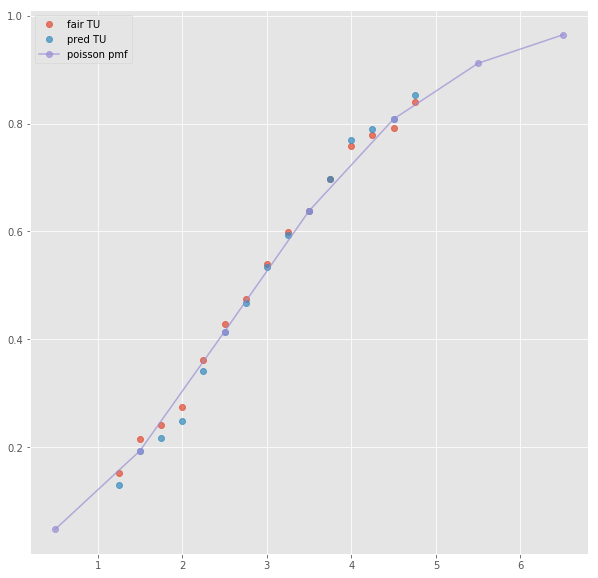

ML : 1.615 4.0 5.0
Error home:  0.017031199424766608
Error draw:  0.013144742629909084
Error away:  0.030176020841892942

(12, 124)
(1, 34)
3.5 2.6 1.53 -0.5 1.76 2.12
TO fair:  2.699346405228758 TU fair:  1.5884615384615384
TO pred:  2.69929 TU fair:  1.58848
Error TO:  0.021078577604331405

Error TO:  0.02110722825494632

Error TO:  7.741251876303146e-06

Error TO:  0.02176038189215035

Error TO:  0.0250042913834988

Error TO:  0.014649865260593531



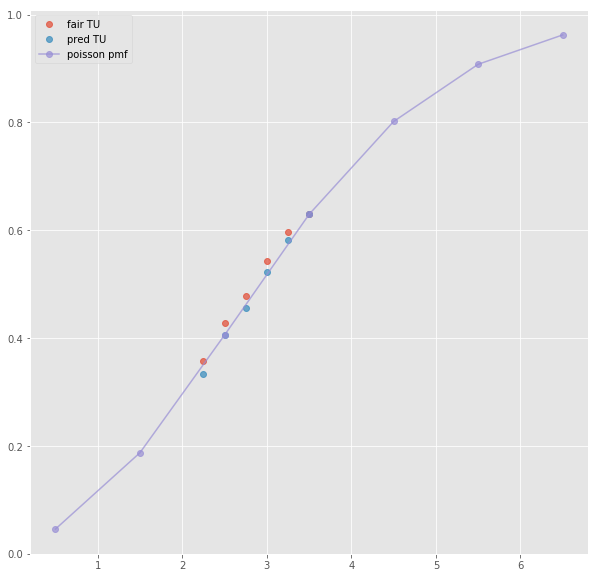

Error T1O:  0.010057774270205377
ML : 1.77 4.07 4.36
Error home:  0.003173809122946847
Error draw:  0.013763663643171026
Error away:  0.010589795402954738

(3, 124)
(1, 43)
3.5 2.64 1.518 -0.5 2.65 1.526
TO fair:  2.739130434782609 TU fair:  1.575
TO pred:  2.73918 TU fair:  1.57498
Error TO:  0.011410671417808715

Error TO:  0.008656978274912241

Error TO:  6.606078496229628e-06

Error TO:  0.00042298523094563834

Error TO:  0.01359255083888633

Error TO:  0.00652700529208583

Error TO:  0.011646989164713517

Error TO:  0.0028767076896777377



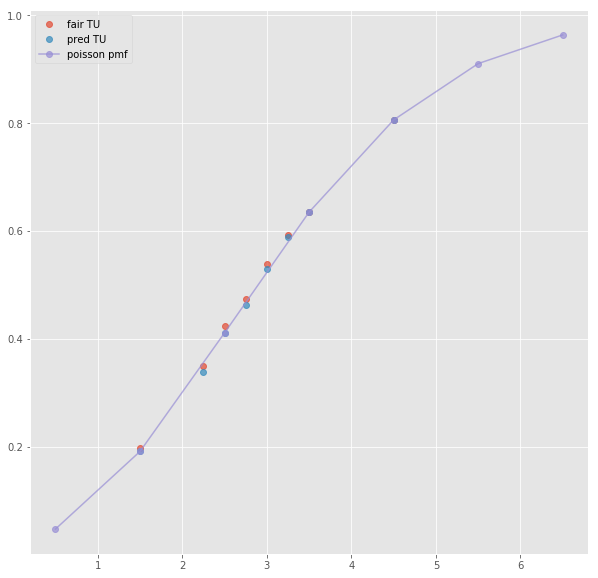

ML : 2.65 3.52 2.65
Error home:  0.0021611880778177883
Error draw:  0.0331128420067954
Error away:  0.030951859926414305

(2, 124)
(1, 19)
next list index out of range
(1, 124)
(1, 17)
next list index out of range
(8, 124)
(1, 23)
next list index out of range
(63, 124)
(1, 47)
3.5 2.67 1.507 -0.5 2.93 1.444
TO fair:  2.771731917717319 TU fair:  1.5644194756554306
TO pred:  2.77168 TU fair:  1.56444
Error TO:  0.001354285051484494

Error TO:  0.0010171044177992306

Error TO:  6.758048099353431e-06

Error TO:  0.001193945497136334

Error TO:  0.0008434564109538467

Error TO:  0.00023338860778010506

Error TO:  0.00020990561675604535

Error TO:  0.0011472494089329044



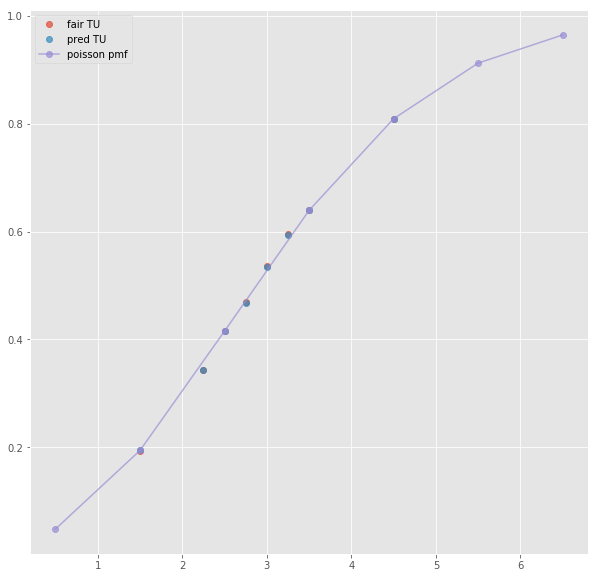

Error T1O:  0.020939376457369152
ML : 2.93 3.57 2.39
Error home:  0.0019049090738730845
Error draw:  0.029714021540989788
Error away:  0.027808968605398443

(17, 124)
(1, 69)
3.5 2.425 1.525 -0.5 2.35 1.575
TO fair:  2.5901639344262297 TU fair:  1.6288659793814435
TO pred:  2.59019 TU fair:  1.62886
Error TO:  0.020753543953216824

Error TO:  0.038170631419241374

Error TO:  0.023004270264391002

Error TO:  3.885155582861177e-06

Error TO:  0.0039520198795388595

Error TO:  0.02866881210702943

Error TO:  0.03114222672425182

Error TO:  0.03333643252097429

Error TO:  0.01522559561000858

Error TO:  0.02801453483607741

Error TO:  0.001148550297248585

Error TO:  0.0005489807026608229

Error TO:  0.0024818977009522514

Error TO:  0.02992428345467102

Error TO:  0.0013807378271565307



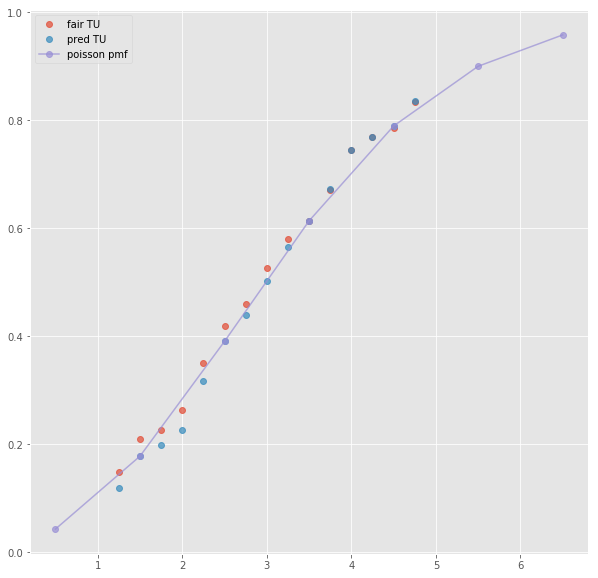

ML : 2.3 3.6 2.8
Error home:  0.005188436423668119
Error draw:  0.023515336594198383
Error away:  0.02870403996278348

(24, 124)
next positional indexers are out-of-bounds
(187, 124)
(1, 41)
3.5 1.649 2.35 1.5 2.77 1.5
TO fair:  1.7017021276595745 TU fair:  2.4251061249241967
TO pred:  1.7017 TU fair:  2.42511
Error TO:  7.347432439130941e-07

Error TO:  0.0108736493212927

Error TO:  0.0005599876384729807

Error TO:  0.01175159045182872

Error TO:  0.0072899557713322904

Error TO:  0.01225712810476115

Error TO:  0.009450219530743986

Error TO:  0.002470018234360105



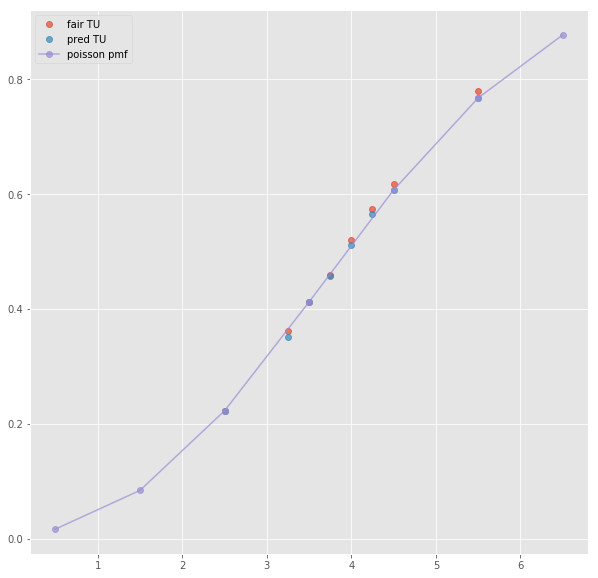

ML : 9.95 8.71 1.22
Error home:  0.029496995268162282
Error draw:  0.0015154471879721132
Error away:  0.031012462901413684

(309, 124)
(1, 23)
3.5 1.64 2.25 2.5 1.73 2.16
TO fair:  1.7288888888888885 TU fair:  2.371951219512195
TO pred:  1.72888 TU fair:  2.37197
Error TO:  2.973825930396856e-06

Error TO:  0.00045817602052961037

Error TO:  0.001063569355127969



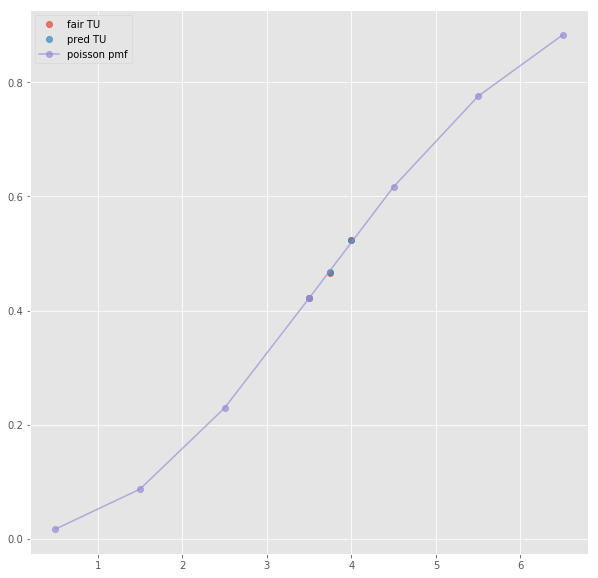

ML : 10.46 7.96 1.18
Error home:  0.022638520317507113
Error draw:  0.007641639451410928
Error away:  0.030280105966007387

(303, 124)
(1, 23)
3.5 1.68 2.31 2.5 1.78 2.2
TO fair:  1.7272727272727273 TU fair:  2.3750000000000004
TO pred:  1.72728 TU fair:  2.37498
Error TO:  2.437662866339174e-06

Error TO:  0.00026685962714151357

Error TO:  0.006052820307504425



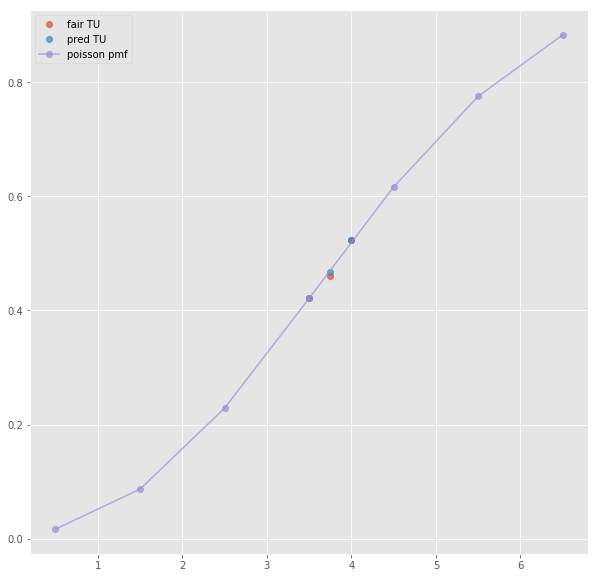

ML : 12.5 8.0 1.19
Error home:  0.010643533614864129
Error draw:  0.01049372287174602
Error away:  0.02113721932866708

(663, 124)
(1, 27)
3.5 1.67 2.33 2.5 1.77 2.21
TO fair:  1.7167381974248928 TU fair:  2.3952095808383236
TO pred:  1.71675 TU fair:  2.39519
Error TO:  4.004659967971058e-06

Error TO:  0.004191137475201723

Error TO:  0.008130075791407343

Error TO:  0.0004440641227608788



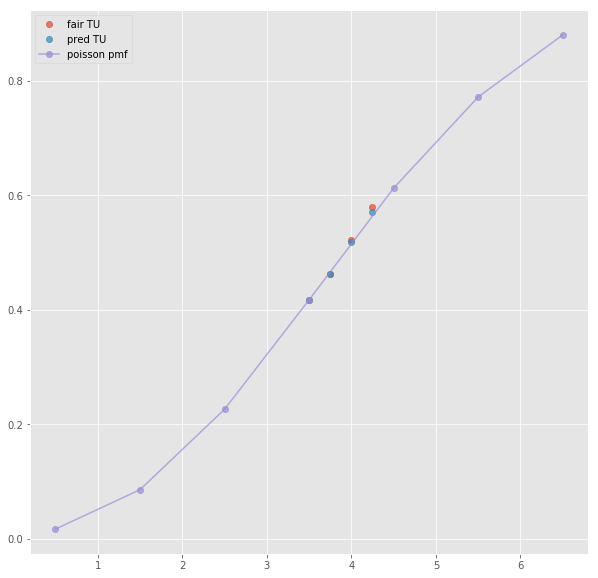

ML : 13.0 8.3 1.19
Error home:  0.006539707928054625
Error draw:  0.0060746489412100285
Error away:  0.012614381369837169

(160, 124)
(1, 43)
3.5 1.649 2.35 1.5 2.78 1.497
TO fair:  1.7017021276595745 TU fair:  2.4251061249241967
TO pred:  1.7017 TU fair:  2.42511
Error TO:  7.347432439130941e-07

Error TO:  0.0108736493212927

Error TO:  0.0005599876384729807

Error TO:  0.01175159045182872

Error TO:  0.006057161931439625

Error TO:  0.01225712810476115

Error TO:  0.009450219530743986

Error TO:  0.002470018234360105



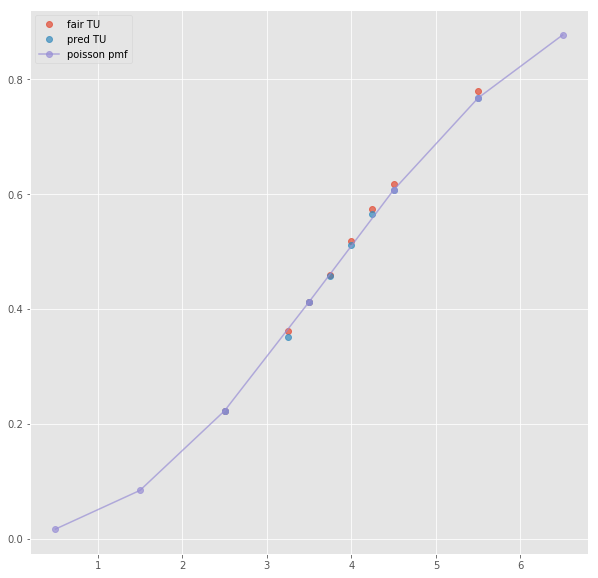

Error T1O:  0.0025982647236926226
ML : 9.95 8.72 1.22
Error home:  0.03004862826864256
Error draw:  0.0018328013811319682
Error away:  0.03188137064502783

(221, 124)
(1, 71)
3.5 1.675 2.15 1.5 2.425 1.525
TO fair:  1.7790697674418603 TU fair:  2.2835820895522385
TO pred:  1.77907 TU fair:  2.28358
Error TO:  0.005941613648661304

Error TO:  0.026329928550013593

Error TO:  0.002896508077635751

Error TO:  7.347600383678099e-08

Error TO:  0.019338991450154497

Error TO:  0.012590693613598658

Error TO:  0.04255231498832868

Error TO:  0.015915219562864236

Error TO:  0.009396878613930015

Error TO:  0.035091131803632214

Error TO:  0.004752343217951371

Error TO:  0.018708201933715862

Error TO:  0.012918513056635883

Error TO:  0.03442342371139401

Error TO:  0.01602448697580905

Error TO:  0.014027258683520394

Error TO:  0.018381907116879564

Error TO:  0.021115072900775606



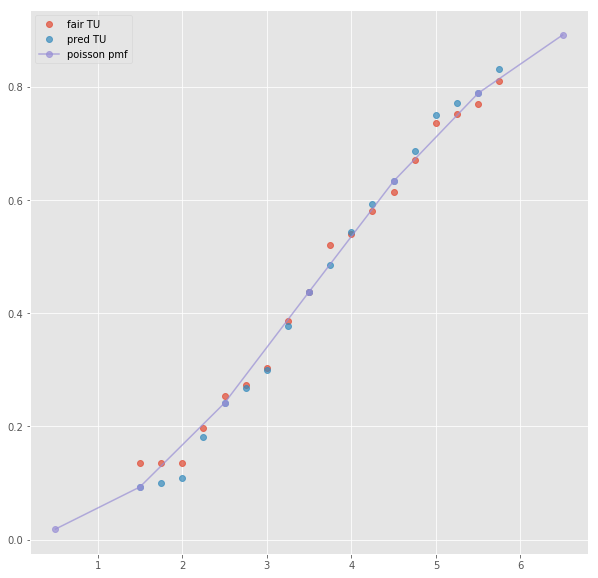

ML : 12.0 7.5 1.18
Error home:  0.0008914990831676989
Error draw:  0.0037473600033513382
Error away:  0.0028558122099024974

(109, 124)
next positional indexers are out-of-bounds
(11, 124)
(1, 41)
2.5 2.29 1.666 0.5 1.719 2.22
TO fair:  2.3745498199279713 TU fair:  1.7275109170305678
TO pred:  2.37456 TU fair:  1.72751
Error TO:  0.0008145963166447112

Error TO:  0.004202034168877322

Error TO:  0.0022379091871723156

Error TO:  1.8054539561163097e-06

Error TO:  0.003938824452744294

Error TO:  0.0014964224357620348

Error TO:  0.004322833518702551



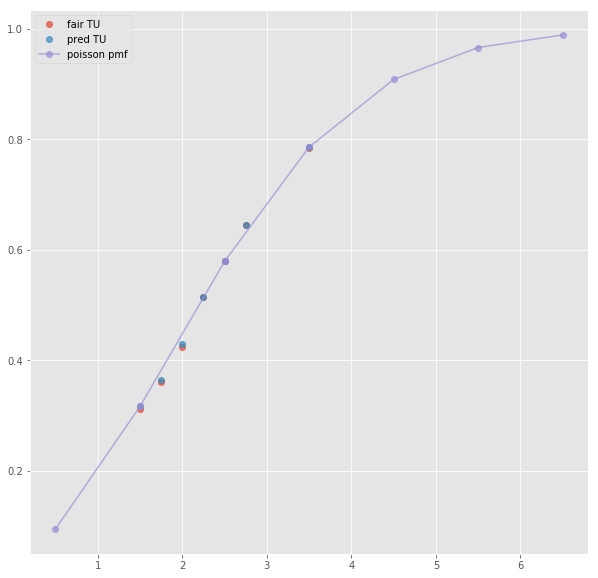

ML : 3.6 3.26 2.22
Error home:  0.02022574478216488
Error draw:  0.021414243441004177
Error away:  0.0011886969972902395

(7, 124)
(1, 15)
next list index out of range
(36, 124)
(1, 15)
next list index out of range
(14, 124)
(1, 17)
next list index out of range
(9, 124)
(1, 43)
2.5 2.29 1.666 0.5 1.719 2.22
TO fair:  2.3745498199279713 TU fair:  1.7275109170305678
TO pred:  2.37456 TU fair:  1.72751
Error TO:  0.0008145963166447112

Error TO:  0.004202034168877322

Error TO:  0.0022379091871723156

Error TO:  1.8054539561163097e-06

Error TO:  0.003938824452744294

Error TO:  0.0014964224357620348

Error TO:  0.004322833518702551



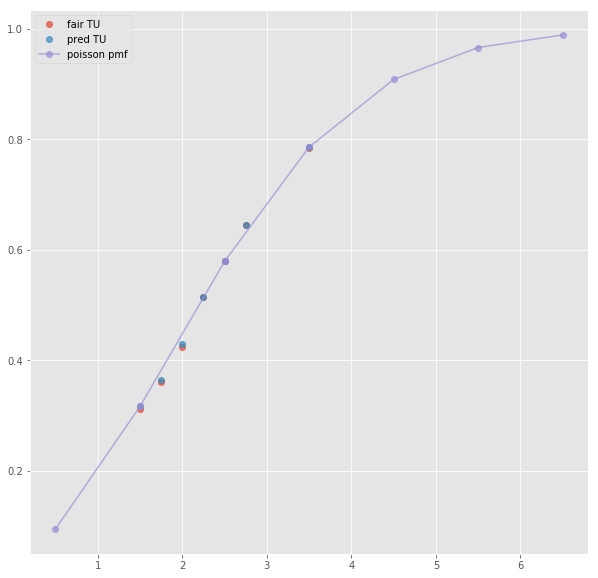

Error T1O:  0.0032891440732754074
ML : 3.6 3.26 2.22
Error home:  0.02022574478216488
Error draw:  0.021414243441004177
Error away:  0.0011886969972902395

(44, 124)
(1, 61)
2.5 2.25 1.625 0.5 1.675 2.15
TO fair:  2.3846153846153846 TU fair:  1.7222222222222223
TO pred:  2.38459 TU fair:  1.72224
Error TO:  0.009547734651831286

Error TO:  0.002412627601825479

Error TO:  0.018463264954572955

Error TO:  0.022573559724438308

Error TO:  4.464147417448938e-06

Error TO:  0.011782046115386358

Error TO:  0.0025953645581843765

Error TO:  0.027128482339291993

Error TO:  0.00927629075225167

Error TO:  0.03249454955068706

Error TO:  0.019463835812848967

Error TO:  0.01555031236588067

Error TO:  0.030231283574748913

Error TO:  0.02934572556484627



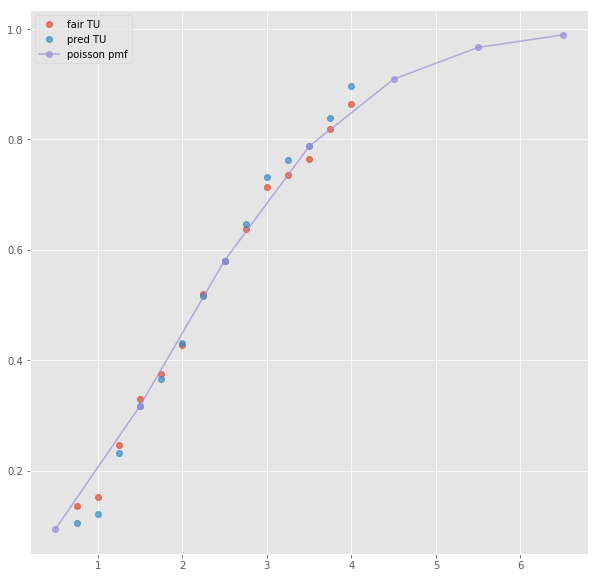

ML : 4.0 3.1 2.05
Error home:  0.05107044767211219
Error draw:  0.0289568687071865
Error away:  0.022113236457321828

(7, 124)
(1, 35)
2.5 2.3 1.65 0.5 1.71 2.19
TO fair:  2.393939393939394 TU fair:  1.7173913043478262
TO pred:  2.39398 TU fair:  1.71737
Error TO:  0.004053298021986784

Error TO:  0.004317145526346988

Error TO:  7.0852827995238066e-06

Error TO:  0.0017582623876307157

Error TO:  0.004877878040858374



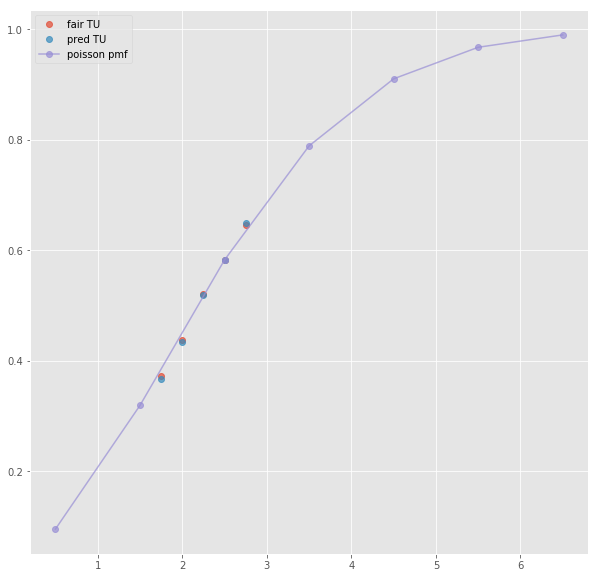

Error T1O:  0.0013229725975414386
Error T1O:  0.010573756482597396
ML : 3.56 3.25 2.22
Error home:  0.015585761536468679
Error draw:  0.020524264170049544
Error away:  0.004938869616359476

(33, 124)
(1, 41)
2.5 2.35 1.636 -0.5 2.13 1.781
TO fair:  2.436430317848411 TU fair:  1.6961702127659573
TO pred:  2.4365 TU fair:  1.69614
Error TO:  0.001748103301656978

Error TO:  0.0034907523369737126

Error TO:  0.006771537643849412

Error TO:  1.1738190170862417e-05

Error TO:  0.004611310696216564

Error TO:  0.0013017627427702183

Error TO:  0.004485319620201156



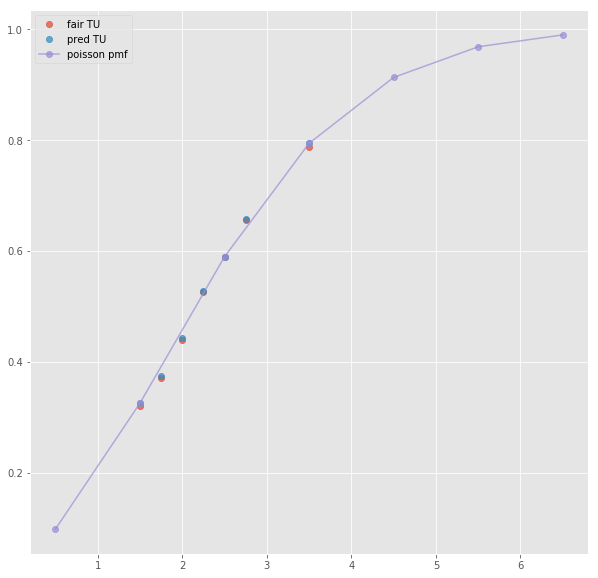

ML : 2.13 3.36 3.75
Error home:  0.0012530268588866744
Error draw:  0.012487715274758504
Error away:  0.011234909515390024

(57, 124)
(1, 19)
next list index out of range
(81, 124)
(1, 19)
next list index out of range
(171, 124)
(1, 23)
2.5 2.28 1.68 -0.5 2.14 1.79
TO fair:  2.357142857142857 TU fair:  1.736842105263158
TO pred:  2.3572 TU fair:  1.73681
Error TO:  0.024019413344374185

Error TO:  1.0284415510986022e-05

Error TO:  0.01389605100587421



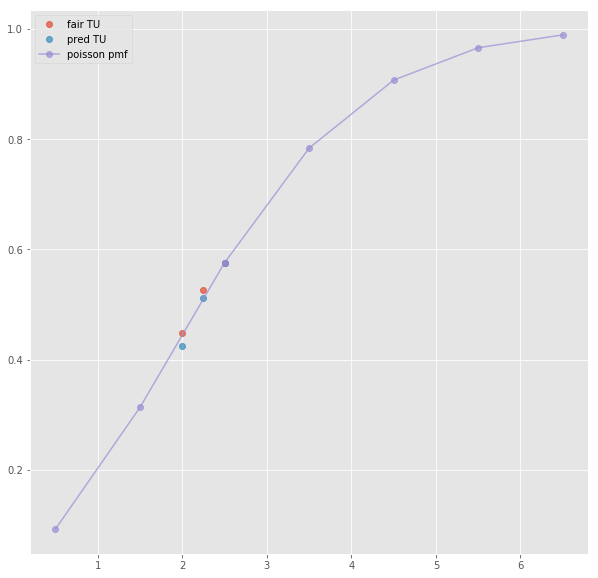

ML : 2.13 3.05 3.55
Error home:  0.020384387596078246
Error draw:  0.031870831479437534
Error away:  0.011486309397795214

(26, 124)
(1, 43)
2.5 2.35 1.636 -0.5 2.13 1.781
TO fair:  2.436430317848411 TU fair:  1.6961702127659573
TO pred:  2.4365 TU fair:  1.69614
Error TO:  0.001748103301656978

Error TO:  0.0034907523369737126

Error TO:  0.006771537643849412

Error TO:  1.1738190170862417e-05

Error TO:  0.004611310696216564

Error TO:  0.0013017627427702183

Error TO:  0.004485319620201156



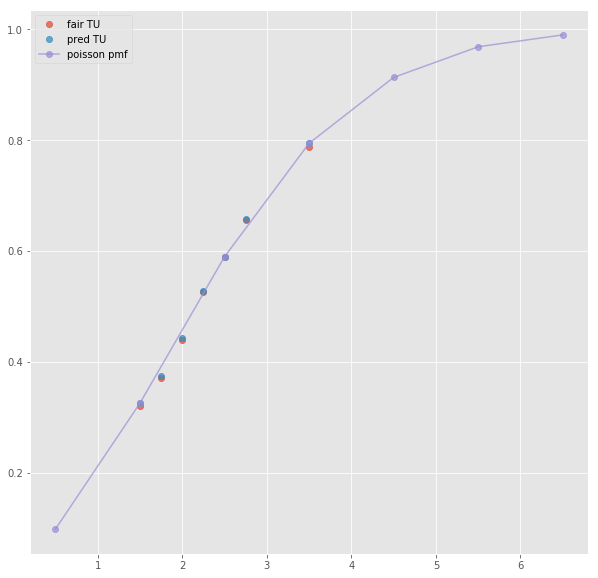

Error T1O:  0.007828103277548903
ML : 2.13 3.36 3.75
Error home:  0.0012530268588866744
Error draw:  0.012487715274758504
Error away:  0.011234909515390024

(22, 124)
(1, 57)
2.5 2.2 1.65 -0.5 2.075 1.725
TO fair:  2.3333333333333335 TU fair:  1.7499999999999998
TO pred:  2.33328 TU fair:  1.75003
Error TO:  0.012982840386634331

Error TO:  0.008951112960956187

Error TO:  0.008585969313624042

Error TO:  0.015270928110261789

Error TO:  9.796142279250297e-06

Error TO:  0.019542889619615922

Error TO:  0.006047190981737172

Error TO:  0.018720991950278543

Error TO:  0.0054762567168650245

Error TO:  0.013000791667004824

Error TO:  0.02232214295763646

Error TO:  0.027119245609514286



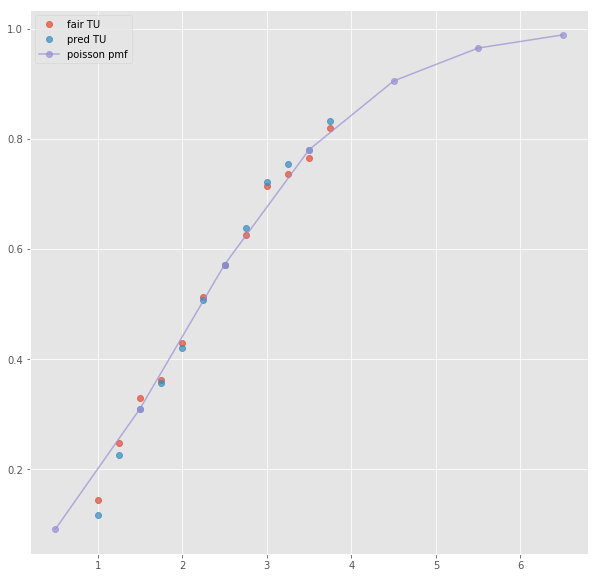

ML : 2.0 3.3 3.75
Error home:  0.013489450843215955
Error draw:  0.01216511496486794
Error away:  0.02565480692202729

(16, 124)
next positional indexers are out-of-bounds
(162, 124)
(1, 41)
3.5 2.51 1.574 -1.5 2.0 1.917
TO fair:  2.5946632782719186 TU fair:  1.6270916334661356
TO pred:  2.5947 TU fair:  1.62708
Error TO:  0.004094790248061919

Error TO:  0.0038131955918765392

Error TO:  5.454500089041581e-06

Error TO:  0.0007668007175139768

Error TO:  0.005316103528342664

Error TO:  0.0011009941778947763

Error TO:  0.0007503455336881348



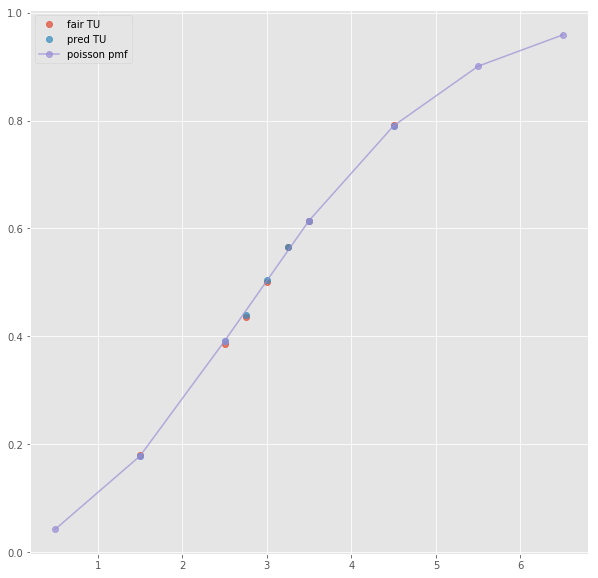

ML : 1.327 5.52 9.97
Error home:  0.00831744420682523
Error draw:  0.004667899560042682
Error away:  0.012985357752157686

(187, 124)
(1, 25)
2.5 1.56 2.38 -1.5 1.98 1.89
TO fair:  1.6554621848739497 TU fair:  2.5256410256410255
TO pred:  1.65547 TU fair:  2.52561
Error TO:  0.0010001637547709663

Error TO:  0.00989761761231922

Error TO:  2.851644658408148e-06

Error TO:  0.0004897182147398649



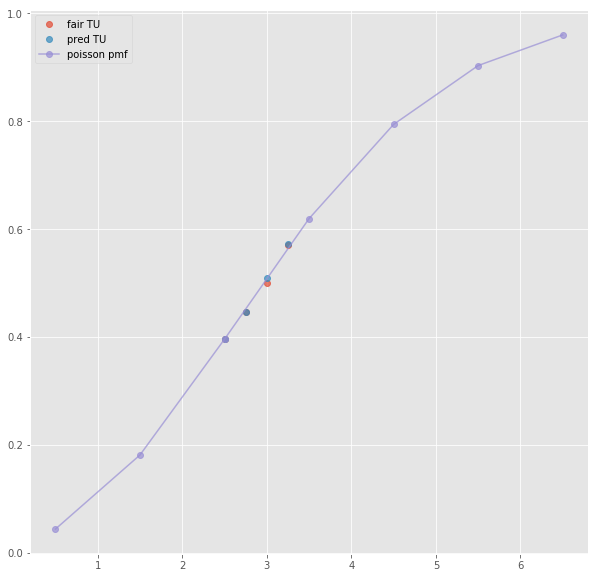

ML : 1.3 5.36 9.71
Error home:  0.006885748561050842
Error draw:  0.00521046985719667
Error away:  0.012096322933000891

(262, 124)
(1, 21)
next list index out of range
(408, 124)
(1, 25)
2.5 1.61 2.44 -1.5 2.02 1.93
TO fair:  1.6598360655737707 TU fair:  2.515527950310559
TO pred:  1.65986 TU fair:  2.51548
Error TO:  0.01069395952721175

Error TO:  0.009441757084943547

Error TO:  8.687330911194557e-06

Error TO:  0.004132977597581466



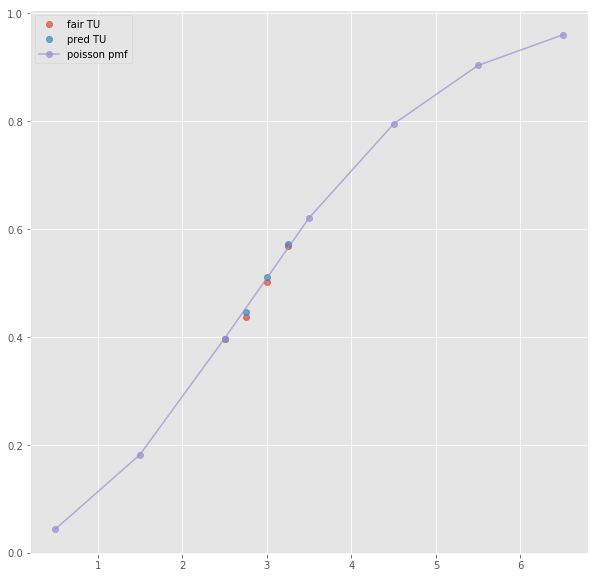

ML : 1.33 5.3 10.0
Error home:  0.0024438577541672224
Error draw:  0.01030872064117494
Error away:  0.012752596799717505

(125, 124)
(1, 43)
3.5 2.51 1.574 -1.5 2.0 1.917
TO fair:  2.5946632782719186 TU fair:  1.6270916334661356
TO pred:  2.5947 TU fair:  1.62708
Error TO:  0.004094790248061919

Error TO:  0.0038131955918765392

Error TO:  5.454500089041581e-06

Error TO:  0.0007668007175139768

Error TO:  0.005316103528342664

Error TO:  0.0011009941778947763

Error TO:  0.0007503455336881348



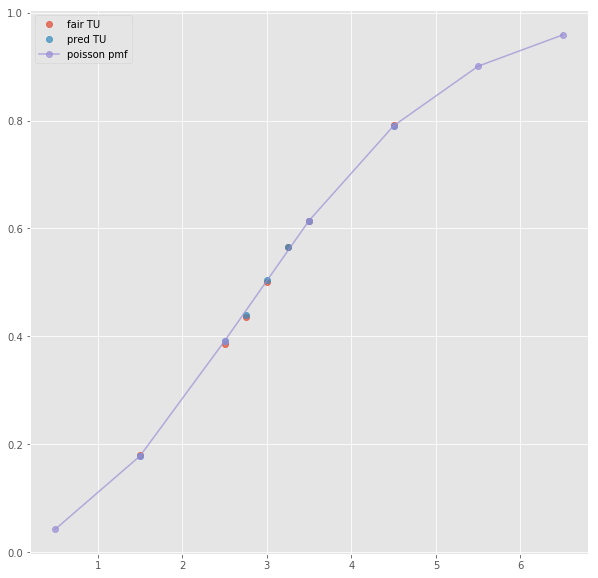

Error T1O:  0.01108886399793696
ML : 1.327 5.52 9.97
Error home:  0.00831744420682523
Error draw:  0.004667899560042682
Error away:  0.012985357752157686

(68, 124)
next positional indexers are out-of-bounds
(23, 124)
(1, 41)
3.5 2.85 1.452 -1.5 2.01 1.884
TO fair:  2.962809917355372 TU fair:  1.5094736842105263
TO pred:  2.96286 TU fair:  1.50946
Error TO:  0.0037773579277934344

Error TO:  0.0024364647056256405

Error TO:  5.705219176865839e-06

Error TO:  0.0028289702686716267

Error TO:  0.0036909079135278855

Error TO:  0.004243033447546729

Error TO:  0.003403683441102423

Error TO:  0.0007752017296958624



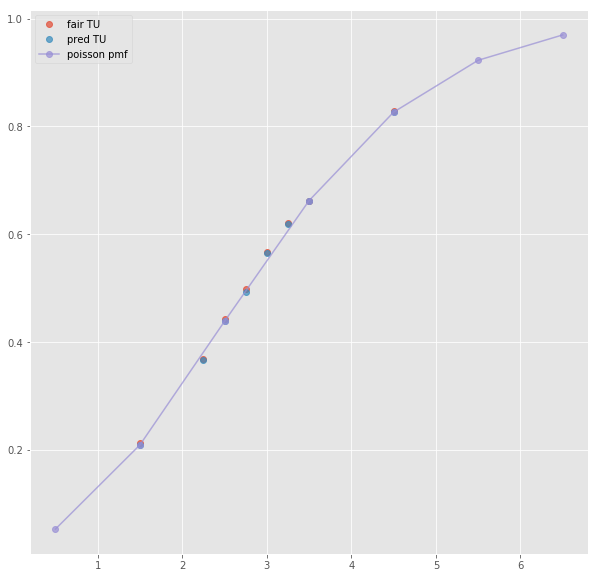

ML : 1.3119999999999998 5.43 10.29
Error home:  0.007135241047081853
Error draw:  0.001274930291583487
Error away:  0.008410196374303847

(22, 124)
(1, 14)
next list index out of range
(21, 124)
(1, 16)
next list index out of range
(18, 124)
(1, 14)
next list index out of range
(21, 124)
(1, 43)
3.5 2.85 1.452 -1.5 2.01 1.884
TO fair:  2.962809917355372 TU fair:  1.5094736842105263
TO pred:  2.96286 TU fair:  1.50946
Error TO:  0.0037773579277934344

Error TO:  0.0024364647056256405

Error TO:  5.705219176865839e-06

Error TO:  0.0028289702686716267

Error TO:  0.0036909079135278855

Error TO:  0.004243033447546729

Error TO:  0.003403683441102423

Error TO:  0.0007752017296958624



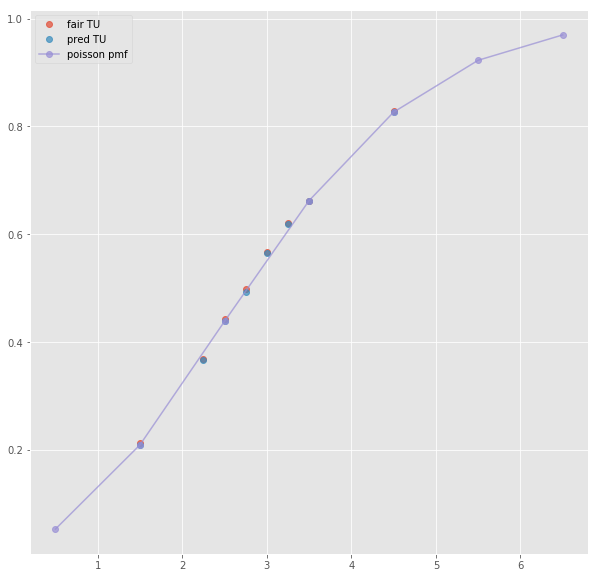

Error T1O:  0.0038468863803509112
ML : 1.3119999999999998 5.43 10.29
Error home:  0.007135241047081853
Error draw:  0.001274930291583487
Error away:  0.008410196374303847

(9, 124)
(1, 31)
2.5 1.73 2.17 -1.5 1.96 1.89
TO fair:  1.7972350230414749 TU fair:  2.254335260115607
TO pred:  1.79725 TU fair:  2.25431
Error TO:  0.00207360427052683

Error TO:  0.0062307710653723425

Error TO:  4.6367134973746005e-06

Error TO:  0.0036266813570214884

Error TO:  0.008719864179820458



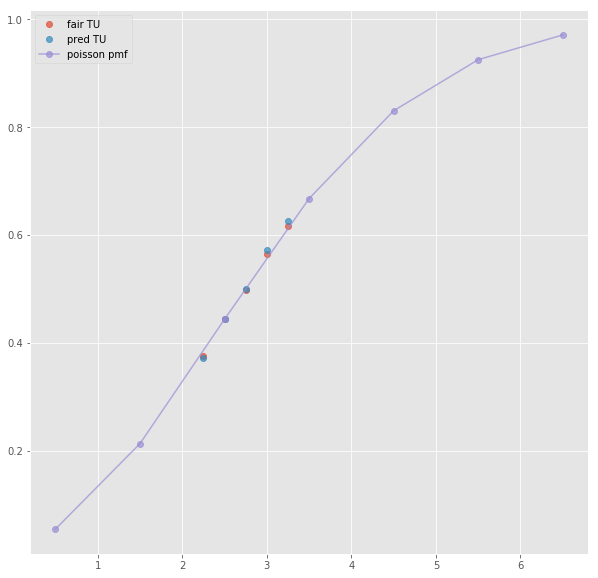

Error T1O:  0.004668361850788283
ML : 1.34 5.25 9.57
Error home:  0.013864780475976723
Error draw:  0.010003112207831316
Error away:  0.00386180905741923

(53, 124)
(1, 42)
2.5 2.16 1.746 -0.5 1.625 2.4
TO fair:  2.2371134020618557 TU fair:  1.8083333333333333
TO pred:  2.23708 TU fair:  1.80836
Error TO:  0.0025154540019569627

Error TO:  0.0025823330153845747

Error TO:  0.022795639997784112

Error TO:  0.008784628129618582

Error TO:  6.674269841022706e-06

Error TO:  0.004587782398200457

Error TO:  0.000682502415203845

Error TO:  0.003836038502983752



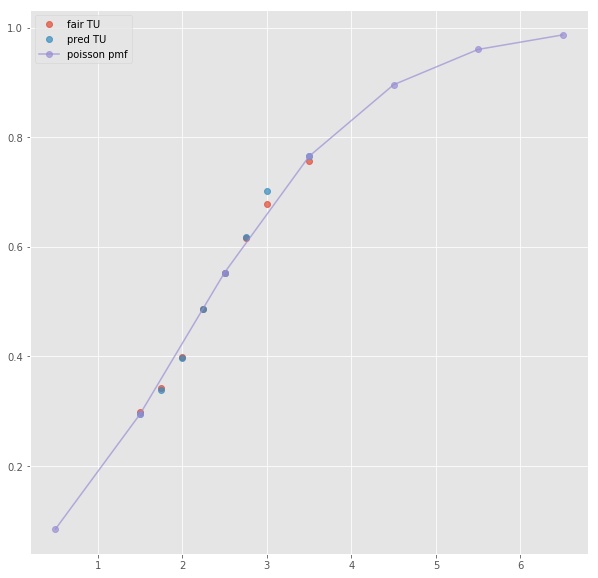

ML : 1.625 3.57 6.89
Error home:  0.004929974159473827
Error draw:  0.03172692573295982
Error away:  0.02679678909956107

(155, 124)
(1, 24)
2.5 2.07 1.75 -0.5 1.58 2.35
TO fair:  2.182857142857143 TU fair:  1.8454106280193239
TO pred:  2.18286 TU fair:  1.84541
Error TO:  0.025644581475120165

Error TO:  5.996264182961397e-07

Error TO:  0.0018375166545576693



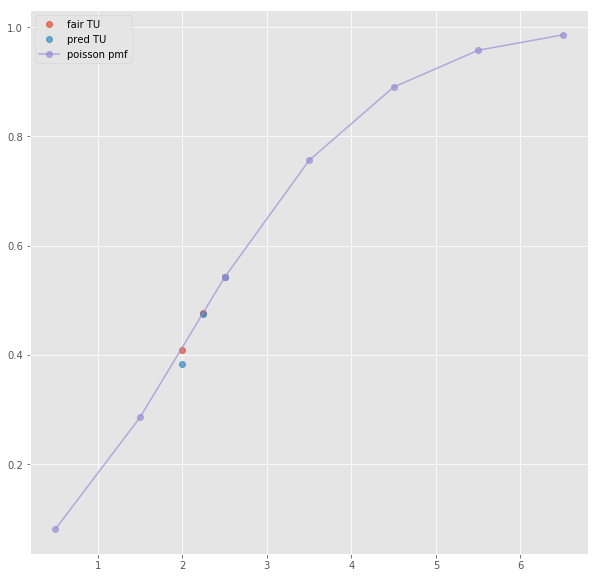

ML : 1.57 3.46 5.76
Error home:  0.018682009432595015
Error draw:  0.02805523132286855
Error away:  0.009373397292566032

(160, 124)
(1, 20)
next list index out of range
(426, 124)
(1, 24)
2.5 2.09 1.81 -0.5 1.62 2.42
TO fair:  2.154696132596685 TU fair:  1.8660287081339717
TO pred:  2.15469 TU fair:  1.86603
Error TO:  0.01740762454350686

Error TO:  1.3209110573120242e-06

Error TO:  0.008812507748196974



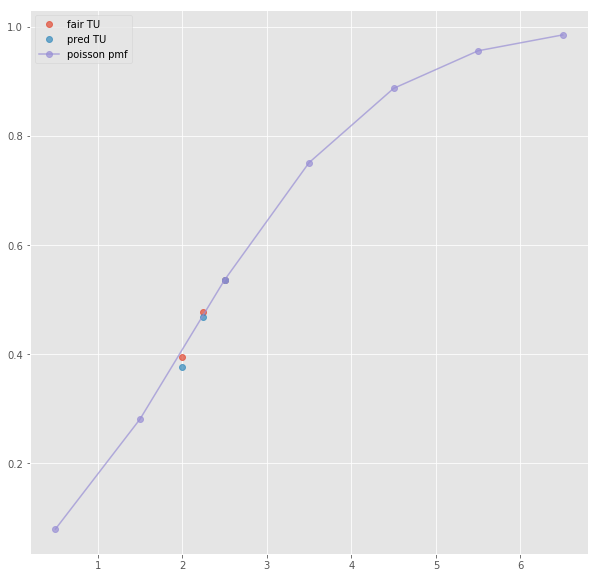

ML : 1.65 3.5 6.4
Error home:  0.020718476956763654
Error draw:  0.03929190438700442
Error away:  0.01857345542155911

(51, 124)
(1, 42)
2.5 2.16 1.746 -0.5 1.625 2.4
TO fair:  2.2371134020618557 TU fair:  1.8083333333333333
TO pred:  2.23708 TU fair:  1.80836
Error TO:  0.0025154540019569627

Error TO:  0.0025823330153845747

Error TO:  0.008784628129618582

Error TO:  6.674269841022706e-06

Error TO:  0.004587782398200457

Error TO:  0.000682502415203845

Error TO:  0.003836038502983752



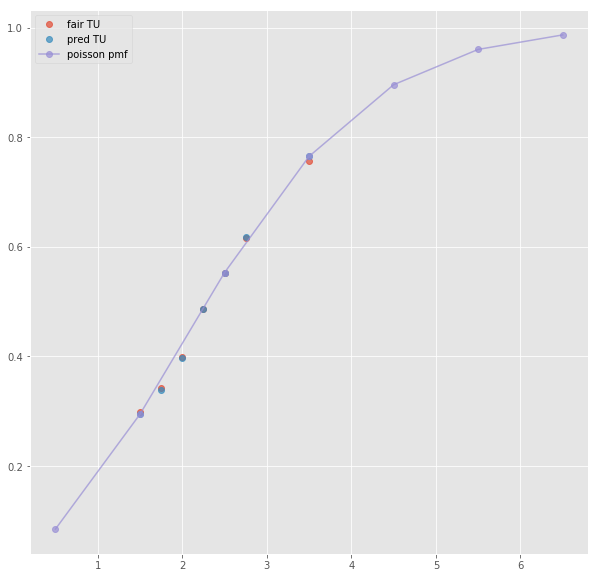

Error T1O:  0.004030642263504913
ML : 1.625 3.57 6.89
Error home:  0.004929974159473827
Error draw:  0.03172692573295982
Error away:  0.02679678909956107

(78, 124)
(1, 64)
2.5 2.05 1.75 -1.5 2.375 1.55
TO fair:  2.1714285714285713 TU fair:  1.8536585365853657
TO pred:  2.17137 TU fair:  1.8537
Error TO:  0.00553519951934639

Error TO:  0.013601482666040221

Error TO:  0.016165847866408345

Error TO:  0.018186318005699253

Error TO:  1.2422426491298655e-05

Error TO:  0.0026598290823284243

Error TO:  0.0020564730675987075

Error TO:  0.010867722361024845

Error TO:  0.01589457400388683

Error TO:  0.01993212859652785

Error TO:  0.016659109888788493

Error TO:  0.0176332615127954

Error TO:  0.018742052420808952

Error TO:  0.03452538387395965



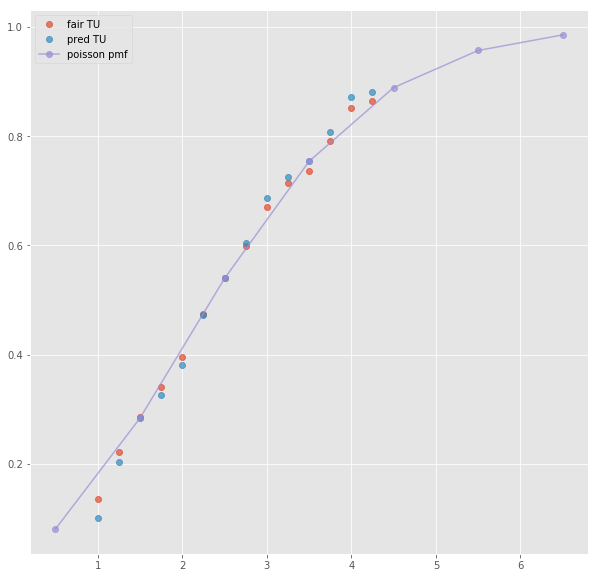

ML : 1.5 3.8 7.5
Error home:  0.030269838263652704
Error draw:  0.03212031988283365
Error away:  0.001850514026400546

(34, 124)
(1, 32)
2.5 2.12 1.76 -0.5 1.63 2.34
TO fair:  2.2045454545454546 TU fair:  1.830188679245283
TO pred:  2.20457 TU fair:  1.83017
Error TO:  0.0036949566665095968

Error TO:  0.00161581029617619

Error TO:  5.0504273479967665e-06

Error TO:  0.0010139502657394717

Error TO:  0.0036106620918655574



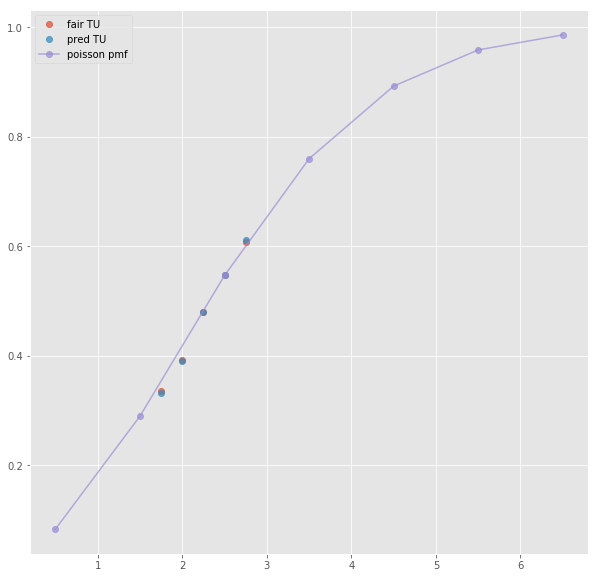

Error T1O:  0.008351101275099748
ML : 1.64 3.71 6.23
Error home:  0.003003906936225653
Error draw:  0.02114013295736747
Error away:  0.01813648849422106

(52, 124)
(1, 17)
next list index out of range
(146, 124)
(1, 34)
2.5 2.12 1.76 1.5 1.58 2.46
TO fair:  2.2045454545454546 TU fair:  1.830188679245283
TO pred:  2.20457 TU fair:  1.83017
Error TO:  0.0017588601067570764

Error TO:  0.00853665163404127

Error TO:  0.021799944088621404

Error TO:  5.0504273479967665e-06

Error TO:  0.003611352863142181

Error TO:  0.009882888650977417



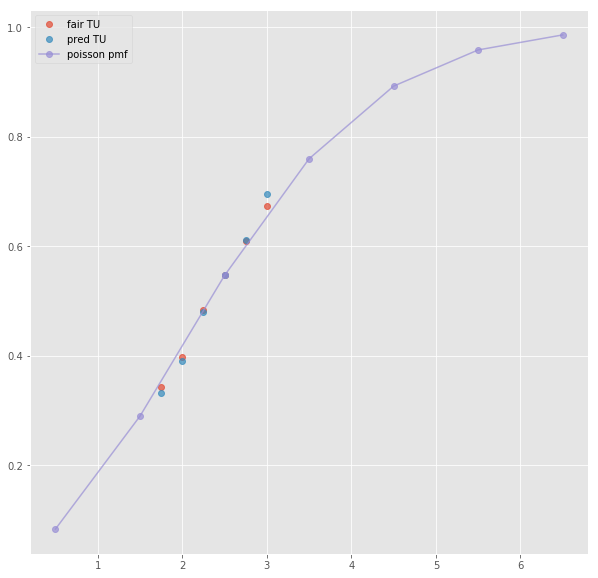

Error T1O:  0.0030818151669321225
ML : 7.14 4.35 1.49
Error home:  0.00691055112324479
Error draw:  0.0033111695805239094
Error away:  0.010221724303830504

(287, 124)
next positional indexers are out-of-bounds


KeyboardInterrupt: 

In [830]:
# check initial half totals
from tqdm import tqdm_notebook


int_total_errors = []
half_total_errors = []
quarter_total_errors = []

total_1_errors = []
int_total_1_errors = []
half_total_1_errors = []
quarter_total_1_errors = []

int_total_2_errors = []
half_total_2_errors = []
quarter_total_2_errors = []

int_hdp_1_errors = []
half_hdp_1_errors = []
quarter_hdp_1_errors = []

int_hdp_2_errors = []
half_hdp_2_errors = []
quarter_hdp_2_errors = []

ml_errors = []


for i in tqdm_notebook(zzzz[['InternalID', 'BookmakerName']].drop_duplicates().values):
    try:
        zzz_for_check = zzzz[(zzzz['InternalID'] == i[0]) & (zzzz['BookmakerName'] == i[1])].fillna(method='ffill')
        print(zzz_for_check.shape)
        zzz_for_check['not_null'] = zzz_for_check.notnull().sum(axis=1)
        zzz_for_check['max_not_null'] = zzz_for_check.groupby(['InternalID', 'BookmakerName'])['not_null'].transform(max)
        zzz_for_check['max_queue_time'] = zzz_for_check.groupby(['InternalID', 'BookmakerName'])['QueueTime'].transform(max)

        zzz_for_check = zzz_for_check[
            (zzz_for_check['QueueTime'] < zzz_for_check['StartTime'])
            & 
            (zzz_for_check['not_null'] == zzz_for_check['max_not_null'])
        ]
        
#         print(zzz_for_check.shape)
        filled_data = zzz_for_check.iloc[[-1], :].dropna(axis=1).reset_index(drop=True)
        print(filled_data.shape)
        not_empty_columns = [c for c in filled_data.columns if not ('computed' in c or 'disc' in c)]
        filled_data = filled_data[not_empty_columns]

        ml_columns = ['HOME', 'DRAW', 'AWAY']
        total_columns = [col for col in not_empty_columns if 'TO' in col or 'TU' in col]
        total_home_columns = [col for col in not_empty_columns if 'T1O' in col or 'T1U' in col]
        total_away_columns = [col for col in not_empty_columns if 'T2O' in col or 'T2U' in col]
        hdp_columns = [col for col in not_empty_columns if 'HDP' in col]

        half_total_over = [c for c in total_columns 
                           if ('TO' in c) 
                           and ('_5' in c) 
                           and (filled_data[c][0] > 1.5) 
                           and (filled_data[c][0] < 3)
                          ][0]
        half_total_value = float(half_total_over[3:].replace('_', '.'))
        half_total_init = [half_total_over, half_total_over.replace('O', 'U')]

        half_hdp_home = [c for c in hdp_columns 
                         if ('HOME_HDP' in c)
                         and (',5' in c) 
                         and (filled_data[c][0] > 1.5) 
                         and (filled_data[c][0] < 3)
                        ][0]
        half_hdp_value = float(half_hdp_home[8:].replace(',', '.'))
        half_hdp_init = [half_hdp_home, f'AWAY_HDP {half_hdp_value}'.replace('.', ',')]

        # margin
        half_total_margin = margin_2(
            *filled_data[half_total_init].values[0].tolist()
        )

        half_hdp_margin = margin_2(
            *filled_data[half_hdp_init].values[0].tolist()
        )

        to, tu = filled_data[half_total_init].values[0].tolist()
        fair_to, fair_tu = fair_odd(filled_data[half_total_init], half_total_margin).values[0].tolist()

        hdp1, hdp2 = filled_data[half_hdp_init].values[0].tolist()
        fair_hdp1, fair_hdp2 = fair_odd(filled_data[half_hdp_init], half_hdp_margin).values[0].tolist()

        print(half_total_value, to, tu, half_hdp_value, hdp1, hdp2)
        try:
            result_odds, mu, mu1, mu2 = odds.compute_odds(half_total_value, to, tu,
                                                          half_hdp_value, hdp1, hdp2)

            print('TO fair: ', fair_to, 'TU fair: ', fair_tu)
            to_pred = result_odds[f'T O {half_total_value}']
            tu_pred = result_odds[f'T U {half_total_value}']
            print('TO pred: ', to_pred, 'TU fair: ', tu_pred)

            plt.figure(figsize=(10, 10))
            x, y, y_pred = [], [], []
            # totals errors
            for i in range(len(total_columns[::2])):
                to, tu = filled_data[total_columns[2*i:2*i+2]].values[0].tolist()
                t_val = float(total_columns[2*i][3:].replace('_', '.'))
                margin = margin_2(to, tu)
                fair_to = fair_odd(to, margin)
                fair_tu = fair_odd(tu, margin)
#                 print('TO: ', to, 'TU: ', tu, 'margin', margin)
#                 print('T value: ', t_val)
#                 print('TO fair: ', fair_to, 'TU fair: ', fair_tu)
                to_pred = result_odds[f'T O {t_val}']
                tu_pred = result_odds[f'T U {t_val}']
#                 print('TO pred: ', to_pred, 'TU fair: ', tu_pred)
                print('Error TO: ', abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
#                 print('Error TU: ', abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
                print()
                x.append(t_val)
                y.append(odds.odd_to_prob(fair_tu))
                y_pred.append(odds.odd_to_prob(tu_pred))

            plt.plot(x, y, 'o', label="fair TU", alpha=0.7)
            plt.plot(x, y_pred, 'o', label="pred TU", alpha=0.7)

            # plot poisson distr
            x, y = [], []
            for x0 in range(0, 7):
                x.append(x0+0.5)
                p_opt = odds.PoissonOptimizer(x0, 0.5)
                y.append(p_opt.sum_pmf(mu))
            plt.plot(x, y, 'o-', label="poisson pmf", alpha=0.7)
            plt.legend(loc='upper left')
            plt.show()

            # totals home errors
            for i in range(len(total_home_columns[::2])):
                to, tu = filled_data[total_home_columns[2*i:2*i+2]].values[0].tolist()
                t_val = float(total_home_columns[2*i][4:].replace('_', '.'))
                margin = margin_2(to, tu)
                fair_to = fair_odd(to, margin)
                fair_tu = fair_odd(tu, margin)
#                 print('T1O: ', to, 'T1U: ', tu, 'margin', margin)
#                 print('T value: ', t_val)
#                 print('T1O fair: ', fair_to, 'T1U fair: ', fair_tu)
                to_pred = result_odds[f'T1 O {t_val}']
                tu_pred = result_odds[f'T1 U {t_val}']
#                 print('T1O pred: ', to_pred, 'T1U fair: ', tu_pred)
                print('Error T1O: ', abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
#                 print('Error T1U: ', abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
#                 print()
                total_1_errors.append(abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
#                 total_1_errors.append(abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))


    #         # totals away errors
    #         for i in range(len(total_away_columns[::2])):
    #             to, tu = filled_data[total_away_columns[2*i:2*i+2]].values[0].tolist()
    #             t_val = float(total_away_columns[2*i][4:].replace('_', '.'))
    #             margin = margin_2(to, tu)
    #             fair_to = fair_odd(to, margin)
    #             fair_tu = fair_odd(tu, margin)
    #             print('T2O: ', to, 'T2U: ', tu, 'margin', margin)
    #             print('T value: ', t_val)
    #             print('T2O fair: ', fair_to, 'T2U fair: ', fair_tu)
    #             to_pred = result_odds[f'T2 O {t_val}']
    #             tu_pred = result_odds[f'T2 U {t_val}']
    #             print('T2O pred: ', to_pred, 'T2U fair: ', tu_pred)
    #             print('Error T2O: ', abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
    #             print('Error T2U: ', abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
    #             print()
            # draw
            home, draw, away = filled_data[ml_columns].values[0].tolist()
            margin = margin_3(home, draw, away)

            print('ML :', home, draw, away)
            fair_home = fair_odd(home, margin)
#             print('Home fair: ', fair_home)
            home_pred = result_odds[f'ML 1']
#             print('Home pred: ', home_pred)
            print('Error home: ', abs(odds.odd_to_prob(fair_home) - odds.odd_to_prob(home_pred)))
            ml_errors.append(abs(odds.odd_to_prob(fair_home) - odds.odd_to_prob(home_pred)))

            fair_draw = fair_odd(draw, margin)
#             print('Draw fair: ', fair_draw)
            draw_pred = result_odds[f'ML X']
#             print('Draw pred: ', draw_pred)
            print('Error draw: ', abs(odds.odd_to_prob(fair_draw) - odds.odd_to_prob(draw_pred)))
            ml_errors.append(abs(odds.odd_to_prob(fair_draw) - odds.odd_to_prob(draw_pred)))
        
            fair_away = fair_odd(away, margin)
#             print('Away fair: ', fair_away)
            away_pred = result_odds[f'ML 2']
#             print('Away pred: ', away_pred)
            print('Error away: ', abs(odds.odd_to_prob(fair_away) - odds.odd_to_prob(away_pred)))
            ml_errors.append(abs(odds.odd_to_prob(fair_away) - odds.odd_to_prob(away_pred)))
            print()

            # plot poisson distr
#             plt.figure(figsize=(10, 10))
#             x, y = [], []
#             for x0 in range(-6, 7):
#                 x.append(x0)
#                 s_opt = odds.SkellamOptimizer(x0, 0.5, mu)
#                 y.append(s_opt.pmf(x0, mu2))
#             plt.plot(x, y, 'o-', label="skellam pmf", alpha=0.7)
#             plt.scatter([0], [odds.odd_to_prob(fair_draw)], label="fair draw", alpha=0.7)
#             plt.scatter([0], [odds.odd_to_prob(draw_pred)], label="pred draw", alpha=0.7)
#             plt.legend(loc='upper left')
#             plt.show()
#             break
        except StopIteration as e:
            print(e)
    except Exception as e:
        print('next', e)

In [831]:
print("min error:",  np.array(total_1_errors).min())
print("max error:",  np.array(total_1_errors).max())
print("mean error:",  np.array(total_1_errors).mean())
print("std error:",  np.array(total_1_errors).std())
print("25% error:",  np.percentile(total_1_errors, q=25))
print("50% error:",  np.percentile(total_1_errors, q=50))
print("75% error:",  np.percentile(total_1_errors, q=75))
print("95% error:",  np.percentile(total_1_errors, q=95))
print("99% error:",  np.percentile(total_1_errors, q=99))

min error: 6.521894056543687e-05
max error: 0.08149513624652555
mean error: 0.009432266615096309
std error: 0.009461763060530821
25% error: 0.003732856926929151
50% error: 0.007692250936596201
75% error: 0.011624843711765642
95% error: 0.024668210204244034
99% error: 0.05050773615831543


In [828]:
len(total_1_errors)

390

In [832]:
print("min error:",  np.array(ml_errors).min())
print("max error:",  np.array(ml_errors).max())
print("mean error:",  np.array(ml_errors).mean())
print("std error:",  np.array(ml_errors).std())
print("25% error:",  np.percentile(ml_errors, q=25))
print("50% error:",  np.percentile(ml_errors, q=50))
print("75% error:",  np.percentile(ml_errors, q=75))
print("95% error:",  np.percentile(ml_errors, q=95))
print("99% error:",  np.percentile(ml_errors, q=99))

min error: 4.97721562853215e-06
max error: 0.10654840992652265
mean error: 0.014634801566338939
std error: 0.011443358909686726
25% error: 0.004929974159473827
50% error: 0.012403743844528081
75% error: 0.021976416139133564
95% error: 0.03463181178655637
99% error: 0.04785102884399076


2.5 1.684 2.14 -0.5 1.578 2.33
qeq
qeq
TO fair:  1.7869158878504672 TU fair:  2.2707838479809976
TO pred:  1.78693 TU fair:  2.27076
TO:  1.483 TU:  2.56 margin 0.06493383344571813
T value:  2.25
TO fair:  1.579296875 TU fair:  2.7262306136210386
TO pred:  1.58177 TU fair:  2.7189
Error TO:  0.0009900085770563338
Error TU:  0.0009889731580660088

TO:  1.684 TU:  2.14 margin 0.06111394765467182
T value:  2.5
TO fair:  1.7869158878504672 TU fair:  2.2707838479809976
TO pred:  1.78693 TU fair:  2.27076
Error TO:  4.419585288628625e-06
Error TU:  4.624923836127337e-06

TO:  1.9 TU:  1.917 margin 0.04796419844603683
T value:  2.75
TO fair:  1.9911319770474698 TU fair:  2.008947368421053
TO pred:  1.98364 TU fair:  2.01664
Error TO:  0.0018968523803200021
Error TU:  0.0018987946405892853

TO:  2.2 TU:  1.649 margin 0.060973592811069954
T value:  3.0
TO fair:  2.3341419041843543 TU fair:  1.7495454545454543
TO pred:  2.31146 TU fair:  1.76251
Error TO:  0.004204030650744983
Error TU:  0.00420

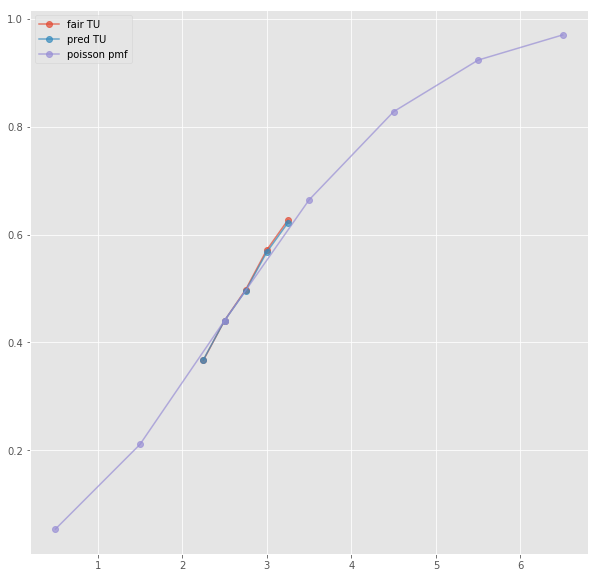

T1O:  1.628 T1U:  2.26 margin 0.05672849035680905
T value:  1.5
T1O fair:  1.720353982300885 T1U fair:  2.388206388206388
T1O pred:  1.73235 T1U fair:  2.36546
Error T1O:  0.004025164560949257
Error T1U:  0.004026474774706024

ML : 1.584 4.02 5.26
Home fair:  1.695170535156915
Home pred:  1.6773
Error home:  0.006285117717291011
Draw fair:  4.302137343011867
Draw pred:  4.60744
Error draw:  0.015402337115106801
Away fair:  5.629164782149856
Away pred:  5.35437
Error away:  0.009117087888253134



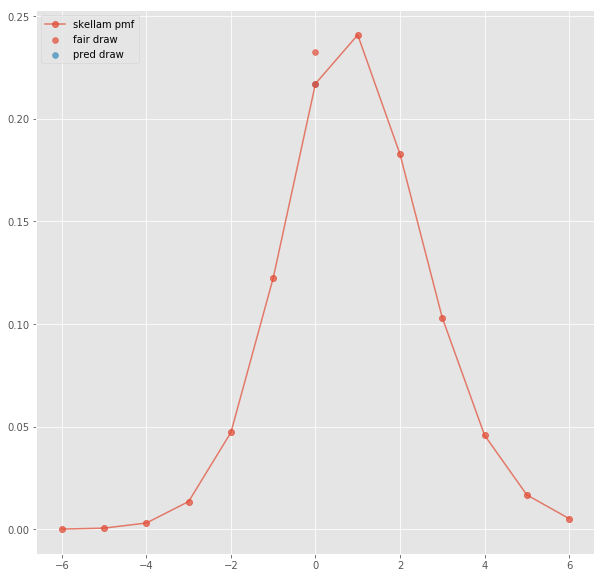

In [608]:
# check initial half totals
from tqdm import tqdm_notebook


int_total_errors = []
half_total_errors = []
quarter_total_errors = []

total_1_errors = []
int_total_1_errors = []
half_total_1_errors = []
quarter_total_1_errors = []

int_total_2_errors = []
half_total_2_errors = []
quarter_total_2_errors = []

int_hdp_1_errors = []
half_hdp_1_errors = []
quarter_hdp_1_errors = []

int_hdp_2_errors = []
half_hdp_2_errors = []
quarter_hdp_2_errors = []


for i in tqdm_notebook(range(data_2_nodups.shape[0]//100)):
    filled_data = data_2_nodups.iloc[[i], :].dropna(axis=1).reset_index(drop=True)
    not_empty_columns = [c for c in filled_data.columns if not ('computed' in c or 'disc' in c)]
    filled_data = filled_data[not_empty_columns]
    
    ml_columns = ['HOME', 'DRAW', 'AWAY']
    total_columns = [col for col in not_empty_columns if 'TO' in col or 'TU' in col]
    total_home_columns = [col for col in not_empty_columns if 'T1O' in col or 'T1U' in col]
    total_away_columns = [col for col in not_empty_columns if 'T2O' in col or 'T2U' in col]
    hdp_columns = [col for col in not_empty_columns if 'HDP' in col]
    
    half_total_over = [c for c in total_columns 
                       if ('TO' in c) 
                       and ('_5' in c) 
                       and (filled_data[c][0] > 1.5) 
                       and (filled_data[c][0] < 3)
                      ][0]
    half_total_value = float(half_total_over[3:].replace('_', '.'))
    half_total_init = [half_total_over, half_total_over.replace('O', 'U')]

    half_hdp_home = [c for c in hdp_columns 
                     if ('HOME_HDP' in c)
                     and (',5' in c) 
                     and (filled_data[c][0] > 1.5) 
                     and (filled_data[c][0] < 3)
                    ][0]
    half_hdp_value = float(half_hdp_home[8:].replace(',', '.'))
    half_hdp_init = [half_hdp_home, f'AWAY_HDP {(-1)*half_hdp_value}'.replace('.', ',')]
    
    # margin
    half_total_margin = margin_2(
        *filled_data[half_total_init].values[0].tolist()
    )

    half_hdp_margin = margin_2(
        *filled_data[half_hdp_init].values[0].tolist()
    )

    to, tu = filled_data[half_total_init].values[0].tolist()
    fair_to, fair_tu = fair_odd(filled_data[half_total_init], half_total_margin).values[0].tolist()
    
    hdp1, hdp2 = filled_data[half_hdp_init].values[0].tolist()
    fair_hdp1, fair_hdp2 = fair_odd(filled_data[half_hdp_init], half_hdp_margin).values[0].tolist()
    
    print(half_total_value, to, tu, half_hdp_value, hdp1, hdp2)
    try:
        result_odds, mu, mu1, mu2 = odds.compute_odds(half_total_value, to, tu,
                                                      half_hdp_value, hdp1, hdp2)

        print('TO fair: ', fair_to, 'TU fair: ', fair_tu)
        to_pred = result_odds[f'T O {half_total_value}']
        tu_pred = result_odds[f'T U {half_total_value}']
        print('TO pred: ', to_pred, 'TU fair: ', tu_pred)
        
        plt.figure(figsize=(10, 10))
        x, y, y_pred = [], [], []
        # totals errors
        for i in range(len(total_columns[::2])):
            to, tu = filled_data[total_columns[2*i:2*i+2]].values[0].tolist()
            t_val = float(total_columns[2*i][3:].replace('_', '.'))
            margin = margin_2(to, tu)
            fair_to = fair_odd(to, margin)
            fair_tu = fair_odd(tu, margin)
            print('TO: ', to, 'TU: ', tu, 'margin', margin)
            print('T value: ', t_val)
            print('TO fair: ', fair_to, 'TU fair: ', fair_tu)
            to_pred = result_odds[f'T O {t_val}']
            tu_pred = result_odds[f'T U {t_val}']
            print('TO pred: ', to_pred, 'TU fair: ', tu_pred)
            print('Error TO: ', abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
            print('Error TU: ', abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
            print()
            x.append(t_val)
            y.append(odds.odd_to_prob(fair_tu))
            y_pred.append(odds.odd_to_prob(tu_pred))
            
        plt.plot(x, y, 'o-', label="fair TU", alpha=0.7)
        plt.plot(x, y_pred, 'o-', label="pred TU", alpha=0.7)
        
        # plot poisson distr
        x, y = [], []
        for x0 in range(0, 7):
            x.append(x0+0.5)
            p_opt = odds.PoissonOptimizer(x0, 0.5)
            y.append(p_opt.sum_pmf(mu))
        plt.plot(x, y, 'o-', label="poisson pmf", alpha=0.7)
        plt.legend(loc='upper left')
        plt.show()

        # totals home errors
        for i in range(len(total_home_columns[::2])):
            to, tu = filled_data[total_home_columns[2*i:2*i+2]].values[0].tolist()
            t_val = float(total_home_columns[2*i][4:].replace('_', '.'))
            margin = margin_2(to, tu)
            fair_to = fair_odd(to, margin)
            fair_tu = fair_odd(tu, margin)
            print('T1O: ', to, 'T1U: ', tu, 'margin', margin)
            print('T value: ', t_val)
            print('T1O fair: ', fair_to, 'T1U fair: ', fair_tu)
            to_pred = result_odds[f'T1 O {t_val}']
            tu_pred = result_odds[f'T1 U {t_val}']
            print('T1O pred: ', to_pred, 'T1U fair: ', tu_pred)
            print('Error T1O: ', abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
            print('Error T1U: ', abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
            print()
            total_1_errors.append(abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
            total_1_errors.append(abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
            
        
#         # totals away errors
#         for i in range(len(total_away_columns[::2])):
#             to, tu = filled_data[total_away_columns[2*i:2*i+2]].values[0].tolist()
#             t_val = float(total_away_columns[2*i][4:].replace('_', '.'))
#             margin = margin_2(to, tu)
#             fair_to = fair_odd(to, margin)
#             fair_tu = fair_odd(tu, margin)
#             print('T2O: ', to, 'T2U: ', tu, 'margin', margin)
#             print('T value: ', t_val)
#             print('T2O fair: ', fair_to, 'T2U fair: ', fair_tu)
#             to_pred = result_odds[f'T2 O {t_val}']
#             tu_pred = result_odds[f'T2 U {t_val}']
#             print('T2O pred: ', to_pred, 'T2U fair: ', tu_pred)
#             print('Error T2O: ', abs(odds.odd_to_prob(fair_to) - odds.odd_to_prob(to_pred)))
#             print('Error T2U: ', abs(odds.odd_to_prob(fair_tu) - odds.odd_to_prob(tu_pred)))
#             print()
        # draw
        home, draw, away = filled_data[ml_columns].values[0].tolist()
        margin = margin_3(home, draw, away)
        
        print('ML :', home, draw, away)
        fair_home = fair_odd(home, margin)
        print('Home fair: ', fair_home)
        home_pred = result_odds[f'ML 1']
        print('Home pred: ', home_pred)
        print('Error home: ', abs(odds.odd_to_prob(fair_home) - odds.odd_to_prob(home_pred)))
        
        fair_draw = fair_odd(draw, margin)
        print('Draw fair: ', fair_draw)
        draw_pred = result_odds[f'ML X']
        print('Draw pred: ', draw_pred)
        print('Error draw: ', abs(odds.odd_to_prob(fair_draw) - odds.odd_to_prob(draw_pred)))
        
        fair_away = fair_odd(away, margin)
        print('Away fair: ', fair_away)
        away_pred = result_odds[f'ML 2']
        print('Away pred: ', away_pred)
        print('Error away: ', abs(odds.odd_to_prob(fair_away) - odds.odd_to_prob(away_pred)))
        print()
        
        # plot poisson distr
        plt.figure(figsize=(10, 10))
        x, y = [], []
        for x0 in range(-6, 7):
            x.append(x0)
            s_opt = odds.SkellamOptimizer(x0, 0.5, mu)
            y.append(s_opt.pmf(x0, mu2))
        plt.plot(x, y, 'o-', label="skellam pmf", alpha=0.7)
        plt.scatter([0], [odds.odd_to_prob(fair_draw)], label="fair draw", alpha=0.7)
        plt.scatter([0], [odds.odd_to_prob(draw_pred)], label="pred draw", alpha=0.7)
        plt.legend(loc='upper left')
        plt.show()
        break
    except StopIteration as e:
        print(e)

In [618]:
# def margin_2(odd_1, odd_2):
#     return 1 - ((odd_1 * odd_2)/(odd_1 + odd_2))

# def fair_odd(odd, margin):
#     return odd / (1 - margin)

# print(margin_2(1.684, 2.14), 1 / fair_odd(1.684, margin_2(1.684, 2.14)))

def margin_2(odd_1, odd_2):
    return 1/odd_1 + 1/odd_2 - 1

def fair_odd(odd, margin):
    return odd * (margin + 1)

margin_2(1.684, 2.14), 1 / fair_odd(1.684, margin_2(1.684, 2.14))

0.05759414225941406 0.5596234309623432


(0.06111394765467182, 0.5596234309623431)

In [567]:
print("min error:",  np.array(total_1_errors).min())
print("max error:",  np.array(total_1_errors).max())
print("mean error:",  np.array(total_1_errors).mean())
print("std error:",  np.array(total_1_errors).std())
print("25% error:",  np.percentile(total_1_errors, q=25))
print("50% error:",  np.percentile(total_1_errors, q=50))
print("75% error:",  np.percentile(total_1_errors, q=75))
print("95% error:",  np.percentile(total_1_errors, q=95))
print("99% error:",  np.percentile(total_1_errors, q=99))

min error: 0.00018316109327742858
max error: 0.03154617193588127
mean error: 0.008440168142452784
std error: 0.007923682306680526
25% error: 0.0017722492240148935
50% error: 0.004792088167751174
75% error: 0.012816874987986768
95% error: 0.027409336608294806
99% error: 0.03154581248488278


In [604]:
print("min error:",  np.array(total_1_errors).min())
print("max error:",  np.array(total_1_errors).max())
print("mean error:",  np.array(total_1_errors).mean())
print("std error:",  np.array(total_1_errors).std())
print("25% error:",  np.percentile(total_1_errors, q=25))
print("50% error:",  np.percentile(total_1_errors, q=50))
print("75% error:",  np.percentile(total_1_errors, q=75))
print("95% error:",  np.percentile(total_1_errors, q=95))
print("99% error:",  np.percentile(total_1_errors, q=99))

min error: 0.00018316109327742858
max error: 0.03154617193588127
mean error: 0.008440168142452787
std error: 0.007923682306680528
25% error: 0.0017722492240148102
50% error: 0.004792088167751174
75% error: 0.012816874987986795
95% error: 0.027409336608294907
99% error: 0.03154581248488278


In [532]:
half_total_value, to, tu, half_hdp_value, hdp1, hdp2

(2.5, 1.628, 2.26, -0.5, 1.578, 2.33)

In [533]:
fair_to, fair_tu = fair_odd(filled_data[half_total_init], half_total_margin).values[0].tolist()
fair_hdp1, fair_hdp2 = fair_odd(filled_data[half_hdp_init], half_hdp_margin).values[0].tolist()

In [553]:
# test system solver for skellam
from scipy.optimize import fsolve

k1 = half_total_value
goals = int(k1)
k2 = half_hdp_value

# prob less than k1 goals
p_under = odds.odd_to_prob(fair_tu)

# get mu = mu1 + mu2 before game ending
mu = odds.get_poisson_mu(goals, p_under)
print(mu)

# prob less than total goals
p = sum(poisson.pmf(g, mu) for g in range(0, goals+1))
print(p, p_under)

hdp_val = int(k2*(-1) + 1) if k2 < 0 else int(k2*(-1))
p_hdp = odds.odd_to_prob(hdp1)
mu1, mu2 = odds.get_skellam_mu(hdp_val, p_hdp, mu)
print('mu1: ', mu1, 'mu2: ', mu2)
p_draw = odds.odd_to_prob(fair_draw)
print('draw: ', p_draw)
sk_opt = odds.SkellamOptimizer(k=hdp_val, a=p_hdp, mu=mu)

#solve system

def equations(p):
    mu1, mu2 = p
    return (abs(p_hdp - sum(skellam.pmf(k, mu1, mu2) for k in range(hdp_val, 20))),
            skellam.pmf(0, mu1, mu2) - p_draw)

x, y =  fsolve(equations, (mu/2, mu/2))

print(equations((x, y)))

2.9242187500000023
0.4403807773846452 0.440376569037657
mu1:  2.0217187499999993 mu2:  0.902500000000003
draw:  0.23244260242512704
(3.9190872769268026e-14, -3.3306690738754696e-16)


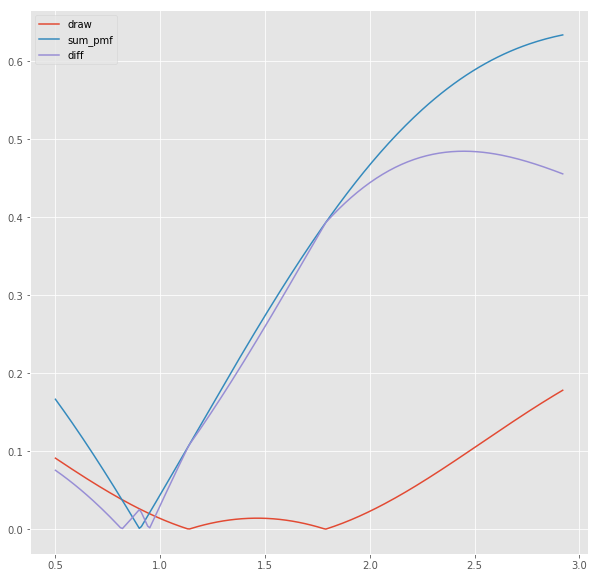

In [560]:
plt.figure(figsize=(10, 10))
x = np.arange(0.5, 6, 0.01)
y = [abs(skellam.pmf(0, mu - c, c) - p_draw) for c in x]
plt.plot(x, y, label='draw')
y = [abs(p_hdp - sum(skellam.pmf(k, mu - c, c) for k in range(hdp_val, 30))) for c in x]
plt.plot(x, y, label='sum_pmf')
y = [abs(abs(skellam.pmf(0, mu - c, c) - p_draw) - 
      abs(p_hdp - sum(skellam.pmf(k, mu - c, c) for k in range(hdp_val, 30)))) for c in x]
plt.plot(x, y, label='diff')
plt.legend()
plt.show()

0.20657436417682573

In [478]:
# prob less than k1 goals
p_under = odds.odd_to_prob(fair_tu)

# prob less than total goals
p = sum(poisson.pmf(g, mu) for g in range(0, goals+1))
print(p)

# get mu = mu1 + mu2 before game ending
mu = odds.get_poisson_mu(goals, p_under)
print(mu)

goals, p_under, mu, p, odds.prob_to_odd(1 - p), odds.prob_to_odd(p), fair_to, fair_tu

(1 - poisson.pmf(goals, mu) / 1.9757) / (1 - p), \
(1 - poisson.pmf(goals, mu) / 2.0423) / (p - poisson.pmf(goals, mu) / 2), \
(1 - poisson.pmf(goals + 1, mu) / 2.063) / (1 - p - poisson.pmf(goals + 1, mu) / 2), \
(1 - poisson.pmf(goals + 1, mu) / 1.94) / p

0.6642004719726067
algorithm does not converge
      fun: 1.0590641696950343e-09
 hess_inv: array([[4.22513202]])
      jac: array([0.06978422])
  message: 'Desired error not necessarily achieved due to precision loss.'
     nfev: 297
      nit: 2
     njev: 95
   status: 2
  success: False
        x: array([3.6151068])


StopIteration: 

In [318]:
from scipy.stats import poisson, skellam

In [316]:
import poisson

In [326]:
importlib.reload(odds)

<module 'odds' from './operator_position/odds.py'>

In [397]:
half_total_value, fair_to, fair_tu, half_hdp_value, fair_hdp1, fair_hdp2

(2.5,
 1.786915887850467,
 2.270783847980997,
 -0.5,
 1.6772532188841205,
 2.4765525982256023)

In [388]:
1/odds.prob_to_odd(1 - p) + 1/odds.prob_to_odd(p), 1/fair_to + 1/fair_tu

(1.0, 1.0000000000000002)

In [389]:
1/fair_hdp1 + 1/fair_hdp2

0.9999999999999999

In [395]:
from scipy.optimize import minimize

In [396]:
a = minimize(f, 2, method='BFGS')
a

      fun: 1.7069402002967138e-09
 hess_inv: array([[1.67326188]])
      jac: array([7.4505806e-09])
  message: 'Optimization terminated successfully.'
     nfev: 84
      nit: 3
     njev: 28
   status: 0
  success: True
        x: array([2.93140812])

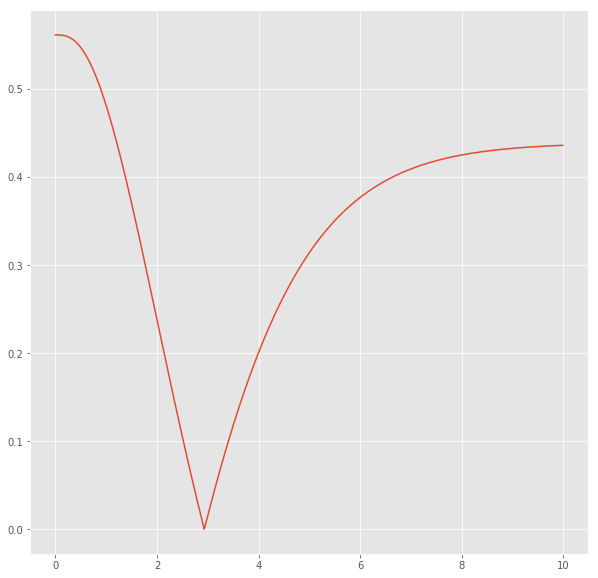

In [392]:
x = np.arange(0, 10, 0.01)
y = f(x)

plt.figure(figsize=(10, 10))
plt.plot(x, y)
plt.show()